In [1]:
# Switch path to root of project
import os
os.environ["CUDA_VISIBLE_DEVICES"]="0"
current_folder = globals()['_dh'][0]
os.chdir(os.path.dirname(os.path.abspath(current_folder)))

%load_ext autoreload
%autoreload 2

In [2]:
# Cell 2: Import libraries
import re
import math
from PIL import Image
import torch
import torch.nn.functional as F
import torchvision.transforms.functional as TF
from einops import rearrange
from transformers import AutoTokenizer
from tokenizers.processors import TemplateProcessing
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
from huggingface_hub import snapshot_download
from cosmos_tokenizer.image_lib import ImageTokenizer
from nanofm.utils.checkpoint import load_model_from_safetensors
from nanofm.data.multimodal.simple_multimodal_dataset import SimpleMultimodalDataset
from nanofm.data.multimodal.masking import SimpleMultimodalMasking
import glob
import numpy as np
from tqdm import tqdm


os.environ["TOKENIZERS_PARALLELISM"] = "false"

# The flag below controls whether to allow TF32 on matmul. This flag defaults to False in PyTorch 1.12 and later.
torch.backends.cuda.matmul.allow_tf32 = True
# The flag below controls whether to allow TF32 on cuDNN. This flag defaults to True.
torch.backends.cudnn.allow_tf32 = True

device = 'cuda' if torch.cuda.is_available() else 'cpu'
torch.set_grad_enabled(False)

/work/com-304/new_environment/anaconda3/envs/nanofm/lib/python3.10/site-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


In [3]:
snapshot_download(
    repo_id='nvidia/Cosmos-0.1-Tokenizer-DI16x16', 
    local_dir='/tmp/nvidia12/Cosmos-0.1-Tokenizer-DI8x8'
)
image_tokenizer = ImageTokenizer(
    checkpoint_enc='/tmp/nvidia12/Cosmos-0.1-Tokenizer-DI8x8/encoder.jit',
    checkpoint_dec='/tmp/nvidia12/Cosmos-0.1-Tokenizer-DI8x8/decoder.jit',
).to(device)

Fetching 7 files:   0%|          | 0/7 [00:00<?, ?it/s]

encoder.jit:   0%|          | 0.00/70.2M [00:00<?, ?B/s]

decoder.jit:   0%|          | 0.00/99.2M [00:00<?, ?B/s]

autoencoder.jit:   0%|          | 0.00/169M [00:00<?, ?B/s]

model_config.yaml:   0%|          | 0.00/92.0 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/22.6k [00:00<?, ?B/s]

.gitattributes:   0%|          | 0.00/1.67k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/54.0 [00:00<?, ?B/s]

In [5]:

# Cell 4: Function to load and preprocess frames
def load_frames(directory, num_frames=17, resize=(256, 256)):
    """Load and preprocess frames from a directory, sorting by frame number."""
    # Get all .jpg files
    image_files = glob.glob(os.path.join(directory, "*.jpg"))
    
    # Extract frame number from filename (e.g., keyframe_01_idx4.jpg -> 01)
    def get_frame_number(filename):
        match = re.search(r'keyframe_(\d{2})_idx\d+\.jpg', os.path.basename(filename))
        return int(match.group(1)) if match else float('inf')
    
    # Sort files by frame number
    image_files = sorted(image_files, key=get_frame_number)
    
    if len(image_files) != num_frames:
        print(f"Warning: Found {len(image_files)} images in {directory}, expected {num_frames}")
        return None
    
    frames = []
    for img_path in image_files:
        img = Image.open(img_path).resize(resize).convert('RGB')
        img_tensor = TF.to_tensor(img).to(device).unsqueeze(0) * 2 - 1  # Normalize to [-1, 1]
        frames.append(img_tensor)
    
    return torch.cat(frames, dim=0)  # Shape: [num_frames, 3, 256, 256]

In [6]:
# Cell 5: Function to tokenize frames
def tokenize_frames(frames, tokenizer):
    """Tokenize a batch of frames."""
    tokens_list = []
    for i in range(frames.shape[0]):
        frame = frames[i:i+1]  # Process one frame at a time
        tokens, _ = tokenizer.encode(frame)
        tokens_list.append(tokens)
    tokens = torch.cat(tokens_list, dim=0)  # Shape: [num_frames, num_tokens]
    return tokens

In [7]:
# Cell 6: Function to visualize original and reconstructed frames
def visualize_frames(original_frames, reconstructed_frames, title_prefix, num_frames=3):
    """Visualize original and reconstructed frames."""
    fig, axes = plt.subplots(nrows=num_frames, ncols=2, figsize=(10, 5*num_frames))
    for i in range(min(num_frames, original_frames.shape[0])):
        # Original
        axes[i, 0].imshow(original_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 0].set_title(f'{title_prefix} Original Frame {i+1}')
        axes[i, 0].axis('off')
        # Reconstructed
        axes[i, 1].imshow(reconstructed_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 1].set_title(f'{title_prefix} Reconstructed Frame {i+1}')
        axes[i, 1].axis('off')
    plt.tight_layout()
    plt.show()

Keypoint Frames Shape: torch.Size([17, 3, 256, 256])
RGB Frames Shape: torch.Size([17, 3, 256, 256])
Keypoint Tokens Shape: torch.Size([17, 16, 16])
RGB Tokens Shape: torch.Size([17, 16, 16])


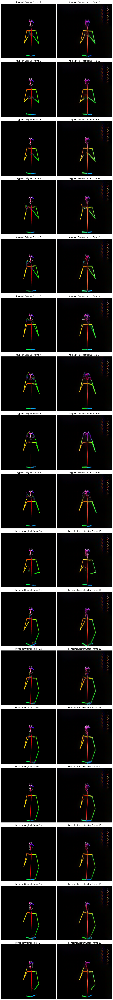

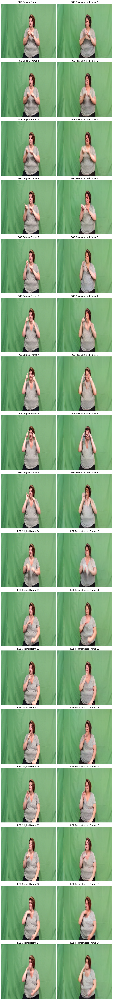

In [11]:

# Cell 7: Process a single sample
sample_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes/_0fO5ETSwyg_3-5-rgb_front"  # Example directory
rgb_dir = os.path.join(sample_dir, "rgb_keyframes")
keypoint_dir = os.path.join(sample_dir, "pose_keyframes")

# Load frames
rgb_frames = load_frames(rgb_dir)
keypoint_frames = load_frames(keypoint_dir)

if rgb_frames is not None and keypoint_frames is not None:
    print(f"Keypoint Frames Shape: {rgb_frames.shape}")
    print(f"RGB Frames Shape: {keypoint_frames.shape}")

    # Tokenize frames
    rgb_tokens = tokenize_frames(rgb_frames, image_tokenizer)
    keypoint_tokens = tokenize_frames(keypoint_frames, image_tokenizer)
    print(f"Keypoint Tokens Shape: {rgb_tokens.shape}")
    print(f"RGB Tokens Shape: {keypoint_tokens.shape}")

    # Reconstruct for visualization
    rgb_reconst = image_tokenizer.decode(rgb_tokens).float().clamp(-1, 1)
    keypoint_reconst = image_tokenizer.decode(keypoint_tokens).float().clamp(-1, 1)

    # Visualize first 3 frames
    visualize_frames(rgb_frames, rgb_reconst, "Keypoint", num_frames=17)
    visualize_frames(keypoint_frames, keypoint_reconst, "RGB", num_frames=17)


_______________________________________________________________________________

>i won't execute this for now 

In [ ]:
# Cell 8: Process the entire dataset
# def process_dataset(dataset_dir, output_dir, num_frames=17):
#     """Tokenize all samples in the dataset and save results as .npy files."""
#     os.makedirs(output_dir, exist_ok=True)
#     sample_dirs = [d for d in glob.glob(os.path.join(dataset_dir, "*")) if os.path.isdir(d)]
    
#     for sample_dir in tqdm(sample_dirs, desc="Processing samples"):
#         sample_name = os.path.basename(sample_dir)
#         rgb_dir = os.path.join(sample_dir, "rgb_keyframes")
#         keypoint_dir = os.path.join(sample_dir, "pose_keyframes")
        
#         # Load frames
#         rgb_frames = load_frames(rgb_dir, num_frames)
#         keypoint_frames = load_frames(keypoint_dir, num_frames)
        
#         if rgb_frames is None or keypoint_frames is None:
#             print(f"Skipping {sample_name} due to missing frames")
#             continue
        
#         # Tokenize
#         rgb_tokens = tokenize_frames(rgb_frames, image_tokenizer)
#         keypoint_tokens = tokenize_frames(keypoint_frames, image_tokenizer)
        
#         # Save tokens as .npy files
#         output_sample_dir = os.path.join(output_dir, sample_name)
#         os.makedirs(output_sample_dir, exist_ok=True)
#         np.save(os.path.join(output_sample_dir, "rgb_tokens.npy"), rgb_tokens.cpu().numpy())
#         np.save(os.path.join(output_sample_dir, "keypoint_tokens.npy"), keypoint_tokens.cpu().numpy())
#         print(f"Saved tokens for {sample_name}")

# # Run full dataset processing
# dataset_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes"
# output_dir = "/work/com-304/IAY_neurons_u2/dataset/tokenized"
# process_dataset(dataset_dir, output_dir)

> ill try to make the sign more appearable .

In [19]:
from scipy.ndimage import gaussian_filter

In [20]:
# Cell 4: Function to preprocess images (enhance lines and convert to heatmap-like representation)
def preprocess_image(img):
    """Preprocess image by enhancing lines and converting to a heatmap-like representation."""
    img_array = np.array(img.convert('L'))  # Convert to grayscale
    # Apply Gaussian filter to create a heatmap-like effect
    img_array = gaussian_filter(img_array, sigma=2)
    # Binarize to enhance contrast (thresholding)
    img_array = (img_array > 0).astype(np.uint8) * 255
    return Image.fromarray(img_array).convert('RGB')



In [21]:
# Cell 5: Function to load and preprocess frames
def load_frames(directory, num_frames=17, resize=(256, 256)):
    """Load and preprocess frames from a directory, sorting by frame number."""
    # Get all .jpg files
    image_files = glob.glob(os.path.join(directory, "*.jpg"))
    
    # Extract frame number from filename (e.g., keyframe_01_idx4.jpg -> 01)
    def get_frame_number(filename):
        match = re.search(r'keyframe_(\d{2})_idx\d+\.jpg', os.path.basename(filename))
        return int(match.group(1)) if match else float('inf')
    
    # Sort files by frame number
    image_files = sorted(image_files, key=get_frame_number)
    
    if len(image_files) != num_frames:
        print(f"Warning: Found {len(image_files)} images in {directory}, expected {num_frames}")
        return None
    
    frames = []
    for img_path in image_files:
        img = Image.open(img_path).resize(resize)
        # Apply preprocessing to both RGB and keypoint frames
        if 'rgb_keyframes' in directory or 'pose_keyframes' in directory:
            img = preprocess_image(img)
        else:
            img = img.convert('RGB')
        img_tensor = TF.to_tensor(img).to(device).unsqueeze(0) * 2 - 1  # Normalize to [-1, 1]
        frames.append(img_tensor)
    
    return torch.cat(frames, dim=0)  # Shape: [num_frames, 3, 256, 256]




In [22]:
# Cell 6: Function to tokenize frames
def tokenize_frames(frames, tokenizer):
    """Tokenize a batch of frames."""
    tokens_list = []
    for i in range(frames.shape[0]):
        frame = frames[i:i+1]  # Process one frame at a time
        tokens, _ = tokenizer.encode(frame)
        tokens_list.append(tokens)
    tokens = torch.cat(tokens_list, dim=0)  # Shape: [num_frames, num_tokens]
    return tokens


In [23]:
# Cell 7: Function to visualize original and reconstructed frames
def visualize_frames(original_frames, reconstructed_frames, title_prefix, num_frames=3):
    """Visualize original and reconstructed frames."""
    fig, axes = plt.subplots(nrows=num_frames, ncols=2, figsize=(10, 5*num_frames))
    for i in range(min(num_frames, original_frames.shape[0])):
        # Original
        axes[i, 0].imshow(original_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 0].set_title(f'{title_prefix} Original Frame {i+1}')
        axes[i, 0].axis('off')
        # Reconstructed
        axes[i, 1].imshow(reconstructed_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 1].set_title(f'{title_prefix} Reconstructed Frame {i+1}')
        axes[i, 1].axis('off')
    plt.tight_layout()
    plt.show()


RGB Frames Shape: torch.Size([17, 3, 256, 256])
Keypoint Frames Shape: torch.Size([17, 3, 256, 256])
RGB Tokens Shape: torch.Size([17, 16, 16])
Keypoint Tokens Shape: torch.Size([17, 16, 16])


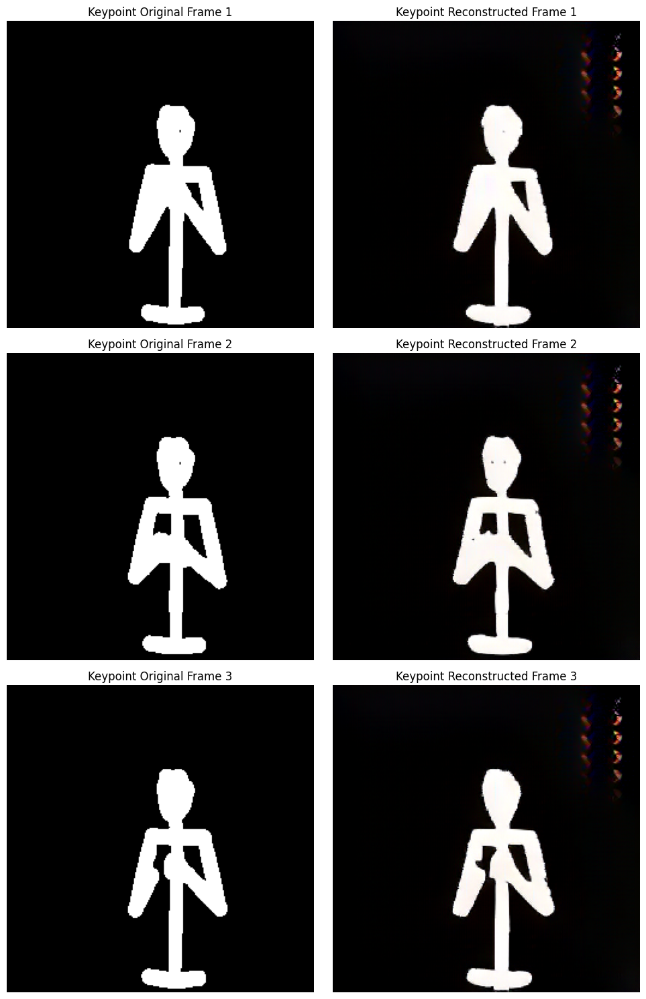

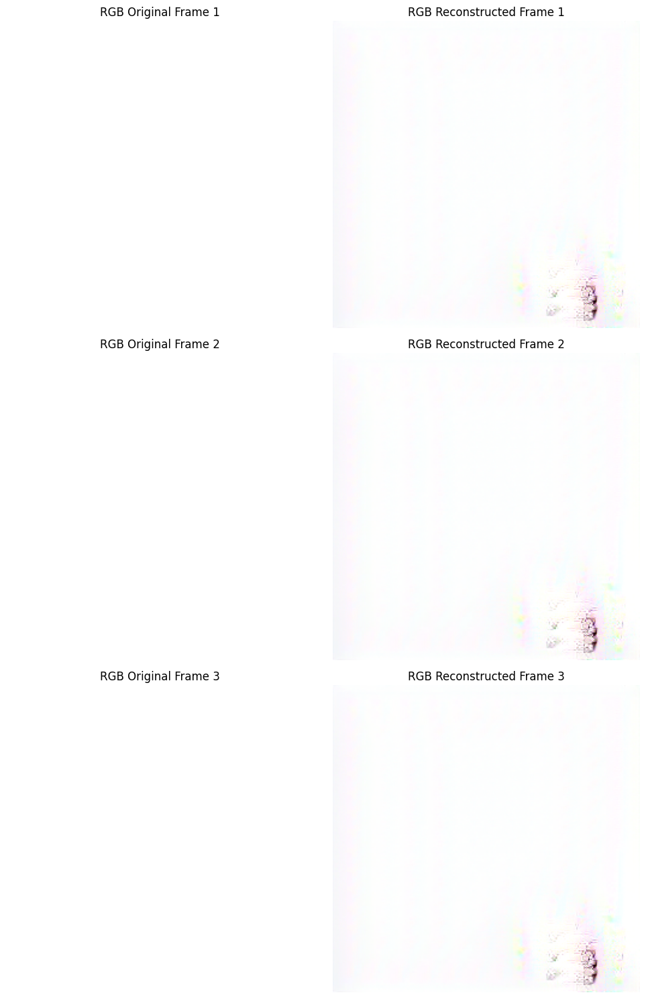

In [24]:

# Cell 8: Process a single sample
sample_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes/_0fO5ETSwyg_3-5-rgb_front"  # Example directory
rgb_dir = os.path.join(sample_dir, "rgb_keyframes")
keypoint_dir = os.path.join(sample_dir, "pose_keyframes")

# Load frames with preprocessing
rgb_frames = load_frames(rgb_dir)
keypoint_frames = load_frames(keypoint_dir)

if rgb_frames is not None and keypoint_frames is not None:
    print(f"RGB Frames Shape: {rgb_frames.shape}")
    print(f"Keypoint Frames Shape: {keypoint_frames.shape}")

    # Tokenize frames
    rgb_tokens = tokenize_frames(rgb_frames, image_tokenizer)
    keypoint_tokens = tokenize_frames(keypoint_frames, image_tokenizer)
    print(f"RGB Tokens Shape: {rgb_tokens.shape}")
    print(f"Keypoint Tokens Shape: {keypoint_tokens.shape}")

    # Reconstruct for visualization
    rgb_reconst = image_tokenizer.decode(rgb_tokens).float().clamp(-1, 1)
    keypoint_reconst = image_tokenizer.decode(keypoint_tokens).float().clamp(-1, 1)

    # Visualize first 3 frames
    visualize_frames(rgb_frames, rgb_reconst, "Keypoint", num_frames=3)
    visualize_frames(keypoint_frames, keypoint_reconst, "RGB", num_frames=3)

RGB Frames Shape: torch.Size([17, 3, 256, 256])
Keypoint Frames Shape: torch.Size([17, 3, 256, 256])
RGB Tokens Shape: torch.Size([17, 16, 16])
Keypoint Tokens Shape: torch.Size([17, 16, 16])


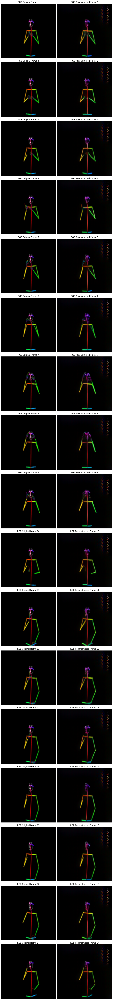

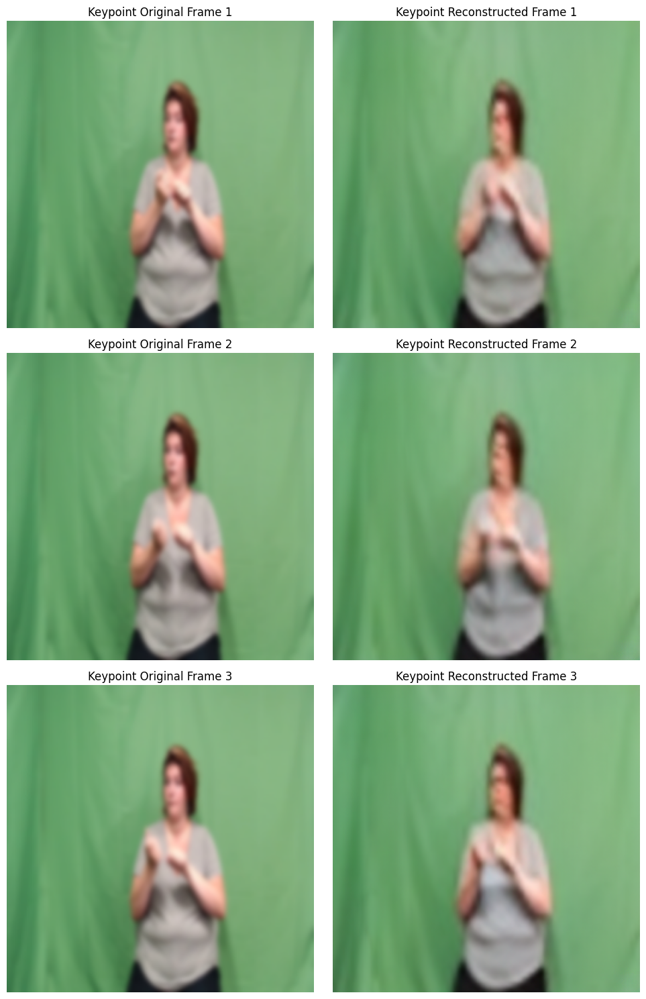

In [26]:
# Cell 4: Function to preprocess images
def preprocess_image(img, modality='keypoint'):
    """Preprocess image based on modality (keypoint or rgb)."""
    img_array = np.array(img)  # Shape: [H, W, 3]
    
    if modality == 'keypoint':
        # Process each channel separately to preserve colors
        for channel in range(3):  # R, G, B channels
            img_array[:, :, channel] = gaussian_filter(img_array[:, :, channel], sigma=2)
        # Normalize to [0, 255] range
        img_array = (img_array / img_array.max() * 255).astype(np.uint8)
    else:  # modality == 'rgb'
        # Apply Gaussian filter to each channel to enhance edges, but keep colors
        for channel in range(3):
            img_array[:, :, channel] = gaussian_filter(img_array[:, :, channel], sigma=1)
        # Normalize to [0, 255] range
        img_array = (img_array / img_array.max() * 255).astype(np.uint8)
    
    return Image.fromarray(img_array)

# Cell 5: Function to load and preprocess frames
def load_frames(directory, num_frames=17, resize=(256, 256)):
    """Load and preprocess frames from a directory, sorting by frame number."""
    # Get all .jpg files
    image_files = glob.glob(os.path.join(directory, "*.jpg"))
    
    # Extract frame number from filename (e.g., keyframe_01_idx4.jpg -> 01)
    def get_frame_number(filename):
        match = re.search(r'keyframe_(\d{2})_idx\d+\.jpg', os.path.basename(filename))
        return int(match.group(1)) if match else float('inf')
    
    # Sort files by frame number
    image_files = sorted(image_files, key=get_frame_number)
    
    if len(image_files) != num_frames:
        print(f"Warning: Found {len(image_files)} images in {directory}, expected {num_frames}")
        return None
    
    frames = []
    modality = 'keypoint' if 'pose_keyframes' in directory else 'rgb'
    for img_path in image_files:
        img = Image.open(img_path).resize(resize).convert('RGB')
        # Apply preprocessing based on modality
        img = preprocess_image(img, modality=modality)
        img_tensor = TF.to_tensor(img).to(device).unsqueeze(0) * 2 - 1  # Normalize to [-1, 1]
        frames.append(img_tensor)
    
    return torch.cat(frames, dim=0)  # Shape: [num_frames, 3, 256, 256]

# Cell 6: Function to tokenize frames
def tokenize_frames(frames, tokenizer):
    """Tokenize a batch of frames."""
    tokens_list = []
    for i in range(frames.shape[0]):
        frame = frames[i:i+1]  # Process one frame at a time
        tokens, _ = tokenizer.encode(frame)
        tokens_list.append(tokens)
    tokens = torch.cat(tokens_list, dim=0)  # Shape: [num_frames, num_tokens]
    return tokens

# Cell 7: Function to visualize original and reconstructed frames
def visualize_frames(original_frames, reconstructed_frames, title_prefix, num_frames=3):
    """Visualize original and reconstructed frames."""
    fig, axes = plt.subplots(nrows=num_frames, ncols=2, figsize=(10, 5*num_frames))
    for i in range(min(num_frames, original_frames.shape[0])):
        # Original
        axes[i, 0].imshow(original_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 0].set_title(f'{title_prefix} Original Frame {i+1}')
        axes[i, 0].axis('off')
        # Reconstructed
        axes[i, 1].imshow(reconstructed_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 1].set_title(f'{title_prefix} Reconstructed Frame {i+1}')
        axes[i, 1].axis('off')
    plt.tight_layout()
    plt.show()

# Cell 8: Process a single sample
sample_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes/_0fO5ETSwyg_3-5-rgb_front"  # Example directory
rgb_dir = os.path.join(sample_dir, "rgb_keyframes")
keypoint_dir = os.path.join(sample_dir, "pose_keyframes")

# Load frames with preprocessing
rgb_frames = load_frames(rgb_dir)
keypoint_frames = load_frames(keypoint_dir)

if rgb_frames is not None and keypoint_frames is not None:
    print(f"RGB Frames Shape: {rgb_frames.shape}")
    print(f"Keypoint Frames Shape: {keypoint_frames.shape}")

    # Tokenize frames
    rgb_tokens = tokenize_frames(rgb_frames, image_tokenizer)
    keypoint_tokens = tokenize_frames(keypoint_frames, image_tokenizer)
    print(f"RGB Tokens Shape: {rgb_tokens.shape}")
    print(f"Keypoint Tokens Shape: {keypoint_tokens.shape}")

    # Reconstruct for visualization
    rgb_reconst = image_tokenizer.decode(rgb_tokens).float().clamp(-1, 1)
    keypoint_reconst = image_tokenizer.decode(keypoint_tokens).float().clamp(-1, 1)

    # Visualize first 3 frames
    visualize_frames(rgb_frames, rgb_reconst, "RGB", num_frames=17)
    visualize_frames(keypoint_frames, keypoint_reconst, "Keypoint", num_frames=3)


In [38]:
# Run full dataset processing
#dataset_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes"
#output_dir = "/work/com-304/IAY_neurons_u2/dataset/tokenized"
#process_dataset(dataset_dir, output_dir)

In [28]:
import json  # Explicitly ensure json module is imported

RGB Frames Shape: torch.Size([17, 3, 256, 256])
Keypoint Frames Shape: torch.Size([17, 3, 256, 256])
RGB Tokens Shape: torch.Size([17, 16, 16])
Keypoint Tokens Shape: torch.Size([17, 16, 16])


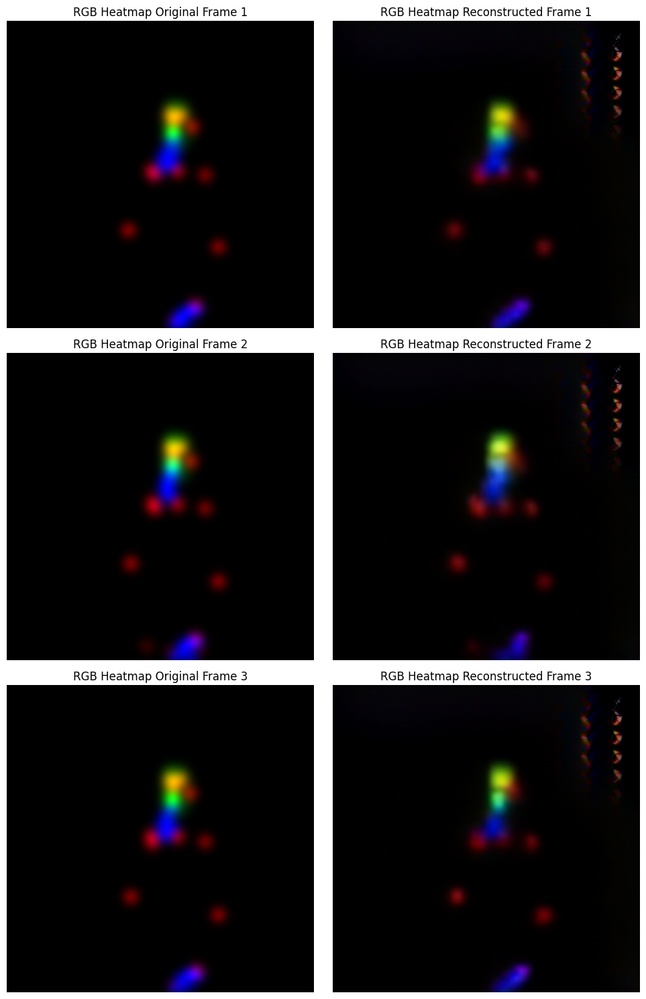

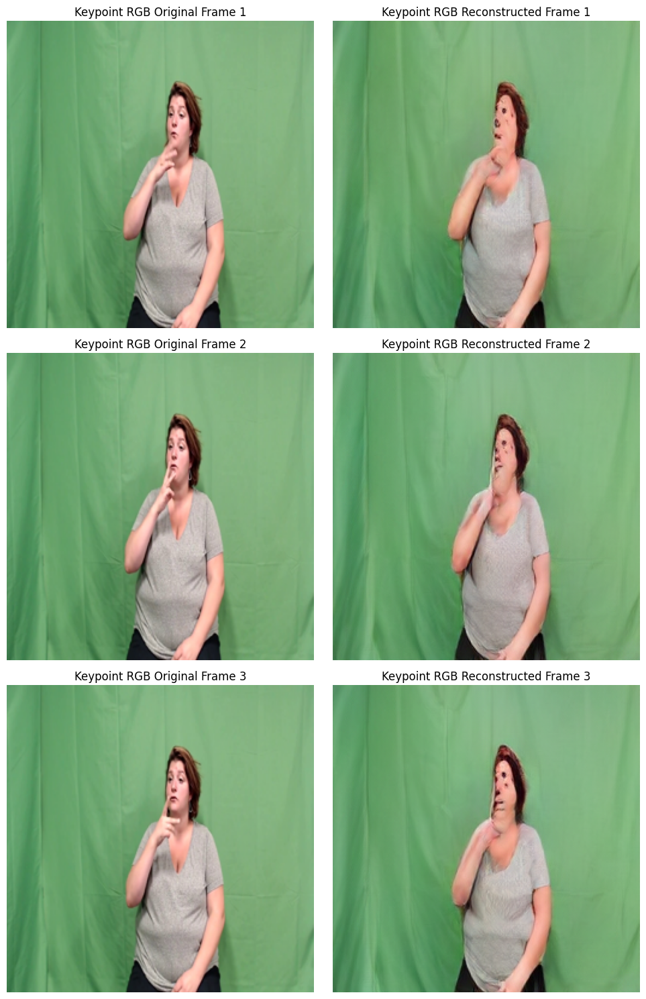

In [29]:
# Cell 4: Function to generate heatmap from keypoint coordinates
def generate_heatmap_from_keypoints(keypoints, height=256, width=256, sigma=5, weight=1.0):
    """Generate a heatmap from keypoint coordinates."""
    heatmap = np.zeros((height, width), dtype=np.float32)
    for i in range(0, len(keypoints), 3):
        x, y, conf = keypoints[i:i+3]
        if conf > 0:  # Only include keypoints with non-zero confidence
            x, y = int(x * width / 1280), int(y * height / 720)  # Scale coordinates to 256x256
            if 0 <= x < width and 0 <= y < height:
                # Create a Gaussian blob at the keypoint location
                for i in range(height):
                    for j in range(width):
                        heatmap[i, j] += conf * weight * np.exp(-((i - y) ** 2 + (j - x) ** 2) / (2 * sigma ** 2))
    # Normalize heatmap to [0, 1]
    if heatmap.max() > 0:
        heatmap = heatmap / heatmap.max()
    return heatmap

# Cell 5: Function to load and preprocess frames
def load_frames(directory, json_dir=None, num_frames=17, resize=(256, 256)):
    """Load and preprocess frames from a directory, sorting by frame number and mapping JSON indices."""
    if 'rgb_keyframes' in directory and json_dir:  # Corrected: rgb_keyframes now contains pose keypoints
        # Load JSON files
        json_files = sorted(glob.glob(os.path.join(json_dir, "*.json")))
        if len(json_files) < num_frames:
            print(f"Warning: Found {len(json_files)} JSON files in {json_dir}, expected at least {num_frames}")
            return None
        
        # Extract indices from JSON filenames
        json_indices = {}
        for json_path in json_files:
            match = re.search(r'_(\d{12})_keypoints\.json', os.path.basename(json_path))
            if match:
                index = int(match.group(1))  # e.g., 000000000101
                json_indices[index] = json_path
        
        # Load image files and extract their indices
        image_files = glob.glob(os.path.join(directory, "*.jpg"))
        if len(image_files) != num_frames:
            print(f"Warning: Found {len(image_files)} images in {directory}, expected {num_frames}")
            return None
        
        # Extract indices from image filenames
        image_indices = {}
        for img_path in image_files:
            match = re.search(r'keyframe_\d{2}_idx(\d+)\.jpg', os.path.basename(img_path))
            if match:
                index = int(match.group(1))  # e.g., 101 from idx101
                image_indices[index] = img_path
        
        # Match JSON files to image files based on indices
        frames = []
        for img_index in sorted(image_indices.keys()):
            if img_index in json_indices:
                json_path = json_indices[img_index]
                with open(json_path, 'r') as f:
                    data = json.load(f)
                person = data['people'][0] if data['people'] else None
                if not person:
                    print(f"No person data in {json_path} for index {img_index}")
                    return None
                
                # Generate heatmaps for different keypoint types
                pose_heatmap = generate_heatmap_from_keypoints(person['pose_keypoints_2d'], weight=0.5)
                face_heatmap = generate_heatmap_from_keypoints(person['face_keypoints_2d'], weight=0.8)
                hand_left_heatmap = generate_heatmap_from_keypoints(person['hand_left_keypoints_2d'], weight=1.0)
                hand_right_heatmap = generate_heatmap_from_keypoints(person['hand_right_keypoints_2d'], weight=1.0)
                
                # Combine heatmaps into an RGB image
                heatmap_rgb = np.zeros((256, 256, 3), dtype=np.float32)
                heatmap_rgb[:, :, 0] = pose_heatmap  # Red channel for pose
                heatmap_rgb[:, :, 1] = face_heatmap  # Green channel for face
                heatmap_rgb[:, :, 2] = hand_left_heatmap + hand_right_heatmap  # Blue channel for hands
                heatmap_rgb = np.clip(heatmap_rgb, 0, 1)
                
                # Convert to PIL Image
                img = Image.fromarray((heatmap_rgb * 255).astype(np.uint8))
                img_tensor = TF.to_tensor(img).to(device).unsqueeze(0) * 2 - 1  # Normalize to [-1, 1]
                frames.append(img_tensor)
            else:
                print(f"No matching JSON data for image index {img_index}")
                return None
        
        return torch.cat(frames, dim=0)  # Shape: [num_frames, 3, 256, 256]
    
    else:  # pose_keyframes now contains RGB frames
        image_files = glob.glob(os.path.join(directory, "*.jpg"))
        
        # Extract frame number from filename (e.g., keyframe_01_idx101.jpg -> 01)
        def get_frame_number(filename):
            match = re.search(r'keyframe_(\d{2})_idx\d+\.jpg', os.path.basename(filename))
            return int(match.group(1)) if match else float('inf')
        
        # Sort files by frame number
        image_files = sorted(image_files, key=get_frame_number)
        
        if len(image_files) != num_frames:
            print(f"Warning: Found {len(image_files)} images in {directory}, expected {num_frames}")
            return None
        
        frames = []
        for img_path in image_files:
            img = Image.open(img_path).resize(resize).convert('RGB')
            img_tensor = TF.to_tensor(img).to(device).unsqueeze(0) * 2 - 1  # Normalize to [-1, 1]
            frames.append(img_tensor)
        
        return torch.cat(frames, dim=0)  # Shape: [num_frames, 3, 256, 256]

# Cell 6: Function to tokenize frames
def tokenize_frames(frames, tokenizer):
    """Tokenize a batch of frames."""
    tokens_list = []
    for i in range(frames.shape[0]):
        frame = frames[i:i+1]  # Process one frame at a time
        tokens, _ = tokenizer.encode(frame)
        tokens_list.append(tokens)
    tokens = torch.cat(tokens_list, dim=0)  # Shape: [num_frames, num_tokens]
    return tokens

# Cell 7: Function to visualize original and reconstructed frames
def visualize_frames(original_frames, reconstructed_frames, title_prefix, num_frames=3):
    """Visualize original and reconstructed frames."""
    fig, axes = plt.subplots(nrows=num_frames, ncols=2, figsize=(10, 5*num_frames))
    for i in range(min(num_frames, original_frames.shape[0])):
        # Original
        axes[i, 0].imshow(original_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 0].set_title(f'{title_prefix} Original Frame {i+1}')
        axes[i, 0].axis('off')
        # Reconstructed
        axes[i, 1].imshow(reconstructed_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 1].set_title(f'{title_prefix} Reconstructed Frame {i+1}')
        axes[i, 1].axis('off')
    plt.tight_layout()
    plt.show()

# Cell 8: Process a single sample
sample_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes/_0fO5ETSwyg_0-5-rgb_front"  # Example directory
json_dir = "/work/com-304/IAY_neurons_u2/dataset/dataset_unprocessed/openpose_output/json/_0fO5ETSwyg_0-5-rgb_front"
rgb_dir = os.path.join(sample_dir, "rgb_keyframes")  # Now contains pose keypoints
keypoint_dir = os.path.join(sample_dir, "pose_keyframes")  # Now contains RGB frames

# Load frames with corrected mapping
rgb_frames = load_frames(rgb_dir, json_dir=json_dir)  # Process rgb_keyframes with JSON heatmaps
keypoint_frames = load_frames(keypoint_dir)  # Process pose_keyframes as RGB

if rgb_frames is not None and keypoint_frames is not None:
    print(f"RGB Frames Shape: {rgb_frames.shape}")  # Heatmap frames from rgb_keyframes
    print(f"Keypoint Frames Shape: {keypoint_frames.shape}")  # RGB frames from pose_keyframes

    # Tokenize frames
    rgb_tokens = tokenize_frames(rgb_frames, image_tokenizer)  # Tokens for heatmaps
    keypoint_tokens = tokenize_frames(keypoint_frames, image_tokenizer)  # Tokens for RGB
    print(f"RGB Tokens Shape: {rgb_tokens.shape}")
    print(f"Keypoint Tokens Shape: {keypoint_tokens.shape}")

    # Reconstruct for visualization
    rgb_reconst = image_tokenizer.decode(rgb_tokens).float().clamp(-1, 1)  # Reconstruct heatmaps
    keypoint_reconst = image_tokenizer.decode(keypoint_tokens).float().clamp(-1, 1)  # Reconstruct RGB

    # Visualize first 3 frames
    visualize_frames(rgb_frames, rgb_reconst, "RGB Heatmap", num_frames=3)  # Updated title for clarity
    visualize_frames(keypoint_frames, keypoint_reconst, "Keypoint RGB", num_frames=3)  # Updated title for clarity

In [31]:
from PIL import Image, ImageDraw

RGB Frames Shape: torch.Size([17, 3, 256, 256])
Keypoint Frames Shape: torch.Size([17, 3, 256, 256])
RGB Tokens Shape: torch.Size([17, 16, 16])
Keypoint Tokens Shape: torch.Size([17, 16, 16])


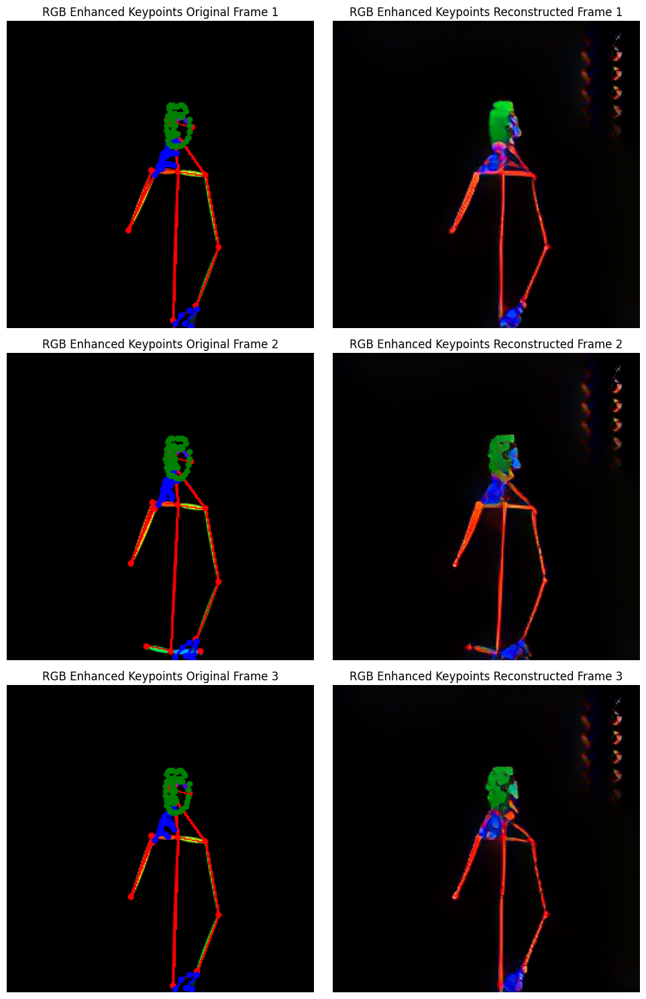

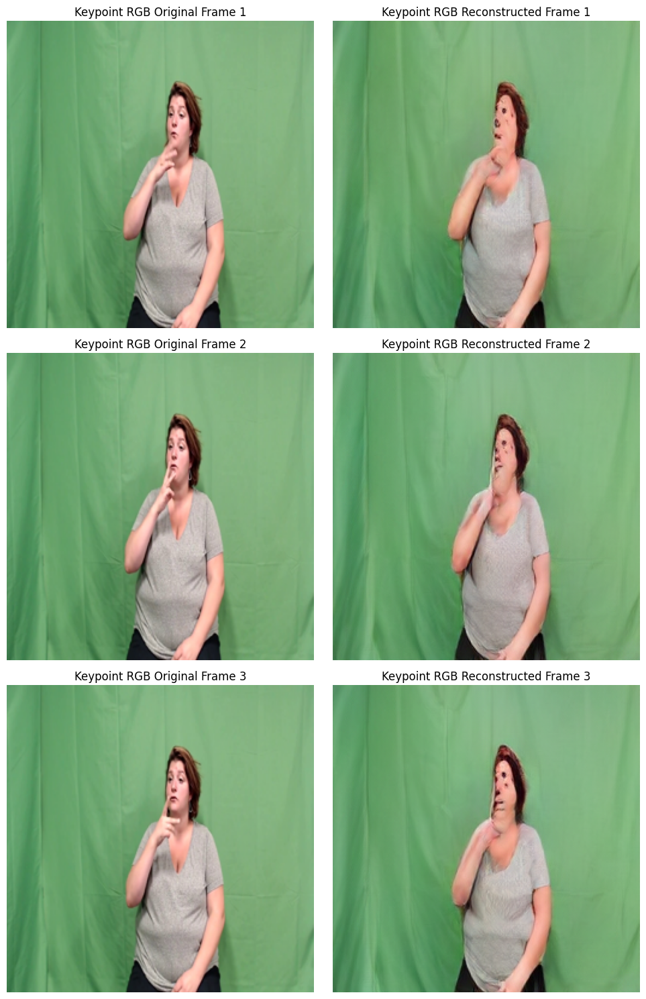

In [32]:
# Cell 4: Function to enhance keypoint image with JSON coordinates
def enhance_keypoint_image(img, keypoints_data, height=256, width=256):
    """Enhance the original keypoint image with JSON coordinates."""
    # Convert image to RGBA for drawing
    img_enhanced = img.convert('RGBA')
    draw = ImageDraw.Draw(img_enhanced)
    
    # Define keypoint connections for skeletal structure (simplified OpenPose format)
    pose_connections = [
        (0, 1), (1, 2), (2, 3), (3, 4),  # Head to torso
        (1, 5), (5, 6), (6, 7), (1, 8), (8, 9), (9, 10),  # Left arm
        (1, 11), (11, 12), (12, 13), (1, 14), (14, 15), (15, 16),  # Right arm
        (5, 17), (17, 18), (18, 19), (11, 20), (20, 21), (21, 22)  # Legs
    ]
    hand_connections = [
        (0, 1), (1, 2), (2, 3), (3, 4),  # Thumb
        (0, 5), (5, 6), (6, 7), (7, 8),  # Index
        (0, 9), (9, 10), (10, 11), (11, 12),  # Middle
        (0, 13), (13, 14), (14, 15), (15, 16),  # Ring
        (0, 17), (17, 18), (18, 19), (19, 20)  # Pinky
    ]
    
    # Scale coordinates from JSON (assumed 1280x720) to image size (256x256)
    def scale_coords(coords):
        return int(coords[0] * width / 1280), int(coords[1] * height / 720)
    
    # Extract keypoints
    pose_keypoints = keypoints_data.get('pose_keypoints_2d', [])
    face_keypoints = keypoints_data.get('face_keypoints_2d', [])
    hand_left_keypoints = keypoints_data.get('hand_left_keypoints_2d', [])
    hand_right_keypoints = keypoints_data.get('hand_right_keypoints_2d', [])
    
    # Draw pose keypoints and connections
    for i in range(0, len(pose_keypoints), 3):
        if i + 2 < len(pose_keypoints) and pose_keypoints[i + 2] > 0:
            x, y = scale_coords(pose_keypoints[i:i+2])
            if 0 <= x < width and 0 <= y < height:
                draw.ellipse([x-2, y-2, x+2, y+2], fill='red')
    for start, end in pose_connections:
        if start * 3 + 2 < len(pose_keypoints) and end * 3 + 2 < len(pose_keypoints):
            if pose_keypoints[start * 3 + 2] > 0 and pose_keypoints[end * 3 + 2] > 0:
                x1, y1 = scale_coords(pose_keypoints[start * 3:start * 3 + 2])
                x2, y2 = scale_coords(pose_keypoints[end * 3:end * 3 + 2])
                if (0 <= x1 < width and 0 <= y1 < height and 0 <= x2 < width and 0 <= y2 < height):
                    draw.line([x1, y1, x2, y2], fill='red', width=2)
    
    # Draw hand keypoints and connections (left hand with higher priority)
    for hand_keypoints, color in [(hand_left_keypoints, 'blue'), (hand_right_keypoints, 'blue')]:
        for i in range(0, len(hand_keypoints), 3):
            if i + 2 < len(hand_keypoints) and hand_keypoints[i + 2] > 0:
                x, y = scale_coords(hand_keypoints[i:i+2])
                if 0 <= x < width and 0 <= y < height:
                    draw.ellipse([x-2, y-2, x+2, y+2], fill=color)
        for start, end in hand_connections:
            if start * 3 + 2 < len(hand_keypoints) and end * 3 + 2 < len(hand_keypoints):
                if hand_keypoints[start * 3 + 2] > 0 and hand_keypoints[end * 3 + 2] > 0:
                    x1, y1 = scale_coords(hand_keypoints[start * 3:start * 3 + 2])
                    x2, y2 = scale_coords(hand_keypoints[end * 3:end * 3 + 2])
                    if (0 <= x1 < width and 0 <= y1 < height and 0 <= x2 < width and 0 <= y2 < height):
                        draw.line([x1, y1, x2, y2], fill=color, width=2)
    
    # Draw face keypoints (simplified, no connections for clarity)
    for i in range(0, len(face_keypoints), 3):
        if i + 2 < len(face_keypoints) and face_keypoints[i + 2] > 0:
            x, y = scale_coords(face_keypoints[i:i+2])
            if 0 <= x < width and 0 <= y < height:
                draw.ellipse([x-2, y-2, x+2, y+2], fill='green')
    
    # Convert back to RGB for tokenization
    return img_enhanced.convert('RGB')

# Cell 5: Function to load and preprocess frames
def load_frames(directory, json_dir=None, num_frames=17, resize=(256, 256)):
    """Load and preprocess frames from a directory, sorting by frame number and mapping JSON indices."""
    if 'rgb_keyframes' in directory and json_dir:  # rgb_keyframes contains pose keypoints
        # Load JSON files
        json_files = sorted(glob.glob(os.path.join(json_dir, "*.json")))
        if len(json_files) < num_frames:
            print(f"Warning: Found {len(json_files)} JSON files in {json_dir}, expected at least {num_frames}")
            return None
        
        # Extract indices from JSON filenames
        json_indices = {}
        for json_path in json_files:
            match = re.search(r'_(\d{12})_keypoints\.json', os.path.basename(json_path))
            if match:
                index = int(match.group(1))  # e.g., 000000000101
                json_indices[index] = json_path
        
        # Load image files and extract their indices
        image_files = glob.glob(os.path.join(directory, "*.jpg"))
        if len(image_files) != num_frames:
            print(f"Warning: Found {len(image_files)} images in {directory}, expected {num_frames}")
            return None
        
        # Extract indices from image filenames
        image_indices = {}
        for img_path in image_files:
            match = re.search(r'keyframe_\d{2}_idx(\d+)\.jpg', os.path.basename(img_path))
            if match:
                index = int(match.group(1))  # e.g., 101 from idx101
                image_indices[index] = img_path
        
        # Match JSON files to image files based on indices
        frames = []
        for img_index in sorted(image_indices.keys()):
            if img_index in json_indices:
                json_path = json_indices[img_index]
                with open(json_path, 'r') as f:
                    data = json.load(f)
                person = data['people'][0] if data['people'] else None
                if not person:
                    print(f"No person data in {json_path} for index {img_index}")
                    return None
                
                # Load and enhance the original keypoint image
                img_path = image_indices[img_index]
                img = Image.open(img_path).resize(resize).convert('RGB')
                img_enhanced = enhance_keypoint_image(img, person)
                img_tensor = TF.to_tensor(img_enhanced).to(device).unsqueeze(0) * 2 - 1  # Normalize to [-1, 1]
                frames.append(img_tensor)
            else:
                print(f"No matching JSON data for image index {img_index}")
                return None
        
        return torch.cat(frames, dim=0)  # Shape: [num_frames, 3, 256, 256]
    
    else:  # pose_keyframes contains RGB frames
        image_files = glob.glob(os.path.join(directory, "*.jpg"))
        
        # Extract frame number from filename (e.g., keyframe_01_idx101.jpg -> 01)
        def get_frame_number(filename):
            match = re.search(r'keyframe_(\d{2})_idx\d+\.jpg', os.path.basename(filename))
            return int(match.group(1)) if match else float('inf')
        
        # Sort files by frame number
        image_files = sorted(image_files, key=get_frame_number)
        
        if len(image_files) != num_frames:
            print(f"Warning: Found {len(image_files)} images in {directory}, expected {num_frames}")
            return None
        
        frames = []
        for img_path in image_files:
            img = Image.open(img_path).resize(resize).convert('RGB')
            img_tensor = TF.to_tensor(img).to(device).unsqueeze(0) * 2 - 1  # Normalize to [-1, 1]
            frames.append(img_tensor)
        
        return torch.cat(frames, dim=0)  # Shape: [num_frames, 3, 256, 256]

# Cell 6: Function to tokenize frames
def tokenize_frames(frames, tokenizer):
    """Tokenize a batch of frames."""
    tokens_list = []
    for i in range(frames.shape[0]):
        frame = frames[i:i+1]  # Process one frame at a time
        tokens, _ = tokenizer.encode(frame)
        tokens_list.append(tokens)
    tokens = torch.cat(tokens_list, dim=0)  # Shape: [num_frames, num_tokens]
    return tokens

# Cell 7: Function to visualize original and reconstructed frames
def visualize_frames(original_frames, reconstructed_frames, title_prefix, num_frames=3):
    """Visualize original and reconstructed frames."""
    fig, axes = plt.subplots(nrows=num_frames, ncols=2, figsize=(10, 5*num_frames))
    for i in range(min(num_frames, original_frames.shape[0])):
        # Original
        axes[i, 0].imshow(original_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 0].set_title(f'{title_prefix} Original Frame {i+1}')
        axes[i, 0].axis('off')
        # Reconstructed
        axes[i, 1].imshow(reconstructed_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 1].set_title(f'{title_prefix} Reconstructed Frame {i+1}')
        axes[i, 1].axis('off')
    plt.tight_layout()
    plt.show()

# Cell 8: Process a single sample
sample_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes/_0fO5ETSwyg_0-5-rgb_front"  # Example directory
json_dir = "/work/com-304/IAY_neurons_u2/dataset/dataset_unprocessed/openpose_output/json/_0fO5ETSwyg_0-5-rgb_front"
rgb_dir = os.path.join(sample_dir, "rgb_keyframes")  # Contains pose keypoints
keypoint_dir = os.path.join(sample_dir, "pose_keyframes")  # Contains RGB frames

# Load frames with corrected mapping
rgb_frames = load_frames(rgb_dir, json_dir=json_dir)  # Process rgb_keyframes with JSON enhancement
keypoint_frames = load_frames(keypoint_dir)  # Process pose_keyframes as RGB

if rgb_frames is not None and keypoint_frames is not None:
    print(f"RGB Frames Shape: {rgb_frames.shape}")  # Enhanced keypoint frames
    print(f"Keypoint Frames Shape: {keypoint_frames.shape}")  # RGB frames

    # Tokenize frames
    rgb_tokens = tokenize_frames(rgb_frames, image_tokenizer)  # Tokens for enhanced keypoints
    keypoint_tokens = tokenize_frames(keypoint_frames, image_tokenizer)  # Tokens for RGB
    print(f"RGB Tokens Shape: {rgb_tokens.shape}")
    print(f"Keypoint Tokens Shape: {keypoint_tokens.shape}")

    # Reconstruct for visualization
    rgb_reconst = image_tokenizer.decode(rgb_tokens).float().clamp(-1, 1)  # Reconstruct enhanced keypoints
    keypoint_reconst = image_tokenizer.decode(keypoint_tokens).float().clamp(-1, 1)  # Reconstruct RGB

    # Visualize first 3 frames
    visualize_frames(rgb_frames, rgb_reconst, "RGB Enhanced Keypoints", num_frames=3)
    visualize_frames(keypoint_frames, keypoint_reconst, "Keypoint RGB", num_frames=3)

>we will add some post processing of the output for smoothness

In [33]:
import cv2  # Added for post-processing

In [34]:
def visualize_frames(original_frames, reconstructed_frames, title_prefix, num_frames=3):
    """Visualize original and reconstructed frames."""
    fig, axes = plt.subplots(nrows=num_frames, ncols=2, figsize=(10, 5*num_frames))
    for i in range(min(num_frames, original_frames.shape[0])):
        # Original
        axes[i, 0].imshow(original_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 0].set_title(f'{title_prefix} Original Frame {i+1}')
        axes[i, 0].axis('off')
        # Reconstructed (apply smoothing)
        recon_img = (reconstructed_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5) * 255
        recon_img = recon_img.astype(np.uint8)
        recon_img = cv2.GaussianBlur(recon_img, (5, 5), 1.0)  # Apply Gaussian blur for smoothness
        axes[i, 1].imshow(recon_img)
        axes[i, 1].set_title(f'{title_prefix} Reconstructed Frame {i+1}')
        axes[i, 1].axis('off')
    plt.tight_layout()
    plt.show()

RGB Frames Shape: torch.Size([17, 3, 256, 256])
Keypoint Frames Shape: torch.Size([17, 3, 256, 256])
RGB Tokens Shape: torch.Size([17, 16, 16])
Keypoint Tokens Shape: torch.Size([17, 16, 16])


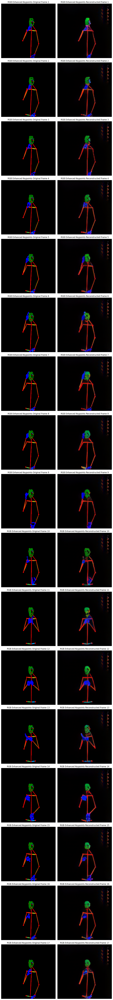

In [37]:
# Cell 8: Process a single sample
sample_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes/_0fO5ETSwyg_0-5-rgb_front"  # Example directory
json_dir = "/work/com-304/IAY_neurons_u2/dataset/dataset_unprocessed/openpose_output/json/_0fO5ETSwyg_0-5-rgb_front"
rgb_dir = os.path.join(sample_dir, "rgb_keyframes")  # Contains pose keypoints
keypoint_dir = os.path.join(sample_dir, "pose_keyframes")  # Contains RGB frames

# Load frames with corrected mapping
rgb_frames = load_frames(rgb_dir, json_dir=json_dir)  # Process rgb_keyframes with JSON enhancement
keypoint_frames = load_frames(keypoint_dir)  # Process pose_keyframes as RGB

if rgb_frames is not None and keypoint_frames is not None:
    print(f"RGB Frames Shape: {rgb_frames.shape}")  # Enhanced keypoint frames
    print(f"Keypoint Frames Shape: {keypoint_frames.shape}")  # RGB frames

    # Tokenize frames
    rgb_tokens = tokenize_frames(rgb_frames, image_tokenizer)  # Tokens for enhanced keypoints
    keypoint_tokens = tokenize_frames(keypoint_frames, image_tokenizer)  # Tokens for RGB
    print(f"RGB Tokens Shape: {rgb_tokens.shape}")
    print(f"Keypoint Tokens Shape: {keypoint_tokens.shape}")

    # Reconstruct for visualization
    rgb_reconst = image_tokenizer.decode(rgb_tokens).float().clamp(-1, 1)  # Reconstruct enhanced keypoints
    keypoint_reconst = image_tokenizer.decode(keypoint_tokens).float().clamp(-1, 1)  # Reconstruct RGB

    # Visualize first 3 frames
    visualize_frames(rgb_frames, rgb_reconst, "RGB Enhanced Keypoints", num_frames=17)
    #visualize_frames(keypoint_frames, keypoint_reconst, "Keypoint RGB", num_frames=17)

RGB Frames Shape: torch.Size([17, 3, 256, 256])
Keypoint Frames Shape: torch.Size([17, 3, 256, 256])
RGB Tokens Shape: torch.Size([17, 16, 16])
Keypoint Tokens Shape: torch.Size([17, 16, 16])


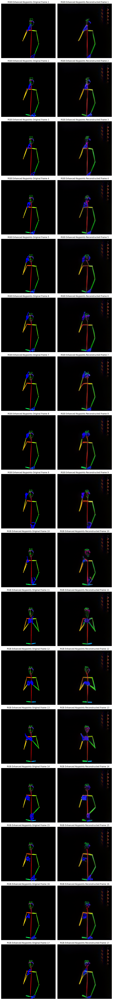

In [15]:
# Cell 4: Function to enhance keypoint image with JSON coordinates (hands and face only)
def enhance_keypoint_image(img, keypoints_data, height=256, width=256):
    """Enhance the original keypoint image with JSON coordinates for hands and face only."""
    # Convert image to RGBA for drawing
    img_enhanced = img.convert('RGBA')
    draw = ImageDraw.Draw(img_enhanced)
    
    # Hand connections (simplified OpenPose format for each finger)
    hand_connections = [
        (0, 1), (1, 2), (2, 3), (3, 4),  # Thumb
        (0, 5), (5, 6), (6, 7), (7, 8),  # Index
        (0, 9), (9, 10), (10, 11), (11, 12),  # Middle
        (0, 13), (13, 14), (14, 15), (15, 16),  # Ring
        (0, 17), (17, 18), (18, 19), (19, 20)  # Pinky
    ]
    
    # Scale coordinates from JSON (assumed 1280x720) to image size (256x256)
    def scale_coords(coords):
        return int(coords[0] * width / 1280), int(coords[1] * height / 720)
    
    # Extract keypoints
    face_keypoints = keypoints_data.get('face_keypoints_2d', [])
    hand_left_keypoints = keypoints_data.get('hand_left_keypoints_2d', [])
    hand_right_keypoints = keypoints_data.get('hand_right_keypoints_2d', [])
    
    # Draw hand keypoints and connections (left hand with higher priority)
    for hand_keypoints, color in [(hand_left_keypoints, 'blue'), (hand_right_keypoints, 'blue')]:
        for i in range(0, len(hand_keypoints), 3):
            if i + 2 < len(hand_keypoints) and hand_keypoints[i + 2] > 0:
                x, y = scale_coords(hand_keypoints[i:i+2])
                if 0 <= x < width and 0 <= y < height:
                    draw.ellipse([x-1.7, y-1.7, x+1.7, y+1.7], fill=color)
        for start, end in hand_connections:
            if start * 3 + 2 < len(hand_keypoints) and end * 3 + 2 < len(hand_keypoints):
                if hand_keypoints[start * 3 + 2] > 0 and hand_keypoints[end * 3 + 2] > 0:
                    x1, y1 = scale_coords(hand_keypoints[start * 3:start * 3 + 2])
                    x2, y2 = scale_coords(hand_keypoints[end * 3:end * 3 + 2])
                    if (0 <= x1 < width and 0 <= y1 < height and 0 <= x2 < width and 0 <= y2 < height):
                        draw.line([x1, y1, x2, y2], fill=color, width=2)
    
    # Draw face keypoints (simplified, no connections for clarity)
    for i in range(0, len(face_keypoints), 3):
        if i + 2 < len(face_keypoints) and face_keypoints[i + 2] > 0:
            x, y = scale_coords(face_keypoints[i:i+2])
            if 0 <= x < width and 0 <= y < height:
                draw.ellipse([x-1, y-1, x+1, y+1], fill='green')
    
    # Convert back to RGB, preserving original pose structure
    return img_enhanced.convert('RGB')

# Cell 5: Function to load and preprocess frames
def load_frames(directory, json_dir=None, num_frames=17, resize=(256, 256)):
    """Load and preprocess frames from a directory, sorting by frame number and mapping JSON indices."""
    if 'rgb_keyframes' in directory and json_dir:  # rgb_keyframes contains pose keypoints
        # Load JSON files
        json_files = sorted(glob.glob(os.path.join(json_dir, "*.json")))
        if len(json_files) < num_frames:
            print(f"Warning: Found {len(json_files)} JSON files in {json_dir}, expected at least {num_frames}")
            return None
        
        # Extract indices from JSON filenames
        json_indices = {}
        for json_path in json_files:
            match = re.search(r'_(\d{12})_keypoints\.json', os.path.basename(json_path))
            if match:
                index = int(match.group(1))  # e.g., 000000000101
                json_indices[index] = json_path
        
        # Load image files and extract their indices
        image_files = glob.glob(os.path.join(directory, "*.jpg"))
        if len(image_files) != num_frames:
            print(f"Warning: Found {len(image_files)} images in {directory}, expected {num_frames}")
            return None
        
        # Extract indices from image filenames
        image_indices = {}
        for img_path in image_files:
            match = re.search(r'keyframe_\d{2}_idx(\d+)\.jpg', os.path.basename(img_path))
            if match:
                index = int(match.group(1))  # e.g., 101 from idx101
                image_indices[index] = img_path
        
        # Match JSON files to image files based on indices
        frames = []
        for img_index in sorted(image_indices.keys()):
            if img_index in json_indices:
                json_path = json_indices[img_index]
                with open(json_path, 'r') as f:
                    data = json.load(f)
                person = data['people'][0] if data['people'] else None
                if not person:
                    print(f"No person data in {json_path} for index {img_index}")
                    return None
                
                # Load and enhance the original keypoint image (hands and face only)
                img_path = image_indices[img_index]
                img = Image.open(img_path).resize(resize).convert('RGB')
                img_enhanced = enhance_keypoint_image(img, person)
                img_tensor = TF.to_tensor(img_enhanced).to(device).unsqueeze(0) * 2 - 1  # Normalize to [-1, 1]
                frames.append(img_tensor)
            else:
                print(f"No matching JSON data for image index {img_index}")
                return None
        
        return torch.cat(frames, dim=0)  # Shape: [num_frames, 3, 256, 256]
    
    else:  # pose_keyframes contains RGB frames
        image_files = glob.glob(os.path.join(directory, "*.jpg"))
        
        # Extract frame number from filename (e.g., keyframe_01_idx101.jpg -> 01)
        def get_frame_number(filename):
            match = re.search(r'keyframe_(\d{2})_idx\d+\.jpg', os.path.basename(filename))
            return int(match.group(1)) if match else float('inf')
        
        # Sort files by frame number
        image_files = sorted(image_files, key=get_frame_number)
        
        if len(image_files) != num_frames:
            print(f"Warning: Found {len(image_files)} images in {directory}, expected {num_frames}")
            return None
        
        frames = []
        for img_path in image_files:
            img = Image.open(img_path).resize(resize).convert('RGB')
            img_tensor = TF.to_tensor(img).to(device).unsqueeze(0) * 2 - 1  # Normalize to [-1, 1]
            frames.append(img_tensor)
        
        return torch.cat(frames, dim=0)  # Shape: [num_frames, 3, 256, 256]

# Cell 6: Function to tokenize frames
def tokenize_frames(frames, tokenizer):
    """Tokenize a batch of frames."""
    tokens_list = []
    for i in range(frames.shape[0]):
        frame = frames[i:i+1]  # Process one frame at a time
        tokens, _ = tokenizer.encode(frame)
        tokens_list.append(tokens)
    tokens = torch.cat(tokens_list, dim=0)  # Shape: [num_frames, num_tokens]
    return tokens

# Cell 7: Function to visualize original and reconstructed frames
def visualize_frames(original_frames, reconstructed_frames, title_prefix, num_frames=3):
    """Visualize original and reconstructed frames."""
    fig, axes = plt.subplots(nrows=num_frames, ncols=2, figsize=(10, 5*num_frames))
    for i in range(min(num_frames, original_frames.shape[0])):
        # Original
        axes[i, 0].imshow(original_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 0].set_title(f'{title_prefix} Original Frame {i+1}')
        axes[i, 0].axis('off')
        # Reconstructed (apply smoothing)
        recon_img = (reconstructed_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5) * 255
        recon_img = recon_img.astype(np.uint8)
        recon_img = cv2.GaussianBlur(recon_img, (5, 5), 1.0)  # Apply Gaussian blur for smoothness
        axes[i, 1].imshow(recon_img)
        axes[i, 1].set_title(f'{title_prefix} Reconstructed Frame {i+1}')
        axes[i, 1].axis('off')
    plt.tight_layout()
    plt.show()

# Cell 8: Process a single sample
sample_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes/_0fO5ETSwyg_0-5-rgb_front"  # Example directory
json_dir = "/work/com-304/IAY_neurons_u2/dataset/dataset_unprocessed/openpose_output/json/_0fO5ETSwyg_0-5-rgb_front"
rgb_dir = os.path.join(sample_dir, "rgb_keyframes")  # Contains pose keypoints
keypoint_dir = os.path.join(sample_dir, "pose_keyframes")  # Contains RGB frames

# Load frames with corrected mapping
rgb_frames = load_frames(rgb_dir, json_dir=json_dir)  # Process rgb_keyframes with JSON enhancement (hands and face only)
keypoint_frames = load_frames(keypoint_dir)  # Process pose_keyframes as RGB

if rgb_frames is not None and keypoint_frames is not None:
    print(f"RGB Frames Shape: {rgb_frames.shape}")  # Enhanced keypoint frames (hands and face)
    print(f"Keypoint Frames Shape: {keypoint_frames.shape}")  # RGB frames

    # Tokenize frames
    rgb_tokens = tokenize_frames(rgb_frames, image_tokenizer)  # Tokens for enhanced keypoints
    keypoint_tokens = tokenize_frames(keypoint_frames, image_tokenizer)  # Tokens for RGB
    print(f"RGB Tokens Shape: {rgb_tokens.shape}")
    print(f"Keypoint Tokens Shape: {keypoint_tokens.shape}")

    # Reconstruct for visualization
    rgb_reconst = image_tokenizer.decode(rgb_tokens).float().clamp(-1, 1)  # Reconstruct enhanced keypoints
    keypoint_reconst = image_tokenizer.decode(keypoint_tokens).float().clamp(-1, 1)  # Reconstruct RGB

    # Visualize first 3 frames
    visualize_frames(rgb_frames, rgb_reconst, "RGB Enhanced Keypoints", num_frames=17)
    #visualize_frames(keypoint_frames, keypoint_reconst, "Keypoint RGB", num_frames=3)

--------------------------------------------------

> here the last solution for keypoints 

In [25]:
# Cell 4: Function to enhance keypoint image with JSON coordinates (hands and face only)
def enhance_keypoint_image(img, keypoints_data, height=256, width=256):
    """Enhance the original keypoint image with JSON coordinates for hands and face only."""
    # Convert image to RGBA for drawing
    img_enhanced = img.convert('RGBA')
    draw = ImageDraw.Draw(img_enhanced)
    
    # Hand connections (simplified OpenPose format for each finger)
    hand_connections = [
        (0, 1), (1, 2), (2, 3), (3, 4),  # Thumb
        (0, 5), (5, 6), (6, 7), (7, 8),  # Index
        (0, 9), (9, 10), (10, 11), (11, 12),  # Middle
        (0, 13), (13, 14), (14, 15), (15, 16),  # Ring
        (0, 17), (17, 18), (18, 19), (19, 20)  # Pinky
    ]
    
    # Scale coordinates from JSON (assumed 1280x720) to image size (256x256)
    def scale_coords(coords):
        return int(coords[0] * width / 1280), int(coords[1] * height / 720)
    
    # Extract keypoints
    face_keypoints = keypoints_data.get('face_keypoints_2d', [])
    hand_left_keypoints = keypoints_data.get('hand_left_keypoints_2d', [])
    hand_right_keypoints = keypoints_data.get('hand_right_keypoints_2d', [])
    
    # Draw hand keypoints and connections (left hand with higher priority)
    for hand_keypoints, color in [(hand_left_keypoints, 'blue'), (hand_right_keypoints, 'blue')]:
        for i in range(0, len(hand_keypoints), 3):
            if i + 2 < len(hand_keypoints) and hand_keypoints[i + 2] > 0:
                x, y = scale_coords(hand_keypoints[i:i+2])
                if 0 <= x < width and 0 <= y < height:
                    draw.ellipse([x-2, y-2, x+2, y+2], fill=color)  # Reduced thickness (radius 1)
        for start, end in hand_connections:
            if start * 3 + 2 < len(hand_keypoints) and end * 3 + 2 < len(hand_keypoints):
                if hand_keypoints[start * 3 + 2] > 0 and hand_keypoints[end * 3 + 2] > 0:
                    x1, y1 = scale_coords(hand_keypoints[start * 3:start * 3 + 2])
                    x2, y2 = scale_coords(hand_keypoints[end * 3:end * 3 + 2])
                    if (0 <= x1 < width and 0 <= y1 < height and 0 <= x2 < width and 0 <= y2 < height):
                        draw.line([x1, y1, x2, y2], fill=color, width=1)  # Reduced thickness (width 1)
    
    # Draw face keypoints (simplified, no connections for clarity)
    for i in range(0, len(face_keypoints), 3):
        if i + 2 < len(face_keypoints) and face_keypoints[i + 2] > 0:
            x, y = scale_coords(face_keypoints[i:i+2])
            if 0 <= x < width and 0 <= y < height:
                draw.ellipse([x-1.5, y-1.7, x+1.7, y+1.7], fill='green')  # Reduced thickness (radius 1)
    
    # Convert back to RGB, preserving original pose structure
    return img_enhanced.convert('RGB')

RGB Frames Shape: torch.Size([17, 3, 256, 256])
Keypoint Frames Shape: torch.Size([17, 3, 256, 256])
RGB Tokens Shape: torch.Size([17, 16, 16])
Keypoint Tokens Shape: torch.Size([17, 16, 16])


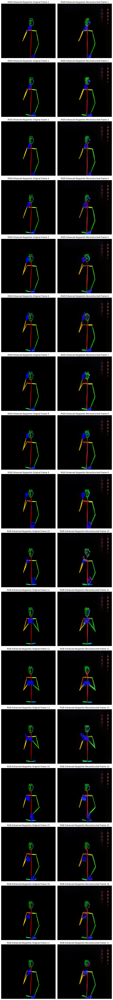

In [26]:
# Cell 5: Function to load and preprocess frames
def load_frames(directory, json_dir=None, num_frames=17, resize=(256, 256)):
    """Load and preprocess frames from a directory, sorting by frame number and mapping JSON indices."""
    if 'rgb_keyframes' in directory and json_dir:  # rgb_keyframes contains pose keypoints
        # Load JSON files
        json_files = sorted(glob.glob(os.path.join(json_dir, "*.json")))
        if len(json_files) < num_frames:
            print(f"Warning: Found {len(json_files)} JSON files in {json_dir}, expected at least {num_frames}")
            return None
        
        # Extract indices from JSON filenames
        json_indices = {}
        for json_path in json_files:
            match = re.search(r'_(\d{12})_keypoints\.json', os.path.basename(json_path))
            if match:
                index = int(match.group(1))  # e.g., 000000000101
                json_indices[index] = json_path
        
        # Load image files and extract their indices
        image_files = glob.glob(os.path.join(directory, "*.jpg"))
        if len(image_files) != num_frames:
            print(f"Warning: Found {len(image_files)} images in {directory}, expected {num_frames}")
            return None
        
        # Extract indices from image filenames
        image_indices = {}
        for img_path in image_files:
            match = re.search(r'keyframe_\d{2}_idx(\d+)\.jpg', os.path.basename(img_path))
            if match:
                index = int(match.group(1))  # e.g., 101 from idx101
                image_indices[index] = img_path
        
        # Match JSON files to image files based on indices
        frames = []
        for img_index in sorted(image_indices.keys()):
            if img_index in json_indices:
                json_path = json_indices[img_index]
                with open(json_path, 'r') as f:
                    data = json.load(f)
                person = data['people'][0] if data['people'] else None
                if not person:
                    print(f"No person data in {json_path} for index {img_index}")
                    return None
                
                # Load and enhance the original keypoint image (hands and face only)
                img_path = image_indices[img_index]
                img = Image.open(img_path).resize(resize).convert('RGB')
                img_enhanced = enhance_keypoint_image(img, person)
                img_tensor = TF.to_tensor(img_enhanced).to(device).unsqueeze(0) * 2 - 1  # Normalize to [-1, 1]
                frames.append(img_tensor)
            else:
                print(f"No matching JSON data for image index {img_index}")
                return None
        
        return torch.cat(frames, dim=0)  # Shape: [num_frames, 3, 256, 256]
    
    else:  # pose_keyframes contains RGB frames
        image_files = glob.glob(os.path.join(directory, "*.jpg"))
        
        # Extract frame number from filename (e.g., keyframe_01_idx101.jpg -> 01)
        def get_frame_number(filename):
            match = re.search(r'keyframe_(\d{2})_idx\d+\.jpg', os.path.basename(filename))
            return int(match.group(1)) if match else float('inf')
        
        # Sort files by frame number
        image_files = sorted(image_files, key=get_frame_number)
        
        if len(image_files) != num_frames:
            print(f"Warning: Found {len(image_files)} images in {directory}, expected {num_frames}")
            return None
        
        frames = []
        for img_path in image_files:
            img = Image.open(img_path).resize(resize).convert('RGB')
            img_tensor = TF.to_tensor(img).to(device).unsqueeze(0) * 2 - 1  # Normalize to [-1, 1]
            frames.append(img_tensor)
        
        return torch.cat(frames, dim=0)  # Shape: [num_frames, 3, 256, 256]

# Cell 6: Function to tokenize frames
def tokenize_frames(frames, tokenizer):
    """Tokenize a batch of frames."""
    tokens_list = []
    for i in range(frames.shape[0]):
        frame = frames[i:i+1]  # Process one frame at a time
        tokens, _ = tokenizer.encode(frame)
        tokens_list.append(tokens)
    tokens = torch.cat(tokens_list, dim=0)  # Shape: [num_frames, num_tokens]
    return tokens

# Cell 7: Function to visualize original and reconstructed frames
def visualize_frames(original_frames, reconstructed_frames, title_prefix, num_frames=3):
    """Visualize original and reconstructed frames."""
    fig, axes = plt.subplots(nrows=num_frames, ncols=2, figsize=(10, 5*num_frames))
    for i in range(min(num_frames, original_frames.shape[0])):
        # Original
        axes[i, 0].imshow(original_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 0].set_title(f'{title_prefix} Original Frame {i+1}')
        axes[i, 0].axis('off')
        # Reconstructed (apply smoothing)
        recon_img = (reconstructed_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5) * 255
        recon_img = recon_img.astype(np.uint8)
        recon_img = cv2.GaussianBlur(recon_img, (5, 5), 1.0)  # Apply Gaussian blur for smoothness
        axes[i, 1].imshow(recon_img)
        axes[i, 1].set_title(f'{title_prefix} Reconstructed Frame {i+1}')
        axes[i, 1].axis('off')
    plt.tight_layout()
    plt.show()

# Cell 8: Process a single sample
sample_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes/_0fO5ETSwyg_0-5-rgb_front"  # Example directory
json_dir = "/work/com-304/IAY_neurons_u2/dataset/dataset_unprocessed/openpose_output/json/_0fO5ETSwyg_0-5-rgb_front"
rgb_dir = os.path.join(sample_dir, "rgb_keyframes")  # Contains pose keypoints
keypoint_dir = os.path.join(sample_dir, "pose_keyframes")  # Contains RGB frames

# Load frames with corrected mapping
rgb_frames = load_frames(rgb_dir, json_dir=json_dir)  # Process rgb_keyframes with JSON enhancement (hands and face only)
keypoint_frames = load_frames(keypoint_dir)  # Process pose_keyframes as RGB

if rgb_frames is not None and keypoint_frames is not None:
    print(f"RGB Frames Shape: {rgb_frames.shape}")  # Enhanced keypoint frames (hands and face)
    print(f"Keypoint Frames Shape: {keypoint_frames.shape}")  # RGB frames

    # Tokenize frames
    rgb_tokens = tokenize_frames(rgb_frames, image_tokenizer)  # Tokens for enhanced keypoints
    keypoint_tokens = tokenize_frames(keypoint_frames, image_tokenizer)  # Tokens for RGB
    print(f"RGB Tokens Shape: {rgb_tokens.shape}")
    print(f"Keypoint Tokens Shape: {keypoint_tokens.shape}")

    # Reconstruct for visualization
    rgb_reconst = image_tokenizer.decode(rgb_tokens).float().clamp(-1, 1)  # Reconstruct enhanced keypoints
    keypoint_reconst = image_tokenizer.decode(keypoint_tokens).float().clamp(-1, 1)  # Reconstruct RGB

    # Visualize first 3 frames
    visualize_frames(rgb_frames, rgb_reconst, "RGB Enhanced Keypoints", num_frames=17)
    #visualize_frames(keypoint_frames, keypoint_reconst, "Keypoint RGB", num_frames=3)

>up best reconstruction for keypoints 

RGB Frames Shape: torch.Size([17, 3, 256, 256])
RGB Tokens Shape: torch.Size([17, 16, 16])


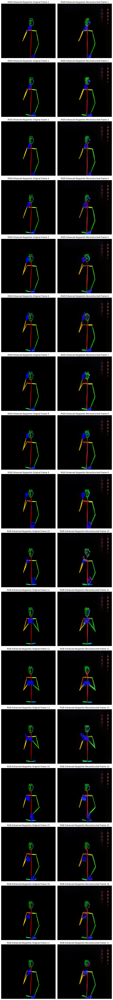

In [28]:
# Cell 4: Function to enhance keypoint image with JSON coordinates (hands and face only)
def enhance_keypoint_image(img, keypoints_data, height=256, width=256):
    """Enhance the original keypoint image with JSON coordinates for hands and face only."""
    # Convert image to RGBA for drawing
    img_enhanced = img.convert('RGBA')
    draw = ImageDraw.Draw(img_enhanced)
    
    # Hand connections (simplified OpenPose format for each finger)
    hand_connections = [
        (0, 1), (1, 2), (2, 3), (3, 4),  # Thumb
        (0, 5), (5, 6), (6, 7), (7, 8),  # Index
        (0, 9), (9, 10), (10, 11), (11, 12),  # Middle
        (0, 13), (13, 14), (14, 15), (15, 16),  # Ring
        (0, 17), (17, 18), (18, 19), (19, 20)  # Pinky
    ]
    
    # Scale coordinates from JSON (assumed 1280x720) to image size (256x256)
    def scale_coords(coords):
        return int(coords[0] * width / 1280), int(coords[1] * height / 720)
    
    # Extract keypoints
    face_keypoints = keypoints_data.get('face_keypoints_2d', [])
    hand_left_keypoints = keypoints_data.get('hand_left_keypoints_2d', [])
    hand_right_keypoints = keypoints_data.get('hand_right_keypoints_2d', [])
    
    # Draw hand keypoints and connections (left hand with higher priority)
    for hand_keypoints, color in [(hand_left_keypoints, 'blue'), (hand_right_keypoints, 'blue')]:
        for i in range(0, len(hand_keypoints), 3):
            if i + 2 < len(hand_keypoints) and hand_keypoints[i + 2] > 0:
                x, y = scale_coords(hand_keypoints[i:i+2])
                if 0 <= x < width and 0 <= y < height:
                    draw.ellipse([x-2, y-2, x+2, y+2], fill=color)  # Keypoint radius 2
        for start, end in hand_connections:
            if start * 3 + 2 < len(hand_keypoints) and end * 3 + 2 < len(hand_keypoints):
                if hand_keypoints[start * 3 + 2] > 0 and hand_keypoints[end * 3 + 2] > 0:
                    x1, y1 = scale_coords(hand_keypoints[start * 3:start * 3 + 2])
                    x2, y2 = scale_coords(hand_keypoints[end * 3:end * 3 + 2])
                    if (0 <= x1 < width and 0 <= y1 < height and 0 <= x2 < width and 0 <= y2 < height):
                        draw.line([x1, y1, x2, y2], fill=color, width=1)  # Line width 1
    
    # Draw face keypoints (simplified, no connections for clarity)
    for i in range(0, len(face_keypoints), 3):
        if i + 2 < len(face_keypoints) and face_keypoints[i + 2] > 0:
            x, y = scale_coords(face_keypoints[i:i+2])
            if 0 <= x < width and 0 <= y < height:
                draw.ellipse([x-1.5, y-1.7, x+1.7, y+1.7], fill='green')  # Slightly oval keypoint
    
    # Convert back to RGB, preserving original pose structure
    return img_enhanced.convert('RGB')

# Cell 5: Function to load and preprocess frames
def load_frames(directory, json_dir=None, num_frames=17, resize=(256, 256)):
    """Load and preprocess frames from a directory, sorting by frame number and mapping JSON indices."""
    if 'rgb_keyframes' in directory and json_dir:  # Process only rgb_keyframes with enhancement
        # Load JSON files
        json_files = sorted(glob.glob(os.path.join(json_dir, "*.json")))
        if len(json_files) < num_frames:
            print(f"Warning: Found {len(json_files)} JSON files in {json_dir}, expected at least {num_frames}")
            return None
        
        # Extract indices from JSON filenames
        json_indices = {}
        for json_path in json_files:
            match = re.search(r'_(\d{12})_keypoints\.json', os.path.basename(json_path))
            if match:
                index = int(match.group(1))  # e.g., 000000000101
                json_indices[index] = json_path
        
        # Load image files and extract their indices
        image_files = glob.glob(os.path.join(directory, "*.jpg"))
        if len(image_files) != num_frames:
            print(f"Warning: Found {len(image_files)} images in {directory}, expected {num_frames}")
            return None
        
        # Extract indices from image filenames
        image_indices = {}
        for img_path in image_files:
            match = re.search(r'keyframe_\d{2}_idx(\d+)\.jpg', os.path.basename(img_path))
            if match:
                index = int(match.group(1))  # e.g., 101 from idx101
                image_indices[index] = img_path
        
        # Match JSON files to image files based on indices
        frames = []
        for img_index in sorted(image_indices.keys()):
            if img_index in json_indices:
                json_path = json_indices[img_index]
                with open(json_path, 'r') as f:
                    data = json.load(f)
                person = data['people'][0] if data['people'] else None
                if not person:
                    print(f"No person data in {json_path} for index {img_index}")
                    return None
                
                # Load and enhance the original keypoint image (hands and face only)
                img_path = image_indices[img_index]
                img = Image.open(img_path).resize(resize).convert('RGB')
                img_enhanced = enhance_keypoint_image(img, person)
                img_tensor = TF.to_tensor(img_enhanced).to(device).unsqueeze(0) * 2 - 1  # Normalize to [-1, 1]
                frames.append(img_tensor)
            else:
                print(f"No matching JSON data for image index {img_index}")
                return None
        
        return torch.cat(frames, dim=0)  # Shape: [num_frames, 3, 256, 256]
    else:
        # Skip processing for other directories (e.g., pose_keyframes) until further instructions
        print(f"Skipping directory {directory} as it is not rgb_keyframes")
        return None

# Cell 6: Function to tokenize frames
def tokenize_frames(frames, tokenizer):
    """Tokenize a batch of frames."""
    tokens_list = []
    for i in range(frames.shape[0]):
        frame = frames[i:i+1]  # Process one frame at a time
        tokens, _ = tokenizer.encode(frame)
        tokens_list.append(tokens)
    tokens = torch.cat(tokens_list, dim=0)  # Shape: [num_frames, num_tokens]
    return tokens

# Cell 7: Function to visualize original and reconstructed frames
def visualize_frames(original_frames, reconstructed_frames, title_prefix, num_frames=17):
    """Visualize original and reconstructed frames."""
    fig, axes = plt.subplots(nrows=num_frames, ncols=2, figsize=(10, 5*num_frames))
    for i in range(min(num_frames, original_frames.shape[0])):
        # Original
        axes[i, 0].imshow(original_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 0].set_title(f'{title_prefix} Original Frame {i+1}')
        axes[i, 0].axis('off')
        # Reconstructed (apply smoothing)
        recon_img = (reconstructed_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5) * 255
        recon_img = recon_img.astype(np.uint8)
        recon_img = cv2.GaussianBlur(recon_img, (5, 5), 1.0)  # Apply Gaussian blur for smoothness
        axes[i, 1].imshow(recon_img)
        axes[i, 1].set_title(f'{title_prefix} Reconstructed Frame {i+1}')
        axes[i, 1].axis('off')
    plt.tight_layout()
    plt.show()

# Cell 8: Process a single sample
sample_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes/_0fO5ETSwyg_0-5-rgb_front"  # Example directory
json_dir = "/work/com-304/IAY_neurons_u2/dataset/dataset_unprocessed/openpose_output/json/_0fO5ETSwyg_0-5-rgb_front"
rgb_dir = os.path.join(sample_dir, "rgb_keyframes")  # Contains pose keypoints

# Load frames with corrected mapping (only rgb_keyframes)
rgb_frames = load_frames(rgb_dir, json_dir=json_dir)  # Process rgb_keyframes with JSON enhancement

if rgb_frames is not None:
    print(f"RGB Frames Shape: {rgb_frames.shape}")  # Enhanced keypoint frames (hands and face)

    # Tokenize frames
    rgb_tokens = tokenize_frames(rgb_frames, image_tokenizer)  # Tokens for enhanced keypoints
    print(f"RGB Tokens Shape: {rgb_tokens.shape}")

    # Reconstruct for visualization
    rgb_reconst = image_tokenizer.decode(rgb_tokens).float().clamp(-1, 1)  # Reconstruct enhanced keypoints

    # Visualize all 17 frames
    visualize_frames(rgb_frames, rgb_reconst, "RGB Enhanced Keypoints", num_frames=17)

>try to tokenize the dataset for the keypoints 

In [29]:
# Cell 9: Process the entire dataset
def process_dataset(dataset_dir, json_base_dir, output_dir, num_frames=17):
    """Tokenize all samples in the dataset and save results as .npy files."""
    os.makedirs(output_dir, exist_ok=True)
    sample_dirs = [d for d in glob.glob(os.path.join(dataset_dir, "*")) if os.path.isdir(d)]
    
    for sample_dir in tqdm(sample_dirs, desc="Processing samples"):
        sample_name = os.path.basename(sample_dir)
        rgb_dir = os.path.join(sample_dir, "rgb_keyframes")  # Contains pose keypoints
        json_dir = os.path.join(json_base_dir, sample_name)
        
        # Load frames with corrected mapping (only rgb_keyframes)
        rgb_frames = load_frames(rgb_dir, json_dir=json_dir, num_frames=num_frames)  # Enhanced keypoint frames
        
        if rgb_frames is None:
            print(f"Skipping {sample_name} due to missing frames or JSON data")
            continue
        
        # Tokenize
        rgb_tokens = tokenize_frames(rgb_frames, image_tokenizer)  # Tokens for enhanced keypoints
        
        # Save tokens as .npy files
        output_sample_dir = os.path.join(output_dir, sample_name)
        os.makedirs(output_sample_dir, exist_ok=True)
        np.save(os.path.join(output_sample_dir, "keypoints.npy"), rgb_tokens.cpu().numpy())  # Renamed to keypoints.npy
        print(f"Saved tokens for {sample_name}")


In [ ]:

# Run full dataset processing
dataset_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes"
json_base_dir = "/work/com-304/IAY_neurons_u2/dataset/dataset_unprocessed/openpose_output/json"
output_dir = "/work/com-304/IAY_neurons_u2/dataset/tokenized"
process_dataset(dataset_dir, json_base_dir, output_dir)

Processing samples:   0%|                                                                                                               | 1/30246 [00:00<5:59:54,  1.40it/s]

Saved tokens for BXa-8t_3mHs_8-8-rgb_front


Processing samples:   0%|                                                                                                               | 2/30246 [00:01<5:53:03,  1.43it/s]

Saved tokens for 1F8o8y9vR2U_7-5-rgb_front


Processing samples:   0%|                                                                                                               | 3/30246 [00:02<5:46:06,  1.46it/s]

Saved tokens for 14weIYQswlE_19-8-rgb_front


Processing samples:   0%|                                                                                                               | 4/30246 [00:02<5:47:05,  1.45it/s]

Saved tokens for 1gXWDKek85Y_39-8-rgb_front


Processing samples:   0%|                                                                                                               | 5/30246 [00:03<5:54:36,  1.42it/s]

Saved tokens for 2zPzFyZkZF0_8-5-rgb_front


Processing samples:   0%|                                                                                                               | 6/30246 [00:04<5:53:15,  1.43it/s]

Saved tokens for DK4Orp3D7wA_0-8-rgb_front


Processing samples:   0%|                                                                                                               | 7/30246 [00:04<5:50:25,  1.44it/s]

Saved tokens for 11ysPjNRN4Y_20-1-rgb_front


Processing samples:   0%|                                                                                                               | 8/30246 [00:05<5:48:38,  1.45it/s]

Saved tokens for 1EVfV97X6iA_10-5-rgb_front


Processing samples:   0%|                                                                                                               | 9/30246 [00:06<5:56:24,  1.41it/s]

Saved tokens for dEimfSueTwk_10-5-rgb_front


Processing samples:   0%|                                                                                                              | 10/30246 [00:06<5:48:56,  1.44it/s]

Saved tokens for 11bX6_dM6UQ_7-8-rgb_front


Processing samples:   0%|                                                                                                              | 11/30246 [00:07<5:50:28,  1.44it/s]

Saved tokens for D2nOIpFXjYE_6-5-rgb_front


Processing samples:   0%|                                                                                                              | 12/30246 [00:08<5:36:19,  1.50it/s]

Saved tokens for 1YUEFVWWCpc_0-8-rgb_front


Processing samples:   0%|                                                                                                              | 13/30246 [00:08<5:34:30,  1.51it/s]

Saved tokens for 1T7lJGCShG0_27-5-rgb_front


Processing samples:   0%|                                                                                                              | 14/30246 [00:09<5:41:13,  1.48it/s]

Saved tokens for 3MXwlCKtSPU_9-5-rgb_front


Processing samples:   0%|                                                                                                              | 15/30246 [00:10<5:45:44,  1.46it/s]

Saved tokens for -88OcTs9MPs_1-8-rgb_front


Processing samples:   0%|                                                                                                              | 16/30246 [00:11<5:44:18,  1.46it/s]

Saved tokens for BUrqXtTa46Y_3-8-rgb_front


Processing samples:   0%|                                                                                                              | 17/30246 [00:11<5:47:07,  1.45it/s]

Saved tokens for Eh697LCFjTw_10-3-rgb_front


Processing samples:   0%|                                                                                                              | 18/30246 [00:12<5:50:17,  1.44it/s]

Saved tokens for 1sg84_vTrqg_10-8-rgb_front


Processing samples:   0%|                                                                                                              | 19/30246 [00:13<5:50:19,  1.44it/s]

Saved tokens for 10om04b2LIw_24-8-rgb_front


Processing samples:   0%|                                                                                                              | 20/30246 [00:13<5:48:43,  1.44it/s]

Saved tokens for Cd2BSk73Yqo_9-8-rgb_front


Processing samples:   0%|                                                                                                              | 21/30246 [00:14<5:54:59,  1.42it/s]

Saved tokens for 09pImpqIfaU_5-8-rgb_front


Processing samples:   0%|                                                                                                              | 22/30246 [00:15<5:53:23,  1.43it/s]

Saved tokens for 1DbTAwqof0M_1-5-rgb_front


Processing samples:   0%|                                                                                                              | 23/30246 [00:15<5:49:17,  1.44it/s]

Saved tokens for 4K_FAmYAd2o_1-8-rgb_front


Processing samples:   0%|                                                                                                              | 24/30246 [00:16<5:54:35,  1.42it/s]

Saved tokens for 05gjcxakphc_9-5-rgb_front


Processing samples:   0%|                                                                                                              | 25/30246 [00:17<5:48:08,  1.45it/s]

Saved tokens for btgl52iuJGk_14-8-rgb_front


Processing samples:   0%|                                                                                                              | 26/30246 [00:17<5:46:33,  1.45it/s]

Saved tokens for bzTy65XT4_o_4-3-rgb_front


Processing samples:   0%|                                                                                                              | 27/30246 [00:18<5:46:17,  1.45it/s]

Saved tokens for 1EeikJuDNao_3-5-rgb_front


Processing samples:   0%|                                                                                                              | 28/30246 [00:19<5:53:02,  1.43it/s]

Saved tokens for 20qFsdFD3io_7-8-rgb_front


Processing samples:   0%|                                                                                                              | 29/30246 [00:19<5:33:36,  1.51it/s]

Saved tokens for 5vl23AL3mpY_23-8-rgb_front


Processing samples:   0%|                                                                                                              | 30/30246 [00:20<5:36:50,  1.50it/s]

Saved tokens for DlfWkmIQFsA_12-5-rgb_front


Processing samples:   0%|                                                                                                              | 31/30246 [00:21<5:27:21,  1.54it/s]

Saved tokens for 00xgNW3M4-4_9-3-rgb_front


Processing samples:   0%|                                                                                                              | 32/30246 [00:21<5:35:05,  1.50it/s]

Saved tokens for a6xKFGeHX4A_19-5-rgb_front


Processing samples:   0%|                                                                                                              | 33/30246 [00:22<5:36:51,  1.49it/s]

Saved tokens for 5GEYCf-Gr_k_3-5-rgb_front


Processing samples:   0%|                                                                                                              | 34/30246 [00:23<5:41:33,  1.47it/s]

Saved tokens for azmxjENWcXo_8-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 35/30246 [00:23<5:25:51,  1.55it/s]

Saved tokens for -EgUpIYXF3k_1-8-rgb_front


Processing samples:   0%|▏                                                                                                             | 36/30246 [00:24<5:40:35,  1.48it/s]

Saved tokens for a8zoNzPmXik_15-8-rgb_front


Processing samples:   0%|▏                                                                                                             | 37/30246 [00:25<5:33:28,  1.51it/s]

Saved tokens for De2llnXYz1U_9-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 38/30246 [00:26<6:05:44,  1.38it/s]

Saved tokens for aUBQCNegrYc_0-1-rgb_front


Processing samples:   0%|▏                                                                                                             | 39/30246 [00:26<6:03:41,  1.38it/s]

Saved tokens for 1TU3WpD2Oj0_9-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 40/30246 [00:27<5:46:22,  1.45it/s]

Saved tokens for 06Yvm4X81WI_3-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 41/30246 [00:28<5:44:29,  1.46it/s]

Saved tokens for 0u83ZskRPt0_4-8-rgb_front


Processing samples:   0%|▏                                                                                                             | 42/30246 [00:28<5:45:50,  1.46it/s]

Saved tokens for 1tIp58DN8Nw_8-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 43/30246 [00:29<5:44:07,  1.46it/s]

Saved tokens for c4Az5nStT7I_10-2-rgb_front


Processing samples:   0%|▏                                                                                                             | 44/30246 [00:30<5:37:56,  1.49it/s]

Saved tokens for 1k093vlWd9g_11-8-rgb_front


Processing samples:   0%|▏                                                                                                             | 45/30246 [00:30<5:37:32,  1.49it/s]

Saved tokens for 23O-xRuWVdA_12-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 46/30246 [00:31<5:32:08,  1.52it/s]

Saved tokens for DC6gcj9Qykw_2-8-rgb_front


Processing samples:   0%|▏                                                                                                             | 47/30246 [00:32<5:39:59,  1.48it/s]

Saved tokens for fDph69wPVBA_8-8-rgb_front


Processing samples:   0%|▏                                                                                                             | 48/30246 [00:32<5:37:53,  1.49it/s]

Saved tokens for 1Mqg8dDpuIs_2-8-rgb_front


Processing samples:   0%|▏                                                                                                             | 49/30246 [00:33<5:33:05,  1.51it/s]

Saved tokens for 1ed8Dw0Kou8_11-8-rgb_front


Processing samples:   0%|▏                                                                                                             | 50/30246 [00:34<5:42:55,  1.47it/s]

Saved tokens for 1PhHBWErK9Q_2-8-rgb_front


Processing samples:   0%|▏                                                                                                             | 51/30246 [00:34<5:41:35,  1.47it/s]

Saved tokens for 0ur0RX4qJYU_10-11-rgb_front


Processing samples:   0%|▏                                                                                                             | 52/30246 [00:35<5:38:23,  1.49it/s]

Saved tokens for cSrZJbw3oTY_0-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 53/30246 [00:36<5:36:10,  1.50it/s]

Saved tokens for 0GJk5oID0PA_12_13-3-rgb_front


Processing samples:   0%|▏                                                                                                             | 54/30246 [00:36<5:47:48,  1.45it/s]

Saved tokens for 0GJk5oID0PA_11-3-rgb_front


Processing samples:   0%|▏                                                                                                             | 55/30246 [00:37<5:53:17,  1.42it/s]

Saved tokens for 5c2eJSafE3M_15-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 56/30246 [00:38<5:56:17,  1.41it/s]

Saved tokens for 1NDBxRcroFc_1-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 57/30246 [00:39<5:41:51,  1.47it/s]

Saved tokens for 1RKbOiQngXo_3-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 58/30246 [00:39<5:46:50,  1.45it/s]

Saved tokens for 0v9VjQEbbl8_0-8-rgb_front


Processing samples:   0%|▏                                                                                                             | 59/30246 [00:40<5:49:47,  1.44it/s]

Saved tokens for 2Z3CpALUO9o_33-8-rgb_front


Processing samples:   0%|▏                                                                                                             | 60/30246 [00:41<5:55:51,  1.41it/s]

Saved tokens for 1KWcAgqPvEw_1-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 61/30246 [00:41<5:52:02,  1.43it/s]

Saved tokens for 1Ull4-M-sh8_14-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 62/30246 [00:42<5:54:45,  1.42it/s]

Saved tokens for DxFIaxNaCZI_2-8-rgb_front


Processing samples:   0%|▏                                                                                                             | 63/30246 [00:43<6:46:35,  1.24it/s]

Saved tokens for cYdu_WW4808_10-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 64/30246 [00:44<6:25:58,  1.30it/s]

Saved tokens for C7IMvM4BwI8_0-8-rgb_front


Processing samples:   0%|▏                                                                                                             | 65/30246 [00:44<6:12:21,  1.35it/s]

Saved tokens for 53azmnNFcPQ_15-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 66/30246 [00:45<5:59:26,  1.40it/s]

Saved tokens for bHEw7t7tJsc_32-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 67/30246 [00:46<6:03:16,  1.38it/s]

Saved tokens for BQoH1leUUlk_12-5-rgb_front


Processing samples:   0%|▏                                                                                                             | 68/30246 [00:47<6:33:32,  1.28it/s]

Saved tokens for 1TU3WpD2Oj0_17-5-rgb_front


Processing samples:   0%|▎                                                                                                             | 69/30246 [00:48<6:30:56,  1.29it/s]

Saved tokens for 07mFG9turoU_7-5-rgb_front


Processing samples:   0%|▎                                                                                                             | 70/30246 [00:48<6:19:15,  1.33it/s]

Saved tokens for 47HHNulBaX0_6-5-rgb_front


Processing samples:   0%|▎                                                                                                             | 71/30246 [00:49<6:09:20,  1.36it/s]

Saved tokens for 4K_f93M-BrA_10-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 72/30246 [00:50<5:55:10,  1.42it/s]

Saved tokens for 3_EsFz2QLws_4-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 73/30246 [00:50<5:50:08,  1.44it/s]

Saved tokens for -8L6L9fFWK8_2-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 74/30246 [00:51<5:56:28,  1.41it/s]

Saved tokens for 1rc77BaY7jg_9-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 75/30246 [00:52<5:49:48,  1.44it/s]

Saved tokens for fHT1NhNUono_7-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 76/30246 [00:52<5:47:04,  1.45it/s]

Saved tokens for 11pWSXWId2A_10-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 77/30246 [00:53<5:44:10,  1.46it/s]

Saved tokens for aomlhMR9PLQ_1-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 78/30246 [00:54<5:43:21,  1.46it/s]

Saved tokens for btSrRQAWN6k_5-4-rgb_front


Processing samples:   0%|▎                                                                                                             | 79/30246 [00:54<5:45:02,  1.46it/s]

Saved tokens for 02LnULLXds4_15-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 80/30246 [00:55<5:41:03,  1.47it/s]

Saved tokens for f8ShD9YwEfo_19-2-rgb_front


Processing samples:   0%|▎                                                                                                             | 81/30246 [00:56<5:39:49,  1.48it/s]

Saved tokens for 1DGYl4msYVM_4-5-rgb_front


Processing samples:   0%|▎                                                                                                             | 82/30246 [00:56<5:27:24,  1.54it/s]

Saved tokens for EvS51qz56A0_6-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 83/30246 [00:57<5:32:26,  1.51it/s]

Saved tokens for -fyFTnt9w9Q_10-5-rgb_front


Processing samples:   0%|▎                                                                                                             | 84/30246 [00:58<5:38:50,  1.48it/s]

Saved tokens for 2XnIHZ9qbsI_16-5-rgb_front


Processing samples:   0%|▎                                                                                                             | 85/30246 [00:58<5:33:47,  1.51it/s]

Saved tokens for 1UG52nvLLVA_31-5-rgb_front


Processing samples:   0%|▎                                                                                                             | 86/30246 [00:59<5:40:50,  1.47it/s]

Saved tokens for 3Uu9_GGILmc_23-5-rgb_front


Processing samples:   0%|▎                                                                                                             | 87/30246 [01:00<5:39:17,  1.48it/s]

Saved tokens for bbNhK0g8fJY_13-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 88/30246 [01:00<5:33:41,  1.51it/s]

Saved tokens for 02QGTJlJYnM_19-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 89/30246 [01:01<5:34:46,  1.50it/s]

Saved tokens for EmmuWoCUgXs_7-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 90/30246 [01:02<5:37:13,  1.49it/s]

Saved tokens for 0EVlXAX_-vw_2-11-rgb_front


Processing samples:   0%|▎                                                                                                             | 91/30246 [01:02<5:39:20,  1.48it/s]

Saved tokens for CuqR-BVLU9k_12-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 92/30246 [01:03<5:40:27,  1.48it/s]

Saved tokens for BJ8iJ9ps2NY_6-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 93/30246 [01:04<5:31:24,  1.52it/s]

Saved tokens for F-p1IdedNbg_13-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 94/30246 [01:04<5:33:44,  1.51it/s]

Saved tokens for bYiJSQI2Wzs_9-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 95/30246 [01:05<5:22:39,  1.56it/s]

Saved tokens for 3Aq_KJZR-2w_15-5-rgb_front


Processing samples:   0%|▎                                                                                                             | 96/30246 [01:06<5:26:11,  1.54it/s]

Saved tokens for a9CgIaOL6WQ_10-5-rgb_front


Processing samples:   0%|▎                                                                                                             | 97/30246 [01:06<5:32:08,  1.51it/s]

Saved tokens for 0vmzETHEVwg_10-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 98/30246 [01:07<5:35:51,  1.50it/s]

Saved tokens for 2ufkA0BzGSY_13-8-rgb_front


Processing samples:   0%|▎                                                                                                             | 99/30246 [01:08<5:38:11,  1.49it/s]

Saved tokens for bbGZcyIMvCI_11-2-rgb_front


Processing samples:   0%|▎                                                                                                            | 100/30246 [01:08<5:38:02,  1.49it/s]

Saved tokens for bxzjO0cMUyc_6-8-rgb_front


Processing samples:   0%|▎                                                                                                            | 101/30246 [01:09<5:24:38,  1.55it/s]

Saved tokens for C_L5ZTwzLjM_6-11-rgb_front


Processing samples:   0%|▎                                                                                                            | 102/30246 [01:10<5:16:30,  1.59it/s]

Saved tokens for DV9TmqoYQiU_2-8-rgb_front


Processing samples:   0%|▎                                                                                                            | 103/30246 [01:10<5:22:18,  1.56it/s]

Saved tokens for 1Mn7LZ6xOX4_5-5-rgb_front


Processing samples:   0%|▎                                                                                                            | 104/30246 [01:11<5:25:39,  1.54it/s]

Saved tokens for 0EXgSf1yN-0_3-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 105/30246 [01:12<5:29:27,  1.52it/s]

Saved tokens for 4K_FAmYAd2o_11-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 106/30246 [01:12<5:30:44,  1.52it/s]

Saved tokens for 5dqnMgr62_w_8-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 107/30246 [01:13<5:31:27,  1.52it/s]

Saved tokens for 1fdMM1LuAsY_17-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 108/30246 [01:14<5:31:28,  1.52it/s]

Saved tokens for 5fcxgweEABo_6-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 109/30246 [01:14<5:29:57,  1.52it/s]

Saved tokens for 21PbS6wnHtY_3-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 110/30246 [01:15<5:34:12,  1.50it/s]

Saved tokens for DrzPForr8Yw_0-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 111/30246 [01:16<5:46:11,  1.45it/s]

Saved tokens for 002pHlZGEQ8_6-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 112/30246 [01:16<5:42:36,  1.47it/s]

Saved tokens for CMJDDVY5Wlo_12-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 113/30246 [01:17<5:33:29,  1.51it/s]

Saved tokens for 23vZCOWd5oE_7-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 114/30246 [01:18<5:48:39,  1.44it/s]

Saved tokens for 14vF1lPQCgc_10-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 115/30246 [01:18<5:49:41,  1.44it/s]

Saved tokens for 5g5x8cLjosU_7-3-rgb_front


Processing samples:   0%|▍                                                                                                            | 116/30246 [01:19<5:53:35,  1.42it/s]

Saved tokens for 2b7oGpPlAuM_11-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 117/30246 [01:20<5:48:10,  1.44it/s]

Saved tokens for 14vF1lPQCgc_17-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 118/30246 [01:20<5:43:59,  1.46it/s]

Saved tokens for 3NFVQAQDGXE_11-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 119/30246 [01:21<5:40:44,  1.47it/s]

Saved tokens for 1Rvc-TbUBJ0_9-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 120/30246 [01:22<5:41:39,  1.47it/s]

Saved tokens for bUsxa-igAF0_4-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 121/30246 [01:22<5:28:59,  1.53it/s]

Saved tokens for 1fAed0ulvSA_10-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 122/30246 [01:23<5:36:09,  1.49it/s]

Saved tokens for -7BtY3iQIdo_1-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 123/30246 [01:24<5:35:42,  1.50it/s]

Saved tokens for aty4pljzC1I_5-4-rgb_front


Processing samples:   0%|▍                                                                                                            | 124/30246 [01:24<5:40:16,  1.48it/s]

Saved tokens for 1DAuiP69Xtg_8-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 125/30246 [01:25<5:41:09,  1.47it/s]

Saved tokens for 1dFd3NYkINQ_12-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 126/30246 [01:26<5:37:00,  1.49it/s]

Saved tokens for DE8YkWRpvYA_6-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 127/30246 [01:26<5:22:36,  1.56it/s]

Saved tokens for 20qFsdFD3io_3-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 128/30246 [01:27<5:31:27,  1.51it/s]

Saved tokens for 1PCzfhknC_s_6-8-rgb_front


Processing samples:   0%|▍                                                                                                            | 129/30246 [01:28<5:32:08,  1.51it/s]

Saved tokens for BJIygZtYwXM_14-3-rgb_front


Processing samples:   0%|▍                                                                                                            | 130/30246 [01:28<5:30:37,  1.52it/s]

Saved tokens for 1DSsHgAToGY_2-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 131/30246 [01:29<5:31:01,  1.52it/s]

Saved tokens for EEMLjP2s3Sg_5-11-rgb_front


Processing samples:   0%|▍                                                                                                            | 132/30246 [01:30<5:31:09,  1.52it/s]

Saved tokens for 1UvJ0mvrOPw_11-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 133/30246 [01:30<5:13:34,  1.60it/s]

Saved tokens for 1nX2jOEHvmQ_15-11-rgb_front


Processing samples:   0%|▍                                                                                                            | 134/30246 [01:31<5:20:23,  1.57it/s]

Saved tokens for 1Vxwre210Oc_8-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 135/30246 [01:32<5:31:53,  1.51it/s]

Saved tokens for 0txiLtDYAZk_8-11-rgb_front


Processing samples:   0%|▍                                                                                                            | 136/30246 [01:32<5:32:31,  1.51it/s]

Saved tokens for 3WEwTZHf8kI_0-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 137/30246 [01:33<5:25:30,  1.54it/s]

Saved tokens for 0HW3SuQbV7g_6-5-rgb_front


Processing samples:   0%|▍                                                                                                            | 138/30246 [01:34<5:32:12,  1.51it/s]

Saved tokens for 3dO7BI93adU_12-5-rgb_front


Processing samples:   0%|▌                                                                                                            | 139/30246 [01:34<5:35:49,  1.49it/s]

Saved tokens for 1UB3Hyum1m4_1-5-rgb_front


Processing samples:   0%|▌                                                                                                            | 140/30246 [01:35<5:26:35,  1.54it/s]

Saved tokens for EFaag-4WI58_3-2-rgb_front


Processing samples:   0%|▌                                                                                                            | 141/30246 [01:36<5:32:33,  1.51it/s]

Saved tokens for 1-iy8qmP4l0_17-5-rgb_front


Processing samples:   0%|▌                                                                                                            | 142/30246 [01:36<5:24:26,  1.55it/s]

Saved tokens for 53azmnNFcPQ_21-5-rgb_front


Processing samples:   0%|▌                                                                                                            | 143/30246 [01:37<5:33:21,  1.51it/s]

Saved tokens for 2c0pN0EgeJA_4-5-rgb_front


Processing samples:   0%|▌                                                                                                            | 144/30246 [01:38<5:34:24,  1.50it/s]

Saved tokens for 11YofC1i8zc_13-8-rgb_front


Processing samples:   0%|▌                                                                                                            | 145/30246 [01:38<5:38:50,  1.48it/s]

Saved tokens for -f8UHZWw9Zs_5-5-rgb_front


Processing samples:   0%|▌                                                                                                            | 146/30246 [01:39<5:44:42,  1.46it/s]

Saved tokens for F38nf-l4VmU_13-5-rgb_front


Processing samples:   0%|▌                                                                                                            | 147/30246 [01:40<5:30:10,  1.52it/s]

Saved tokens for 17oWSHmbCa0_6-3-rgb_front


Processing samples:   0%|▌                                                                                                            | 148/30246 [01:40<5:37:06,  1.49it/s]

Saved tokens for 1hMYxtfhrzw_13-3-rgb_front


Processing samples:   0%|▌                                                                                                            | 149/30246 [01:41<5:39:12,  1.48it/s]

Saved tokens for 2i72vxkUJAs_4-5-rgb_front


Processing samples:   0%|▌                                                                                                            | 150/30246 [01:42<5:42:58,  1.46it/s]

Saved tokens for 1WZGAIBhaPs_4-5-rgb_front


Processing samples:   0%|▌                                                                                                            | 151/30246 [01:42<5:45:35,  1.45it/s]

Saved tokens for e_S9g_NKlvY_1-8-rgb_front


Processing samples:   1%|▌                                                                                                            | 152/30246 [01:43<6:00:12,  1.39it/s]

Saved tokens for 3LhPYQ2oVrc_5-3-rgb_front


Processing samples:   1%|▌                                                                                                            | 153/30246 [01:44<5:56:32,  1.41it/s]

Saved tokens for 3HTL6h2RYjQ_6_7-8-rgb_front


Processing samples:   1%|▌                                                                                                            | 154/30246 [01:44<5:47:47,  1.44it/s]

Saved tokens for 0CAt2QlIcco_2-8-rgb_front


Processing samples:   1%|▌                                                                                                            | 155/30246 [01:45<5:42:47,  1.46it/s]

Saved tokens for 1cDoGd8wPfw_4-5-rgb_front


Processing samples:   1%|▌                                                                                                            | 156/30246 [01:46<5:25:23,  1.54it/s]

Saved tokens for -0daC3SWCPQ_13-5-rgb_front


Processing samples:   1%|▌                                                                                                            | 157/30246 [01:46<5:32:19,  1.51it/s]

Saved tokens for D9kXrUDRKu8_2-5-rgb_front


Processing samples:   1%|▌                                                                                                            | 158/30246 [01:47<5:19:18,  1.57it/s]

Saved tokens for 3WEwTZHf8kI_14-5-rgb_front


Processing samples:   1%|▌                                                                                                            | 159/30246 [01:48<5:18:05,  1.58it/s]

Saved tokens for EwnKW28ZBjI_4-8-rgb_front


Processing samples:   1%|▌                                                                                                            | 160/30246 [01:48<5:20:20,  1.57it/s]

Saved tokens for 1joPNyRKT78_9-8-rgb_front


Processing samples:   1%|▌                                                                                                            | 161/30246 [01:49<5:28:47,  1.53it/s]

Saved tokens for 00T6xK82A7k_18-5-rgb_front


Processing samples:   1%|▌                                                                                                            | 162/30246 [01:50<5:27:38,  1.53it/s]

Saved tokens for 2Z3CpALUO9o_41-8-rgb_front


Processing samples:   1%|▌                                                                                                            | 163/30246 [01:50<5:33:27,  1.50it/s]

Saved tokens for beVJrP2hs8o_7-4-rgb_front


Processing samples:   1%|▌                                                                                                            | 164/30246 [01:51<5:37:45,  1.48it/s]

Saved tokens for _0-JkwZ9o4Q_8-5-rgb_front


Processing samples:   1%|▌                                                                                                            | 165/30246 [01:52<5:40:15,  1.47it/s]

Saved tokens for dnHhd661caQ_16-8-rgb_front


Processing samples:   1%|▌                                                                                                            | 166/30246 [01:52<5:43:13,  1.46it/s]

Saved tokens for -0yRaqY7nTE_1-5-rgb_front


Processing samples:   1%|▌                                                                                                            | 167/30246 [01:53<5:45:34,  1.45it/s]

Saved tokens for 0EhQlUjX9Q8_9-3-rgb_front


Processing samples:   1%|▌                                                                                                            | 168/30246 [01:54<5:47:00,  1.44it/s]

Saved tokens for 025gAKRCIKY_4-3-rgb_front


Processing samples:   1%|▌                                                                                                            | 169/30246 [01:54<5:52:44,  1.42it/s]

Saved tokens for EQU6DoctO2Q_3-5-rgb_front


Processing samples:   1%|▌                                                                                                            | 170/30246 [01:55<5:51:56,  1.42it/s]

Saved tokens for bwLhAEu1h90_28-5-rgb_front


Processing samples:   1%|▌                                                                                                            | 171/30246 [01:56<5:50:24,  1.43it/s]

Saved tokens for bCpx9dkhBgc_8-5-rgb_front


Processing samples:   1%|▌                                                                                                            | 172/30246 [01:57<5:53:26,  1.42it/s]

Saved tokens for 1L0GSTIb9Vs_6-5-rgb_front


Processing samples:   1%|▌                                                                                                            | 173/30246 [01:57<5:48:34,  1.44it/s]

Saved tokens for dtFZRmK3tro_3-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 174/30246 [01:58<5:48:42,  1.44it/s]

Saved tokens for 2G29ijsPVXI_9-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 175/30246 [01:59<5:49:08,  1.44it/s]

Saved tokens for Cssfh2Ujyxw_7-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 176/30246 [01:59<5:52:44,  1.42it/s]

Saved tokens for 5SFfLkf65EY_10-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 177/30246 [02:00<5:48:49,  1.44it/s]

Saved tokens for -cv1gZaGtNk_0-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 178/30246 [02:01<5:44:52,  1.45it/s]

Saved tokens for 157GUBMm-Yc_9-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 179/30246 [02:01<5:32:19,  1.51it/s]

Saved tokens for CVpmdnJpOdE_2-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 180/30246 [02:02<5:29:46,  1.52it/s]

Saved tokens for Eh4cZxdMMc8_13-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 181/30246 [02:03<5:33:04,  1.50it/s]

Saved tokens for CuqR-BVLU9k_6-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 182/30246 [02:03<5:38:53,  1.48it/s]

Saved tokens for 1KTyhaoXjBE_11-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 183/30246 [02:04<5:36:02,  1.49it/s]

Saved tokens for 15bYoBr7BWs_38-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 184/30246 [02:05<5:39:05,  1.48it/s]

Saved tokens for 17ijcOW43Q8_3-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 185/30246 [02:05<5:23:36,  1.55it/s]

Saved tokens for 1byDxD7DePI_1-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 186/30246 [02:06<5:32:29,  1.51it/s]

Saved tokens for DxHtXNKvCDA_10-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 187/30246 [02:07<5:34:28,  1.50it/s]

Saved tokens for -cmG4MzqyjE_2-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 188/30246 [02:07<5:34:25,  1.50it/s]

Saved tokens for 0Dqrsiqf4pY_2-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 189/30246 [02:08<5:41:27,  1.47it/s]

Saved tokens for 5GHCXLNcgUQ_11-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 190/30246 [02:09<5:37:33,  1.48it/s]

Saved tokens for DfnfG8p46xc_4-2-rgb_front


Processing samples:   1%|▋                                                                                                            | 191/30246 [02:09<5:48:34,  1.44it/s]

Saved tokens for bHEw7t7tJsc_31-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 192/30246 [02:10<5:41:27,  1.47it/s]

Saved tokens for 3leKwl-71Yg_4-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 193/30246 [02:11<5:40:10,  1.47it/s]

Saved tokens for 1g93sGtZViI_5-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 194/30246 [02:11<5:41:49,  1.47it/s]

Saved tokens for 0pCWadlP-9Q_4-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 195/30246 [02:12<5:38:52,  1.48it/s]

Saved tokens for 204pffNcQbc_3-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 196/30246 [02:13<5:35:41,  1.49it/s]

Saved tokens for axMUhvgrWrs_4-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 197/30246 [02:13<5:33:04,  1.50it/s]

Saved tokens for 3HTL6h2RYjQ_9-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 198/30246 [02:14<5:33:25,  1.50it/s]

Saved tokens for 5TIHwgy4F1s_5-3-rgb_front


Processing samples:   1%|▋                                                                                                            | 199/30246 [02:15<5:34:22,  1.50it/s]

Saved tokens for 41uzlhDMROA_0-3-rgb_front


Processing samples:   1%|▋                                                                                                            | 200/30246 [02:16<5:56:01,  1.41it/s]

Saved tokens for 1mTkXsCyPhU_18-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 201/30246 [02:16<5:49:47,  1.43it/s]

Saved tokens for 49P4e1DLm6w_26-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 202/30246 [02:17<5:49:38,  1.43it/s]

Saved tokens for byClH8sN7Wg_8-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 203/30246 [02:18<5:54:53,  1.41it/s]

Saved tokens for 2zPzFyZkZF0_11-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 204/30246 [02:18<5:54:38,  1.41it/s]

Saved tokens for 1UG52nvLLVA_33-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 205/30246 [02:19<5:48:53,  1.44it/s]

Saved tokens for bogUNcjjm8Q_10-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 206/30246 [02:20<5:44:19,  1.45it/s]

Saved tokens for 0ob9wkq1aYk_8-5-rgb_front


Processing samples:   1%|▋                                                                                                            | 207/30246 [02:20<5:41:34,  1.47it/s]

Saved tokens for 1in4niLBTxc_12-8-rgb_front


Processing samples:   1%|▋                                                                                                            | 208/30246 [02:21<5:41:11,  1.47it/s]

Saved tokens for EZdSBFrRQxM_0-4-rgb_front


Processing samples:   1%|▊                                                                                                            | 209/30246 [02:22<5:42:46,  1.46it/s]

Saved tokens for d-cJHsXcKCQ_24-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 210/30246 [02:22<5:44:25,  1.45it/s]

Saved tokens for 5CGdJ5Cuv5M_3-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 211/30246 [02:23<5:26:23,  1.53it/s]

Saved tokens for -1fUFbij2s0_0-5-rgb_front


Processing samples:   1%|▊                                                                                                            | 212/30246 [02:24<5:32:25,  1.51it/s]

Saved tokens for -FmyGR0GA_E_13-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 213/30246 [02:24<5:35:52,  1.49it/s]

Saved tokens for 0EZaw5V-LfU_2-11-rgb_front


Processing samples:   1%|▊                                                                                                            | 214/30246 [02:25<5:39:35,  1.47it/s]

Saved tokens for 0Ca0Mc1SqpA_9-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 215/30246 [02:26<5:39:02,  1.48it/s]

Saved tokens for 2q5qGVs_7Wo_10-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 216/30246 [02:27<5:45:49,  1.45it/s]

Saved tokens for F2p-lvoavoI_1-5-rgb_front


Processing samples:   1%|▊                                                                                                            | 217/30246 [02:27<5:48:59,  1.43it/s]

Saved tokens for 3Sd2KRf-Fvo_9-5-rgb_front


Processing samples:   1%|▊                                                                                                            | 218/30246 [02:28<5:44:04,  1.45it/s]

Saved tokens for 1oTRvR_Y0Lw_8-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 219/30246 [02:29<5:43:58,  1.45it/s]

Saved tokens for 03w0fj9vLpo_5-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 220/30246 [02:29<5:46:12,  1.45it/s]

Saved tokens for 1EjirYBswwU_8-5-rgb_front


Processing samples:   1%|▊                                                                                                            | 221/30246 [02:30<5:50:34,  1.43it/s]

Saved tokens for 1kBYCMFljLM_3-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 222/30246 [02:31<5:49:43,  1.43it/s]

Saved tokens for celb3UJ9_Ko_15-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 223/30246 [02:31<5:46:05,  1.45it/s]

Saved tokens for bEAy71HZC9M_9-1-rgb_front


Processing samples:   1%|▊                                                                                                            | 224/30246 [02:32<6:09:45,  1.35it/s]

Saved tokens for 1aRNY8wFqa0_34-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 225/30246 [02:33<6:08:00,  1.36it/s]

Saved tokens for 1AtdCMxgF2Q_9-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 226/30246 [02:34<5:45:08,  1.45it/s]

Saved tokens for 4XAeTaoXAa0_2-5-rgb_front


Processing samples:   1%|▊                                                                                                            | 227/30246 [02:34<5:42:53,  1.46it/s]

Saved tokens for fHyWp4FMZZA_7-5-rgb_front


Processing samples:   1%|▊                                                                                                            | 228/30246 [02:35<5:41:41,  1.46it/s]

Saved tokens for 48QmLVn7fqQ_8-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 229/30246 [02:36<5:39:23,  1.47it/s]

Saved tokens for 3tMjbhSx3zY_2-5-rgb_front


Processing samples:   1%|▊                                                                                                            | 230/30246 [02:36<5:23:47,  1.55it/s]

Saved tokens for 1HVI7U22egg_13-5-rgb_front


Processing samples:   1%|▊                                                                                                            | 231/30246 [02:37<5:29:29,  1.52it/s]

Saved tokens for Fii1YOmjEwQ_16-9-rgb_front


Processing samples:   1%|▊                                                                                                            | 232/30246 [02:37<5:24:39,  1.54it/s]

Saved tokens for 4U57Q4XIfoM_14-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 233/30246 [02:38<5:34:39,  1.49it/s]

Saved tokens for -0sphqZT1eQ_2-5-rgb_front


Processing samples:   1%|▊                                                                                                            | 234/30246 [02:39<5:46:06,  1.45it/s]

Saved tokens for 1E4aT0mJ-V4_2-5-rgb_front


Processing samples:   1%|▊                                                                                                            | 235/30246 [02:40<5:43:40,  1.46it/s]

Saved tokens for 1BWKlgd8SfA_20-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 236/30246 [02:40<5:29:06,  1.52it/s]

Saved tokens for -AKdG2AyDW4_11-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 237/30246 [02:41<5:43:10,  1.46it/s]

Saved tokens for 1EQgj8syKug_2-5-rgb_front


Processing samples:   1%|▊                                                                                                            | 238/30246 [02:42<5:35:36,  1.49it/s]

Saved tokens for 1olaFIqQ10A_4-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 239/30246 [02:42<5:39:45,  1.47it/s]

Saved tokens for -EAXGeHv9U4_6-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 240/30246 [02:43<5:35:54,  1.49it/s]

Saved tokens for 1YUEFVWWCpc_5-8-rgb_front


Processing samples:   1%|▊                                                                                                            | 241/30246 [02:43<5:20:44,  1.56it/s]

Saved tokens for 0pRM2UWUFLQ_1-5-rgb_front


Processing samples:   1%|▊                                                                                                            | 242/30246 [02:44<5:27:56,  1.52it/s]

Saved tokens for a8zoNzPmXik_13-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 243/30246 [02:45<5:34:54,  1.49it/s]

Saved tokens for 2Wt91-j_DDI_8_9-5-rgb_front


Processing samples:   1%|▉                                                                                                            | 244/30246 [02:46<5:36:23,  1.49it/s]

Saved tokens for cBQbvdZQx3g_3-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 245/30246 [02:46<5:46:11,  1.44it/s]

Saved tokens for 1mWIOvyqfUI_8-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 246/30246 [02:47<5:44:20,  1.45it/s]

Saved tokens for 0Fqav67TDEw_4-11-rgb_front


Processing samples:   1%|▉                                                                                                            | 247/30246 [02:48<5:49:43,  1.43it/s]

Saved tokens for 18c67jsMBxE_7-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 248/30246 [02:48<5:49:20,  1.43it/s]

Saved tokens for 02aFykvwx6M_5-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 249/30246 [02:49<5:35:37,  1.49it/s]

Saved tokens for 072DGdBjfkQ_0-5-rgb_front


Processing samples:   1%|▉                                                                                                            | 250/30246 [02:50<5:53:53,  1.41it/s]

Saved tokens for bbGZcyIMvCI_16-2-rgb_front


Processing samples:   1%|▉                                                                                                            | 251/30246 [02:51<6:28:04,  1.29it/s]

Saved tokens for b4bK9WtPz4A_9-5-rgb_front


Processing samples:   1%|▉                                                                                                            | 252/30246 [02:51<6:13:27,  1.34it/s]

Saved tokens for 1gTkFzIRzYk_17-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 253/30246 [02:52<5:58:46,  1.39it/s]

Saved tokens for 2-JvO5SCsCc_7-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 254/30246 [02:53<5:48:52,  1.43it/s]

Saved tokens for ebl8tXLXops_9-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 255/30246 [02:53<5:48:53,  1.43it/s]

Saved tokens for 2ckGjVDGnYE_21-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 256/30246 [02:54<5:50:24,  1.43it/s]

Saved tokens for 1eA1cI1yI7w_10-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 257/30246 [02:55<5:49:37,  1.43it/s]

Saved tokens for 003D1CHLnQs_12-5-rgb_front


Processing samples:   1%|▉                                                                                                            | 258/30246 [02:56<5:48:01,  1.44it/s]

Saved tokens for aSafa3cyBuw_24-5-rgb_front


Processing samples:   1%|▉                                                                                                            | 259/30246 [02:56<5:46:02,  1.44it/s]

Saved tokens for 0-_hOoXzsWw_8-5-rgb_front


Processing samples:   1%|▉                                                                                                            | 260/30246 [02:57<5:49:47,  1.43it/s]

Saved tokens for eYwnPtrnsWw_17-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 261/30246 [02:58<5:44:51,  1.45it/s]

Saved tokens for 1roNMBxogDE_6-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 262/30246 [02:58<5:50:25,  1.43it/s]

Saved tokens for 0ACeI3_jN3k_16-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 263/30246 [02:59<5:46:39,  1.44it/s]

Saved tokens for 1mcmnmxg64U_8-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 264/30246 [03:00<5:45:43,  1.45it/s]

Saved tokens for a8phf6lZ3pM_3-5-rgb_front


Processing samples:   1%|▉                                                                                                            | 265/30246 [03:00<5:44:07,  1.45it/s]

Saved tokens for fFk8oRYSMq0_17-5-rgb_front


Processing samples:   1%|▉                                                                                                            | 266/30246 [03:01<5:39:02,  1.47it/s]

Saved tokens for 1_VJ7epZJAg_1-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 267/30246 [03:02<5:39:21,  1.47it/s]

Saved tokens for -0N0jbyBW6g_1-5-rgb_front


Processing samples:   1%|▉                                                                                                            | 268/30246 [03:02<5:41:02,  1.47it/s]

Saved tokens for ElkLut10fCQ_4-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 269/30246 [03:03<5:32:23,  1.50it/s]

Saved tokens for 07EGkSiMsL0_10-5-rgb_front


Processing samples:   1%|▉                                                                                                            | 270/30246 [03:04<5:33:57,  1.50it/s]

Saved tokens for 0sal9F4RXeY_25-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 271/30246 [03:04<5:48:49,  1.43it/s]

Saved tokens for brD68XY2rZs_43-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 272/30246 [03:05<5:47:30,  1.44it/s]

Saved tokens for 3BMKbpgned0_14-3-rgb_front


Processing samples:   1%|▉                                                                                                            | 273/30246 [03:06<5:44:26,  1.45it/s]

Saved tokens for 2-vXO7MMLJc_12-5-rgb_front


Processing samples:   1%|▉                                                                                                            | 274/30246 [03:07<5:50:50,  1.42it/s]

Saved tokens for 2YRCf37JylI_10-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 275/30246 [03:07<5:53:52,  1.41it/s]

Saved tokens for 220uYYSxz5U_11-5-rgb_front


Processing samples:   1%|▉                                                                                                            | 276/30246 [03:08<5:48:38,  1.43it/s]

Saved tokens for 1d3UApdR58M_11-8-rgb_front


Processing samples:   1%|▉                                                                                                            | 277/30246 [03:09<5:44:23,  1.45it/s]

Saved tokens for 05pLyheXjeo_12-5-rgb_front


Processing samples:   1%|█                                                                                                            | 278/30246 [03:09<5:44:06,  1.45it/s]

Saved tokens for 57bbRJn0xec_10-1-rgb_front


Processing samples:   1%|█                                                                                                            | 279/30246 [03:10<5:34:54,  1.49it/s]

Saved tokens for 14fTPEpnW6s_12-8-rgb_front


Processing samples:   1%|█                                                                                                            | 280/30246 [03:11<5:26:34,  1.53it/s]

Saved tokens for 0w4x3Eb0Tvs_13-8-rgb_front


Processing samples:   1%|█                                                                                                            | 281/30246 [03:11<5:36:31,  1.48it/s]

Saved tokens for dm6VDCPd6J4_3-5-rgb_front


Processing samples:   1%|█                                                                                                            | 282/30246 [03:12<5:37:29,  1.48it/s]

Saved tokens for eGHj55105uM_17-5-rgb_front


Processing samples:   1%|█                                                                                                            | 283/30246 [03:13<5:41:34,  1.46it/s]

Saved tokens for 3PNHgu8nVWA_5-5-rgb_front


Processing samples:   1%|█                                                                                                            | 284/30246 [03:13<5:34:38,  1.49it/s]

Saved tokens for CUWThEnO-OQ_6-5-rgb_front


Processing samples:   1%|█                                                                                                            | 285/30246 [03:14<5:25:08,  1.54it/s]

Saved tokens for 0Dgty_NNa48_9-5-rgb_front


Processing samples:   1%|█                                                                                                            | 286/30246 [03:15<5:28:24,  1.52it/s]

Saved tokens for bcM7xvycZAs_12-8-rgb_front


Processing samples:   1%|█                                                                                                            | 287/30246 [03:15<5:34:09,  1.49it/s]

Saved tokens for -B0GueDqaoY_11-8-rgb_front


Processing samples:   1%|█                                                                                                            | 288/30246 [03:16<5:28:17,  1.52it/s]

Saved tokens for 5nk3hS9UHl0_4-8-rgb_front


Processing samples:   1%|█                                                                                                            | 289/30246 [03:17<5:30:54,  1.51it/s]

Saved tokens for DRNMejwhY0Q_1-2-rgb_front


Processing samples:   1%|█                                                                                                            | 290/30246 [03:17<5:37:07,  1.48it/s]

Saved tokens for 1Vxwre210Oc_11-5-rgb_front


Processing samples:   1%|█                                                                                                            | 291/30246 [03:18<5:33:48,  1.50it/s]

Saved tokens for 1DAuiP69Xtg_12-5-rgb_front


Processing samples:   1%|█                                                                                                            | 292/30246 [03:19<5:27:10,  1.53it/s]

Saved tokens for beVJrP2hs8o_12-4-rgb_front


Processing samples:   1%|█                                                                                                            | 293/30246 [03:19<5:30:40,  1.51it/s]

Saved tokens for 5sFOPW5LyA4_7-8-rgb_front


Processing samples:   1%|█                                                                                                            | 294/30246 [03:20<5:38:32,  1.47it/s]

Saved tokens for 1_udNnVFDp4_12-8-rgb_front


Processing samples:   1%|█                                                                                                            | 295/30246 [03:21<5:41:16,  1.46it/s]

Saved tokens for 3NFVQAQDGXE_8-5-rgb_front


Processing samples:   1%|█                                                                                                            | 296/30246 [03:21<5:47:56,  1.43it/s]

Saved tokens for 5c2eJSafE3M_3-5-rgb_front


Processing samples:   1%|█                                                                                                            | 297/30246 [03:22<5:49:30,  1.43it/s]

Saved tokens for cmFd-YkgJ0w_15-9-rgb_front


Processing samples:   1%|█                                                                                                            | 298/30246 [03:23<5:31:26,  1.51it/s]

Saved tokens for 1-iy8qmP4l0_0-5-rgb_front


Processing samples:   1%|█                                                                                                            | 299/30246 [03:23<5:35:45,  1.49it/s]

Saved tokens for 14klV5a4_Rg_7-8-rgb_front


Processing samples:   1%|█                                                                                                            | 300/30246 [03:24<5:38:14,  1.48it/s]

Saved tokens for bcM7xvycZAs_10-8-rgb_front


Processing samples:   1%|█                                                                                                            | 301/30246 [03:25<5:44:46,  1.45it/s]

Saved tokens for 02M-Xcs3X30_2-3-rgb_front


Processing samples:   1%|█                                                                                                            | 302/30246 [03:25<5:44:45,  1.45it/s]

Saved tokens for dEsle4TneCw_7-5-rgb_front


Processing samples:   1%|█                                                                                                            | 303/30246 [03:26<5:43:08,  1.45it/s]

Saved tokens for Fwdg09U5WqQ_17-1-rgb_front


Processing samples:   1%|█                                                                                                            | 304/30246 [03:27<5:41:10,  1.46it/s]

Saved tokens for 4PE3myd8L3Q_23-5-rgb_front


Processing samples:   1%|█                                                                                                            | 305/30246 [03:27<5:34:12,  1.49it/s]

Saved tokens for DBKJ9j-g9PU_5-8-rgb_front


Processing samples:   1%|█                                                                                                            | 306/30246 [03:28<5:39:37,  1.47it/s]

Saved tokens for -1Uik-vwQoc_0-5-rgb_front


Processing samples:   1%|█                                                                                                            | 307/30246 [03:29<5:43:34,  1.45it/s]

Saved tokens for 15h_ez8ggVY_15-8-rgb_front


Processing samples:   1%|█                                                                                                            | 308/30246 [03:29<5:38:36,  1.47it/s]

Saved tokens for cVgkQk7bIP4_18-5-rgb_front


Processing samples:   1%|█                                                                                                            | 309/30246 [03:30<5:34:52,  1.49it/s]

Saved tokens for c4Az5nStT7I_3-2-rgb_front


Processing samples:   1%|█                                                                                                            | 310/30246 [03:31<5:38:11,  1.48it/s]

Saved tokens for 1YmFWc521pE_3-8-rgb_front


Processing samples:   1%|█                                                                                                            | 311/30246 [03:32<5:41:29,  1.46it/s]

Saved tokens for 17N2zH5tmmI_0-8-rgb_front


Processing samples:   1%|█                                                                                                            | 312/30246 [03:32<5:39:47,  1.47it/s]

Saved tokens for Fp15jJGIfkA_2-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 313/30246 [03:33<5:28:41,  1.52it/s]

Saved tokens for 2ufkA0BzGSY_2-8-rgb_front


Processing samples:   1%|█▏                                                                                                           | 314/30246 [03:33<5:22:19,  1.55it/s]

Saved tokens for aE7Yb_KJLUk_14-8-rgb_front


Processing samples:   1%|█▏                                                                                                           | 315/30246 [03:34<5:23:32,  1.54it/s]

Saved tokens for 1iQ5DtFbgT4_1-8-rgb_front


Processing samples:   1%|█▏                                                                                                           | 316/30246 [03:35<5:31:43,  1.50it/s]

Saved tokens for -BKq3iOBB9k_21-3-rgb_front


Processing samples:   1%|█▏                                                                                                           | 317/30246 [03:35<5:35:42,  1.49it/s]

Saved tokens for 1IzJ7lr9J6E_5-3-rgb_front


Processing samples:   1%|█▏                                                                                                           | 318/30246 [03:36<5:40:44,  1.46it/s]

Saved tokens for 1hB73-7GUFw_3-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 319/30246 [03:37<5:41:53,  1.46it/s]

Saved tokens for DPSMwzmmouw_13-8-rgb_front


Processing samples:   1%|█▏                                                                                                           | 320/30246 [03:38<5:45:04,  1.45it/s]

Saved tokens for fGOgdMxbrbk_2-3-rgb_front


Processing samples:   1%|█▏                                                                                                           | 321/30246 [03:38<5:35:04,  1.49it/s]

Saved tokens for -eJI_YOtHNE_12-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 322/30246 [03:39<5:28:14,  1.52it/s]

Saved tokens for CdaX8MDsJkc_10-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 323/30246 [03:40<5:32:34,  1.50it/s]

Saved tokens for 1DSsHgAToGY_7-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 324/30246 [03:40<6:15:23,  1.33it/s]

Saved tokens for 1TymrHMv7nE_6-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 325/30246 [03:41<6:53:56,  1.20it/s]

Saved tokens for 1A368owTj0E_3-3-rgb_front


Processing samples:   1%|█▏                                                                                                           | 326/30246 [03:42<6:31:24,  1.27it/s]

Saved tokens for 1rs4i373I7w_9-8-rgb_front


Processing samples:   1%|█▏                                                                                                           | 327/30246 [03:43<6:18:44,  1.32it/s]

Saved tokens for CdaX8MDsJkc_17-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 328/30246 [03:44<6:05:09,  1.37it/s]

Saved tokens for f49dpJCNEfQ_8-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 329/30246 [03:44<5:48:57,  1.43it/s]

Saved tokens for 05snMPwCV98_0-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 330/30246 [03:45<5:42:49,  1.45it/s]

Saved tokens for -BFCJ9zmfOo_11-8-rgb_front


Processing samples:   1%|█▏                                                                                                           | 331/30246 [03:45<5:37:29,  1.48it/s]

Saved tokens for 221LE0VXCB8_12-8-rgb_front


Processing samples:   1%|█▏                                                                                                           | 332/30246 [03:46<5:38:16,  1.47it/s]

Saved tokens for exmbwktwuLs_9-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 333/30246 [03:47<5:39:14,  1.47it/s]

Saved tokens for 3xag4Y3JqHo_0-8-rgb_front


Processing samples:   1%|█▏                                                                                                           | 334/30246 [03:48<5:38:21,  1.47it/s]

Saved tokens for 0H60j0VxTaE_24-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 335/30246 [03:48<5:36:26,  1.48it/s]

Saved tokens for 0Dqrsiqf4pY_9-8-rgb_front


Processing samples:   1%|█▏                                                                                                           | 336/30246 [03:49<5:33:41,  1.49it/s]

Saved tokens for 07U8pEf63Pw_4-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 337/30246 [03:49<5:30:30,  1.51it/s]

Saved tokens for cG6jFsMdpnw_16-8-rgb_front


Processing samples:   1%|█▏                                                                                                           | 338/30246 [03:50<5:32:25,  1.50it/s]

Saved tokens for 5_w9QWHoI1E_5-8-rgb_front


Processing samples:   1%|█▏                                                                                                           | 339/30246 [03:51<5:37:04,  1.48it/s]

Saved tokens for 10d1oeViKYw_18-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 340/30246 [03:51<5:25:58,  1.53it/s]

Saved tokens for exmbwktwuLs_6-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 341/30246 [03:52<5:22:36,  1.54it/s]

Saved tokens for 22Z4wVfh0m0_1-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 342/30246 [03:53<5:24:47,  1.53it/s]

Saved tokens for CE23zzfUBDw_30-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 343/30246 [03:53<5:28:02,  1.52it/s]

Saved tokens for 01m9yM04RwY_15-3-rgb_front


Processing samples:   1%|█▏                                                                                                           | 344/30246 [03:54<5:22:19,  1.55it/s]

Saved tokens for -0yRaqY7nTE_10-5-rgb_front


Processing samples:   1%|█▏                                                                                                           | 345/30246 [03:55<5:14:22,  1.59it/s]

Saved tokens for BM_Z20gA5Ko_3-8-rgb_front


Processing samples:   1%|█▏                                                                                                           | 346/30246 [03:55<5:20:23,  1.56it/s]

Saved tokens for bV7YzyvngPo_7-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 347/30246 [03:56<5:25:55,  1.53it/s]

Saved tokens for f1R7MZSlOOg_6-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 348/30246 [03:57<5:19:55,  1.56it/s]

Saved tokens for 4QhpU9Fk5dA_1-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 349/30246 [03:57<5:30:21,  1.51it/s]

Saved tokens for 14_GpqYx36s_20-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 350/30246 [03:58<5:34:59,  1.49it/s]

Saved tokens for 0t4O9jMywAo_6-11-rgb_front


Processing samples:   1%|█▎                                                                                                           | 351/30246 [03:59<5:43:50,  1.45it/s]

Saved tokens for BiBFHSdmhrM_15-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 352/30246 [03:59<5:30:58,  1.51it/s]

Saved tokens for anxhVQxvPGs_20-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 353/30246 [04:00<5:19:05,  1.56it/s]

Saved tokens for 1eJMq87Wk94_4-3-rgb_front


Processing samples:   1%|█▎                                                                                                           | 354/30246 [04:01<5:07:53,  1.62it/s]

Saved tokens for bL2Lb4XEQdQ_32-9-rgb_front


Processing samples:   1%|█▎                                                                                                           | 355/30246 [04:01<5:13:32,  1.59it/s]

Saved tokens for DI6T6tbk3r0_15-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 356/30246 [04:02<5:23:10,  1.54it/s]

Saved tokens for brD68XY2rZs_13-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 357/30246 [04:02<5:12:28,  1.59it/s]

Saved tokens for 16iJ0z4FUqc_7-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 358/30246 [04:03<5:30:49,  1.51it/s]

Saved tokens for 0HxDpq1l4tk_2-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 359/30246 [04:04<5:30:21,  1.51it/s]

Saved tokens for aD7Kmdiuigo_2-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 360/30246 [04:04<5:21:20,  1.55it/s]

Saved tokens for b11STwEhshU_39-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 361/30246 [04:05<5:24:14,  1.54it/s]

Saved tokens for 1TouL5IyldE_4-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 362/30246 [04:06<5:26:26,  1.53it/s]

Saved tokens for 0plX1nykYwE_2-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 363/30246 [04:07<5:36:57,  1.48it/s]

Saved tokens for BijxDWaiuE8_4-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 364/30246 [04:07<5:40:59,  1.46it/s]

Saved tokens for 3EUv9chnujY_1-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 365/30246 [04:08<5:39:52,  1.47it/s]

Saved tokens for FWi7va17oUQ_3-9-rgb_front


Processing samples:   1%|█▎                                                                                                           | 366/30246 [04:09<5:40:46,  1.46it/s]

Saved tokens for FcAgbLF6__s_3-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 367/30246 [04:09<5:39:35,  1.47it/s]

Saved tokens for 1XoT1-gzWfg_4-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 368/30246 [04:10<5:25:24,  1.53it/s]

Saved tokens for dcN7W0lxTpE_48-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 369/30246 [04:11<5:30:40,  1.51it/s]

Saved tokens for doMosV-zfCI_30-2-rgb_front


Processing samples:   1%|█▎                                                                                                           | 370/30246 [04:11<5:34:48,  1.49it/s]

Saved tokens for cPii6GpjVgU_3-3-rgb_front


Processing samples:   1%|█▎                                                                                                           | 371/30246 [04:12<5:23:44,  1.54it/s]

Saved tokens for bJQW6jZSuAA_10-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 372/30246 [04:12<5:14:37,  1.58it/s]

Saved tokens for 2bmQGJTwp3g_4-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 373/30246 [04:13<5:25:46,  1.53it/s]

Saved tokens for 1GOCWKAvuH8_5-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 374/30246 [04:14<5:23:12,  1.54it/s]

Saved tokens for 5XSD1NAFaxA_12-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 375/30246 [04:14<5:27:48,  1.52it/s]

Saved tokens for 1WZGAIBhaPs_5-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 376/30246 [04:15<5:36:46,  1.48it/s]

Saved tokens for ERpBK4lEjfI_6-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 377/30246 [04:16<5:32:07,  1.50it/s]

Saved tokens for 0xh74_xfC5A_1-5-rgb_front


Processing samples:   1%|█▎                                                                                                           | 378/30246 [04:16<5:22:52,  1.54it/s]

Saved tokens for 2l9_6UKlhmM_6-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 379/30246 [04:17<5:31:58,  1.50it/s]

Saved tokens for beSlOio5zRI_7-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 380/30246 [04:18<5:35:20,  1.48it/s]

Saved tokens for 2-JvO5SCsCc_10-8-rgb_front


Processing samples:   1%|█▎                                                                                                           | 381/30246 [04:19<5:43:54,  1.45it/s]

Saved tokens for -CmdMw3PKV8_34-8-rgb_front


Processing samples:   1%|█▍                                                                                                           | 382/30246 [04:19<5:39:20,  1.47it/s]

Saved tokens for 0v9VjQEbbl8_12-8-rgb_front


Processing samples:   1%|█▍                                                                                                           | 383/30246 [04:20<5:38:41,  1.47it/s]

Saved tokens for 0sYti1jhaww_0-8-rgb_front


Processing samples:   1%|█▍                                                                                                           | 384/30246 [04:21<5:42:06,  1.45it/s]

Saved tokens for E4dMO7t5pBI_7-8-rgb_front


Processing samples:   1%|█▍                                                                                                           | 385/30246 [04:21<5:40:15,  1.46it/s]

Saved tokens for dqMEvM8Sr4Y_2-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 386/30246 [04:22<5:41:14,  1.46it/s]

Saved tokens for 1jeK8PkhsR4_12-8-rgb_front


Processing samples:   1%|█▍                                                                                                           | 387/30246 [04:23<5:43:26,  1.45it/s]

Saved tokens for 1F1WadkaAcI_29-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 388/30246 [04:23<5:30:16,  1.51it/s]

Saved tokens for 0tZfBzet80M_3-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 389/30246 [04:24<5:28:18,  1.52it/s]

Saved tokens for 21mLnyovKkE_6-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 390/30246 [04:25<5:35:31,  1.48it/s]

Saved tokens for DSVW7Ak0qQw_3-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 391/30246 [04:25<5:33:55,  1.49it/s]

Saved tokens for 3C3mfkMNy-Y_1-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 392/30246 [04:26<5:40:10,  1.46it/s]

Saved tokens for 18NasCihOMs_17-8-rgb_front


Processing samples:   1%|█▍                                                                                                           | 393/30246 [04:27<5:35:02,  1.49it/s]

Saved tokens for D1KcyG3ZgdM_4-8-rgb_front


Processing samples:   1%|█▍                                                                                                           | 394/30246 [04:27<5:36:35,  1.48it/s]

Saved tokens for 3qf2Ggfmlf4_6-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 395/30246 [04:28<5:35:43,  1.48it/s]

Saved tokens for BRBt1zOfZnc_0-3-rgb_front


Processing samples:   1%|█▍                                                                                                           | 396/30246 [04:29<5:37:06,  1.48it/s]

Saved tokens for 00Cal635Wno_12-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 397/30246 [04:29<5:38:12,  1.47it/s]

Saved tokens for dapjWYLv64w_5-8-rgb_front


Processing samples:   1%|█▍                                                                                                           | 398/30246 [04:30<5:35:34,  1.48it/s]

Saved tokens for Dvq-Fc0-Lxk_14-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 399/30246 [04:31<5:43:16,  1.45it/s]

Saved tokens for 3epphBG88cE_7-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 400/30246 [04:31<5:46:08,  1.44it/s]

Saved tokens for -aZEs9_Vo6g_2-3-rgb_front


Processing samples:   1%|█▍                                                                                                           | 401/30246 [04:32<5:44:53,  1.44it/s]

Saved tokens for aRLsDsSFCkg_4-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 402/30246 [04:33<5:42:03,  1.45it/s]

Saved tokens for 1h3mvQDZnBw_16-8-rgb_front


Processing samples:   1%|█▍                                                                                                           | 403/30246 [04:34<5:42:55,  1.45it/s]

Saved tokens for fGOgdMxbrbk_6-3-rgb_front


Processing samples:   1%|█▍                                                                                                           | 404/30246 [04:34<5:31:23,  1.50it/s]

Saved tokens for aAJxGyiEEHU_7-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 405/30246 [04:35<5:34:56,  1.48it/s]

Saved tokens for 5VX_yUTOwcU_7-3-rgb_front


Processing samples:   1%|█▍                                                                                                           | 406/30246 [04:35<5:29:49,  1.51it/s]

Saved tokens for czBrBQgZIuc_22-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 407/30246 [04:36<5:33:08,  1.49it/s]

Saved tokens for -c_OoOsTigw_14-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 408/30246 [04:37<5:29:08,  1.51it/s]

Saved tokens for 09B_3NBFoM8_12-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 409/30246 [04:37<5:38:58,  1.47it/s]

Saved tokens for 1QT8l93Llx8_13-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 410/30246 [04:38<5:30:35,  1.50it/s]

Saved tokens for cQBrXCcfDyc_23-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 411/30246 [04:39<5:37:15,  1.47it/s]

Saved tokens for Ck9byvklv-M_3-3-rgb_front


Processing samples:   1%|█▍                                                                                                           | 412/30246 [04:40<5:36:45,  1.48it/s]

Saved tokens for 49P4e1DLm6w_12-8-rgb_front


Processing samples:   1%|█▍                                                                                                           | 413/30246 [04:40<5:39:39,  1.46it/s]

Saved tokens for 077IIb5uuCs_13-5-rgb_front


Processing samples:   1%|█▍                                                                                                           | 414/30246 [04:41<5:39:54,  1.46it/s]

Saved tokens for 0vygqtVIP-s_6-8-rgb_front


Processing samples:   1%|█▍                                                                                                           | 415/30246 [04:42<5:39:04,  1.47it/s]

Saved tokens for cZbKzFhPbsg_6-8-rgb_front


Processing samples:   1%|█▍                                                                                                           | 416/30246 [04:42<5:36:37,  1.48it/s]

Saved tokens for 0C6TSfqie_Y_6-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 417/30246 [04:43<5:37:51,  1.47it/s]

Saved tokens for alsOytcPxas_11-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 418/30246 [04:44<5:34:29,  1.49it/s]

Saved tokens for BbM3wYI7H8U_18-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 419/30246 [04:44<5:33:38,  1.49it/s]

Saved tokens for DhN9zRgCbBU_1-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 420/30246 [04:45<5:37:23,  1.47it/s]

Saved tokens for EtbvdM_PTy0_17-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 421/30246 [04:46<5:34:05,  1.49it/s]

Saved tokens for eBrlZcccILg_10-3-rgb_front


Processing samples:   1%|█▌                                                                                                           | 422/30246 [04:46<5:26:31,  1.52it/s]

Saved tokens for Fm3GUFEh5LM_9-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 423/30246 [04:47<5:24:19,  1.53it/s]

Saved tokens for doMosV-zfCI_9-2-rgb_front


Processing samples:   1%|█▌                                                                                                           | 424/30246 [04:48<5:32:12,  1.50it/s]

Saved tokens for fAtXQBL65O8_7-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 425/30246 [04:48<5:35:14,  1.48it/s]

Saved tokens for EF4dlnqkJ3w_15_16_17-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 426/30246 [04:49<5:36:56,  1.48it/s]

Saved tokens for 1Iv4aWWKhxg_2-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 427/30246 [04:50<5:39:01,  1.47it/s]

Saved tokens for 1iNZfYho0yc_10-11-rgb_front


Processing samples:   1%|█▌                                                                                                           | 428/30246 [04:50<5:39:35,  1.46it/s]

Saved tokens for 1wtSe0nk5Tk_9-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 429/30246 [04:51<5:30:05,  1.51it/s]

Saved tokens for 006LlgDKKGM_0-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 430/30246 [04:52<5:21:59,  1.54it/s]

Saved tokens for 5wmHJ2neRQQ_4-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 431/30246 [04:52<5:36:30,  1.48it/s]

Saved tokens for 1DVNJsslUPw_1-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 432/30246 [04:53<5:43:06,  1.45it/s]

Saved tokens for 15bYoBr7BWs_46-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 433/30246 [04:54<6:26:20,  1.29it/s]

Saved tokens for 1gycdY2pcYc_10-11-rgb_front


Processing samples:   1%|█▌                                                                                                           | 434/30246 [04:55<6:32:42,  1.27it/s]

Saved tokens for CuqR-BVLU9k_2-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 435/30246 [04:55<6:15:20,  1.32it/s]

Saved tokens for EPayNV0Nmqk_3-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 436/30246 [04:56<5:54:11,  1.40it/s]

Saved tokens for 1ptbP5xTIdw_10-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 437/30246 [04:57<5:49:54,  1.42it/s]

Saved tokens for 0FrdEk0KBzg_23-1-rgb_front


Processing samples:   1%|█▌                                                                                                           | 438/30246 [04:57<5:37:52,  1.47it/s]

Saved tokens for -e9uexlpA4g_3-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 439/30246 [04:58<5:31:54,  1.50it/s]

Saved tokens for 1rs4i373I7w_15-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 440/30246 [04:59<5:38:47,  1.47it/s]

Saved tokens for aBvr3KFxFRw_5-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 441/30246 [04:59<5:24:48,  1.53it/s]

Saved tokens for dz1K0E0eewQ_17-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 442/30246 [05:00<5:24:41,  1.53it/s]

Saved tokens for 53azmnNFcPQ_11-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 443/30246 [05:01<5:22:39,  1.54it/s]

Saved tokens for b4bK9WtPz4A_19-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 444/30246 [05:01<5:24:23,  1.53it/s]

Saved tokens for 0vmzETHEVwg_4-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 445/30246 [05:02<5:37:35,  1.47it/s]

Saved tokens for EVXMvKdabuc_23-1-rgb_front


Processing samples:   1%|█▌                                                                                                           | 446/30246 [05:03<5:28:59,  1.51it/s]

Saved tokens for 3dCgOOUXZBY_2-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 447/30246 [05:03<5:29:33,  1.51it/s]

Saved tokens for DrZTDpIH7bk_1-5-rgb_front


Processing samples:   1%|█▌                                                                                                           | 448/30246 [05:04<5:35:11,  1.48it/s]

Saved tokens for bUsxa-igAF0_7-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 449/30246 [05:05<5:31:47,  1.50it/s]

Saved tokens for 0wf7V55xjvQ_7-8-rgb_front


Processing samples:   1%|█▌                                                                                                           | 450/30246 [05:05<5:41:06,  1.46it/s]

Saved tokens for 1DGKsqNpFqs_9-5-rgb_front


Processing samples:   1%|█▋                                                                                                           | 451/30246 [05:06<5:39:11,  1.46it/s]

Saved tokens for FcAgbLF6__s_2-5-rgb_front


Processing samples:   1%|█▋                                                                                                           | 452/30246 [05:07<5:41:50,  1.45it/s]

Saved tokens for -9_jI7kWiQY_6-8-rgb_front


Processing samples:   1%|█▋                                                                                                           | 453/30246 [05:07<5:37:24,  1.47it/s]

Saved tokens for 11nApVmQepI_14-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 454/30246 [05:08<5:39:35,  1.46it/s]

Saved tokens for edhG6Fflhtg_1-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 455/30246 [05:09<5:32:33,  1.49it/s]

Saved tokens for d-cJHsXcKCQ_20-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 456/30246 [05:09<5:26:03,  1.52it/s]

Saved tokens for 0C9R7XjhUuo_12-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 457/30246 [05:10<5:41:47,  1.45it/s]

Saved tokens for f6LINKBu7io_11-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 458/30246 [05:11<5:41:43,  1.45it/s]

Saved tokens for 1dd1IikJ-mU_0-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 459/30246 [05:12<5:42:39,  1.45it/s]

Saved tokens for dh6-yhJ30pY_3-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 460/30246 [05:12<5:44:34,  1.44it/s]

Saved tokens for -FE9cQO9pmU_12-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 461/30246 [05:13<5:42:36,  1.45it/s]

Saved tokens for EZdSBFrRQxM_3-4-rgb_front


Processing samples:   2%|█▋                                                                                                           | 462/30246 [05:14<5:38:19,  1.47it/s]

Saved tokens for edhG6Fflhtg_0-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 463/30246 [05:14<5:37:55,  1.47it/s]

Saved tokens for 17wFk7bkWoo_22-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 464/30246 [05:15<5:26:03,  1.52it/s]

Saved tokens for bLR_bcYb0uI_7-5-rgb_front


Processing samples:   2%|█▋                                                                                                           | 465/30246 [05:16<5:32:40,  1.49it/s]

Saved tokens for 5_w9QWHoI1E_4-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 466/30246 [05:16<5:29:25,  1.51it/s]

Saved tokens for FkXTd89z44o_2-5-rgb_front


Processing samples:   2%|█▋                                                                                                           | 467/30246 [05:17<5:30:07,  1.50it/s]

Saved tokens for 07U8pEf63Pw_13-5-rgb_front


Processing samples:   2%|█▋                                                                                                           | 468/30246 [05:17<5:18:44,  1.56it/s]

Saved tokens for 1PESZk6BzQM_6-5-rgb_front


Processing samples:   2%|█▋                                                                                                           | 469/30246 [05:18<5:19:38,  1.55it/s]

Saved tokens for F-SWOerlNoE_6-5-rgb_front


Processing samples:   2%|█▋                                                                                                           | 470/30246 [05:19<5:25:16,  1.53it/s]

Saved tokens for fy64LazcBA4_14-5-rgb_front


Processing samples:   2%|█▋                                                                                                           | 471/30246 [05:19<5:26:59,  1.52it/s]

Saved tokens for 15bYoBr7BWs_26-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 472/30246 [05:20<5:32:28,  1.49it/s]

Saved tokens for D_w6T4nO-KA_15-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 473/30246 [05:21<5:38:32,  1.47it/s]

Saved tokens for bAnA79gWZXI_18-5-rgb_front


Processing samples:   2%|█▋                                                                                                           | 474/30246 [05:22<5:29:31,  1.51it/s]

Saved tokens for 1RKg0FfW0To_14-5-rgb_front


Processing samples:   2%|█▋                                                                                                           | 475/30246 [05:22<5:37:00,  1.47it/s]

Saved tokens for 1pBXuCxJKx8_9-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 476/30246 [05:23<5:37:01,  1.47it/s]

Saved tokens for 1mwoIGLRHck_9-11-rgb_front


Processing samples:   2%|█▋                                                                                                           | 477/30246 [05:24<5:34:06,  1.48it/s]

Saved tokens for b2k59617MJs_4-5-rgb_front


Processing samples:   2%|█▋                                                                                                           | 478/30246 [05:24<5:39:22,  1.46it/s]

Saved tokens for 08JotxFsA4Y_0-5-rgb_front


Processing samples:   2%|█▋                                                                                                           | 479/30246 [05:25<5:44:15,  1.44it/s]

Saved tokens for cG6jFsMdpnw_10-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 480/30246 [05:26<5:42:25,  1.45it/s]

Saved tokens for -9__F8XKDuE_7-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 481/30246 [05:26<5:31:37,  1.50it/s]

Saved tokens for DG-NczwMCoM_7-5-rgb_front


Processing samples:   2%|█▋                                                                                                           | 482/30246 [05:27<5:33:47,  1.49it/s]

Saved tokens for 1mTkXsCyPhU_6-8-rgb_front


Processing samples:   2%|█▋                                                                                                           | 483/30246 [05:28<5:17:44,  1.56it/s]

Saved tokens for 5lHduGrvakM_1-3-rgb_front


Processing samples:   2%|█▋                                                                                                           | 484/30246 [05:28<5:26:50,  1.52it/s]

Saved tokens for 24-nCYk2bRk_9-5-rgb_front


Processing samples:   2%|█▋                                                                                                           | 485/30246 [05:29<5:32:47,  1.49it/s]

Saved tokens for b4WYMWXVP5A_8-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 486/30246 [05:30<5:33:21,  1.49it/s]

Saved tokens for 2OuMczapT_M_4-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 487/30246 [05:30<5:28:47,  1.51it/s]

Saved tokens for 2t9guhwLcqQ_7-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 488/30246 [05:31<5:38:53,  1.46it/s]

Saved tokens for -BhMzw-Pem0_1-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 489/30246 [05:32<5:26:45,  1.52it/s]

Saved tokens for 3-fARE8grc0_18-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 490/30246 [05:32<5:20:40,  1.55it/s]

Saved tokens for 1I7YRWosiJ8_3-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 491/30246 [05:33<5:08:05,  1.61it/s]

Saved tokens for 0DU7wWLK-QU_11-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 492/30246 [05:33<5:20:45,  1.55it/s]

Saved tokens for 1SokWkmngI8_12-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 493/30246 [05:34<5:15:25,  1.57it/s]

Saved tokens for b1hxJIvcgls_14-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 494/30246 [05:35<5:16:53,  1.56it/s]

Saved tokens for 05pLyheXjeo_14-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 495/30246 [05:35<5:22:31,  1.54it/s]

Saved tokens for ft6HeVUlcuM_19-3-rgb_front


Processing samples:   2%|█▊                                                                                                           | 496/30246 [05:36<5:27:17,  1.51it/s]

Saved tokens for dcN7W0lxTpE_28-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 497/30246 [05:37<5:29:03,  1.51it/s]

Saved tokens for ajzZA5OKRvc_3-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 498/30246 [05:37<5:27:28,  1.51it/s]

Saved tokens for DxFIaxNaCZI_18-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 499/30246 [05:38<5:32:00,  1.49it/s]

Saved tokens for 23GbjIU50qw_5-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 500/30246 [05:39<5:28:38,  1.51it/s]

Saved tokens for 0IsoobG67PY_2-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 501/30246 [05:39<5:14:15,  1.58it/s]

Saved tokens for 4C6UadTF65I_8-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 502/30246 [05:40<5:22:21,  1.54it/s]

Saved tokens for E-njnp8kIXA_6-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 503/30246 [05:41<5:21:10,  1.54it/s]

Saved tokens for 1CokUs2TOlw_2-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 504/30246 [05:41<5:25:00,  1.53it/s]

Saved tokens for 1XzuqBmJxK4_1_2-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 505/30246 [05:42<5:32:30,  1.49it/s]

Saved tokens for 1DSsHgAToGY_15-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 506/30246 [05:43<5:28:27,  1.51it/s]

Saved tokens for 1CR54FShtPE_12-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 507/30246 [05:43<5:28:11,  1.51it/s]

Saved tokens for -eaisNdrTS4_4-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 508/30246 [05:44<5:21:36,  1.54it/s]

Saved tokens for 2fThEtRYq7c_7-3-rgb_front


Processing samples:   2%|█▊                                                                                                           | 509/30246 [05:45<5:23:53,  1.53it/s]

Saved tokens for DWvKuuJhmos_19-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 510/30246 [05:45<5:26:44,  1.52it/s]

Saved tokens for 1jeK8PkhsR4_25-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 511/30246 [05:46<5:27:14,  1.51it/s]

Saved tokens for 22ULOqFXTdI_5-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 512/30246 [05:47<5:31:58,  1.49it/s]

Saved tokens for 46wX8xjt7mA_2-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 513/30246 [05:47<5:43:13,  1.44it/s]

Saved tokens for DWvKuuJhmos_0-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 514/30246 [05:48<5:45:07,  1.44it/s]

Saved tokens for 1QBezkHsXd4_6-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 515/30246 [05:49<5:41:01,  1.45it/s]

Saved tokens for 20qFsdFD3io_24-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 516/30246 [05:49<5:38:51,  1.46it/s]

Saved tokens for CPZREUAZgsA_14-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 517/30246 [05:50<5:26:59,  1.52it/s]

Saved tokens for 3dO7BI93adU_3-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 518/30246 [05:51<5:27:58,  1.51it/s]

Saved tokens for DxFIaxNaCZI_37-8-rgb_front


Processing samples:   2%|█▊                                                                                                           | 519/30246 [05:51<5:31:10,  1.50it/s]

Saved tokens for 1RKbOiQngXo_1-5-rgb_front


Processing samples:   2%|█▊                                                                                                           | 520/30246 [05:52<5:22:09,  1.54it/s]

Saved tokens for 0Dv5umFVqv8_0-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 521/30246 [05:53<5:22:22,  1.54it/s]

Saved tokens for 08PDyCn-pxI_7-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 522/30246 [05:53<5:25:54,  1.52it/s]

Saved tokens for 1d5AvOuQAUQ_9-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 523/30246 [05:54<6:05:00,  1.36it/s]

Saved tokens for 10om04b2LIw_0-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 524/30246 [05:55<5:58:23,  1.38it/s]

Saved tokens for 16y-dsX1MDk_19-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 525/30246 [05:56<5:37:06,  1.47it/s]

Saved tokens for aSafa3cyBuw_3-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 526/30246 [05:56<5:41:15,  1.45it/s]

Saved tokens for 1Yp-xuljnDM_14-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 527/30246 [05:57<5:40:56,  1.45it/s]

Saved tokens for dT5xm3lFdbo_11-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 528/30246 [05:58<5:31:32,  1.49it/s]

Saved tokens for cZhGkz4jNnk_10-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 529/30246 [05:58<5:36:18,  1.47it/s]

Saved tokens for bbNhK0g8fJY_22-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 530/30246 [05:59<5:23:14,  1.53it/s]

Saved tokens for 06jk1stVwMI_0-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 531/30246 [05:59<5:20:15,  1.55it/s]

Saved tokens for fEHjV8vc66w_15-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 532/30246 [06:00<5:17:13,  1.56it/s]

Saved tokens for 0psMj0gsJjs_15-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 533/30246 [06:01<5:23:38,  1.53it/s]

Saved tokens for BiBFHSdmhrM_0-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 534/30246 [06:01<5:30:54,  1.50it/s]

Saved tokens for 1r9BuA9JwsY_7-11-rgb_front


Processing samples:   2%|█▉                                                                                                           | 535/30246 [06:02<5:26:35,  1.52it/s]

Saved tokens for CnD-hSIeaMg_12-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 536/30246 [06:03<5:18:29,  1.55it/s]

Saved tokens for aP4KTUYgjyE_13-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 537/30246 [06:03<5:23:16,  1.53it/s]

Saved tokens for 1YR0GF3vd4w_0-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 538/30246 [06:04<5:33:34,  1.48it/s]

Saved tokens for 10SU1bmcfAw_4-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 539/30246 [06:05<5:37:49,  1.47it/s]

Saved tokens for fAtXQBL65O8_6-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 540/30246 [06:06<5:39:22,  1.46it/s]

Saved tokens for 4I2azcR2kcA_13-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 541/30246 [06:06<5:39:39,  1.46it/s]

Saved tokens for DQ9eIUHjxIo_9-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 542/30246 [06:07<5:34:06,  1.48it/s]

Saved tokens for 0HPNKFjr1KQ_7-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 543/30246 [06:08<5:41:34,  1.45it/s]

Saved tokens for F0Cu-UAAR8I_7-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 544/30246 [06:08<5:27:09,  1.51it/s]

Saved tokens for 0tbwqARWKw8_9-4-rgb_front


Processing samples:   2%|█▉                                                                                                           | 545/30246 [06:09<5:33:03,  1.49it/s]

Saved tokens for -9nBmSvp2Co_10-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 546/30246 [06:10<5:54:03,  1.40it/s]

Saved tokens for 1hB73-7GUFw_0-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 547/30246 [06:10<5:53:21,  1.40it/s]

Saved tokens for 10SU1bmcfAw_21-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 548/30246 [06:11<5:52:01,  1.41it/s]

Saved tokens for 1pPAkrfqnHg_23-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 549/30246 [06:12<5:49:47,  1.41it/s]

Saved tokens for 1E70qW68aZw_12-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 550/30246 [06:13<6:04:48,  1.36it/s]

Saved tokens for cH27PiYX6gI_12-9-rgb_front


Processing samples:   2%|█▉                                                                                                           | 551/30246 [06:13<5:53:23,  1.40it/s]

Saved tokens for -cv1gZaGtNk_17-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 552/30246 [06:14<5:53:26,  1.40it/s]

Saved tokens for 1eGSa8J2kko_5-8-rgb_front


Processing samples:   2%|█▉                                                                                                           | 553/30246 [06:15<5:54:17,  1.40it/s]

Saved tokens for 1QcVn72JzLw_9-5-rgb_front


Processing samples:   2%|█▉                                                                                                           | 554/30246 [06:15<5:52:16,  1.40it/s]

Saved tokens for bHEw7t7tJsc_20-5-rgb_front


Processing samples:   2%|██                                                                                                           | 555/30246 [06:16<5:49:50,  1.41it/s]

Saved tokens for EZA0R3KNbYc_2-5-rgb_front


Processing samples:   2%|██                                                                                                           | 556/30246 [06:17<5:36:37,  1.47it/s]

Saved tokens for Dw9swLUK-Ek_11-5-rgb_front


Processing samples:   2%|██                                                                                                           | 557/30246 [06:17<5:24:57,  1.52it/s]

Saved tokens for 13yrKJ6yOPQ_10-8-rgb_front


Processing samples:   2%|██                                                                                                           | 558/30246 [06:18<5:36:45,  1.47it/s]

Saved tokens for b3oisnNQnFM_15-8-rgb_front


Processing samples:   2%|██                                                                                                           | 559/30246 [06:19<5:36:17,  1.47it/s]

Saved tokens for 0za4Bypd9Y8_9-5-rgb_front


Processing samples:   2%|██                                                                                                           | 560/30246 [06:19<5:36:55,  1.47it/s]

Saved tokens for 1GjvLelvNE0_29-5-rgb_front


Processing samples:   2%|██                                                                                                           | 561/30246 [06:20<5:30:39,  1.50it/s]

Saved tokens for 0wg18YtiA28_1-5-rgb_front


Processing samples:   2%|██                                                                                                           | 562/30246 [06:21<5:28:10,  1.51it/s]

Saved tokens for BOAuIAm-p_A_9-8-rgb_front


Processing samples:   2%|██                                                                                                           | 563/30246 [06:21<5:36:47,  1.47it/s]

Saved tokens for ca54J6D5hkA_5-5-rgb_front


Processing samples:   2%|██                                                                                                           | 564/30246 [06:22<5:39:43,  1.46it/s]

Saved tokens for asnjOLvpsoQ_23-8-rgb_front


Processing samples:   2%|██                                                                                                           | 565/30246 [06:23<5:43:20,  1.44it/s]

Saved tokens for -bLfarX5JXU_7-5-rgb_front


Processing samples:   2%|██                                                                                                           | 566/30246 [06:24<5:45:26,  1.43it/s]

Saved tokens for DQpWvqgWMx8_12-8-rgb_front


Processing samples:   2%|██                                                                                                           | 567/30246 [06:24<5:35:15,  1.48it/s]

Saved tokens for 1Vxwre210Oc_7-5-rgb_front


Processing samples:   2%|██                                                                                                           | 568/30246 [06:25<5:39:16,  1.46it/s]

Saved tokens for 09B_3NBFoM8_8-5-rgb_front


Processing samples:   2%|██                                                                                                           | 569/30246 [06:26<5:44:37,  1.44it/s]

Saved tokens for 1UB3Hyum1m4_10-5-rgb_front


Processing samples:   2%|██                                                                                                           | 570/30246 [06:26<5:47:38,  1.42it/s]

Saved tokens for 1K3GSPm6AKQ_7-5-rgb_front


Processing samples:   2%|██                                                                                                           | 571/30246 [06:27<5:50:16,  1.41it/s]

Saved tokens for 1Vq_uqeckF8_0-8-rgb_front


Processing samples:   2%|██                                                                                                           | 572/30246 [06:28<5:41:09,  1.45it/s]

Saved tokens for fAtXQBL65O8_13-5-rgb_front


Processing samples:   2%|██                                                                                                           | 573/30246 [06:28<5:47:44,  1.42it/s]

Saved tokens for fy64LazcBA4_12-5-rgb_front


Processing samples:   2%|██                                                                                                           | 574/30246 [06:29<5:28:40,  1.50it/s]

Saved tokens for DG-NczwMCoM_19-5-rgb_front


Processing samples:   2%|██                                                                                                           | 575/30246 [06:30<5:33:02,  1.48it/s]

Saved tokens for caSH1HZRhZA_6-5-rgb_front


Processing samples:   2%|██                                                                                                           | 576/30246 [06:30<5:22:37,  1.53it/s]

Saved tokens for 4K_f93M-BrA_0-8-rgb_front


Processing samples:   2%|██                                                                                                           | 577/30246 [06:31<5:33:28,  1.48it/s]

Saved tokens for DOc7dEiPdQo_6-8-rgb_front


Processing samples:   2%|██                                                                                                           | 578/30246 [06:32<5:39:04,  1.46it/s]

Saved tokens for 1zRg1-tq9Uc_9-8-rgb_front


Processing samples:   2%|██                                                                                                           | 579/30246 [06:32<5:41:33,  1.45it/s]

Saved tokens for 11YPOdiY44o_10-8-rgb_front


Processing samples:   2%|██                                                                                                           | 580/30246 [06:33<5:36:10,  1.47it/s]

Saved tokens for 146HWl-YGTo_20-8-rgb_front


Processing samples:   2%|██                                                                                                           | 581/30246 [06:34<5:44:23,  1.44it/s]

Saved tokens for 5z_z6opEIH0_5-3-rgb_front


Processing samples:   2%|██                                                                                                           | 582/30246 [06:34<5:35:00,  1.48it/s]

Saved tokens for 1J3UAD2lU-g_4-5-rgb_front


Processing samples:   2%|██                                                                                                           | 583/30246 [06:35<5:34:18,  1.48it/s]

Saved tokens for 22qgKXLM0j4_9-5-rgb_front


Processing samples:   2%|██                                                                                                           | 584/30246 [06:36<5:40:00,  1.45it/s]

Saved tokens for bgGB_uXI5Sc_1-8-rgb_front


Processing samples:   2%|██                                                                                                           | 585/30246 [06:37<5:47:51,  1.42it/s]

Saved tokens for BlhCuryvt88_20-8-rgb_front


Processing samples:   2%|██                                                                                                           | 586/30246 [06:37<5:40:57,  1.45it/s]

Saved tokens for BbBdxWO88-I_19-8-rgb_front


Processing samples:   2%|██                                                                                                           | 587/30246 [06:38<5:34:19,  1.48it/s]

Saved tokens for br-gJiD-YfA_4-5-rgb_front


Processing samples:   2%|██                                                                                                           | 588/30246 [06:39<5:39:57,  1.45it/s]

Saved tokens for Ecvmz6alyBg_7-8-rgb_front


Processing samples:   2%|██                                                                                                           | 589/30246 [06:39<5:29:50,  1.50it/s]

Saved tokens for 2lxxViTXhMs_4-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 590/30246 [06:40<5:37:24,  1.46it/s]

Saved tokens for BlhCuryvt88_11-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 591/30246 [06:41<5:41:07,  1.45it/s]

Saved tokens for 1furuv5lJ4Q_5-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 592/30246 [06:41<5:41:25,  1.45it/s]

Saved tokens for BpZeIf6VvuM_11-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 593/30246 [06:42<5:39:04,  1.46it/s]

Saved tokens for FFwwrRhqSTE_1-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 594/30246 [06:43<5:46:29,  1.43it/s]

Saved tokens for beiObN0JB7c_13-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 595/30246 [06:43<5:41:21,  1.45it/s]

Saved tokens for 1hB73-7GUFw_21-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 596/30246 [06:44<5:32:07,  1.49it/s]

Saved tokens for 0CAt2QlIcco_9-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 597/30246 [06:45<5:29:40,  1.50it/s]

Saved tokens for eJyZBuKIkk8_15-1-rgb_front


Processing samples:   2%|██▏                                                                                                          | 598/30246 [06:45<5:22:17,  1.53it/s]

Saved tokens for 1DFNcceDcYY_11-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 599/30246 [06:46<5:26:33,  1.51it/s]

Saved tokens for 220uYYSxz5U_8-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 600/30246 [06:47<5:24:15,  1.52it/s]

Saved tokens for 1EV7AT_lBno_38-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 601/30246 [06:47<5:14:18,  1.57it/s]

Saved tokens for 146HWl-YGTo_8-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 602/30246 [06:48<5:20:12,  1.54it/s]

Saved tokens for 3i7jJ7Jll5o_12-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 603/30246 [06:49<5:28:19,  1.50it/s]

Saved tokens for cnbUSqFT5hc_4-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 604/30246 [06:49<5:30:24,  1.50it/s]

Saved tokens for FQXYLLhiWG0_9-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 605/30246 [06:50<6:02:24,  1.36it/s]

Saved tokens for 1aRNY8wFqa0_31-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 606/30246 [06:51<5:56:02,  1.39it/s]

Saved tokens for 1fQY7Nu35ZY_6-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 607/30246 [06:52<5:55:55,  1.39it/s]

Saved tokens for ca54J6D5hkA_10-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 608/30246 [06:52<5:58:39,  1.38it/s]

Saved tokens for 1nX2jOEHvmQ_14-11-rgb_front


Processing samples:   2%|██▏                                                                                                          | 609/30246 [06:53<5:41:12,  1.45it/s]

Saved tokens for 13yrKJ6yOPQ_5-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 610/30246 [06:54<5:43:49,  1.44it/s]

Saved tokens for FlXsdKWNhlM_16-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 611/30246 [06:54<5:43:43,  1.44it/s]

Saved tokens for 16_CbprlCb0_1-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 612/30246 [06:55<5:51:30,  1.41it/s]

Saved tokens for 3wAKK4jQrXw_1-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 613/30246 [06:56<5:48:09,  1.42it/s]

Saved tokens for 00DKFksyVnQ_14-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 614/30246 [06:56<5:37:43,  1.46it/s]

Saved tokens for F1495o0hagE_8-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 615/30246 [06:57<5:55:05,  1.39it/s]

Saved tokens for cVe-33JxCEo_8-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 616/30246 [06:58<6:35:32,  1.25it/s]

Saved tokens for 3TKkSL9OYAg_0-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 617/30246 [06:59<6:21:35,  1.29it/s]

Saved tokens for 199hEEkd1aU_16-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 618/30246 [07:00<6:07:53,  1.34it/s]

Saved tokens for D-2jxcZeURM_21-4-rgb_front


Processing samples:   2%|██▏                                                                                                          | 619/30246 [07:00<5:56:29,  1.39it/s]

Saved tokens for c4cLox0Z9AA_9-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 620/30246 [07:01<5:47:51,  1.42it/s]

Saved tokens for 04hnjLKHh2g_20-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 621/30246 [07:02<5:50:56,  1.41it/s]

Saved tokens for 1s7e4sHQiAs_6-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 622/30246 [07:02<5:49:53,  1.41it/s]

Saved tokens for 11oEwlBqF2M_10-8-rgb_front


Processing samples:   2%|██▏                                                                                                          | 623/30246 [07:03<5:43:06,  1.44it/s]

Saved tokens for -c5CKp2JWHE_2-5-rgb_front


Processing samples:   2%|██▏                                                                                                          | 624/30246 [07:04<5:42:51,  1.44it/s]

Saved tokens for 1fZfM65z0zk_14-8-rgb_front


Processing samples:   2%|██▎                                                                                                          | 625/30246 [07:04<5:31:34,  1.49it/s]

Saved tokens for BfS0S717ykQ_2-2-rgb_front


Processing samples:   2%|██▎                                                                                                          | 626/30246 [07:05<5:24:05,  1.52it/s]

Saved tokens for ER9YIeOTAkA_3-5-rgb_front


Processing samples:   2%|██▎                                                                                                          | 627/30246 [07:06<5:32:01,  1.49it/s]

Saved tokens for EIpx6DCSGFA_2-5-rgb_front


Processing samples:   2%|██▎                                                                                                          | 628/30246 [07:06<5:34:04,  1.48it/s]

Saved tokens for aKsbJ8peDKQ_0-8-rgb_front


Processing samples:   2%|██▎                                                                                                          | 629/30246 [07:07<5:36:59,  1.46it/s]

Saved tokens for 1q7brn6q5IE_6-8-rgb_front


Processing samples:   2%|██▎                                                                                                          | 630/30246 [07:08<5:43:46,  1.44it/s]

Saved tokens for FSfYt1I8xq0_4-3-rgb_front


Processing samples:   2%|██▎                                                                                                          | 631/30246 [07:09<5:47:53,  1.42it/s]

Saved tokens for cmFd-YkgJ0w_14-9-rgb_front


Processing samples:   2%|██▎                                                                                                          | 632/30246 [07:09<5:51:15,  1.41it/s]

Saved tokens for ajzZA5OKRvc_0-5-rgb_front


Processing samples:   2%|██▎                                                                                                          | 633/30246 [07:10<5:46:06,  1.43it/s]

Saved tokens for 3oSvyY2f4ZQ_30-5-rgb_front


Processing samples:   2%|██▎                                                                                                          | 634/30246 [07:11<5:44:13,  1.43it/s]

Saved tokens for 3rW6wKS5nTU_8-5-rgb_front


Processing samples:   2%|██▎                                                                                                          | 635/30246 [07:11<5:44:48,  1.43it/s]

Saved tokens for 46WKIipNJt8_7-8-rgb_front


Processing samples:   2%|██▎                                                                                                          | 636/30246 [07:12<5:42:45,  1.44it/s]

Saved tokens for BXa-8t_3mHs_6-8-rgb_front


Processing samples:   2%|██▎                                                                                                          | 637/30246 [07:13<5:42:17,  1.44it/s]

Saved tokens for 2oIjI5k0n44_7-5-rgb_front


Processing samples:   2%|██▎                                                                                                          | 638/30246 [07:13<5:39:27,  1.45it/s]

Saved tokens for 5qsNHYnRWYQ_4-3-rgb_front


Processing samples:   2%|██▎                                                                                                          | 639/30246 [07:14<5:38:46,  1.46it/s]

Saved tokens for fGOgdMxbrbk_9-3-rgb_front


Processing samples:   2%|██▎                                                                                                          | 640/30246 [07:15<5:43:19,  1.44it/s]

Saved tokens for aCc-DzPTDo4_33-5-rgb_front


Processing samples:   2%|██▎                                                                                                          | 641/30246 [07:15<5:41:42,  1.44it/s]

Saved tokens for 4CIAc6TPZ8o_1-3-rgb_front


Processing samples:   2%|██▎                                                                                                          | 642/30246 [07:16<5:40:18,  1.45it/s]

Saved tokens for 12Y6ujgJ_2Q_21-8-rgb_front


Processing samples:   2%|██▎                                                                                                          | 643/30246 [07:17<5:33:11,  1.48it/s]

Saved tokens for B_tPIrQM91w_6-8-rgb_front


Processing samples:   2%|██▎                                                                                                          | 644/30246 [07:18<5:43:43,  1.44it/s]

Saved tokens for 4K_FAmYAd2o_2-8-rgb_front


Processing samples:   2%|██▎                                                                                                          | 645/30246 [07:18<5:45:44,  1.43it/s]

Saved tokens for 2l9_6UKlhmM_14-8-rgb_front


Processing samples:   2%|██▎                                                                                                          | 646/30246 [07:19<5:35:43,  1.47it/s]

Saved tokens for C225XSGIOXQ_7-1-rgb_front


Processing samples:   2%|██▎                                                                                                          | 647/30246 [07:19<5:22:40,  1.53it/s]

Saved tokens for 1UPmMYcFIWM_8-5-rgb_front


Processing samples:   2%|██▎                                                                                                          | 648/30246 [07:20<5:35:54,  1.47it/s]

Saved tokens for 3wAKK4jQrXw_11-5-rgb_front


Processing samples:   2%|██▎                                                                                                          | 649/30246 [07:21<5:35:31,  1.47it/s]

Saved tokens for 1ZWGv-_yKrU_2-8-rgb_front


Processing samples:   2%|██▎                                                                                                          | 650/30246 [07:22<5:36:10,  1.47it/s]

Saved tokens for 1DSsHgAToGY_16-5-rgb_front


Processing samples:   2%|██▎                                                                                                          | 651/30246 [07:22<5:40:37,  1.45it/s]

Saved tokens for beVJrP2hs8o_8-4-rgb_front


Processing samples:   2%|██▎                                                                                                          | 652/30246 [07:23<5:43:01,  1.44it/s]

Saved tokens for 1pd6CDNcuEM_0-11-rgb_front


Processing samples:   2%|██▎                                                                                                          | 653/30246 [07:24<5:48:57,  1.41it/s]

Saved tokens for anxhVQxvPGs_4-5-rgb_front


Processing samples:   2%|██▎                                                                                                          | 654/30246 [07:24<5:38:26,  1.46it/s]

Saved tokens for 1KKlZKlWdTM_6-5-rgb_front


Processing samples:   2%|██▎                                                                                                          | 655/30246 [07:25<5:45:19,  1.43it/s]

Saved tokens for 1f-Aw3Mq894_6-8-rgb_front


Processing samples:   2%|██▎                                                                                                          | 656/30246 [07:26<5:42:56,  1.44it/s]

Saved tokens for aGITFRfpMJA_13-8-rgb_front


Processing samples:   2%|██▎                                                                                                          | 657/30246 [07:26<5:38:25,  1.46it/s]

Saved tokens for 1bjHvgrcZu4_3-8-rgb_front


Processing samples:   2%|██▎                                                                                                          | 658/30246 [07:27<5:43:39,  1.43it/s]

Saved tokens for 46wX8xjt7mA_6-5-rgb_front


Processing samples:   2%|██▎                                                                                                          | 659/30246 [07:28<5:45:28,  1.43it/s]

Saved tokens for 17hrR6QZBdU_14-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 660/30246 [07:29<5:44:33,  1.43it/s]

Saved tokens for DFS78Sd76ek_10-4-rgb_front


Processing samples:   2%|██▍                                                                                                          | 661/30246 [07:29<5:30:27,  1.49it/s]

Saved tokens for 59xX5JTRuk4_2-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 662/30246 [07:30<5:35:36,  1.47it/s]

Saved tokens for 1-VX310yQTw_8-1-rgb_front


Processing samples:   2%|██▍                                                                                                          | 663/30246 [07:31<5:35:31,  1.47it/s]

Saved tokens for 17bhb8Eom5g_0-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 664/30246 [07:31<5:35:15,  1.47it/s]

Saved tokens for 2ioOCZFiWWU_10-5-rgb_front


Processing samples:   2%|██▍                                                                                                          | 665/30246 [07:32<5:36:50,  1.46it/s]

Saved tokens for 20ooSJixdyg_9-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 666/30246 [07:33<5:38:37,  1.46it/s]

Saved tokens for 1ZG5sQ4Eymg_13-3-rgb_front


Processing samples:   2%|██▍                                                                                                          | 667/30246 [07:33<5:32:42,  1.48it/s]

Saved tokens for 0C6TSfqie_Y_4-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 668/30246 [07:34<5:36:22,  1.47it/s]

Saved tokens for F1495o0hagE_7-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 669/30246 [07:35<5:29:32,  1.50it/s]

Saved tokens for 1kMlu1Z5DWM_15-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 670/30246 [07:35<5:20:16,  1.54it/s]

Saved tokens for eAWErqR6vtQ_3-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 671/30246 [07:36<5:16:28,  1.56it/s]

Saved tokens for eS8QaBYoDU0_1-9-rgb_front


Processing samples:   2%|██▍                                                                                                          | 672/30246 [07:36<5:05:45,  1.61it/s]

Saved tokens for 1lmKfz4AyeQ_10-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 673/30246 [07:37<5:14:13,  1.57it/s]

Saved tokens for -e9uexlpA4g_9-5-rgb_front


Processing samples:   2%|██▍                                                                                                          | 674/30246 [07:38<5:22:32,  1.53it/s]

Saved tokens for f6SJe6s7FBQ_13-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 675/30246 [07:38<5:14:53,  1.57it/s]

Saved tokens for --dANj_01AU_5-5-rgb_front


Processing samples:   2%|██▍                                                                                                          | 676/30246 [07:39<5:14:41,  1.57it/s]

Saved tokens for c55CH96JXyg_19-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 677/30246 [07:40<5:25:38,  1.51it/s]

Saved tokens for 1rGiqgUx360_15-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 678/30246 [07:40<5:29:00,  1.50it/s]

Saved tokens for 0E_ELI0D4nA_14-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 679/30246 [07:41<5:36:28,  1.46it/s]

Saved tokens for cvn7htBA8Xc_2-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 680/30246 [07:42<5:29:33,  1.50it/s]

Saved tokens for 1kMcBHJ2IPM_20-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 681/30246 [07:42<5:26:07,  1.51it/s]

Saved tokens for dJkZC7IchGs_24-1-rgb_front


Processing samples:   2%|██▍                                                                                                          | 682/30246 [07:43<5:30:29,  1.49it/s]

Saved tokens for csEuySpZgAo_3-5-rgb_front


Processing samples:   2%|██▍                                                                                                          | 683/30246 [07:44<5:34:30,  1.47it/s]

Saved tokens for EZA2N6-oiEc_3-5-rgb_front


Processing samples:   2%|██▍                                                                                                          | 684/30246 [07:44<5:26:39,  1.51it/s]

Saved tokens for 3QUvJUyYpfc_5-5-rgb_front


Processing samples:   2%|██▍                                                                                                          | 685/30246 [07:45<5:25:53,  1.51it/s]

Saved tokens for FqtRy8RJa7E_5-3-rgb_front


Processing samples:   2%|██▍                                                                                                          | 686/30246 [07:46<5:19:38,  1.54it/s]

Saved tokens for FTuTLRq7014_6-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 687/30246 [07:46<5:25:22,  1.51it/s]

Saved tokens for 2Z3CpALUO9o_27-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 688/30246 [07:47<5:31:04,  1.49it/s]

Saved tokens for 1IRJXMx85Rg_14-5-rgb_front


Processing samples:   2%|██▍                                                                                                          | 689/30246 [07:48<5:31:17,  1.49it/s]

Saved tokens for 3RqJnxOWNyM_2-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 690/30246 [07:48<5:38:40,  1.45it/s]

Saved tokens for -aIcS__ed0M_5-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 691/30246 [07:49<5:36:17,  1.46it/s]

Saved tokens for _FTTCZOoBHg_9-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 692/30246 [07:50<5:31:04,  1.49it/s]

Saved tokens for 02WRxAwx-Bo_22-8-rgb_front


Processing samples:   2%|██▍                                                                                                          | 693/30246 [07:50<5:33:15,  1.48it/s]

Saved tokens for _ClrZy5Kkkk_15-5-rgb_front


Processing samples:   2%|██▌                                                                                                          | 694/30246 [07:51<5:35:31,  1.47it/s]

Saved tokens for _DLMidC-b8w_20-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 695/30246 [07:52<5:43:46,  1.43it/s]

Saved tokens for EN-WLnmBPjI_8-3-rgb_front


Processing samples:   2%|██▌                                                                                                          | 696/30246 [07:53<5:46:34,  1.42it/s]

Saved tokens for 311BWiTLG-I_0-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 697/30246 [07:53<5:43:18,  1.43it/s]

Saved tokens for 1sIQ1SMNHqM_6-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 698/30246 [07:54<5:31:17,  1.49it/s]

Saved tokens for 14309WSFpWg_6-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 699/30246 [07:55<5:31:24,  1.49it/s]

Saved tokens for 2-3DDnF8ZLk_5-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 700/30246 [07:55<5:29:09,  1.50it/s]

Saved tokens for 14309WSFpWg_17-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 701/30246 [07:56<5:28:34,  1.50it/s]

Saved tokens for 2Sk_fki9ZOg_9-3-rgb_front


Processing samples:   2%|██▌                                                                                                          | 702/30246 [07:57<5:28:03,  1.50it/s]

Saved tokens for cmi0-jjwroA_9-5-rgb_front


Processing samples:   2%|██▌                                                                                                          | 703/30246 [07:57<5:27:57,  1.50it/s]

Saved tokens for 1f6MTI3qidQ_31-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 704/30246 [07:58<5:28:04,  1.50it/s]

Saved tokens for 0xxbsy0Ek9I_4-5-rgb_front


Processing samples:   2%|██▌                                                                                                          | 705/30246 [07:59<5:35:22,  1.47it/s]

Saved tokens for dmUuraVHek8_2-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 706/30246 [07:59<5:32:17,  1.48it/s]

Saved tokens for 17bhb8Eom5g_4-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 707/30246 [08:00<5:35:14,  1.47it/s]

Saved tokens for EQEjh8_dXSk_16-3-rgb_front


Processing samples:   2%|██▌                                                                                                          | 708/30246 [08:01<5:37:32,  1.46it/s]

Saved tokens for 1IRrpQJQvI4_12-5-rgb_front


Processing samples:   2%|██▌                                                                                                          | 709/30246 [08:01<5:34:39,  1.47it/s]

Saved tokens for 1jJ4Ez4wy1g_2-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 710/30246 [08:02<5:30:02,  1.49it/s]

Saved tokens for bHEw7t7tJsc_18-5-rgb_front


Processing samples:   2%|██▌                                                                                                          | 711/30246 [08:03<5:37:40,  1.46it/s]

Saved tokens for -f0h1J3POAg_3-5-rgb_front


Processing samples:   2%|██▌                                                                                                          | 712/30246 [08:03<5:35:57,  1.47it/s]

Saved tokens for 0JtcVYXue30_3-5-rgb_front


Processing samples:   2%|██▌                                                                                                          | 713/30246 [08:04<5:36:34,  1.46it/s]

Saved tokens for 0rbUEsOc434_9-5-rgb_front


Processing samples:   2%|██▌                                                                                                          | 714/30246 [08:05<5:30:25,  1.49it/s]

Saved tokens for DQudsojO17s_8-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 715/30246 [08:05<5:32:37,  1.48it/s]

Saved tokens for 1pPAkrfqnHg_0-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 716/30246 [08:06<5:36:05,  1.46it/s]

Saved tokens for 0HR9yZVt2F4_5-5-rgb_front


Processing samples:   2%|██▌                                                                                                          | 717/30246 [08:07<5:39:00,  1.45it/s]

Saved tokens for 1dLchY8R6tU_12-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 718/30246 [08:08<5:43:36,  1.43it/s]

Saved tokens for 22qgKXLM0j4_10-5-rgb_front


Processing samples:   2%|██▌                                                                                                          | 719/30246 [08:08<5:44:42,  1.43it/s]

Saved tokens for 09GN-XezUJg_5-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 720/30246 [08:09<5:39:34,  1.45it/s]

Saved tokens for EoDKNZoD2-o_2-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 721/30246 [08:10<5:41:26,  1.44it/s]

Saved tokens for 3RqJnxOWNyM_4-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 722/30246 [08:10<5:18:31,  1.54it/s]

Saved tokens for c4Az5nStT7I_22-2-rgb_front


Processing samples:   2%|██▌                                                                                                          | 723/30246 [08:11<5:26:54,  1.51it/s]

Saved tokens for dkJRO_I7d3Q_3-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 724/30246 [08:12<5:31:14,  1.49it/s]

Saved tokens for -916rCqIrfY_15-5-rgb_front


Processing samples:   2%|██▌                                                                                                          | 725/30246 [08:12<5:25:07,  1.51it/s]

Saved tokens for -aF-wabKgGs_8-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 726/30246 [08:13<5:30:38,  1.49it/s]

Saved tokens for -3bw4dQEyF8_8-5-rgb_front


Processing samples:   2%|██▌                                                                                                          | 727/30246 [08:14<5:35:13,  1.47it/s]

Saved tokens for -_3bUhnn4PU_2-8-rgb_front


Processing samples:   2%|██▌                                                                                                          | 728/30246 [08:14<5:25:06,  1.51it/s]

Saved tokens for C6PUJUccUwk_7-5-rgb_front


Processing samples:   2%|██▋                                                                                                          | 729/30246 [08:15<5:32:46,  1.48it/s]

Saved tokens for ELjAzrkPx0s_14-5-rgb_front


Processing samples:   2%|██▋                                                                                                          | 730/30246 [08:16<5:35:47,  1.47it/s]

Saved tokens for 5xHms0g2n_Q_0-3-rgb_front


Processing samples:   2%|██▋                                                                                                          | 731/30246 [08:16<5:29:42,  1.49it/s]

Saved tokens for 0rsdwK7sHjE_8-5-rgb_front


Processing samples:   2%|██▋                                                                                                          | 732/30246 [08:17<5:33:53,  1.47it/s]

Saved tokens for -fC91WQRXio_7-3-rgb_front


Processing samples:   2%|██▋                                                                                                          | 733/30246 [08:18<5:25:56,  1.51it/s]

Saved tokens for 0zzQqETJdi8_13-5-rgb_front


Processing samples:   2%|██▋                                                                                                          | 734/30246 [08:18<5:23:33,  1.52it/s]

Saved tokens for Fm3GUFEh5LM_10-8-rgb_front


Processing samples:   2%|██▋                                                                                                          | 735/30246 [08:19<5:26:36,  1.51it/s]

Saved tokens for 1Yp-xuljnDM_0-8-rgb_front


Processing samples:   2%|██▋                                                                                                          | 736/30246 [08:20<5:28:36,  1.50it/s]

Saved tokens for C9oP_Vhf-5E_10-3-rgb_front


Processing samples:   2%|██▋                                                                                                          | 737/30246 [08:20<5:28:44,  1.50it/s]

Saved tokens for bwvtAII4pG0_5-5-rgb_front


Processing samples:   2%|██▋                                                                                                          | 738/30246 [08:21<5:31:30,  1.48it/s]

Saved tokens for eK4B85cNKOo_7-8-rgb_front


Processing samples:   2%|██▋                                                                                                          | 739/30246 [08:22<5:32:27,  1.48it/s]

Saved tokens for 1T2EUqlbTtk_0-5-rgb_front


Processing samples:   2%|██▋                                                                                                          | 740/30246 [08:22<5:26:17,  1.51it/s]

Saved tokens for 1KKlZKlWdTM_17-5-rgb_front


Processing samples:   2%|██▋                                                                                                          | 741/30246 [08:23<5:18:32,  1.54it/s]

Saved tokens for DcpSAcbj81w_12-5-rgb_front


Processing samples:   2%|██▋                                                                                                          | 742/30246 [08:24<5:30:58,  1.49it/s]

Saved tokens for 0sYti1jhaww_12-8-rgb_front


Processing samples:   2%|██▋                                                                                                          | 743/30246 [08:24<5:32:59,  1.48it/s]

Saved tokens for 0sY5frjH9nw_12-8-rgb_front


Processing samples:   2%|██▋                                                                                                          | 744/30246 [08:25<5:34:27,  1.47it/s]

Saved tokens for 4H7wucScIRg_6-5-rgb_front


Processing samples:   2%|██▋                                                                                                          | 745/30246 [08:26<5:30:37,  1.49it/s]

Saved tokens for 0wahXwItLRY_6-8-rgb_front


Processing samples:   2%|██▋                                                                                                          | 746/30246 [08:26<5:26:54,  1.50it/s]

Saved tokens for 5vd6m__3ync_5-8-rgb_front


Processing samples:   2%|██▋                                                                                                          | 747/30246 [08:27<5:17:01,  1.55it/s]

Saved tokens for CeKujp1wr9o_2-5-rgb_front


Processing samples:   2%|██▋                                                                                                          | 748/30246 [08:27<5:06:30,  1.60it/s]

Saved tokens for aHUC2fh-jfQ_8-8-rgb_front


Processing samples:   2%|██▋                                                                                                          | 749/30246 [08:28<4:58:55,  1.64it/s]

Saved tokens for 03xD5BhCG94_8-8-rgb_front


Processing samples:   2%|██▋                                                                                                          | 750/30246 [08:29<4:59:28,  1.64it/s]

Saved tokens for d0HkysFvGRU_11-5-rgb_front


Processing samples:   2%|██▋                                                                                                          | 751/30246 [08:29<5:06:34,  1.60it/s]

Saved tokens for 0og2_UjYWyg_9-5-rgb_front


Processing samples:   2%|██▋                                                                                                          | 752/30246 [08:30<5:14:11,  1.56it/s]

Saved tokens for brD68XY2rZs_19-8-rgb_front


Processing samples:   2%|██▋                                                                                                          | 753/30246 [08:31<5:23:55,  1.52it/s]

Saved tokens for 1PmWOoJTEiw_4-8-rgb_front


Processing samples:   2%|██▋                                                                                                          | 754/30246 [08:31<5:29:06,  1.49it/s]

Saved tokens for D4OcStBGJEU_0-8-rgb_front


Processing samples:   2%|██▋                                                                                                          | 755/30246 [08:32<5:23:13,  1.52it/s]

Saved tokens for 1sIQ1SMNHqM_19-8-rgb_front


Processing samples:   2%|██▋                                                                                                          | 756/30246 [08:33<5:28:09,  1.50it/s]

Saved tokens for 1TsfCQyFt1A_10-5-rgb_front


Processing samples:   3%|██▋                                                                                                          | 757/30246 [08:33<5:10:39,  1.58it/s]

Saved tokens for 038vE9JsU9I_2-8-rgb_front


Processing samples:   3%|██▋                                                                                                          | 758/30246 [08:34<5:13:55,  1.57it/s]

Saved tokens for _DLMidC-b8w_14-8-rgb_front


Processing samples:   3%|██▋                                                                                                          | 759/30246 [08:35<5:20:34,  1.53it/s]

Saved tokens for 1PmWOoJTEiw_8-8-rgb_front


Processing samples:   3%|██▋                                                                                                          | 760/30246 [08:35<5:22:44,  1.52it/s]

Saved tokens for 14PatN6qnsQ_4-8-rgb_front


Processing samples:   3%|██▋                                                                                                          | 761/30246 [08:36<5:27:02,  1.50it/s]

Saved tokens for FStKSCmBx00_16-4-rgb_front


Processing samples:   3%|██▋                                                                                                          | 762/30246 [08:37<5:30:23,  1.49it/s]

Saved tokens for bunoLSdIKXo_9-8-rgb_front


Processing samples:   3%|██▋                                                                                                          | 763/30246 [08:37<5:18:13,  1.54it/s]

Saved tokens for 1NsGTF3dlIo_19-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 764/30246 [08:38<5:28:30,  1.50it/s]

Saved tokens for 1pDmmsYwDJA_8-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 765/30246 [08:39<5:29:38,  1.49it/s]

Saved tokens for 1qksnbHvJLY_14-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 766/30246 [08:39<5:32:24,  1.48it/s]

Saved tokens for 1hB73-7GUFw_27-5-rgb_front


Processing samples:   3%|██▊                                                                                                          | 767/30246 [08:40<5:38:39,  1.45it/s]

Saved tokens for 2FgG0QARPuc_4-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 768/30246 [08:41<5:24:05,  1.52it/s]

Saved tokens for 1H-0xMsyUNA_10-5-rgb_front


Processing samples:   3%|██▊                                                                                                          | 769/30246 [08:41<5:29:15,  1.49it/s]

Saved tokens for 1kABqM38yjw_4-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 770/30246 [08:42<5:33:47,  1.47it/s]

Saved tokens for buc5dUzP57k_11-3-rgb_front


Processing samples:   3%|██▊                                                                                                          | 771/30246 [08:43<5:35:47,  1.46it/s]

Saved tokens for 0vHattAvsqk_19-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 772/30246 [08:43<5:38:46,  1.45it/s]

Saved tokens for 1CeaPJb3z-w_5-5-rgb_front


Processing samples:   3%|██▊                                                                                                          | 773/30246 [08:44<5:26:14,  1.51it/s]

Saved tokens for 0w4x3Eb0Tvs_9-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 774/30246 [08:45<5:27:57,  1.50it/s]

Saved tokens for 16iJ0z4FUqc_15-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 775/30246 [08:45<5:32:46,  1.48it/s]

Saved tokens for 0yeKUlT9LnU_5-5-rgb_front


Processing samples:   3%|██▊                                                                                                          | 776/30246 [08:46<5:34:49,  1.47it/s]

Saved tokens for EEMLjP2s3Sg_2-11-rgb_front


Processing samples:   3%|██▊                                                                                                          | 777/30246 [08:47<5:43:11,  1.43it/s]

Saved tokens for Du41T4cbdds_2-5-rgb_front


Processing samples:   3%|██▊                                                                                                          | 778/30246 [08:47<5:35:09,  1.47it/s]

Saved tokens for fAtXQBL65O8_5-5-rgb_front


Processing samples:   3%|██▊                                                                                                          | 779/30246 [08:48<5:36:55,  1.46it/s]

Saved tokens for 20qFsdFD3io_1-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 780/30246 [08:49<5:40:00,  1.44it/s]

Saved tokens for c2KLK-rr89U_10-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 781/30246 [08:50<5:40:24,  1.44it/s]

Saved tokens for -CM5y50t9yg_0-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 782/30246 [08:50<5:39:07,  1.45it/s]

Saved tokens for -bPNlBaNvcI_3-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 783/30246 [08:51<5:38:50,  1.45it/s]

Saved tokens for 1cJeKNsDit4_8-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 784/30246 [08:52<5:37:08,  1.46it/s]

Saved tokens for 4BZVj8FDDvY_9-5-rgb_front


Processing samples:   3%|██▊                                                                                                          | 785/30246 [08:52<5:30:57,  1.48it/s]

Saved tokens for aygp09D7Z_w_17-5-rgb_front


Processing samples:   3%|██▊                                                                                                          | 786/30246 [08:53<5:35:10,  1.46it/s]

Saved tokens for 1cJeKNsDit4_10-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 787/30246 [08:54<5:33:12,  1.47it/s]

Saved tokens for Dd6r7jX4VOQ_11-3-rgb_front


Processing samples:   3%|██▊                                                                                                          | 788/30246 [08:54<5:31:17,  1.48it/s]

Saved tokens for 1EeikJuDNao_9-5-rgb_front


Processing samples:   3%|██▊                                                                                                          | 789/30246 [08:55<5:31:42,  1.48it/s]

Saved tokens for 1s3sDViHORA_21-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 790/30246 [08:56<5:34:16,  1.47it/s]

Saved tokens for Cr_1k4JsycE_1-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 791/30246 [08:56<5:29:35,  1.49it/s]

Saved tokens for 05pLyheXjeo_2-5-rgb_front


Processing samples:   3%|██▊                                                                                                          | 792/30246 [08:57<5:30:32,  1.49it/s]

Saved tokens for 1A8BFSmdCoU_1-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 793/30246 [08:58<5:38:23,  1.45it/s]

Saved tokens for 18cpZSBTUQE_6-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 794/30246 [08:58<5:35:37,  1.46it/s]

Saved tokens for 1qMpH_7FL68_15-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 795/30246 [08:59<5:32:41,  1.48it/s]

Saved tokens for 1qQEz4pbQkM_3-11-rgb_front


Processing samples:   3%|██▊                                                                                                          | 796/30246 [09:00<5:34:47,  1.47it/s]

Saved tokens for 0E_ELI0D4nA_2-8-rgb_front


Processing samples:   3%|██▊                                                                                                          | 797/30246 [09:00<5:35:27,  1.46it/s]

Saved tokens for 15sMl7bHH5s_10-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 798/30246 [09:01<6:02:12,  1.36it/s]

Saved tokens for 5ujm3ZXVd-o_8-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 799/30246 [09:02<6:24:22,  1.28it/s]

Saved tokens for 5q5q5d8vP24_6-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 800/30246 [09:03<6:09:05,  1.33it/s]

Saved tokens for -1fUFbij2s0_30-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 801/30246 [09:04<6:00:36,  1.36it/s]

Saved tokens for a7BqyLnTfqo_10-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 802/30246 [09:04<5:57:40,  1.37it/s]

Saved tokens for ft6HeVUlcuM_21-3-rgb_front


Processing samples:   3%|██▉                                                                                                          | 803/30246 [09:05<5:51:28,  1.40it/s]

Saved tokens for dh6-yhJ30pY_8-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 804/30246 [09:06<5:44:59,  1.42it/s]

Saved tokens for CTi9z6x-x90_4-3-rgb_front


Processing samples:   3%|██▉                                                                                                          | 805/30246 [09:06<5:43:53,  1.43it/s]

Saved tokens for 0JZYw74996E_17-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 806/30246 [09:07<5:43:08,  1.43it/s]

Saved tokens for 3RzgpH5Hg3I_8-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 807/30246 [09:08<5:49:03,  1.41it/s]

Saved tokens for 02gzHnpz1W4_1-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 808/30246 [09:08<5:37:40,  1.45it/s]

Saved tokens for 01j1UveqztE_7-3-rgb_front


Processing samples:   3%|██▉                                                                                                          | 809/30246 [09:09<5:39:06,  1.45it/s]

Saved tokens for FQXYLLhiWG0_8-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 810/30246 [09:10<5:39:37,  1.44it/s]

Saved tokens for -9nBmSvp2Co_4-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 811/30246 [09:10<5:38:33,  1.45it/s]

Saved tokens for 0JH35Eyysww_8-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 812/30246 [09:11<5:32:47,  1.47it/s]

Saved tokens for 12_PWBuI3mM_12-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 813/30246 [09:12<5:34:14,  1.47it/s]

Saved tokens for 1bW7yGVA6GA_7-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 814/30246 [09:12<5:34:16,  1.47it/s]

Saved tokens for DV0RkzXMDQc_5-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 815/30246 [09:13<5:43:09,  1.43it/s]

Saved tokens for 5wuZyWxHXD0_5-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 816/30246 [09:14<5:35:01,  1.46it/s]

Saved tokens for 2q5qGVs_7Wo_9-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 817/30246 [09:14<5:18:28,  1.54it/s]

Saved tokens for 0Dgty_NNa48_5-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 818/30246 [09:15<5:19:41,  1.53it/s]

Saved tokens for 1yq7yP8Dda8_14-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 819/30246 [09:16<5:23:07,  1.52it/s]

Saved tokens for aVY3jET8UVY_9-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 820/30246 [09:16<5:27:33,  1.50it/s]

Saved tokens for 3i7jJ7Jll5o_4-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 821/30246 [09:17<5:29:13,  1.49it/s]

Saved tokens for 1mTkXsCyPhU_13-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 822/30246 [09:18<5:38:25,  1.45it/s]

Saved tokens for 1_j3bP8UnZg_5-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 823/30246 [09:18<5:32:14,  1.48it/s]

Saved tokens for dvBdWGLzayI_18-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 824/30246 [09:19<5:23:21,  1.52it/s]

Saved tokens for 21BHzn_li1s_0-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 825/30246 [09:20<5:27:54,  1.50it/s]

Saved tokens for 5vl23AL3mpY_13_14_15_16-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 826/30246 [09:20<5:27:26,  1.50it/s]

Saved tokens for -eP-kUd9hD8_15-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 827/30246 [09:21<5:15:25,  1.55it/s]

Saved tokens for 5Uy3r6Sl4pM_6-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 828/30246 [09:22<5:27:35,  1.50it/s]

Saved tokens for 3CrOUbBvRkQ_7-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 829/30246 [09:22<5:30:30,  1.48it/s]

Saved tokens for 3MXwlCKtSPU_23-5-rgb_front


Processing samples:   3%|██▉                                                                                                          | 830/30246 [09:23<5:38:32,  1.45it/s]

Saved tokens for 1jx2aBn_2_U_33-8-rgb_front


Processing samples:   3%|██▉                                                                                                          | 831/30246 [09:24<5:34:19,  1.47it/s]

Saved tokens for EVXMvKdabuc_19-1-rgb_front


Processing samples:   3%|██▉                                                                                                          | 832/30246 [09:25<5:35:40,  1.46it/s]

Saved tokens for bZfiiqG_cF8_1-5-rgb_front


Processing samples:   3%|███                                                                                                          | 833/30246 [09:25<5:22:29,  1.52it/s]

Saved tokens for 1p2yqU9kWnw_6-8-rgb_front


Processing samples:   3%|███                                                                                                          | 834/30246 [09:26<5:24:11,  1.51it/s]

Saved tokens for CMJDDVY5Wlo_13-5-rgb_front


Processing samples:   3%|███                                                                                                          | 835/30246 [09:26<5:11:16,  1.57it/s]

Saved tokens for 3WEwTZHf8kI_22-5-rgb_front


Processing samples:   3%|███                                                                                                          | 836/30246 [09:27<5:17:51,  1.54it/s]

Saved tokens for Ek_sDHcuM7U_0-8-rgb_front


Processing samples:   3%|███                                                                                                          | 837/30246 [09:28<5:06:04,  1.60it/s]

Saved tokens for aCOz5Zi3K1s_5-3-rgb_front


Processing samples:   3%|███                                                                                                          | 838/30246 [09:28<5:09:48,  1.58it/s]

Saved tokens for -70D86eMmIc_2-5-rgb_front


Processing samples:   3%|███                                                                                                          | 839/30246 [09:29<5:14:13,  1.56it/s]

Saved tokens for 0EBzUNzDv9A_0-8-rgb_front


Processing samples:   3%|███                                                                                                          | 840/30246 [09:30<5:20:10,  1.53it/s]

Saved tokens for b33htMHPtl8_6-5-rgb_front


Processing samples:   3%|███                                                                                                          | 841/30246 [09:30<5:21:19,  1.53it/s]

Saved tokens for CFC40Yw8CyQ_9-8-rgb_front


Processing samples:   3%|███                                                                                                          | 842/30246 [09:31<5:27:40,  1.50it/s]

Saved tokens for F0Cu-UAAR8I_4-8-rgb_front


Processing samples:   3%|███                                                                                                          | 843/30246 [09:32<5:22:04,  1.52it/s]

Saved tokens for 57_1T6O51TQ_16-8-rgb_front


Processing samples:   3%|███                                                                                                          | 844/30246 [09:32<5:26:37,  1.50it/s]

Saved tokens for F5aaCX9R5K0_5-5-rgb_front


Processing samples:   3%|███                                                                                                          | 845/30246 [09:33<5:32:22,  1.47it/s]

Saved tokens for 18cpZSBTUQE_14-8-rgb_front


Processing samples:   3%|███                                                                                                          | 846/30246 [09:34<5:29:55,  1.49it/s]

Saved tokens for 1IRrpQJQvI4_3-5-rgb_front


Processing samples:   3%|███                                                                                                          | 847/30246 [09:34<5:32:07,  1.48it/s]

Saved tokens for -9nBmSvp2Co_15-8-rgb_front


Processing samples:   3%|███                                                                                                          | 848/30246 [09:35<5:33:56,  1.47it/s]

Saved tokens for FLMh3vqItb0_3-5-rgb_front


Processing samples:   3%|███                                                                                                          | 849/30246 [09:36<5:22:56,  1.52it/s]

Saved tokens for aopX3CjX5-Q_7-1-rgb_front


Processing samples:   3%|███                                                                                                          | 850/30246 [09:36<5:23:42,  1.51it/s]

Saved tokens for eJlvf2D4P-I_10-5-rgb_front


Processing samples:   3%|███                                                                                                          | 851/30246 [09:37<5:28:05,  1.49it/s]

Saved tokens for dnzYz8sZHSg_8-1-rgb_front


Processing samples:   3%|███                                                                                                          | 852/30246 [09:38<5:29:15,  1.49it/s]

Saved tokens for 1udh8eAH5Es_6-8-rgb_front


Processing samples:   3%|███                                                                                                          | 853/30246 [09:38<5:31:52,  1.48it/s]

Saved tokens for Fii1YOmjEwQ_3-9-rgb_front


Processing samples:   3%|███                                                                                                          | 854/30246 [09:39<5:27:02,  1.50it/s]

Saved tokens for DOUfX5-ExYc_4-3-rgb_front


Processing samples:   3%|███                                                                                                          | 855/30246 [09:40<5:25:56,  1.50it/s]

Saved tokens for 21BHzn_li1s_4-5-rgb_front


Processing samples:   3%|███                                                                                                          | 856/30246 [09:40<5:14:36,  1.56it/s]

Saved tokens for 1gqVLt2Z-DY_3-8-rgb_front


Processing samples:   3%|███                                                                                                          | 857/30246 [09:41<5:20:43,  1.53it/s]

Saved tokens for 0ICZi26jdaQ_14-5-rgb_front


Processing samples:   3%|███                                                                                                          | 858/30246 [09:42<5:25:54,  1.50it/s]

Saved tokens for fxLUOvJTM0U_5-5-rgb_front


Processing samples:   3%|███                                                                                                          | 859/30246 [09:42<5:35:48,  1.46it/s]

Saved tokens for 1IgRvp7atXE_4-5-rgb_front


Processing samples:   3%|███                                                                                                          | 860/30246 [09:43<5:44:24,  1.42it/s]

Saved tokens for Es5VTK3IOv0_0-5-rgb_front


Processing samples:   3%|███                                                                                                          | 861/30246 [09:44<5:42:28,  1.43it/s]

Saved tokens for -FC7u7u8AWo_8-8-rgb_front


Processing samples:   3%|███                                                                                                          | 862/30246 [09:44<5:38:04,  1.45it/s]

Saved tokens for D9OtAUV9AJY_10-8-rgb_front


Processing samples:   3%|███                                                                                                          | 863/30246 [09:45<5:31:24,  1.48it/s]

Saved tokens for -BWRIFAD4_s_3-8-rgb_front


Processing samples:   3%|███                                                                                                          | 864/30246 [09:46<5:37:18,  1.45it/s]

Saved tokens for 47DGHJiOzPQ_14-5-rgb_front


Processing samples:   3%|███                                                                                                          | 865/30246 [09:47<5:36:46,  1.45it/s]

Saved tokens for CVpmdnJpOdE_7-5-rgb_front


Processing samples:   3%|███                                                                                                          | 866/30246 [09:47<5:36:50,  1.45it/s]

Saved tokens for 0-CH0nKReGk_3-5-rgb_front


Processing samples:   3%|███                                                                                                          | 867/30246 [09:48<5:44:38,  1.42it/s]

Saved tokens for -3sFcDBFxc8_9-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 868/30246 [09:49<5:40:23,  1.44it/s]

Saved tokens for _DLMidC-b8w_24-8-rgb_front


Processing samples:   3%|███▏                                                                                                         | 869/30246 [09:49<5:38:48,  1.45it/s]

Saved tokens for 48DncKS_yN0_2-8-rgb_front


Processing samples:   3%|███▏                                                                                                         | 870/30246 [09:50<5:41:48,  1.43it/s]

Saved tokens for 5ok8y3eheq8_0-1-rgb_front


Processing samples:   3%|███▏                                                                                                         | 871/30246 [09:51<5:47:46,  1.41it/s]

Saved tokens for 06jk1stVwMI_12-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 872/30246 [09:51<5:30:52,  1.48it/s]

Saved tokens for 17N2zH5tmmI_12-8-rgb_front


Processing samples:   3%|███▏                                                                                                         | 873/30246 [09:52<5:29:16,  1.49it/s]

Saved tokens for 1_04cx7YyTg_5-8-rgb_front


Processing samples:   3%|███▏                                                                                                         | 874/30246 [09:53<5:20:57,  1.53it/s]

Saved tokens for aVY3jET8UVY_12-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 875/30246 [09:53<5:18:44,  1.54it/s]

Saved tokens for C_DbdCYZc5s_12-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 876/30246 [09:54<5:05:15,  1.60it/s]

Saved tokens for BJebuYFoRis_2-8-rgb_front


Processing samples:   3%|███▏                                                                                                         | 877/30246 [09:55<5:22:04,  1.52it/s]

Saved tokens for b4WYMWXVP5A_1-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 878/30246 [09:55<5:14:50,  1.55it/s]

Saved tokens for aI092VEhmRU_4-8-rgb_front


Processing samples:   3%|███▏                                                                                                         | 879/30246 [09:56<5:16:25,  1.55it/s]

Saved tokens for BTjsEc67kyM_8-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 880/30246 [09:56<5:08:25,  1.59it/s]

Saved tokens for 00T6xK82A7k_10-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 881/30246 [09:57<5:15:58,  1.55it/s]

Saved tokens for 07TdlpHnhtU_4-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 882/30246 [09:58<5:22:51,  1.52it/s]

Saved tokens for 1ZG5sQ4Eymg_10-3-rgb_front


Processing samples:   3%|███▏                                                                                                         | 883/30246 [09:59<5:32:32,  1.47it/s]

Saved tokens for ehqk9k4eL_k_0-8-rgb_front


Processing samples:   3%|███▏                                                                                                         | 884/30246 [09:59<5:36:53,  1.45it/s]

Saved tokens for b1hxJIvcgls_3-8-rgb_front


Processing samples:   3%|███▏                                                                                                         | 885/30246 [10:00<5:44:33,  1.42it/s]

Saved tokens for b-ATx2kXGCY_5-3-rgb_front


Processing samples:   3%|███▏                                                                                                         | 886/30246 [10:01<5:43:16,  1.43it/s]

Saved tokens for 0Ft9bREx_G0_2-8-rgb_front


Processing samples:   3%|███▏                                                                                                         | 887/30246 [10:01<5:37:13,  1.45it/s]

Saved tokens for 1jzQa7PnItU_7-3-rgb_front


Processing samples:   3%|███▏                                                                                                         | 888/30246 [10:02<5:33:36,  1.47it/s]

Saved tokens for -0daC3SWCPQ_9-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 889/30246 [10:03<5:28:34,  1.49it/s]

Saved tokens for 1cDoGd8wPfw_14-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 890/30246 [10:03<5:32:36,  1.47it/s]

Saved tokens for ezvP_trD6O8_12-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 891/30246 [10:04<5:19:49,  1.53it/s]

Saved tokens for 1UPmMYcFIWM_2-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 892/30246 [10:05<5:09:10,  1.58it/s]

Saved tokens for 1WIZH2vgOJE_11_12-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 893/30246 [10:05<5:20:54,  1.52it/s]

Saved tokens for 0wxWnnaOhbM_5-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 894/30246 [10:06<5:28:23,  1.49it/s]

Saved tokens for 0v9VjQEbbl8_11-8-rgb_front


Processing samples:   3%|███▏                                                                                                         | 895/30246 [10:07<5:27:26,  1.49it/s]

Saved tokens for Fii1YOmjEwQ_9-9-rgb_front


Processing samples:   3%|███▏                                                                                                         | 896/30246 [10:07<5:28:30,  1.49it/s]

Saved tokens for 1fPFcBdBziw_8-8-rgb_front


Processing samples:   3%|███▏                                                                                                         | 897/30246 [10:08<5:29:23,  1.49it/s]

Saved tokens for 0uXFGfpBDWc_10-11-rgb_front


Processing samples:   3%|███▏                                                                                                         | 898/30246 [10:09<5:36:39,  1.45it/s]

Saved tokens for DsbLRAdnEHM_5-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 899/30246 [10:09<5:34:39,  1.46it/s]

Saved tokens for 1spCnuBmWYk_3-8-rgb_front


Processing samples:   3%|███▏                                                                                                         | 900/30246 [10:10<5:30:55,  1.48it/s]

Saved tokens for 4G2TEC5lS_g_10-5-rgb_front


Processing samples:   3%|███▏                                                                                                         | 901/30246 [10:11<5:38:32,  1.44it/s]

Saved tokens for aCOz5Zi3K1s_7-3-rgb_front


Processing samples:   3%|███▎                                                                                                         | 902/30246 [10:11<5:36:32,  1.45it/s]

Saved tokens for 1g8yWLfws8I_16-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 903/30246 [10:12<5:34:43,  1.46it/s]

Saved tokens for bFtO1fUoHEc_5-5-rgb_front


Processing samples:   3%|███▎                                                                                                         | 904/30246 [10:13<5:37:05,  1.45it/s]

Saved tokens for Bnm6QaAj6Qo_7-3-rgb_front


Processing samples:   3%|███▎                                                                                                         | 905/30246 [10:14<5:36:08,  1.45it/s]

Saved tokens for -BWRIFAD4_s_6-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 906/30246 [10:14<5:32:07,  1.47it/s]

Saved tokens for 14hq4hRjwLc_11-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 907/30246 [10:15<5:21:42,  1.52it/s]

Saved tokens for 11QBsM0-DF4_1-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 908/30246 [10:15<5:26:37,  1.50it/s]

Saved tokens for 1P6n7Tv8oco_20-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 909/30246 [10:16<5:26:16,  1.50it/s]

Saved tokens for 2nNj-H5maS0_4-5-rgb_front


Processing samples:   3%|███▎                                                                                                         | 910/30246 [10:17<5:21:40,  1.52it/s]

Saved tokens for 1Zk7y3MjuU4_2-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 911/30246 [10:17<5:32:19,  1.47it/s]

Saved tokens for edhG6Fflhtg_3-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 912/30246 [10:18<5:34:30,  1.46it/s]

Saved tokens for 1gOQLPDtr3c_12-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 913/30246 [10:19<5:35:23,  1.46it/s]

Saved tokens for Bu1-_fPoQ3Q_2-3-rgb_front


Processing samples:   3%|███▎                                                                                                         | 914/30246 [10:20<5:33:32,  1.47it/s]

Saved tokens for 11YofC1i8zc_11-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 915/30246 [10:20<5:36:31,  1.45it/s]

Saved tokens for 15bYoBr7BWs_52-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 916/30246 [10:21<5:21:50,  1.52it/s]

Saved tokens for 08nsvHZLNfE_2-5-rgb_front


Processing samples:   3%|███▎                                                                                                         | 917/30246 [10:22<5:26:37,  1.50it/s]

Saved tokens for bwvtAII4pG0_29-5-rgb_front


Processing samples:   3%|███▎                                                                                                         | 918/30246 [10:22<5:32:13,  1.47it/s]

Saved tokens for 5YMC8pMGeTA_10-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 919/30246 [10:23<5:31:55,  1.47it/s]

Saved tokens for DPSMwzmmouw_21-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 920/30246 [10:24<5:32:17,  1.47it/s]

Saved tokens for 1joPNyRKT78_6-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 921/30246 [10:24<5:32:36,  1.47it/s]

Saved tokens for 00DKFksyVnQ_10-5-rgb_front


Processing samples:   3%|███▎                                                                                                         | 922/30246 [10:25<5:23:54,  1.51it/s]

Saved tokens for ERpBK4lEjfI_25-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 923/30246 [10:26<5:30:03,  1.48it/s]

Saved tokens for -9zB8cv_WJk_4-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 924/30246 [10:26<5:28:59,  1.49it/s]

Saved tokens for beSlOio5zRI_9-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 925/30246 [10:27<5:36:52,  1.45it/s]

Saved tokens for EP6wVTJ7yjk_12-5-rgb_front


Processing samples:   3%|███▎                                                                                                         | 926/30246 [10:28<5:36:45,  1.45it/s]

Saved tokens for BlhCuryvt88_26-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 927/30246 [10:28<5:37:46,  1.45it/s]

Saved tokens for 0Fs8a5vglXc_2-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 928/30246 [10:29<5:39:06,  1.44it/s]

Saved tokens for 0xxbsy0Ek9I_32-5-rgb_front


Processing samples:   3%|███▎                                                                                                         | 929/30246 [10:30<5:38:26,  1.44it/s]

Saved tokens for 18c67jsMBxE_5-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 930/30246 [10:30<5:26:10,  1.50it/s]

Saved tokens for 2VaCIOSpIWc_7-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 931/30246 [10:31<5:25:51,  1.50it/s]

Saved tokens for cH9SbtBbEEY_9-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 932/30246 [10:32<5:18:00,  1.54it/s]

Saved tokens for bFaFfad7uCs_5-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 933/30246 [10:32<5:18:55,  1.53it/s]

Saved tokens for 14fs-ot5KCc_23-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 934/30246 [10:33<5:20:04,  1.53it/s]

Saved tokens for Fp15jJGIfkA_3-5-rgb_front


Processing samples:   3%|███▎                                                                                                         | 935/30246 [10:34<5:21:09,  1.52it/s]

Saved tokens for c2KLK-rr89U_6-8-rgb_front


Processing samples:   3%|███▎                                                                                                         | 936/30246 [10:34<5:30:23,  1.48it/s]

Saved tokens for 1eGSa8J2kko_8-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 937/30246 [10:35<5:39:26,  1.44it/s]

Saved tokens for dapjWYLv64w_0-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 938/30246 [10:36<5:37:19,  1.45it/s]

Saved tokens for 1GjvLelvNE0_27-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 939/30246 [10:37<5:41:40,  1.43it/s]

Saved tokens for DlfWkmIQFsA_4-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 940/30246 [10:37<5:39:04,  1.44it/s]

Saved tokens for cZIOEvWRGFg_1-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 941/30246 [10:38<5:40:29,  1.43it/s]

Saved tokens for 5HDlLzELoeg_13-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 942/30246 [10:39<5:42:29,  1.43it/s]

Saved tokens for 1QQov46Mmvo_2-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 943/30246 [10:39<5:45:51,  1.41it/s]

Saved tokens for BbM3wYI7H8U_3-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 944/30246 [10:40<5:43:17,  1.42it/s]

Saved tokens for 0xxbsy0Ek9I_7-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 945/30246 [10:41<5:47:31,  1.41it/s]

Saved tokens for 3LtXtL6PX0Q_13-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 946/30246 [10:41<5:44:00,  1.42it/s]

Saved tokens for 1YnA7Iv3oJ8_2-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 947/30246 [10:42<6:10:18,  1.32it/s]

Saved tokens for 06St8W_JHok_17-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 948/30246 [10:43<5:57:39,  1.37it/s]

Saved tokens for 1gDezSEPi_o_12-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 949/30246 [10:44<5:51:58,  1.39it/s]

Saved tokens for EZdSBFrRQxM_4-4-rgb_front


Processing samples:   3%|███▍                                                                                                         | 950/30246 [10:44<5:40:57,  1.43it/s]

Saved tokens for 34N8w-SDIc4_7-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 951/30246 [10:45<5:30:31,  1.48it/s]

Saved tokens for 1QT8l93Llx8_7-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 952/30246 [10:46<5:17:12,  1.54it/s]

Saved tokens for c6difzHesqQ_20-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 953/30246 [10:46<5:29:41,  1.48it/s]

Saved tokens for eYwnPtrnsWw_7-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 954/30246 [10:47<5:18:34,  1.53it/s]

Saved tokens for -fSI2e1pqkY_11-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 955/30246 [10:48<5:23:42,  1.51it/s]

Saved tokens for 18PiUlfjLEQ_1-2-rgb_front


Processing samples:   3%|███▍                                                                                                         | 956/30246 [10:48<5:31:58,  1.47it/s]

Saved tokens for BQoH1leUUlk_22-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 957/30246 [10:49<5:22:53,  1.51it/s]

Saved tokens for 0z-gCDC8oOw_9-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 958/30246 [10:49<5:11:48,  1.57it/s]

Saved tokens for 09B_3NBFoM8_11-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 959/30246 [10:50<5:18:26,  1.53it/s]

Saved tokens for ERrylmFZEZM_7-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 960/30246 [10:51<5:17:05,  1.54it/s]

Saved tokens for 1GlHmFJA0LQ_25-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 961/30246 [10:51<5:20:43,  1.52it/s]

Saved tokens for ezKICyY-HKY_6-2-rgb_front


Processing samples:   3%|███▍                                                                                                         | 962/30246 [10:52<5:26:30,  1.49it/s]

Saved tokens for Fm3GUFEh5LM_6-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 963/30246 [10:53<5:31:33,  1.47it/s]

Saved tokens for 1PeSVVH-lR4_10-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 964/30246 [10:54<5:29:16,  1.48it/s]

Saved tokens for 2-3DDnF8ZLk_14-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 965/30246 [10:54<5:36:28,  1.45it/s]

Saved tokens for cd6_MRFSaBg_6-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 966/30246 [10:55<5:34:12,  1.46it/s]

Saved tokens for 2-2lfoZ24hE_0-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 967/30246 [10:56<5:35:20,  1.46it/s]

Saved tokens for 1LgVgklOYCQ_23-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 968/30246 [10:56<5:21:13,  1.52it/s]

Saved tokens for C9TWqHwLWcg_1-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 969/30246 [10:57<5:10:43,  1.57it/s]

Saved tokens for aHUC2fh-jfQ_15-8-rgb_front


Processing samples:   3%|███▍                                                                                                         | 970/30246 [10:57<5:06:23,  1.59it/s]

Saved tokens for cd6_MRFSaBg_2-5-rgb_front


Processing samples:   3%|███▍                                                                                                         | 971/30246 [10:58<5:16:37,  1.54it/s]

Saved tokens for 1NdnCBn6-F4_12-3-rgb_front


Processing samples:   3%|███▌                                                                                                         | 972/30246 [10:59<5:12:28,  1.56it/s]

Saved tokens for evyPWgUeAcI_1-8-rgb_front


Processing samples:   3%|███▌                                                                                                         | 973/30246 [10:59<5:22:03,  1.51it/s]

Saved tokens for 1Q2BYTlbdiE_1-8-rgb_front


Processing samples:   3%|███▌                                                                                                         | 974/30246 [11:00<5:31:20,  1.47it/s]

Saved tokens for 1RKg0FfW0To_7-5-rgb_front


Processing samples:   3%|███▌                                                                                                         | 975/30246 [11:01<5:35:44,  1.45it/s]

Saved tokens for 2kOoZjewAkY_3-8-rgb_front


Processing samples:   3%|███▌                                                                                                         | 976/30246 [11:01<5:23:43,  1.51it/s]

Saved tokens for e6kaamScxwY_3-8-rgb_front


Processing samples:   3%|███▌                                                                                                         | 977/30246 [11:02<5:19:22,  1.53it/s]

Saved tokens for darV50MH6vc_2-8-rgb_front


Processing samples:   3%|███▌                                                                                                         | 978/30246 [11:03<5:19:21,  1.53it/s]

Saved tokens for 1EVfV97X6iA_5-5-rgb_front


Processing samples:   3%|███▌                                                                                                         | 979/30246 [11:03<5:23:10,  1.51it/s]

Saved tokens for 1mCRysiyBno_3-8-rgb_front


Processing samples:   3%|███▌                                                                                                         | 980/30246 [11:04<5:31:48,  1.47it/s]

Saved tokens for aSafa3cyBuw_1-5-rgb_front


Processing samples:   3%|███▌                                                                                                         | 981/30246 [11:05<6:14:15,  1.30it/s]

Saved tokens for 4MIPkK7F4GM_8-5-rgb_front


Processing samples:   3%|███▌                                                                                                         | 982/30246 [11:06<6:18:32,  1.29it/s]

Saved tokens for 3FJsNfuPILA_23-8-rgb_front


Processing samples:   3%|███▌                                                                                                         | 983/30246 [11:07<6:04:42,  1.34it/s]

Saved tokens for -1eulcDdoVQ_2-5-rgb_front


Processing samples:   3%|███▌                                                                                                         | 984/30246 [11:07<5:44:57,  1.41it/s]

Saved tokens for 0qVx3q_poVg_5-5-rgb_front


Processing samples:   3%|███▌                                                                                                         | 985/30246 [11:08<5:36:47,  1.45it/s]

Saved tokens for 5qji7JFwR3M_14-8-rgb_front


Processing samples:   3%|███▌                                                                                                         | 986/30246 [11:09<5:36:39,  1.45it/s]

Saved tokens for EvS51qz56A0_32-8-rgb_front


Processing samples:   3%|███▌                                                                                                         | 987/30246 [11:09<5:42:26,  1.42it/s]

Saved tokens for 08nsvHZLNfE_10-5-rgb_front


Processing samples:   3%|███▌                                                                                                         | 988/30246 [11:10<5:33:59,  1.46it/s]

Saved tokens for 0xxbsy0Ek9I_20-5-rgb_front


Processing samples:   3%|███▌                                                                                                         | 989/30246 [11:11<5:36:15,  1.45it/s]

Saved tokens for FqtRy8RJa7E_8-3-rgb_front


Processing samples:   3%|███▌                                                                                                         | 990/30246 [11:11<5:30:03,  1.48it/s]

Saved tokens for eKWP0Bql7g4_7-8-rgb_front


Processing samples:   3%|███▌                                                                                                         | 991/30246 [11:12<5:18:29,  1.53it/s]

Saved tokens for 1VQZlvupNgo_10-5-rgb_front


Processing samples:   3%|███▌                                                                                                         | 992/30246 [11:13<5:18:55,  1.53it/s]

Saved tokens for -0ZqnVFv7eI_2-5-rgb_front


Processing samples:   3%|███▌                                                                                                         | 993/30246 [11:13<5:07:41,  1.58it/s]

Saved tokens for 0EjXICFqrKo_47-8-rgb_front


Processing samples:   3%|███▌                                                                                                         | 994/30246 [11:14<5:15:11,  1.55it/s]

Saved tokens for 0GwSyviALiU_11-11-rgb_front


Processing samples:   3%|███▌                                                                                                         | 995/30246 [11:15<5:22:38,  1.51it/s]

Saved tokens for -BrxzwEb3E8_5-8-rgb_front


Processing samples:   3%|███▌                                                                                                         | 996/30246 [11:15<5:21:41,  1.52it/s]

Saved tokens for 1FAMcCdWsZM_8-5-rgb_front


Processing samples:   3%|███▌                                                                                                         | 997/30246 [11:16<5:27:33,  1.49it/s]

Saved tokens for 1f6MTI3qidQ_5-8-rgb_front


Processing samples:   3%|███▌                                                                                                         | 998/30246 [11:17<5:20:45,  1.52it/s]

Saved tokens for 0-bR2rq-qps_1-5-rgb_front


Processing samples:   3%|███▌                                                                                                         | 999/30246 [11:17<5:22:27,  1.51it/s]

Saved tokens for 1fjObGfnwLI_14-8-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1000/30246 [11:18<5:24:05,  1.50it/s]

Saved tokens for 1qNsErmkIiU_4-3-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1001/30246 [11:19<5:33:20,  1.46it/s]

Saved tokens for 5S5lUNRT85M_2-8-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1002/30246 [11:19<5:29:54,  1.48it/s]

Saved tokens for Dvq-Fc0-Lxk_6-5-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1003/30246 [11:20<5:29:15,  1.48it/s]

Saved tokens for 3hoHkuB8QZs_4-3-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1004/30246 [11:21<5:25:01,  1.50it/s]

Saved tokens for 1in4niLBTxc_2-8-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1005/30246 [11:21<5:28:53,  1.48it/s]

Saved tokens for 0EXgSf1yN-0_7-8-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1006/30246 [11:22<5:29:17,  1.48it/s]

Saved tokens for 0v1XIVZ_GzM_9-8-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1007/30246 [11:23<5:31:56,  1.47it/s]

Saved tokens for f8ShD9YwEfo_5-2-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1008/30246 [11:23<5:35:20,  1.45it/s]

Saved tokens for _BOJ9cYPRe4_18-8-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1009/30246 [11:24<5:41:20,  1.43it/s]

Saved tokens for 5qji7JFwR3M_13-8-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1010/30246 [11:25<5:40:45,  1.43it/s]

Saved tokens for b-PYYUYz1V4_0-2-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1011/30246 [11:25<5:35:03,  1.45it/s]

Saved tokens for 1g9c_YQZh5E_6-8-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1012/30246 [11:26<5:42:51,  1.42it/s]

Saved tokens for BOBpYTUfuzs_2-8-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1013/30246 [11:27<5:46:26,  1.41it/s]

Saved tokens for 14fs-ot5KCc_16-8-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1014/30246 [11:28<5:47:03,  1.40it/s]

Saved tokens for cx9q2GQwZCo_12-8-rgb_front


Processing samples:   3%|███▌                                                                                                        | 1015/30246 [11:28<5:36:17,  1.45it/s]

Saved tokens for 2t0bY_rE108_23-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1016/30246 [11:29<5:35:28,  1.45it/s]

Saved tokens for 5VkXcJblh4o_6-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1017/30246 [11:30<5:32:47,  1.46it/s]

Saved tokens for 1eGSa8J2kko_14-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1018/30246 [11:30<5:34:36,  1.46it/s]

Saved tokens for 0xxbsy0Ek9I_12-5-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1019/30246 [11:31<5:28:34,  1.48it/s]

Saved tokens for 1rT2MDvamqU_2-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1020/30246 [11:32<5:30:46,  1.47it/s]

Saved tokens for 18PiUlfjLEQ_18-2-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1021/30246 [11:32<5:29:50,  1.48it/s]

Saved tokens for aWHvLSxSrck_1-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1022/30246 [11:33<5:17:26,  1.53it/s]

Saved tokens for 02LnULLXds4_18-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1023/30246 [11:34<5:26:42,  1.49it/s]

Saved tokens for 2L8kToOPbRU_3-5-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1024/30246 [11:34<5:27:54,  1.49it/s]

Saved tokens for 0sal9F4RXeY_35-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1025/30246 [11:35<5:29:19,  1.48it/s]

Saved tokens for 5jTzjzuPJ88_15-3-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1026/30246 [11:36<5:35:00,  1.45it/s]

Saved tokens for cbuvayA-dEc_1-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1027/30246 [11:36<5:36:39,  1.45it/s]

Saved tokens for 1WWRpyZXTnU_8-5-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1028/30246 [11:37<5:31:23,  1.47it/s]

Saved tokens for 15bYoBr7BWs_27-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1029/30246 [11:38<5:30:16,  1.47it/s]

Saved tokens for BbBdxWO88-I_27-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1030/30246 [11:38<5:36:45,  1.45it/s]

Saved tokens for 3leKwl-71Yg_1-5-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1031/30246 [11:39<5:39:44,  1.43it/s]

Saved tokens for eUtZatstDh4_5-5-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1032/30246 [11:40<5:28:17,  1.48it/s]

Saved tokens for 1PD7HXermBM_8-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1033/30246 [11:40<5:32:12,  1.47it/s]

Saved tokens for -bx5X9wxho4_9-5-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1034/30246 [11:41<5:24:04,  1.50it/s]

Saved tokens for 3-zQaHVXTsI_6-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1035/30246 [11:42<5:29:32,  1.48it/s]

Saved tokens for 0EjXICFqrKo_43-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1036/30246 [11:43<5:35:15,  1.45it/s]

Saved tokens for CylhtiqMiTc_4-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1037/30246 [11:43<5:29:40,  1.48it/s]

Saved tokens for 038vE9JsU9I_3-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1038/30246 [11:44<5:29:23,  1.48it/s]

Saved tokens for 1ikV8IVFpBw_0-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1039/30246 [11:45<5:32:37,  1.46it/s]

Saved tokens for fH5XOSfcoIk_1-5-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1040/30246 [11:45<5:32:09,  1.47it/s]

Saved tokens for BOAuIAm-p_A_6-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1041/30246 [11:46<5:34:35,  1.45it/s]

Saved tokens for bL2Lb4XEQdQ_27-9-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1042/30246 [11:47<5:26:01,  1.49it/s]

Saved tokens for aRLsDsSFCkg_2-5-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1043/30246 [11:47<5:28:25,  1.48it/s]

Saved tokens for Dd6r7jX4VOQ_8-3-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1044/30246 [11:48<5:20:37,  1.52it/s]

Saved tokens for ah-PM4tolJ4_23-5-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1045/30246 [11:49<5:27:41,  1.49it/s]

Saved tokens for CREPjNfswRw_3-5-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1046/30246 [11:49<5:29:51,  1.48it/s]

Saved tokens for a9abAEFmEQQ_4-5-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1047/30246 [11:50<5:39:37,  1.43it/s]

Saved tokens for 1d5AvOuQAUQ_2-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1048/30246 [11:51<5:28:12,  1.48it/s]

Saved tokens for 18O8TyLgjtg_0-8-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1049/30246 [11:51<5:20:55,  1.52it/s]

Saved tokens for CdaX8MDsJkc_2-5-rgb_front


Processing samples:   3%|███▋                                                                                                        | 1050/30246 [11:52<5:21:18,  1.51it/s]

Saved tokens for 40VtkeryvFE_0-1-rgb_front


Processing samples:   3%|███▊                                                                                                        | 1051/30246 [11:53<5:32:56,  1.46it/s]

Saved tokens for dzctDQsw2dk_11-8-rgb_front


Processing samples:   3%|███▊                                                                                                        | 1052/30246 [11:53<5:33:58,  1.46it/s]

Saved tokens for 19loES0r7_4_0-8-rgb_front


Processing samples:   3%|███▊                                                                                                        | 1053/30246 [11:54<5:39:31,  1.43it/s]

Saved tokens for 1K3GSPm6AKQ_9-5-rgb_front


Processing samples:   3%|███▊                                                                                                        | 1054/30246 [11:55<5:28:50,  1.48it/s]

Saved tokens for eYwnPtrnsWw_10-8-rgb_front


Processing samples:   3%|███▊                                                                                                        | 1055/30246 [11:55<5:32:56,  1.46it/s]

Saved tokens for 1BE6JW91TyM_6-8-rgb_front


Processing samples:   3%|███▊                                                                                                        | 1056/30246 [11:56<5:30:21,  1.47it/s]

Saved tokens for edhG6Fflhtg_5-8-rgb_front


Processing samples:   3%|███▊                                                                                                        | 1057/30246 [11:57<5:30:16,  1.47it/s]

Saved tokens for 077rQK39ycg_2-5-rgb_front


Processing samples:   3%|███▊                                                                                                        | 1058/30246 [11:57<5:31:55,  1.47it/s]

Saved tokens for 0HMTm0ljVl8_1-5-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1059/30246 [11:58<5:33:21,  1.46it/s]

Saved tokens for 4Fvc5MU1V0k_4-5-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1060/30246 [11:59<5:40:58,  1.43it/s]

Saved tokens for 1fAed0ulvSA_0-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1061/30246 [12:00<5:39:54,  1.43it/s]

Saved tokens for 14_GpqYx36s_3-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1062/30246 [12:00<5:37:19,  1.44it/s]

Saved tokens for 1ND0o3AeO1k_6-5-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1063/30246 [12:01<5:39:14,  1.43it/s]

Saved tokens for DhN9zRgCbBU_13-5-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1064/30246 [12:02<5:38:18,  1.44it/s]

Saved tokens for 3daeOlNR8_A_34-5-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1065/30246 [12:02<5:23:15,  1.50it/s]

Saved tokens for DKdW6iMMdxA_4-11-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1066/30246 [12:03<5:22:45,  1.51it/s]

Saved tokens for 4MXwmQ7Ht6E_23-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1067/30246 [12:03<5:15:55,  1.54it/s]

Saved tokens for 103cPOARuE0_1-5-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1068/30246 [12:04<5:18:32,  1.53it/s]

Saved tokens for 1qksnbHvJLY_10-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1069/30246 [12:05<5:13:05,  1.55it/s]

Saved tokens for 5z_z6opEIH0_1-3-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1070/30246 [12:05<5:22:19,  1.51it/s]

Saved tokens for 0C_NjyLtHwc_8-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1071/30246 [12:06<5:22:30,  1.51it/s]

Saved tokens for 1LaWSGs87gA_2-5-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1072/30246 [12:07<5:26:08,  1.49it/s]

Saved tokens for 1Yp-xuljnDM_4-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1073/30246 [12:08<5:33:54,  1.46it/s]

Saved tokens for 1pPAkrfqnHg_15-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1074/30246 [12:08<5:33:17,  1.46it/s]

Saved tokens for byClH8sN7Wg_14-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1075/30246 [12:09<5:26:32,  1.49it/s]

Saved tokens for 09GN-XezUJg_3-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1076/30246 [12:10<5:31:00,  1.47it/s]

Saved tokens for CKearM4IZws_3-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1077/30246 [12:10<5:27:48,  1.48it/s]

Saved tokens for 0rsdwK7sHjE_2-5-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1078/30246 [12:11<5:34:50,  1.45it/s]

Saved tokens for 14klV5a4_Rg_9-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1079/30246 [12:12<5:37:27,  1.44it/s]

Saved tokens for -8XxBfXAzyo_10-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1080/30246 [12:12<5:37:50,  1.44it/s]

Saved tokens for aopX3CjX5-Q_17-1-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1081/30246 [12:13<5:38:22,  1.44it/s]

Saved tokens for eJIeFdrw4hM_1-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1082/30246 [12:14<5:35:31,  1.45it/s]

Saved tokens for 4YRehZfsLDY_7-5-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1083/30246 [12:14<5:35:24,  1.45it/s]

Saved tokens for fGpZTRPFf9Y_6-5-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1084/30246 [12:15<5:35:01,  1.45it/s]

Saved tokens for 1lCah99RqJg_3-8-rgb_front


Processing samples:   4%|███▊                                                                                                        | 1085/30246 [12:16<5:33:49,  1.46it/s]

Saved tokens for 3Uvzt6qUudA_2-5-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1086/30246 [12:17<5:36:27,  1.44it/s]

Saved tokens for bcGTWy6jndk_5-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1087/30246 [12:17<5:38:52,  1.43it/s]

Saved tokens for B_tPIrQM91w_0-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1088/30246 [12:18<5:39:36,  1.43it/s]

Saved tokens for 3uWEhIUwMrY_14-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1089/30246 [12:19<5:28:47,  1.48it/s]

Saved tokens for 0-bR2rq-qps_5-5-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1090/30246 [12:19<5:13:59,  1.55it/s]

Saved tokens for 5AlpcMspHX4_2-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1091/30246 [12:20<5:24:23,  1.50it/s]

Saved tokens for 1Cjb2vNtyho_6-5-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1092/30246 [12:21<5:31:06,  1.47it/s]

Saved tokens for 0vgVGyIjRAM_9-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1093/30246 [12:21<5:27:38,  1.48it/s]

Saved tokens for 2-hvU0YdLRY_12-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1094/30246 [12:22<5:19:51,  1.52it/s]

Saved tokens for dcN7W0lxTpE_60-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1095/30246 [12:23<5:24:06,  1.50it/s]

Saved tokens for 11aqPfA6Zgo_15-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1096/30246 [12:23<5:24:45,  1.50it/s]

Saved tokens for DwB2ujCHykM_6-5-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1097/30246 [12:24<5:25:36,  1.49it/s]

Saved tokens for 1GlHmFJA0LQ_18-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1098/30246 [12:24<5:14:16,  1.55it/s]

Saved tokens for EqJqWYBEUPQ_5-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1099/30246 [12:25<5:20:49,  1.51it/s]

Saved tokens for 1TlNisOTK9Q_13-5-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1100/30246 [12:26<5:21:24,  1.51it/s]

Saved tokens for bpyAuV3jNIc_5-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1101/30246 [12:26<5:13:44,  1.55it/s]

Saved tokens for 2-8SiQSW9oU_4-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1102/30246 [12:27<5:24:12,  1.50it/s]

Saved tokens for 5jTzjzuPJ88_4-3-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1103/30246 [12:28<5:16:14,  1.54it/s]

Saved tokens for CerG8JKzDIE_10-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1104/30246 [12:28<5:17:22,  1.53it/s]

Saved tokens for 3qf2Ggfmlf4_9-5-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1105/30246 [12:29<5:24:38,  1.50it/s]

Saved tokens for 1XzuqBmJxK4_17-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1106/30246 [12:30<5:19:31,  1.52it/s]

Saved tokens for Fw2DNP8_qo8_2-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1107/30246 [12:30<5:13:36,  1.55it/s]

Saved tokens for 13SBIjnC5qA_6-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1108/30246 [12:31<5:22:36,  1.51it/s]

Saved tokens for dcN7W0lxTpE_53-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1109/30246 [12:32<5:24:47,  1.50it/s]

Saved tokens for 1retf-icZlQ_4-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1110/30246 [12:32<5:14:12,  1.55it/s]

Saved tokens for 2-G31CNowCU_2-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1111/30246 [12:33<5:19:53,  1.52it/s]

Saved tokens for BT6nLJAINgo_16-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1112/30246 [12:34<5:23:07,  1.50it/s]

Saved tokens for biBBePKaQMY_5-4-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1113/30246 [12:34<5:24:33,  1.50it/s]

Saved tokens for 1mcmnmxg64U_6-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1114/30246 [12:35<5:24:03,  1.50it/s]

Saved tokens for cx9q2GQwZCo_7-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1115/30246 [12:36<5:09:32,  1.57it/s]

Saved tokens for 1syO65Y29ZM_1-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1116/30246 [12:36<5:15:17,  1.54it/s]

Saved tokens for 22qgKXLM0j4_13-5-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1117/30246 [12:37<5:23:09,  1.50it/s]

Saved tokens for 1oUPuXTsifY_3-8-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1118/30246 [12:38<5:30:20,  1.47it/s]

Saved tokens for 18PiUlfjLEQ_16-2-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1119/30246 [12:38<5:37:38,  1.44it/s]

Saved tokens for 0xpGR4qCpD0_2-5-rgb_front


Processing samples:   4%|███▉                                                                                                        | 1120/30246 [12:39<5:35:16,  1.45it/s]

Saved tokens for 2-c2l2JnRBU_13-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1121/30246 [12:40<5:36:12,  1.44it/s]

Saved tokens for d4gKps6FAO0_1-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1122/30246 [12:41<5:42:39,  1.42it/s]

Saved tokens for -_3bUhnn4PU_5-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1123/30246 [12:41<5:45:30,  1.40it/s]

Saved tokens for 1SPQ72XcQ6U_9-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1124/30246 [12:42<5:42:50,  1.42it/s]

Saved tokens for 53azmnNFcPQ_16-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1125/30246 [12:43<5:41:32,  1.42it/s]

Saved tokens for Db5SUQvNsHc_7-1-rgb_front


Processing samples:   4%|████                                                                                                        | 1126/30246 [12:43<5:46:20,  1.40it/s]

Saved tokens for 1FAMcCdWsZM_2-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1127/30246 [12:44<5:38:40,  1.43it/s]

Saved tokens for CftMKqnnFy4_0-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1128/30246 [12:45<5:37:30,  1.44it/s]

Saved tokens for 4UKcwg0pk90_2-3-rgb_front


Processing samples:   4%|████                                                                                                        | 1129/30246 [12:45<5:33:57,  1.45it/s]

Saved tokens for FJwlsdc-urQ_16-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1130/30246 [12:46<5:30:35,  1.47it/s]

Saved tokens for 15bYoBr7BWs_24-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1131/30246 [12:47<5:29:06,  1.47it/s]

Saved tokens for ebl8tXLXops_0-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1132/30246 [12:47<5:34:08,  1.45it/s]

Saved tokens for 48DncKS_yN0_3-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1133/30246 [12:48<5:16:49,  1.53it/s]

Saved tokens for EDwjk7W45lo_12-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1134/30246 [12:49<5:19:21,  1.52it/s]

Saved tokens for 395INfhRQB8_6-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1135/30246 [12:49<5:24:48,  1.49it/s]

Saved tokens for bVioRHqYVpU_1-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1136/30246 [12:50<5:30:54,  1.47it/s]

Saved tokens for 1lEWHTj1gi0_6-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1137/30246 [12:51<5:18:25,  1.52it/s]

Saved tokens for 2hpQUMOiUu8_0-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1138/30246 [12:51<5:21:02,  1.51it/s]

Saved tokens for _5LwGjy_bY8_2-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1139/30246 [12:52<5:27:14,  1.48it/s]

Saved tokens for 23O-xRuWVdA_13-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1140/30246 [12:53<5:29:11,  1.47it/s]

Saved tokens for 08nsvHZLNfE_5-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1141/30246 [12:53<5:29:23,  1.47it/s]

Saved tokens for 1-VX310yQTw_15-1-rgb_front


Processing samples:   4%|████                                                                                                        | 1142/30246 [12:54<5:27:53,  1.48it/s]

Saved tokens for 15bYoBr7BWs_5-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1143/30246 [12:55<5:32:53,  1.46it/s]

Saved tokens for aewpNjI88kw_4-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1144/30246 [12:56<5:35:29,  1.45it/s]

Saved tokens for 0sal9F4RXeY_19-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1145/30246 [12:56<5:36:37,  1.44it/s]

Saved tokens for 0zkdvbrsm-U_7-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1146/30246 [12:57<5:38:36,  1.43it/s]

Saved tokens for --8pSDeC-fg_7-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1147/30246 [12:58<5:34:26,  1.45it/s]

Saved tokens for C_DbdCYZc5s_10-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1148/30246 [12:58<5:20:25,  1.51it/s]

Saved tokens for 0Ft9bREx_G0_11-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1149/30246 [12:59<5:30:32,  1.47it/s]

Saved tokens for 2G29ijsPVXI_8-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1150/30246 [13:00<5:34:07,  1.45it/s]

Saved tokens for dH0pIsPTIug_8-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1151/30246 [13:00<5:36:55,  1.44it/s]

Saved tokens for 1ib_NnOrt6A_14-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1152/30246 [13:01<5:39:11,  1.43it/s]

Saved tokens for bP8YvikdELg_17-5-rgb_front


Processing samples:   4%|████                                                                                                        | 1153/30246 [13:02<5:38:01,  1.43it/s]

Saved tokens for 1th1WRwLP30_13-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1154/30246 [13:02<5:28:16,  1.48it/s]

Saved tokens for 4H7wucScIRg_8-8-rgb_front


Processing samples:   4%|████                                                                                                        | 1155/30246 [13:03<5:28:38,  1.48it/s]

Saved tokens for 2Az2H4I1v2I_16-1-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1156/30246 [13:04<5:18:34,  1.52it/s]

Saved tokens for 53azmnNFcPQ_10-5-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1157/30246 [13:04<5:21:43,  1.51it/s]

Saved tokens for 1Q2BYTlbdiE_2-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1158/30246 [13:05<5:24:15,  1.50it/s]

Saved tokens for dEimfSueTwk_3-5-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1159/30246 [13:06<5:26:16,  1.49it/s]

Saved tokens for 2188lTsFIV8_1-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1160/30246 [13:06<5:26:33,  1.48it/s]

Saved tokens for fGOgdMxbrbk_3-3-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1161/30246 [13:07<5:31:42,  1.46it/s]

Saved tokens for 1cj15Is-Wjs_9-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1162/30246 [13:08<5:18:14,  1.52it/s]

Saved tokens for FSEbzZjZg0A_9-5-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1163/30246 [13:09<5:39:38,  1.43it/s]

Saved tokens for 3frKRYWXdho_1-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1164/30246 [13:10<6:23:57,  1.26it/s]

Saved tokens for eUkBa7h9VGM_8-5-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1165/30246 [13:10<6:10:07,  1.31it/s]

Saved tokens for fJ5vO67Ktnw_1-3-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1166/30246 [13:11<5:57:10,  1.36it/s]

Saved tokens for 1qs5yIhihMo_5-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1167/30246 [13:12<5:50:41,  1.38it/s]

Saved tokens for 15HbVwQP1Qw_1-5-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1168/30246 [13:12<5:40:45,  1.42it/s]

Saved tokens for 1AaO0RFu9j8_17-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1169/30246 [13:13<5:26:53,  1.48it/s]

Saved tokens for Dw9swLUK-Ek_5-5-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1170/30246 [13:14<5:28:04,  1.48it/s]

Saved tokens for aG3SkYk_V1U_1-3-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1171/30246 [13:14<5:32:49,  1.46it/s]

Saved tokens for 1T7lJGCShG0_3-5-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1172/30246 [13:15<5:21:54,  1.51it/s]

Saved tokens for DxFIaxNaCZI_26-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1173/30246 [13:16<5:22:33,  1.50it/s]

Saved tokens for bHEw7t7tJsc_6-5-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1174/30246 [13:16<5:17:25,  1.53it/s]

Saved tokens for Dh9XkH0EOMA_0-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1175/30246 [13:17<5:17:38,  1.53it/s]

Saved tokens for 3RqJnxOWNyM_20-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1176/30246 [13:18<5:25:34,  1.49it/s]

Saved tokens for coP58P_n38I_1-1-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1177/30246 [13:18<5:16:29,  1.53it/s]

Saved tokens for 16n946j6kpM_13-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1178/30246 [13:19<5:21:37,  1.51it/s]

Saved tokens for a8QR93muFQ0_10-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1179/30246 [13:20<5:30:13,  1.47it/s]

Saved tokens for bVR-LN22vWk_6-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1180/30246 [13:20<5:32:40,  1.46it/s]

Saved tokens for 5U5e11ftWBI_3-3-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1181/30246 [13:21<5:42:09,  1.42it/s]

Saved tokens for -dyT7rtkAMk_1-5-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1182/30246 [13:22<5:44:42,  1.41it/s]

Saved tokens for EP6wVTJ7yjk_3-5-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1183/30246 [13:22<5:34:57,  1.45it/s]

Saved tokens for 0sal9F4RXeY_23-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1184/30246 [13:23<5:37:31,  1.44it/s]

Saved tokens for 0vHattAvsqk_26-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1185/30246 [13:24<5:29:48,  1.47it/s]

Saved tokens for Ec9KthfKXXI_10-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1186/30246 [13:24<5:28:11,  1.48it/s]

Saved tokens for 02LnULLXds4_32-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1187/30246 [13:25<5:36:53,  1.44it/s]

Saved tokens for DtJh6Hwgu8M_4-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1188/30246 [13:26<5:30:35,  1.46it/s]

Saved tokens for 02WRxAwx-Bo_10-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1189/30246 [13:26<5:31:51,  1.46it/s]

Saved tokens for c6difzHesqQ_7-8-rgb_front


Processing samples:   4%|████▏                                                                                                       | 1190/30246 [13:27<5:16:40,  1.53it/s]

Saved tokens for 16n946j6kpM_17-8-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1191/30246 [13:28<5:03:25,  1.60it/s]

Saved tokens for 0ot_-8n4zNk_5-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1192/30246 [13:28<5:08:39,  1.57it/s]

Saved tokens for 0y8f5eLbPho_1-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1193/30246 [13:29<5:16:31,  1.53it/s]

Saved tokens for 1tuyCqcTmD8_2-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1194/30246 [13:30<5:16:08,  1.53it/s]

Saved tokens for 1L0GSTIb9Vs_4-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1195/30246 [13:30<5:16:04,  1.53it/s]

Saved tokens for b-341m5ri_A_10-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1196/30246 [13:31<5:21:13,  1.51it/s]

Saved tokens for f6LINKBu7io_18-8-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1197/30246 [13:32<5:26:41,  1.48it/s]

Saved tokens for b-KLhKET2d4_4-2-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1198/30246 [13:32<5:30:25,  1.47it/s]

Saved tokens for a0te0H5ms1Y_4-9-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1199/30246 [13:33<5:27:23,  1.48it/s]

Saved tokens for 1cDoGd8wPfw_24-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1200/30246 [13:34<5:26:40,  1.48it/s]

Saved tokens for Fw5oYBjjmSI_6-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1201/30246 [13:34<5:29:19,  1.47it/s]

Saved tokens for 1Ty3qyrcp-I_19-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1202/30246 [13:35<5:29:38,  1.47it/s]

Saved tokens for 1YmFWc521pE_7-8-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1203/30246 [13:36<5:12:09,  1.55it/s]

Saved tokens for 2-8SiQSW9oU_2-8-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1204/30246 [13:36<5:19:30,  1.51it/s]

Saved tokens for DW_3T1igwx4_1-1-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1205/30246 [13:37<5:31:58,  1.46it/s]

Saved tokens for CE23zzfUBDw_22-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1206/30246 [13:38<5:40:14,  1.42it/s]

Saved tokens for 1JfvA3hlnJs_16-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1207/30246 [13:39<5:42:07,  1.41it/s]

Saved tokens for 1k_zOkhoyJE_8-8-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1208/30246 [13:39<5:46:48,  1.40it/s]

Saved tokens for EIpx6DCSGFA_7-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1209/30246 [13:40<5:47:33,  1.39it/s]

Saved tokens for -FC7u7u8AWo_7-8-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1210/30246 [13:41<5:49:34,  1.38it/s]

Saved tokens for 1ZwEJcdFUSM_10-8-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1211/30246 [13:41<5:37:16,  1.43it/s]

Saved tokens for fK3jvGvFqD4_1-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1212/30246 [13:42<5:46:27,  1.40it/s]

Saved tokens for cmFd-YkgJ0w_19-9-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1213/30246 [13:43<5:48:57,  1.39it/s]

Saved tokens for CftMKqnnFy4_1-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1214/30246 [13:44<5:53:23,  1.37it/s]

Saved tokens for 1UBFtrCAL1c_9-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1215/30246 [13:44<5:46:07,  1.40it/s]

Saved tokens for 0-vrO9sZ5ow_7-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1216/30246 [13:45<5:44:21,  1.40it/s]

Saved tokens for 1E70qW68aZw_5-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1217/30246 [13:46<5:43:17,  1.41it/s]

Saved tokens for 2L2Hhr4nMLM_7-5-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1218/30246 [13:46<5:41:06,  1.42it/s]

Saved tokens for dnHhd661caQ_0-8-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1219/30246 [13:47<5:31:29,  1.46it/s]

Saved tokens for ElkLut10fCQ_1-8-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1220/30246 [13:48<5:28:50,  1.47it/s]

Saved tokens for E-zi5MLGq_U_18-8-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1221/30246 [13:48<5:09:50,  1.56it/s]

Saved tokens for 03SgrpiJkSw_5-8-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1222/30246 [13:49<5:11:32,  1.55it/s]

Saved tokens for 2Eg_qnMUaFU_7-1-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1223/30246 [13:50<5:19:34,  1.51it/s]

Saved tokens for eYwnPtrnsWw_24-8-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1224/30246 [13:51<5:56:23,  1.36it/s]

Saved tokens for 1_ydoQEkeWA_1-8-rgb_front


Processing samples:   4%|████▎                                                                                                       | 1225/30246 [13:51<5:53:17,  1.37it/s]

Saved tokens for 2XnIHZ9qbsI_7-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1226/30246 [13:52<5:44:34,  1.40it/s]

Saved tokens for 4GKnUtxCEY8_0-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1227/30246 [13:53<5:43:07,  1.41it/s]

Saved tokens for 02LnULLXds4_22-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1228/30246 [13:53<5:40:33,  1.42it/s]

Saved tokens for -BABPsEWA54_4-3-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1229/30246 [13:54<5:36:47,  1.44it/s]

Saved tokens for 5vl23AL3mpY_24-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1230/30246 [13:55<5:37:07,  1.43it/s]

Saved tokens for 1T7lJGCShG0_14-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1231/30246 [13:55<5:38:12,  1.43it/s]

Saved tokens for 1s1TPdCUvhQ_2-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1232/30246 [13:56<5:32:38,  1.45it/s]

Saved tokens for 15-Lma3_mQ4_11-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1233/30246 [13:57<5:31:30,  1.46it/s]

Saved tokens for eUMcnlp5jNs_2-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1234/30246 [13:57<5:27:12,  1.48it/s]

Saved tokens for bypEEFgkWyw_14-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1235/30246 [13:58<5:30:10,  1.46it/s]

Saved tokens for -dE8T2Quw3I_9-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1236/30246 [13:59<5:31:57,  1.46it/s]

Saved tokens for -e28snEMnO4_2_3-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1237/30246 [13:59<5:32:54,  1.45it/s]

Saved tokens for 0ICZi26jdaQ_9-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1238/30246 [14:00<5:40:45,  1.42it/s]

Saved tokens for czBrBQgZIuc_21-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1239/30246 [14:01<5:36:19,  1.44it/s]

Saved tokens for 1tuyCqcTmD8_0-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1240/30246 [14:02<5:28:24,  1.47it/s]

Saved tokens for aCc-DzPTDo4_3-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1241/30246 [14:02<5:28:22,  1.47it/s]

Saved tokens for 1YnA7Iv3oJ8_4-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1242/30246 [14:03<5:25:38,  1.48it/s]

Saved tokens for C_WfqBPxfJg_7-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1243/30246 [14:03<5:10:02,  1.56it/s]

Saved tokens for 23_A6ME-alA_8-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1244/30246 [14:04<5:02:27,  1.60it/s]

Saved tokens for 0EXgSf1yN-0_13-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1245/30246 [14:05<5:04:16,  1.59it/s]

Saved tokens for 1gOQLPDtr3c_15-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1246/30246 [14:05<4:56:54,  1.63it/s]

Saved tokens for 075s9DECj2k_1-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1247/30246 [14:06<4:57:54,  1.62it/s]

Saved tokens for 1DbTAwqof0M_8-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1248/30246 [14:07<5:10:11,  1.56it/s]

Saved tokens for 4CIAc6TPZ8o_5-3-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1249/30246 [14:07<5:16:37,  1.53it/s]

Saved tokens for 1Ty3qyrcp-I_2-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1250/30246 [14:08<5:23:50,  1.49it/s]

Saved tokens for 1cp9sjT_1Tc_6-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1251/30246 [14:09<5:21:48,  1.50it/s]

Saved tokens for 3Uu9_GGILmc_6-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1252/30246 [14:09<5:25:25,  1.48it/s]

Saved tokens for 0GJk5oID0PA_7-3-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1253/30246 [14:10<5:35:26,  1.44it/s]

Saved tokens for 02aFykvwx6M_10-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1254/30246 [14:11<5:35:35,  1.44it/s]

Saved tokens for DrzPForr8Yw_7-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1255/30246 [14:11<5:33:11,  1.45it/s]

Saved tokens for -_6Fmz29bhU_14-1-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1256/30246 [14:12<5:40:16,  1.42it/s]

Saved tokens for EeVXp0hN3qY_4-5-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1257/30246 [14:13<5:36:30,  1.44it/s]

Saved tokens for BM_Z20gA5Ko_11-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1258/30246 [14:14<5:35:51,  1.44it/s]

Saved tokens for 1BWKlgd8SfA_8-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1259/30246 [14:14<5:38:38,  1.43it/s]

Saved tokens for 02gzHnpz1W4_20-8-rgb_front


Processing samples:   4%|████▍                                                                                                       | 1260/30246 [14:15<5:25:09,  1.49it/s]

Saved tokens for 00m1mQFF5zo_3-3-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1261/30246 [14:15<5:19:12,  1.51it/s]

Saved tokens for -EsVrbRTMU4_16-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1262/30246 [14:16<5:21:10,  1.50it/s]

Saved tokens for 1mN7gG892WI_10-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1263/30246 [14:17<5:11:31,  1.55it/s]

Saved tokens for 3RqJnxOWNyM_7-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1264/30246 [14:17<5:12:32,  1.55it/s]

Saved tokens for 2saUtZUAqHg_2-5-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1265/30246 [14:18<5:17:31,  1.52it/s]

Saved tokens for 1eZfIr9oNZo_4-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1266/30246 [14:19<5:22:38,  1.50it/s]

Saved tokens for -CmdMw3PKV8_11-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1267/30246 [14:19<5:28:24,  1.47it/s]

Saved tokens for CCHRQOsb1gc_0-5-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1268/30246 [14:20<5:28:43,  1.47it/s]

Saved tokens for 0psMj0gsJjs_4-5-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1269/30246 [14:21<5:22:55,  1.50it/s]

Saved tokens for fB33NsuFbV0_11-1-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1270/30246 [14:21<5:23:06,  1.49it/s]

Saved tokens for BbM3wYI7H8U_14-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1271/30246 [14:22<5:17:04,  1.52it/s]

Saved tokens for 15h_ez8ggVY_21-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1272/30246 [14:23<5:09:32,  1.56it/s]

Saved tokens for 1EeikJuDNao_14-5-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1273/30246 [14:23<5:19:44,  1.51it/s]

Saved tokens for 1d1uWUUHJZQ_5-3-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1274/30246 [14:24<5:21:42,  1.50it/s]

Saved tokens for 17bhb8Eom5g_5-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1275/30246 [14:25<5:26:02,  1.48it/s]

Saved tokens for -EsVrbRTMU4_12-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1276/30246 [14:25<5:16:38,  1.52it/s]

Saved tokens for 2OuMczapT_M_14-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1277/30246 [14:26<5:25:24,  1.48it/s]

Saved tokens for 4G2TEC5lS_g_16-5-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1278/30246 [14:27<5:25:10,  1.48it/s]

Saved tokens for 5pvdT18f92A_7-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1279/30246 [14:27<5:18:10,  1.52it/s]

Saved tokens for 15bYoBr7BWs_43-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1280/30246 [14:28<5:26:07,  1.48it/s]

Saved tokens for 4Mi3E9RcS_o_14-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1281/30246 [14:29<5:27:07,  1.48it/s]

Saved tokens for 11QBsM0-DF4_3-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1282/30246 [14:30<5:32:13,  1.45it/s]

Saved tokens for BKHAvX9rFw0_6-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1283/30246 [14:30<5:35:29,  1.44it/s]

Saved tokens for 2-8SiQSW9oU_8-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1284/30246 [14:31<5:33:22,  1.45it/s]

Saved tokens for bfNbGx1yLdE_19-4-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1285/30246 [14:32<5:24:18,  1.49it/s]

Saved tokens for 5ok8y3eheq8_5-1-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1286/30246 [14:32<5:22:57,  1.49it/s]

Saved tokens for aPWX82zLo50_16-5-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1287/30246 [14:33<5:32:53,  1.45it/s]

Saved tokens for aD-Fbewpd3s_0-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1288/30246 [14:34<5:25:39,  1.48it/s]

Saved tokens for 221LE0VXCB8_6-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1289/30246 [14:34<5:25:33,  1.48it/s]

Saved tokens for dtFZRmK3tro_4-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1290/30246 [14:35<5:17:13,  1.52it/s]

Saved tokens for 5vSvXTHeD5I_1-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1291/30246 [14:36<5:28:08,  1.47it/s]

Saved tokens for 15sMl7bHH5s_9-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1292/30246 [14:36<5:23:49,  1.49it/s]

Saved tokens for 15bYoBr7BWs_22-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1293/30246 [14:37<5:21:38,  1.50it/s]

Saved tokens for 1lGojKZsjI4_10-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1294/30246 [14:38<5:29:44,  1.46it/s]

Saved tokens for -AZVqXtWGg0_23-8-rgb_front


Processing samples:   4%|████▌                                                                                                       | 1295/30246 [14:38<5:35:20,  1.44it/s]

Saved tokens for 13X0vEMNm7M_2-5-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1296/30246 [14:39<5:30:33,  1.46it/s]

Saved tokens for 5wj8qq7-SSs_16-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1297/30246 [14:40<5:30:17,  1.46it/s]

Saved tokens for 1rtpRuLChqk_11-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1298/30246 [14:40<5:28:34,  1.47it/s]

Saved tokens for bbNhK0g8fJY_21-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1299/30246 [14:41<5:22:21,  1.50it/s]

Saved tokens for C225XSGIOXQ_9-1-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1300/30246 [14:42<5:26:32,  1.48it/s]

Saved tokens for -0oP2H0vAGY_12-5-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1301/30246 [14:42<5:33:03,  1.45it/s]

Saved tokens for 1oUPuXTsifY_9-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1302/30246 [14:43<5:43:16,  1.41it/s]

Saved tokens for 20qFsdFD3io_27-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1303/30246 [14:44<5:30:26,  1.46it/s]

Saved tokens for 15sMl7bHH5s_0-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1304/30246 [14:44<5:30:02,  1.46it/s]

Saved tokens for fEHjV8vc66w_16-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1305/30246 [14:45<5:35:51,  1.44it/s]

Saved tokens for 19loES0r7_4_17-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1306/30246 [14:46<5:39:09,  1.42it/s]

Saved tokens for cZhGkz4jNnk_12-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1307/30246 [14:47<5:43:01,  1.41it/s]

Saved tokens for bwLhAEu1h90_9-5-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1308/30246 [14:47<5:30:28,  1.46it/s]

Saved tokens for 1XoT1-gzWfg_12-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1309/30246 [14:48<5:34:05,  1.44it/s]

Saved tokens for 1ljAz5cBwjQ_0-1-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1310/30246 [14:49<5:31:46,  1.45it/s]

Saved tokens for 07ViW5BdEsw_1-1-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1311/30246 [14:49<5:31:51,  1.45it/s]

Saved tokens for 0sal9F4RXeY_20-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1312/30246 [14:50<5:36:36,  1.43it/s]

Saved tokens for E6lt9dk8HTs_0-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1313/30246 [14:51<5:26:39,  1.48it/s]

Saved tokens for 3C3mfkMNy-Y_2-5-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1314/30246 [14:51<5:32:10,  1.45it/s]

Saved tokens for b-PYYUYz1V4_4-2-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1315/30246 [14:52<5:39:06,  1.42it/s]

Saved tokens for 0tbwqARWKw8_3-4-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1316/30246 [14:53<5:42:20,  1.41it/s]

Saved tokens for 3bw1RCf2ZrY_6-3-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1317/30246 [14:54<5:40:09,  1.42it/s]

Saved tokens for 17bhb8Eom5g_6-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1318/30246 [14:54<5:34:39,  1.44it/s]

Saved tokens for eTtHXMC1Tco_6-5-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1319/30246 [14:55<5:32:23,  1.45it/s]

Saved tokens for -egX2qfNmvI_11-5-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1320/30246 [14:56<5:17:48,  1.52it/s]

Saved tokens for 46WKIipNJt8_3-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1321/30246 [14:56<5:23:01,  1.49it/s]

Saved tokens for alsOytcPxas_3-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1322/30246 [14:57<5:26:48,  1.48it/s]

Saved tokens for 1g9c_YQZh5E_2-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1323/30246 [14:58<5:21:43,  1.50it/s]

Saved tokens for dPDIWKLSjBw_12-2-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1324/30246 [14:58<5:15:30,  1.53it/s]

Saved tokens for -CI0wTBVlaI_10-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1325/30246 [14:59<5:24:11,  1.49it/s]

Saved tokens for cOuKK2pnIlc_2-5-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1326/30246 [15:00<5:23:48,  1.49it/s]

Saved tokens for 2i72vxkUJAs_8-5-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1327/30246 [15:00<5:28:57,  1.47it/s]

Saved tokens for 14Pag7RIAsk_12-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1328/30246 [15:01<5:23:27,  1.49it/s]

Saved tokens for 01m9yM04RwY_0-3-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1329/30246 [15:02<5:30:10,  1.46it/s]

Saved tokens for bWmqBLmHqUY_9-8-rgb_front


Processing samples:   4%|████▋                                                                                                       | 1330/30246 [15:02<5:27:57,  1.47it/s]

Saved tokens for CQ938XE05sg_7-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1331/30246 [15:03<5:34:01,  1.44it/s]

Saved tokens for FOHNo-685Bw_4-5-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1332/30246 [15:04<5:37:42,  1.43it/s]

Saved tokens for bwLhAEu1h90_25-5-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1333/30246 [15:04<5:40:23,  1.42it/s]

Saved tokens for 1yFEO-of5B0_10-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1334/30246 [15:05<5:38:59,  1.42it/s]

Saved tokens for ELjAzrkPx0s_10-5-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1335/30246 [15:06<5:35:19,  1.44it/s]

Saved tokens for 1l6MC-9BQa0_27-5-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1336/30246 [15:07<5:35:06,  1.44it/s]

Saved tokens for bLSpqPnZ15Y_17-1-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1337/30246 [15:07<5:22:46,  1.49it/s]

Saved tokens for F4vLouSKy4c_22-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1338/30246 [15:08<5:23:02,  1.49it/s]

Saved tokens for ch8DtxId3Ng_9-5-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1339/30246 [15:09<5:25:22,  1.48it/s]

Saved tokens for eUP1a-9q2aA_1-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1340/30246 [15:09<5:18:26,  1.51it/s]

Saved tokens for 0JtcVYXue30_4-5-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1341/30246 [15:10<5:35:10,  1.44it/s]

Saved tokens for 1jx2aBn_2_U_10-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1342/30246 [15:11<5:36:38,  1.43it/s]

Saved tokens for -AKdG2AyDW4_6-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1343/30246 [15:11<5:37:20,  1.43it/s]

Saved tokens for 1cbTN8a73zo_13-5-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1344/30246 [15:12<5:36:12,  1.43it/s]

Saved tokens for DopLUa7Gl8s_15-5-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1345/30246 [15:13<6:34:14,  1.22it/s]

Saved tokens for fGOgdMxbrbk_1-3-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1346/30246 [15:14<6:22:50,  1.26it/s]

Saved tokens for 289aNSTQ4aU_6-5-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1347/30246 [15:15<6:14:49,  1.28it/s]

Saved tokens for 3uRgOnJbEkI_4-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1348/30246 [15:15<6:05:21,  1.32it/s]

Saved tokens for 05snMPwCV98_12-5-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1349/30246 [15:16<5:58:11,  1.34it/s]

Saved tokens for FTuTLRq7014_9-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1350/30246 [15:17<5:47:29,  1.39it/s]

Saved tokens for -AKdG2AyDW4_10-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1351/30246 [15:17<5:46:17,  1.39it/s]

Saved tokens for 484PoKla0ug_11-1-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1352/30246 [15:18<5:44:00,  1.40it/s]

Saved tokens for eN2mMGil37o_5-5-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1353/30246 [15:19<5:44:18,  1.40it/s]

Saved tokens for 14hq4hRjwLc_5-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1354/30246 [15:20<5:40:21,  1.41it/s]

Saved tokens for -egX2qfNmvI_2-5-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1355/30246 [15:20<5:41:06,  1.41it/s]

Saved tokens for btgl52iuJGk_5-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1356/30246 [15:21<5:42:20,  1.41it/s]

Saved tokens for 1mq3cb7aA-Q_6-3-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1357/30246 [15:22<5:39:18,  1.42it/s]

Saved tokens for 1RKv7hJtf80_8-5-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1358/30246 [15:22<5:29:35,  1.46it/s]

Saved tokens for 1gOQLPDtr3c_3-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1359/30246 [15:23<5:32:42,  1.45it/s]

Saved tokens for 1oUPuXTsifY_4-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1360/30246 [15:24<5:33:36,  1.44it/s]

Saved tokens for cBQbvdZQx3g_8-8-rgb_front


Processing samples:   4%|████▊                                                                                                       | 1361/30246 [15:24<5:40:29,  1.41it/s]

Saved tokens for -Bz0BNwqAE4_4-5-rgb_front


Processing samples:   5%|████▊                                                                                                       | 1362/30246 [15:25<5:23:52,  1.49it/s]

Saved tokens for f8ShD9YwEfo_13-2-rgb_front


Processing samples:   5%|████▊                                                                                                       | 1363/30246 [15:26<5:25:27,  1.48it/s]

Saved tokens for 1g93sGtZViI_10-8-rgb_front


Processing samples:   5%|████▊                                                                                                       | 1364/30246 [15:26<5:22:05,  1.49it/s]

Saved tokens for bpyAuV3jNIc_4-8-rgb_front


Processing samples:   5%|████▊                                                                                                       | 1365/30246 [15:27<5:22:35,  1.49it/s]

Saved tokens for 1kMcBHJ2IPM_7-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1366/30246 [15:28<5:28:02,  1.47it/s]

Saved tokens for 0wxWnnaOhbM_1-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1367/30246 [15:29<5:55:25,  1.35it/s]

Saved tokens for -6PZkp-zC78_1-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1368/30246 [15:29<5:44:53,  1.40it/s]

Saved tokens for 4RbZmUDyjGc_5-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1369/30246 [15:30<5:39:53,  1.42it/s]

Saved tokens for darV50MH6vc_24-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1370/30246 [15:31<5:36:16,  1.43it/s]

Saved tokens for 1YZI_p9Xbh8_1-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1371/30246 [15:31<5:35:44,  1.43it/s]

Saved tokens for 0CrEEBjBSTM_8-3-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1372/30246 [15:32<5:41:40,  1.41it/s]

Saved tokens for 21GuMyj5bUw_3-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1373/30246 [15:33<5:36:58,  1.43it/s]

Saved tokens for -3sFcDBFxc8_4-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1374/30246 [15:33<5:39:06,  1.42it/s]

Saved tokens for 3leKwl-71Yg_7-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1375/30246 [15:34<5:42:27,  1.41it/s]

Saved tokens for CdaX8MDsJkc_19-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1376/30246 [15:35<5:26:18,  1.47it/s]

Saved tokens for 0wN3i0WqZeQ_2-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1377/30246 [15:35<5:24:52,  1.48it/s]

Saved tokens for 14fs-ot5KCc_24-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1378/30246 [15:36<5:32:45,  1.45it/s]

Saved tokens for 1QT8l93Llx8_5-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1379/30246 [15:37<5:27:01,  1.47it/s]

Saved tokens for 05pLyheXjeo_19-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1380/30246 [15:37<5:19:13,  1.51it/s]

Saved tokens for 103cPOARuE0_5-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1381/30246 [15:38<5:23:58,  1.48it/s]

Saved tokens for 0z-gCDC8oOw_36-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1382/30246 [15:39<5:16:50,  1.52it/s]

Saved tokens for 1pDmmsYwDJA_7-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1383/30246 [15:39<5:16:16,  1.52it/s]

Saved tokens for 1WZGAIBhaPs_8-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1384/30246 [15:40<5:17:50,  1.51it/s]

Saved tokens for 1LgVgklOYCQ_17-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1385/30246 [15:41<5:26:39,  1.47it/s]

Saved tokens for 1dpRaxOTfZs_11-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1386/30246 [15:41<5:24:22,  1.48it/s]

Saved tokens for 0CPT0O-r-70_9-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1387/30246 [15:42<5:24:56,  1.48it/s]

Saved tokens for 1bq4LWVsU-8_8-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1388/30246 [15:43<5:17:13,  1.52it/s]

Saved tokens for -bx5X9wxho4_4-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1389/30246 [15:43<5:21:07,  1.50it/s]

Saved tokens for 3oSvyY2f4ZQ_3-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1390/30246 [15:44<5:19:05,  1.51it/s]

Saved tokens for DD8ux-rdam4_1-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1391/30246 [15:45<5:21:06,  1.50it/s]

Saved tokens for BmQrSbUs5e0_2-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1392/30246 [15:46<5:27:51,  1.47it/s]

Saved tokens for EA5TtaqpJ9w_12-4-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1393/30246 [15:46<5:25:25,  1.48it/s]

Saved tokens for DX3KWLldIJc_3-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1394/30246 [15:47<5:26:08,  1.47it/s]

Saved tokens for 1cSjZ5kNZw8_23-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1395/30246 [15:47<5:13:04,  1.54it/s]

Saved tokens for 0qYzADqK-Z4_10_11-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1396/30246 [15:48<5:10:25,  1.55it/s]

Saved tokens for BM_Z20gA5Ko_12-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1397/30246 [15:49<5:25:58,  1.48it/s]

Saved tokens for 1XVcFJ97QQs_5-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1398/30246 [15:50<5:28:29,  1.46it/s]

Saved tokens for 1_VJ7epZJAg_2-8-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1399/30246 [15:50<5:22:11,  1.49it/s]

Saved tokens for 1KWcAgqPvEw_19-5-rgb_front


Processing samples:   5%|████▉                                                                                                       | 1400/30246 [15:51<5:19:32,  1.50it/s]

Saved tokens for BbM3wYI7H8U_21-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1401/30246 [15:52<5:26:09,  1.47it/s]

Saved tokens for 00DKFksyVnQ_6-5-rgb_front


Processing samples:   5%|█████                                                                                                       | 1402/30246 [15:52<5:31:45,  1.45it/s]

Saved tokens for 15h_ez8ggVY_12-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1403/30246 [15:53<5:36:05,  1.43it/s]

Saved tokens for a4MsS36gmRE_14-3-rgb_front


Processing samples:   5%|█████                                                                                                       | 1404/30246 [15:54<5:27:38,  1.47it/s]

Saved tokens for EBc1o6yZcoQ_0-5-rgb_front


Processing samples:   5%|█████                                                                                                       | 1405/30246 [15:54<5:29:30,  1.46it/s]

Saved tokens for 1DFNcceDcYY_14-5-rgb_front


Processing samples:   5%|█████                                                                                                       | 1406/30246 [15:55<5:32:20,  1.45it/s]

Saved tokens for DG-NczwMCoM_15-5-rgb_front


Processing samples:   5%|█████                                                                                                       | 1407/30246 [15:56<5:16:07,  1.52it/s]

Saved tokens for bALpZEr8flU_5-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1408/30246 [15:56<5:14:39,  1.53it/s]

Saved tokens for FlXsdKWNhlM_7-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1409/30246 [15:57<5:47:52,  1.38it/s]

Saved tokens for 1aRNY8wFqa0_3-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1410/30246 [15:58<5:43:04,  1.40it/s]

Saved tokens for EGuNTfFR99Y_8-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1411/30246 [15:59<5:41:53,  1.41it/s]

Saved tokens for 2_kMUAuFTXU_12-3-rgb_front


Processing samples:   5%|█████                                                                                                       | 1412/30246 [15:59<5:28:42,  1.46it/s]

Saved tokens for 1BWKlgd8SfA_9-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1413/30246 [16:00<5:28:46,  1.46it/s]

Saved tokens for 2Z3CpALUO9o_29-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1414/30246 [16:01<5:37:14,  1.42it/s]

Saved tokens for 14_GpqYx36s_18-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1415/30246 [16:01<5:40:17,  1.41it/s]

Saved tokens for 1Xj_2_6v1O0_3-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1416/30246 [16:02<5:41:47,  1.41it/s]

Saved tokens for eN2mMGil37o_3-5-rgb_front


Processing samples:   5%|█████                                                                                                       | 1417/30246 [16:03<5:41:32,  1.41it/s]

Saved tokens for aP4KTUYgjyE_0-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1418/30246 [16:03<5:38:12,  1.42it/s]

Saved tokens for 1Vq_uqeckF8_1-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1419/30246 [16:04<5:30:23,  1.45it/s]

Saved tokens for fxLUOvJTM0U_2-5-rgb_front


Processing samples:   5%|█████                                                                                                       | 1420/30246 [16:05<5:35:09,  1.43it/s]

Saved tokens for DOc7dEiPdQo_5-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1421/30246 [16:05<5:33:17,  1.44it/s]

Saved tokens for CUWThEnO-OQ_2-5-rgb_front


Processing samples:   5%|█████                                                                                                       | 1422/30246 [16:06<5:32:39,  1.44it/s]

Saved tokens for 3MXwlCKtSPU_22-5-rgb_front


Processing samples:   5%|█████                                                                                                       | 1423/30246 [16:07<5:40:48,  1.41it/s]

Saved tokens for CqO5C__vK7s_6-1-rgb_front


Processing samples:   5%|█████                                                                                                       | 1424/30246 [16:08<5:37:06,  1.42it/s]

Saved tokens for 07ViW5BdEsw_0-1-rgb_front


Processing samples:   5%|█████                                                                                                       | 1425/30246 [16:08<5:25:02,  1.48it/s]

Saved tokens for 2ufkA0BzGSY_4-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1426/30246 [16:09<5:28:35,  1.46it/s]

Saved tokens for -FE9cQO9pmU_2-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1427/30246 [16:10<5:26:23,  1.47it/s]

Saved tokens for 1i3DinytEDE_2-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1428/30246 [16:10<5:27:47,  1.47it/s]

Saved tokens for 06Yvm4X81WI_13-5-rgb_front


Processing samples:   5%|█████                                                                                                       | 1429/30246 [16:11<5:33:25,  1.44it/s]

Saved tokens for 15h_ez8ggVY_14-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1430/30246 [16:12<5:28:43,  1.46it/s]

Saved tokens for 1PhHBWErK9Q_26-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1431/30246 [16:12<5:34:26,  1.44it/s]

Saved tokens for 5vd6m__3ync_1-8-rgb_front


Processing samples:   5%|█████                                                                                                       | 1432/30246 [16:13<5:41:10,  1.41it/s]

Saved tokens for ah-PM4tolJ4_15-5-rgb_front


Processing samples:   5%|█████                                                                                                       | 1433/30246 [16:14<5:44:27,  1.39it/s]

Saved tokens for -eryXkkckv8_12-5-rgb_front


Processing samples:   5%|█████                                                                                                       | 1434/30246 [16:15<5:42:19,  1.40it/s]

Saved tokens for 3WEwTZHf8kI_26-5-rgb_front


Processing samples:   5%|█████                                                                                                       | 1435/30246 [16:15<5:36:49,  1.43it/s]

Saved tokens for aCc-DzPTDo4_29-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1436/30246 [16:16<5:28:04,  1.46it/s]

Saved tokens for 0EjXICFqrKo_45-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1437/30246 [16:17<5:26:28,  1.47it/s]

Saved tokens for DV0RkzXMDQc_4-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1438/30246 [16:17<5:39:21,  1.41it/s]

Saved tokens for 0IEzAXxCjO4_4-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1439/30246 [16:18<5:46:31,  1.39it/s]

Saved tokens for ca1_W8LZUmA_3-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1440/30246 [16:19<5:48:23,  1.38it/s]

Saved tokens for 0xmdaovBNms_9-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1441/30246 [16:19<5:45:09,  1.39it/s]

Saved tokens for BlhCuryvt88_35-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1442/30246 [16:20<5:43:55,  1.40it/s]

Saved tokens for 1KTyhaoXjBE_5-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1443/30246 [16:21<5:36:36,  1.43it/s]

Saved tokens for a4MsS36gmRE_7-3-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1444/30246 [16:22<5:36:11,  1.43it/s]

Saved tokens for 3TmrgNyRYqw_3-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1445/30246 [16:22<5:22:32,  1.49it/s]

Saved tokens for 1kMlu1Z5DWM_11-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1446/30246 [16:23<5:17:30,  1.51it/s]

Saved tokens for 1--HXyOH4kg_11-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1447/30246 [16:24<5:24:46,  1.48it/s]

Saved tokens for 3tMjbhSx3zY_7-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1448/30246 [16:24<5:27:36,  1.47it/s]

Saved tokens for exoR8fu9q4M_6-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1449/30246 [16:25<5:31:59,  1.45it/s]

Saved tokens for beZVrUpjpwk_13-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1450/30246 [16:26<5:41:17,  1.41it/s]

Saved tokens for EbGnmoS4D4U_3-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1451/30246 [16:26<5:41:16,  1.41it/s]

Saved tokens for -0yRaqY7nTE_7-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1452/30246 [16:27<5:39:14,  1.41it/s]

Saved tokens for b-PYYUYz1V4_2-2-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1453/30246 [16:28<5:37:35,  1.42it/s]

Saved tokens for 1ghvkzsMgbM_16-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1454/30246 [16:28<5:31:40,  1.45it/s]

Saved tokens for 03WUE9zzQY4_13-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1455/30246 [16:29<5:30:13,  1.45it/s]

Saved tokens for 1ikV8IVFpBw_1-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1456/30246 [16:30<5:32:25,  1.44it/s]

Saved tokens for B_tPIrQM91w_10-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1457/30246 [16:31<5:34:42,  1.43it/s]

Saved tokens for FOHNo-685Bw_3-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1458/30246 [16:31<5:40:23,  1.41it/s]

Saved tokens for 09wc1lfk_P4_10-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1459/30246 [16:32<5:27:33,  1.46it/s]

Saved tokens for cpcdTeyWHPc_11-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1460/30246 [16:33<5:32:24,  1.44it/s]

Saved tokens for 1F1WadkaAcI_24-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1461/30246 [16:33<5:32:08,  1.44it/s]

Saved tokens for 1FStJdud1lQ_21-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1462/30246 [16:34<5:29:42,  1.45it/s]

Saved tokens for 49P4e1DLm6w_8-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1463/30246 [16:35<5:28:28,  1.46it/s]

Saved tokens for 0-zewtxhuR8_4-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1464/30246 [16:35<5:20:14,  1.50it/s]

Saved tokens for 2_kMUAuFTXU_13-3-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1465/30246 [16:36<5:22:23,  1.49it/s]

Saved tokens for 10VoWaHH80U_5-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1466/30246 [16:37<5:31:18,  1.45it/s]

Saved tokens for Dxk6YjZDmpI_5-11-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1467/30246 [16:37<5:34:40,  1.43it/s]

Saved tokens for -B1PA__Pemg_2-8-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1468/30246 [16:38<5:31:20,  1.45it/s]

Saved tokens for -aNfi7CP8vM_11-3-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1469/30246 [16:39<5:30:33,  1.45it/s]

Saved tokens for _5LwGjy_bY8_1-5-rgb_front


Processing samples:   5%|█████▏                                                                                                      | 1470/30246 [16:39<5:31:57,  1.44it/s]

Saved tokens for FJwlsdc-urQ_17-8-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1471/30246 [16:40<5:34:20,  1.43it/s]

Saved tokens for Fw5oYBjjmSI_0-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1472/30246 [16:41<5:35:40,  1.43it/s]

Saved tokens for C1qblYh-23I_4-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1473/30246 [16:42<5:35:12,  1.43it/s]

Saved tokens for adMkalTFbgc_9-8-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1474/30246 [16:42<5:38:42,  1.42it/s]

Saved tokens for 3leKwl-71Yg_2-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1475/30246 [16:43<5:37:41,  1.42it/s]

Saved tokens for dh6-yhJ30pY_6-8-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1476/30246 [16:44<5:33:56,  1.44it/s]

Saved tokens for 5vSvXTHeD5I_3-8-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1477/30246 [16:44<5:36:30,  1.42it/s]

Saved tokens for b4bK9WtPz4A_26-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1478/30246 [16:45<5:37:11,  1.42it/s]

Saved tokens for EmJxMCutzz0_5-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1479/30246 [16:46<5:33:15,  1.44it/s]

Saved tokens for CnD-hSIeaMg_9-8-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1480/30246 [16:46<5:31:57,  1.44it/s]

Saved tokens for 2ZOSvpNBx5M_11-3-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1481/30246 [16:47<5:24:43,  1.48it/s]

Saved tokens for 06bQ_DxQGJU_1-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1482/30246 [16:48<5:22:28,  1.49it/s]

Saved tokens for 1EQgj8syKug_11-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1483/30246 [16:48<5:23:25,  1.48it/s]

Saved tokens for 0ACeI3_jN3k_7-8-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1484/30246 [16:49<5:25:57,  1.47it/s]

Saved tokens for 1Ve6jGdkdRY_6-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1485/30246 [16:50<5:12:08,  1.54it/s]

Saved tokens for fB33NsuFbV0_3-1-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1486/30246 [16:50<5:15:32,  1.52it/s]

Saved tokens for 476vh2-HlV0_11-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1487/30246 [16:51<5:24:35,  1.48it/s]

Saved tokens for 1BT5ZBdNaOM_2-3-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1488/30246 [16:52<5:25:39,  1.47it/s]

Saved tokens for 37dhRkNvV0M_8-8-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1489/30246 [16:53<5:35:11,  1.43it/s]

Saved tokens for 3AZ3qDTv1BM_3-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1490/30246 [16:53<5:22:47,  1.48it/s]

Saved tokens for ad4_GWc5XRo_5-8-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1491/30246 [16:54<5:25:01,  1.47it/s]

Saved tokens for bUsxa-igAF0_18-8-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1492/30246 [16:55<5:24:58,  1.47it/s]

Saved tokens for coP58P_n38I_14-1-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1493/30246 [16:55<5:27:46,  1.46it/s]

Saved tokens for 22Z4wVfh0m0_6-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1494/30246 [16:56<5:22:42,  1.48it/s]

Saved tokens for 3NxjaQtJT4A_7-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1495/30246 [16:57<5:27:57,  1.46it/s]

Saved tokens for 1cj15Is-Wjs_20-8-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1496/30246 [16:57<5:25:32,  1.47it/s]

Saved tokens for 0C16xFUBT3c_16-3-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1497/30246 [16:58<5:24:13,  1.48it/s]

Saved tokens for eDUXnSkhCi8_5-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1498/30246 [16:59<5:30:14,  1.45it/s]

Saved tokens for C7hSO0aZSFA_13-8-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1499/30246 [16:59<5:22:05,  1.49it/s]

Saved tokens for 5agwuoxNssM_5-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1500/30246 [17:00<5:07:23,  1.56it/s]

Saved tokens for -3sFcDBFxc8_2-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1501/30246 [17:01<5:13:55,  1.53it/s]

Saved tokens for BsN-7BOFXX4_5_6_7-3-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1502/30246 [17:01<5:22:13,  1.49it/s]

Saved tokens for 1XOuWR5CP6o_2-5-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1503/30246 [17:02<5:13:22,  1.53it/s]

Saved tokens for b-PYYUYz1V4_13-2-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1504/30246 [17:03<5:16:40,  1.51it/s]

Saved tokens for 1nAiestkr0Q_15-11-rgb_front


Processing samples:   5%|█████▎                                                                                                      | 1505/30246 [17:03<5:19:26,  1.50it/s]

Saved tokens for 1b3UpS1gD2k_27-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1506/30246 [17:04<5:25:15,  1.47it/s]

Saved tokens for 1mcmnmxg64U_4-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1507/30246 [17:05<5:33:24,  1.44it/s]

Saved tokens for D0T7ho08Q3o_3-2-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1508/30246 [17:05<5:35:01,  1.43it/s]

Saved tokens for bhwmLgCrgVU_20-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1509/30246 [17:06<5:36:27,  1.42it/s]

Saved tokens for 1nAiestkr0Q_5-11-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1510/30246 [17:07<5:34:33,  1.43it/s]

Saved tokens for f8ShD9YwEfo_3-2-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1511/30246 [17:07<5:20:53,  1.49it/s]

Saved tokens for 2ioOCZFiWWU_3-5-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1512/30246 [17:08<5:28:43,  1.46it/s]

Saved tokens for 028cpYJmYAk_1-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1513/30246 [17:09<5:24:43,  1.47it/s]

Saved tokens for aHUC2fh-jfQ_0-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1514/30246 [17:09<5:18:04,  1.51it/s]

Saved tokens for DcpSAcbj81w_8-5-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1515/30246 [17:10<5:23:24,  1.48it/s]

Saved tokens for 1OJx7Vfnr6w_5-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1516/30246 [17:11<5:14:12,  1.52it/s]

Saved tokens for 0t7zBQHtvaM_1-5-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1517/30246 [17:11<5:17:59,  1.51it/s]

Saved tokens for 48DncKS_yN0_12-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1518/30246 [17:12<5:24:09,  1.48it/s]

Saved tokens for 3MXwlCKtSPU_21-5-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1519/30246 [17:13<5:25:43,  1.47it/s]

Saved tokens for bwLhAEu1h90_7-5-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1520/30246 [17:14<5:34:36,  1.43it/s]

Saved tokens for 1Ot-mwXOTuQ_4-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1521/30246 [17:14<5:45:39,  1.39it/s]

Saved tokens for eYwnPtrnsWw_11-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1522/30246 [17:15<5:55:47,  1.35it/s]

Saved tokens for -eSwgmd4XaQ_10-5-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1523/30246 [17:16<6:22:13,  1.25it/s]

Saved tokens for 1Rvc-TbUBJ0_0-5-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1524/30246 [17:17<6:51:03,  1.16it/s]

Saved tokens for 1tuyCqcTmD8_8-5-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1525/30246 [17:18<7:10:26,  1.11it/s]

Saved tokens for 0Klw2OYcfoE_10-5-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1526/30246 [17:19<6:49:11,  1.17it/s]

Saved tokens for 1AtdCMxgF2Q_27-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1527/30246 [17:19<6:29:44,  1.23it/s]

Saved tokens for 2A_JTXsVmVc_14-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1528/30246 [17:20<6:09:32,  1.30it/s]

Saved tokens for 15bYoBr7BWs_1-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1529/30246 [17:21<6:03:08,  1.32it/s]

Saved tokens for 0C_NjyLtHwc_59-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1530/30246 [17:22<5:58:12,  1.34it/s]

Saved tokens for CH7AviIr0-0_4-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1531/30246 [17:22<5:52:56,  1.36it/s]

Saved tokens for 16iJ0z4FUqc_28-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1532/30246 [17:23<5:57:43,  1.34it/s]

Saved tokens for -AhZpejVexQ_6-5-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1533/30246 [17:24<5:51:22,  1.36it/s]

Saved tokens for 1UE7-4mORi0_11-5-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1534/30246 [17:25<5:49:44,  1.37it/s]

Saved tokens for aSfclJczBL4_6-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1535/30246 [17:25<5:48:43,  1.37it/s]

Saved tokens for 3BuvrAJDzyk_10-3-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1536/30246 [17:26<5:46:53,  1.38it/s]

Saved tokens for fxtkHe6zRFg_16-5-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1537/30246 [17:27<5:33:41,  1.43it/s]

Saved tokens for aE7Yb_KJLUk_9-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1538/30246 [17:27<5:34:55,  1.43it/s]

Saved tokens for eZampqelfrw_9-4-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1539/30246 [17:28<5:37:49,  1.42it/s]

Saved tokens for 5YMC8pMGeTA_22-8-rgb_front


Processing samples:   5%|█████▍                                                                                                      | 1540/30246 [17:29<5:46:48,  1.38it/s]

Saved tokens for 2nOClTVZ-0w_15-8-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1541/30246 [17:30<5:47:42,  1.38it/s]

Saved tokens for 1wefeqn5EMk_8-8-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1542/30246 [17:30<5:51:15,  1.36it/s]

Saved tokens for dfpBYRHB83s_15-1-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1543/30246 [17:31<5:44:14,  1.39it/s]

Saved tokens for 1028f1LdKHk_1-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1544/30246 [17:32<5:47:01,  1.38it/s]

Saved tokens for CerG8JKzDIE_14-8-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1545/30246 [17:32<5:47:55,  1.37it/s]

Saved tokens for 0EVlXAX_-vw_1-11-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1546/30246 [17:33<5:50:05,  1.37it/s]

Saved tokens for 5wmHJ2neRQQ_13-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1547/30246 [17:34<5:50:25,  1.36it/s]

Saved tokens for C225XSGIOXQ_1-1-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1548/30246 [17:35<5:45:29,  1.38it/s]

Saved tokens for 1Vxwre210Oc_6-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1549/30246 [17:35<5:36:23,  1.42it/s]

Saved tokens for 1S-FjorJFpI_3-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1550/30246 [17:36<5:36:30,  1.42it/s]

Saved tokens for -9D6kP1TgbY_0-8-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1551/30246 [17:37<5:35:17,  1.43it/s]

Saved tokens for 1ljAz5cBwjQ_17-1-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1552/30246 [17:37<5:37:31,  1.42it/s]

Saved tokens for e3fk_uZThBM_0-8-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1553/30246 [17:38<5:41:04,  1.40it/s]

Saved tokens for -0FA6OhxZSE_8-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1554/30246 [17:39<5:37:50,  1.42it/s]

Saved tokens for CdaX8MDsJkc_13-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1555/30246 [17:39<5:34:36,  1.43it/s]

Saved tokens for -eryXkkckv8_1-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1556/30246 [17:40<5:36:23,  1.42it/s]

Saved tokens for Fc_C-H8LD3E_9-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1557/30246 [17:41<5:40:09,  1.41it/s]

Saved tokens for aPWX82zLo50_1-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1558/30246 [17:42<5:37:51,  1.42it/s]

Saved tokens for 2-zlrJXlOGA_1-8-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1559/30246 [17:42<5:30:34,  1.45it/s]

Saved tokens for 2VaCIOSpIWc_14-8-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1560/30246 [17:43<5:33:37,  1.43it/s]

Saved tokens for dnzYz8sZHSg_12-1-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1561/30246 [17:44<5:39:59,  1.41it/s]

Saved tokens for bZfiiqG_cF8_24-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1562/30246 [17:45<5:47:31,  1.38it/s]

Saved tokens for 2_kMUAuFTXU_9-3-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1563/30246 [17:45<5:50:06,  1.37it/s]

Saved tokens for brD68XY2rZs_36-8-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1564/30246 [17:46<5:43:52,  1.39it/s]

Saved tokens for 289aNSTQ4aU_11-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1565/30246 [17:47<5:47:09,  1.38it/s]

Saved tokens for e_S9g_NKlvY_9-8-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1566/30246 [17:47<5:41:54,  1.40it/s]

Saved tokens for 3LtXtL6PX0Q_12-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1567/30246 [17:48<5:34:14,  1.43it/s]

Saved tokens for 1DAuiP69Xtg_10-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1568/30246 [17:49<5:33:06,  1.43it/s]

Saved tokens for -3bw4dQEyF8_2-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1569/30246 [17:49<5:30:03,  1.45it/s]

Saved tokens for 15bYoBr7BWs_12-8-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1570/30246 [17:50<5:33:34,  1.43it/s]

Saved tokens for 1PafdIFUsPU_2-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1571/30246 [17:51<5:32:39,  1.44it/s]

Saved tokens for 14fs-ot5KCc_10-8-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1572/30246 [17:52<5:37:31,  1.42it/s]

Saved tokens for 10VglhbVIwI_8-5-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1573/30246 [17:52<5:35:31,  1.42it/s]

Saved tokens for -aF-wabKgGs_1-8-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1574/30246 [17:53<5:29:59,  1.45it/s]

Saved tokens for CFC40Yw8CyQ_2-8-rgb_front


Processing samples:   5%|█████▌                                                                                                      | 1575/30246 [17:54<5:26:35,  1.46it/s]

Saved tokens for bgGB_uXI5Sc_4-8-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1576/30246 [17:54<5:29:21,  1.45it/s]

Saved tokens for Ci8otvMiZJU_18-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1577/30246 [17:55<5:49:36,  1.37it/s]

Saved tokens for 0DU7wWLK-QU_15-8-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1578/30246 [17:56<5:34:20,  1.43it/s]

Saved tokens for DpzyzJvORMg_13-3-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1579/30246 [17:56<5:33:01,  1.43it/s]

Saved tokens for EMi4hyW42Fs_6-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1580/30246 [17:57<5:40:00,  1.41it/s]

Saved tokens for a-WMWISI12s_16-2-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1581/30246 [17:58<5:41:01,  1.40it/s]

Saved tokens for aygp09D7Z_w_6-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1582/30246 [17:59<5:42:39,  1.39it/s]

Saved tokens for ED0DdlXJMFQ_11-8-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1583/30246 [17:59<5:29:13,  1.45it/s]

Saved tokens for 0HfN3Ts0FxQ_2-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1584/30246 [18:00<5:35:32,  1.42it/s]

Saved tokens for 46wX8xjt7mA_7-8-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1585/30246 [18:01<5:29:00,  1.45it/s]

Saved tokens for 1zRg1-tq9Uc_16-8-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1586/30246 [18:01<5:34:12,  1.43it/s]

Saved tokens for 1P6n7Tv8oco_17-8-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1587/30246 [18:02<5:39:01,  1.41it/s]

Saved tokens for -8smPvP08mU_9-8-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1588/30246 [18:03<5:39:15,  1.41it/s]

Saved tokens for --dANj_01AU_16-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1589/30246 [18:04<5:45:24,  1.38it/s]

Saved tokens for EBmoqACA2tE_4-8-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1590/30246 [18:04<5:43:54,  1.39it/s]

Saved tokens for d-cJHsXcKCQ_26-8-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1591/30246 [18:05<5:33:41,  1.43it/s]

Saved tokens for bfNbGx1yLdE_17-4-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1592/30246 [18:06<5:27:36,  1.46it/s]

Saved tokens for -fPRgGA3QYY_34-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1593/30246 [18:06<5:19:51,  1.49it/s]

Saved tokens for 1EidpMNIaJE_1-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1594/30246 [18:07<5:14:23,  1.52it/s]

Saved tokens for dT5xm3lFdbo_9-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1595/30246 [18:07<5:14:13,  1.52it/s]

Saved tokens for 002pHlZGEQ8_19-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1596/30246 [18:08<5:06:12,  1.56it/s]

Saved tokens for EVXMvKdabuc_11-1-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1597/30246 [18:09<5:12:56,  1.53it/s]

Saved tokens for apCuUn08Bqc_1-2-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1598/30246 [18:09<4:59:47,  1.59it/s]

Saved tokens for -6PULg1jlpc_8-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1599/30246 [18:10<5:09:57,  1.54it/s]

Saved tokens for 5uS1lEos3KI_6-8-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1600/30246 [18:11<5:19:19,  1.50it/s]

Saved tokens for 1EY3NXNHHhc_7-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1601/30246 [18:11<5:19:56,  1.49it/s]

Saved tokens for 0wfnuu7s92U_7-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1602/30246 [18:12<5:27:53,  1.46it/s]

Saved tokens for 17a7OrcTz2k_11-3-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1603/30246 [18:13<5:32:14,  1.44it/s]

Saved tokens for bypEEFgkWyw_15-8-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1604/30246 [18:14<5:42:04,  1.40it/s]

Saved tokens for -eJI_YOtHNE_0_2_3-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1605/30246 [18:14<5:45:42,  1.38it/s]

Saved tokens for aD7Kmdiuigo_21-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1606/30246 [18:15<5:33:05,  1.43it/s]

Saved tokens for 1PMwfe-N3_k_8-8-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1607/30246 [18:16<5:34:06,  1.43it/s]

Saved tokens for BsN-7BOFXX4_9-3-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1608/30246 [18:16<5:30:38,  1.44it/s]

Saved tokens for 5z_z6opEIH0_7-3-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1609/30246 [18:17<5:25:31,  1.47it/s]

Saved tokens for 0-_hOoXzsWw_1-5-rgb_front


Processing samples:   5%|█████▋                                                                                                      | 1610/30246 [18:18<5:29:34,  1.45it/s]

Saved tokens for FJpeot48AYY_0-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1611/30246 [18:18<5:22:36,  1.48it/s]

Saved tokens for --dANj_01AU_10-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1612/30246 [18:19<5:24:47,  1.47it/s]

Saved tokens for ChTrqV8j3Fk_11-8-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1613/30246 [18:20<5:27:40,  1.46it/s]

Saved tokens for 11YPOdiY44o_12-8-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1614/30246 [18:20<5:28:25,  1.45it/s]

Saved tokens for cbBb4MkVqQw_1-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1615/30246 [18:21<5:19:04,  1.50it/s]

Saved tokens for -fOR83fBsP4_6-3-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1616/30246 [18:22<5:24:32,  1.47it/s]

Saved tokens for 5wmHJ2neRQQ_8-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1617/30246 [18:22<5:25:47,  1.46it/s]

Saved tokens for caSH1HZRhZA_4-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1618/30246 [18:23<5:27:04,  1.46it/s]

Saved tokens for EhkIOccpxGw_11-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1619/30246 [18:24<5:20:24,  1.49it/s]

Saved tokens for 1ed8Dw0Kou8_9-8-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1620/30246 [18:25<5:30:49,  1.44it/s]

Saved tokens for DPSMwzmmouw_7-8-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1621/30246 [18:25<5:21:01,  1.49it/s]

Saved tokens for -EsVrbRTMU4_3-8-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1622/30246 [18:26<5:18:49,  1.50it/s]

Saved tokens for 2Z3CpALUO9o_10-8-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1623/30246 [18:27<5:19:44,  1.49it/s]

Saved tokens for eBrlZcccILg_6-3-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1624/30246 [18:27<5:23:24,  1.48it/s]

Saved tokens for b4bK9WtPz4A_7-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1625/30246 [18:28<5:18:48,  1.50it/s]

Saved tokens for 1S-FjorJFpI_5-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1626/30246 [18:29<5:21:10,  1.49it/s]

Saved tokens for -eaisNdrTS4_16-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1627/30246 [18:29<5:21:54,  1.48it/s]

Saved tokens for 199hEEkd1aU_20-8-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1628/30246 [18:30<5:23:09,  1.48it/s]

Saved tokens for 1tuyCqcTmD8_6-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1629/30246 [18:31<5:25:19,  1.47it/s]

Saved tokens for -euMRdZvO74_2-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1630/30246 [18:31<5:37:35,  1.41it/s]

Saved tokens for 47DGHJiOzPQ_4-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1631/30246 [18:32<5:38:02,  1.41it/s]

Saved tokens for 2q5qGVs_7Wo_0-8-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1632/30246 [18:33<5:28:33,  1.45it/s]

Saved tokens for 3LtXtL6PX0Q_14-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1633/30246 [18:33<5:33:45,  1.43it/s]

Saved tokens for 06tA1xvaSt8_11-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1634/30246 [18:34<5:34:14,  1.43it/s]

Saved tokens for -dYKLsoFtbU_12-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1635/30246 [18:35<5:31:32,  1.44it/s]

Saved tokens for -1Uik-vwQoc_2-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1636/30246 [18:35<5:19:33,  1.49it/s]

Saved tokens for 1NsGTF3dlIo_14-8-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1637/30246 [18:36<5:09:18,  1.54it/s]

Saved tokens for 1bziHM2QeX8_13-8-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1638/30246 [18:37<5:17:30,  1.50it/s]

Saved tokens for fCF65sNmII8_10-3-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1639/30246 [18:37<5:20:20,  1.49it/s]

Saved tokens for 1GjvLelvNE0_4-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1640/30246 [18:38<5:18:08,  1.50it/s]

Saved tokens for 1Z4f7kN6yWY_0-8-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1641/30246 [18:39<5:25:49,  1.46it/s]

Saved tokens for 1ia4jmyCnyk_2-8-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1642/30246 [18:40<5:30:39,  1.44it/s]

Saved tokens for -eL7lQUY2fo_6-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1643/30246 [18:40<5:32:09,  1.44it/s]

Saved tokens for CdaX8MDsJkc_3-5-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1644/30246 [18:41<5:29:19,  1.45it/s]

Saved tokens for CuqR-BVLU9k_7-8-rgb_front


Processing samples:   5%|█████▊                                                                                                      | 1645/30246 [18:42<5:14:32,  1.52it/s]

Saved tokens for FC1L5gtPmkU_1-8-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1646/30246 [18:42<5:18:42,  1.50it/s]

Saved tokens for 0C_NjyLtHwc_58-8-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1647/30246 [18:43<5:18:02,  1.50it/s]

Saved tokens for 5_w9QWHoI1E_16-8-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1648/30246 [18:44<5:16:52,  1.50it/s]

Saved tokens for aSbwWmqTOzc_4-8-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1649/30246 [18:44<5:08:44,  1.54it/s]

Saved tokens for 3BMKbpgned0_11-3-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1650/30246 [18:45<5:11:52,  1.53it/s]

Saved tokens for eMhscu5bckc_6-5-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1651/30246 [18:45<5:14:19,  1.52it/s]

Saved tokens for 0-bR2rq-qps_27-5-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1652/30246 [18:46<5:22:22,  1.48it/s]

Saved tokens for D2nOIpFXjYE_3-5-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1653/30246 [18:47<5:28:23,  1.45it/s]

Saved tokens for 1qNsErmkIiU_3-3-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1654/30246 [18:48<5:28:10,  1.45it/s]

Saved tokens for 1gTkFzIRzYk_11-8-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1655/30246 [18:48<5:20:30,  1.49it/s]

Saved tokens for 0t4O9jMywAo_0-11-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1656/30246 [18:49<5:19:04,  1.49it/s]

Saved tokens for EQEjh8_dXSk_24-3-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1657/30246 [18:50<5:17:20,  1.50it/s]

Saved tokens for Elw15ZJ0fsE_4-8-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1658/30246 [18:50<5:15:40,  1.51it/s]

Saved tokens for 1q7brn6q5IE_9-8-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1659/30246 [18:51<5:13:51,  1.52it/s]

Saved tokens for 20qFsdFD3io_8-8-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1660/30246 [18:52<5:21:34,  1.48it/s]

Saved tokens for 4H7wucScIRg_4-5-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1661/30246 [18:52<5:24:08,  1.47it/s]

Saved tokens for 3xtnvxSmYFU_0-3-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1662/30246 [18:53<5:28:53,  1.45it/s]

Saved tokens for 4MXwmQ7Ht6E_28-8-rgb_front


Processing samples:   5%|█████▉                                                                                                      | 1663/30246 [18:54<5:24:41,  1.47it/s]

Saved tokens for 1UG52nvLLVA_11-5-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1664/30246 [18:54<5:23:10,  1.47it/s]

Saved tokens for 0KSak51yxUA_3-5-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1665/30246 [18:55<5:24:59,  1.47it/s]

Saved tokens for DX3KWLldIJc_13-8-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1666/30246 [18:56<5:27:47,  1.45it/s]

Saved tokens for 1awFFHJpOoU_6-8-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1667/30246 [18:56<5:30:30,  1.44it/s]

Saved tokens for czBrBQgZIuc_20-5-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1668/30246 [18:57<5:29:38,  1.44it/s]

Saved tokens for 1s3sDViHORA_15-8-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1669/30246 [18:58<5:33:00,  1.43it/s]

Saved tokens for Cr7X2NDNzOA_13-8-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1670/30246 [18:58<5:28:41,  1.45it/s]

Saved tokens for dZztN9Ewuzo_5-5-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1671/30246 [18:59<5:28:26,  1.45it/s]

Saved tokens for 1th1WRwLP30_14-8-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1672/30246 [19:00<5:28:33,  1.45it/s]

Saved tokens for 2bmQGJTwp3g_8-8-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1673/30246 [19:01<5:38:02,  1.41it/s]

Saved tokens for cOQgnuYJzyw_3-8-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1674/30246 [19:01<5:33:43,  1.43it/s]

Saved tokens for 1qBxhsvMUps_4-8-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1675/30246 [19:02<5:41:58,  1.39it/s]

Saved tokens for 1l6MC-9BQa0_8-5-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1676/30246 [19:03<5:32:25,  1.43it/s]

Saved tokens for F4vLouSKy4c_15-8-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1677/30246 [19:03<5:33:48,  1.43it/s]

Saved tokens for 07mFG9turoU_14-5-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1678/30246 [19:04<5:37:20,  1.41it/s]

Saved tokens for -eP-kUd9hD8_2-5-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1679/30246 [19:05<5:33:38,  1.43it/s]

Saved tokens for 1cZcma6WzEg_1-8-rgb_front


Processing samples:   6%|█████▉                                                                                                      | 1680/30246 [19:06<5:37:03,  1.41it/s]

Saved tokens for BuBhhM2a0bw_2-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1681/30246 [19:06<5:25:38,  1.46it/s]

Saved tokens for 2LmjgQZmc64_13-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1682/30246 [19:07<5:25:26,  1.46it/s]

Saved tokens for DsbLRAdnEHM_8-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1683/30246 [19:08<5:28:44,  1.45it/s]

Saved tokens for 1VrnikyRfO0_7-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1684/30246 [19:08<5:25:24,  1.46it/s]

Saved tokens for 23zpxZzNL-Q_9-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1685/30246 [19:09<5:30:28,  1.44it/s]

Saved tokens for -6vHGMCTYyI_5-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1686/30246 [19:10<5:24:41,  1.47it/s]

Saved tokens for 3dCgOOUXZBY_0-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1687/30246 [19:10<5:13:19,  1.52it/s]

Saved tokens for 1EV7AT_lBno_9-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1688/30246 [19:11<5:04:25,  1.56it/s]

Saved tokens for -9GV_-VRpt8_11-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1689/30246 [19:11<5:07:22,  1.55it/s]

Saved tokens for aopX3CjX5-Q_2-1-rgb_front


Processing samples:   6%|██████                                                                                                      | 1690/30246 [19:12<5:18:30,  1.49it/s]

Saved tokens for 5sFOPW5LyA4_20-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1691/30246 [19:13<5:21:19,  1.48it/s]

Saved tokens for 3leKwl-71Yg_5-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1692/30246 [19:14<5:22:34,  1.48it/s]

Saved tokens for EWKHuFQm9GI_2-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1693/30246 [19:14<5:27:13,  1.45it/s]

Saved tokens for dZztN9Ewuzo_10-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1694/30246 [19:15<5:32:32,  1.43it/s]

Saved tokens for C5tmJXRemUM_8-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1695/30246 [19:16<5:31:45,  1.43it/s]

Saved tokens for 2Z3CpALUO9o_37-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1696/30246 [19:16<5:34:52,  1.42it/s]

Saved tokens for 47oJoR2BC34_12-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1697/30246 [19:17<5:29:46,  1.44it/s]

Saved tokens for 5vl23AL3mpY_8-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1698/30246 [19:18<5:43:26,  1.39it/s]

Saved tokens for 1sIQ1SMNHqM_7-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1699/30246 [19:19<5:44:17,  1.38it/s]

Saved tokens for 0ICZi26jdaQ_18-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1700/30246 [19:19<5:44:12,  1.38it/s]

Saved tokens for 1Df0aD8AxuE_4-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1701/30246 [19:20<5:48:00,  1.37it/s]

Saved tokens for 1IRrpQJQvI4_0-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1702/30246 [19:21<6:35:07,  1.20it/s]

Saved tokens for 1LQrmzrtOKk_3-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1703/30246 [19:22<6:36:53,  1.20it/s]

Saved tokens for 0qVx3q_poVg_3-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1704/30246 [19:23<6:07:51,  1.29it/s]

Saved tokens for 1ZG5sQ4Eymg_9-3-rgb_front


Processing samples:   6%|██████                                                                                                      | 1705/30246 [19:23<5:58:37,  1.33it/s]

Saved tokens for 0v5btE6B2xQ_6-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1706/30246 [19:24<5:48:58,  1.36it/s]

Saved tokens for 2-G31CNowCU_6-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1707/30246 [19:25<5:45:00,  1.38it/s]

Saved tokens for ahFPP9GYuHE_3-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1708/30246 [19:25<5:38:28,  1.41it/s]

Saved tokens for 1HVI7U22egg_9-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1709/30246 [19:26<5:25:03,  1.46it/s]

Saved tokens for dbSAB8F8GYc_10-9-rgb_front


Processing samples:   6%|██████                                                                                                      | 1710/30246 [19:27<5:34:52,  1.42it/s]

Saved tokens for eyRb0KhjU3I_10-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1711/30246 [19:27<5:27:59,  1.45it/s]

Saved tokens for 1W4YokNwUtY_5-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1712/30246 [19:28<5:24:35,  1.47it/s]

Saved tokens for 1XzuqBmJxK4_10-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1713/30246 [19:29<5:27:29,  1.45it/s]

Saved tokens for fFc9HA0XHvY_7-5-rgb_front


Processing samples:   6%|██████                                                                                                      | 1714/30246 [19:29<5:32:53,  1.43it/s]

Saved tokens for 0E_ELI0D4nA_12-8-rgb_front


Processing samples:   6%|██████                                                                                                      | 1715/30246 [19:30<5:31:11,  1.44it/s]

Saved tokens for 0ox8b-TwKEs_0-5-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1716/30246 [19:31<5:22:57,  1.47it/s]

Saved tokens for 1qNsErmkIiU_0-3-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1717/30246 [19:32<5:30:48,  1.44it/s]

Saved tokens for 1PyZfKulLtI_9-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1718/30246 [19:32<5:32:12,  1.43it/s]

Saved tokens for De2llnXYz1U_8-5-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1719/30246 [19:33<5:28:43,  1.45it/s]

Saved tokens for 006LlgDKKGM_3-5-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1720/30246 [19:34<5:20:24,  1.48it/s]

Saved tokens for 1--HXyOH4kg_9-5-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1721/30246 [19:34<5:19:59,  1.49it/s]

Saved tokens for 0yiQ9NTT6Ek_8-5-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1722/30246 [19:35<5:17:31,  1.50it/s]

Saved tokens for 1LQrmzrtOKk_0-5-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1723/30246 [19:36<5:14:26,  1.51it/s]

Saved tokens for _FS9zbJi8qE_7-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1724/30246 [19:36<5:21:41,  1.48it/s]

Saved tokens for 195T2UrPC8s_9-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1725/30246 [19:37<5:27:16,  1.45it/s]

Saved tokens for 5O8kZa59YZU_4-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1726/30246 [19:38<5:28:49,  1.45it/s]

Saved tokens for eJlvf2D4P-I_5-5-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1727/30246 [19:38<5:15:20,  1.51it/s]

Saved tokens for eK4B85cNKOo_2-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1728/30246 [19:39<5:18:20,  1.49it/s]

Saved tokens for 3Kn3x7yGpQs_6-5-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1729/30246 [19:40<5:21:29,  1.48it/s]

Saved tokens for EQEjh8_dXSk_20-3-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1730/30246 [19:40<5:20:57,  1.48it/s]

Saved tokens for F38nf-l4VmU_8-5-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1731/30246 [19:41<5:26:22,  1.46it/s]

Saved tokens for 2-hvU0YdLRY_0-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1732/30246 [19:42<5:25:14,  1.46it/s]

Saved tokens for CIYvZ8ZTifY_11-1-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1733/30246 [19:42<5:24:20,  1.47it/s]

Saved tokens for 1ib_NnOrt6A_21-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1734/30246 [19:43<5:26:46,  1.45it/s]

Saved tokens for FgY0hTUDhsw_8-5-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1735/30246 [19:44<5:28:45,  1.45it/s]

Saved tokens for 16iJ0z4FUqc_16-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1736/30246 [19:45<5:35:09,  1.42it/s]

Saved tokens for DcnH1GxziLs_4-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1737/30246 [19:45<5:39:01,  1.40it/s]

Saved tokens for dh6-yhJ30pY_5-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1738/30246 [19:46<5:40:47,  1.39it/s]

Saved tokens for 1F1WadkaAcI_26-5-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1739/30246 [19:47<5:45:23,  1.38it/s]

Saved tokens for EGuNTfFR99Y_9-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1740/30246 [19:47<5:40:12,  1.40it/s]

Saved tokens for 1bW7yGVA6GA_3-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1741/30246 [19:48<5:29:53,  1.44it/s]

Saved tokens for 0sff0qsiAbw_7-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1742/30246 [19:49<5:32:55,  1.43it/s]

Saved tokens for Ek_sDHcuM7U_13-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1743/30246 [19:49<5:20:00,  1.48it/s]

Saved tokens for BiBFHSdmhrM_5-5-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1744/30246 [19:50<5:27:39,  1.45it/s]

Saved tokens for 2-8SiQSW9oU_15-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1745/30246 [19:51<5:30:30,  1.44it/s]

Saved tokens for byClH8sN7Wg_15-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1746/30246 [19:52<5:33:16,  1.43it/s]

Saved tokens for eAWErqR6vtQ_0-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1747/30246 [19:52<5:36:39,  1.41it/s]

Saved tokens for 1Y3Ruxz7AUw_12-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1748/30246 [19:53<5:37:55,  1.41it/s]

Saved tokens for 4EFBr4Oe2ZE_8-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1749/30246 [19:54<5:40:27,  1.40it/s]

Saved tokens for 16iJ0z4FUqc_8-8-rgb_front


Processing samples:   6%|██████▏                                                                                                     | 1750/30246 [19:54<5:41:01,  1.39it/s]

Saved tokens for 13SBIjnC5qA_10-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1751/30246 [19:55<5:39:55,  1.40it/s]

Saved tokens for 0veHGYSKaDc_29-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1752/30246 [19:56<5:38:28,  1.40it/s]

Saved tokens for 4Af-nxPvbgY_13-5-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1753/30246 [19:57<5:29:32,  1.44it/s]

Saved tokens for 3-fARE8grc0_9-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1754/30246 [19:57<5:29:59,  1.44it/s]

Saved tokens for 1LgVgklOYCQ_9-5-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1755/30246 [19:58<5:34:07,  1.42it/s]

Saved tokens for 2FgG0QARPuc_11-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1756/30246 [19:59<5:27:55,  1.45it/s]

Saved tokens for 0wfnuu7s92U_4-5-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1757/30246 [19:59<5:07:50,  1.54it/s]

Saved tokens for 1SPQ72XcQ6U_8-5-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1758/30246 [20:00<5:11:12,  1.53it/s]

Saved tokens for d4gKps6FAO0_4-5-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1759/30246 [20:01<5:17:17,  1.50it/s]

Saved tokens for 2-cWDidthtI_0-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1760/30246 [20:01<5:18:23,  1.49it/s]

Saved tokens for 40VtkeryvFE_7-1-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1761/30246 [20:02<5:21:15,  1.48it/s]

Saved tokens for 1E70qW68aZw_21-5-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1762/30246 [20:03<5:19:41,  1.48it/s]

Saved tokens for 08JotxFsA4Y_7-5-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1763/30246 [20:03<5:23:37,  1.47it/s]

Saved tokens for EWKHuFQm9GI_8-5-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1764/30246 [20:04<5:23:10,  1.47it/s]

Saved tokens for 2l9_6UKlhmM_18-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1765/30246 [20:05<5:27:12,  1.45it/s]

Saved tokens for 2-5R15AFLs8_7-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1766/30246 [20:05<5:29:04,  1.44it/s]

Saved tokens for 1QIHG8XLXHg_3-5-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1767/30246 [20:06<5:28:57,  1.44it/s]

Saved tokens for 1gWf0iJUvyg_5-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1768/30246 [20:07<5:29:32,  1.44it/s]

Saved tokens for 13hOu2Rmsf8_4-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1769/30246 [20:07<5:33:57,  1.42it/s]

Saved tokens for EQ4tPCXpWsg_3-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1770/30246 [20:08<5:30:11,  1.44it/s]

Saved tokens for 36xBmAZNzRg_0-5-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1771/30246 [20:09<5:29:53,  1.44it/s]

Saved tokens for 3o7onKJWX7c_6-3-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1772/30246 [20:10<5:35:30,  1.41it/s]

Saved tokens for 1UvxqsvKq3o_0-5-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1773/30246 [20:10<5:36:20,  1.41it/s]

Saved tokens for -dYKLsoFtbU_5-5-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1774/30246 [20:11<5:38:30,  1.40it/s]

Saved tokens for 46wX8xjt7mA_9-5-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1775/30246 [20:12<5:24:16,  1.46it/s]

Saved tokens for -8XxBfXAzyo_17-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1776/30246 [20:12<5:24:23,  1.46it/s]

Saved tokens for 1mrUTikYY-c_13-11-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1777/30246 [20:13<5:16:25,  1.50it/s]

Saved tokens for 1mWIOvyqfUI_5-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1778/30246 [20:14<5:21:17,  1.48it/s]

Saved tokens for 1Zk7y3MjuU4_3-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1779/30246 [20:14<5:24:13,  1.46it/s]

Saved tokens for 1Q2BYTlbdiE_32-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1780/30246 [20:15<5:30:49,  1.43it/s]

Saved tokens for aE7Yb_KJLUk_16-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1781/30246 [20:16<5:14:09,  1.51it/s]

Saved tokens for 4BKUiL-ou2Q_9-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1782/30246 [20:16<4:59:48,  1.58it/s]

Saved tokens for 0C_NjyLtHwc_5-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1783/30246 [20:17<5:07:25,  1.54it/s]

Saved tokens for 1YUEFVWWCpc_11-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1784/30246 [20:18<5:19:15,  1.49it/s]

Saved tokens for 157GUBMm-Yc_13-8-rgb_front


Processing samples:   6%|██████▎                                                                                                     | 1785/30246 [20:18<5:14:35,  1.51it/s]

Saved tokens for --8pSDeC-fg_16-5-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1786/30246 [20:19<5:23:13,  1.47it/s]

Saved tokens for -9D6kP1TgbY_7-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1787/30246 [20:20<5:25:39,  1.46it/s]

Saved tokens for ao9GdnEgTGQ_9-5-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1788/30246 [20:20<5:13:39,  1.51it/s]

Saved tokens for 03xD5BhCG94_5-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1789/30246 [20:21<5:08:44,  1.54it/s]

Saved tokens for ElkLut10fCQ_13-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1790/30246 [20:22<5:13:16,  1.51it/s]

Saved tokens for 4-Jt6C_aKpc_14-5-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1791/30246 [20:22<5:01:54,  1.57it/s]

Saved tokens for -eryXkkckv8_5-5-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1792/30246 [20:23<5:05:56,  1.55it/s]

Saved tokens for 0sYti1jhaww_7-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1793/30246 [20:23<4:57:21,  1.59it/s]

Saved tokens for 1rtpRuLChqk_17-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1794/30246 [20:24<5:12:38,  1.52it/s]

Saved tokens for bUM8cFhqG64_3-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1795/30246 [20:25<5:28:48,  1.44it/s]

Saved tokens for 1Oj0xMGOmqc_6-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1796/30246 [20:26<5:25:11,  1.46it/s]

Saved tokens for -EgUpIYXF3k_12-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1797/30246 [20:26<5:12:46,  1.52it/s]

Saved tokens for B_ye00IgI4w_11-5-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1798/30246 [20:27<5:15:38,  1.50it/s]

Saved tokens for -FE9cQO9pmU_6-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1799/30246 [20:27<5:07:08,  1.54it/s]

Saved tokens for 1YnA7Iv3oJ8_11-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1800/30246 [20:28<5:07:03,  1.54it/s]

Saved tokens for 5YMC8pMGeTA_2-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1801/30246 [20:29<5:11:05,  1.52it/s]

Saved tokens for -9D6kP1TgbY_5-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1802/30246 [20:30<5:18:50,  1.49it/s]

Saved tokens for -B0GueDqaoY_8-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1803/30246 [20:30<5:24:40,  1.46it/s]

Saved tokens for dam5GdktjAU_5-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1804/30246 [20:31<5:22:26,  1.47it/s]

Saved tokens for 4UlmDZi98fk_2-5-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1805/30246 [20:32<5:23:56,  1.46it/s]

Saved tokens for 4K6kvm-NRYQ_17-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1806/30246 [20:32<5:26:49,  1.45it/s]

Saved tokens for DFS78Sd76ek_16-4-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1807/30246 [20:33<5:32:55,  1.42it/s]

Saved tokens for BdWaaSDDu6Q_5-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1808/30246 [20:34<5:26:18,  1.45it/s]

Saved tokens for bzTy65XT4_o_0-3-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1809/30246 [20:34<5:16:42,  1.50it/s]

Saved tokens for 1A8BFSmdCoU_2-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1810/30246 [20:35<5:24:31,  1.46it/s]

Saved tokens for bJQW6jZSuAA_11-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1811/30246 [20:36<5:26:20,  1.45it/s]

Saved tokens for 1jeK8PkhsR4_17_18-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1812/30246 [20:36<5:29:08,  1.44it/s]

Saved tokens for 1-VX310yQTw_17-1-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1813/30246 [20:37<5:31:50,  1.43it/s]

Saved tokens for -fNgnONv_3I_5-5-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1814/30246 [20:38<5:28:57,  1.44it/s]

Saved tokens for aGITk8jgtwQ_7-5-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1815/30246 [20:39<5:31:42,  1.43it/s]

Saved tokens for -98tdkCF-sY_8-5-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1816/30246 [20:39<5:31:54,  1.43it/s]

Saved tokens for 12Y6ujgJ_2Q_3-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1817/30246 [20:40<5:28:18,  1.44it/s]

Saved tokens for 1eA1cI1yI7w_14-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1818/30246 [20:41<5:29:17,  1.44it/s]

Saved tokens for ce3agDFnApw_12-8-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1819/30246 [20:41<5:13:01,  1.51it/s]

Saved tokens for EWKHuFQm9GI_10-5-rgb_front


Processing samples:   6%|██████▍                                                                                                     | 1820/30246 [20:42<5:17:34,  1.49it/s]

Saved tokens for btwQXw3e8G8_9-8-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1821/30246 [20:42<5:07:48,  1.54it/s]

Saved tokens for D9kXrUDRKu8_11-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1822/30246 [20:43<5:15:24,  1.50it/s]

Saved tokens for 1D4N5VhBMmg_9-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1823/30246 [20:44<5:24:47,  1.46it/s]

Saved tokens for 0pCWadlP-9Q_5-8-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1824/30246 [20:45<5:23:48,  1.46it/s]

Saved tokens for 0HjhaTfGAdE_9-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1825/30246 [20:45<5:14:39,  1.51it/s]

Saved tokens for 2L0cIk45VhA_13-1-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1826/30246 [20:46<5:20:06,  1.48it/s]

Saved tokens for 204pffNcQbc_0-8-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1827/30246 [20:47<5:20:55,  1.48it/s]

Saved tokens for DQpWvqgWMx8_10-8-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1828/30246 [20:47<5:10:28,  1.53it/s]

Saved tokens for 220uYYSxz5U_19-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1829/30246 [20:48<5:14:01,  1.51it/s]

Saved tokens for F5aaCX9R5K0_12-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1830/30246 [20:49<5:15:49,  1.50it/s]

Saved tokens for 1GlHmFJA0LQ_27-8-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1831/30246 [20:49<5:16:56,  1.49it/s]

Saved tokens for cx9q2GQwZCo_19-8-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1832/30246 [20:50<5:20:03,  1.48it/s]

Saved tokens for 09GN-XezUJg_9-8-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1833/30246 [20:51<5:17:07,  1.49it/s]

Saved tokens for 1gycdY2pcYc_16-11-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1834/30246 [20:51<5:21:24,  1.47it/s]

Saved tokens for 0G41FMDf9bY_2-11-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1835/30246 [20:52<5:21:42,  1.47it/s]

Saved tokens for bbIbBpRt8IM_4-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1836/30246 [20:53<5:24:09,  1.46it/s]

Saved tokens for ElkLut10fCQ_0-8-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1837/30246 [20:53<5:17:27,  1.49it/s]

Saved tokens for 24-ujdkcwaE_7-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1838/30246 [20:54<5:13:48,  1.51it/s]

Saved tokens for -bLfarX5JXU_3-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1839/30246 [20:55<5:15:53,  1.50it/s]

Saved tokens for 5vd6m__3ync_0-8-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1840/30246 [20:55<5:23:32,  1.46it/s]

Saved tokens for 476vh2-HlV0_16-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1841/30246 [20:56<5:24:44,  1.46it/s]

Saved tokens for 1t4zyrqIw1s_12-8-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1842/30246 [20:57<5:27:23,  1.45it/s]

Saved tokens for 1T2EUqlbTtk_7-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1843/30246 [20:57<5:25:21,  1.45it/s]

Saved tokens for D0G_iTF8eXY_4-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1844/30246 [20:58<5:35:11,  1.41it/s]

Saved tokens for 06S7xXXHWIs_2-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1845/30246 [20:59<5:21:21,  1.47it/s]

Saved tokens for 06bQ_DxQGJU_4-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1846/30246 [21:00<5:27:14,  1.45it/s]

Saved tokens for 1l6MC-9BQa0_1-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1847/30246 [21:00<5:31:48,  1.43it/s]

Saved tokens for 0xpGR4qCpD0_3-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1848/30246 [21:01<5:30:01,  1.43it/s]

Saved tokens for aBvr3KFxFRw_6-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1849/30246 [21:02<5:15:16,  1.50it/s]

Saved tokens for 23LLbhn_Mjg_20-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1850/30246 [21:02<5:16:15,  1.50it/s]

Saved tokens for 1tryKCIRb40_7-8-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1851/30246 [21:03<5:23:05,  1.46it/s]

Saved tokens for 1UvxqsvKq3o_14-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1852/30246 [21:04<5:13:58,  1.51it/s]

Saved tokens for dGI7tIbYFis_2-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1853/30246 [21:04<5:10:12,  1.53it/s]

Saved tokens for 0-zewtxhuR8_7-5-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1854/30246 [21:05<5:17:39,  1.49it/s]

Saved tokens for 0wf7V55xjvQ_0-8-rgb_front


Processing samples:   6%|██████▌                                                                                                     | 1855/30246 [21:06<5:22:23,  1.47it/s]

Saved tokens for egEQrOLjKxc_0-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1856/30246 [21:06<5:27:21,  1.45it/s]

Saved tokens for 1Q2BYTlbdiE_9-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1857/30246 [21:07<5:29:23,  1.44it/s]

Saved tokens for 1mN7gG892WI_12-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1858/30246 [21:08<5:30:54,  1.43it/s]

Saved tokens for 1mq3cb7aA-Q_1-3-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1859/30246 [21:08<5:30:51,  1.43it/s]

Saved tokens for 1h3mvQDZnBw_15-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1860/30246 [21:09<5:31:45,  1.43it/s]

Saved tokens for cwXQVmfKj48_0-5-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1861/30246 [21:10<5:31:12,  1.43it/s]

Saved tokens for 1T2EUqlbTtk_13-5-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1862/30246 [21:10<5:28:31,  1.44it/s]

Saved tokens for fFoY25BAiec_3-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1863/30246 [21:11<5:34:16,  1.42it/s]

Saved tokens for btgl52iuJGk_4-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1864/30246 [21:12<5:33:03,  1.42it/s]

Saved tokens for cmFd-YkgJ0w_23-9-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1865/30246 [21:13<5:30:25,  1.43it/s]

Saved tokens for 032PDxai5GE_2-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1866/30246 [21:13<5:38:03,  1.40it/s]

Saved tokens for -dXU26rkB7I_8-5-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1867/30246 [21:14<5:26:09,  1.45it/s]

Saved tokens for 1mN7gG892WI_6-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1868/30246 [21:15<5:24:09,  1.46it/s]

Saved tokens for eYT03gNpayI_12-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1869/30246 [21:15<5:36:16,  1.41it/s]

Saved tokens for -1XUnputrgk_23-5-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1870/30246 [21:16<5:21:32,  1.47it/s]

Saved tokens for 05pLyheXjeo_0-5-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1871/30246 [21:17<5:29:40,  1.43it/s]

Saved tokens for bgGB_uXI5Sc_3-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1872/30246 [21:17<5:31:31,  1.43it/s]

Saved tokens for 0H0_rY2_6wQ_1-5-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1873/30246 [21:18<5:18:51,  1.48it/s]

Saved tokens for eyRb0KhjU3I_8-5-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1874/30246 [21:19<5:25:47,  1.45it/s]

Saved tokens for 04DtdCu2kfg_0-5-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1875/30246 [21:20<5:28:05,  1.44it/s]

Saved tokens for BM_Z20gA5Ko_4-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1876/30246 [21:20<5:25:54,  1.45it/s]

Saved tokens for f6SJe6s7FBQ_3-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1877/30246 [21:21<5:25:25,  1.45it/s]

Saved tokens for achHLgzoXMk_3-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1878/30246 [21:22<5:22:44,  1.46it/s]

Saved tokens for 5fcxgweEABo_1-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1879/30246 [21:22<5:33:17,  1.42it/s]

Saved tokens for 0HMTm0ljVl8_2-5-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1880/30246 [21:23<5:34:06,  1.42it/s]

Saved tokens for 0H60j0VxTaE_22-5-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1881/30246 [21:24<5:27:48,  1.44it/s]

Saved tokens for 3yjFlBByBX4_2-1-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1882/30246 [21:24<5:28:59,  1.44it/s]

Saved tokens for DG-NczwMCoM_14-5-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1883/30246 [21:26<6:30:11,  1.21it/s]

Saved tokens for 1-Ud-q4y1oc_0-5-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1884/30246 [21:26<6:38:56,  1.18it/s]

Saved tokens for alF9DejhzXM_0-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1885/30246 [21:27<6:06:05,  1.29it/s]

Saved tokens for 5xHms0g2n_Q_7-3-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1886/30246 [21:28<6:01:17,  1.31it/s]

Saved tokens for 2-3DDnF8ZLk_7-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1887/30246 [21:28<5:46:15,  1.36it/s]

Saved tokens for CzXICdEaWaY_7-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1888/30246 [21:29<5:35:40,  1.41it/s]

Saved tokens for bvyUUBpwesg_2-3-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1889/30246 [21:30<5:34:05,  1.41it/s]

Saved tokens for 1BWKlgd8SfA_2-8-rgb_front


Processing samples:   6%|██████▋                                                                                                     | 1890/30246 [21:31<5:38:09,  1.40it/s]

Saved tokens for 1YUEFVWWCpc_2-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1891/30246 [21:31<5:26:34,  1.45it/s]

Saved tokens for 1pnIcdqFroA_2-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1892/30246 [21:32<5:22:35,  1.46it/s]

Saved tokens for 2LmjgQZmc64_14-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1893/30246 [21:33<5:26:10,  1.45it/s]

Saved tokens for f3A9L7yGmEM_5-3-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1894/30246 [21:33<5:23:04,  1.46it/s]

Saved tokens for 14_GpqYx36s_8-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1895/30246 [21:34<5:30:33,  1.43it/s]

Saved tokens for cueklcakdUc_0-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1896/30246 [21:35<5:21:30,  1.47it/s]

Saved tokens for CjdCPLmzmc0_6-3-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1897/30246 [21:35<5:24:31,  1.46it/s]

Saved tokens for -7ZqO3skAxk_1-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1898/30246 [21:36<5:30:16,  1.43it/s]

Saved tokens for dcN7W0lxTpE_29-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1899/30246 [21:37<5:32:34,  1.42it/s]

Saved tokens for 22OyLDVZI6c_8-5-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1900/30246 [21:37<5:22:58,  1.46it/s]

Saved tokens for btwQXw3e8G8_14-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1901/30246 [21:38<5:13:51,  1.51it/s]

Saved tokens for 1bz6oY731gQ_4-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1902/30246 [21:39<5:14:15,  1.50it/s]

Saved tokens for 5wuZyWxHXD0_0-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1903/30246 [21:39<5:15:06,  1.50it/s]

Saved tokens for CyLfNgMZmc0_13-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1904/30246 [21:40<5:10:09,  1.52it/s]

Saved tokens for 13xhoBKaViM_1-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1905/30246 [21:41<5:11:49,  1.51it/s]

Saved tokens for ERrylmFZEZM_4-5-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1906/30246 [21:41<5:19:41,  1.48it/s]

Saved tokens for 0-0kX3XoMPQ_10-3-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1907/30246 [21:42<5:22:24,  1.46it/s]

Saved tokens for 03EzcoSP2pc_8-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1908/30246 [21:43<5:18:42,  1.48it/s]

Saved tokens for 4Mi3E9RcS_o_10-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1909/30246 [21:43<5:22:08,  1.47it/s]

Saved tokens for 1nGl_Zl6zvw_9-11-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1910/30246 [21:44<5:22:53,  1.46it/s]

Saved tokens for 1IRHEhx1lBs_29-5-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1911/30246 [21:45<5:16:02,  1.49it/s]

Saved tokens for C225XSGIOXQ_9-2-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1912/30246 [21:45<5:22:21,  1.46it/s]

Saved tokens for 1in4niLBTxc_4-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1913/30246 [21:46<5:07:07,  1.54it/s]

Saved tokens for 1lmWJvzyngE_10-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1914/30246 [21:47<5:10:16,  1.52it/s]

Saved tokens for Fc_C-H8LD3E_3-5-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1915/30246 [21:47<5:17:41,  1.49it/s]

Saved tokens for EnTdOClhYyo_8-5-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1916/30246 [21:48<5:22:49,  1.46it/s]

Saved tokens for 5x3CorS_t30_1-5-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1917/30246 [21:49<5:24:45,  1.45it/s]

Saved tokens for 2-8SiQSW9oU_1-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1918/30246 [21:49<5:13:45,  1.50it/s]

Saved tokens for 1cj15Is-Wjs_0-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1919/30246 [21:50<5:21:09,  1.47it/s]

Saved tokens for 1cNZVa2285k_10-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1920/30246 [21:51<5:18:55,  1.48it/s]

Saved tokens for 1naXxInoJBU_10-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1921/30246 [21:51<5:21:46,  1.47it/s]

Saved tokens for EeVXp0hN3qY_9-5-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1922/30246 [21:52<5:26:21,  1.45it/s]

Saved tokens for -3sFcDBFxc8_15-5-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1923/30246 [21:53<5:31:34,  1.42it/s]

Saved tokens for 1pDmmsYwDJA_4-8-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1924/30246 [21:54<5:34:00,  1.41it/s]

Saved tokens for -fSI2e1pqkY_20-5-rgb_front


Processing samples:   6%|██████▊                                                                                                     | 1925/30246 [21:54<5:37:38,  1.40it/s]

Saved tokens for 3ntc51P5qjI_6-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1926/30246 [21:55<5:26:31,  1.45it/s]

Saved tokens for 0EjXICFqrKo_7-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1927/30246 [21:56<5:26:54,  1.44it/s]

Saved tokens for eZampqelfrw_15-4-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1928/30246 [21:56<5:26:59,  1.44it/s]

Saved tokens for 11oEwlBqF2M_9-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1929/30246 [21:57<5:23:17,  1.46it/s]

Saved tokens for 20OkhuZd7HI_6-5-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1930/30246 [21:58<5:21:21,  1.47it/s]

Saved tokens for dvbjlbs5rm0_8-2-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1931/30246 [21:58<5:09:18,  1.53it/s]

Saved tokens for Cssfh2Ujyxw_6-5-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1932/30246 [21:59<5:16:21,  1.49it/s]

Saved tokens for -1fUFbij2s0_4-5-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1933/30246 [22:00<5:23:23,  1.46it/s]

Saved tokens for 08nsvHZLNfE_19-5-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1934/30246 [22:00<5:25:58,  1.45it/s]

Saved tokens for 1naXxInoJBU_9-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1935/30246 [22:01<5:28:50,  1.43it/s]

Saved tokens for 2oU9Ea0gGsA_3-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1936/30246 [22:02<5:32:34,  1.42it/s]

Saved tokens for 1jIxTnChOXk_4-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1937/30246 [22:03<5:39:23,  1.39it/s]

Saved tokens for 1qYHdB1eWQc_13-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1938/30246 [22:03<5:40:54,  1.38it/s]

Saved tokens for 14vF1lPQCgc_22-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1939/30246 [22:04<5:43:30,  1.37it/s]

Saved tokens for 4-Jt6C_aKpc_17-5-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1940/30246 [22:05<5:40:40,  1.38it/s]

Saved tokens for C8GFJV9AXYM_2-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1941/30246 [22:05<5:33:24,  1.41it/s]

Saved tokens for EmxarfGOKd0_0-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1942/30246 [22:06<5:29:51,  1.43it/s]

Saved tokens for 00kppw3aqus_13-3-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1943/30246 [22:07<5:33:21,  1.42it/s]

Saved tokens for 11QBsM0-DF4_9-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1944/30246 [22:08<5:36:13,  1.40it/s]

Saved tokens for 1cJeKNsDit4_2-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1945/30246 [22:08<5:40:56,  1.38it/s]

Saved tokens for FuY84v7zanQ_20-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1946/30246 [22:09<5:34:22,  1.41it/s]

Saved tokens for asnjOLvpsoQ_14-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1947/30246 [22:10<5:39:36,  1.39it/s]

Saved tokens for 5O8kZa59YZU_13-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1948/30246 [22:10<5:35:59,  1.40it/s]

Saved tokens for 5sdZhVCmDJ4_6-4-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1949/30246 [22:11<5:19:21,  1.48it/s]

Saved tokens for 1Dd3HPlgDWw_6-5-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1950/30246 [22:12<5:16:45,  1.49it/s]

Saved tokens for ez2bCEZMTgc_10-5-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1951/30246 [22:12<5:20:50,  1.47it/s]

Saved tokens for 1b7CDv-Ssuw_11-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1952/30246 [22:13<5:27:11,  1.44it/s]

Saved tokens for fqEO3MuTlEE_6-5-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1953/30246 [22:14<5:33:47,  1.41it/s]

Saved tokens for Dxk6YjZDmpI_4-11-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1954/30246 [22:14<5:17:09,  1.49it/s]

Saved tokens for BijxDWaiuE8_2-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1955/30246 [22:15<5:22:38,  1.46it/s]

Saved tokens for -eryXkkckv8_0-5-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1956/30246 [22:16<5:15:54,  1.49it/s]

Saved tokens for 4XAeTaoXAa0_5-5-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1957/30246 [22:17<5:23:45,  1.46it/s]

Saved tokens for 5g5x8cLjosU_3-3-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1958/30246 [22:17<5:17:20,  1.49it/s]

Saved tokens for 3rW6wKS5nTU_14-5-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1959/30246 [22:18<5:21:00,  1.47it/s]

Saved tokens for 15bYoBr7BWs_25-8-rgb_front


Processing samples:   6%|██████▉                                                                                                     | 1960/30246 [22:19<5:20:52,  1.47it/s]

Saved tokens for EWV6xcewNVk_3-8-rgb_front


Processing samples:   6%|███████                                                                                                     | 1961/30246 [22:19<5:23:57,  1.46it/s]

Saved tokens for 1I70ko7Kn8E_8-5-rgb_front


Processing samples:   6%|███████                                                                                                     | 1962/30246 [22:20<5:31:20,  1.42it/s]

Saved tokens for 0sY5frjH9nw_18-8-rgb_front


Processing samples:   6%|███████                                                                                                     | 1963/30246 [22:21<5:20:34,  1.47it/s]

Saved tokens for 2nOClTVZ-0w_6-8-rgb_front


Processing samples:   6%|███████                                                                                                     | 1964/30246 [22:21<5:27:12,  1.44it/s]

Saved tokens for 0IsoobG67PY_7-5-rgb_front


Processing samples:   6%|███████                                                                                                     | 1965/30246 [22:22<5:34:35,  1.41it/s]

Saved tokens for chdVD0wH8HU_9-5-rgb_front


Processing samples:   7%|███████                                                                                                     | 1966/30246 [22:23<5:20:13,  1.47it/s]

Saved tokens for 3ntc51P5qjI_2-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1967/30246 [22:23<5:23:17,  1.46it/s]

Saved tokens for 1Tix6cnQko4_1-5-rgb_front


Processing samples:   7%|███████                                                                                                     | 1968/30246 [22:24<5:27:48,  1.44it/s]

Saved tokens for F5aaCX9R5K0_7-5-rgb_front


Processing samples:   7%|███████                                                                                                     | 1969/30246 [22:25<5:29:27,  1.43it/s]

Saved tokens for 1Ull4-M-sh8_6_7-5-rgb_front


Processing samples:   7%|███████                                                                                                     | 1970/30246 [22:26<5:28:43,  1.43it/s]

Saved tokens for 1SokWkmngI8_8-5-rgb_front


Processing samples:   7%|███████                                                                                                     | 1971/30246 [22:26<5:14:25,  1.50it/s]

Saved tokens for 0C_NjyLtHwc_75-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1972/30246 [22:27<5:16:22,  1.49it/s]

Saved tokens for CJO5S96W7Cs_7-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1973/30246 [22:28<5:28:01,  1.44it/s]

Saved tokens for e5HYroYJ9pk_4-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1974/30246 [22:28<5:26:03,  1.45it/s]

Saved tokens for 1YUEFVWWCpc_7-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1975/30246 [22:29<5:31:17,  1.42it/s]

Saved tokens for _20g7MG8K1U_16-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1976/30246 [22:30<5:29:46,  1.43it/s]

Saved tokens for 10om04b2LIw_26-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1977/30246 [22:30<5:26:19,  1.44it/s]

Saved tokens for 1jeK8PkhsR4_4-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1978/30246 [22:31<5:33:39,  1.41it/s]

Saved tokens for eZampqelfrw_3-4-rgb_front


Processing samples:   7%|███████                                                                                                     | 1979/30246 [22:32<5:33:04,  1.41it/s]

Saved tokens for 1q7brn6q5IE_7-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1980/30246 [22:33<5:37:05,  1.40it/s]

Saved tokens for 1EkrrxYCFB4_5-5-rgb_front


Processing samples:   7%|███████                                                                                                     | 1981/30246 [22:33<5:34:51,  1.41it/s]

Saved tokens for E-njnp8kIXA_13-5-rgb_front


Processing samples:   7%|███████                                                                                                     | 1982/30246 [22:34<5:38:26,  1.39it/s]

Saved tokens for -bTEtrts5ZU_4-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1983/30246 [22:35<5:35:12,  1.41it/s]

Saved tokens for 16iJ0z4FUqc_6-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1984/30246 [22:35<5:36:07,  1.40it/s]

Saved tokens for 0CecLZXqzZ4_6-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1985/30246 [22:36<5:34:46,  1.41it/s]

Saved tokens for 11YofC1i8zc_2-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1986/30246 [22:37<5:37:50,  1.39it/s]

Saved tokens for 1yvskpdZCPs_8-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1987/30246 [22:37<5:17:14,  1.48it/s]

Saved tokens for 1ib_NnOrt6A_18-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1988/30246 [22:38<5:09:58,  1.52it/s]

Saved tokens for 54ERX_j7PGE_5-5-rgb_front


Processing samples:   7%|███████                                                                                                     | 1989/30246 [22:39<5:25:35,  1.45it/s]

Saved tokens for -0yRaqY7nTE_9-5-rgb_front


Processing samples:   7%|███████                                                                                                     | 1990/30246 [22:40<5:30:31,  1.42it/s]

Saved tokens for 1joPNyRKT78_0-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1991/30246 [22:40<5:17:24,  1.48it/s]

Saved tokens for 1sIQ1SMNHqM_12-8-rgb_front


Processing samples:   7%|███████                                                                                                     | 1992/30246 [22:41<5:23:09,  1.46it/s]

Saved tokens for -dNt6nmRfFE_3-5-rgb_front


Processing samples:   7%|███████                                                                                                     | 1993/30246 [22:42<5:26:25,  1.44it/s]

Saved tokens for 2Fq1vWH06us_8-5-rgb_front


Processing samples:   7%|███████                                                                                                     | 1994/30246 [22:42<5:32:16,  1.42it/s]

Saved tokens for -cjui5FUrLQ_2-5-rgb_front


Processing samples:   7%|███████                                                                                                     | 1995/30246 [22:43<5:30:44,  1.42it/s]

Saved tokens for 10VglhbVIwI_1-5-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 1996/30246 [22:44<5:18:11,  1.48it/s]

Saved tokens for 48DncKS_yN0_33-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 1997/30246 [22:44<5:14:56,  1.49it/s]

Saved tokens for Dq8zmP6p_J4_5-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 1998/30246 [22:45<5:27:00,  1.44it/s]

Saved tokens for 2fThEtRYq7c_5-3-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 1999/30246 [22:46<5:30:10,  1.43it/s]

Saved tokens for aGITFRfpMJA_0-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2000/30246 [22:46<5:28:46,  1.43it/s]

Saved tokens for 22qgKXLM0j4_21_22_23-5-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2001/30246 [22:47<5:24:05,  1.45it/s]

Saved tokens for 0CPT0O-r-70_3-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2002/30246 [22:48<5:26:53,  1.44it/s]

Saved tokens for cRrKSTsUW10_1-2-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2003/30246 [22:48<5:20:43,  1.47it/s]

Saved tokens for 23LLbhn_Mjg_14-5-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2004/30246 [22:49<5:24:53,  1.45it/s]

Saved tokens for F2p-lvoavoI_2-5-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2005/30246 [22:50<5:24:10,  1.45it/s]

Saved tokens for 1IzJ7lr9J6E_3-3-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2006/30246 [22:50<5:06:37,  1.54it/s]

Saved tokens for C3W-CV8OHZ4_0-3-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2007/30246 [22:51<5:12:52,  1.50it/s]

Saved tokens for ElkLut10fCQ_6-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2008/30246 [22:52<5:14:04,  1.50it/s]

Saved tokens for 17ayMGoQfKw_5-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2009/30246 [22:52<5:20:51,  1.47it/s]

Saved tokens for 1-iy8qmP4l0_5-5-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2010/30246 [22:53<5:29:02,  1.43it/s]

Saved tokens for Bbd7ZBJK9xc_0-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2011/30246 [22:54<5:29:52,  1.43it/s]

Saved tokens for 1A368owTj0E_7-3-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2012/30246 [22:55<5:32:13,  1.42it/s]

Saved tokens for 1-2UTIfxWao_3-5-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2013/30246 [22:55<5:34:06,  1.41it/s]

Saved tokens for 1gycdY2pcYc_1-11-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2014/30246 [22:56<5:27:09,  1.44it/s]

Saved tokens for 11iwFCSB038_2-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2015/30246 [22:57<5:23:53,  1.45it/s]

Saved tokens for 03lzv6OzJhE_19-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2016/30246 [22:57<5:29:54,  1.43it/s]

Saved tokens for -0oP2H0vAGY_8-5-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2017/30246 [22:58<5:27:59,  1.43it/s]

Saved tokens for 1qMpH_7FL68_22-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2018/30246 [22:59<5:14:11,  1.50it/s]

Saved tokens for aCc-DzPTDo4_6-5-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2019/30246 [22:59<5:18:02,  1.48it/s]

Saved tokens for 1pDmmsYwDJA_2-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2020/30246 [23:00<5:23:22,  1.45it/s]

Saved tokens for 3daeOlNR8_A_1-5-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2021/30246 [23:01<5:29:03,  1.43it/s]

Saved tokens for 218kpyi1X7k_7-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2022/30246 [23:02<5:28:16,  1.43it/s]

Saved tokens for aa3nSACjDQM_16-5-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2023/30246 [23:02<5:16:31,  1.49it/s]

Saved tokens for 14309WSFpWg_9-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2024/30246 [23:03<5:13:11,  1.50it/s]

Saved tokens for 1CsY0C0R2EI_5-5-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2025/30246 [23:03<5:14:31,  1.50it/s]

Saved tokens for 0EVlXAX_-vw_5-11-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2026/30246 [23:04<5:09:50,  1.52it/s]

Saved tokens for 17ayMGoQfKw_10-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2027/30246 [23:05<5:15:14,  1.49it/s]

Saved tokens for 1mCRysiyBno_7-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2028/30246 [23:05<5:12:15,  1.51it/s]

Saved tokens for 07ViW5BdEsw_2-1-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2029/30246 [23:06<5:14:50,  1.49it/s]

Saved tokens for 2HUxYZ-qpt4_3-8-rgb_front


Processing samples:   7%|███████▏                                                                                                    | 2030/30246 [23:07<5:18:02,  1.48it/s]

Saved tokens for 14309WSFpWg_13-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2031/30246 [23:08<5:20:31,  1.47it/s]

Saved tokens for 1PD7HXermBM_1-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2032/30246 [23:08<5:29:05,  1.43it/s]

Saved tokens for 005j20-PoLw_1-5-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2033/30246 [23:09<5:25:31,  1.44it/s]

Saved tokens for -fPRgGA3QYY_16-5-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2034/30246 [23:10<5:20:08,  1.47it/s]

Saved tokens for b4WYMWXVP5A_0-5-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2035/30246 [23:10<5:20:02,  1.47it/s]

Saved tokens for 1rq9N3m6QR8_5-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2036/30246 [23:11<5:23:51,  1.45it/s]

Saved tokens for 1th1WRwLP30_1-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2037/30246 [23:12<5:23:02,  1.46it/s]

Saved tokens for 5xJEFXSwAvE_1_2_3-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2038/30246 [23:12<5:04:13,  1.55it/s]

Saved tokens for 1d3UApdR58M_8-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2039/30246 [23:13<5:00:44,  1.56it/s]

Saved tokens for EBmoqACA2tE_3-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2040/30246 [23:14<5:10:54,  1.51it/s]

Saved tokens for aG3SkYk_V1U_7-3-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2041/30246 [23:14<5:00:54,  1.56it/s]

Saved tokens for DpzyzJvORMg_16-3-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2042/30246 [23:15<5:09:48,  1.52it/s]

Saved tokens for 476vh2-HlV0_6-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2043/30246 [23:16<5:15:32,  1.49it/s]

Saved tokens for 072DGdBjfkQ_1-5-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2044/30246 [23:16<5:19:39,  1.47it/s]

Saved tokens for 0C9R7XjhUuo_10-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2045/30246 [23:17<5:23:17,  1.45it/s]

Saved tokens for 2c0pN0EgeJA_1-5-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2046/30246 [23:18<5:17:43,  1.48it/s]

Saved tokens for Ch6nqZwWgbw_21-5-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2047/30246 [23:18<5:18:38,  1.47it/s]

Saved tokens for FJpeot48AYY_7-5-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2048/30246 [23:19<5:28:56,  1.43it/s]

Saved tokens for b29zLYHSim0_13-9-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2049/30246 [23:20<5:33:04,  1.41it/s]

Saved tokens for 23df10xArII_1-5-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2050/30246 [23:20<5:15:11,  1.49it/s]

Saved tokens for C_WfqBPxfJg_2-5-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2051/30246 [23:21<5:16:18,  1.49it/s]

Saved tokens for 1EHuon_W9C8_1-3-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2052/30246 [23:22<5:15:07,  1.49it/s]

Saved tokens for 1qMpH_7FL68_6-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2053/30246 [23:22<5:08:43,  1.52it/s]

Saved tokens for aSfclJczBL4_3-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2054/30246 [23:23<4:52:39,  1.61it/s]

Saved tokens for 0wPJGhjnX-s_17-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2055/30246 [23:24<5:01:17,  1.56it/s]

Saved tokens for -BFCJ9zmfOo_10-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2056/30246 [23:24<5:08:26,  1.52it/s]

Saved tokens for bmBNyPxIU5A_0-3-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2057/30246 [23:25<5:08:34,  1.52it/s]

Saved tokens for 3Uu9_GGILmc_24-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2058/30246 [23:26<5:17:25,  1.48it/s]

Saved tokens for 1lmWJvzyngE_0-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2059/30246 [23:26<5:13:44,  1.50it/s]

Saved tokens for dcN7W0lxTpE_1-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2060/30246 [23:27<5:17:03,  1.48it/s]

Saved tokens for 0vmzETHEVwg_11-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2061/30246 [23:28<5:24:42,  1.45it/s]

Saved tokens for c8qCeBSlaOw_8-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2062/30246 [23:28<5:25:01,  1.45it/s]

Saved tokens for 3tyfxL2wO-M_6-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2063/30246 [23:29<6:13:51,  1.26it/s]

Saved tokens for -eKw7cELh_E_5-5-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2064/30246 [23:30<6:26:16,  1.22it/s]

Saved tokens for 5c6jezj8l68_4-8-rgb_front


Processing samples:   7%|███████▎                                                                                                    | 2065/30246 [23:31<6:04:24,  1.29it/s]

Saved tokens for 48QmLVn7fqQ_9-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2066/30246 [23:32<5:49:40,  1.34it/s]

Saved tokens for 1mrUTikYY-c_1-11-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2067/30246 [23:32<5:43:38,  1.37it/s]

Saved tokens for 1cDoGd8wPfw_21-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2068/30246 [23:33<5:44:16,  1.36it/s]

Saved tokens for 1VbIAziTNoE_17_18-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2069/30246 [23:34<5:37:51,  1.39it/s]

Saved tokens for 0KSak51yxUA_6-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2070/30246 [23:34<5:25:22,  1.44it/s]

Saved tokens for 1Q1BxWGurrA_1-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2071/30246 [23:35<5:25:18,  1.44it/s]

Saved tokens for 0v9VjQEbbl8_14-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2072/30246 [23:36<5:17:32,  1.48it/s]

Saved tokens for 305bKBYRZfk_5-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2073/30246 [23:36<5:15:42,  1.49it/s]

Saved tokens for dz1K0E0eewQ_0-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2074/30246 [23:37<5:17:52,  1.48it/s]

Saved tokens for -eSwgmd4XaQ_12-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2075/30246 [23:38<5:15:27,  1.49it/s]

Saved tokens for --8pSDeC-fg_8-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2076/30246 [23:38<5:17:00,  1.48it/s]

Saved tokens for cx9q2GQwZCo_0-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2077/30246 [23:39<5:25:03,  1.44it/s]

Saved tokens for E6Cnf4SEZc0_10-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2078/30246 [23:40<5:08:18,  1.52it/s]

Saved tokens for 5AlpcMspHX4_3-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2079/30246 [23:40<5:12:48,  1.50it/s]

Saved tokens for D4OcStBGJEU_2-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2080/30246 [23:41<5:02:59,  1.55it/s]

Saved tokens for dcN7W0lxTpE_24-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2081/30246 [23:42<5:15:53,  1.49it/s]

Saved tokens for 5c6jezj8l68_5-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2082/30246 [23:42<5:09:17,  1.52it/s]

Saved tokens for 22jv2IeovNs_4-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2083/30246 [23:43<5:09:30,  1.52it/s]

Saved tokens for 0AZFdfnzrog_2-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2084/30246 [23:44<5:06:43,  1.53it/s]

Saved tokens for 1Mh04YZDfVg_4-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2085/30246 [23:44<5:09:16,  1.52it/s]

Saved tokens for 1RvUSobtOfk_6_7_8-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2086/30246 [23:45<5:10:15,  1.51it/s]

Saved tokens for f6LINKBu7io_6-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2087/30246 [23:46<5:05:57,  1.53it/s]

Saved tokens for 476vh2-HlV0_12-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2088/30246 [23:46<5:07:24,  1.53it/s]

Saved tokens for 1oJm9P-j4pc_7-11-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2089/30246 [23:47<5:02:51,  1.55it/s]

Saved tokens for 1QEuGAGkxjg_0-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2090/30246 [23:48<5:10:26,  1.51it/s]

Saved tokens for BrinTPjveZY_9-3-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2091/30246 [23:48<5:13:32,  1.50it/s]

Saved tokens for -0daC3SWCPQ_10-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2092/30246 [23:49<5:19:14,  1.47it/s]

Saved tokens for fqEO3MuTlEE_14-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2093/30246 [23:50<5:19:57,  1.47it/s]

Saved tokens for Ck9byvklv-M_9-3-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2094/30246 [23:50<5:21:45,  1.46it/s]

Saved tokens for 0qVx3q_poVg_4-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2095/30246 [23:51<5:11:36,  1.51it/s]

Saved tokens for c55CH96JXyg_14-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2096/30246 [23:52<5:12:36,  1.50it/s]

Saved tokens for Cd2BSk73Yqo_1-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2097/30246 [23:52<5:10:05,  1.51it/s]

Saved tokens for 3CrOUbBvRkQ_22-5-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2098/30246 [23:53<5:18:54,  1.47it/s]

Saved tokens for Dh9XkH0EOMA_7-8-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2099/30246 [23:54<5:20:02,  1.47it/s]

Saved tokens for b29zLYHSim0_6-9-rgb_front


Processing samples:   7%|███████▍                                                                                                    | 2100/30246 [23:54<5:18:12,  1.47it/s]

Saved tokens for bypEEFgkWyw_10_11_12-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2101/30246 [23:55<5:17:49,  1.48it/s]

Saved tokens for BlhCuryvt88_16_17_18-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2102/30246 [23:56<5:19:56,  1.47it/s]

Saved tokens for 1mR-3aBnMFo_12-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2103/30246 [23:56<5:22:22,  1.46it/s]

Saved tokens for -b4_y6LOSx0_9-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2104/30246 [23:57<5:23:02,  1.45it/s]

Saved tokens for 02LnULLXds4_28-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2105/30246 [23:58<5:20:10,  1.46it/s]

Saved tokens for FJwlsdc-urQ_19-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2106/30246 [23:59<5:21:36,  1.46it/s]

Saved tokens for E6Cnf4SEZc0_15-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2107/30246 [23:59<5:18:29,  1.47it/s]

Saved tokens for fClqAXwjimE_0-5-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2108/30246 [24:00<5:07:12,  1.53it/s]

Saved tokens for DxDbmYtzT14_10-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2109/30246 [24:01<5:21:39,  1.46it/s]

Saved tokens for 1WZGAIBhaPs_9-5-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2110/30246 [24:01<5:25:48,  1.44it/s]

Saved tokens for 1qs5yIhihMo_9-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2111/30246 [24:02<5:20:22,  1.46it/s]

Saved tokens for bwLhAEu1h90_24-5-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2112/30246 [24:03<5:25:18,  1.44it/s]

Saved tokens for F-SWOerlNoE_4-5-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2113/30246 [24:03<5:14:56,  1.49it/s]

Saved tokens for bAnA79gWZXI_7-5-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2114/30246 [24:04<5:19:54,  1.47it/s]

Saved tokens for 1iNZfYho0yc_1-11-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2115/30246 [24:05<5:24:54,  1.44it/s]

Saved tokens for eS58monGmKo_2-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2116/30246 [24:05<5:26:14,  1.44it/s]

Saved tokens for c6difzHesqQ_18-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2117/30246 [24:06<5:31:13,  1.42it/s]

Saved tokens for -dyT7rtkAMk_26-5-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2118/30246 [24:07<5:33:03,  1.41it/s]

Saved tokens for eN2mMGil37o_8-5-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2119/30246 [24:08<5:30:02,  1.42it/s]

Saved tokens for 1oys0KyRSS0_12-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2120/30246 [24:08<5:34:44,  1.40it/s]

Saved tokens for 07mFG9turoU_0-5-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2121/30246 [24:09<5:33:34,  1.41it/s]

Saved tokens for ez9_he04234_6-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2122/30246 [24:10<5:32:20,  1.41it/s]

Saved tokens for 2tF0EH_6nfE_5-3-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2123/30246 [24:10<5:28:19,  1.43it/s]

Saved tokens for ED008VqMDJU_11-3-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2124/30246 [24:11<5:17:01,  1.48it/s]

Saved tokens for 1QBezkHsXd4_8-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2125/30246 [24:12<5:22:02,  1.46it/s]

Saved tokens for -cSzPRipb94_10-5-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2126/30246 [24:12<5:18:14,  1.47it/s]

Saved tokens for 1gXWDKek85Y_14-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2127/30246 [24:13<5:25:59,  1.44it/s]

Saved tokens for E29uPL981ZQ_12-1-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2128/30246 [24:14<5:13:56,  1.49it/s]

Saved tokens for D1oFZIWbw_0_13-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2129/30246 [24:14<5:11:37,  1.50it/s]

Saved tokens for 1eCzLIfdH2o_7-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2130/30246 [24:15<5:02:42,  1.55it/s]

Saved tokens for br-gJiD-YfA_19-5-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2131/30246 [24:16<5:07:59,  1.52it/s]

Saved tokens for 1fZfM65z0zk_18-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2132/30246 [24:16<5:01:46,  1.55it/s]

Saved tokens for 1Pm6ty_JrpU_3-3-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2133/30246 [24:17<5:13:22,  1.50it/s]

Saved tokens for 11nApVmQepI_8-8-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2134/30246 [24:18<5:18:58,  1.47it/s]

Saved tokens for DPBciYELWjg_0-5-rgb_front


Processing samples:   7%|███████▌                                                                                                    | 2135/30246 [24:18<5:24:17,  1.44it/s]

Saved tokens for 43zfrZ1Zh2w_13-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2136/30246 [24:19<5:25:54,  1.44it/s]

Saved tokens for 3Uu9_GGILmc_20-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2137/30246 [24:20<5:40:32,  1.38it/s]

Saved tokens for dcN7W0lxTpE_30-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2138/30246 [24:21<5:43:31,  1.36it/s]

Saved tokens for 0-n5YbN2IZA_10-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2139/30246 [24:21<5:53:05,  1.33it/s]

Saved tokens for 1FMpHi-f3WY_11-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2140/30246 [24:22<5:47:51,  1.35it/s]

Saved tokens for EdJgTx0iFeE_42-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2141/30246 [24:23<5:48:03,  1.35it/s]

Saved tokens for 1DGYl4msYVM_9-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2142/30246 [24:24<5:41:31,  1.37it/s]

Saved tokens for -fNgnONv_3I_25-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2143/30246 [24:24<5:33:35,  1.40it/s]

Saved tokens for 4A6QfusQSpA_3-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2144/30246 [24:25<5:19:57,  1.46it/s]

Saved tokens for 1RQ3dFBCjmI_7-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2145/30246 [24:26<5:20:59,  1.46it/s]

Saved tokens for 55bITHs7Kyc_6-3-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2146/30246 [24:26<5:20:00,  1.46it/s]

Saved tokens for _0-JkwZ9o4Q_10-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2147/30246 [24:27<5:19:30,  1.47it/s]

Saved tokens for -dYKLsoFtbU_10-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2148/30246 [24:28<5:17:44,  1.47it/s]

Saved tokens for 0DU7wWLK-QU_12-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2149/30246 [24:28<5:26:20,  1.43it/s]

Saved tokens for 1g93sGtZViI_7-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2150/30246 [24:29<5:25:53,  1.44it/s]

Saved tokens for BuBhhM2a0bw_13-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2151/30246 [24:30<5:27:47,  1.43it/s]

Saved tokens for 14weIYQswlE_38-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2152/30246 [24:30<5:24:13,  1.44it/s]

Saved tokens for 46WKIipNJt8_16-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2153/30246 [24:31<5:25:50,  1.44it/s]

Saved tokens for 1IRrpQJQvI4_4-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2154/30246 [24:32<5:27:05,  1.43it/s]

Saved tokens for aCc-DzPTDo4_26-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2155/30246 [24:33<5:27:14,  1.43it/s]

Saved tokens for 1P0oKY4FNyI_13-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2156/30246 [24:33<5:31:04,  1.41it/s]

Saved tokens for 11YPOdiY44o_9-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2157/30246 [24:34<5:33:10,  1.41it/s]

Saved tokens for 13X0vEMNm7M_5-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2158/30246 [24:35<5:31:01,  1.41it/s]

Saved tokens for 15bYoBr7BWs_31-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2159/30246 [24:35<5:24:49,  1.44it/s]

Saved tokens for blRbyoIFBss_13-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2160/30246 [24:36<5:25:36,  1.44it/s]

Saved tokens for e3fk_uZThBM_4-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2161/30246 [24:37<5:25:12,  1.44it/s]

Saved tokens for 22OyLDVZI6c_4-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2162/30246 [24:37<5:25:03,  1.44it/s]

Saved tokens for 2-8SiQSW9oU_3-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2163/30246 [24:38<5:23:56,  1.44it/s]

Saved tokens for 1_gd9m2tKvQ_9-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2164/30246 [24:39<5:14:24,  1.49it/s]

Saved tokens for 1mcmnmxg64U_13-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2165/30246 [24:39<5:18:24,  1.47it/s]

Saved tokens for 2t0bY_rE108_22-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2166/30246 [24:40<5:26:07,  1.44it/s]

Saved tokens for 3LtXtL6PX0Q_16-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2167/30246 [24:41<5:20:15,  1.46it/s]

Saved tokens for bbNhK0g8fJY_25-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2168/30246 [24:41<5:14:51,  1.49it/s]

Saved tokens for 1Ibh1eWsoug_5-5-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2169/30246 [24:42<5:15:49,  1.48it/s]

Saved tokens for dnHhd661caQ_5-8-rgb_front


Processing samples:   7%|███████▋                                                                                                    | 2170/30246 [24:43<5:10:04,  1.51it/s]

Saved tokens for 2Az2H4I1v2I_8-1-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2171/30246 [24:43<5:12:25,  1.50it/s]

Saved tokens for 1XOuWR5CP6o_17-5-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2172/30246 [24:44<5:19:39,  1.46it/s]

Saved tokens for 18NasCihOMs_32-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2173/30246 [24:45<5:24:37,  1.44it/s]

Saved tokens for FnLCL8TUVJA_23-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2174/30246 [24:46<5:28:29,  1.42it/s]

Saved tokens for -AP1d_fHmeM_2-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2175/30246 [24:46<5:28:35,  1.42it/s]

Saved tokens for 15h_ez8ggVY_0-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2176/30246 [24:47<5:29:13,  1.42it/s]

Saved tokens for 4I2azcR2kcA_12-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2177/30246 [24:48<5:31:09,  1.41it/s]

Saved tokens for aSafa3cyBuw_34-5-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2178/30246 [24:48<5:20:25,  1.46it/s]

Saved tokens for 14i542dF6Ps_9-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2179/30246 [24:49<5:27:32,  1.43it/s]

Saved tokens for B_tPIrQM91w_15-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2180/30246 [24:50<5:25:54,  1.44it/s]

Saved tokens for 14vF1lPQCgc_12-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2181/30246 [24:50<5:20:54,  1.46it/s]

Saved tokens for 37dhRkNvV0M_10-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2182/30246 [24:51<5:17:10,  1.47it/s]

Saved tokens for 0KSak51yxUA_0-5-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2183/30246 [24:52<5:16:28,  1.48it/s]

Saved tokens for 2VaCIOSpIWc_3-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2184/30246 [24:53<5:17:09,  1.47it/s]

Saved tokens for 14i542dF6Ps_6-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2185/30246 [24:53<5:19:48,  1.46it/s]

Saved tokens for 3qf2Ggfmlf4_11-5-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2186/30246 [24:54<5:18:36,  1.47it/s]

Saved tokens for F1rpKrSiqNU_6-5-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2187/30246 [24:55<5:21:23,  1.46it/s]

Saved tokens for FTuTLRq7014_2-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2188/30246 [24:55<5:19:31,  1.46it/s]

Saved tokens for 2-JvO5SCsCc_0-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2189/30246 [24:56<5:20:50,  1.46it/s]

Saved tokens for ChTrqV8j3Fk_4-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2190/30246 [24:57<5:29:08,  1.42it/s]

Saved tokens for 0yuQhcAGSbs_10-5-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2191/30246 [24:57<5:27:17,  1.43it/s]

Saved tokens for celb3UJ9_Ko_0-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2192/30246 [24:58<5:26:58,  1.43it/s]

Saved tokens for aCc-DzPTDo4_25-5-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2193/30246 [24:59<5:21:34,  1.45it/s]

Saved tokens for 14fs-ot5KCc_7-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2194/30246 [24:59<5:10:13,  1.51it/s]

Saved tokens for 1EidpMNIaJE_6_7-5-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2195/30246 [25:00<5:12:19,  1.50it/s]

Saved tokens for 4K_FAmYAd2o_6-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2196/30246 [25:01<5:13:48,  1.49it/s]

Saved tokens for BoBx1pDyFog_42-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2197/30246 [25:01<5:08:28,  1.52it/s]

Saved tokens for bV7YzyvngPo_13-5-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2198/30246 [25:02<4:55:56,  1.58it/s]

Saved tokens for 0zkdvbrsm-U_9-5-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2199/30246 [25:03<5:02:39,  1.54it/s]

Saved tokens for E29uPL981ZQ_13-1-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2200/30246 [25:03<5:05:43,  1.53it/s]

Saved tokens for DEFRl-3IycE_11-5-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2201/30246 [25:04<5:10:16,  1.51it/s]

Saved tokens for DQpWvqgWMx8_9-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2202/30246 [25:05<5:16:42,  1.48it/s]

Saved tokens for 1YnA7Iv3oJ8_13-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2203/30246 [25:05<5:17:28,  1.47it/s]

Saved tokens for BOAuIAm-p_A_13-8-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2204/30246 [25:06<5:12:26,  1.50it/s]

Saved tokens for -06_nJnhORg_6_7-5-rgb_front


Processing samples:   7%|███████▊                                                                                                    | 2205/30246 [25:07<5:16:47,  1.48it/s]

Saved tokens for 42c5l12RhWo_4-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2206/30246 [25:07<5:25:10,  1.44it/s]

Saved tokens for 1qksnbHvJLY_1-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2207/30246 [25:08<5:28:03,  1.42it/s]

Saved tokens for C225XSGIOXQ_10-2-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2208/30246 [25:09<5:16:25,  1.48it/s]

Saved tokens for 1Vq_uqeckF8_12-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2209/30246 [25:09<5:18:01,  1.47it/s]

Saved tokens for d1h3XLGDMEY_4-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2210/30246 [25:10<5:21:21,  1.45it/s]

Saved tokens for D2nOIpFXjYE_11-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2211/30246 [25:11<5:24:49,  1.44it/s]

Saved tokens for 0Esq_TAc-1Y_1-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2212/30246 [25:12<5:23:59,  1.44it/s]

Saved tokens for 1lbhXfsU8DU_13-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2213/30246 [25:12<5:22:48,  1.45it/s]

Saved tokens for 1JfvA3hlnJs_15-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2214/30246 [25:13<5:23:41,  1.44it/s]

Saved tokens for 11pWSXWId2A_16-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2215/30246 [25:14<5:24:02,  1.44it/s]

Saved tokens for DQudsojO17s_27-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2216/30246 [25:14<5:21:47,  1.45it/s]

Saved tokens for 2hpQUMOiUu8_7-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2217/30246 [25:15<5:23:08,  1.45it/s]

Saved tokens for aa3nSACjDQM_19-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2218/30246 [25:16<5:21:55,  1.45it/s]

Saved tokens for Dq8zmP6p_J4_10-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2219/30246 [25:16<5:24:41,  1.44it/s]

Saved tokens for bFWnB7lyEh8_9-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2220/30246 [25:17<5:12:17,  1.50it/s]

Saved tokens for Ck9byvklv-M_8-3-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2221/30246 [25:18<5:14:43,  1.48it/s]

Saved tokens for DPBciYELWjg_5-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2222/30246 [25:18<5:08:21,  1.51it/s]

Saved tokens for -a1HIguW14M_8-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2223/30246 [25:19<5:10:00,  1.51it/s]

Saved tokens for DKGsr1JDrf4_6-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2224/30246 [25:20<5:09:22,  1.51it/s]

Saved tokens for 1QeMNh_DAqo_37-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2225/30246 [25:20<5:06:27,  1.52it/s]

Saved tokens for EEMLjP2s3Sg_10-11-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2226/30246 [25:21<5:09:13,  1.51it/s]

Saved tokens for eUtZatstDh4_8-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2227/30246 [25:22<4:58:24,  1.56it/s]

Saved tokens for CQ4IY7EdxMQ_1-3-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2228/30246 [25:22<5:03:59,  1.54it/s]

Saved tokens for 1Qz0SIXS3no_27-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2229/30246 [25:23<5:12:30,  1.49it/s]

Saved tokens for dEimfSueTwk_9-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2230/30246 [25:24<5:21:52,  1.45it/s]

Saved tokens for BsiR_MleDvc_4-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2231/30246 [25:24<5:25:47,  1.43it/s]

Saved tokens for 0GwSyviALiU_4-11-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2232/30246 [25:25<5:24:43,  1.44it/s]

Saved tokens for -cmG4MzqyjE_9-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2233/30246 [25:26<5:24:49,  1.44it/s]

Saved tokens for bLR_bcYb0uI_0-5-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2234/30246 [25:27<5:29:51,  1.42it/s]

Saved tokens for 0veHGYSKaDc_20-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2235/30246 [25:27<5:38:30,  1.38it/s]

Saved tokens for 1Y3Ruxz7AUw_2-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2236/30246 [25:28<5:19:23,  1.46it/s]

Saved tokens for 1dd1IikJ-mU_7-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2237/30246 [25:29<5:14:03,  1.49it/s]

Saved tokens for EmmuWoCUgXs_5-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2238/30246 [25:29<5:17:35,  1.47it/s]

Saved tokens for 195T2UrPC8s_4-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2239/30246 [25:30<5:04:08,  1.53it/s]

Saved tokens for 1lmWJvzyngE_5-8-rgb_front


Processing samples:   7%|███████▉                                                                                                    | 2240/30246 [25:30<5:10:45,  1.50it/s]

Saved tokens for eGHj55105uM_15-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2241/30246 [25:31<5:10:48,  1.50it/s]

Saved tokens for 0I9Ks-BPfDs_1-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2242/30246 [25:32<5:03:58,  1.54it/s]

Saved tokens for 1mCRysiyBno_6-8-rgb_front


Processing samples:   7%|████████                                                                                                    | 2243/30246 [25:32<5:10:32,  1.50it/s]

Saved tokens for 36xBmAZNzRg_3-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2244/30246 [25:33<5:37:09,  1.38it/s]

Saved tokens for 1Iv4aWWKhxg_4-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2245/30246 [25:34<6:24:02,  1.22it/s]

Saved tokens for 3Uu9_GGILmc_5-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2246/30246 [25:35<6:19:37,  1.23it/s]

Saved tokens for ah-PM4tolJ4_10-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2247/30246 [25:36<5:59:19,  1.30it/s]

Saved tokens for 2b7oGpPlAuM_5-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2248/30246 [25:37<5:48:20,  1.34it/s]

Saved tokens for 0I9Ks-BPfDs_8-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2249/30246 [25:37<5:40:12,  1.37it/s]

Saved tokens for 1kBYCMFljLM_7-8-rgb_front


Processing samples:   7%|████████                                                                                                    | 2250/30246 [25:38<5:37:12,  1.38it/s]

Saved tokens for 1mrUTikYY-c_29-11-rgb_front


Processing samples:   7%|████████                                                                                                    | 2251/30246 [25:39<5:23:44,  1.44it/s]

Saved tokens for EQ4tPCXpWsg_2-8-rgb_front


Processing samples:   7%|████████                                                                                                    | 2252/30246 [25:39<5:25:58,  1.43it/s]

Saved tokens for FSEbzZjZg0A_4-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2253/30246 [25:40<5:25:26,  1.43it/s]

Saved tokens for cBQbvdZQx3g_7-8-rgb_front


Processing samples:   7%|████████                                                                                                    | 2254/30246 [25:41<5:31:46,  1.41it/s]

Saved tokens for 06bQ_DxQGJU_2-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2255/30246 [25:41<5:29:58,  1.41it/s]

Saved tokens for EtbvdM_PTy0_12-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2256/30246 [25:42<5:32:52,  1.40it/s]

Saved tokens for DOUfX5-ExYc_7-3-rgb_front


Processing samples:   7%|████████                                                                                                    | 2257/30246 [25:43<5:39:58,  1.37it/s]

Saved tokens for BbM3wYI7H8U_15-8-rgb_front


Processing samples:   7%|████████                                                                                                    | 2258/30246 [25:44<5:30:51,  1.41it/s]

Saved tokens for Dvq-Fc0-Lxk_7-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2259/30246 [25:44<5:26:37,  1.43it/s]

Saved tokens for eK4B85cNKOo_11-8-rgb_front


Processing samples:   7%|████████                                                                                                    | 2260/30246 [25:45<5:27:12,  1.43it/s]

Saved tokens for Ec9KthfKXXI_1-8-rgb_front


Processing samples:   7%|████████                                                                                                    | 2261/30246 [25:46<5:30:50,  1.41it/s]

Saved tokens for 1ZWGv-_yKrU_7-8-rgb_front


Processing samples:   7%|████████                                                                                                    | 2262/30246 [25:46<5:31:05,  1.41it/s]

Saved tokens for 0zD5Uh7S35A_1-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2263/30246 [25:47<5:26:40,  1.43it/s]

Saved tokens for 0FrdEk0KBzg_1-1-rgb_front


Processing samples:   7%|████████                                                                                                    | 2264/30246 [25:48<5:26:00,  1.43it/s]

Saved tokens for 1PyZfKulLtI_4-8-rgb_front


Processing samples:   7%|████████                                                                                                    | 2265/30246 [25:48<5:22:41,  1.45it/s]

Saved tokens for 1Mn7LZ6xOX4_8-5-rgb_front


Processing samples:   7%|████████                                                                                                    | 2266/30246 [25:49<5:21:36,  1.45it/s]

Saved tokens for fCk8Md58LK4_10-4-rgb_front


Processing samples:   7%|████████                                                                                                    | 2267/30246 [25:50<5:07:32,  1.52it/s]

Saved tokens for -AZVqXtWGg0_25-8-rgb_front


Processing samples:   7%|████████                                                                                                    | 2268/30246 [25:50<5:02:30,  1.54it/s]

Saved tokens for Du41T4cbdds_15-5-rgb_front


Processing samples:   8%|████████                                                                                                    | 2269/30246 [25:51<5:09:22,  1.51it/s]

Saved tokens for 0Ca0Mc1SqpA_7-8-rgb_front


Processing samples:   8%|████████                                                                                                    | 2270/30246 [25:52<5:12:55,  1.49it/s]

Saved tokens for av-Klzbg3HI_2-5-rgb_front


Processing samples:   8%|████████                                                                                                    | 2271/30246 [25:52<5:12:23,  1.49it/s]

Saved tokens for BJebuYFoRis_5-8-rgb_front


Processing samples:   8%|████████                                                                                                    | 2272/30246 [25:53<5:14:07,  1.48it/s]

Saved tokens for 3LtXtL6PX0Q_35-5-rgb_front


Processing samples:   8%|████████                                                                                                    | 2273/30246 [25:54<5:17:02,  1.47it/s]

Saved tokens for 5xHms0g2n_Q_5-3-rgb_front


Processing samples:   8%|████████                                                                                                    | 2274/30246 [25:54<5:18:49,  1.46it/s]

Saved tokens for 37dhRkNvV0M_0-8-rgb_front


Processing samples:   8%|████████                                                                                                    | 2275/30246 [25:55<5:07:54,  1.51it/s]

Saved tokens for f6LINKBu7io_16-8-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2276/30246 [25:56<5:09:37,  1.51it/s]

Saved tokens for 13SBIjnC5qA_9-8-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2277/30246 [25:56<5:14:16,  1.48it/s]

Saved tokens for 1GOCWKAvuH8_9-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2278/30246 [25:57<5:20:08,  1.46it/s]

Saved tokens for 2-cWDidthtI_1-8-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2279/30246 [25:58<5:20:31,  1.45it/s]

Saved tokens for 58xX_6AShZQ_9-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2280/30246 [25:58<5:09:55,  1.50it/s]

Saved tokens for -cv1gZaGtNk_13-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2281/30246 [25:59<5:01:37,  1.55it/s]

Saved tokens for 1Dd3HPlgDWw_12-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2282/30246 [26:00<5:13:20,  1.49it/s]

Saved tokens for -0oP2H0vAGY_4-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2283/30246 [26:00<5:11:05,  1.50it/s]

Saved tokens for CKearM4IZws_13-8-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2284/30246 [26:01<5:08:51,  1.51it/s]

Saved tokens for a6BASjKKw1U_15-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2285/30246 [26:02<5:17:09,  1.47it/s]

Saved tokens for -fSI2e1pqkY_22-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2286/30246 [26:03<5:23:02,  1.44it/s]

Saved tokens for BXa-8t_3mHs_9-8-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2287/30246 [26:03<5:19:20,  1.46it/s]

Saved tokens for cRhaqTxGCLw_9-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2288/30246 [26:04<5:24:09,  1.44it/s]

Saved tokens for 04-j8JucIXg_6-8-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2289/30246 [26:05<5:24:08,  1.44it/s]

Saved tokens for 0-wLoko5zNw_8-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2290/30246 [26:05<5:14:55,  1.48it/s]

Saved tokens for 14fTPEpnW6s_11-8-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2291/30246 [26:06<5:21:42,  1.45it/s]

Saved tokens for 1bJg-DSYR8k_25-8-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2292/30246 [26:07<5:22:57,  1.44it/s]

Saved tokens for bAnA79gWZXI_15-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2293/30246 [26:07<5:23:05,  1.44it/s]

Saved tokens for 3PNHgu8nVWA_4-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2294/30246 [26:08<5:22:49,  1.44it/s]

Saved tokens for 1UvJ0mvrOPw_21-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2295/30246 [26:09<5:26:13,  1.43it/s]

Saved tokens for bJQW6jZSuAA_14-8-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2296/30246 [26:09<5:22:22,  1.45it/s]

Saved tokens for -EsVrbRTMU4_11-8-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2297/30246 [26:10<5:18:03,  1.46it/s]

Saved tokens for bPC1As0rH1I_0-8-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2298/30246 [26:11<5:19:45,  1.46it/s]

Saved tokens for EF3OUyjt6PE_1-3-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2299/30246 [26:12<5:24:23,  1.44it/s]

Saved tokens for 0-zewtxhuR8_6-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2300/30246 [26:12<5:27:05,  1.42it/s]

Saved tokens for 0HObK-sd2ds_14-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2301/30246 [26:13<5:21:38,  1.45it/s]

Saved tokens for -_3bUhnn4PU_13-8-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2302/30246 [26:13<5:05:50,  1.52it/s]

Saved tokens for bwLhAEu1h90_40-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2303/30246 [26:14<5:08:42,  1.51it/s]

Saved tokens for CQYIOWzYywU_3-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2304/30246 [26:15<5:15:53,  1.47it/s]

Saved tokens for 1EkrrxYCFB4_9-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2305/30246 [26:16<5:13:55,  1.48it/s]

Saved tokens for 1HVI7U22egg_12-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2306/30246 [26:16<4:58:26,  1.56it/s]

Saved tokens for EmxarfGOKd0_32-8-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2307/30246 [26:17<4:53:38,  1.59it/s]

Saved tokens for 0og2_UjYWyg_17-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2308/30246 [26:17<4:53:37,  1.59it/s]

Saved tokens for 0KSak51yxUA_4-5-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2309/30246 [26:18<4:49:01,  1.61it/s]

Saved tokens for f8ShD9YwEfo_11-2-rgb_front


Processing samples:   8%|████████▏                                                                                                   | 2310/30246 [26:19<4:54:11,  1.58it/s]

Saved tokens for 3GKsjSStbaE_14-8-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2311/30246 [26:19<4:57:45,  1.56it/s]

Saved tokens for 1jeK8PkhsR4_9_10-8-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2312/30246 [26:20<5:04:42,  1.53it/s]

Saved tokens for azmxjENWcXo_2-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2313/30246 [26:21<4:57:11,  1.57it/s]

Saved tokens for Fii1YOmjEwQ_6-9-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2314/30246 [26:21<4:56:37,  1.57it/s]

Saved tokens for 0HW3SuQbV7g_28-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2315/30246 [26:22<5:11:39,  1.49it/s]

Saved tokens for FobG3xIO2r0_7-8-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2316/30246 [26:23<5:20:15,  1.45it/s]

Saved tokens for F38nf-l4VmU_27-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2317/30246 [26:23<5:20:47,  1.45it/s]

Saved tokens for CMJDDVY5Wlo_1-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2318/30246 [26:24<5:29:56,  1.41it/s]

Saved tokens for 1Xj_2_6v1O0_4-8-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2319/30246 [26:25<5:23:03,  1.44it/s]

Saved tokens for 1TB2EBT2WQI_3-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2320/30246 [26:25<5:19:23,  1.46it/s]

Saved tokens for cVgkQk7bIP4_11-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2321/30246 [26:26<5:26:29,  1.43it/s]

Saved tokens for 2KGzerm1dT0_11-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2322/30246 [26:27<5:26:53,  1.42it/s]

Saved tokens for dJkZC7IchGs_19-1-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2323/30246 [26:28<5:25:44,  1.43it/s]

Saved tokens for 1bW7yGVA6GA_6-8-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2324/30246 [26:28<5:11:14,  1.50it/s]

Saved tokens for 0qa_D2lCk4g_3-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2325/30246 [26:29<5:05:53,  1.52it/s]

Saved tokens for 2KGzerm1dT0_0-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2326/30246 [26:29<5:09:08,  1.51it/s]

Saved tokens for Ci8otvMiZJU_8-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2327/30246 [26:30<5:12:02,  1.49it/s]

Saved tokens for EQ4tPCXpWsg_0-8-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2328/30246 [26:31<5:14:28,  1.48it/s]

Saved tokens for 0zkdvbrsm-U_11-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2329/30246 [26:32<5:18:11,  1.46it/s]

Saved tokens for 006DXpJ9erw_1-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2330/30246 [26:32<5:20:10,  1.45it/s]

Saved tokens for DpR_FCiPIBA_7-1-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2331/30246 [26:33<5:19:25,  1.46it/s]

Saved tokens for 5g5x8cLjosU_4-3-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2332/30246 [26:34<5:22:49,  1.44it/s]

Saved tokens for 3xtnvxSmYFU_4-3-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2333/30246 [26:34<5:13:45,  1.48it/s]

Saved tokens for 5uS1lEos3KI_2-8-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2334/30246 [26:35<5:00:46,  1.55it/s]

Saved tokens for 0EXgSf1yN-0_4-8-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2335/30246 [26:36<5:07:57,  1.51it/s]

Saved tokens for CRY7RCMlqTM_4-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2336/30246 [26:36<4:58:16,  1.56it/s]

Saved tokens for eJ_G_kOahj0_6-3-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2337/30246 [26:37<5:01:53,  1.54it/s]

Saved tokens for cVe-33JxCEo_4-8-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2338/30246 [26:37<5:01:09,  1.54it/s]

Saved tokens for 5x3CorS_t30_7-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2339/30246 [26:38<5:09:41,  1.50it/s]

Saved tokens for 14hq4hRjwLc_9-8-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2340/30246 [26:39<5:17:35,  1.46it/s]

Saved tokens for 1LaWSGs87gA_11-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2341/30246 [26:40<5:21:26,  1.45it/s]

Saved tokens for 0q0Tb41RAhc_8-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2342/30246 [26:40<5:12:35,  1.49it/s]

Saved tokens for bypEEFgkWyw_13-8-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2343/30246 [26:41<5:14:00,  1.48it/s]

Saved tokens for FBSO2ja6XpE_0-5-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2344/30246 [26:42<5:18:28,  1.46it/s]

Saved tokens for 1kBYCMFljLM_5-8-rgb_front


Processing samples:   8%|████████▎                                                                                                   | 2345/30246 [26:42<5:14:01,  1.48it/s]

Saved tokens for 1B-uqjIDMKk_0-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2346/30246 [26:43<5:20:20,  1.45it/s]

Saved tokens for 12Q2z61azPg_12-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2347/30246 [26:44<5:29:03,  1.41it/s]

Saved tokens for 028cpYJmYAk_9-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2348/30246 [26:44<5:29:59,  1.41it/s]

Saved tokens for 1zQf384LX3M_3-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2349/30246 [26:45<5:27:32,  1.42it/s]

Saved tokens for bHEw7t7tJsc_15-5-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2350/30246 [26:46<5:29:30,  1.41it/s]

Saved tokens for -a9uCz7Bo5E_14-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2351/30246 [26:47<5:19:17,  1.46it/s]

Saved tokens for Dy0raZ2UbmU_3-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2352/30246 [26:47<5:20:09,  1.45it/s]

Saved tokens for 1_udNnVFDp4_24-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2353/30246 [26:48<5:23:09,  1.44it/s]

Saved tokens for bwLhAEu1h90_23-5-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2354/30246 [26:49<5:24:45,  1.43it/s]

Saved tokens for 02CpakICRL4_3-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2355/30246 [26:49<5:21:52,  1.44it/s]

Saved tokens for 5VseAeFbfgI_21-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2356/30246 [26:50<5:22:43,  1.44it/s]

Saved tokens for BfS0S717ykQ_11_12-2-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2357/30246 [26:51<5:22:00,  1.44it/s]

Saved tokens for -3sFcDBFxc8_8-5-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2358/30246 [26:51<5:07:25,  1.51it/s]

Saved tokens for EQEjh8_dXSk_19-3-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2359/30246 [26:52<5:07:07,  1.51it/s]

Saved tokens for -1XUnputrgk_8-5-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2360/30246 [26:53<5:14:10,  1.48it/s]

Saved tokens for _dWcUsKVDiU_5-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2361/30246 [26:53<5:13:24,  1.48it/s]

Saved tokens for EGuNTfFR99Y_5-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2362/30246 [26:54<5:24:36,  1.43it/s]

Saved tokens for eYT03gNpayI_13-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2363/30246 [26:55<5:20:46,  1.45it/s]

Saved tokens for 1KWcAgqPvEw_4-5-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2364/30246 [26:55<5:15:53,  1.47it/s]

Saved tokens for EvS51qz56A0_20-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2365/30246 [26:56<5:19:42,  1.45it/s]

Saved tokens for fsfTrRxuJ-c_8-5-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2366/30246 [26:57<5:24:09,  1.43it/s]

Saved tokens for -9D6kP1TgbY_13-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2367/30246 [26:58<5:28:50,  1.41it/s]

Saved tokens for CTERDLghzFw_4-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2368/30246 [26:58<5:31:27,  1.40it/s]

Saved tokens for -CiUc2Gk4v8_8-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2369/30246 [26:59<5:14:49,  1.48it/s]

Saved tokens for 0AhtD4UPpJQ_2-5-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2370/30246 [26:59<5:06:57,  1.51it/s]

Saved tokens for fy64LazcBA4_13-5-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2371/30246 [27:00<5:09:03,  1.50it/s]

Saved tokens for 0-vrO9sZ5ow_0-5-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2372/30246 [27:01<5:06:07,  1.52it/s]

Saved tokens for 58xX_6AShZQ_8-5-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2373/30246 [27:01<5:00:09,  1.55it/s]

Saved tokens for 18O8TyLgjtg_8-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2374/30246 [27:02<5:04:12,  1.53it/s]

Saved tokens for asnjOLvpsoQ_18-8-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2375/30246 [27:03<5:02:01,  1.54it/s]

Saved tokens for 0pMxYTo5cKU_3-5-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2376/30246 [27:03<5:10:10,  1.50it/s]

Saved tokens for D-2jxcZeURM_16-4-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2377/30246 [27:04<5:16:30,  1.47it/s]

Saved tokens for 1KKlZKlWdTM_13-5-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2378/30246 [27:05<5:20:07,  1.45it/s]

Saved tokens for DJAnvtfxgzQ_3-5-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2379/30246 [27:06<5:22:36,  1.44it/s]

Saved tokens for ft6HeVUlcuM_8-3-rgb_front


Processing samples:   8%|████████▍                                                                                                   | 2380/30246 [27:06<5:22:05,  1.44it/s]

Saved tokens for 1dLchY8R6tU_13-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2381/30246 [27:07<5:13:38,  1.48it/s]

Saved tokens for 1_udNnVFDp4_16-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2382/30246 [27:08<5:14:45,  1.48it/s]

Saved tokens for 1mWIOvyqfUI_9-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2383/30246 [27:08<5:14:34,  1.48it/s]

Saved tokens for 1sg84_vTrqg_14-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2384/30246 [27:09<5:20:12,  1.45it/s]

Saved tokens for -aNfi7CP8vM_5-3-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2385/30246 [27:10<5:17:37,  1.46it/s]

Saved tokens for C9oP_Vhf-5E_4-3-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2386/30246 [27:10<5:28:46,  1.41it/s]

Saved tokens for 1Q2BYTlbdiE_5-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2387/30246 [27:11<5:18:07,  1.46it/s]

Saved tokens for 1jx2aBn_2_U_19-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2388/30246 [27:12<5:17:43,  1.46it/s]

Saved tokens for D9kXrUDRKu8_7-5-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2389/30246 [27:12<5:02:26,  1.54it/s]

Saved tokens for 146HWl-YGTo_15-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2390/30246 [27:13<5:08:49,  1.50it/s]

Saved tokens for 1YR0GF3vd4w_11-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2391/30246 [27:14<5:07:30,  1.51it/s]

Saved tokens for 311BWiTLG-I_14-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2392/30246 [27:14<5:01:11,  1.54it/s]

Saved tokens for 01j1UveqztE_4-3-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2393/30246 [27:15<4:59:55,  1.55it/s]

Saved tokens for 1YR0GF3vd4w_3-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2394/30246 [27:16<5:10:18,  1.50it/s]

Saved tokens for E_uBBA0Cdh0_0-5-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2395/30246 [27:16<5:13:49,  1.48it/s]

Saved tokens for FLMh3vqItb0_2-5-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2396/30246 [27:17<5:15:51,  1.47it/s]

Saved tokens for bVioRHqYVpU_2-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2397/30246 [27:18<5:21:44,  1.44it/s]

Saved tokens for a8zoNzPmXik_8-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2398/30246 [27:18<5:12:23,  1.49it/s]

Saved tokens for 1OJx7Vfnr6w_8-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2399/30246 [27:19<5:13:25,  1.48it/s]

Saved tokens for 1RQ3dFBCjmI_0-5-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2400/30246 [27:20<5:19:30,  1.45it/s]

Saved tokens for 2-c2l2JnRBU_5-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2401/30246 [27:20<5:16:58,  1.46it/s]

Saved tokens for 10SU1bmcfAw_6-5-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2402/30246 [27:21<5:18:07,  1.46it/s]

Saved tokens for 003D1CHLnQs_0-5-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2403/30246 [27:22<5:14:45,  1.47it/s]

Saved tokens for 1XscSoKf558_6-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2404/30246 [27:22<5:06:13,  1.52it/s]

Saved tokens for 1WWRpyZXTnU_3-5-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2405/30246 [27:23<5:14:36,  1.47it/s]

Saved tokens for aNME-T1NzK8_11-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2406/30246 [27:24<5:10:11,  1.50it/s]

Saved tokens for 4BKUiL-ou2Q_7-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2407/30246 [27:24<5:11:57,  1.49it/s]

Saved tokens for 1bziHM2QeX8_4-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2408/30246 [27:25<5:14:12,  1.48it/s]

Saved tokens for 5q5q5d8vP24_10-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2409/30246 [27:26<5:12:40,  1.48it/s]

Saved tokens for BRBt1zOfZnc_12-3-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2410/30246 [27:26<5:09:57,  1.50it/s]

Saved tokens for aKF1llwN-O8_2-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2411/30246 [27:27<5:13:55,  1.48it/s]

Saved tokens for dapjWYLv64w_3-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2412/30246 [27:28<5:16:12,  1.47it/s]

Saved tokens for -0daC3SWCPQ_8-5-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2413/30246 [27:29<5:21:40,  1.44it/s]

Saved tokens for 0wPJGhjnX-s_15-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2414/30246 [27:29<5:22:47,  1.44it/s]

Saved tokens for Bda6fYAIFgg_3-8-rgb_front


Processing samples:   8%|████████▌                                                                                                   | 2415/30246 [27:30<5:28:57,  1.41it/s]

Saved tokens for 3oSvyY2f4ZQ_8-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2416/30246 [27:31<5:18:56,  1.45it/s]

Saved tokens for 0C6TSfqie_Y_1-8-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2417/30246 [27:31<5:18:35,  1.46it/s]

Saved tokens for b33htMHPtl8_2-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2418/30246 [27:32<5:23:00,  1.44it/s]

Saved tokens for aI092VEhmRU_3-8-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2419/30246 [27:33<5:23:42,  1.43it/s]

Saved tokens for clXjA4Ok8Bs_8-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2420/30246 [27:34<5:30:00,  1.41it/s]

Saved tokens for 4K_f93M-BrA_8-8-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2421/30246 [27:34<5:36:10,  1.38it/s]

Saved tokens for 3rW6wKS5nTU_7-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2422/30246 [27:35<5:36:51,  1.38it/s]

Saved tokens for 1QBezkHsXd4_12-8-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2423/30246 [27:36<5:38:20,  1.37it/s]

Saved tokens for 1jzQa7PnItU_6-3-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2424/30246 [27:36<5:30:31,  1.40it/s]

Saved tokens for 03xD5BhCG94_7-8-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2425/30246 [27:37<5:34:22,  1.39it/s]

Saved tokens for -EgUpIYXF3k_15-8-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2426/30246 [27:38<6:04:38,  1.27it/s]

Saved tokens for DLeyYmQIz5M_5-3-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2427/30246 [27:39<6:31:42,  1.18it/s]

Saved tokens for 1bziHM2QeX8_8-8-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2428/30246 [27:40<6:12:57,  1.24it/s]

Saved tokens for fxtkHe6zRFg_15-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2429/30246 [27:40<5:58:17,  1.29it/s]

Saved tokens for ah-PM4tolJ4_30-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2430/30246 [27:41<5:46:18,  1.34it/s]

Saved tokens for 1SMnc4uRVLo_7-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2431/30246 [27:42<5:34:44,  1.38it/s]

Saved tokens for 5c2eJSafE3M_4-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2432/30246 [27:42<5:13:28,  1.48it/s]

Saved tokens for Cf7s3sCT3po_12-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2433/30246 [27:43<5:22:39,  1.44it/s]

Saved tokens for BTjsEc67kyM_5-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2434/30246 [27:44<5:19:21,  1.45it/s]

Saved tokens for 3CrOUbBvRkQ_12-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2435/30246 [27:44<5:15:45,  1.47it/s]

Saved tokens for 3RqJnxOWNyM_21-8-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2436/30246 [27:45<5:04:10,  1.52it/s]

Saved tokens for c8qCeBSlaOw_3-8-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2437/30246 [27:46<5:09:18,  1.50it/s]

Saved tokens for b4bK9WtPz4A_17-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2438/30246 [27:46<5:11:27,  1.49it/s]

Saved tokens for 06St8W_JHok_4-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2439/30246 [27:47<5:20:58,  1.44it/s]

Saved tokens for cdwEY8_WfZA_10-8-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2440/30246 [27:48<5:17:14,  1.46it/s]

Saved tokens for 1jx2aBn_2_U_14-8-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2441/30246 [27:49<5:18:43,  1.45it/s]

Saved tokens for 3o7onKJWX7c_12-3-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2442/30246 [27:49<5:18:47,  1.45it/s]

Saved tokens for -cSzPRipb94_8-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2443/30246 [27:50<5:23:29,  1.43it/s]

Saved tokens for _0-JkwZ9o4Q_6-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2444/30246 [27:51<5:24:51,  1.43it/s]

Saved tokens for 1UB3Hyum1m4_17-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2445/30246 [27:51<5:36:46,  1.38it/s]

Saved tokens for 002pHlZGEQ8_18-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2446/30246 [27:52<5:33:53,  1.39it/s]

Saved tokens for CPZREUAZgsA_12-8-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2447/30246 [27:53<5:27:25,  1.42it/s]

Saved tokens for -bKHI_VTZ1Q_5-8-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2448/30246 [27:53<5:09:49,  1.50it/s]

Saved tokens for 0HW3SuQbV7g_26_27-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2449/30246 [27:54<5:10:02,  1.49it/s]

Saved tokens for 0xxbsy0Ek9I_2-5-rgb_front


Processing samples:   8%|████████▋                                                                                                   | 2450/30246 [27:55<5:12:30,  1.48it/s]

Saved tokens for EvS51qz56A0_8-8-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2451/30246 [27:55<5:18:25,  1.45it/s]

Saved tokens for d7AGobq8bmw_6-8-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2452/30246 [27:56<5:19:33,  1.45it/s]

Saved tokens for 22BmeZR4eOk_11-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2453/30246 [27:57<5:21:56,  1.44it/s]

Saved tokens for 2Fq1vWH06us_3-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2454/30246 [27:58<5:24:20,  1.43it/s]

Saved tokens for 01ucR6XreJw_12-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2455/30246 [27:58<5:12:58,  1.48it/s]

Saved tokens for eANyqXdSpSk_9-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2456/30246 [27:59<5:16:52,  1.46it/s]

Saved tokens for 3yeunpfsN_Q_6-3-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2457/30246 [28:00<5:08:47,  1.50it/s]

Saved tokens for 02LnULLXds4_20-8-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2458/30246 [28:00<5:06:30,  1.51it/s]

Saved tokens for cZbKzFhPbsg_13-8-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2459/30246 [28:01<5:11:57,  1.48it/s]

Saved tokens for -Bz0BNwqAE4_9-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2460/30246 [28:02<5:16:01,  1.47it/s]

Saved tokens for fxIoWLKHOuo_13-3-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2461/30246 [28:02<5:11:07,  1.49it/s]

Saved tokens for 23vZCOWd5oE_5-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2462/30246 [28:03<5:09:52,  1.49it/s]

Saved tokens for 1Rvc-TbUBJ0_6-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2463/30246 [28:04<5:02:56,  1.53it/s]

Saved tokens for Dq8zmP6p_J4_9-8-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2464/30246 [28:04<5:12:45,  1.48it/s]

Saved tokens for bL2Lb4XEQdQ_22-9-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2465/30246 [28:05<5:18:08,  1.46it/s]

Saved tokens for bVioRHqYVpU_8-8-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2466/30246 [28:06<5:19:14,  1.45it/s]

Saved tokens for a9abAEFmEQQ_1-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2467/30246 [28:06<5:23:43,  1.43it/s]

Saved tokens for 22yOjQqOb-k_7-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2468/30246 [28:07<5:25:50,  1.42it/s]

Saved tokens for ez2bCEZMTgc_5-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2469/30246 [28:08<5:19:24,  1.45it/s]

Saved tokens for 4MXwmQ7Ht6E_26-8-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2470/30246 [28:08<5:25:32,  1.42it/s]

Saved tokens for dPDIWKLSjBw_1-2-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2471/30246 [28:09<5:16:32,  1.46it/s]

Saved tokens for 1Vq_uqeckF8_24-8-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2472/30246 [28:10<5:18:56,  1.45it/s]

Saved tokens for d7AGobq8bmw_2-8-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2473/30246 [28:11<5:21:50,  1.44it/s]

Saved tokens for 5vl23AL3mpY_1-8-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2474/30246 [28:11<5:18:30,  1.45it/s]

Saved tokens for 5T4P9SM0_ck_4-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2475/30246 [28:12<5:23:49,  1.43it/s]

Saved tokens for 072DGdBjfkQ_10-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2476/30246 [28:13<5:26:53,  1.42it/s]

Saved tokens for 2fThEtRYq7c_3-3-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2477/30246 [28:13<5:26:19,  1.42it/s]

Saved tokens for 1SwTfvvyM_Y_10-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2478/30246 [28:14<5:27:41,  1.41it/s]

Saved tokens for 0yiQ9NTT6Ek_11-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2479/30246 [28:15<5:17:27,  1.46it/s]

Saved tokens for 0xsng2YOhMA_5-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2480/30246 [28:15<5:08:08,  1.50it/s]

Saved tokens for 2ckGjVDGnYE_16-8-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2481/30246 [28:16<5:12:21,  1.48it/s]

Saved tokens for DwB2ujCHykM_5-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2482/30246 [28:17<5:13:27,  1.48it/s]

Saved tokens for 0xVO71Gc-ZA_2-5-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2483/30246 [28:17<5:16:26,  1.46it/s]

Saved tokens for 17hrR6QZBdU_28-8-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2484/30246 [28:18<5:21:40,  1.44it/s]

Saved tokens for 11ysPjNRN4Y_21-1-rgb_front


Processing samples:   8%|████████▊                                                                                                   | 2485/30246 [28:19<5:18:50,  1.45it/s]

Saved tokens for 0mqwTXQN-x8_7-5-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2486/30246 [28:19<5:13:26,  1.48it/s]

Saved tokens for -Aiz9jYxt4g_1-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2487/30246 [28:20<5:05:36,  1.51it/s]

Saved tokens for 1EaPhQ-7CsA_8-5-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2488/30246 [28:21<4:59:18,  1.55it/s]

Saved tokens for 2OuMczapT_M_3-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2489/30246 [28:21<5:07:12,  1.51it/s]

Saved tokens for -FmyGR0GA_E_6-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2490/30246 [28:22<5:11:23,  1.49it/s]

Saved tokens for DwB2ujCHykM_7-5-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2491/30246 [28:23<5:08:46,  1.50it/s]

Saved tokens for ewTRUmG6X3g_19-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2492/30246 [28:23<5:13:56,  1.47it/s]

Saved tokens for 5HDlLzELoeg_2-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2493/30246 [28:24<5:14:55,  1.47it/s]

Saved tokens for bVR-LN22vWk_3-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2494/30246 [28:25<4:59:37,  1.54it/s]

Saved tokens for 0ICZi26jdaQ_15-5-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2495/30246 [28:25<4:51:59,  1.58it/s]

Saved tokens for BpYDl3AO4B8_26-1-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2496/30246 [28:26<5:00:38,  1.54it/s]

Saved tokens for bV7YzyvngPo_11-5-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2497/30246 [28:27<5:14:13,  1.47it/s]

Saved tokens for dvBdWGLzayI_9-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2498/30246 [28:27<5:22:25,  1.43it/s]

Saved tokens for 0seuqtcVF_E_12-5-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2499/30246 [28:28<5:24:43,  1.42it/s]

Saved tokens for Fp15jJGIfkA_8-5-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2500/30246 [28:29<5:32:47,  1.39it/s]

Saved tokens for -CI0wTBVlaI_4-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2501/30246 [28:30<5:39:13,  1.36it/s]

Saved tokens for CXf8I9XN144_0-3-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2502/30246 [28:30<5:40:48,  1.36it/s]

Saved tokens for 1_udNnVFDp4_14-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2503/30246 [28:31<5:31:26,  1.40it/s]

Saved tokens for C6YWTOQtMmk_3-5-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2504/30246 [28:32<5:39:41,  1.36it/s]

Saved tokens for 22yOjQqOb-k_5-5-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2505/30246 [28:33<5:45:21,  1.34it/s]

Saved tokens for 2zPzFyZkZF0_5-5-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2506/30246 [28:33<5:44:43,  1.34it/s]

Saved tokens for aP4KTUYgjyE_2-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2507/30246 [28:34<5:33:36,  1.39it/s]

Saved tokens for D1oFZIWbw_0_10-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2508/30246 [28:35<5:27:01,  1.41it/s]

Saved tokens for Fw2DNP8_qo8_5-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2509/30246 [28:35<5:29:26,  1.40it/s]

Saved tokens for 1kMlu1Z5DWM_4-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2510/30246 [28:36<5:19:56,  1.44it/s]

Saved tokens for 1mWIOvyqfUI_4-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2511/30246 [28:37<5:25:34,  1.42it/s]

Saved tokens for 5newWSXJB1I_4-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2512/30246 [28:38<5:40:14,  1.36it/s]

Saved tokens for 1oUPuXTsifY_1-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2513/30246 [28:38<5:36:33,  1.37it/s]

Saved tokens for EFaag-4WI58_14-2-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2514/30246 [28:39<5:42:12,  1.35it/s]

Saved tokens for BFTBP-LfR0A_6-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2515/30246 [28:40<5:30:52,  1.40it/s]

Saved tokens for 53azmnNFcPQ_1-5-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2516/30246 [28:41<5:43:34,  1.35it/s]

Saved tokens for bEAy71HZC9M_7-1-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2517/30246 [28:41<5:32:04,  1.39it/s]

Saved tokens for -1rM0t5FMiE_5-5-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2518/30246 [28:42<5:29:35,  1.40it/s]

Saved tokens for BM_Z20gA5Ko_5-8-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2519/30246 [28:43<5:35:15,  1.38it/s]

Saved tokens for FU_ELIq7e8E_12-4-rgb_front


Processing samples:   8%|████████▉                                                                                                   | 2520/30246 [28:43<5:32:44,  1.39it/s]

Saved tokens for -CZLAzGuTSk_1-8-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2521/30246 [28:44<5:28:18,  1.41it/s]

Saved tokens for 0Dqrsiqf4pY_1-8-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2522/30246 [28:45<5:27:23,  1.41it/s]

Saved tokens for cTsJTnEs_hs_15-1-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2523/30246 [28:46<5:25:50,  1.42it/s]

Saved tokens for 3LtXtL6PX0Q_37-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2524/30246 [28:46<5:25:44,  1.42it/s]

Saved tokens for 1s5gc78drOE_12-8-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2525/30246 [28:47<5:28:36,  1.41it/s]

Saved tokens for 5TIHwgy4F1s_7-3-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2526/30246 [28:48<5:29:14,  1.40it/s]

Saved tokens for ah-PM4tolJ4_11-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2527/30246 [28:48<5:15:15,  1.47it/s]

Saved tokens for d4gKps6FAO0_2-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2528/30246 [28:49<5:20:48,  1.44it/s]

Saved tokens for ad4_GWc5XRo_13-8-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2529/30246 [28:50<5:29:30,  1.40it/s]

Saved tokens for btwQXw3e8G8_16-8-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2530/30246 [28:51<5:32:39,  1.39it/s]

Saved tokens for 1t4zyrqIw1s_3-8-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2531/30246 [28:51<5:31:03,  1.40it/s]

Saved tokens for 2-zlrJXlOGA_12-8-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2532/30246 [28:52<5:29:48,  1.40it/s]

Saved tokens for _93xgBE3NgA_5-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2533/30246 [28:53<5:28:09,  1.41it/s]

Saved tokens for 1RvUSobtOfk_2-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2534/30246 [28:53<5:28:47,  1.40it/s]

Saved tokens for a8QR93muFQ0_3-8-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2535/30246 [28:54<5:29:09,  1.40it/s]

Saved tokens for 11whCAUxiQc_5-8-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2536/30246 [28:55<5:34:19,  1.38it/s]

Saved tokens for 1pycas4XL9U_9-11-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2537/30246 [28:56<5:37:51,  1.37it/s]

Saved tokens for 1hMYxtfhrzw_15-3-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2538/30246 [28:56<5:28:19,  1.41it/s]

Saved tokens for 0xkcq_PvKLI_11-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2539/30246 [28:57<5:53:49,  1.31it/s]

Saved tokens for 08JotxFsA4Y_10-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2540/30246 [28:58<5:47:26,  1.33it/s]

Saved tokens for 23_A6ME-alA_3-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2541/30246 [28:58<5:30:39,  1.40it/s]

Saved tokens for bwLhAEu1h90_43-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2542/30246 [28:59<5:29:00,  1.40it/s]

Saved tokens for aty4pljzC1I_6-4-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2543/30246 [29:00<5:25:21,  1.42it/s]

Saved tokens for aa3nSACjDQM_1-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2544/30246 [29:01<5:31:18,  1.39it/s]

Saved tokens for 0pMxYTo5cKU_2-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2545/30246 [29:01<5:29:11,  1.40it/s]

Saved tokens for bbGZcyIMvCI_14-2-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2546/30246 [29:02<5:31:25,  1.39it/s]

Saved tokens for DBJPKwp0ERI_14-8-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2547/30246 [29:03<5:32:56,  1.39it/s]

Saved tokens for 1p2RAtkTCxY_4-11-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2548/30246 [29:03<5:19:55,  1.44it/s]

Saved tokens for 2OuMczapT_M_10-8-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2549/30246 [29:04<5:23:12,  1.43it/s]

Saved tokens for 1nAiestkr0Q_16-11-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2550/30246 [29:05<5:18:53,  1.45it/s]

Saved tokens for c4cLox0Z9AA_13-8-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2551/30246 [29:06<5:25:51,  1.42it/s]

Saved tokens for dGI7tIbYFis_0-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2552/30246 [29:06<5:30:03,  1.40it/s]

Saved tokens for 1rs4i373I7w_12-8-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2553/30246 [29:07<5:21:44,  1.43it/s]

Saved tokens for cEmmjObvNZE_33-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2554/30246 [29:08<5:06:53,  1.50it/s]

Saved tokens for 1FClPh-OBvw_8-5-rgb_front


Processing samples:   8%|█████████                                                                                                   | 2555/30246 [29:08<5:10:25,  1.49it/s]

Saved tokens for 0IEzAXxCjO4_13-5-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2556/30246 [29:09<5:12:42,  1.48it/s]

Saved tokens for D9OtAUV9AJY_3-8-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2557/30246 [29:10<5:13:42,  1.47it/s]

Saved tokens for 1Z4f7kN6yWY_8-8-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2558/30246 [29:10<5:11:55,  1.48it/s]

Saved tokens for aD-Fbewpd3s_18-8-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2559/30246 [29:11<5:15:32,  1.46it/s]

Saved tokens for -9nBmSvp2Co_3-8-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2560/30246 [29:12<5:17:35,  1.45it/s]

Saved tokens for CMJDDVY5Wlo_4-5-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2561/30246 [29:12<5:10:29,  1.49it/s]

Saved tokens for 1Vq_uqeckF8_4-8-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2562/30246 [29:13<5:13:34,  1.47it/s]

Saved tokens for ajzZA5OKRvc_8-5-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2563/30246 [29:14<5:22:53,  1.43it/s]

Saved tokens for 3WEwTZHf8kI_17-5-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2564/30246 [29:14<5:19:05,  1.45it/s]

Saved tokens for E6Cnf4SEZc0_16-8-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2565/30246 [29:15<5:19:05,  1.45it/s]

Saved tokens for a6xKFGeHX4A_17-5-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2566/30246 [29:16<5:24:13,  1.42it/s]

Saved tokens for 3GKsjSStbaE_16-5-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2567/30246 [29:16<5:19:57,  1.44it/s]

Saved tokens for 22ULOqFXTdI_3-5-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2568/30246 [29:17<5:20:31,  1.44it/s]

Saved tokens for _20g7MG8K1U_12-8-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2569/30246 [29:18<5:15:19,  1.46it/s]

Saved tokens for 1VQZlvupNgo_7-5-rgb_front


Processing samples:   8%|█████████▏                                                                                                  | 2570/30246 [29:19<5:21:39,  1.43it/s]

Saved tokens for -bKHI_VTZ1Q_8-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2571/30246 [29:19<5:25:13,  1.42it/s]

Saved tokens for cYdu_WW4808_13-5-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2572/30246 [29:20<5:28:30,  1.40it/s]

Saved tokens for EDwjk7W45lo_2-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2573/30246 [29:21<5:28:47,  1.40it/s]

Saved tokens for 0C_NjyLtHwc_10-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2574/30246 [29:21<5:27:57,  1.41it/s]

Saved tokens for ELjAzrkPx0s_22-5-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2575/30246 [29:22<5:16:50,  1.46it/s]

Saved tokens for dpmvQ0Alr_4_2-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2576/30246 [29:23<5:12:13,  1.48it/s]

Saved tokens for 42c5l12RhWo_9-5-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2577/30246 [29:23<5:18:11,  1.45it/s]

Saved tokens for ce3agDFnApw_10-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2578/30246 [29:24<5:10:00,  1.49it/s]

Saved tokens for EdJgTx0iFeE_28-5-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2579/30246 [29:25<5:03:23,  1.52it/s]

Saved tokens for 1P6n7Tv8oco_22-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2580/30246 [29:25<5:14:29,  1.47it/s]

Saved tokens for 1b7CDv-Ssuw_5-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2581/30246 [29:26<5:12:20,  1.48it/s]

Saved tokens for 02LnULLXds4_29-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2582/30246 [29:27<5:13:16,  1.47it/s]

Saved tokens for 1eFlDHpjPNI_7-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2583/30246 [29:27<5:15:32,  1.46it/s]

Saved tokens for cYTNoYFqyc0_10-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2584/30246 [29:28<5:17:25,  1.45it/s]

Saved tokens for aewpNjI88kw_11-5-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2585/30246 [29:29<5:19:58,  1.44it/s]

Saved tokens for CmFW0P_9Tmw_16-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2586/30246 [29:30<5:26:27,  1.41it/s]

Saved tokens for 3uWEhIUwMrY_20-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2587/30246 [29:30<5:18:09,  1.45it/s]

Saved tokens for _FTTCZOoBHg_8-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2588/30246 [29:31<5:19:14,  1.44it/s]

Saved tokens for 08nsvHZLNfE_16-5-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2589/30246 [29:32<5:19:18,  1.44it/s]

Saved tokens for 16W1jnZzfi4_8-8-rgb_front


Processing samples:   9%|█████████▏                                                                                                  | 2590/30246 [29:32<5:19:32,  1.44it/s]

Saved tokens for -0oP2H0vAGY_9-5-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2591/30246 [29:33<5:20:43,  1.44it/s]

Saved tokens for 43zfrZ1Zh2w_11-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2592/30246 [29:34<5:17:02,  1.45it/s]

Saved tokens for BrinTPjveZY_3-3-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2593/30246 [29:34<5:13:35,  1.47it/s]

Saved tokens for chdVD0wH8HU_16-5-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2594/30246 [29:35<5:05:09,  1.51it/s]

Saved tokens for 1fQY7Nu35ZY_5-5-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2595/30246 [29:36<5:10:42,  1.48it/s]

Saved tokens for c2KLK-rr89U_11-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2596/30246 [29:36<5:15:26,  1.46it/s]

Saved tokens for ElkLut10fCQ_5-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2597/30246 [29:37<5:15:46,  1.46it/s]

Saved tokens for 18c67jsMBxE_2-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2598/30246 [29:38<5:14:12,  1.47it/s]

Saved tokens for -9Kic0QsCYs_14-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2599/30246 [29:38<5:13:12,  1.47it/s]

Saved tokens for BUrqXtTa46Y_2-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2600/30246 [29:39<5:16:37,  1.46it/s]

Saved tokens for eBrlZcccILg_22-3-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2601/30246 [29:40<5:17:23,  1.45it/s]

Saved tokens for FSfYt1I8xq0_5-3-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2602/30246 [29:41<5:20:28,  1.44it/s]

Saved tokens for 1W4YokNwUtY_0-5-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2603/30246 [29:41<5:26:02,  1.41it/s]

Saved tokens for 1L0GSTIb9Vs_5-5-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2604/30246 [29:42<5:34:28,  1.38it/s]

Saved tokens for furfAAKJFvw_3-4-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2605/30246 [29:43<6:01:35,  1.27it/s]

Saved tokens for 2bmQGJTwp3g_6-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2606/30246 [29:44<6:20:50,  1.21it/s]

Saved tokens for 4U57Q4XIfoM_8-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2607/30246 [29:45<6:03:59,  1.27it/s]

Saved tokens for 3aKE_Fh3JaQ_3-5-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2608/30246 [29:45<5:42:57,  1.34it/s]

Saved tokens for 3mjTbgSBlhE_2-5-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2609/30246 [29:46<5:31:21,  1.39it/s]

Saved tokens for BsqkSfnVDc0_4-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2610/30246 [29:47<5:30:25,  1.39it/s]

Saved tokens for B_e7YfBqy_s_8-5-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2611/30246 [29:47<5:36:14,  1.37it/s]

Saved tokens for 1f6MTI3qidQ_32-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2612/30246 [29:48<5:31:05,  1.39it/s]

Saved tokens for ELYVP7C91YU_4-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2613/30246 [29:49<5:28:35,  1.40it/s]

Saved tokens for 11pWSXWId2A_18-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2614/30246 [29:50<5:26:54,  1.41it/s]

Saved tokens for 17oWSHmbCa0_1-3-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2615/30246 [29:50<5:26:03,  1.41it/s]

Saved tokens for 0EjXICFqrKo_39-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2616/30246 [29:51<5:17:18,  1.45it/s]

Saved tokens for DG-NczwMCoM_16-5-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2617/30246 [29:51<5:04:13,  1.51it/s]

Saved tokens for 5wuZyWxHXD0_3-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2618/30246 [29:52<5:04:44,  1.51it/s]

Saved tokens for 22BmeZR4eOk_5-5-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2619/30246 [29:53<5:04:45,  1.51it/s]

Saved tokens for -9D6kP1TgbY_14-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2620/30246 [29:53<5:07:06,  1.50it/s]

Saved tokens for 04hnjLKHh2g_24-5-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2621/30246 [29:54<5:03:13,  1.52it/s]

Saved tokens for DX3KWLldIJc_11-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2622/30246 [29:55<5:03:36,  1.52it/s]

Saved tokens for 395INfhRQB8_7-8-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2623/30246 [29:55<5:15:41,  1.46it/s]

Saved tokens for beiObN0JB7c_1-5-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2624/30246 [29:56<5:13:41,  1.47it/s]

Saved tokens for eUMcnlp5jNs_3-5-rgb_front


Processing samples:   9%|█████████▎                                                                                                  | 2625/30246 [29:57<5:03:11,  1.52it/s]

Saved tokens for eBrlZcccILg_16-3-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2626/30246 [29:57<5:09:34,  1.49it/s]

Saved tokens for 5uS1lEos3KI_16-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2627/30246 [29:58<5:05:50,  1.51it/s]

Saved tokens for 0CrEEBjBSTM_1-3-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2628/30246 [29:59<5:12:47,  1.47it/s]

Saved tokens for 37dhRkNvV0M_5-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2629/30246 [29:59<4:57:47,  1.55it/s]

Saved tokens for 1TulVSuotyY_12-5-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2630/30246 [30:00<5:04:20,  1.51it/s]

Saved tokens for fxIoWLKHOuo_14-3-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2631/30246 [30:01<5:06:50,  1.50it/s]

Saved tokens for 0HR9yZVt2F4_1-5-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2632/30246 [30:02<5:20:14,  1.44it/s]

Saved tokens for apME2W12Uwo_9-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2633/30246 [30:02<5:08:06,  1.49it/s]

Saved tokens for 1ptbP5xTIdw_11-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2634/30246 [30:03<5:04:51,  1.51it/s]

Saved tokens for 1mcmnmxg64U_21-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2635/30246 [30:03<5:08:54,  1.49it/s]

Saved tokens for 1qksnbHvJLY_9-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2636/30246 [30:04<5:09:49,  1.49it/s]

Saved tokens for 2nNj-H5maS0_11-5-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2637/30246 [30:05<5:17:02,  1.45it/s]

Saved tokens for Ch6nqZwWgbw_20-5-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2638/30246 [30:06<5:18:56,  1.44it/s]

Saved tokens for 0xVO71Gc-ZA_9-5-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2639/30246 [30:06<5:25:15,  1.41it/s]

Saved tokens for 0xsng2YOhMA_18-5-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2640/30246 [30:07<5:19:30,  1.44it/s]

Saved tokens for 1gXWDKek85Y_37-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2641/30246 [30:08<5:23:16,  1.42it/s]

Saved tokens for 1Vxwre210Oc_12-5-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2642/30246 [30:08<5:13:12,  1.47it/s]

Saved tokens for 0JZYw74996E_12-5-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2643/30246 [30:09<5:12:04,  1.47it/s]

Saved tokens for -8tIt1vEinQ_19-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2644/30246 [30:10<5:12:06,  1.47it/s]

Saved tokens for 1rc77BaY7jg_12-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2645/30246 [30:10<5:10:49,  1.48it/s]

Saved tokens for e9UWZ3kkA7Y_3-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2646/30246 [30:11<5:15:58,  1.46it/s]

Saved tokens for 1mWIOvyqfUI_3-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2647/30246 [30:12<5:20:48,  1.43it/s]

Saved tokens for 4GKnUtxCEY8_2-5-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2648/30246 [30:12<5:16:33,  1.45it/s]

Saved tokens for -FE9cQO9pmU_0-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2649/30246 [30:13<5:17:14,  1.45it/s]

Saved tokens for 3-zQaHVXTsI_9-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2650/30246 [30:14<5:20:22,  1.44it/s]

Saved tokens for egEQrOLjKxc_7-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2651/30246 [30:15<5:22:17,  1.43it/s]

Saved tokens for aD7Kmdiuigo_28-5-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2652/30246 [30:15<5:26:07,  1.41it/s]

Saved tokens for 0s2JBzhsWXw_3-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2653/30246 [30:16<5:25:59,  1.41it/s]

Saved tokens for 1VrnikyRfO0_2-5-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2654/30246 [30:17<5:20:15,  1.44it/s]

Saved tokens for 1h0-Yi_Swbw_7-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2655/30246 [30:17<5:20:48,  1.43it/s]

Saved tokens for -a9uCz7Bo5E_24-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2656/30246 [30:18<5:07:35,  1.49it/s]

Saved tokens for 10VoWaHH80U_16_17_18-5-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2657/30246 [30:19<5:10:23,  1.48it/s]

Saved tokens for DBDddxX-CJA_0-8-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2658/30246 [30:19<5:12:16,  1.47it/s]

Saved tokens for 1RQ3dFBCjmI_10-5-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2659/30246 [30:20<5:15:04,  1.46it/s]

Saved tokens for DKdW6iMMdxA_6-11-rgb_front


Processing samples:   9%|█████████▍                                                                                                  | 2660/30246 [30:21<5:16:29,  1.45it/s]

Saved tokens for bypEEFgkWyw_21-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2661/30246 [30:21<5:08:51,  1.49it/s]

Saved tokens for 0tyxKl8Uzy4_4-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2662/30246 [30:22<4:57:24,  1.55it/s]

Saved tokens for 1rT2MDvamqU_1-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2663/30246 [30:23<5:04:01,  1.51it/s]

Saved tokens for 5z_z6opEIH0_9-3-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2664/30246 [30:23<5:08:56,  1.49it/s]

Saved tokens for 0-bR2rq-qps_18-5-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2665/30246 [30:24<4:58:17,  1.54it/s]

Saved tokens for bALpZEr8flU_14-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2666/30246 [30:25<5:02:03,  1.52it/s]

Saved tokens for aygp09D7Z_w_5-5-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2667/30246 [30:25<5:06:38,  1.50it/s]

Saved tokens for 0uXFGfpBDWc_6-11-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2668/30246 [30:26<5:13:25,  1.47it/s]

Saved tokens for 16_CbprlCb0_7-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2669/30246 [30:27<5:12:27,  1.47it/s]

Saved tokens for CISGeIWfI8I_14-3-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2670/30246 [30:27<5:07:04,  1.50it/s]

Saved tokens for 00Fc7cZX1gM_7-5-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2671/30246 [30:28<5:10:34,  1.48it/s]

Saved tokens for -1PeVdIwiq0_7-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2672/30246 [30:29<5:18:49,  1.44it/s]

Saved tokens for 1ptcPCWBvBc_0-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2673/30246 [30:29<5:04:50,  1.51it/s]

Saved tokens for 1pS3OghYuaA_7-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2674/30246 [30:30<5:11:53,  1.47it/s]

Saved tokens for 1A368owTj0E_9-3-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2675/30246 [30:31<5:17:28,  1.45it/s]

Saved tokens for 1XVcFJ97QQs_1-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2676/30246 [30:32<5:21:05,  1.43it/s]

Saved tokens for DwB2ujCHykM_8-5-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2677/30246 [30:32<5:20:50,  1.43it/s]

Saved tokens for 5GHCXLNcgUQ_9-5-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2678/30246 [30:33<5:22:13,  1.43it/s]

Saved tokens for 11nApVmQepI_11-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2679/30246 [30:34<5:23:18,  1.42it/s]

Saved tokens for 0vgVGyIjRAM_2-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2680/30246 [30:34<5:26:01,  1.41it/s]

Saved tokens for 2_kMUAuFTXU_0-3-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2681/30246 [30:35<5:26:35,  1.41it/s]

Saved tokens for 15XTbrrGLDY_14-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2682/30246 [30:36<5:20:55,  1.43it/s]

Saved tokens for dhKAQ8Yh0kM_3-5-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2683/30246 [30:36<5:22:20,  1.43it/s]

Saved tokens for 1bjHvgrcZu4_6-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2684/30246 [30:37<5:23:42,  1.42it/s]

Saved tokens for br-gJiD-YfA_3-5-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2685/30246 [30:38<5:22:06,  1.43it/s]

Saved tokens for 1Df0aD8AxuE_3-5-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2686/30246 [30:39<5:24:45,  1.41it/s]

Saved tokens for -Bz0BNwqAE4_15-5-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2687/30246 [30:39<5:27:45,  1.40it/s]

Saved tokens for eYT03gNpayI_17-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2688/30246 [30:40<5:22:28,  1.42it/s]

Saved tokens for 0DhJ9bK49RM_8-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2689/30246 [30:41<5:21:31,  1.43it/s]

Saved tokens for 1Dd3HPlgDWw_14-5-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2690/30246 [30:41<5:17:02,  1.45it/s]

Saved tokens for BpYDl3AO4B8_28-1-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2691/30246 [30:42<5:08:18,  1.49it/s]

Saved tokens for 0txiLtDYAZk_3-11-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2692/30246 [30:43<5:14:46,  1.46it/s]

Saved tokens for 0E_ELI0D4nA_1-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2693/30246 [30:43<5:10:43,  1.48it/s]

Saved tokens for 1retf-icZlQ_8-8-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2694/30246 [30:44<5:12:37,  1.47it/s]

Saved tokens for CgYzSOc41Mc_6-5-rgb_front


Processing samples:   9%|█████████▌                                                                                                  | 2695/30246 [30:45<5:14:35,  1.46it/s]

Saved tokens for a9CgIaOL6WQ_5-5-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2696/30246 [30:45<5:13:48,  1.46it/s]

Saved tokens for 0ur0RX4qJYU_6-11-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2697/30246 [30:46<5:04:59,  1.51it/s]

Saved tokens for 1rs4i373I7w_22-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2698/30246 [30:47<5:04:03,  1.51it/s]

Saved tokens for 3AZ3qDTv1BM_1-5-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2699/30246 [30:47<5:05:56,  1.50it/s]

Saved tokens for 1-VX310yQTw_41-1-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2700/30246 [30:48<5:07:13,  1.49it/s]

Saved tokens for BJIygZtYwXM_2-3-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2701/30246 [30:49<5:15:14,  1.46it/s]

Saved tokens for 1fAed0ulvSA_8-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2702/30246 [30:50<5:19:11,  1.44it/s]

Saved tokens for 1jAFRRkU4ic_13-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2703/30246 [30:50<5:19:44,  1.44it/s]

Saved tokens for celb3UJ9_Ko_8-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2704/30246 [30:51<5:18:08,  1.44it/s]

Saved tokens for 1bJg-DSYR8k_9-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2705/30246 [30:52<5:13:18,  1.47it/s]

Saved tokens for 1YZI_p9Xbh8_8-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2706/30246 [30:52<5:13:35,  1.46it/s]

Saved tokens for 54ERX_j7PGE_11-5-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2707/30246 [30:53<5:04:21,  1.51it/s]

Saved tokens for 1_7KwjlgBVw_0-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2708/30246 [30:53<4:56:46,  1.55it/s]

Saved tokens for 1udh8eAH5Es_11-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2709/30246 [30:54<5:03:36,  1.51it/s]

Saved tokens for bZfiiqG_cF8_20-5-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2710/30246 [30:55<5:05:15,  1.50it/s]

Saved tokens for 03WUE9zzQY4_10-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2711/30246 [30:56<5:09:01,  1.49it/s]

Saved tokens for bZfiiqG_cF8_21-5-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2712/30246 [30:56<5:14:09,  1.46it/s]

Saved tokens for 1lbhXfsU8DU_3-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2713/30246 [30:57<5:19:44,  1.44it/s]

Saved tokens for -f7htdZ3Kk0_3-5-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2714/30246 [30:58<5:25:07,  1.41it/s]

Saved tokens for a5BJCnXAxWU_13-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2715/30246 [30:58<5:26:03,  1.41it/s]

Saved tokens for EVXMvKdabuc_17-1-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2716/30246 [30:59<5:21:12,  1.43it/s]

Saved tokens for auzKzVIhTuE_9-5-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2717/30246 [31:00<5:18:57,  1.44it/s]

Saved tokens for 13xhoBKaViM_8-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2718/30246 [31:01<5:26:22,  1.41it/s]

Saved tokens for dS9mMXiUnkQ_17-5-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2719/30246 [31:01<5:15:06,  1.46it/s]

Saved tokens for 0IEzAXxCjO4_15-5-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2720/30246 [31:02<5:15:05,  1.46it/s]

Saved tokens for FJwlsdc-urQ_13-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2721/30246 [31:03<5:13:17,  1.46it/s]

Saved tokens for chdVD0wH8HU_10-5-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2722/30246 [31:03<5:05:30,  1.50it/s]

Saved tokens for BOAuIAm-p_A_1-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2723/30246 [31:04<5:11:33,  1.47it/s]

Saved tokens for 0qYzADqK-Z4_6-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2724/30246 [31:05<5:18:28,  1.44it/s]

Saved tokens for EDwjk7W45lo_10-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2725/30246 [31:05<5:26:39,  1.40it/s]

Saved tokens for D-2jxcZeURM_23-4-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2726/30246 [31:06<5:14:29,  1.46it/s]

Saved tokens for 17g6wyytWzs_1-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2727/30246 [31:07<5:20:23,  1.43it/s]

Saved tokens for _20g7MG8K1U_1-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2728/30246 [31:07<5:22:18,  1.42it/s]

Saved tokens for 1Q1BxWGurrA_12-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2729/30246 [31:08<5:09:17,  1.48it/s]

Saved tokens for 09KiqMdCSKc_11-8-rgb_front


Processing samples:   9%|█████████▋                                                                                                  | 2730/30246 [31:09<5:13:32,  1.46it/s]

Saved tokens for 0-_hOoXzsWw_0-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2731/30246 [31:09<5:13:25,  1.46it/s]

Saved tokens for 220uYYSxz5U_13-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2732/30246 [31:10<5:13:55,  1.46it/s]

Saved tokens for 1uXVMh-7lmI_14-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2733/30246 [31:11<5:08:57,  1.48it/s]

Saved tokens for CRY7RCMlqTM_2-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2734/30246 [31:11<5:09:28,  1.48it/s]

Saved tokens for 2LmjgQZmc64_1-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2735/30246 [31:12<5:13:57,  1.46it/s]

Saved tokens for cbBb4MkVqQw_4-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2736/30246 [31:13<5:20:40,  1.43it/s]

Saved tokens for CQ938XE05sg_11-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2737/30246 [31:14<5:17:22,  1.44it/s]

Saved tokens for cNLpx_e0_kk_13-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2738/30246 [31:14<5:13:42,  1.46it/s]

Saved tokens for 23LLbhn_Mjg_11-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2739/30246 [31:15<5:18:21,  1.44it/s]

Saved tokens for 1IHiA_6XXrI_20-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2740/30246 [31:16<5:11:24,  1.47it/s]

Saved tokens for eQK8aUVlgXw_1-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2741/30246 [31:16<5:09:59,  1.48it/s]

Saved tokens for BXa-8t_3mHs_23-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2742/30246 [31:17<5:16:47,  1.45it/s]

Saved tokens for EF4dlnqkJ3w_29-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2743/30246 [31:18<5:11:07,  1.47it/s]

Saved tokens for BlhCuryvt88_29-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2744/30246 [31:18<5:20:11,  1.43it/s]

Saved tokens for 1cJeKNsDit4_3-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2745/30246 [31:19<5:11:31,  1.47it/s]

Saved tokens for 1TulVSuotyY_16-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2746/30246 [31:20<5:10:49,  1.47it/s]

Saved tokens for Dy0raZ2UbmU_14-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2747/30246 [31:20<5:12:06,  1.47it/s]

Saved tokens for a7BqyLnTfqo_11-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2748/30246 [31:21<5:15:57,  1.45it/s]

Saved tokens for a9CgIaOL6WQ_13-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2749/30246 [31:22<5:20:50,  1.43it/s]

Saved tokens for 1I7YRWosiJ8_1-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2750/30246 [31:23<5:29:45,  1.39it/s]

Saved tokens for 1sIQ1SMNHqM_2-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2751/30246 [31:23<5:26:52,  1.40it/s]

Saved tokens for 0q0Tb41RAhc_0-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2752/30246 [31:24<5:21:11,  1.43it/s]

Saved tokens for cmFd-YkgJ0w_13-9-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2753/30246 [31:25<5:24:14,  1.41it/s]

Saved tokens for 1KWcAgqPvEw_3-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2754/30246 [31:25<5:27:38,  1.40it/s]

Saved tokens for 1RgGCJ0hw6k_15-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2755/30246 [31:26<5:22:09,  1.42it/s]

Saved tokens for 1AtdCMxgF2Q_21-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2756/30246 [31:27<5:22:39,  1.42it/s]

Saved tokens for 1oUPuXTsifY_2-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2757/30246 [31:27<5:21:27,  1.43it/s]

Saved tokens for 1bW7yGVA6GA_10-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2758/30246 [31:28<5:23:12,  1.42it/s]

Saved tokens for ED008VqMDJU_7-3-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2759/30246 [31:29<5:22:59,  1.42it/s]

Saved tokens for Fl0HB3CKr6k_14-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2760/30246 [31:30<5:19:12,  1.44it/s]

Saved tokens for 0t19eYsWPyg_14-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2761/30246 [31:30<5:17:46,  1.44it/s]

Saved tokens for -Aiz9jYxt4g_8-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2762/30246 [31:31<5:14:11,  1.46it/s]

Saved tokens for -F6vN4bOBWs_11-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2763/30246 [31:32<5:10:58,  1.47it/s]

Saved tokens for 5nk3hS9UHl0_11-8-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2764/30246 [31:32<5:00:59,  1.52it/s]

Saved tokens for 3WEwTZHf8kI_31-5-rgb_front


Processing samples:   9%|█████████▊                                                                                                  | 2765/30246 [31:33<5:05:13,  1.50it/s]

Saved tokens for 1lSZAzOSNGs_8_9-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2766/30246 [31:34<5:15:36,  1.45it/s]

Saved tokens for 1qYHdB1eWQc_0-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2767/30246 [31:34<5:17:26,  1.44it/s]

Saved tokens for bLSpqPnZ15Y_6-1-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2768/30246 [31:35<5:11:56,  1.47it/s]

Saved tokens for -4Sl9mPOlfA_5-3-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2769/30246 [31:36<5:11:17,  1.47it/s]

Saved tokens for fFk8oRYSMq0_26-5-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2770/30246 [31:36<5:13:20,  1.46it/s]

Saved tokens for EfHyeua7X_w_7-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2771/30246 [31:37<5:04:37,  1.50it/s]

Saved tokens for 3qf2Ggfmlf4_8-5-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2772/30246 [31:38<5:07:38,  1.49it/s]

Saved tokens for 52MbWpfvuF0_12-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2773/30246 [31:38<5:05:57,  1.50it/s]

Saved tokens for -dyT7rtkAMk_7-5-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2774/30246 [31:39<5:06:21,  1.49it/s]

Saved tokens for dpmvQ0Alr_4_8-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2775/30246 [31:40<5:07:05,  1.49it/s]

Saved tokens for 2-G31CNowCU_11-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2776/30246 [31:40<5:09:27,  1.48it/s]

Saved tokens for cmFd-YkgJ0w_9-9-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2777/30246 [31:41<5:11:59,  1.47it/s]

Saved tokens for -eP-kUd9hD8_13-5-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2778/30246 [31:42<5:10:51,  1.47it/s]

Saved tokens for cmFd-YkgJ0w_1-9-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2779/30246 [31:42<4:58:06,  1.54it/s]

Saved tokens for F9ULOg0Q9jk_10-9-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2780/30246 [31:43<5:02:46,  1.51it/s]

Saved tokens for 4UKcwg0pk90_8-3-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2781/30246 [31:44<5:06:13,  1.49it/s]

Saved tokens for 2Sk_fki9ZOg_2-3-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2782/30246 [31:44<5:15:36,  1.45it/s]

Saved tokens for 04hnjLKHh2g_7-5-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2783/30246 [31:45<5:19:35,  1.43it/s]

Saved tokens for anxhVQxvPGs_12-5-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2784/30246 [31:46<5:19:18,  1.43it/s]

Saved tokens for c1lkiz9M8xo_24-9-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2785/30246 [31:46<5:18:38,  1.44it/s]

Saved tokens for czBrBQgZIuc_14-5-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2786/30246 [31:48<6:03:21,  1.26it/s]

Saved tokens for 1imaK8eDk5Q_6-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2787/30246 [31:48<6:26:25,  1.18it/s]

Saved tokens for 1OzBoBBc4bw_5-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2788/30246 [31:49<6:11:19,  1.23it/s]

Saved tokens for 3IN4lL2Emjg_14-5-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2789/30246 [31:50<5:55:15,  1.29it/s]

Saved tokens for 1mR-3aBnMFo_5-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2790/30246 [31:51<5:45:45,  1.32it/s]

Saved tokens for 46wX8xjt7mA_8-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2791/30246 [31:51<5:34:35,  1.37it/s]

Saved tokens for cQBrXCcfDyc_9-5-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2792/30246 [31:52<5:35:11,  1.37it/s]

Saved tokens for 5T4P9SM0_ck_30-5-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2793/30246 [31:53<5:30:16,  1.39it/s]

Saved tokens for 1g8yWLfws8I_3-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2794/30246 [31:53<5:28:22,  1.39it/s]

Saved tokens for 5ok8y3eheq8_6-1-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2795/30246 [31:54<5:12:23,  1.46it/s]

Saved tokens for 0tyxKl8Uzy4_10-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2796/30246 [31:55<5:06:42,  1.49it/s]

Saved tokens for dS9mMXiUnkQ_5-5-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2797/30246 [31:55<5:18:40,  1.44it/s]

Saved tokens for DE8YkWRpvYA_9-5-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2798/30246 [31:56<5:21:51,  1.42it/s]

Saved tokens for DBKJ9j-g9PU_3-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2799/30246 [31:57<5:22:52,  1.42it/s]

Saved tokens for 0v1XIVZ_GzM_7-8-rgb_front


Processing samples:   9%|█████████▉                                                                                                  | 2800/30246 [31:57<5:10:16,  1.47it/s]

Saved tokens for brD68XY2rZs_37-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2801/30246 [31:58<5:12:54,  1.46it/s]

Saved tokens for fy64LazcBA4_19-5-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2802/30246 [31:59<5:04:30,  1.50it/s]

Saved tokens for 23ln0Sw_8Qo_11-5-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2803/30246 [31:59<5:08:15,  1.48it/s]

Saved tokens for 0Dgty_NNa48_0-5-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2804/30246 [32:00<5:13:51,  1.46it/s]

Saved tokens for 025gAKRCIKY_11-3-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2805/30246 [32:01<5:23:20,  1.41it/s]

Saved tokens for DBDddxX-CJA_15-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2806/30246 [32:02<5:18:58,  1.43it/s]

Saved tokens for 1IRJXMx85Rg_2-5-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2807/30246 [32:02<5:14:50,  1.45it/s]

Saved tokens for bH1KCt78l7c_2-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2808/30246 [32:03<5:16:29,  1.44it/s]

Saved tokens for 2EaPbARsm8c_13-5-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2809/30246 [32:04<5:12:04,  1.47it/s]

Saved tokens for 0ACeI3_jN3k_19-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2810/30246 [32:04<5:05:50,  1.50it/s]

Saved tokens for 1XMJJ7B4Vjo_4-3-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2811/30246 [32:05<5:01:14,  1.52it/s]

Saved tokens for 1jVOx59INmU_9-11-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2812/30246 [32:06<5:04:09,  1.50it/s]

Saved tokens for 23zpxZzNL-Q_10-5-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2813/30246 [32:06<4:58:30,  1.53it/s]

Saved tokens for 1GlHmFJA0LQ_16-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2814/30246 [32:07<4:54:27,  1.55it/s]

Saved tokens for EBc1o6yZcoQ_1-5-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2815/30246 [32:08<4:57:44,  1.54it/s]

Saved tokens for 00YBzfWomz8_2-5-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2816/30246 [32:08<5:05:15,  1.50it/s]

Saved tokens for 1jREUW8hcAY_11-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2817/30246 [32:09<5:08:17,  1.48it/s]

Saved tokens for 1_udNnVFDp4_2-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2818/30246 [32:10<5:18:08,  1.44it/s]

Saved tokens for 1Ve6jGdkdRY_15-5-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2819/30246 [32:10<5:16:17,  1.45it/s]

Saved tokens for 00DKFksyVnQ_1-5-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2820/30246 [32:11<5:16:58,  1.44it/s]

Saved tokens for 1SwTfvvyM_Y_2-5-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2821/30246 [32:12<5:04:26,  1.50it/s]

Saved tokens for Elw15ZJ0fsE_6-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2822/30246 [32:12<5:02:04,  1.51it/s]

Saved tokens for cQBrXCcfDyc_5-5-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2823/30246 [32:13<5:05:29,  1.50it/s]

Saved tokens for 2bmQGJTwp3g_12-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2824/30246 [32:14<5:12:06,  1.46it/s]

Saved tokens for 1XzuqBmJxK4_16-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2825/30246 [32:14<5:10:54,  1.47it/s]

Saved tokens for 12Awan9AIs4_7-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2826/30246 [32:15<5:15:47,  1.45it/s]

Saved tokens for bL2Lb4XEQdQ_16-9-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2827/30246 [32:16<5:04:07,  1.50it/s]

Saved tokens for CPZREUAZgsA_2-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2828/30246 [32:16<5:09:19,  1.48it/s]

Saved tokens for 15XTbrrGLDY_0-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2829/30246 [32:17<5:12:17,  1.46it/s]

Saved tokens for 17bhb8Eom5g_3-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2830/30246 [32:18<5:10:31,  1.47it/s]

Saved tokens for 01G_nWgaYAQ_10-3-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2831/30246 [32:18<5:11:31,  1.47it/s]

Saved tokens for 1pBXuCxJKx8_5-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2832/30246 [32:19<4:59:38,  1.52it/s]

Saved tokens for 1EV7AT_lBno_44-5-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2833/30246 [32:20<5:09:32,  1.48it/s]

Saved tokens for 18O8TyLgjtg_7-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2834/30246 [32:20<5:10:56,  1.47it/s]

Saved tokens for 3FJsNfuPILA_22-8-rgb_front


Processing samples:   9%|██████████                                                                                                  | 2835/30246 [32:21<5:05:15,  1.50it/s]

Saved tokens for 5CGdJ5Cuv5M_11-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2836/30246 [32:22<5:04:58,  1.50it/s]

Saved tokens for -06_nJnhORg_11-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2837/30246 [32:22<5:05:17,  1.50it/s]

Saved tokens for 06k75HRlfqc_3-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2838/30246 [32:23<5:16:50,  1.44it/s]

Saved tokens for 14_GpqYx36s_11-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2839/30246 [32:24<5:16:25,  1.44it/s]

Saved tokens for 08nsvHZLNfE_13-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2840/30246 [32:25<5:22:25,  1.42it/s]

Saved tokens for 1cSjZ5kNZw8_16-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2841/30246 [32:25<5:22:51,  1.41it/s]

Saved tokens for DUibfm91PN0_2-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2842/30246 [32:26<5:17:03,  1.44it/s]

Saved tokens for 0ot_-8n4zNk_7-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2843/30246 [32:27<5:15:26,  1.45it/s]

Saved tokens for 0ICZi26jdaQ_0-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2844/30246 [32:27<5:22:13,  1.42it/s]

Saved tokens for 11oEwlBqF2M_5-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2845/30246 [32:28<5:24:14,  1.41it/s]

Saved tokens for aa3nSACjDQM_25-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2846/30246 [32:29<5:28:03,  1.39it/s]

Saved tokens for fsfTrRxuJ-c_3-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2847/30246 [32:30<5:28:48,  1.39it/s]

Saved tokens for CzXICdEaWaY_11-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2848/30246 [32:30<5:26:19,  1.40it/s]

Saved tokens for b29zLYHSim0_0-9-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2849/30246 [32:31<5:25:26,  1.40it/s]

Saved tokens for amLBHkcnUwE_2-3-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2850/30246 [32:32<5:27:09,  1.40it/s]

Saved tokens for edhG6Fflhtg_16-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2851/30246 [32:32<5:28:15,  1.39it/s]

Saved tokens for 1TUhpDtbOck_1-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2852/30246 [32:33<5:27:01,  1.40it/s]

Saved tokens for 5OoZG2cMSKM_0-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2853/30246 [32:34<5:25:37,  1.40it/s]

Saved tokens for aD7Kmdiuigo_33-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2854/30246 [32:35<5:22:49,  1.41it/s]

Saved tokens for EvS51qz56A0_0-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2855/30246 [32:35<5:15:54,  1.45it/s]

Saved tokens for 0Gyur-C_KEo_7-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2856/30246 [32:36<5:07:14,  1.49it/s]

Saved tokens for 19loES0r7_4_5-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2857/30246 [32:37<5:11:42,  1.46it/s]

Saved tokens for -dSv5URTW8M_3-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2858/30246 [32:37<5:14:08,  1.45it/s]

Saved tokens for -CI0wTBVlaI_9-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2859/30246 [32:38<5:07:43,  1.48it/s]

Saved tokens for DBKJ9j-g9PU_11-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2860/30246 [32:39<5:00:36,  1.52it/s]

Saved tokens for DQpWvqgWMx8_20-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2861/30246 [32:39<5:07:11,  1.49it/s]

Saved tokens for CE23zzfUBDw_33-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2862/30246 [32:40<5:04:30,  1.50it/s]

Saved tokens for eZampqelfrw_8-4-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2863/30246 [32:41<4:59:48,  1.52it/s]

Saved tokens for 1CsY0C0R2EI_14-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2864/30246 [32:41<5:02:45,  1.51it/s]

Saved tokens for 1miDA8brjnI_0-11-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2865/30246 [32:42<5:12:06,  1.46it/s]

Saved tokens for Ci8otvMiZJU_15-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2866/30246 [32:43<5:18:18,  1.43it/s]

Saved tokens for Ck9byvklv-M_7-3-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2867/30246 [32:43<5:15:28,  1.45it/s]

Saved tokens for a7BqyLnTfqo_13-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2868/30246 [32:44<5:15:32,  1.45it/s]

Saved tokens for 2-vXO7MMLJc_3-5-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2869/30246 [32:45<5:08:48,  1.48it/s]

Saved tokens for 46wX8xjt7mA_1-8-rgb_front


Processing samples:   9%|██████████▏                                                                                                 | 2870/30246 [32:45<5:15:11,  1.45it/s]

Saved tokens for 1-9KdWON_R0_1-5-rgb_front


Processing samples:   9%|██████████▎                                                                                                 | 2871/30246 [32:46<5:18:48,  1.43it/s]

Saved tokens for eAWErqR6vtQ_5-8-rgb_front


Processing samples:   9%|██████████▎                                                                                                 | 2872/30246 [32:47<5:09:52,  1.47it/s]

Saved tokens for 0sal9F4RXeY_36-8-rgb_front


Processing samples:   9%|██████████▎                                                                                                 | 2873/30246 [32:47<5:09:09,  1.48it/s]

Saved tokens for -cv1gZaGtNk_1-5-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2874/30246 [32:48<5:13:22,  1.46it/s]

Saved tokens for 01Dnm-s8rNI_4-3-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2875/30246 [32:49<5:13:29,  1.46it/s]

Saved tokens for 3uWEhIUwMrY_16-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2876/30246 [32:49<5:01:06,  1.51it/s]

Saved tokens for 5c2eJSafE3M_12-5-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2877/30246 [32:50<5:12:00,  1.46it/s]

Saved tokens for 3S3CGwIQgVk_0-5-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2878/30246 [32:51<5:14:51,  1.45it/s]

Saved tokens for 2VaCIOSpIWc_11-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2879/30246 [32:52<5:21:15,  1.42it/s]

Saved tokens for 0GLi2UAP2CY_8-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2880/30246 [32:52<5:24:33,  1.41it/s]

Saved tokens for 1XE5LtnrkWk_4-5-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2881/30246 [32:53<5:21:26,  1.42it/s]

Saved tokens for bgGB_uXI5Sc_8-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2882/30246 [32:54<5:21:31,  1.42it/s]

Saved tokens for 1rlbYioN5IA_4-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2883/30246 [32:54<5:22:19,  1.41it/s]

Saved tokens for 0z-gCDC8oOw_34-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2884/30246 [32:55<5:19:54,  1.43it/s]

Saved tokens for 04DtdCu2kfg_20-5-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2885/30246 [32:56<5:23:17,  1.41it/s]

Saved tokens for 3GKsjSStbaE_2-5-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2886/30246 [32:56<5:06:04,  1.49it/s]

Saved tokens for 1lbhXfsU8DU_8-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2887/30246 [32:57<5:10:51,  1.47it/s]

Saved tokens for 1DgRPcY65Mk_12-5-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2888/30246 [32:58<5:11:45,  1.46it/s]

Saved tokens for 1dd1IikJ-mU_1-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2889/30246 [32:58<5:04:50,  1.50it/s]

Saved tokens for ck8Pd1xb2hM_10-5-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2890/30246 [32:59<5:08:11,  1.48it/s]

Saved tokens for 1ovWfK_k3-Q_10-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2891/30246 [33:00<5:14:31,  1.45it/s]

Saved tokens for 48QmLVn7fqQ_23-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2892/30246 [33:01<5:18:19,  1.43it/s]

Saved tokens for 57_1T6O51TQ_1-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2893/30246 [33:01<5:27:54,  1.39it/s]

Saved tokens for 23GbjIU50qw_8-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2894/30246 [33:02<5:26:42,  1.40it/s]

Saved tokens for 52MbWpfvuF0_16-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2895/30246 [33:03<5:22:48,  1.41it/s]

Saved tokens for cVgkQk7bIP4_20-5-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2896/30246 [33:03<5:16:28,  1.44it/s]

Saved tokens for 1e2wDf5R_zk_11-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2897/30246 [33:04<5:17:05,  1.44it/s]

Saved tokens for -c5CKp2JWHE_8-5-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2898/30246 [33:05<5:15:59,  1.44it/s]

Saved tokens for 1_gd9m2tKvQ_3-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2899/30246 [33:06<5:17:43,  1.43it/s]

Saved tokens for EOHrybLEPs4_7-11-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2900/30246 [33:06<5:21:14,  1.42it/s]

Saved tokens for 5Pm9nRXM-L0_11-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2901/30246 [33:07<5:22:55,  1.41it/s]

Saved tokens for CgyzNU5IMtQ_10-4-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2902/30246 [33:08<5:20:05,  1.42it/s]

Saved tokens for 17wFk7bkWoo_17-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2903/30246 [33:08<5:17:43,  1.43it/s]

Saved tokens for 1eJMq87Wk94_1-3-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2904/30246 [33:09<5:14:17,  1.45it/s]

Saved tokens for 2-cWDidthtI_4-8-rgb_front


Processing samples:  10%|██████████▎                                                                                                 | 2905/30246 [33:10<5:05:11,  1.49it/s]

Saved tokens for DBJPKwp0ERI_15-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2906/30246 [33:10<4:54:22,  1.55it/s]

Saved tokens for bFWnB7lyEh8_1-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2907/30246 [33:11<5:06:46,  1.49it/s]

Saved tokens for DlfWkmIQFsA_10-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2908/30246 [33:12<5:03:20,  1.50it/s]

Saved tokens for 5SFfLkf65EY_0-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2909/30246 [33:12<5:02:12,  1.51it/s]

Saved tokens for 3oSvyY2f4ZQ_27-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2910/30246 [33:13<5:09:47,  1.47it/s]

Saved tokens for bbGZcyIMvCI_10-2-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2911/30246 [33:14<5:08:06,  1.48it/s]

Saved tokens for EN-WLnmBPjI_4-3-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2912/30246 [33:14<5:14:17,  1.45it/s]

Saved tokens for Bt24OQG3gHA_3-3-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2913/30246 [33:15<5:16:00,  1.44it/s]

Saved tokens for 0q_iyR8gV38_5-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2914/30246 [33:16<5:23:13,  1.41it/s]

Saved tokens for ERpBK4lEjfI_1-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2915/30246 [33:16<5:18:44,  1.43it/s]

Saved tokens for 1bm6Ur4Z4BQ_8-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2916/30246 [33:17<5:19:02,  1.43it/s]

Saved tokens for 1jYZFgVz9YM_4-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2917/30246 [33:18<5:19:40,  1.42it/s]

Saved tokens for a7BqyLnTfqo_14-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2918/30246 [33:19<5:21:23,  1.42it/s]

Saved tokens for 1NuRoCJdJM4_1-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2919/30246 [33:19<5:24:09,  1.40it/s]

Saved tokens for EF4dlnqkJ3w_31-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2920/30246 [33:20<5:22:17,  1.41it/s]

Saved tokens for 1-QN6nnXLmg_6-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2921/30246 [33:21<5:22:16,  1.41it/s]

Saved tokens for 1k093vlWd9g_2-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2922/30246 [33:21<5:06:23,  1.49it/s]

Saved tokens for 0HxDpq1l4tk_8-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2923/30246 [33:22<5:13:47,  1.45it/s]

Saved tokens for 195T2UrPC8s_15-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2924/30246 [33:23<5:09:44,  1.47it/s]

Saved tokens for cP4ZkVUIKGE_4-9-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2925/30246 [33:23<5:14:14,  1.45it/s]

Saved tokens for DBJPKwp0ERI_2-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2926/30246 [33:24<5:16:35,  1.44it/s]

Saved tokens for Dq8zmP6p_J4_11-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2927/30246 [33:25<5:16:37,  1.44it/s]

Saved tokens for 1RKo1xJauj4_14-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2928/30246 [33:25<5:01:44,  1.51it/s]

Saved tokens for dewJbotk9UM_3-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2929/30246 [33:26<5:08:46,  1.47it/s]

Saved tokens for BKHAvX9rFw0_7-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2930/30246 [33:27<5:06:57,  1.48it/s]

Saved tokens for 1ND0o3AeO1k_5-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2931/30246 [33:27<5:06:58,  1.48it/s]

Saved tokens for -6YYqn8lplg_10-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2932/30246 [33:28<5:08:44,  1.47it/s]

Saved tokens for CVpmdnJpOdE_9-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2933/30246 [33:29<5:05:35,  1.49it/s]

Saved tokens for 46wX8xjt7mA_15-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2934/30246 [33:30<5:06:47,  1.48it/s]

Saved tokens for dEimfSueTwk_5-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2935/30246 [33:30<4:56:05,  1.54it/s]

Saved tokens for 5UDsvJNpI5k_1-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2936/30246 [33:31<5:02:51,  1.50it/s]

Saved tokens for 1SMnc4uRVLo_8-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2937/30246 [33:32<5:13:22,  1.45it/s]

Saved tokens for 2bmQGJTwp3g_9-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2938/30246 [33:32<5:18:21,  1.43it/s]

Saved tokens for 0rsdwK7sHjE_10-5-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2939/30246 [33:33<5:15:06,  1.44it/s]

Saved tokens for -F8wNvnNQNs_2-8-rgb_front


Processing samples:  10%|██████████▍                                                                                                 | 2940/30246 [33:34<5:15:29,  1.44it/s]

Saved tokens for eUP1a-9q2aA_20-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2941/30246 [33:34<5:13:55,  1.45it/s]

Saved tokens for egEQrOLjKxc_12-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2942/30246 [33:35<5:17:11,  1.43it/s]

Saved tokens for 02LnULLXds4_3-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2943/30246 [33:36<5:16:17,  1.44it/s]

Saved tokens for 1bA7XtuyoYY_8-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2944/30246 [33:36<5:17:05,  1.44it/s]

Saved tokens for 0rsdwK7sHjE_15-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2945/30246 [33:37<5:14:47,  1.45it/s]

Saved tokens for bFtO1fUoHEc_8-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2946/30246 [33:38<5:13:17,  1.45it/s]

Saved tokens for 3AZ3qDTv1BM_11-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2947/30246 [33:38<5:14:48,  1.45it/s]

Saved tokens for eefsk97G-44_8-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2948/30246 [33:39<5:14:56,  1.44it/s]

Saved tokens for 0JtcVYXue30_7-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2949/30246 [33:40<5:20:56,  1.42it/s]

Saved tokens for 00Fc7cZX1gM_19-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2950/30246 [33:41<5:06:39,  1.48it/s]

Saved tokens for d0HkysFvGRU_23-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2951/30246 [33:41<5:13:18,  1.45it/s]

Saved tokens for 1GOCWKAvuH8_7-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2952/30246 [33:42<5:15:35,  1.44it/s]

Saved tokens for 01m9yM04RwY_6-3-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2953/30246 [33:43<5:10:25,  1.47it/s]

Saved tokens for _-adcxjm1R4_1-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2954/30246 [33:43<5:11:10,  1.46it/s]

Saved tokens for CE23zzfUBDw_13-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2955/30246 [33:44<5:14:10,  1.45it/s]

Saved tokens for b6ZncJ7ikxQ_13-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2956/30246 [33:45<5:18:15,  1.43it/s]

Saved tokens for 3xtnvxSmYFU_13-3-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2957/30246 [33:45<5:19:22,  1.42it/s]

Saved tokens for 0HfN3Ts0FxQ_15-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2958/30246 [33:46<5:19:53,  1.42it/s]

Saved tokens for ED008VqMDJU_5-3-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2959/30246 [33:47<5:23:02,  1.41it/s]

Saved tokens for Ck9byvklv-M_11-3-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2960/30246 [33:48<5:24:17,  1.40it/s]

Saved tokens for 3FJsNfuPILA_10-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2961/30246 [33:48<5:20:39,  1.42it/s]

Saved tokens for ewTRUmG6X3g_10-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2962/30246 [33:49<5:26:57,  1.39it/s]

Saved tokens for -EAXGeHv9U4_3-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2963/30246 [33:50<5:40:10,  1.34it/s]

Saved tokens for DvKS20WKiX4_10-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2964/30246 [33:51<5:44:36,  1.32it/s]

Saved tokens for 218kpyi1X7k_11-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2965/30246 [33:51<5:33:38,  1.36it/s]

Saved tokens for eGHj55105uM_16-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2966/30246 [33:52<5:48:24,  1.30it/s]

Saved tokens for eTtHXMC1Tco_5-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2967/30246 [33:53<6:24:04,  1.18it/s]

Saved tokens for a3kZdrIq20o_6-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2968/30246 [33:54<6:10:51,  1.23it/s]

Saved tokens for fvyDE8T9trM_8-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2969/30246 [33:55<5:57:41,  1.27it/s]

Saved tokens for 1ptbP5xTIdw_12-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2970/30246 [33:55<5:44:55,  1.32it/s]

Saved tokens for 0JZYw74996E_18-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2971/30246 [33:56<5:22:22,  1.41it/s]

Saved tokens for -0FA6OhxZSE_5-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2972/30246 [33:57<5:21:58,  1.41it/s]

Saved tokens for a8zoNzPmXik_3-8-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2973/30246 [33:57<5:21:12,  1.42it/s]

Saved tokens for F56XdIDaTVE_9-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2974/30246 [33:58<5:24:07,  1.40it/s]

Saved tokens for 00T6xK82A7k_3-5-rgb_front


Processing samples:  10%|██████████▌                                                                                                 | 2975/30246 [33:59<5:10:59,  1.46it/s]

Saved tokens for 1dpRaxOTfZs_1-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2976/30246 [33:59<5:03:49,  1.50it/s]

Saved tokens for -eKw7cELh_E_4-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2977/30246 [34:00<5:12:05,  1.46it/s]

Saved tokens for aKF1llwN-O8_4-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2978/30246 [34:01<5:16:17,  1.44it/s]

Saved tokens for FWi7va17oUQ_24-9-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2979/30246 [34:01<5:06:26,  1.48it/s]

Saved tokens for d0HkysFvGRU_21-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2980/30246 [34:02<5:18:03,  1.43it/s]

Saved tokens for 06St8W_JHok_7-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2981/30246 [34:03<5:14:26,  1.45it/s]

Saved tokens for 2q5qGVs_7Wo_6-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2982/30246 [34:04<5:17:57,  1.43it/s]

Saved tokens for 0JZYw74996E_19-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2983/30246 [34:04<5:16:06,  1.44it/s]

Saved tokens for -dMiu8bJuCM_8-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2984/30246 [34:05<5:17:38,  1.43it/s]

Saved tokens for 1gXWDKek85Y_5-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2985/30246 [34:06<5:23:52,  1.40it/s]

Saved tokens for 1cZMGr3-y6A_2-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2986/30246 [34:06<5:29:08,  1.38it/s]

Saved tokens for DEDHBxYIDwY_7-3-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2987/30246 [34:07<5:10:13,  1.46it/s]

Saved tokens for 1GlHmFJA0LQ_9-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2988/30246 [34:08<5:18:05,  1.43it/s]

Saved tokens for 11whCAUxiQc_19-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2989/30246 [34:08<5:07:14,  1.48it/s]

Saved tokens for 1BWKlgd8SfA_23-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2990/30246 [34:09<5:13:46,  1.45it/s]

Saved tokens for 12_PWBuI3mM_6-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2991/30246 [34:10<5:15:33,  1.44it/s]

Saved tokens for 1T2EUqlbTtk_14-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2992/30246 [34:11<5:21:52,  1.41it/s]

Saved tokens for 3xtnvxSmYFU_12-3-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2993/30246 [34:11<5:18:24,  1.43it/s]

Saved tokens for BfS0S717ykQ_14-2-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2994/30246 [34:12<5:10:08,  1.46it/s]

Saved tokens for 0EjXICFqrKo_18-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2995/30246 [34:13<5:10:23,  1.46it/s]

Saved tokens for 3S3CGwIQgVk_1-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2996/30246 [34:13<5:11:13,  1.46it/s]

Saved tokens for 1mrUTikYY-c_12-11-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2997/30246 [34:14<5:12:02,  1.46it/s]

Saved tokens for 1QeMNh_DAqo_36-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2998/30246 [34:15<5:11:42,  1.46it/s]

Saved tokens for BbM3wYI7H8U_10-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 2999/30246 [34:15<5:17:11,  1.43it/s]

Saved tokens for 003D1CHLnQs_11-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 3000/30246 [34:16<5:17:56,  1.43it/s]

Saved tokens for 1h0-Yi_Swbw_4-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 3001/30246 [34:17<5:20:50,  1.42it/s]

Saved tokens for 1CZBTc6jzCs_1-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 3002/30246 [34:17<5:15:37,  1.44it/s]

Saved tokens for -AKdG2AyDW4_4-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 3003/30246 [34:18<5:12:42,  1.45it/s]

Saved tokens for Dg2DjTVCGww_26-4-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 3004/30246 [34:19<5:12:54,  1.45it/s]

Saved tokens for cbBb4MkVqQw_0-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 3005/30246 [34:20<5:16:32,  1.43it/s]

Saved tokens for 17wK8JXEJvo_11_12-8-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 3006/30246 [34:20<5:08:11,  1.47it/s]

Saved tokens for 3Sd2KRf-Fvo_5-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 3007/30246 [34:21<5:02:54,  1.50it/s]

Saved tokens for 3fizqVMucs4_10-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 3008/30246 [34:22<5:10:47,  1.46it/s]

Saved tokens for 1zQYQrcYbrs_1-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 3009/30246 [34:22<5:11:37,  1.46it/s]

Saved tokens for 1EVfV97X6iA_11-5-rgb_front


Processing samples:  10%|██████████▋                                                                                                 | 3010/30246 [34:23<5:01:18,  1.51it/s]

Saved tokens for 0EXgSf1yN-0_10-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3011/30246 [34:24<5:06:33,  1.48it/s]

Saved tokens for 06St8W_JHok_15-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3012/30246 [34:24<4:59:08,  1.52it/s]

Saved tokens for 12Awan9AIs4_2-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3013/30246 [34:25<5:05:09,  1.49it/s]

Saved tokens for CIYvZ8ZTifY_4-1-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3014/30246 [34:26<5:11:20,  1.46it/s]

Saved tokens for -BKq3iOBB9k_7-3-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3015/30246 [34:26<5:10:52,  1.46it/s]

Saved tokens for beVJrP2hs8o_11-4-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3016/30246 [34:27<5:11:51,  1.46it/s]

Saved tokens for 1O3BRZq7AYY_11-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3017/30246 [34:28<5:11:36,  1.46it/s]

Saved tokens for Elw15ZJ0fsE_7-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3018/30246 [34:28<5:14:52,  1.44it/s]

Saved tokens for 4-Jt6C_aKpc_11-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3019/30246 [34:29<5:16:28,  1.43it/s]

Saved tokens for 0C_NjyLtHwc_28-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3020/30246 [34:30<5:12:09,  1.45it/s]

Saved tokens for 20qFsdFD3io_32-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3021/30246 [34:30<5:02:53,  1.50it/s]

Saved tokens for BwF27cuWJwM_3-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3022/30246 [34:31<5:03:26,  1.50it/s]

Saved tokens for Fwdg09U5WqQ_18-1-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3023/30246 [34:32<5:12:16,  1.45it/s]

Saved tokens for B_ye00IgI4w_2-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3024/30246 [34:32<5:14:46,  1.44it/s]

Saved tokens for 1E1vnnehwdE_8-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3025/30246 [34:33<5:14:58,  1.44it/s]

Saved tokens for 5Lh23UUvx2M_15-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3026/30246 [34:34<5:10:25,  1.46it/s]

Saved tokens for 3mNAaB29C7E_3-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3027/30246 [34:34<5:05:11,  1.49it/s]

Saved tokens for 1iQ5DtFbgT4_8-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3028/30246 [34:35<4:56:48,  1.53it/s]

Saved tokens for a8QR93muFQ0_12-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3029/30246 [34:36<4:56:27,  1.53it/s]

Saved tokens for 3daeOlNR8_A_28-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3030/30246 [34:36<5:09:04,  1.47it/s]

Saved tokens for BJ8iJ9ps2NY_4-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3031/30246 [34:37<5:03:45,  1.49it/s]

Saved tokens for cbBb4MkVqQw_13-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3032/30246 [34:38<5:08:45,  1.47it/s]

Saved tokens for 15sMl7bHH5s_2-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3033/30246 [34:38<5:12:03,  1.45it/s]

Saved tokens for 1EC-cM1w4sQ_5-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3034/30246 [34:39<5:23:55,  1.40it/s]

Saved tokens for 1TsfCQyFt1A_1-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3035/30246 [34:40<5:22:07,  1.41it/s]

Saved tokens for 1UBFtrCAL1c_2-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3036/30246 [34:41<5:18:59,  1.42it/s]

Saved tokens for 43zfrZ1Zh2w_14-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3037/30246 [34:41<5:11:09,  1.46it/s]

Saved tokens for 079tjgCukM4_7-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3038/30246 [34:42<5:16:44,  1.43it/s]

Saved tokens for 53azmnNFcPQ_4-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3039/30246 [34:43<5:20:23,  1.42it/s]

Saved tokens for 02LnULLXds4_12-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3040/30246 [34:43<5:25:46,  1.39it/s]

Saved tokens for 3IN4lL2Emjg_0-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3041/30246 [34:44<5:24:23,  1.40it/s]

Saved tokens for 20qFsdFD3io_35-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3042/30246 [34:45<5:25:15,  1.39it/s]

Saved tokens for 2-5R15AFLs8_4-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3043/30246 [34:46<5:21:37,  1.41it/s]

Saved tokens for aa3nSACjDQM_7-5-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3044/30246 [34:46<5:23:34,  1.40it/s]

Saved tokens for 16W1jnZzfi4_20-8-rgb_front


Processing samples:  10%|██████████▊                                                                                                 | 3045/30246 [34:47<5:22:40,  1.41it/s]

Saved tokens for a8zoNzPmXik_0-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3046/30246 [34:48<5:13:49,  1.44it/s]

Saved tokens for -8AYi1n0UWo_10-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3047/30246 [34:48<5:18:06,  1.43it/s]

Saved tokens for 1cp9sjT_1Tc_7-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3048/30246 [34:49<5:13:54,  1.44it/s]

Saved tokens for 18NasCihOMs_5-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3049/30246 [34:50<5:03:18,  1.49it/s]

Saved tokens for cRhmpbpCW_4_2-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3050/30246 [34:50<5:00:45,  1.51it/s]

Saved tokens for 5GF2D_lAus4_9-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3051/30246 [34:51<5:01:54,  1.50it/s]

Saved tokens for EI6DNHOvn40_1-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3052/30246 [34:52<5:07:35,  1.47it/s]

Saved tokens for 1zQf384LX3M_0-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3053/30246 [34:52<5:03:40,  1.49it/s]

Saved tokens for 0sal9F4RXeY_16-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3054/30246 [34:53<5:10:57,  1.46it/s]

Saved tokens for d7sVdYZqjQk_9-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3055/30246 [34:54<5:08:48,  1.47it/s]

Saved tokens for _2u0MkRqpjA_3-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3056/30246 [34:54<5:10:48,  1.46it/s]

Saved tokens for 17wK8JXEJvo_5-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3057/30246 [34:55<5:16:38,  1.43it/s]

Saved tokens for -eaisNdrTS4_8-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3058/30246 [34:56<5:19:01,  1.42it/s]

Saved tokens for 0EhQlUjX9Q8_7-3-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3059/30246 [34:57<5:17:47,  1.43it/s]

Saved tokens for 3o7onKJWX7c_9-3-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3060/30246 [34:57<5:17:18,  1.43it/s]

Saved tokens for aP4KTUYgjyE_8-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3061/30246 [34:58<5:18:18,  1.42it/s]

Saved tokens for Ecvmz6alyBg_4-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3062/30246 [34:59<5:22:55,  1.40it/s]

Saved tokens for dfpBYRHB83s_14-1-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3063/30246 [34:59<5:22:54,  1.40it/s]

Saved tokens for DBKJ9j-g9PU_16-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3064/30246 [35:00<5:10:21,  1.46it/s]

Saved tokens for 0-wLoko5zNw_9-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3065/30246 [35:01<5:10:17,  1.46it/s]

Saved tokens for DPSMwzmmouw_14-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3066/30246 [35:02<5:18:07,  1.42it/s]

Saved tokens for 21GuMyj5bUw_4-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3067/30246 [35:02<5:09:30,  1.46it/s]

Saved tokens for 3IN4lL2Emjg_9-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3068/30246 [35:03<5:15:57,  1.43it/s]

Saved tokens for -00cp1iGiDw_8-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3069/30246 [35:04<5:18:57,  1.42it/s]

Saved tokens for EPayNV0Nmqk_5-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3070/30246 [35:04<5:17:09,  1.43it/s]

Saved tokens for 0wPJGhjnX-s_16-8-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3071/30246 [35:05<5:17:00,  1.43it/s]

Saved tokens for 1l6MC-9BQa0_32-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3072/30246 [35:06<5:20:19,  1.41it/s]

Saved tokens for fFk8oRYSMq0_34-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3073/30246 [35:06<5:25:05,  1.39it/s]

Saved tokens for 1hB73-7GUFw_24-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3074/30246 [35:07<5:07:09,  1.47it/s]

Saved tokens for 1UvxqsvKq3o_6-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3075/30246 [35:08<5:09:47,  1.46it/s]

Saved tokens for drNQMr0iNRk_8-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3076/30246 [35:08<5:15:37,  1.43it/s]

Saved tokens for DpR_FCiPIBA_11-1-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3077/30246 [35:09<5:22:41,  1.40it/s]

Saved tokens for bHEw7t7tJsc_9-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3078/30246 [35:10<5:17:55,  1.42it/s]

Saved tokens for eJyZBuKIkk8_10-1-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3079/30246 [35:11<5:15:19,  1.44it/s]

Saved tokens for Cm8RAgN4w0A_5-5-rgb_front


Processing samples:  10%|██████████▉                                                                                                 | 3080/30246 [35:11<5:15:44,  1.43it/s]

Saved tokens for 3fizqVMucs4_3-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3081/30246 [35:12<5:02:29,  1.50it/s]

Saved tokens for Cf7s3sCT3po_5-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3082/30246 [35:13<5:07:53,  1.47it/s]

Saved tokens for 0xh74_xfC5A_17-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3083/30246 [35:13<5:36:03,  1.35it/s]

Saved tokens for 1aRNY8wFqa0_27-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3084/30246 [35:14<5:20:44,  1.41it/s]

Saved tokens for dzctDQsw2dk_9-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3085/30246 [35:15<5:16:02,  1.43it/s]

Saved tokens for ey9K0GWYkSI_4-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3086/30246 [35:15<5:18:04,  1.42it/s]

Saved tokens for 0FrdEk0KBzg_26-1-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3087/30246 [35:16<5:12:01,  1.45it/s]

Saved tokens for BuBhhM2a0bw_14-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3088/30246 [35:17<5:05:45,  1.48it/s]

Saved tokens for 1Dd3HPlgDWw_0-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3089/30246 [35:18<5:11:11,  1.45it/s]

Saved tokens for 3daeOlNR8_A_2-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3090/30246 [35:18<5:02:58,  1.49it/s]

Saved tokens for 1gOQLPDtr3c_0-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3091/30246 [35:19<5:03:26,  1.49it/s]

Saved tokens for CGZohl-yQ4I_3-3-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3092/30246 [35:19<4:55:54,  1.53it/s]

Saved tokens for fClqAXwjimE_6-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3093/30246 [35:20<5:02:24,  1.50it/s]

Saved tokens for 2FgG0QARPuc_19-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3094/30246 [35:21<5:04:59,  1.48it/s]

Saved tokens for dJ3lnqaocV4_3-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3095/30246 [35:21<4:51:15,  1.55it/s]

Saved tokens for 1DFNcceDcYY_13-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3096/30246 [35:22<5:02:04,  1.50it/s]

Saved tokens for aD-Fbewpd3s_22-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3097/30246 [35:23<5:03:42,  1.49it/s]

Saved tokens for dEsle4TneCw_0-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3098/30246 [35:24<5:18:38,  1.42it/s]

Saved tokens for d7AGobq8bmw_4-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3099/30246 [35:24<5:18:24,  1.42it/s]

Saved tokens for CE23zzfUBDw_1-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3100/30246 [35:25<5:23:26,  1.40it/s]

Saved tokens for 1SwTfvvyM_Y_5-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3101/30246 [35:26<5:14:13,  1.44it/s]

Saved tokens for ChWHBubzC3E_6-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3102/30246 [35:26<5:13:08,  1.44it/s]

Saved tokens for aCc-DzPTDo4_23-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3103/30246 [35:27<5:11:54,  1.45it/s]

Saved tokens for azQqsfnTGgs_6-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3104/30246 [35:28<5:06:56,  1.47it/s]

Saved tokens for 1dCbeG4mwVk_6-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3105/30246 [35:28<5:12:56,  1.45it/s]

Saved tokens for bwLhAEu1h90_5-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3106/30246 [35:29<5:06:16,  1.48it/s]

Saved tokens for 10d1oeViKYw_24-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3107/30246 [35:30<5:05:25,  1.48it/s]

Saved tokens for 05snMPwCV98_2_3-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3108/30246 [35:30<5:06:02,  1.48it/s]

Saved tokens for 1DAuiP69Xtg_14-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3109/30246 [35:31<5:11:38,  1.45it/s]

Saved tokens for 2XzcMIKRN8Y_2-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3110/30246 [35:32<5:12:44,  1.45it/s]

Saved tokens for bo3G_k9XSPY_9-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3111/30246 [35:33<5:15:07,  1.44it/s]

Saved tokens for fDph69wPVBA_5-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3112/30246 [35:33<5:16:08,  1.43it/s]

Saved tokens for b1wLBVvtPCI_8-5-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3113/30246 [35:34<5:03:31,  1.49it/s]

Saved tokens for 1gS4Hb9gpOI_0-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3114/30246 [35:35<5:05:43,  1.48it/s]

Saved tokens for 4Mi3E9RcS_o_13-8-rgb_front


Processing samples:  10%|███████████                                                                                                 | 3115/30246 [35:35<5:04:17,  1.49it/s]

Saved tokens for 0EXgSf1yN-0_2-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3116/30246 [35:36<5:05:36,  1.48it/s]

Saved tokens for eXgUJuEhrY0_5-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3117/30246 [35:37<5:09:23,  1.46it/s]

Saved tokens for darV50MH6vc_7-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3118/30246 [35:37<5:00:16,  1.51it/s]

Saved tokens for 0sal9F4RXeY_7-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3119/30246 [35:38<5:04:41,  1.48it/s]

Saved tokens for b4bK9WtPz4A_25-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3120/30246 [35:39<5:04:55,  1.48it/s]

Saved tokens for CE23zzfUBDw_43-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3121/30246 [35:39<5:09:58,  1.46it/s]

Saved tokens for BgBlryfScI0_3-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3122/30246 [35:40<5:00:35,  1.50it/s]

Saved tokens for btgl52iuJGk_12-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3123/30246 [35:41<5:04:45,  1.48it/s]

Saved tokens for 3IN4lL2Emjg_15-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3124/30246 [35:41<5:10:15,  1.46it/s]

Saved tokens for 58xX_6AShZQ_1-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3125/30246 [35:42<5:12:19,  1.45it/s]

Saved tokens for 19loES0r7_4_13-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3126/30246 [35:43<5:12:50,  1.44it/s]

Saved tokens for FTuTLRq7014_13-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3127/30246 [35:43<5:16:01,  1.43it/s]

Saved tokens for 289aNSTQ4aU_13-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3128/30246 [35:44<5:19:30,  1.41it/s]

Saved tokens for -CtWAhfREEc_10-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3129/30246 [35:45<5:20:14,  1.41it/s]

Saved tokens for EmmuWoCUgXs_2-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3130/30246 [35:46<5:24:23,  1.39it/s]

Saved tokens for 1l6MC-9BQa0_19-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3131/30246 [35:46<5:10:10,  1.46it/s]

Saved tokens for btwQXw3e8G8_18-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3132/30246 [35:47<5:16:39,  1.43it/s]

Saved tokens for bpyAuV3jNIc_8-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3133/30246 [35:48<5:11:57,  1.45it/s]

Saved tokens for DQpWvqgWMx8_16-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3134/30246 [35:48<5:10:10,  1.46it/s]

Saved tokens for 0CGoYyy61p8_21-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3135/30246 [35:49<5:14:03,  1.44it/s]

Saved tokens for Db5SUQvNsHc_12-1-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3136/30246 [35:50<5:01:51,  1.50it/s]

Saved tokens for _93xgBE3NgA_3-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3137/30246 [35:50<5:09:36,  1.46it/s]

Saved tokens for 48DncKS_yN0_4-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3138/30246 [35:51<5:13:22,  1.44it/s]

Saved tokens for FQqIi37HCq0_4-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3139/30246 [35:52<5:13:24,  1.44it/s]

Saved tokens for -CAPvlP0BvY_4-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3140/30246 [35:52<5:03:14,  1.49it/s]

Saved tokens for 1TA-Rdz7HfY_3-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3141/30246 [35:53<5:08:11,  1.47it/s]

Saved tokens for FQqIi37HCq0_8-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3142/30246 [35:54<5:26:17,  1.38it/s]

Saved tokens for FW1gcMU_joc_5-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3143/30246 [35:55<5:23:05,  1.40it/s]

Saved tokens for FadLsYNd2tk_5-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3144/30246 [35:55<5:18:20,  1.42it/s]

Saved tokens for -bLfarX5JXU_11-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3145/30246 [35:56<5:08:26,  1.46it/s]

Saved tokens for 1D3iMk0Uf_U_0-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3146/30246 [35:57<5:53:24,  1.28it/s]

Saved tokens for -dNt6nmRfFE_17-5-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3147/30246 [35:58<6:13:06,  1.21it/s]

Saved tokens for CylhtiqMiTc_2-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3148/30246 [35:59<5:59:49,  1.26it/s]

Saved tokens for 20ooSJixdyg_1-8-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3149/30246 [35:59<5:45:54,  1.31it/s]

Saved tokens for c1lkiz9M8xo_16-9-rgb_front


Processing samples:  10%|███████████▏                                                                                                | 3150/30246 [36:00<5:28:30,  1.37it/s]

Saved tokens for 08PDyCn-pxI_4-5-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3151/30246 [36:01<5:52:02,  1.28it/s]

Saved tokens for EeVXp0hN3qY_5-5-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3152/30246 [36:01<5:32:00,  1.36it/s]

Saved tokens for 1HVI7U22egg_8-5-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3153/30246 [36:02<5:25:29,  1.39it/s]

Saved tokens for 0wxWnnaOhbM_3-5-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3154/30246 [36:03<5:22:51,  1.40it/s]

Saved tokens for doMosV-zfCI_13-2-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3155/30246 [36:04<5:23:04,  1.40it/s]

Saved tokens for cQBrXCcfDyc_24-5-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3156/30246 [36:04<5:22:32,  1.40it/s]

Saved tokens for 1lCah99RqJg_16-8-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3157/30246 [36:05<5:26:20,  1.38it/s]

Saved tokens for -fyFTnt9w9Q_1-5-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3158/30246 [36:06<5:26:59,  1.38it/s]

Saved tokens for 4BZVj8FDDvY_4-8-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3159/30246 [36:06<5:22:44,  1.40it/s]

Saved tokens for D-2jxcZeURM_2-4-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3160/30246 [36:07<5:23:56,  1.39it/s]

Saved tokens for 03VktV6bl7c_7-8-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3161/30246 [36:08<5:22:10,  1.40it/s]

Saved tokens for C5uhp1HoNLs_7-8-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3162/30246 [36:08<5:13:17,  1.44it/s]

Saved tokens for 4-Jt6C_aKpc_15-5-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3163/30246 [36:09<5:06:10,  1.47it/s]

Saved tokens for FaDSFhcBlHI_6-8-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3164/30246 [36:10<5:06:19,  1.47it/s]

Saved tokens for 1D4N5VhBMmg_1-5-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3165/30246 [36:11<5:13:29,  1.44it/s]

Saved tokens for 1dFd3NYkINQ_4-8-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3166/30246 [36:11<5:14:30,  1.44it/s]

Saved tokens for Dw9swLUK-Ek_10-5-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3167/30246 [36:12<5:14:51,  1.43it/s]

Saved tokens for 5c2eJSafE3M_6-5-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3168/30246 [36:13<5:17:06,  1.42it/s]

Saved tokens for BFTBP-LfR0A_0-8-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3169/30246 [36:13<5:11:59,  1.45it/s]

Saved tokens for 4ChFh4LdxVg_6-8-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3170/30246 [36:14<5:09:30,  1.46it/s]

Saved tokens for dlXnxaYWr9w_5-1-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3171/30246 [36:15<5:09:41,  1.46it/s]

Saved tokens for bpyAuV3jNIc_7-8-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3172/30246 [36:15<5:12:48,  1.44it/s]

Saved tokens for 0H60j0VxTaE_7-5-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3173/30246 [36:16<5:11:56,  1.45it/s]

Saved tokens for DWkPtTMVx7w_15-8-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3174/30246 [36:17<5:11:37,  1.45it/s]

Saved tokens for dnHhd661caQ_18-8-rgb_front


Processing samples:  10%|███████████▎                                                                                                | 3175/30246 [36:17<5:15:45,  1.43it/s]

Saved tokens for bcM7xvycZAs_8-8-rgb_front


Processing samples:  11%|███████████▎                                                                                                | 3176/30246 [36:18<5:06:02,  1.47it/s]

Saved tokens for 20xez8y80RI_3-8-rgb_front


Processing samples:  11%|███████████▎                                                                                                | 3177/30246 [36:19<4:58:01,  1.51it/s]

Saved tokens for clXjA4Ok8Bs_13-5-rgb_front


Processing samples:  11%|███████████▎                                                                                                | 3178/30246 [36:19<5:03:24,  1.49it/s]

Saved tokens for 1Pm6ty_JrpU_0-3-rgb_front


Processing samples:  11%|███████████▎                                                                                                | 3179/30246 [36:20<5:05:07,  1.48it/s]

Saved tokens for 11nApVmQepI_6-8-rgb_front


Processing samples:  11%|███████████▎                                                                                                | 3180/30246 [36:21<5:02:34,  1.49it/s]

Saved tokens for bJQW6jZSuAA_4-8-rgb_front


Processing samples:  11%|███████████▎                                                                                                | 3181/30246 [36:21<5:03:49,  1.48it/s]

Saved tokens for 1XzuqBmJxK4_5-8-rgb_front


Processing samples:  11%|███████████▎                                                                                                | 3182/30246 [36:22<5:05:32,  1.48it/s]

Saved tokens for 47DGHJiOzPQ_11-5-rgb_front


Processing samples:  11%|███████████▎                                                                                                | 3183/30246 [36:23<5:04:33,  1.48it/s]

Saved tokens for Dw9swLUK-Ek_9-5-rgb_front


Processing samples:  11%|███████████▎                                                                                                | 3184/30246 [36:24<5:09:19,  1.46it/s]

Saved tokens for -9KqRMBAAsA_5-3-rgb_front


Processing samples:  11%|███████████▎                                                                                                | 3185/30246 [36:24<5:16:37,  1.42it/s]

Saved tokens for 1bJg-DSYR8k_1-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3186/30246 [36:25<5:14:16,  1.44it/s]

Saved tokens for 1bz6oY731gQ_7-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3187/30246 [36:26<5:17:07,  1.42it/s]

Saved tokens for -e28snEMnO4_8-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3188/30246 [36:26<5:20:12,  1.41it/s]

Saved tokens for dC0nsP_KIw4_6-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3189/30246 [36:27<5:13:37,  1.44it/s]

Saved tokens for a6BASjKKw1U_8-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3190/30246 [36:28<5:14:08,  1.44it/s]

Saved tokens for -AZVqXtWGg0_1-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3191/30246 [36:28<5:17:00,  1.42it/s]

Saved tokens for EP6wVTJ7yjk_5-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3192/30246 [36:29<5:19:10,  1.41it/s]

Saved tokens for 1iJg1Tm5Q1w_6-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3193/30246 [36:30<5:17:42,  1.42it/s]

Saved tokens for chdVD0wH8HU_11-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3194/30246 [36:31<5:23:14,  1.39it/s]

Saved tokens for 17hrR6QZBdU_24-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3195/30246 [36:31<5:22:18,  1.40it/s]

Saved tokens for 1Tix6cnQko4_17-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3196/30246 [36:32<5:14:06,  1.44it/s]

Saved tokens for cP4ZkVUIKGE_15-9-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3197/30246 [36:33<5:07:53,  1.46it/s]

Saved tokens for 1pd6CDNcuEM_3-11-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3198/30246 [36:33<5:08:09,  1.46it/s]

Saved tokens for 0-0kX3XoMPQ_5-3-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3199/30246 [36:34<5:02:31,  1.49it/s]

Saved tokens for 1pPAkrfqnHg_16-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3200/30246 [36:35<4:55:24,  1.53it/s]

Saved tokens for 248tLEQWg-U_3-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3201/30246 [36:35<5:09:04,  1.46it/s]

Saved tokens for DWvKuuJhmos_21-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3202/30246 [36:36<5:13:01,  1.44it/s]

Saved tokens for egEQrOLjKxc_5-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3203/30246 [36:37<5:00:03,  1.50it/s]

Saved tokens for 1QeMNh_DAqo_30-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3204/30246 [36:37<5:11:34,  1.45it/s]

Saved tokens for 4A6QfusQSpA_2-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3205/30246 [36:38<5:12:46,  1.44it/s]

Saved tokens for 0JH35Eyysww_0-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3206/30246 [36:39<5:10:22,  1.45it/s]

Saved tokens for 5TIHwgy4F1s_4-3-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3207/30246 [36:39<5:09:42,  1.46it/s]

Saved tokens for 1S-FjorJFpI_9-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3208/30246 [36:40<5:12:19,  1.44it/s]

Saved tokens for Es5VTK3IOv0_4-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3209/30246 [36:41<5:11:32,  1.45it/s]

Saved tokens for Fw5oYBjjmSI_5-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3210/30246 [36:42<5:18:25,  1.42it/s]

Saved tokens for cEmmjObvNZE_9-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3211/30246 [36:42<5:15:52,  1.43it/s]

Saved tokens for DcnH1GxziLs_5-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3212/30246 [36:43<5:06:32,  1.47it/s]

Saved tokens for 1cJeKNsDit4_7-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3213/30246 [36:44<5:05:24,  1.48it/s]

Saved tokens for 07U8pEf63Pw_20-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3214/30246 [36:44<5:05:13,  1.48it/s]

Saved tokens for -AZVqXtWGg0_16-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3215/30246 [36:45<5:08:43,  1.46it/s]

Saved tokens for 5rtrGkZNfLo_5-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3216/30246 [36:46<5:09:57,  1.45it/s]

Saved tokens for 2_2WH7cFJLM_5-5-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3217/30246 [36:46<5:09:25,  1.46it/s]

Saved tokens for bb2M6v4T7ZA_2-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3218/30246 [36:47<5:04:42,  1.48it/s]

Saved tokens for Cr_1k4JsycE_8-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3219/30246 [36:48<5:04:13,  1.48it/s]

Saved tokens for 1gDezSEPi_o_11-8-rgb_front


Processing samples:  11%|███████████▍                                                                                                | 3220/30246 [36:48<4:51:52,  1.54it/s]

Saved tokens for 1RgGCJ0hw6k_12-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3221/30246 [36:49<5:00:04,  1.50it/s]

Saved tokens for D-2jxcZeURM_20-4-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3222/30246 [36:50<4:56:17,  1.52it/s]

Saved tokens for _FS9zbJi8qE_9-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3223/30246 [36:50<5:04:17,  1.48it/s]

Saved tokens for Bh1nzi3BHMQ_2-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3224/30246 [36:51<5:04:18,  1.48it/s]

Saved tokens for 21BHzn_li1s_14-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3225/30246 [36:52<5:07:57,  1.46it/s]

Saved tokens for 0-vrO9sZ5ow_8-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3226/30246 [36:52<5:07:04,  1.47it/s]

Saved tokens for 1HVI7U22egg_5-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3227/30246 [36:53<5:11:41,  1.44it/s]

Saved tokens for bcGTWy6jndk_12-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3228/30246 [36:54<5:11:29,  1.45it/s]

Saved tokens for Eh697LCFjTw_7-3-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3229/30246 [36:55<5:15:03,  1.43it/s]

Saved tokens for C-i06Ssh0l8_4-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3230/30246 [36:55<5:13:23,  1.44it/s]

Saved tokens for 0-4j8fghNOE_3-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3231/30246 [36:56<5:13:10,  1.44it/s]

Saved tokens for cu22tQWIKio_3-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3232/30246 [36:57<5:12:48,  1.44it/s]

Saved tokens for b-KLhKET2d4_0-2-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3233/30246 [36:57<5:15:18,  1.43it/s]

Saved tokens for -cv1gZaGtNk_21-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3234/30246 [36:58<5:12:15,  1.44it/s]

Saved tokens for CGZohl-yQ4I_6-3-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3235/30246 [36:59<5:16:13,  1.42it/s]

Saved tokens for 1eA1cI1yI7w_20-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3236/30246 [36:59<5:15:25,  1.43it/s]

Saved tokens for 1wefeqn5EMk_2-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3237/30246 [37:00<5:16:45,  1.42it/s]

Saved tokens for EBc1o6yZcoQ_6-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3238/30246 [37:01<5:10:51,  1.45it/s]

Saved tokens for -f7htdZ3Kk0_10-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3239/30246 [37:01<5:14:34,  1.43it/s]

Saved tokens for 2Az2H4I1v2I_0-1-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3240/30246 [37:02<5:14:00,  1.43it/s]

Saved tokens for 17ijcOW43Q8_10-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3241/30246 [37:03<5:02:56,  1.49it/s]

Saved tokens for 14vF1lPQCgc_18-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3242/30246 [37:04<5:09:14,  1.46it/s]

Saved tokens for 1SmCdI9u3Sg_6-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3243/30246 [37:04<5:09:40,  1.45it/s]

Saved tokens for 52MbWpfvuF0_13-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3244/30246 [37:05<5:10:42,  1.45it/s]

Saved tokens for 2HUxYZ-qpt4_4-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3245/30246 [37:06<5:20:06,  1.41it/s]

Saved tokens for -4Sl9mPOlfA_0-3-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3246/30246 [37:06<5:21:02,  1.40it/s]

Saved tokens for 1pBXuCxJKx8_3-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3247/30246 [37:07<5:17:43,  1.42it/s]

Saved tokens for 04-j8JucIXg_12-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3248/30246 [37:08<5:26:06,  1.38it/s]

Saved tokens for 1nX2jOEHvmQ_13-11-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3249/30246 [37:09<5:23:59,  1.39it/s]

Saved tokens for d7ZnbqAlscs_8-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3250/30246 [37:09<5:13:29,  1.44it/s]

Saved tokens for 4Mi3E9RcS_o_0-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3251/30246 [37:10<5:14:28,  1.43it/s]

Saved tokens for DQ-FXTeLKs8_2-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3252/30246 [37:11<5:13:22,  1.44it/s]

Saved tokens for 3EqWVwr_Iqc_9-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3253/30246 [37:11<5:12:23,  1.44it/s]

Saved tokens for 1szb5o0HENU_2-8-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3254/30246 [37:12<5:16:23,  1.42it/s]

Saved tokens for 42c5l12RhWo_11-5-rgb_front


Processing samples:  11%|███████████▌                                                                                                | 3255/30246 [37:13<5:14:09,  1.43it/s]

Saved tokens for 0psMj0gsJjs_21-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3256/30246 [37:13<5:14:57,  1.43it/s]

Saved tokens for FkXTd89z44o_5-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3257/30246 [37:14<5:14:38,  1.43it/s]

Saved tokens for 20eFgtWq9-I_3-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3258/30246 [37:15<5:16:31,  1.42it/s]

Saved tokens for 1L0GSTIb9Vs_3-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3259/30246 [37:15<5:14:18,  1.43it/s]

Saved tokens for fHT1NhNUono_4-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3260/30246 [37:16<5:16:53,  1.42it/s]

Saved tokens for bbNhK0g8fJY_23-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3261/30246 [37:17<5:17:41,  1.42it/s]

Saved tokens for 0xmdaovBNms_3-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3262/30246 [37:18<5:09:15,  1.45it/s]

Saved tokens for 1PD7HXermBM_5-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3263/30246 [37:18<5:14:56,  1.43it/s]

Saved tokens for brD68XY2rZs_20-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3264/30246 [37:19<5:12:57,  1.44it/s]

Saved tokens for -9nBmSvp2Co_8-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3265/30246 [37:20<5:17:34,  1.42it/s]

Saved tokens for 1UG52nvLLVA_9-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3266/30246 [37:20<5:10:38,  1.45it/s]

Saved tokens for 1CsY0C0R2EI_7-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3267/30246 [37:21<5:10:01,  1.45it/s]

Saved tokens for BRBt1zOfZnc_10-3-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3268/30246 [37:22<5:11:14,  1.44it/s]

Saved tokens for 15-Lma3_mQ4_6-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3269/30246 [37:22<5:07:06,  1.46it/s]

Saved tokens for 1__H9MDl590_8-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3270/30246 [37:23<5:10:08,  1.45it/s]

Saved tokens for -bTEtrts5ZU_7-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3271/30246 [37:24<5:10:01,  1.45it/s]

Saved tokens for 1PwvyT44-uE_21-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3272/30246 [37:24<5:08:53,  1.46it/s]

Saved tokens for 1TU3WpD2Oj0_15-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3273/30246 [37:25<5:06:19,  1.47it/s]

Saved tokens for cmFd-YkgJ0w_20-9-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3274/30246 [37:26<5:04:04,  1.48it/s]

Saved tokens for 1XoT1-gzWfg_2-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3275/30246 [37:27<5:07:33,  1.46it/s]

Saved tokens for 3rW6wKS5nTU_10-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3276/30246 [37:27<5:08:00,  1.46it/s]

Saved tokens for 47yGbJ5YDYk_4-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3277/30246 [37:28<5:11:17,  1.44it/s]

Saved tokens for bCpx9dkhBgc_2-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3278/30246 [37:29<5:21:47,  1.40it/s]

Saved tokens for eANyqXdSpSk_0-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3279/30246 [37:29<5:09:49,  1.45it/s]

Saved tokens for CITqUVKneOc_15-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3280/30246 [37:30<5:12:12,  1.44it/s]

Saved tokens for _DLMidC-b8w_12-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3281/30246 [37:31<5:10:33,  1.45it/s]

Saved tokens for 2QE61mte5v4_16-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3282/30246 [37:31<5:07:13,  1.46it/s]

Saved tokens for 1mN7gG892WI_9-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3283/30246 [37:32<5:05:40,  1.47it/s]

Saved tokens for d7ZnbqAlscs_7-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3284/30246 [37:33<5:09:33,  1.45it/s]

Saved tokens for 1jVOx59INmU_13-11-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3285/30246 [37:33<4:58:42,  1.50it/s]

Saved tokens for 0t7zBQHtvaM_9-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3286/30246 [37:34<5:00:51,  1.49it/s]

Saved tokens for Ch6nqZwWgbw_16-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3287/30246 [37:35<5:03:47,  1.48it/s]

Saved tokens for 0ACeI3_jN3k_4-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3288/30246 [37:35<5:08:30,  1.46it/s]

Saved tokens for adMkalTFbgc_0-8-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3289/30246 [37:36<5:04:11,  1.48it/s]

Saved tokens for 10SU1bmcfAw_18-5-rgb_front


Processing samples:  11%|███████████▋                                                                                                | 3290/30246 [37:37<5:08:52,  1.45it/s]

Saved tokens for 220uYYSxz5U_32-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3291/30246 [37:38<5:12:58,  1.44it/s]

Saved tokens for EmmuWoCUgXs_11-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3292/30246 [37:38<5:07:09,  1.46it/s]

Saved tokens for 1Cjb2vNtyho_2-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3293/30246 [37:39<5:06:49,  1.46it/s]

Saved tokens for EmxarfGOKd0_3-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3294/30246 [37:40<5:13:17,  1.43it/s]

Saved tokens for aAxwZVOGyXs_1-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3295/30246 [37:40<5:17:15,  1.42it/s]

Saved tokens for ao4EesD6R44_4-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3296/30246 [37:41<5:12:36,  1.44it/s]

Saved tokens for 1dCbeG4mwVk_16-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3297/30246 [37:42<5:07:33,  1.46it/s]

Saved tokens for 1zAgxIlYtwM_1-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3298/30246 [37:42<5:05:16,  1.47it/s]

Saved tokens for FFwwrRhqSTE_4-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3299/30246 [37:43<5:05:29,  1.47it/s]

Saved tokens for cmFd-YkgJ0w_0-9-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3300/30246 [37:44<5:11:14,  1.44it/s]

Saved tokens for -0sphqZT1eQ_4-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3301/30246 [37:44<5:11:26,  1.44it/s]

Saved tokens for DEFRl-3IycE_13-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3302/30246 [37:45<5:10:40,  1.45it/s]

Saved tokens for bpyAuV3jNIc_3-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3303/30246 [37:46<5:11:40,  1.44it/s]

Saved tokens for anxhVQxvPGs_5-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3304/30246 [37:46<4:58:46,  1.50it/s]

Saved tokens for 1glVsfq3zG8_2-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3305/30246 [37:47<4:46:14,  1.57it/s]

Saved tokens for dEsle4TneCw_3-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3306/30246 [37:48<4:52:12,  1.54it/s]

Saved tokens for cRrKSTsUW10_5-2-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3307/30246 [37:48<5:00:25,  1.49it/s]

Saved tokens for 0GJk5oID0PA_0-3-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3308/30246 [37:49<5:06:48,  1.46it/s]

Saved tokens for 0z-gCDC8oOw_24-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3309/30246 [37:50<5:05:55,  1.47it/s]

Saved tokens for eQK8aUVlgXw_2-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3310/30246 [37:50<5:10:25,  1.45it/s]

Saved tokens for 1-VX310yQTw_9-1-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3311/30246 [37:51<5:07:39,  1.46it/s]

Saved tokens for 5Lh23UUvx2M_2-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3312/30246 [37:52<5:06:54,  1.46it/s]

Saved tokens for 1cZMGr3-y6A_4-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3313/30246 [37:53<5:10:36,  1.45it/s]

Saved tokens for 2Avq_ST7qPU_14-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3314/30246 [37:53<4:55:58,  1.52it/s]

Saved tokens for -eXHI3iqu7g_3-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3315/30246 [37:54<5:01:24,  1.49it/s]

Saved tokens for 1jeK8PkhsR4_16-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3316/30246 [37:55<5:05:11,  1.47it/s]

Saved tokens for 1cZcma6WzEg_19-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3317/30246 [37:55<5:03:23,  1.48it/s]

Saved tokens for 1ghvkzsMgbM_0-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3318/30246 [37:56<5:04:21,  1.47it/s]

Saved tokens for coyY7sDvMac_8-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3319/30246 [37:56<4:52:09,  1.54it/s]

Saved tokens for 1Zk7y3MjuU4_10-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3320/30246 [37:57<4:50:09,  1.55it/s]

Saved tokens for 3aKE_Fh3JaQ_0-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3321/30246 [37:58<4:53:59,  1.53it/s]

Saved tokens for 2sJ9mg1QsBs_5-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3322/30246 [37:59<5:02:45,  1.48it/s]

Saved tokens for fClqAXwjimE_7-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3323/30246 [37:59<5:09:19,  1.45it/s]

Saved tokens for _FTTCZOoBHg_0-8-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3324/30246 [38:00<5:13:24,  1.43it/s]

Saved tokens for cEmmjObvNZE_8-5-rgb_front


Processing samples:  11%|███████████▊                                                                                                | 3325/30246 [38:01<5:40:04,  1.32it/s]

Saved tokens for 18NasCihOMs_28-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3326/30246 [38:02<6:29:22,  1.15it/s]

Saved tokens for e9KEGfUEhMk_15-5-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3327/30246 [38:03<6:10:08,  1.21it/s]

Saved tokens for 0HxDpq1l4tk_5-5-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3328/30246 [38:03<5:53:34,  1.27it/s]

Saved tokens for 11YofC1i8zc_7-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3329/30246 [38:04<5:40:50,  1.32it/s]

Saved tokens for bV7YzyvngPo_10-5-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3330/30246 [38:05<5:34:52,  1.34it/s]

Saved tokens for -9_jI7kWiQY_0-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3331/30246 [38:05<5:23:22,  1.39it/s]

Saved tokens for 1O_X7NnW-HA_4-5-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3332/30246 [38:06<5:17:11,  1.41it/s]

Saved tokens for -CmdMw3PKV8_20-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3333/30246 [38:07<5:13:54,  1.43it/s]

Saved tokens for 0C9R7XjhUuo_9-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3334/30246 [38:07<5:08:23,  1.45it/s]

Saved tokens for FcWLrY8-XWs_10-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3335/30246 [38:08<5:12:40,  1.43it/s]

Saved tokens for aCc-DzPTDo4_22-5-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3336/30246 [38:09<5:09:20,  1.45it/s]

Saved tokens for 0C_NjyLtHwc_12-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3337/30246 [38:10<5:07:11,  1.46it/s]

Saved tokens for 1lmWJvzyngE_7-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3338/30246 [38:10<5:06:38,  1.46it/s]

Saved tokens for ez2bCEZMTgc_12-5-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3339/30246 [38:11<5:10:31,  1.44it/s]

Saved tokens for 1LgVgklOYCQ_20-5-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3340/30246 [38:12<5:12:27,  1.44it/s]

Saved tokens for 5k66qfWaM7E_3-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3341/30246 [38:12<4:57:31,  1.51it/s]

Saved tokens for d-cJHsXcKCQ_28-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3342/30246 [38:13<4:59:24,  1.50it/s]

Saved tokens for 11aqPfA6Zgo_2-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3343/30246 [38:13<4:48:42,  1.55it/s]

Saved tokens for E9l9MijxduM_3_4-5-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3344/30246 [38:14<4:42:21,  1.59it/s]

Saved tokens for 1UvJ0mvrOPw_25-5-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3345/30246 [38:15<4:50:00,  1.55it/s]

Saved tokens for 0uCaKKqoPSk_13-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3346/30246 [38:15<4:49:17,  1.55it/s]

Saved tokens for -7BtY3iQIdo_7-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3347/30246 [38:16<4:53:43,  1.53it/s]

Saved tokens for DtJh6Hwgu8M_5-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3348/30246 [38:17<5:05:21,  1.47it/s]

Saved tokens for ENBcYRl4X3Y_5-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3349/30246 [38:17<4:53:34,  1.53it/s]

Saved tokens for cvn7htBA8Xc_8-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3350/30246 [38:18<4:59:22,  1.50it/s]

Saved tokens for 0Dv5umFVqv8_7-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3351/30246 [38:19<4:53:59,  1.52it/s]

Saved tokens for 17_gIYmULK8_4-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3352/30246 [38:19<4:53:11,  1.53it/s]

Saved tokens for 0xxbsy0Ek9I_23-5-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3353/30246 [38:20<5:05:49,  1.47it/s]

Saved tokens for 0-0kX3XoMPQ_8-3-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3354/30246 [38:21<5:04:47,  1.47it/s]

Saved tokens for 1PhHBWErK9Q_14-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3355/30246 [38:22<5:07:32,  1.46it/s]

Saved tokens for 1DSsHgAToGY_1-5-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3356/30246 [38:22<5:02:29,  1.48it/s]

Saved tokens for 1nN1DqwS0q4_10-11-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3357/30246 [38:23<5:00:17,  1.49it/s]

Saved tokens for D9kXrUDRKu8_8-5-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3358/30246 [38:24<5:01:30,  1.49it/s]

Saved tokens for 3daeOlNR8_A_15-5-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3359/30246 [38:24<4:53:16,  1.53it/s]

Saved tokens for ce3agDFnApw_3-8-rgb_front


Processing samples:  11%|███████████▉                                                                                                | 3360/30246 [38:25<5:01:27,  1.49it/s]

Saved tokens for cH27PiYX6gI_7-9-rgb_front


Processing samples:  11%|████████████                                                                                                | 3361/30246 [38:26<5:06:11,  1.46it/s]

Saved tokens for -9zB8cv_WJk_13-8-rgb_front


Processing samples:  11%|████████████                                                                                                | 3362/30246 [38:26<5:16:31,  1.42it/s]

Saved tokens for EDX0Bo4EnHc_7-8-rgb_front


Processing samples:  11%|████████████                                                                                                | 3363/30246 [38:27<5:14:35,  1.42it/s]

Saved tokens for -0oP2H0vAGY_18-5-rgb_front


Processing samples:  11%|████████████                                                                                                | 3364/30246 [38:28<5:25:12,  1.38it/s]

Saved tokens for 1oJm9P-j4pc_6-11-rgb_front


Processing samples:  11%|████████████                                                                                                | 3365/30246 [38:28<5:17:57,  1.41it/s]

Saved tokens for cmFd-YkgJ0w_3-9-rgb_front


Processing samples:  11%|████████████                                                                                                | 3366/30246 [38:29<5:30:15,  1.36it/s]

Saved tokens for DxFIaxNaCZI_39-8-rgb_front


Processing samples:  11%|████████████                                                                                                | 3367/30246 [38:30<5:33:11,  1.34it/s]

Saved tokens for -AZVqXtWGg0_19-8-rgb_front


Processing samples:  11%|████████████                                                                                                | 3368/30246 [38:31<5:19:24,  1.40it/s]

Saved tokens for fFoY25BAiec_2-8-rgb_front


Processing samples:  11%|████████████                                                                                                | 3369/30246 [38:31<5:28:27,  1.36it/s]

Saved tokens for 1UEZfuSvYuA_5-5-rgb_front


Processing samples:  11%|████████████                                                                                                | 3370/30246 [38:32<5:34:01,  1.34it/s]

Saved tokens for ck8Pd1xb2hM_12-5-rgb_front


Processing samples:  11%|████████████                                                                                                | 3371/30246 [38:33<5:18:15,  1.41it/s]

Saved tokens for 2A_JTXsVmVc_25-8-rgb_front


Processing samples:  11%|████████████                                                                                                | 3372/30246 [38:34<5:18:28,  1.41it/s]

Saved tokens for bUM8cFhqG64_0-8-rgb_front


Processing samples:  11%|████████████                                                                                                | 3373/30246 [38:34<5:16:48,  1.41it/s]

Saved tokens for 1iNZfYho0yc_5-11-rgb_front


Processing samples:  11%|████████████                                                                                                | 3374/30246 [38:35<5:19:18,  1.40it/s]

Saved tokens for 1KTyhaoXjBE_15-5-rgb_front


Processing samples:  11%|████████████                                                                                                | 3375/30246 [38:36<5:23:44,  1.38it/s]

Saved tokens for -f7htdZ3Kk0_5-5-rgb_front


Processing samples:  11%|████████████                                                                                                | 3376/30246 [38:36<5:20:08,  1.40it/s]

Saved tokens for 1dCbeG4mwVk_10-8-rgb_front


Processing samples:  11%|████████████                                                                                                | 3377/30246 [38:37<5:15:19,  1.42it/s]

Saved tokens for FWi7va17oUQ_19-9-rgb_front


Processing samples:  11%|████████████                                                                                                | 3378/30246 [38:38<5:13:54,  1.43it/s]

Saved tokens for dtFZRmK3tro_9-8-rgb_front


Processing samples:  11%|████████████                                                                                                | 3379/30246 [38:38<5:10:02,  1.44it/s]

Saved tokens for 3FJsNfuPILA_4-8-rgb_front


Processing samples:  11%|████████████                                                                                                | 3380/30246 [38:39<5:14:57,  1.42it/s]

Saved tokens for 1hMYxtfhrzw_5-3-rgb_front


Processing samples:  11%|████████████                                                                                                | 3381/30246 [38:40<5:16:03,  1.42it/s]

Saved tokens for f8ShD9YwEfo_4-2-rgb_front


Processing samples:  11%|████████████                                                                                                | 3382/30246 [38:41<5:20:02,  1.40it/s]

Saved tokens for 3yeunpfsN_Q_13-3-rgb_front


Processing samples:  11%|████████████                                                                                                | 3383/30246 [38:41<5:24:55,  1.38it/s]

Saved tokens for Dg2DjTVCGww_2-4-rgb_front


Processing samples:  11%|████████████                                                                                                | 3384/30246 [38:42<5:38:55,  1.32it/s]

Saved tokens for 220uYYSxz5U_18-5-rgb_front


Processing samples:  11%|████████████                                                                                                | 3385/30246 [38:43<5:31:16,  1.35it/s]

Saved tokens for 1A8BFSmdCoU_0-8-rgb_front


Processing samples:  11%|████████████                                                                                                | 3386/30246 [38:44<5:32:39,  1.35it/s]

Saved tokens for 0rsdwK7sHjE_6-5-rgb_front


Processing samples:  11%|████████████                                                                                                | 3387/30246 [38:44<5:34:01,  1.34it/s]

Saved tokens for DWvKuuJhmos_28-8-rgb_front


Processing samples:  11%|████████████                                                                                                | 3388/30246 [38:45<5:34:10,  1.34it/s]

Saved tokens for 06tA1xvaSt8_13-5-rgb_front


Processing samples:  11%|████████████                                                                                                | 3389/30246 [38:46<5:21:40,  1.39it/s]

Saved tokens for cTsJTnEs_hs_1-1-rgb_front


Processing samples:  11%|████████████                                                                                                | 3390/30246 [38:47<5:22:14,  1.39it/s]

Saved tokens for 11dfT7iY3kI_3-8-rgb_front


Processing samples:  11%|████████████                                                                                                | 3391/30246 [38:47<5:28:55,  1.36it/s]

Saved tokens for cwXQVmfKj48_17-5-rgb_front


Processing samples:  11%|████████████                                                                                                | 3392/30246 [38:48<5:22:24,  1.39it/s]

Saved tokens for 1DVNJsslUPw_14-5-rgb_front


Processing samples:  11%|████████████                                                                                                | 3393/30246 [38:49<5:25:23,  1.38it/s]

Saved tokens for 0zG5l_e5sKU_3-5-rgb_front


Processing samples:  11%|████████████                                                                                                | 3394/30246 [38:49<5:25:34,  1.37it/s]

Saved tokens for aD7Kmdiuigo_34-5-rgb_front


Processing samples:  11%|████████████                                                                                                | 3395/30246 [38:50<5:24:17,  1.38it/s]

Saved tokens for 0DU7wWLK-QU_1-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3396/30246 [38:51<5:29:25,  1.36it/s]

Saved tokens for Fwdg09U5WqQ_8-1-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3397/30246 [38:52<5:25:53,  1.37it/s]

Saved tokens for 0pryZawZCJI_2-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3398/30246 [38:52<5:36:17,  1.33it/s]

Saved tokens for 1dFd3NYkINQ_10-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3399/30246 [38:53<5:28:12,  1.36it/s]

Saved tokens for 1_u_51a8M8o_11-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3400/30246 [38:54<5:35:50,  1.33it/s]

Saved tokens for DWvKuuJhmos_9-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3401/30246 [38:55<5:49:50,  1.28it/s]

Saved tokens for Dvq-Fc0-Lxk_8-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3402/30246 [38:56<5:40:48,  1.31it/s]

Saved tokens for F56XdIDaTVE_17-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3403/30246 [38:56<5:36:02,  1.33it/s]

Saved tokens for cfT0AmWaVUo_8-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3404/30246 [38:57<5:28:35,  1.36it/s]

Saved tokens for 163ylBUtKlI_6-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3405/30246 [38:58<5:20:30,  1.40it/s]

Saved tokens for 3tMjbhSx3zY_8-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3406/30246 [38:58<5:12:15,  1.43it/s]

Saved tokens for aopX3CjX5-Q_16-1-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3407/30246 [38:59<5:18:26,  1.40it/s]

Saved tokens for 1fQY7Nu35ZY_3-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3408/30246 [39:00<5:20:52,  1.39it/s]

Saved tokens for 1_VJ7epZJAg_3-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3409/30246 [39:00<5:18:48,  1.40it/s]

Saved tokens for 1WUTV5ttnjg_2-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3410/30246 [39:01<5:28:12,  1.36it/s]

Saved tokens for 1DSsHgAToGY_18-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3411/30246 [39:02<5:42:08,  1.31it/s]

Saved tokens for 1LjH--6h_rk_4-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3412/30246 [39:03<5:44:57,  1.30it/s]

Saved tokens for 4BZVj8FDDvY_5-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3413/30246 [39:04<5:49:45,  1.28it/s]

Saved tokens for aKsbJ8peDKQ_5-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3414/30246 [39:04<5:42:55,  1.30it/s]

Saved tokens for 3-fARE8grc0_5-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3415/30246 [39:05<5:42:44,  1.30it/s]

Saved tokens for 1EaPhQ-7CsA_12-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3416/30246 [39:06<5:30:01,  1.35it/s]

Saved tokens for EeVXp0hN3qY_6-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3417/30246 [39:06<5:18:20,  1.40it/s]

Saved tokens for 1SMnc4uRVLo_5-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3418/30246 [39:07<5:05:18,  1.46it/s]

Saved tokens for 1k_zOkhoyJE_0-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3419/30246 [39:08<4:55:22,  1.51it/s]

Saved tokens for -7BtY3iQIdo_8-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3420/30246 [39:08<4:58:46,  1.50it/s]

Saved tokens for 5z6E_azb1Dg_21-3-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3421/30246 [39:09<5:00:29,  1.49it/s]

Saved tokens for cu22tQWIKio_5-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3422/30246 [39:10<5:05:31,  1.46it/s]

Saved tokens for 18NasCihOMs_38-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3423/30246 [39:10<5:05:12,  1.46it/s]

Saved tokens for 1lSZAzOSNGs_20-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3424/30246 [39:11<5:10:39,  1.44it/s]

Saved tokens for 4PE3myd8L3Q_4-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3425/30246 [39:12<5:10:30,  1.44it/s]

Saved tokens for 4-Jt6C_aKpc_3-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3426/30246 [39:13<5:11:41,  1.43it/s]

Saved tokens for asnjOLvpsoQ_15-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3427/30246 [39:13<5:13:13,  1.43it/s]

Saved tokens for 3GKsjSStbaE_10-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3428/30246 [39:14<5:18:14,  1.40it/s]

Saved tokens for cQBrXCcfDyc_37-5-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3429/30246 [39:15<5:15:54,  1.41it/s]

Saved tokens for dcN7W0lxTpE_55-8-rgb_front


Processing samples:  11%|████████████▏                                                                                               | 3430/30246 [39:15<5:13:51,  1.42it/s]

Saved tokens for 1rGiqgUx360_12-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3431/30246 [39:16<5:18:41,  1.40it/s]

Saved tokens for DcaZwBc3SXk_1-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3432/30246 [39:17<5:15:04,  1.42it/s]

Saved tokens for celb3UJ9_Ko_9-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3433/30246 [39:18<5:10:34,  1.44it/s]

Saved tokens for bSr7V1-5eUI_5-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3434/30246 [39:18<5:09:13,  1.45it/s]

Saved tokens for 0t7zBQHtvaM_4-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3435/30246 [39:19<5:09:58,  1.44it/s]

Saved tokens for 40dTE31p5uA_3-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3436/30246 [39:20<5:06:20,  1.46it/s]

Saved tokens for 0IEzAXxCjO4_10-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3437/30246 [39:20<5:13:06,  1.43it/s]

Saved tokens for 2hpQUMOiUu8_4-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3438/30246 [39:21<5:09:07,  1.45it/s]

Saved tokens for 08PDyCn-pxI_1-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3439/30246 [39:22<5:12:35,  1.43it/s]

Saved tokens for EGuNTfFR99Y_10-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3440/30246 [39:22<5:04:10,  1.47it/s]

Saved tokens for F38nf-l4VmU_16-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3441/30246 [39:23<5:07:29,  1.45it/s]

Saved tokens for b6ZncJ7ikxQ_15-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3442/30246 [39:24<5:11:45,  1.43it/s]

Saved tokens for FmLw7W6Y35A_8-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3443/30246 [39:24<5:12:50,  1.43it/s]

Saved tokens for CIYvZ8ZTifY_10-1-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3444/30246 [39:25<5:11:55,  1.43it/s]

Saved tokens for 16W1jnZzfi4_24-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3445/30246 [39:26<4:58:55,  1.49it/s]

Saved tokens for dpmvQ0Alr_4_15-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3446/30246 [39:26<5:02:59,  1.47it/s]

Saved tokens for -dyT7rtkAMk_23-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3447/30246 [39:27<5:12:20,  1.43it/s]

Saved tokens for aPWX82zLo50_20-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3448/30246 [39:28<4:57:51,  1.50it/s]

Saved tokens for -eVbw_nRsLI_13-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3449/30246 [39:28<4:55:59,  1.51it/s]

Saved tokens for 1ISBP6Ar-7I_5-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3450/30246 [39:29<4:51:36,  1.53it/s]

Saved tokens for 1cSjZ5kNZw8_22-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3451/30246 [39:30<4:55:09,  1.51it/s]

Saved tokens for 0C_NjyLtHwc_72-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3452/30246 [39:30<4:59:16,  1.49it/s]

Saved tokens for aD7Kmdiuigo_37-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3453/30246 [39:31<5:01:44,  1.48it/s]

Saved tokens for 1TUhpDtbOck_7-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3454/30246 [39:32<5:03:13,  1.47it/s]

Saved tokens for 1O_X7NnW-HA_2-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3455/30246 [39:32<4:51:33,  1.53it/s]

Saved tokens for ez2bCEZMTgc_1-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3456/30246 [39:33<4:55:34,  1.51it/s]

Saved tokens for 0ymOkVCAqT4_8-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3457/30246 [39:34<4:56:42,  1.50it/s]

Saved tokens for 10om04b2LIw_20-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3458/30246 [39:34<5:01:44,  1.48it/s]

Saved tokens for 0sSMKEvVetg_1-11-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3459/30246 [39:35<4:56:16,  1.51it/s]

Saved tokens for exoR8fu9q4M_14-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3460/30246 [39:36<5:00:17,  1.49it/s]

Saved tokens for 03lzv6OzJhE_8-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3461/30246 [39:36<5:01:07,  1.48it/s]

Saved tokens for BsN-7BOFXX4_4-3-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3462/30246 [39:37<5:05:32,  1.46it/s]

Saved tokens for 22ULOqFXTdI_9-5-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3463/30246 [39:38<5:00:53,  1.48it/s]

Saved tokens for DPSMwzmmouw_17-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3464/30246 [39:39<5:04:20,  1.47it/s]

Saved tokens for BT6nLJAINgo_9-8-rgb_front


Processing samples:  11%|████████████▎                                                                                               | 3465/30246 [39:39<5:06:55,  1.45it/s]

Saved tokens for FkXTd89z44o_9-5-rgb_front


Processing samples:  11%|████████████▍                                                                                               | 3466/30246 [39:40<5:09:02,  1.44it/s]

Saved tokens for fHT1NhNUono_6-8-rgb_front


Processing samples:  11%|████████████▍                                                                                               | 3467/30246 [39:41<5:13:17,  1.42it/s]

Saved tokens for 1fAed0ulvSA_5-8-rgb_front


Processing samples:  11%|████████████▍                                                                                               | 3468/30246 [39:41<5:12:48,  1.43it/s]

Saved tokens for BsqkSfnVDc0_1-8-rgb_front


Processing samples:  11%|████████████▍                                                                                               | 3469/30246 [39:42<5:14:15,  1.42it/s]

Saved tokens for -cv1gZaGtNk_25-5-rgb_front


Processing samples:  11%|████████████▍                                                                                               | 3470/30246 [39:43<5:02:06,  1.48it/s]

Saved tokens for aewpNjI88kw_9-5-rgb_front


Processing samples:  11%|████████████▍                                                                                               | 3471/30246 [39:43<5:14:50,  1.42it/s]

Saved tokens for -eaisNdrTS4_5-5-rgb_front


Processing samples:  11%|████████████▍                                                                                               | 3472/30246 [39:44<5:12:09,  1.43it/s]

Saved tokens for 002pHlZGEQ8_8-5-rgb_front


Processing samples:  11%|████████████▍                                                                                               | 3473/30246 [39:45<5:11:05,  1.43it/s]

Saved tokens for 1fPFcBdBziw_13-8-rgb_front


Processing samples:  11%|████████████▍                                                                                               | 3474/30246 [39:45<5:02:57,  1.47it/s]

Saved tokens for -BKq3iOBB9k_16-3-rgb_front


Processing samples:  11%|████████████▍                                                                                               | 3475/30246 [39:46<5:06:45,  1.45it/s]

Saved tokens for 5GEYCf-Gr_k_0-5-rgb_front


Processing samples:  11%|████████████▍                                                                                               | 3476/30246 [39:47<4:56:41,  1.50it/s]

Saved tokens for B_tPIrQM91w_11-8-rgb_front


Processing samples:  11%|████████████▍                                                                                               | 3477/30246 [39:48<5:01:38,  1.48it/s]

Saved tokens for -dXU26rkB7I_3-5-rgb_front


Processing samples:  11%|████████████▍                                                                                               | 3478/30246 [39:48<4:57:14,  1.50it/s]

Saved tokens for -08ZGCviCm4_1-5-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3479/30246 [39:49<5:08:28,  1.45it/s]

Saved tokens for -8XxBfXAzyo_1-8-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3480/30246 [39:50<5:10:02,  1.44it/s]

Saved tokens for FJgO-FICHlA_0-5-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3481/30246 [39:50<5:12:58,  1.43it/s]

Saved tokens for 1qQEz4pbQkM_7-11-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3482/30246 [39:51<5:24:25,  1.37it/s]

Saved tokens for 1lSZAzOSNGs_23-8-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3483/30246 [39:52<5:24:55,  1.37it/s]

Saved tokens for 0tZfBzet80M_6-5-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3484/30246 [39:53<5:19:15,  1.40it/s]

Saved tokens for 1oN5GdoCO44_11-8-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3485/30246 [39:53<5:10:51,  1.43it/s]

Saved tokens for COKcDItUTA8_9-8-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3486/30246 [39:54<5:12:34,  1.43it/s]

Saved tokens for br-gJiD-YfA_11-5-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3487/30246 [39:55<5:16:22,  1.41it/s]

Saved tokens for cXKFA8qu81E_4-5-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3488/30246 [39:55<5:15:15,  1.41it/s]

Saved tokens for fFk8oRYSMq0_32-5-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3489/30246 [39:56<5:18:18,  1.40it/s]

Saved tokens for 00Fc7cZX1gM_4-5-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3490/30246 [39:57<5:19:11,  1.40it/s]

Saved tokens for 0tZfBzet80M_7-5-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3491/30246 [39:57<5:18:36,  1.40it/s]

Saved tokens for DopLUa7Gl8s_14-5-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3492/30246 [39:58<5:14:45,  1.42it/s]

Saved tokens for dnzYz8sZHSg_11-1-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3493/30246 [39:59<5:08:33,  1.45it/s]

Saved tokens for 1ihegSTOHFw_10-3-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3494/30246 [39:59<5:02:37,  1.47it/s]

Saved tokens for e9KEGfUEhMk_0-5-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3495/30246 [40:00<5:06:08,  1.46it/s]

Saved tokens for -bLfarX5JXU_0-5-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3496/30246 [40:01<5:16:49,  1.41it/s]

Saved tokens for 1dd1IikJ-mU_10-8-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3497/30246 [40:02<5:04:46,  1.46it/s]

Saved tokens for 0Klw2OYcfoE_1-5-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3498/30246 [40:02<5:07:58,  1.45it/s]

Saved tokens for 1kMlu1Z5DWM_9-8-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3499/30246 [40:03<5:23:43,  1.38it/s]

Saved tokens for 1-9KdWON_R0_0-5-rgb_front


Processing samples:  12%|████████████▍                                                                                               | 3500/30246 [40:04<5:35:10,  1.33it/s]

Saved tokens for 4EFBr4Oe2ZE_9-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3501/30246 [40:05<5:31:50,  1.34it/s]

Saved tokens for dEsle4TneCw_13-5-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3502/30246 [40:06<6:16:57,  1.18it/s]

Saved tokens for BFTBP-LfR0A_15-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3503/30246 [40:07<6:20:30,  1.17it/s]

Saved tokens for _EWaSDEvpAY_13-5-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3504/30246 [40:07<5:57:22,  1.25it/s]

Saved tokens for 1d3UApdR58M_14-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3505/30246 [40:08<5:45:26,  1.29it/s]

Saved tokens for ao9GdnEgTGQ_2-5-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3506/30246 [40:09<5:37:02,  1.32it/s]

Saved tokens for -0JdYlTf9Y8_7-5-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3507/30246 [40:09<5:32:25,  1.34it/s]

Saved tokens for biBBePKaQMY_3-4-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3508/30246 [40:10<5:29:24,  1.35it/s]

Saved tokens for 1l6MC-9BQa0_14-5-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3509/30246 [40:11<5:14:12,  1.42it/s]

Saved tokens for 43zfrZ1Zh2w_2-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3510/30246 [40:11<5:09:36,  1.44it/s]

Saved tokens for 1bJg-DSYR8k_0-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3511/30246 [40:12<5:21:45,  1.38it/s]

Saved tokens for darV50MH6vc_22-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3512/30246 [40:13<5:22:28,  1.38it/s]

Saved tokens for CyLfNgMZmc0_10-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3513/30246 [40:14<5:25:02,  1.37it/s]

Saved tokens for 4Af-nxPvbgY_12-5-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3514/30246 [40:14<5:29:14,  1.35it/s]

Saved tokens for 5qji7JFwR3M_9-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3515/30246 [40:15<5:35:19,  1.33it/s]

Saved tokens for 1bq4LWVsU-8_26-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3516/30246 [40:16<5:33:44,  1.33it/s]

Saved tokens for DpzyzJvORMg_0-3-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3517/30246 [40:17<5:34:58,  1.33it/s]

Saved tokens for -8uwu59w8QE_4-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3518/30246 [40:17<5:36:40,  1.32it/s]

Saved tokens for 3fizqVMucs4_12-5-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3519/30246 [40:18<5:21:05,  1.39it/s]

Saved tokens for 04hnjLKHh2g_10-5-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3520/30246 [40:19<5:17:51,  1.40it/s]

Saved tokens for dnzYz8sZHSg_5-1-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3521/30246 [40:19<5:03:09,  1.47it/s]

Saved tokens for 1Xj_2_6v1O0_10-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3522/30246 [40:20<5:03:35,  1.47it/s]

Saved tokens for Cr_1k4JsycE_2-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3523/30246 [40:21<4:49:42,  1.54it/s]

Saved tokens for dwxB_OaeAAg_7-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3524/30246 [40:21<4:51:20,  1.53it/s]

Saved tokens for DxFIaxNaCZI_46-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3525/30246 [40:22<4:59:10,  1.49it/s]

Saved tokens for 3GKsjSStbaE_10-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3526/30246 [40:23<5:02:49,  1.47it/s]

Saved tokens for -f8UHZWw9Zs_3-5-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3527/30246 [40:23<5:04:24,  1.46it/s]

Saved tokens for eI1zf6vSM-g_2-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3528/30246 [40:24<4:59:55,  1.48it/s]

Saved tokens for Cu1rDgWOZ9w_12-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3529/30246 [40:25<5:06:45,  1.45it/s]

Saved tokens for dnzYz8sZHSg_2-1-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3530/30246 [40:26<5:07:32,  1.45it/s]

Saved tokens for 0uCaKKqoPSk_20-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3531/30246 [40:26<5:12:52,  1.42it/s]

Saved tokens for 20xez8y80RI_6-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3532/30246 [40:27<5:01:53,  1.47it/s]

Saved tokens for 2188lTsFIV8_4-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3533/30246 [40:28<5:05:29,  1.46it/s]

Saved tokens for 1zRg1-tq9Uc_3-8-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3534/30246 [40:28<4:54:31,  1.51it/s]

Saved tokens for D2nOIpFXjYE_0-5-rgb_front


Processing samples:  12%|████████████▌                                                                                               | 3535/30246 [40:29<5:03:39,  1.47it/s]

Saved tokens for ezvP_trD6O8_5-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3536/30246 [40:30<5:08:25,  1.44it/s]

Saved tokens for 4CIAc6TPZ8o_3-3-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3537/30246 [40:30<5:12:05,  1.43it/s]

Saved tokens for 1cNZVa2285k_3-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3538/30246 [40:31<5:00:31,  1.48it/s]

Saved tokens for 5OoZG2cMSKM_5-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3539/30246 [40:32<5:09:43,  1.44it/s]

Saved tokens for 2-G31CNowCU_0-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3540/30246 [40:32<5:08:55,  1.44it/s]

Saved tokens for BRa6-tUUd0E_10-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3541/30246 [40:33<5:08:41,  1.44it/s]

Saved tokens for 1fAed0ulvSA_9-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3542/30246 [40:34<5:07:42,  1.45it/s]

Saved tokens for DoASe1QfXuI_2-3-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3543/30246 [40:34<5:05:45,  1.46it/s]

Saved tokens for EdJgTx0iFeE_7-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3544/30246 [40:35<5:18:47,  1.40it/s]

Saved tokens for bLSpqPnZ15Y_4-1-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3545/30246 [40:36<5:16:06,  1.41it/s]

Saved tokens for BJIygZtYwXM_17-3-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3546/30246 [40:37<5:19:03,  1.39it/s]

Saved tokens for -0ZqnVFv7eI_4-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3547/30246 [40:37<5:17:46,  1.40it/s]

Saved tokens for bb2M6v4T7ZA_8-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3548/30246 [40:38<5:15:52,  1.41it/s]

Saved tokens for bLSpqPnZ15Y_14-1-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3549/30246 [40:39<5:38:32,  1.31it/s]

Saved tokens for 1aRNY8wFqa0_32-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3550/30246 [40:40<5:23:38,  1.37it/s]

Saved tokens for 1FMpHi-f3WY_15-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3551/30246 [40:40<5:14:27,  1.41it/s]

Saved tokens for 10VoWaHH80U_13-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3552/30246 [40:41<4:57:12,  1.50it/s]

Saved tokens for Fl0HB3CKr6k_4-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3553/30246 [40:42<4:58:50,  1.49it/s]

Saved tokens for 0tyxKl8Uzy4_5-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3554/30246 [40:42<5:04:28,  1.46it/s]

Saved tokens for 1SokWkmngI8_9-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3555/30246 [40:43<5:06:33,  1.45it/s]

Saved tokens for eSzXQQUgH1A_13-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3556/30246 [40:44<4:55:38,  1.50it/s]

Saved tokens for 2Z3CpALUO9o_16-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3557/30246 [40:44<5:04:30,  1.46it/s]

Saved tokens for EVXMvKdabuc_9-1-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3558/30246 [40:45<5:08:20,  1.44it/s]

Saved tokens for 1_gd9m2tKvQ_8-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3559/30246 [40:46<5:09:10,  1.44it/s]

Saved tokens for cx9q2GQwZCo_10-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3560/30246 [40:46<5:08:41,  1.44it/s]

Saved tokens for eUP1a-9q2aA_5-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3561/30246 [40:47<5:01:03,  1.48it/s]

Saved tokens for -eSwgmd4XaQ_11-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3562/30246 [40:48<5:03:47,  1.46it/s]

Saved tokens for 1glVsfq3zG8_7-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3563/30246 [40:48<5:05:30,  1.46it/s]

Saved tokens for 1PhHBWErK9Q_5-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3564/30246 [40:49<5:04:49,  1.46it/s]

Saved tokens for 1T2EUqlbTtk_1-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3565/30246 [40:50<4:48:00,  1.54it/s]

Saved tokens for cd6_MRFSaBg_3-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3566/30246 [40:50<4:59:25,  1.49it/s]

Saved tokens for 1I7YRWosiJ8_2-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3567/30246 [40:51<5:02:38,  1.47it/s]

Saved tokens for -7H7ZHO_4Ao_1-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3568/30246 [40:52<4:52:04,  1.52it/s]

Saved tokens for a6BASjKKw1U_4-5-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3569/30246 [40:52<4:56:04,  1.50it/s]

Saved tokens for 1_udNnVFDp4_5-8-rgb_front


Processing samples:  12%|████████████▋                                                                                               | 3570/30246 [40:53<5:01:44,  1.47it/s]

Saved tokens for 5uS1lEos3KI_13-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3571/30246 [40:54<5:05:19,  1.46it/s]

Saved tokens for cRRD3k2ZGSc_5-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3572/30246 [40:55<5:10:11,  1.43it/s]

Saved tokens for E3r2mQix7Uo_6-5-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3573/30246 [40:55<5:11:20,  1.43it/s]

Saved tokens for bwnfdMdvWFQ_0-4-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3574/30246 [40:56<4:59:49,  1.48it/s]

Saved tokens for -1rM0t5FMiE_1-5-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3575/30246 [40:57<5:00:06,  1.48it/s]

Saved tokens for 0GJk5oID0PA_6-3-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3576/30246 [40:57<4:49:52,  1.53it/s]

Saved tokens for 1dLchY8R6tU_15-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3577/30246 [40:58<4:56:50,  1.50it/s]

Saved tokens for Cm8RAgN4w0A_9-5-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3578/30246 [40:58<4:48:29,  1.54it/s]

Saved tokens for 3oSvyY2f4ZQ_36-5-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3579/30246 [40:59<5:02:20,  1.47it/s]

Saved tokens for dcN7W0lxTpE_62-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3580/30246 [41:00<5:07:02,  1.45it/s]

Saved tokens for CE23zzfUBDw_26-5-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3581/30246 [41:01<5:06:21,  1.45it/s]

Saved tokens for 20OkhuZd7HI_4-5-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3582/30246 [41:01<4:59:37,  1.48it/s]

Saved tokens for 0xkcq_PvKLI_6-5-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3583/30246 [41:02<5:00:31,  1.48it/s]

Saved tokens for bJQW6jZSuAA_7-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3584/30246 [41:03<5:03:47,  1.46it/s]

Saved tokens for F1495o0hagE_3-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3585/30246 [41:03<5:04:08,  1.46it/s]

Saved tokens for 10d1oeViKYw_5-5-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3586/30246 [41:04<4:59:33,  1.48it/s]

Saved tokens for DcaZwBc3SXk_3-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3587/30246 [41:05<4:57:57,  1.49it/s]

Saved tokens for 49P4e1DLm6w_4-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3588/30246 [41:05<4:51:47,  1.52it/s]

Saved tokens for 1eJMq87Wk94_2-3-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3589/30246 [41:06<4:54:27,  1.51it/s]

Saved tokens for 218kpyi1X7k_10-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3590/30246 [41:07<4:59:39,  1.48it/s]

Saved tokens for CgYzSOc41Mc_8-5-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3591/30246 [41:07<5:01:42,  1.47it/s]

Saved tokens for c8qCeBSlaOw_9-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3592/30246 [41:08<5:07:47,  1.44it/s]

Saved tokens for Cssfh2Ujyxw_2-5-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3593/30246 [41:09<5:10:26,  1.43it/s]

Saved tokens for 0DhJ9bK49RM_5-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3594/30246 [41:09<5:09:53,  1.43it/s]

Saved tokens for BpZeIf6VvuM_4-5-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3595/30246 [41:10<5:10:27,  1.43it/s]

Saved tokens for 0t94zPbIPTw_8-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3596/30246 [41:11<5:08:02,  1.44it/s]

Saved tokens for 1S-FjorJFpI_7-5-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3597/30246 [41:12<5:09:53,  1.43it/s]

Saved tokens for 0trr2UC5l5M_7-11-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3598/30246 [41:12<5:25:33,  1.36it/s]

Saved tokens for 1_ydoQEkeWA_6-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3599/30246 [41:13<5:16:08,  1.40it/s]

Saved tokens for 18O8TyLgjtg_3-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3600/30246 [41:14<5:02:08,  1.47it/s]

Saved tokens for a0te0H5ms1Y_26-9-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3601/30246 [41:14<5:09:16,  1.44it/s]

Saved tokens for 1rGiqgUx360_0-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3602/30246 [41:15<5:14:05,  1.41it/s]

Saved tokens for CyLfNgMZmc0_2-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3603/30246 [41:16<5:01:35,  1.47it/s]

Saved tokens for a9abAEFmEQQ_7-5-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3604/30246 [41:16<5:02:45,  1.47it/s]

Saved tokens for -bTEtrts5ZU_3-8-rgb_front


Processing samples:  12%|████████████▊                                                                                               | 3605/30246 [41:17<4:57:38,  1.49it/s]

Saved tokens for E-YP10G7QdI_9-3-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3606/30246 [41:18<4:57:28,  1.49it/s]

Saved tokens for csEuySpZgAo_4-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3607/30246 [41:18<4:45:46,  1.55it/s]

Saved tokens for 1hB73-7GUFw_26-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3608/30246 [41:19<4:47:38,  1.54it/s]

Saved tokens for 14hq4hRjwLc_8-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3609/30246 [41:20<4:52:25,  1.52it/s]

Saved tokens for _ClrZy5Kkkk_20-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3610/30246 [41:20<5:01:19,  1.47it/s]

Saved tokens for 0HPNKFjr1KQ_2-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3611/30246 [41:21<5:07:38,  1.44it/s]

Saved tokens for CE23zzfUBDw_29-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3612/30246 [41:22<4:55:52,  1.50it/s]

Saved tokens for 16n946j6kpM_6-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3613/30246 [41:22<4:48:35,  1.54it/s]

Saved tokens for 0Ca0Mc1SqpA_4-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3614/30246 [41:23<4:57:41,  1.49it/s]

Saved tokens for 5lHduGrvakM_6-3-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3615/30246 [41:24<4:54:33,  1.51it/s]

Saved tokens for FWxpecaJ2mA_6-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3616/30246 [41:24<5:00:50,  1.48it/s]

Saved tokens for 42c5l12RhWo_7-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3617/30246 [41:25<5:08:05,  1.44it/s]

Saved tokens for 1PhHBWErK9Q_25-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3618/30246 [41:26<5:16:43,  1.40it/s]

Saved tokens for CQYIOWzYywU_10-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3619/30246 [41:27<5:17:16,  1.40it/s]

Saved tokens for dcN7W0lxTpE_20-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3620/30246 [41:27<5:19:35,  1.39it/s]

Saved tokens for 3TmrgNyRYqw_8-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3621/30246 [41:28<5:17:34,  1.40it/s]

Saved tokens for 15bYoBr7BWs_4-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3622/30246 [41:29<5:06:50,  1.45it/s]

Saved tokens for eJyZBuKIkk8_14-1-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3623/30246 [41:29<5:04:35,  1.46it/s]

Saved tokens for 3GgkyZLNZkA_10-2-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3624/30246 [41:30<5:08:14,  1.44it/s]

Saved tokens for 12Q2z61azPg_3-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3625/30246 [41:31<5:12:41,  1.42it/s]

Saved tokens for 11bX6_dM6UQ_2-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3626/30246 [41:32<5:21:54,  1.38it/s]

Saved tokens for 02aFykvwx6M_16-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3627/30246 [41:32<5:19:03,  1.39it/s]

Saved tokens for 3tyfxL2wO-M_9-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3628/30246 [41:33<5:17:19,  1.40it/s]

Saved tokens for 1CeaPJb3z-w_2-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3629/30246 [41:34<5:20:50,  1.38it/s]

Saved tokens for 03jABW2MKkk_3-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3630/30246 [41:34<5:08:08,  1.44it/s]

Saved tokens for 1Vofqi_ZdaU_8-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3631/30246 [41:35<4:57:06,  1.49it/s]

Saved tokens for DFS78Sd76ek_11-4-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3632/30246 [41:36<5:01:29,  1.47it/s]

Saved tokens for 2JpUMNLreN4_11-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3633/30246 [41:36<4:59:29,  1.48it/s]

Saved tokens for 0zzQqETJdi8_4-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3634/30246 [41:37<4:55:31,  1.50it/s]

Saved tokens for 2FgG0QARPuc_13-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3635/30246 [41:38<5:05:19,  1.45it/s]

Saved tokens for 1eA1cI1yI7w_15-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3636/30246 [41:38<4:51:12,  1.52it/s]

Saved tokens for _ClrZy5Kkkk_18-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3637/30246 [41:39<4:56:04,  1.50it/s]

Saved tokens for 03xD5BhCG94_4-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3638/30246 [41:40<4:52:20,  1.52it/s]

Saved tokens for BUrqXtTa46Y_5-8-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3639/30246 [41:40<4:58:24,  1.49it/s]

Saved tokens for 1SwTfvvyM_Y_1-5-rgb_front


Processing samples:  12%|████████████▉                                                                                               | 3640/30246 [41:41<5:01:27,  1.47it/s]

Saved tokens for 04hnjLKHh2g_22-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3641/30246 [41:42<5:06:22,  1.45it/s]

Saved tokens for czBrBQgZIuc_3-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3642/30246 [41:42<5:07:02,  1.44it/s]

Saved tokens for FadLsYNd2tk_7-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3643/30246 [41:43<5:00:00,  1.48it/s]

Saved tokens for CWIsQEHuVZ4_14-3-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3644/30246 [41:44<5:02:48,  1.46it/s]

Saved tokens for 0xxbsy0Ek9I_33-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3645/30246 [41:44<5:03:49,  1.46it/s]

Saved tokens for 1VHODMDPRbo_11-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3646/30246 [41:45<5:05:14,  1.45it/s]

Saved tokens for dfpBYRHB83s_18-1-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3647/30246 [41:46<5:09:27,  1.43it/s]

Saved tokens for 1cSjZ5kNZw8_6-8-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3648/30246 [41:47<5:05:57,  1.45it/s]

Saved tokens for 1j2bqO1pxwQ_8-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3649/30246 [41:47<5:07:59,  1.44it/s]

Saved tokens for bQq6NvgulaY_0-3-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3650/30246 [41:48<5:12:12,  1.42it/s]

Saved tokens for 4YRehZfsLDY_3-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3651/30246 [41:49<5:06:54,  1.44it/s]

Saved tokens for 1rGiqgUx360_17-8-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3652/30246 [41:49<5:08:11,  1.44it/s]

Saved tokens for 1WGejpkD8ns_10-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3653/30246 [41:50<4:56:13,  1.50it/s]

Saved tokens for BwF27cuWJwM_1-8-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3654/30246 [41:51<5:02:02,  1.47it/s]

Saved tokens for C_DbdCYZc5s_8-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3655/30246 [41:51<5:04:30,  1.46it/s]

Saved tokens for BiIXqhnUpO8_1-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3656/30246 [41:52<5:08:00,  1.44it/s]

Saved tokens for 1mcmnmxg64U_11-8-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3657/30246 [41:53<5:07:32,  1.44it/s]

Saved tokens for 3JQwNCrx0Wo_7-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3658/30246 [41:53<5:05:55,  1.45it/s]

Saved tokens for 1H55083VyWI_5-8-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3659/30246 [41:54<5:12:22,  1.42it/s]

Saved tokens for btSrRQAWN6k_4-4-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3660/30246 [41:55<5:10:54,  1.43it/s]

Saved tokens for 0psMj0gsJjs_6-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3661/30246 [41:56<5:15:29,  1.40it/s]

Saved tokens for 1cSjZ5kNZw8_0-8-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3662/30246 [41:56<5:20:31,  1.38it/s]

Saved tokens for 2-vVTACa76o_6-8-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3663/30246 [41:57<5:03:57,  1.46it/s]

Saved tokens for 1iQ5DtFbgT4_5-8-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3664/30246 [41:58<5:08:11,  1.44it/s]

Saved tokens for fz6XzPxdo-0_0-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3665/30246 [41:58<5:07:05,  1.44it/s]

Saved tokens for DEFRl-3IycE_8-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3666/30246 [41:59<5:12:44,  1.42it/s]

Saved tokens for 1tIp58DN8Nw_5-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3667/30246 [42:00<5:12:18,  1.42it/s]

Saved tokens for DXZnIJIa918_16-8-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3668/30246 [42:00<5:08:40,  1.44it/s]

Saved tokens for 1ljAz5cBwjQ_18-1-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3669/30246 [42:01<5:17:28,  1.40it/s]

Saved tokens for 1BE6JW91TyM_10-8-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3670/30246 [42:02<5:07:37,  1.44it/s]

Saved tokens for 11nApVmQepI_10-8-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3671/30246 [42:03<5:11:01,  1.42it/s]

Saved tokens for ao9GdnEgTGQ_1-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3672/30246 [42:03<5:06:53,  1.44it/s]

Saved tokens for -Bo59KWo7vc_4-8-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3673/30246 [42:04<5:07:28,  1.44it/s]

Saved tokens for 072DGdBjfkQ_3-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3674/30246 [42:05<5:07:21,  1.44it/s]

Saved tokens for 3mjTbgSBlhE_0-5-rgb_front


Processing samples:  12%|█████████████                                                                                               | 3675/30246 [42:05<5:03:50,  1.46it/s]

Saved tokens for 1T2EUqlbTtk_3-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3676/30246 [42:06<5:04:26,  1.45it/s]

Saved tokens for 09KiqMdCSKc_15-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3677/30246 [42:07<5:04:57,  1.45it/s]

Saved tokens for CE23zzfUBDw_0-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3678/30246 [42:07<5:18:39,  1.39it/s]

Saved tokens for -dYKLsoFtbU_15-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3679/30246 [42:08<5:16:52,  1.40it/s]

Saved tokens for 4MIPkK7F4GM_2-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3680/30246 [42:09<5:17:37,  1.39it/s]

Saved tokens for 0-I67scsfIE_2-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3681/30246 [42:10<5:43:42,  1.29it/s]

Saved tokens for 2Sk_fki9ZOg_8-3-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3682/30246 [42:11<6:03:59,  1.22it/s]

Saved tokens for -aEP1MfoUSU_6-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3683/30246 [42:12<6:14:25,  1.18it/s]

Saved tokens for BWwv9mrgdVU_8-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3684/30246 [42:12<5:44:51,  1.28it/s]

Saved tokens for 4MIPkK7F4GM_9-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3685/30246 [42:13<5:39:43,  1.30it/s]

Saved tokens for a8QR93muFQ0_5-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3686/30246 [42:14<5:33:57,  1.33it/s]

Saved tokens for 0ur0RX4qJYU_7-11-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3687/30246 [42:14<5:25:12,  1.36it/s]

Saved tokens for DBKJ9j-g9PU_1-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3688/30246 [42:15<5:18:16,  1.39it/s]

Saved tokens for 0v5btE6B2xQ_13-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3689/30246 [42:16<5:00:32,  1.47it/s]

Saved tokens for 3EqWVwr_Iqc_1-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3690/30246 [42:16<5:02:03,  1.47it/s]

Saved tokens for 1TlNisOTK9Q_6-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3691/30246 [42:17<5:07:49,  1.44it/s]

Saved tokens for DXZnIJIa918_14-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3692/30246 [42:18<5:19:29,  1.39it/s]

Saved tokens for 3frKRYWXdho_7-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3693/30246 [42:19<5:06:47,  1.44it/s]

Saved tokens for 24-nCYk2bRk_2-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3694/30246 [42:19<5:00:29,  1.47it/s]

Saved tokens for -fNgnONv_3I_4-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3695/30246 [42:20<4:59:45,  1.48it/s]

Saved tokens for 1dpRaxOTfZs_6-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3696/30246 [42:21<5:05:07,  1.45it/s]

Saved tokens for bP8YvikdELg_8-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3697/30246 [42:21<5:05:28,  1.45it/s]

Saved tokens for dtFZRmK3tro_10-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3698/30246 [42:22<5:06:31,  1.44it/s]

Saved tokens for DxDbmYtzT14_8-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3699/30246 [42:23<4:53:45,  1.51it/s]

Saved tokens for 3mjTbgSBlhE_6-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3700/30246 [42:23<4:55:22,  1.50it/s]

Saved tokens for bXdrjbsxCAI_7-3-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3701/30246 [42:24<4:56:51,  1.49it/s]

Saved tokens for 5x3CorS_t30_2-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3702/30246 [42:25<5:00:34,  1.47it/s]

Saved tokens for bLSpqPnZ15Y_3-1-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3703/30246 [42:25<5:07:51,  1.44it/s]

Saved tokens for d-cJHsXcKCQ_22-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3704/30246 [42:26<5:19:05,  1.39it/s]

Saved tokens for 2Avq_ST7qPU_18-5-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3705/30246 [42:27<5:18:14,  1.39it/s]

Saved tokens for bVR-LN22vWk_12-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3706/30246 [42:28<5:15:56,  1.40it/s]

Saved tokens for 40VtkeryvFE_6-1-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3707/30246 [42:28<5:12:38,  1.41it/s]

Saved tokens for aGITFRfpMJA_6-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3708/30246 [42:29<5:10:08,  1.43it/s]

Saved tokens for DcnH1GxziLs_15-8-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3709/30246 [42:30<5:06:45,  1.44it/s]

Saved tokens for 5z6E_azb1Dg_12-3-rgb_front


Processing samples:  12%|█████████████▏                                                                                              | 3710/30246 [42:30<5:09:31,  1.43it/s]

Saved tokens for 04DtdCu2kfg_4-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3711/30246 [42:31<5:07:44,  1.44it/s]

Saved tokens for 1SMnc4uRVLo_0-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3712/30246 [42:32<5:06:50,  1.44it/s]

Saved tokens for CQYIOWzYywU_4-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3713/30246 [42:32<5:07:26,  1.44it/s]

Saved tokens for 0syI-83QSVM_15-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3714/30246 [42:33<5:07:08,  1.44it/s]

Saved tokens for aD7Kmdiuigo_11-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3715/30246 [42:34<5:10:12,  1.43it/s]

Saved tokens for 05LWN7tIdEo_0-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3716/30246 [42:35<5:14:56,  1.40it/s]

Saved tokens for bhSWgP3DSYI_7-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3717/30246 [42:35<5:19:59,  1.38it/s]

Saved tokens for -0yRaqY7nTE_8-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3718/30246 [42:36<5:14:23,  1.41it/s]

Saved tokens for dewJbotk9UM_0-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3719/30246 [42:37<5:06:56,  1.44it/s]

Saved tokens for 1EYhtLj97b8_1-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3720/30246 [42:37<5:04:35,  1.45it/s]

Saved tokens for -0FA6OhxZSE_10-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3721/30246 [42:38<5:06:07,  1.44it/s]

Saved tokens for -aEP1MfoUSU_10-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3722/30246 [42:39<5:09:37,  1.43it/s]

Saved tokens for 1B56XMJ-j1Q_1-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3723/30246 [42:39<4:57:51,  1.48it/s]

Saved tokens for Db5SUQvNsHc_4-1-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3724/30246 [42:40<4:55:18,  1.50it/s]

Saved tokens for BdWaaSDDu6Q_6-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3725/30246 [42:41<4:55:07,  1.50it/s]

Saved tokens for 5T4P9SM0_ck_0-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3726/30246 [42:41<4:56:08,  1.49it/s]

Saved tokens for 09pImpqIfaU_3-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3727/30246 [42:42<4:57:15,  1.49it/s]

Saved tokens for dkJRO_I7d3Q_2-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3728/30246 [42:43<4:56:14,  1.49it/s]

Saved tokens for -1eulcDdoVQ_0-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3729/30246 [42:43<4:57:34,  1.49it/s]

Saved tokens for 1lbhXfsU8DU_9-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3730/30246 [42:44<5:03:29,  1.46it/s]

Saved tokens for 2EaPbARsm8c_6-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3731/30246 [42:45<5:05:14,  1.45it/s]

Saved tokens for c2KLK-rr89U_22-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3732/30246 [42:45<5:07:19,  1.44it/s]

Saved tokens for 3oSvyY2f4ZQ_38-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3733/30246 [42:46<5:03:42,  1.45it/s]

Saved tokens for 0CGoYyy61p8_15-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3734/30246 [42:47<5:08:45,  1.43it/s]

Saved tokens for cQBrXCcfDyc_43-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3735/30246 [42:48<5:05:31,  1.45it/s]

Saved tokens for bFWnB7lyEh8_2-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3736/30246 [42:48<5:01:12,  1.47it/s]

Saved tokens for F0eCE9z6ENc_13-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3737/30246 [42:49<5:05:36,  1.45it/s]

Saved tokens for 1FMpHi-f3WY_3-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3738/30246 [42:50<4:54:35,  1.50it/s]

Saved tokens for 1Mn7LZ6xOX4_12-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3739/30246 [42:50<5:01:41,  1.46it/s]

Saved tokens for 1pycas4XL9U_1-11-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3740/30246 [42:51<4:59:17,  1.48it/s]

Saved tokens for 0rbUEsOc434_1-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3741/30246 [42:52<4:59:26,  1.48it/s]

Saved tokens for 4PE3myd8L3Q_17-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3742/30246 [42:52<5:06:12,  1.44it/s]

Saved tokens for 0qVx3q_poVg_1-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3743/30246 [42:53<5:09:23,  1.43it/s]

Saved tokens for 3Uu9_GGILmc_4-5-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3744/30246 [42:54<5:10:29,  1.42it/s]

Saved tokens for a5BJCnXAxWU_8-8-rgb_front


Processing samples:  12%|█████████████▎                                                                                              | 3745/30246 [42:54<5:07:39,  1.44it/s]

Saved tokens for 1dJbYUmWpSY_6-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3746/30246 [42:55<5:08:07,  1.43it/s]

Saved tokens for bSr7V1-5eUI_9-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3747/30246 [42:56<5:07:44,  1.44it/s]

Saved tokens for 04DtdCu2kfg_1-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3748/30246 [42:56<5:02:44,  1.46it/s]

Saved tokens for 0vgVGyIjRAM_8-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3749/30246 [42:57<4:57:57,  1.48it/s]

Saved tokens for d7ZnbqAlscs_5-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3750/30246 [42:58<4:51:24,  1.52it/s]

Saved tokens for 5Pm9nRXM-L0_16-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3751/30246 [42:58<4:56:59,  1.49it/s]

Saved tokens for 1iNZfYho0yc_4-11-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3752/30246 [42:59<5:02:29,  1.46it/s]

Saved tokens for asnjOLvpsoQ_3-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3753/30246 [43:00<5:04:50,  1.45it/s]

Saved tokens for byClH8sN7Wg_3-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3754/30246 [43:01<5:05:03,  1.45it/s]

Saved tokens for -fSI2e1pqkY_12-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3755/30246 [43:01<5:13:52,  1.41it/s]

Saved tokens for 08UdcMPnTyU_2-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3756/30246 [43:02<5:21:14,  1.37it/s]

Saved tokens for 0wKEr2yTE2g_5-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3757/30246 [43:03<5:23:24,  1.37it/s]

Saved tokens for 079tjgCukM4_4-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3758/30246 [43:04<5:19:08,  1.38it/s]

Saved tokens for 1NuRoCJdJM4_4-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3759/30246 [43:04<5:15:21,  1.40it/s]

Saved tokens for -cjui5FUrLQ_4-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3760/30246 [43:05<5:12:47,  1.41it/s]

Saved tokens for -aNfi7CP8vM_7-3-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3761/30246 [43:06<5:09:08,  1.43it/s]

Saved tokens for 2Eg_qnMUaFU_15-1-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3762/30246 [43:06<5:06:31,  1.44it/s]

Saved tokens for -BABPsEWA54_7-3-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3763/30246 [43:07<5:12:36,  1.41it/s]

Saved tokens for D0G_iTF8eXY_9-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3764/30246 [43:08<4:59:38,  1.47it/s]

Saved tokens for FSEbzZjZg0A_16-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3765/30246 [43:08<5:10:44,  1.42it/s]

Saved tokens for 04hnjLKHh2g_15-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3766/30246 [43:09<5:25:26,  1.36it/s]

Saved tokens for fFk8oRYSMq0_8-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3767/30246 [43:10<5:22:33,  1.37it/s]

Saved tokens for 13Omn2P3DcA_3-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3768/30246 [43:11<5:32:09,  1.33it/s]

Saved tokens for 07mFG9turoU_13-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3769/30246 [43:11<5:15:20,  1.40it/s]

Saved tokens for 1TymrHMv7nE_12-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3770/30246 [43:12<5:23:16,  1.36it/s]

Saved tokens for EF4dlnqkJ3w_34-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3771/30246 [43:13<5:27:41,  1.35it/s]

Saved tokens for C-i06Ssh0l8_0-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3772/30246 [43:14<5:31:17,  1.33it/s]

Saved tokens for Ek_sDHcuM7U_15-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3773/30246 [43:14<5:34:16,  1.32it/s]

Saved tokens for dfpBYRHB83s_9-1-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3774/30246 [43:15<5:34:32,  1.32it/s]

Saved tokens for 1eFlDHpjPNI_6-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3775/30246 [43:16<5:29:26,  1.34it/s]

Saved tokens for 1ND0o3AeO1k_0-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3776/30246 [43:17<5:19:00,  1.38it/s]

Saved tokens for DvKS20WKiX4_13-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3777/30246 [43:17<5:27:05,  1.35it/s]

Saved tokens for CnycvXFq8H4_13-5-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3778/30246 [43:18<5:33:16,  1.32it/s]

Saved tokens for 1q7brn6q5IE_17-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3779/30246 [43:19<5:41:14,  1.29it/s]

Saved tokens for 2oU9Ea0gGsA_6-8-rgb_front


Processing samples:  12%|█████████████▍                                                                                              | 3780/30246 [43:20<5:38:24,  1.30it/s]

Saved tokens for DhN9zRgCbBU_24-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3781/30246 [43:21<5:42:01,  1.29it/s]

Saved tokens for -1PeVdIwiq0_4-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3782/30246 [43:21<5:26:23,  1.35it/s]

Saved tokens for fH5XOSfcoIk_15_16-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3783/30246 [43:22<5:32:39,  1.33it/s]

Saved tokens for 1udh8eAH5Es_5-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3784/30246 [43:23<5:37:16,  1.31it/s]

Saved tokens for a6xKFGeHX4A_22-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3785/30246 [43:23<5:25:47,  1.35it/s]

Saved tokens for CIYvZ8ZTifY_0-1-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3786/30246 [43:24<5:28:59,  1.34it/s]

Saved tokens for 1xKU91ggLeI_1-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3787/30246 [43:25<5:35:41,  1.31it/s]

Saved tokens for 1oN5GdoCO44_12-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3788/30246 [43:26<5:42:07,  1.29it/s]

Saved tokens for b2k59617MJs_10-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3789/30246 [43:27<5:33:54,  1.32it/s]

Saved tokens for 1QBezkHsXd4_16-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3790/30246 [43:27<5:31:52,  1.33it/s]

Saved tokens for Fii1YOmjEwQ_4-9-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3791/30246 [43:28<5:33:42,  1.32it/s]

Saved tokens for 1TlNisOTK9Q_12-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3792/30246 [43:29<5:21:46,  1.37it/s]

Saved tokens for 1qMpH_7FL68_1-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3793/30246 [43:29<5:26:59,  1.35it/s]

Saved tokens for E9l9MijxduM_17-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3794/30246 [43:30<5:50:39,  1.26it/s]

Saved tokens for 1_ydoQEkeWA_4-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3795/30246 [43:31<5:47:49,  1.27it/s]

Saved tokens for 1GjvLelvNE0_3-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3796/30246 [43:32<5:42:53,  1.29it/s]

Saved tokens for 36xBmAZNzRg_8-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3797/30246 [43:33<5:34:27,  1.32it/s]

Saved tokens for 1rT2MDvamqU_8-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3798/30246 [43:33<5:22:30,  1.37it/s]

Saved tokens for 14vF1lPQCgc_25-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3799/30246 [43:34<5:26:42,  1.35it/s]

Saved tokens for 3PNHgu8nVWA_6-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3800/30246 [43:35<5:30:19,  1.33it/s]

Saved tokens for 0xsng2YOhMA_2-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3801/30246 [43:36<5:41:47,  1.29it/s]

Saved tokens for -dIdfcIZVGU_0-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3802/30246 [43:36<5:39:15,  1.30it/s]

Saved tokens for 16W1jnZzfi4_6-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3803/30246 [43:37<5:45:49,  1.27it/s]

Saved tokens for 1f6MTI3qidQ_22-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3804/30246 [43:38<5:36:33,  1.31it/s]

Saved tokens for bUZZ_dE8kbs_1-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3805/30246 [43:39<5:29:09,  1.34it/s]

Saved tokens for 2-zlrJXlOGA_8-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3806/30246 [43:39<5:25:51,  1.35it/s]

Saved tokens for 5XSD1NAFaxA_11-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3807/30246 [43:40<5:27:42,  1.34it/s]

Saved tokens for 1Ty3qyrcp-I_11-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3808/30246 [43:41<5:19:54,  1.38it/s]

Saved tokens for fsfTrRxuJ-c_10-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3809/30246 [43:42<5:21:37,  1.37it/s]

Saved tokens for 5OoZG2cMSKM_3-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3810/30246 [43:42<5:28:58,  1.34it/s]

Saved tokens for 13yrKJ6yOPQ_9-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3811/30246 [43:43<5:35:00,  1.32it/s]

Saved tokens for 11MdTWBChk0_6-8-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3812/30246 [43:44<5:39:56,  1.30it/s]

Saved tokens for 05pLyheXjeo_10-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3813/30246 [43:45<5:41:49,  1.29it/s]

Saved tokens for 1RKg0FfW0To_16-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3814/30246 [43:45<5:42:15,  1.29it/s]

Saved tokens for eQK8aUVlgXw_7-5-rgb_front


Processing samples:  13%|█████████████▌                                                                                              | 3815/30246 [43:46<5:45:29,  1.28it/s]

Saved tokens for 0HW3SuQbV7g_25-5-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3816/30246 [43:47<5:31:18,  1.33it/s]

Saved tokens for dfpBYRHB83s_11-1-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3817/30246 [43:48<5:25:05,  1.35it/s]

Saved tokens for 4UlmDZi98fk_23-5-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3818/30246 [43:48<5:30:09,  1.33it/s]

Saved tokens for -BrxzwEb3E8_3-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3819/30246 [43:49<5:11:03,  1.42it/s]

Saved tokens for 1szb5o0HENU_6-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3820/30246 [43:50<5:08:18,  1.43it/s]

Saved tokens for c1lkiz9M8xo_23-9-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3821/30246 [43:50<5:10:17,  1.42it/s]

Saved tokens for -9D6kP1TgbY_22-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3822/30246 [43:51<5:04:05,  1.45it/s]

Saved tokens for cRRD3k2ZGSc_7-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3823/30246 [43:52<5:13:11,  1.41it/s]

Saved tokens for 2EaPbARsm8c_11-5-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3824/30246 [43:53<5:13:34,  1.40it/s]

Saved tokens for 1DSsHgAToGY_12-5-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3825/30246 [43:53<5:10:06,  1.42it/s]

Saved tokens for 02gzHnpz1W4_17-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3826/30246 [43:54<5:06:11,  1.44it/s]

Saved tokens for -9zB8cv_WJk_9-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3827/30246 [43:55<4:59:50,  1.47it/s]

Saved tokens for Fc_C-H8LD3E_16-5-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3828/30246 [43:55<5:05:37,  1.44it/s]

Saved tokens for CTERDLghzFw_10-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3829/30246 [43:56<5:07:43,  1.43it/s]

Saved tokens for 2hpQUMOiUu8_3-5-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3830/30246 [43:57<5:15:03,  1.40it/s]

Saved tokens for 1eFlDHpjPNI_2_3_4_5-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3831/30246 [43:57<5:13:32,  1.40it/s]

Saved tokens for BFTBP-LfR0A_18-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3832/30246 [43:58<5:15:36,  1.39it/s]

Saved tokens for 1dFd3NYkINQ_22-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3833/30246 [43:59<5:19:19,  1.38it/s]

Saved tokens for bfNbGx1yLdE_4-4-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3834/30246 [44:00<5:19:10,  1.38it/s]

Saved tokens for CgYzSOc41Mc_0-5-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3835/30246 [44:00<4:58:08,  1.48it/s]

Saved tokens for 3bw1RCf2ZrY_8-3-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3836/30246 [44:01<4:49:37,  1.52it/s]

Saved tokens for -AVtT8Kl-fs_21-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3837/30246 [44:02<4:59:51,  1.47it/s]

Saved tokens for -bPNlBaNvcI_8-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3838/30246 [44:02<4:59:42,  1.47it/s]

Saved tokens for FJwlsdc-urQ_6-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3839/30246 [44:03<5:01:01,  1.46it/s]

Saved tokens for dPDIWKLSjBw_3-2-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3840/30246 [44:04<5:06:36,  1.44it/s]

Saved tokens for Fw2DNP8_qo8_4-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3841/30246 [44:04<5:09:16,  1.42it/s]

Saved tokens for 1hB73-7GUFw_10-5-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3842/30246 [44:05<5:11:48,  1.41it/s]

Saved tokens for 0yLGMH8IsQA_4-5-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3843/30246 [44:06<5:08:45,  1.43it/s]

Saved tokens for 3-zQaHVXTsI_7-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3844/30246 [44:07<5:11:23,  1.41it/s]

Saved tokens for 1EQgj8syKug_1-5-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3845/30246 [44:07<5:12:42,  1.41it/s]

Saved tokens for EiJtSpDvqOo_5-4-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3846/30246 [44:08<5:09:17,  1.42it/s]

Saved tokens for 1dCbeG4mwVk_15-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3847/30246 [44:09<5:10:45,  1.42it/s]

Saved tokens for 42c5l12RhWo_8-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3848/30246 [44:09<5:15:01,  1.40it/s]

Saved tokens for 09KiqMdCSKc_16-8-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3849/30246 [44:10<5:19:57,  1.38it/s]

Saved tokens for Cssfh2Ujyxw_10-5-rgb_front


Processing samples:  13%|█████████████▋                                                                                              | 3850/30246 [44:11<5:17:57,  1.38it/s]

Saved tokens for eJ_G_kOahj0_3-3-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3851/30246 [44:12<5:06:00,  1.44it/s]

Saved tokens for 1iNZfYho0yc_14-11-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3852/30246 [44:12<5:18:50,  1.38it/s]

Saved tokens for 00xgNW3M4-4_23-3-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3853/30246 [44:13<5:19:56,  1.37it/s]

Saved tokens for E-BhAvB5n6I_3-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3854/30246 [44:14<5:14:52,  1.40it/s]

Saved tokens for EmxarfGOKd0_19-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3855/30246 [44:15<5:27:11,  1.34it/s]

Saved tokens for C88yVO-7XzA_1-3-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3856/30246 [44:15<5:56:17,  1.23it/s]

Saved tokens for 39KOiTCEm_g_4-3-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3857/30246 [44:16<6:19:13,  1.16it/s]

Saved tokens for FwzMVoMhM8Q_4-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3858/30246 [44:17<5:56:50,  1.23it/s]

Saved tokens for bSr7V1-5eUI_6-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3859/30246 [44:18<5:43:08,  1.28it/s]

Saved tokens for 1yFEO-of5B0_9-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3860/30246 [44:19<5:37:50,  1.30it/s]

Saved tokens for FWxpecaJ2mA_13-5-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3861/30246 [44:19<5:18:10,  1.38it/s]

Saved tokens for 18NasCihOMs_27-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3862/30246 [44:20<5:36:12,  1.31it/s]

Saved tokens for 1aRcg_P7Vow_2-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3863/30246 [44:21<5:33:22,  1.32it/s]

Saved tokens for ez2bCEZMTgc_16-5-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3864/30246 [44:22<5:23:55,  1.36it/s]

Saved tokens for 3IN4lL2Emjg_7-5-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3865/30246 [44:22<5:17:17,  1.39it/s]

Saved tokens for Dw9swLUK-Ek_7-5-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3866/30246 [44:23<5:10:04,  1.42it/s]

Saved tokens for Dh9XkH0EOMA_10-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3867/30246 [44:24<5:00:08,  1.46it/s]

Saved tokens for BlhCuryvt88_32-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3868/30246 [44:24<5:09:56,  1.42it/s]

Saved tokens for 1YnA7Iv3oJ8_22-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3869/30246 [44:25<4:56:26,  1.48it/s]

Saved tokens for 1pHupPNh9OE_5-11-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3870/30246 [44:26<5:00:13,  1.46it/s]

Saved tokens for 40dTE31p5uA_7-5-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3871/30246 [44:26<5:05:39,  1.44it/s]

Saved tokens for FnLCL8TUVJA_25-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3872/30246 [44:27<5:09:31,  1.42it/s]

Saved tokens for ad4_GWc5XRo_33-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3873/30246 [44:28<5:11:57,  1.41it/s]

Saved tokens for 14BL0rO5e-8_9-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3874/30246 [44:28<5:16:40,  1.39it/s]

Saved tokens for eS8QaBYoDU0_3-9-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3875/30246 [44:29<5:22:16,  1.36it/s]

Saved tokens for 1DFNcceDcYY_8-5-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3876/30246 [44:30<5:26:10,  1.35it/s]

Saved tokens for 1GOCWKAvuH8_3-5-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3877/30246 [44:31<5:22:23,  1.36it/s]

Saved tokens for 1f6MTI3qidQ_2-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3878/30246 [44:31<5:08:49,  1.42it/s]

Saved tokens for 4MXwmQ7Ht6E_17-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3879/30246 [44:32<5:16:45,  1.39it/s]

Saved tokens for dlXnxaYWr9w_6-1-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3880/30246 [44:33<5:04:20,  1.44it/s]

Saved tokens for aGITFRfpMJA_17-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3881/30246 [44:33<5:07:18,  1.43it/s]

Saved tokens for FnLCL8TUVJA_3-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3882/30246 [44:34<5:02:25,  1.45it/s]

Saved tokens for ELjAzrkPx0s_7-5-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3883/30246 [44:35<4:58:33,  1.47it/s]

Saved tokens for 1YR0GF3vd4w_7-8-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3884/30246 [44:35<4:55:05,  1.49it/s]

Saved tokens for 2L2Hhr4nMLM_6-5-rgb_front


Processing samples:  13%|█████████████▊                                                                                              | 3885/30246 [44:36<4:59:52,  1.47it/s]

Saved tokens for 09cQe0gC2-0_11-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3886/30246 [44:37<5:02:04,  1.45it/s]

Saved tokens for 0plX1nykYwE_9-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3887/30246 [44:38<5:06:04,  1.44it/s]

Saved tokens for 46wX8xjt7mA_2-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3888/30246 [44:38<5:03:23,  1.45it/s]

Saved tokens for 1gXWDKek85Y_45-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3889/30246 [44:39<5:05:47,  1.44it/s]

Saved tokens for cP4ZkVUIKGE_5-9-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3890/30246 [44:40<5:04:24,  1.44it/s]

Saved tokens for 22BmeZR4eOk_8-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3891/30246 [44:40<5:02:20,  1.45it/s]

Saved tokens for fJ5vO67Ktnw_5-3-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3892/30246 [44:41<5:03:04,  1.45it/s]

Saved tokens for CmFW0P_9Tmw_13-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3893/30246 [44:42<5:04:23,  1.44it/s]

Saved tokens for 2Fq1vWH06us_7-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3894/30246 [44:42<4:54:26,  1.49it/s]

Saved tokens for 13yrKJ6yOPQ_6-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3895/30246 [44:43<4:57:41,  1.48it/s]

Saved tokens for FQsLcgxOReU_3-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3896/30246 [44:44<4:48:50,  1.52it/s]

Saved tokens for 0DhJ9bK49RM_7-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3897/30246 [44:44<4:52:48,  1.50it/s]

Saved tokens for -B0GueDqaoY_13-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3898/30246 [44:45<4:57:11,  1.48it/s]

Saved tokens for 1VHODMDPRbo_3-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3899/30246 [44:46<4:57:51,  1.47it/s]

Saved tokens for 3MXwlCKtSPU_17-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3900/30246 [44:46<5:02:23,  1.45it/s]

Saved tokens for 14vF1lPQCgc_11-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3901/30246 [44:47<5:03:39,  1.45it/s]

Saved tokens for dcN7W0lxTpE_5-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3902/30246 [44:48<4:54:25,  1.49it/s]

Saved tokens for EDX0Bo4EnHc_3-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3903/30246 [44:48<4:45:31,  1.54it/s]

Saved tokens for 1UWz92TxRLA_0-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3904/30246 [44:49<4:50:36,  1.51it/s]

Saved tokens for fHPQ0WYfLmI_14-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3905/30246 [44:50<4:57:36,  1.48it/s]

Saved tokens for D2nOIpFXjYE_2-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3906/30246 [44:50<4:57:46,  1.47it/s]

Saved tokens for -euMRdZvO74_9-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3907/30246 [44:51<4:58:41,  1.47it/s]

Saved tokens for FW1gcMU_joc_3-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3908/30246 [44:52<4:50:03,  1.51it/s]

Saved tokens for dPDIWKLSjBw_13-2-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3909/30246 [44:52<4:41:04,  1.56it/s]

Saved tokens for 0ICZi26jdaQ_11-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3910/30246 [44:53<4:46:57,  1.53it/s]

Saved tokens for 1dCbeG4mwVk_12-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3911/30246 [44:54<4:52:44,  1.50it/s]

Saved tokens for BJZFpsaYwgI_3-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3912/30246 [44:54<5:04:10,  1.44it/s]

Saved tokens for 14ZYG0hU6G8_8-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3913/30246 [44:55<5:03:17,  1.45it/s]

Saved tokens for fy64LazcBA4_18-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3914/30246 [44:56<5:07:00,  1.43it/s]

Saved tokens for 1S1JzjPJGp0_1-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3915/30246 [44:57<5:10:34,  1.41it/s]

Saved tokens for 1Eq8tHs0zGA_2-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3916/30246 [44:57<5:04:00,  1.44it/s]

Saved tokens for 23LLbhn_Mjg_15-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3917/30246 [44:58<5:07:18,  1.43it/s]

Saved tokens for 1PO6_voQXoc_3-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3918/30246 [44:59<5:02:07,  1.45it/s]

Saved tokens for 18cpZSBTUQE_9-8-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3919/30246 [44:59<5:09:01,  1.42it/s]

Saved tokens for 0-CH0nKReGk_7-5-rgb_front


Processing samples:  13%|█████████████▉                                                                                              | 3920/30246 [45:00<5:08:53,  1.42it/s]

Saved tokens for 00DKFksyVnQ_15-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3921/30246 [45:01<5:02:43,  1.45it/s]

Saved tokens for 1SokWkmngI8_2-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3922/30246 [45:01<5:00:07,  1.46it/s]

Saved tokens for caSH1HZRhZA_11-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3923/30246 [45:02<5:04:50,  1.44it/s]

Saved tokens for DPSMwzmmouw_6-8-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3924/30246 [45:03<5:06:12,  1.43it/s]

Saved tokens for 15bYoBr7BWs_45-8-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3925/30246 [45:03<5:03:01,  1.45it/s]

Saved tokens for fGOgdMxbrbk_13-3-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3926/30246 [45:04<5:02:52,  1.45it/s]

Saved tokens for 1Rvc-TbUBJ0_13-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3927/30246 [45:05<5:03:43,  1.44it/s]

Saved tokens for 1Yp-xuljnDM_11-8-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3928/30246 [45:06<5:03:52,  1.44it/s]

Saved tokens for D9gCaLiAB4c_4-11-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3929/30246 [45:06<5:13:12,  1.40it/s]

Saved tokens for 0JLA3FdXedM_1-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3930/30246 [45:07<5:01:18,  1.46it/s]

Saved tokens for biBBePKaQMY_4-4-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3931/30246 [45:08<5:04:53,  1.44it/s]

Saved tokens for BoBx1pDyFog_3-8-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3932/30246 [45:08<5:10:05,  1.41it/s]

Saved tokens for 1j2bqO1pxwQ_2-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3933/30246 [45:09<5:02:48,  1.45it/s]

Saved tokens for 00YBzfWomz8_5-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3934/30246 [45:10<5:06:40,  1.43it/s]

Saved tokens for 5wj8qq7-SSs_12-8-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3935/30246 [45:10<4:58:20,  1.47it/s]

Saved tokens for 1YZI_p9Xbh8_7-8-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3936/30246 [45:11<5:01:30,  1.45it/s]

Saved tokens for cQwxm1k62WY_11-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3937/30246 [45:12<5:02:08,  1.45it/s]

Saved tokens for cd6_MRFSaBg_7-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3938/30246 [45:13<5:03:49,  1.44it/s]

Saved tokens for 2kOoZjewAkY_0-8-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3939/30246 [45:13<4:57:10,  1.48it/s]

Saved tokens for -aNfi7CP8vM_12-3-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3940/30246 [45:14<5:03:54,  1.44it/s]

Saved tokens for 23ZHgjVq8qM_20-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3941/30246 [45:15<4:59:42,  1.46it/s]

Saved tokens for 58xX_6AShZQ_11-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3942/30246 [45:15<4:56:38,  1.48it/s]

Saved tokens for b29zLYHSim0_16-9-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3943/30246 [45:16<4:54:26,  1.49it/s]

Saved tokens for 1yckSw3bsVs_5-8-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3944/30246 [45:17<4:52:42,  1.50it/s]

Saved tokens for 3bw1RCf2ZrY_9-3-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3945/30246 [45:17<4:55:31,  1.48it/s]

Saved tokens for 1rR7qTEfD-4_1-8-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3946/30246 [45:18<5:03:07,  1.45it/s]

Saved tokens for dJkZC7IchGs_22-1-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3947/30246 [45:19<5:07:43,  1.42it/s]

Saved tokens for 4EFBr4Oe2ZE_11-8-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3948/30246 [45:19<5:09:35,  1.42it/s]

Saved tokens for 0Dqrsiqf4pY_6-8-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3949/30246 [45:20<5:03:51,  1.44it/s]

Saved tokens for 1GjvLelvNE0_30-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3950/30246 [45:21<4:53:15,  1.49it/s]

Saved tokens for 199hEEkd1aU_34-8-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3951/30246 [45:21<4:56:27,  1.48it/s]

Saved tokens for -88OcTs9MPs_5-8-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3952/30246 [45:22<4:50:54,  1.51it/s]

Saved tokens for 2zPzFyZkZF0_10-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3953/30246 [45:23<4:42:58,  1.55it/s]

Saved tokens for 1RKg0FfW0To_4-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3954/30246 [45:23<4:37:09,  1.58it/s]

Saved tokens for eGHj55105uM_3-5-rgb_front


Processing samples:  13%|██████████████                                                                                              | 3955/30246 [45:24<4:44:15,  1.54it/s]

Saved tokens for -eJI_YOtHNE_17-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3956/30246 [45:25<4:55:00,  1.49it/s]

Saved tokens for bo3G_k9XSPY_11-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3957/30246 [45:25<4:45:36,  1.53it/s]

Saved tokens for -F6vN4bOBWs_9-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3958/30246 [45:26<4:47:17,  1.53it/s]

Saved tokens for 2Eg_qnMUaFU_5-1-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3959/30246 [45:27<4:55:56,  1.48it/s]

Saved tokens for 1EV7AT_lBno_40-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3960/30246 [45:27<4:58:06,  1.47it/s]

Saved tokens for bA53FmWDNPU_9-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3961/30246 [45:28<5:02:13,  1.45it/s]

Saved tokens for 1iJg1Tm5Q1w_1-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3962/30246 [45:29<5:03:29,  1.44it/s]

Saved tokens for d0HkysFvGRU_16-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3963/30246 [45:29<5:11:36,  1.41it/s]

Saved tokens for Fl0HB3CKr6k_3-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3964/30246 [45:30<5:09:11,  1.42it/s]

Saved tokens for 1ewpH9xB6wA_3-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3965/30246 [45:31<5:06:21,  1.43it/s]

Saved tokens for DcnH1GxziLs_7-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3966/30246 [45:31<4:58:21,  1.47it/s]

Saved tokens for 5dodEz2r56M_5-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3967/30246 [45:32<4:52:01,  1.50it/s]

Saved tokens for Fc_C-H8LD3E_8-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3968/30246 [45:33<4:54:53,  1.49it/s]

Saved tokens for 0HMTm0ljVl8_5-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3969/30246 [45:33<4:54:11,  1.49it/s]

Saved tokens for eSzXQQUgH1A_12-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3970/30246 [45:34<4:58:49,  1.47it/s]

Saved tokens for DhN9zRgCbBU_9-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3971/30246 [45:35<4:50:37,  1.51it/s]

Saved tokens for 2YRCf37JylI_1-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3972/30246 [45:35<4:53:47,  1.49it/s]

Saved tokens for 1sIQ1SMNHqM_4-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3973/30246 [45:36<4:54:43,  1.49it/s]

Saved tokens for d0HkysFvGRU_12-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3974/30246 [45:37<4:55:41,  1.48it/s]

Saved tokens for BTjsEc67kyM_1-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3975/30246 [45:38<4:54:33,  1.49it/s]

Saved tokens for 1d3UApdR58M_29-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3976/30246 [45:38<5:00:49,  1.46it/s]

Saved tokens for b11STwEhshU_0-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3977/30246 [45:39<5:03:46,  1.44it/s]

Saved tokens for dPDIWKLSjBw_4-2-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3978/30246 [45:40<5:04:22,  1.44it/s]

Saved tokens for 1xKU91ggLeI_6-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3979/30246 [45:40<5:08:22,  1.42it/s]

Saved tokens for aFIzcs0uO6U_7-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3980/30246 [45:41<4:55:48,  1.48it/s]

Saved tokens for 1gXWDKek85Y_38-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3981/30246 [45:42<4:44:36,  1.54it/s]

Saved tokens for DpR_FCiPIBA_10-1-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3982/30246 [45:42<4:56:26,  1.48it/s]

Saved tokens for C_L5ZTwzLjM_7-11-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3983/30246 [45:43<5:06:11,  1.43it/s]

Saved tokens for 30y7o8ANntQ_3-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3984/30246 [45:44<4:54:59,  1.48it/s]

Saved tokens for 1wmA0tuWzRI_9-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3985/30246 [45:44<4:58:36,  1.47it/s]

Saved tokens for fB33NsuFbV0_9-1-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3986/30246 [45:45<4:56:27,  1.48it/s]

Saved tokens for EPayNV0Nmqk_6-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3987/30246 [45:46<4:53:13,  1.49it/s]

Saved tokens for EtbvdM_PTy0_19-5-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3988/30246 [45:46<5:01:57,  1.45it/s]

Saved tokens for C225XSGIOXQ_3-1-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3989/30246 [45:47<4:58:39,  1.47it/s]

Saved tokens for -bTEtrts5ZU_9-8-rgb_front


Processing samples:  13%|██████████████▏                                                                                             | 3990/30246 [45:48<5:03:20,  1.44it/s]

Saved tokens for 1rtpRuLChqk_2-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 3991/30246 [45:49<5:05:50,  1.43it/s]

Saved tokens for D9OtAUV9AJY_0-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 3992/30246 [45:49<5:07:11,  1.42it/s]

Saved tokens for 1OxarI6IjP4_4-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 3993/30246 [45:50<5:02:20,  1.45it/s]

Saved tokens for EEMLjP2s3Sg_8-11-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 3994/30246 [45:51<5:02:32,  1.45it/s]

Saved tokens for f9OsarAxuIQ_9-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 3995/30246 [45:51<4:59:32,  1.46it/s]

Saved tokens for 1W4YokNwUtY_6-5-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 3996/30246 [45:52<5:02:16,  1.45it/s]

Saved tokens for 5VseAeFbfgI_7-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 3997/30246 [45:53<4:59:22,  1.46it/s]

Saved tokens for EWV6xcewNVk_7-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 3998/30246 [45:53<4:58:24,  1.47it/s]

Saved tokens for 4-Jt6C_aKpc_6-5-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 3999/30246 [45:54<4:58:51,  1.46it/s]

Saved tokens for 43zfrZ1Zh2w_23-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4000/30246 [45:55<4:48:09,  1.52it/s]

Saved tokens for cC5RFhOB1Gk_3-5-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4001/30246 [45:55<4:42:27,  1.55it/s]

Saved tokens for a8QR93muFQ0_0-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4002/30246 [45:56<4:49:26,  1.51it/s]

Saved tokens for 1Ve6jGdkdRY_10-5-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4003/30246 [45:57<4:52:33,  1.50it/s]

Saved tokens for -0N0jbyBW6g_2-5-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4004/30246 [45:57<4:53:20,  1.49it/s]

Saved tokens for 3RzgpH5Hg3I_5-5-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4005/30246 [45:58<4:47:39,  1.52it/s]

Saved tokens for 1YKBEpMNuWE_0-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4006/30246 [45:58<4:38:25,  1.57it/s]

Saved tokens for DXZnIJIa918_3-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4007/30246 [45:59<4:45:32,  1.53it/s]

Saved tokens for _15CDIexNDM_3-5-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4008/30246 [46:00<4:54:38,  1.48it/s]

Saved tokens for -fSI2e1pqkY_13-5-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4009/30246 [46:01<5:01:10,  1.45it/s]

Saved tokens for 1cSjZ5kNZw8_8-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4010/30246 [46:01<4:57:02,  1.47it/s]

Saved tokens for -CI0wTBVlaI_6_7-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4011/30246 [46:02<5:05:32,  1.43it/s]

Saved tokens for 2EaPbARsm8c_5-5-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4012/30246 [46:03<5:05:22,  1.43it/s]

Saved tokens for -9nBmSvp2Co_13-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4013/30246 [46:03<5:03:53,  1.44it/s]

Saved tokens for aOZYGJYBzAo_8-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4014/30246 [46:04<5:02:45,  1.44it/s]

Saved tokens for 14fTPEpnW6s_5-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4015/30246 [46:05<5:05:09,  1.43it/s]

Saved tokens for FqtRy8RJa7E_2-3-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4016/30246 [46:06<5:09:20,  1.41it/s]

Saved tokens for 1iJg1Tm5Q1w_11-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4017/30246 [46:06<5:04:16,  1.44it/s]

Saved tokens for cVgkQk7bIP4_14-5-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4018/30246 [46:07<5:00:57,  1.45it/s]

Saved tokens for 4BZVj8FDDvY_1-5-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4019/30246 [46:08<5:03:33,  1.44it/s]

Saved tokens for DQx6Ku390YU_0-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4020/30246 [46:08<5:04:41,  1.43it/s]

Saved tokens for cVe-33JxCEo_14-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4021/30246 [46:09<4:58:29,  1.46it/s]

Saved tokens for 1PhHBWErK9Q_9-8-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4022/30246 [46:10<4:57:31,  1.47it/s]

Saved tokens for EVXMvKdabuc_28-1-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4023/30246 [46:10<4:47:52,  1.52it/s]

Saved tokens for 00m1mQFF5zo_0-3-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4024/30246 [46:11<4:57:12,  1.47it/s]

Saved tokens for c5SLsQzzdF4_2-3-rgb_front


Processing samples:  13%|██████████████▎                                                                                             | 4025/30246 [46:12<4:59:50,  1.46it/s]

Saved tokens for 1miDA8brjnI_5-11-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4026/30246 [46:12<4:47:52,  1.52it/s]

Saved tokens for BrinTPjveZY_4-3-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4027/30246 [46:13<4:51:04,  1.50it/s]

Saved tokens for 1eJMq87Wk94_0-3-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4028/30246 [46:14<4:51:09,  1.50it/s]

Saved tokens for 0q_iyR8gV38_7-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4029/30246 [46:14<4:56:35,  1.47it/s]

Saved tokens for 476vh2-HlV0_14-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4030/30246 [46:15<4:57:57,  1.47it/s]

Saved tokens for 19fVNSOqyiY_9-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4031/30246 [46:16<5:05:33,  1.43it/s]

Saved tokens for 1cSjZ5kNZw8_3-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4032/30246 [46:16<5:11:39,  1.40it/s]

Saved tokens for -eJI_YOtHNE_20-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4033/30246 [46:17<5:18:43,  1.37it/s]

Saved tokens for DQudsojO17s_6-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4034/30246 [46:18<5:09:28,  1.41it/s]

Saved tokens for 1TU3WpD2Oj0_24-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4035/30246 [46:19<5:27:50,  1.33it/s]

Saved tokens for aNME-T1NzK8_4-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4036/30246 [46:20<5:54:50,  1.23it/s]

Saved tokens for BgBlryfScI0_9-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4037/30246 [46:21<6:01:57,  1.21it/s]

Saved tokens for 1E1vnnehwdE_11-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4038/30246 [46:21<5:43:57,  1.27it/s]

Saved tokens for 23vZCOWd5oE_9-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4039/30246 [46:22<5:30:26,  1.32it/s]

Saved tokens for 3Kn3x7yGpQs_7-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4040/30246 [46:23<5:28:39,  1.33it/s]

Saved tokens for 1Rvc-TbUBJ0_5-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4041/30246 [46:23<5:20:10,  1.36it/s]

Saved tokens for -BRSDqMCi0w_3-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4042/30246 [46:24<5:14:47,  1.39it/s]

Saved tokens for -a9uCz7Bo5E_28-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4043/30246 [46:25<5:08:21,  1.42it/s]

Saved tokens for 1RQ3dFBCjmI_11-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4044/30246 [46:25<5:06:07,  1.43it/s]

Saved tokens for _0-JkwZ9o4Q_7-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4045/30246 [46:26<5:04:55,  1.43it/s]

Saved tokens for 2sJ9mg1QsBs_6-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4046/30246 [46:27<5:00:07,  1.45it/s]

Saved tokens for 17oWSHmbCa0_2-3-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4047/30246 [46:27<4:59:23,  1.46it/s]

Saved tokens for 17hrR6QZBdU_12-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4048/30246 [46:28<5:04:57,  1.43it/s]

Saved tokens for bhwmLgCrgVU_0-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4049/30246 [46:29<5:12:48,  1.40it/s]

Saved tokens for 1zAgxIlYtwM_10-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4050/30246 [46:30<5:08:36,  1.41it/s]

Saved tokens for cH27PiYX6gI_14-9-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4051/30246 [46:30<4:58:34,  1.46it/s]

Saved tokens for 0q_iyR8gV38_9-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4052/30246 [46:31<4:55:22,  1.48it/s]

Saved tokens for c55CH96JXyg_17-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4053/30246 [46:32<5:20:03,  1.36it/s]

Saved tokens for -9D6kP1TgbY_19-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4054/30246 [46:32<5:14:39,  1.39it/s]

Saved tokens for 17bhb8Eom5g_9-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4055/30246 [46:33<5:18:56,  1.37it/s]

Saved tokens for _ClrZy5Kkkk_24-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4056/30246 [46:34<5:11:51,  1.40it/s]

Saved tokens for 3Dna82kryPY_10-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4057/30246 [46:35<5:06:02,  1.43it/s]

Saved tokens for aPWX82zLo50_22-5-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4058/30246 [46:35<5:04:15,  1.43it/s]

Saved tokens for 1ovWfK_k3-Q_7-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4059/30246 [46:36<5:03:36,  1.44it/s]

Saved tokens for aE7Yb_KJLUk_4-8-rgb_front


Processing samples:  13%|██████████████▍                                                                                             | 4060/30246 [46:37<5:10:21,  1.41it/s]

Saved tokens for 1jAFRRkU4ic_4-8-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4061/30246 [46:37<5:02:13,  1.44it/s]

Saved tokens for 1pS3OghYuaA_5-8-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4062/30246 [46:38<4:51:01,  1.50it/s]

Saved tokens for CIYvZ8ZTifY_3-1-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4063/30246 [46:39<4:54:48,  1.48it/s]

Saved tokens for aCOz5Zi3K1s_10-3-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4064/30246 [46:39<5:04:03,  1.44it/s]

Saved tokens for 1oASaT1qCwc_2-3-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4065/30246 [46:40<5:03:51,  1.44it/s]

Saved tokens for F-p1IdedNbg_19-8-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4066/30246 [46:41<5:02:52,  1.44it/s]

Saved tokens for 24-ujdkcwaE_11-5-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4067/30246 [46:41<4:55:53,  1.47it/s]

Saved tokens for doMosV-zfCI_15-2-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4068/30246 [46:42<4:55:24,  1.48it/s]

Saved tokens for -0ZqnVFv7eI_1-5-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4069/30246 [46:43<4:54:08,  1.48it/s]

Saved tokens for -06_nJnhORg_17-5-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4070/30246 [46:43<4:56:10,  1.47it/s]

Saved tokens for 2nOClTVZ-0w_1-8-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4071/30246 [46:44<4:41:36,  1.55it/s]

Saved tokens for 3tyfxL2wO-M_5-8-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4072/30246 [46:45<4:41:31,  1.55it/s]

Saved tokens for 11YofC1i8zc_15-8-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4073/30246 [46:45<4:44:53,  1.53it/s]

Saved tokens for ED008VqMDJU_10-3-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4074/30246 [46:46<4:48:32,  1.51it/s]

Saved tokens for 0tbwqARWKw8_18-4-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4075/30246 [46:47<4:45:45,  1.53it/s]

Saved tokens for 46wX8xjt7mA_7-5-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4076/30246 [46:47<4:50:00,  1.50it/s]

Saved tokens for 1D4N5VhBMmg_4-5-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4077/30246 [46:48<4:56:35,  1.47it/s]

Saved tokens for 1-iy8qmP4l0_9-5-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4078/30246 [46:49<4:57:06,  1.47it/s]

Saved tokens for Ci8otvMiZJU_16-5-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4079/30246 [46:49<4:59:42,  1.46it/s]

Saved tokens for 1gWf0iJUvyg_4-8-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4080/30246 [46:50<4:50:57,  1.50it/s]

Saved tokens for 146HWl-YGTo_4-8-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4081/30246 [46:51<5:08:57,  1.41it/s]

Saved tokens for 1OzBoBBc4bw_7-8-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4082/30246 [46:52<5:06:17,  1.42it/s]

Saved tokens for 17wFk7bkWoo_2-8-rgb_front


Processing samples:  13%|██████████████▌                                                                                             | 4083/30246 [46:52<5:03:46,  1.44it/s]

Saved tokens for fsfTrRxuJ-c_4-5-rgb_front


Processing samples:  14%|██████████████▌                                                                                             | 4084/30246 [46:53<5:07:43,  1.42it/s]

Saved tokens for 2Sk_fki9ZOg_10-3-rgb_front


Processing samples:  14%|██████████████▌                                                                                             | 4085/30246 [46:54<5:03:24,  1.44it/s]

Saved tokens for BfS0S717ykQ_3-2-rgb_front


Processing samples:  14%|██████████████▌                                                                                             | 4086/30246 [46:54<5:04:39,  1.43it/s]

Saved tokens for Cm8RAgN4w0A_7-5-rgb_front


Processing samples:  14%|██████████████▌                                                                                             | 4087/30246 [46:55<5:13:29,  1.39it/s]

Saved tokens for ey9K0GWYkSI_15-8-rgb_front


Processing samples:  14%|██████████████▌                                                                                             | 4088/30246 [46:56<5:10:47,  1.40it/s]

Saved tokens for 18NasCihOMs_18-8-rgb_front


Processing samples:  14%|██████████████▌                                                                                             | 4089/30246 [46:56<5:03:28,  1.44it/s]

Saved tokens for ez2bCEZMTgc_7-5-rgb_front


Processing samples:  14%|██████████████▌                                                                                             | 4090/30246 [46:57<5:11:31,  1.40it/s]

Saved tokens for 0z-gCDC8oOw_5-8-rgb_front


Processing samples:  14%|██████████████▌                                                                                             | 4091/30246 [46:58<5:07:07,  1.42it/s]

Saved tokens for 3Uu9_GGILmc_15-5-rgb_front


Processing samples:  14%|██████████████▌                                                                                             | 4092/30246 [46:59<5:02:04,  1.44it/s]

Saved tokens for dkJRO_I7d3Q_4-8-rgb_front


Processing samples:  14%|██████████████▌                                                                                             | 4093/30246 [46:59<5:01:45,  1.44it/s]

Saved tokens for 0ICZi26jdaQ_4-5-rgb_front


Processing samples:  14%|██████████████▌                                                                                             | 4094/30246 [47:00<4:59:42,  1.45it/s]

Saved tokens for 4Mi3E9RcS_o_16-8-rgb_front


Processing samples:  14%|██████████████▌                                                                                             | 4095/30246 [47:01<5:20:54,  1.36it/s]

Saved tokens for 1aRNY8wFqa0_9-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4096/30246 [47:02<5:16:33,  1.38it/s]

Saved tokens for DxFIaxNaCZI_7-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4097/30246 [47:02<5:11:14,  1.40it/s]

Saved tokens for F5aaCX9R5K0_3-5-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4098/30246 [47:03<5:13:18,  1.39it/s]

Saved tokens for 12Awan9AIs4_4-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4099/30246 [47:04<5:11:47,  1.40it/s]

Saved tokens for 17N2zH5tmmI_16-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4100/30246 [47:04<5:12:02,  1.40it/s]

Saved tokens for 3CrOUbBvRkQ_25-5-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4101/30246 [47:05<5:04:14,  1.43it/s]

Saved tokens for dvBdWGLzayI_3-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4102/30246 [47:06<5:03:32,  1.44it/s]

Saved tokens for 3GgkyZLNZkA_4-2-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4103/30246 [47:06<5:05:00,  1.43it/s]

Saved tokens for edhG6Fflhtg_15-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4104/30246 [47:07<5:02:04,  1.44it/s]

Saved tokens for _ClrZy5Kkkk_14-5-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4105/30246 [47:08<4:56:35,  1.47it/s]

Saved tokens for DLeyYmQIz5M_3-3-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4106/30246 [47:08<4:59:56,  1.45it/s]

Saved tokens for 1MvVj9F775U_5-5-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4107/30246 [47:09<4:48:53,  1.51it/s]

Saved tokens for 0DU7wWLK-QU_6-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4108/30246 [47:10<4:57:01,  1.47it/s]

Saved tokens for 1IRHEhx1lBs_33-5-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4109/30246 [47:10<4:54:16,  1.48it/s]

Saved tokens for 1Eq8tHs0zGA_7-5-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4110/30246 [47:11<4:55:21,  1.47it/s]

Saved tokens for 49P4e1DLm6w_14-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4111/30246 [47:12<4:55:57,  1.47it/s]

Saved tokens for BT6nLJAINgo_23-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4112/30246 [47:13<5:01:12,  1.45it/s]

Saved tokens for 5UbW-uxoCOg_4-3-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4113/30246 [47:13<4:46:54,  1.52it/s]

Saved tokens for 1Q2BYTlbdiE_8-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4114/30246 [47:14<4:54:35,  1.48it/s]

Saved tokens for -FC7u7u8AWo_4-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4115/30246 [47:14<4:51:18,  1.50it/s]

Saved tokens for 5VX_yUTOwcU_6-3-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4116/30246 [47:15<4:43:41,  1.54it/s]

Saved tokens for 0vygqtVIP-s_1-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4117/30246 [47:16<4:52:36,  1.49it/s]

Saved tokens for b9nWwzf0C5E_17-5-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4118/30246 [47:17<4:58:13,  1.46it/s]

Saved tokens for 1mwoIGLRHck_11-11-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4119/30246 [47:17<4:59:39,  1.45it/s]

Saved tokens for cYTNoYFqyc0_1-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4120/30246 [47:18<5:03:25,  1.44it/s]

Saved tokens for Cd2BSk73Yqo_0-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4121/30246 [47:19<4:57:41,  1.46it/s]

Saved tokens for 48QmLVn7fqQ_3-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4122/30246 [47:19<4:55:33,  1.47it/s]

Saved tokens for eUkBa7h9VGM_7-5-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4123/30246 [47:20<5:00:02,  1.45it/s]

Saved tokens for EtbvdM_PTy0_7-5-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4124/30246 [47:21<4:54:24,  1.48it/s]

Saved tokens for eI9bNFa07x4_5-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4125/30246 [47:21<4:54:10,  1.48it/s]

Saved tokens for 1EkrrxYCFB4_3-5-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4126/30246 [47:22<4:43:06,  1.54it/s]

Saved tokens for 1RKltss46fg_2-5-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4127/30246 [47:23<4:46:13,  1.52it/s]

Saved tokens for 0wg18YtiA28_13-5-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4128/30246 [47:23<4:36:13,  1.58it/s]

Saved tokens for 1-2UTIfxWao_8-5-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4129/30246 [47:24<4:49:21,  1.50it/s]

Saved tokens for 1pDmmsYwDJA_12-8-rgb_front


Processing samples:  14%|██████████████▋                                                                                             | 4130/30246 [47:25<4:50:43,  1.50it/s]

Saved tokens for 1Ty3qyrcp-I_8-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4131/30246 [47:25<4:52:20,  1.49it/s]

Saved tokens for 05snMPwCV98_1-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4132/30246 [47:26<4:57:06,  1.46it/s]

Saved tokens for 1PhHBWErK9Q_19-8-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4133/30246 [47:27<4:52:13,  1.49it/s]

Saved tokens for 4PE3myd8L3Q_16-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4134/30246 [47:27<4:54:44,  1.48it/s]

Saved tokens for FFwwrRhqSTE_9-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4135/30246 [47:28<4:58:37,  1.46it/s]

Saved tokens for 3S3CGwIQgVk_3-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4136/30246 [47:29<5:02:05,  1.44it/s]

Saved tokens for F1495o0hagE_16-8-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4137/30246 [47:29<4:56:48,  1.47it/s]

Saved tokens for 1E1vnnehwdE_6-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4138/30246 [47:30<5:00:15,  1.45it/s]

Saved tokens for 1T2EUqlbTtk_10-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4139/30246 [47:31<5:06:05,  1.42it/s]

Saved tokens for 1d3UApdR58M_33-8-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4140/30246 [47:32<5:09:49,  1.40it/s]

Saved tokens for BrinTPjveZY_8-3-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4141/30246 [47:32<5:08:51,  1.41it/s]

Saved tokens for 5T4P9SM0_ck_7_8_9_10_11-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4142/30246 [47:33<5:10:12,  1.40it/s]

Saved tokens for 1EjirYBswwU_5-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4143/30246 [47:34<5:14:01,  1.39it/s]

Saved tokens for 0GJk5oID0PA_19-3-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4144/30246 [47:34<5:09:07,  1.41it/s]

Saved tokens for CMJDDVY5Wlo_5-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4145/30246 [47:35<4:52:37,  1.49it/s]

Saved tokens for 23_A6ME-alA_14-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4146/30246 [47:36<4:51:21,  1.49it/s]

Saved tokens for cVgkQk7bIP4_1-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4147/30246 [47:36<4:55:00,  1.47it/s]

Saved tokens for 0CPT0O-r-70_0-8-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4148/30246 [47:37<4:53:02,  1.48it/s]

Saved tokens for FlXsdKWNhlM_22-8-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4149/30246 [47:38<4:54:25,  1.48it/s]

Saved tokens for 1Z4f7kN6yWY_10-8-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4150/30246 [47:38<4:52:33,  1.49it/s]

Saved tokens for 0zD5Uh7S35A_10-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4151/30246 [47:39<4:58:46,  1.46it/s]

Saved tokens for 1pd6CDNcuEM_2-11-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4152/30246 [47:40<5:04:03,  1.43it/s]

Saved tokens for bWmqBLmHqUY_0-8-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4153/30246 [47:40<5:03:44,  1.43it/s]

Saved tokens for FQqIi37HCq0_0-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4154/30246 [47:41<5:01:40,  1.44it/s]

Saved tokens for 1UAQ4pUqRwo_7-3-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4155/30246 [47:42<5:08:19,  1.41it/s]

Saved tokens for 1KTyhaoXjBE_7-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4156/30246 [47:43<5:09:06,  1.41it/s]

Saved tokens for CyLfNgMZmc0_5-8-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4157/30246 [47:43<5:09:04,  1.41it/s]

Saved tokens for c4cLox0Z9AA_5-8-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4158/30246 [47:44<5:06:55,  1.42it/s]

Saved tokens for 37dhRkNvV0M_10-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4159/30246 [47:45<5:08:31,  1.41it/s]

Saved tokens for 07ViW5BdEsw_7-1-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4160/30246 [47:45<5:14:11,  1.38it/s]

Saved tokens for DFS78Sd76ek_13-4-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4161/30246 [47:46<5:09:35,  1.40it/s]

Saved tokens for FnLCL8TUVJA_18-8-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4162/30246 [47:47<4:58:20,  1.46it/s]

Saved tokens for 1uKRohTNHD4_0-8-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4163/30246 [47:48<5:04:15,  1.43it/s]

Saved tokens for Bj2WVQTQR_Q_6-8-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4164/30246 [47:48<4:54:35,  1.48it/s]

Saved tokens for C_WfqBPxfJg_4-5-rgb_front


Processing samples:  14%|██████████████▊                                                                                             | 4165/30246 [47:49<5:03:02,  1.43it/s]

Saved tokens for 1nX2jOEHvmQ_9-11-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4166/30246 [47:50<5:04:24,  1.43it/s]

Saved tokens for fCk8Md58LK4_1-4-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4167/30246 [47:50<5:11:34,  1.40it/s]

Saved tokens for aSafa3cyBuw_26-5-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4168/30246 [47:51<5:07:42,  1.41it/s]

Saved tokens for bH1KCt78l7c_1-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4169/30246 [47:52<5:00:20,  1.45it/s]

Saved tokens for 1s5gc78drOE_8-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4170/30246 [47:52<5:05:10,  1.42it/s]

Saved tokens for EZA2N6-oiEc_5-5-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4171/30246 [47:53<4:59:20,  1.45it/s]

Saved tokens for 1DHasvQymT4_5-5-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4172/30246 [47:54<4:58:03,  1.46it/s]

Saved tokens for 1p2RAtkTCxY_3-11-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4173/30246 [47:54<4:58:20,  1.46it/s]

Saved tokens for EbGnmoS4D4U_10-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4174/30246 [47:55<4:52:39,  1.48it/s]

Saved tokens for -Ajh5HDqsi4_7-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4175/30246 [47:56<5:02:21,  1.44it/s]

Saved tokens for 484PoKla0ug_4-1-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4176/30246 [47:57<5:07:17,  1.41it/s]

Saved tokens for -FE9cQO9pmU_13-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4177/30246 [47:57<5:07:43,  1.41it/s]

Saved tokens for CgyzNU5IMtQ_11-4-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4178/30246 [47:58<5:07:38,  1.41it/s]

Saved tokens for 1__H9MDl590_2-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4179/30246 [47:59<4:53:10,  1.48it/s]

Saved tokens for 3tMjbhSx3zY_19-5-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4180/30246 [47:59<5:00:34,  1.45it/s]

Saved tokens for D9gCaLiAB4c_6-11-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4181/30246 [48:00<4:59:06,  1.45it/s]

Saved tokens for Eh4cZxdMMc8_8-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4182/30246 [48:01<5:02:27,  1.44it/s]

Saved tokens for E-YP10G7QdI_12-3-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4183/30246 [48:01<5:01:11,  1.44it/s]

Saved tokens for 22ULOqFXTdI_8-5-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4184/30246 [48:02<5:00:24,  1.45it/s]

Saved tokens for c_M23pD7JHc_6-5-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4185/30246 [48:03<5:02:23,  1.44it/s]

Saved tokens for 1eGSa8J2kko_7-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4186/30246 [48:03<4:56:37,  1.46it/s]

Saved tokens for CMJDDVY5Wlo_6-5-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4187/30246 [48:04<5:00:51,  1.44it/s]

Saved tokens for e9UWZ3kkA7Y_12-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4188/30246 [48:05<5:03:58,  1.43it/s]

Saved tokens for 0pMxYTo5cKU_11-5-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4189/30246 [48:06<5:00:48,  1.44it/s]

Saved tokens for 52MbWpfvuF0_7-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4190/30246 [48:06<5:03:27,  1.43it/s]

Saved tokens for beZVrUpjpwk_3-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4191/30246 [48:07<5:10:34,  1.40it/s]

Saved tokens for -8uwu59w8QE_11-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4192/30246 [48:08<5:09:42,  1.40it/s]

Saved tokens for 1d5AvOuQAUQ_6-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4193/30246 [48:08<5:08:07,  1.41it/s]

Saved tokens for 1PMwfe-N3_k_3-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4194/30246 [48:09<5:01:17,  1.44it/s]

Saved tokens for 1DGKsqNpFqs_13-5-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4195/30246 [48:10<5:02:48,  1.43it/s]

Saved tokens for 02gzHnpz1W4_21-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4196/30246 [48:10<4:53:51,  1.48it/s]

Saved tokens for DUf34jVJjeY_9-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4197/30246 [48:11<4:46:06,  1.52it/s]

Saved tokens for 1cUIexb0ELM_7-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4198/30246 [48:12<4:45:11,  1.52it/s]

Saved tokens for 01G_nWgaYAQ_8-3-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4199/30246 [48:12<4:41:46,  1.54it/s]

Saved tokens for 1s3sDViHORA_14-8-rgb_front


Processing samples:  14%|██████████████▉                                                                                             | 4200/30246 [48:13<4:44:02,  1.53it/s]

Saved tokens for bWmqBLmHqUY_12-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4201/30246 [48:14<4:53:10,  1.48it/s]

Saved tokens for 14i542dF6Ps_4-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4202/30246 [48:14<4:40:03,  1.55it/s]

Saved tokens for 3_EsFz2QLws_3-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4203/30246 [48:15<4:51:09,  1.49it/s]

Saved tokens for 3-fARE8grc0_27-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4204/30246 [48:16<4:56:41,  1.46it/s]

Saved tokens for 03EzcoSP2pc_14-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4205/30246 [48:16<4:47:45,  1.51it/s]

Saved tokens for 1EY3NXNHHhc_9-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4206/30246 [48:17<4:58:37,  1.45it/s]

Saved tokens for 2kOoZjewAkY_6-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4207/30246 [48:18<5:00:10,  1.45it/s]

Saved tokens for DlfWkmIQFsA_8-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4208/30246 [48:18<4:59:08,  1.45it/s]

Saved tokens for 11pWSXWId2A_15-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4209/30246 [48:19<4:58:35,  1.45it/s]

Saved tokens for eI9bNFa07x4_3-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4210/30246 [48:20<4:50:48,  1.49it/s]

Saved tokens for -BrxzwEb3E8_4-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4211/30246 [48:20<4:44:21,  1.53it/s]

Saved tokens for 1QIHG8XLXHg_6-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4212/30246 [48:21<4:58:19,  1.45it/s]

Saved tokens for exoR8fu9q4M_11-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4213/30246 [48:22<5:04:44,  1.42it/s]

Saved tokens for CPZREUAZgsA_6-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4214/30246 [48:23<5:13:15,  1.39it/s]

Saved tokens for 42c5l12RhWo_0-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4215/30246 [48:23<5:24:07,  1.34it/s]

Saved tokens for 5z6E_azb1Dg_11-3-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4216/30246 [48:24<5:54:30,  1.22it/s]

Saved tokens for 1Mn7LZ6xOX4_6-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4217/30246 [48:25<6:12:08,  1.17it/s]

Saved tokens for 1xl3MOjKX84_0-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4218/30246 [48:26<5:51:59,  1.23it/s]

Saved tokens for BJebuYFoRis_3-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4219/30246 [48:27<5:43:08,  1.26it/s]

Saved tokens for CCHRQOsb1gc_1-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4220/30246 [48:28<5:34:37,  1.30it/s]

Saved tokens for 0C9R7XjhUuo_15-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4221/30246 [48:28<5:26:53,  1.33it/s]

Saved tokens for Dvq-Fc0-Lxk_18-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4222/30246 [48:29<5:17:49,  1.36it/s]

Saved tokens for 1TulVSuotyY_0-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4223/30246 [48:30<5:16:09,  1.37it/s]

Saved tokens for 0og2_UjYWyg_15-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4224/30246 [48:30<5:16:59,  1.37it/s]

Saved tokens for 0ICZi26jdaQ_25-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4225/30246 [48:31<5:02:01,  1.44it/s]

Saved tokens for Cr7X2NDNzOA_10-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4226/30246 [48:32<5:06:28,  1.42it/s]

Saved tokens for 1Yp-xuljnDM_7-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4227/30246 [48:33<5:05:56,  1.42it/s]

Saved tokens for 0qVx3q_poVg_9-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4228/30246 [48:33<5:04:07,  1.43it/s]

Saved tokens for eyRb0KhjU3I_0-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4229/30246 [48:34<5:03:43,  1.43it/s]

Saved tokens for eUMcnlp5jNs_0-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4230/30246 [48:35<4:58:23,  1.45it/s]

Saved tokens for 1mdMz4RkRdA_4-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4231/30246 [48:35<4:46:04,  1.52it/s]

Saved tokens for bYiJSQI2Wzs_1-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4232/30246 [48:36<4:48:57,  1.50it/s]

Saved tokens for bz-afk_q_1w_4-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4233/30246 [48:37<4:51:44,  1.49it/s]

Saved tokens for 0AL_w4FP-vA_9-8-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4234/30246 [48:37<4:55:35,  1.47it/s]

Saved tokens for 1EQgj8syKug_13-5-rgb_front


Processing samples:  14%|███████████████                                                                                             | 4235/30246 [48:38<4:49:18,  1.50it/s]

Saved tokens for 1JfvA3hlnJs_13-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4236/30246 [48:38<4:43:57,  1.53it/s]

Saved tokens for -1fUFbij2s0_35-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4237/30246 [48:39<4:47:57,  1.51it/s]

Saved tokens for ad4_GWc5XRo_34-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4238/30246 [48:40<4:44:35,  1.52it/s]

Saved tokens for ah-PM4tolJ4_28-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4239/30246 [48:41<4:51:30,  1.49it/s]

Saved tokens for EZA2N6-oiEc_2-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4240/30246 [48:41<4:43:48,  1.53it/s]

Saved tokens for 1SkWAa61esQ_3-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4241/30246 [48:42<4:46:12,  1.51it/s]

Saved tokens for 311BWiTLG-I_8-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4242/30246 [48:42<4:43:33,  1.53it/s]

Saved tokens for 3WEwTZHf8kI_36-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4243/30246 [48:43<4:49:07,  1.50it/s]

Saved tokens for 1yvskpdZCPs_10-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4244/30246 [48:44<4:51:16,  1.49it/s]

Saved tokens for 14Pag7RIAsk_8-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4245/30246 [48:45<4:56:03,  1.46it/s]

Saved tokens for 1UE7-4mORi0_7-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4246/30246 [48:45<4:51:20,  1.49it/s]

Saved tokens for 1szb5o0HENU_0-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4247/30246 [48:46<4:56:12,  1.46it/s]

Saved tokens for 0yuQhcAGSbs_2-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4248/30246 [48:47<4:57:00,  1.46it/s]

Saved tokens for 1Tix6cnQko4_8-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4249/30246 [48:47<5:00:04,  1.44it/s]

Saved tokens for 1gqVLt2Z-DY_11-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4250/30246 [48:48<4:54:23,  1.47it/s]

Saved tokens for 02gzHnpz1W4_3-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4251/30246 [48:49<5:01:01,  1.44it/s]

Saved tokens for -EsVrbRTMU4_23-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4252/30246 [48:49<5:03:37,  1.43it/s]

Saved tokens for 0sY5frjH9nw_15-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4253/30246 [48:50<5:01:03,  1.44it/s]

Saved tokens for 1lGojKZsjI4_8-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4254/30246 [48:51<5:01:18,  1.44it/s]

Saved tokens for d-cJHsXcKCQ_13-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4255/30246 [48:51<4:48:29,  1.50it/s]

Saved tokens for 1cDoGd8wPfw_2-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4256/30246 [48:52<4:50:42,  1.49it/s]

Saved tokens for 0G4GGoZBQPo_8-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4257/30246 [48:53<4:46:22,  1.51it/s]

Saved tokens for eZampqelfrw_4-4-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4258/30246 [48:53<4:38:30,  1.56it/s]

Saved tokens for 1iQ5DtFbgT4_11-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4259/30246 [48:54<4:49:51,  1.49it/s]

Saved tokens for 1SozYg3ZXKM_13-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4260/30246 [48:55<4:56:14,  1.46it/s]

Saved tokens for BbM3wYI7H8U_6-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4261/30246 [48:55<4:56:44,  1.46it/s]

Saved tokens for 55bITHs7Kyc_10-3-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4262/30246 [48:56<5:01:49,  1.43it/s]

Saved tokens for cH9SbtBbEEY_16-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4263/30246 [48:57<5:03:12,  1.43it/s]

Saved tokens for a5BJCnXAxWU_19-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4264/30246 [48:58<4:57:57,  1.45it/s]

Saved tokens for EdJgTx0iFeE_12-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4265/30246 [48:58<4:59:38,  1.45it/s]

Saved tokens for 3Dna82kryPY_9-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4266/30246 [48:59<5:02:48,  1.43it/s]

Saved tokens for 0veHGYSKaDc_13-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4267/30246 [49:00<5:02:06,  1.43it/s]

Saved tokens for 02WRxAwx-Bo_16-8-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4268/30246 [49:00<4:47:48,  1.50it/s]

Saved tokens for 1L3g6l7j6JA_4-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4269/30246 [49:01<4:49:48,  1.49it/s]

Saved tokens for 4C6UadTF65I_9-5-rgb_front


Processing samples:  14%|███████████████▏                                                                                            | 4270/30246 [49:02<4:56:07,  1.46it/s]

Saved tokens for 5agwuoxNssM_20-5-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4271/30246 [49:02<4:54:58,  1.47it/s]

Saved tokens for 0tZfBzet80M_2-5-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4272/30246 [49:03<5:00:50,  1.44it/s]

Saved tokens for 1IRHEhx1lBs_12-5-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4273/30246 [49:04<4:45:51,  1.51it/s]

Saved tokens for 1e2wDf5R_zk_6-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4274/30246 [49:04<4:47:07,  1.51it/s]

Saved tokens for 03SgrpiJkSw_2-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4275/30246 [49:05<4:50:23,  1.49it/s]

Saved tokens for C88yVO-7XzA_4-3-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4276/30246 [49:06<4:46:18,  1.51it/s]

Saved tokens for 0vHattAvsqk_4-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4277/30246 [49:06<4:49:13,  1.50it/s]

Saved tokens for 1DVNJsslUPw_0-5-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4278/30246 [49:07<4:42:38,  1.53it/s]

Saved tokens for 0HW3SuQbV7g_18_19_20-5-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4279/30246 [49:08<4:38:08,  1.56it/s]

Saved tokens for 1UB3Hyum1m4_3-5-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4280/30246 [49:08<4:41:51,  1.54it/s]

Saved tokens for 0C_NjyLtHwc_1-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4281/30246 [49:09<4:42:32,  1.53it/s]

Saved tokens for 2QE61mte5v4_5-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4282/30246 [49:10<4:48:46,  1.50it/s]

Saved tokens for 10SU1bmcfAw_20-5-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4283/30246 [49:10<4:50:03,  1.49it/s]

Saved tokens for CKearM4IZws_7-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4284/30246 [49:11<4:51:48,  1.48it/s]

Saved tokens for bVR-LN22vWk_1-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4285/30246 [49:12<4:56:34,  1.46it/s]

Saved tokens for dnHhd661caQ_12-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4286/30246 [49:12<5:01:33,  1.43it/s]

Saved tokens for aibMW4Xt7wA_8-4-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4287/30246 [49:13<4:47:20,  1.51it/s]

Saved tokens for 2Z3CpALUO9o_35-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4288/30246 [49:14<4:54:07,  1.47it/s]

Saved tokens for 15HbVwQP1Qw_7-5-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4289/30246 [49:14<4:42:22,  1.53it/s]

Saved tokens for 1s3sDViHORA_10-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4290/30246 [49:15<4:51:10,  1.49it/s]

Saved tokens for 1BWKlgd8SfA_6-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4291/30246 [49:16<4:50:45,  1.49it/s]

Saved tokens for b-341m5ri_A_7-5-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4292/30246 [49:16<4:52:17,  1.48it/s]

Saved tokens for aD7Kmdiuigo_6-5-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4293/30246 [49:17<4:56:07,  1.46it/s]

Saved tokens for 1Vq_uqeckF8_22-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4294/30246 [49:18<4:46:56,  1.51it/s]

Saved tokens for 1f6MTI3qidQ_26-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4295/30246 [49:18<4:49:08,  1.50it/s]

Saved tokens for 1pycas4XL9U_11-11-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4296/30246 [49:19<4:50:35,  1.49it/s]

Saved tokens for FTuTLRq7014_1-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4297/30246 [49:20<4:58:58,  1.45it/s]

Saved tokens for 1SwTfvvyM_Y_4-5-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4298/30246 [49:21<6:12:15,  1.16it/s]

Saved tokens for cpcdTeyWHPc_4-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4299/30246 [49:22<5:49:48,  1.24it/s]

Saved tokens for CXf8I9XN144_2-3-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4300/30246 [49:22<5:28:56,  1.31it/s]

Saved tokens for bmBNyPxIU5A_3-3-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4301/30246 [49:23<5:17:41,  1.36it/s]

Saved tokens for bbNhK0g8fJY_18-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4302/30246 [49:24<5:10:06,  1.39it/s]

Saved tokens for 2uM9Vdo_uLQ_11-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4303/30246 [49:24<5:03:57,  1.42it/s]

Saved tokens for 1ptbP5xTIdw_8-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4304/30246 [49:25<4:59:30,  1.44it/s]

Saved tokens for 2Z3CpALUO9o_14-8-rgb_front


Processing samples:  14%|███████████████▎                                                                                            | 4305/30246 [49:26<5:01:20,  1.43it/s]

Saved tokens for cNLpx_e0_kk_7-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4306/30246 [49:26<4:50:58,  1.49it/s]

Saved tokens for 3WEwTZHf8kI_24-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4307/30246 [49:27<4:43:59,  1.52it/s]

Saved tokens for 0tyxKl8Uzy4_2-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4308/30246 [49:28<4:51:49,  1.48it/s]

Saved tokens for 5XSD1NAFaxA_4-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4309/30246 [49:28<4:58:51,  1.45it/s]

Saved tokens for 0tKYBKBXuv0_2-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4310/30246 [49:29<5:02:27,  1.43it/s]

Saved tokens for 1QIHG8XLXHg_9-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4311/30246 [49:30<5:00:28,  1.44it/s]

Saved tokens for EmxarfGOKd0_18-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4312/30246 [49:30<4:59:55,  1.44it/s]

Saved tokens for 16AA5BXiVGo_7-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4313/30246 [49:31<4:56:10,  1.46it/s]

Saved tokens for 02QGTJlJYnM_15-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4314/30246 [49:32<4:54:38,  1.47it/s]

Saved tokens for 1rGiqgUx360_1-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4315/30246 [49:32<4:46:32,  1.51it/s]

Saved tokens for 11aqPfA6Zgo_14-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4316/30246 [49:33<4:51:06,  1.48it/s]

Saved tokens for biBBePKaQMY_18-4-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4317/30246 [49:34<4:53:48,  1.47it/s]

Saved tokens for aSafa3cyBuw_5-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4318/30246 [49:34<4:47:41,  1.50it/s]

Saved tokens for 2A_JTXsVmVc_7-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4319/30246 [49:35<4:54:07,  1.47it/s]

Saved tokens for 23vZCOWd5oE_19-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4320/30246 [49:36<4:58:47,  1.45it/s]

Saved tokens for bz-afk_q_1w_0-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4321/30246 [49:37<5:04:42,  1.42it/s]

Saved tokens for 1UvxqsvKq3o_3-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4322/30246 [49:37<5:05:24,  1.41it/s]

Saved tokens for 06jk1stVwMI_23-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4323/30246 [49:38<5:04:03,  1.42it/s]

Saved tokens for e9KEGfUEhMk_19-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4324/30246 [49:39<4:58:35,  1.45it/s]

Saved tokens for 1oASaT1qCwc_3-3-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4325/30246 [49:39<4:58:50,  1.45it/s]

Saved tokens for EqJqWYBEUPQ_6-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4326/30246 [49:40<4:51:25,  1.48it/s]

Saved tokens for 3Uu9_GGILmc_17-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4327/30246 [49:41<4:41:59,  1.53it/s]

Saved tokens for BpZeIf6VvuM_13-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4328/30246 [49:41<4:45:11,  1.51it/s]

Saved tokens for -e9uexlpA4g_6-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4329/30246 [49:42<4:47:37,  1.50it/s]

Saved tokens for Bda6fYAIFgg_11-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4330/30246 [49:43<4:45:01,  1.52it/s]

Saved tokens for FadLsYNd2tk_10-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4331/30246 [49:43<4:50:14,  1.49it/s]

Saved tokens for bQq6NvgulaY_3-3-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4332/30246 [49:44<5:03:21,  1.42it/s]

Saved tokens for caSH1HZRhZA_36-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4333/30246 [49:45<5:03:15,  1.42it/s]

Saved tokens for 02WRxAwx-Bo_24-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4334/30246 [49:45<4:57:17,  1.45it/s]

Saved tokens for -EdUkSqns3U_4-3-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4335/30246 [49:46<4:55:36,  1.46it/s]

Saved tokens for 1b7CDv-Ssuw_10-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4336/30246 [49:47<4:55:37,  1.46it/s]

Saved tokens for 17hrR6QZBdU_30-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4337/30246 [49:47<4:50:31,  1.49it/s]

Saved tokens for cNLpx_e0_kk_1-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4338/30246 [49:48<4:54:55,  1.46it/s]

Saved tokens for 0t7zBQHtvaM_2-5-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4339/30246 [49:49<5:05:35,  1.41it/s]

Saved tokens for ELYVP7C91YU_3-8-rgb_front


Processing samples:  14%|███████████████▍                                                                                            | 4340/30246 [49:50<5:02:09,  1.43it/s]

Saved tokens for cRRD3k2ZGSc_4-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4341/30246 [49:50<5:02:22,  1.43it/s]

Saved tokens for CQsuwAS9zJk_1-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4342/30246 [49:51<5:00:52,  1.43it/s]

Saved tokens for 3GKsjSStbaE_3-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4343/30246 [49:52<5:01:56,  1.43it/s]

Saved tokens for -dE8T2Quw3I_13-5-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4344/30246 [49:52<4:53:47,  1.47it/s]

Saved tokens for egEQrOLjKxc_1-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4345/30246 [49:53<5:00:48,  1.44it/s]

Saved tokens for EmmuWoCUgXs_0-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4346/30246 [49:54<4:48:06,  1.50it/s]

Saved tokens for EA5TtaqpJ9w_15-4-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4347/30246 [49:54<4:48:20,  1.50it/s]

Saved tokens for bb2M6v4T7ZA_5-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4348/30246 [49:55<4:48:23,  1.50it/s]

Saved tokens for 3Aq_KJZR-2w_18-5-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4349/30246 [49:56<4:50:49,  1.48it/s]

Saved tokens for 0rsdwK7sHjE_17-5-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4350/30246 [49:56<4:54:19,  1.47it/s]

Saved tokens for 1YAa5_d-zg0_14-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4351/30246 [49:57<4:57:11,  1.45it/s]

Saved tokens for 1jzQa7PnItU_11-3-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4352/30246 [49:58<4:58:41,  1.44it/s]

Saved tokens for 5vl23AL3mpY_21-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4353/30246 [49:58<4:53:43,  1.47it/s]

Saved tokens for -1fUFbij2s0_19_20_21_22-5-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4354/30246 [49:59<4:47:01,  1.50it/s]

Saved tokens for 0ACeI3_jN3k_18-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4355/30246 [50:00<4:52:55,  1.47it/s]

Saved tokens for eDoxY9hEauM_2-5-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4356/30246 [50:01<5:01:13,  1.43it/s]

Saved tokens for 0qYzADqK-Z4_12-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4357/30246 [50:01<5:03:45,  1.42it/s]

Saved tokens for 03513v6_5TU_4-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4358/30246 [50:02<5:01:17,  1.43it/s]

Saved tokens for 0H0_rY2_6wQ_5-5-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4359/30246 [50:03<5:01:37,  1.43it/s]

Saved tokens for 1ypYKgSPHkA_9-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4360/30246 [50:03<4:50:29,  1.49it/s]

Saved tokens for 3frKRYWXdho_6-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4361/30246 [50:04<5:00:25,  1.44it/s]

Saved tokens for BubKD1vPvvQ_2-11-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4362/30246 [50:05<4:55:14,  1.46it/s]

Saved tokens for 006LlgDKKGM_1-5-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4363/30246 [50:05<4:56:31,  1.45it/s]

Saved tokens for -AZVqXtWGg0_4-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4364/30246 [50:06<4:59:55,  1.44it/s]

Saved tokens for 0HfN3Ts0FxQ_3-5-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4365/30246 [50:07<5:03:12,  1.42it/s]

Saved tokens for dfpBYRHB83s_22-1-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4366/30246 [50:07<5:01:14,  1.43it/s]

Saved tokens for -BKq3iOBB9k_9-3-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4367/30246 [50:08<5:04:46,  1.42it/s]

Saved tokens for D2LgxrX72No_2-5-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4368/30246 [50:09<4:59:45,  1.44it/s]

Saved tokens for 1RKv7hJtf80_1-5-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4369/30246 [50:10<5:02:14,  1.43it/s]

Saved tokens for 1262lUssvGU_0-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4370/30246 [50:10<5:00:33,  1.43it/s]

Saved tokens for EDX0Bo4EnHc_1-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4371/30246 [50:11<4:58:41,  1.44it/s]

Saved tokens for -Bo59KWo7vc_0-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4372/30246 [50:12<4:58:21,  1.45it/s]

Saved tokens for 1D3iMk0Uf_U_7-5-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4373/30246 [50:12<5:00:11,  1.44it/s]

Saved tokens for BbM3wYI7H8U_12-8-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4374/30246 [50:13<4:55:28,  1.46it/s]

Saved tokens for biBBePKaQMY_16-4-rgb_front


Processing samples:  14%|███████████████▌                                                                                            | 4375/30246 [50:14<4:59:58,  1.44it/s]

Saved tokens for C9TWqHwLWcg_13-8-rgb_front


Processing samples:  14%|███████████████▋                                                                                            | 4376/30246 [50:14<5:03:32,  1.42it/s]

Saved tokens for -dIdfcIZVGU_1-5-rgb_front


Processing samples:  14%|███████████████▋                                                                                            | 4377/30246 [50:15<5:02:32,  1.43it/s]

Saved tokens for DfnfG8p46xc_5-2-rgb_front


Processing samples:  14%|███████████████▋                                                                                            | 4378/30246 [50:16<4:54:55,  1.46it/s]

Saved tokens for E5DPRjL6agA_3-8-rgb_front


Processing samples:  14%|███████████████▋                                                                                            | 4379/30246 [50:16<4:53:46,  1.47it/s]

Saved tokens for 0GJk5oID0PA_9-3-rgb_front


Processing samples:  14%|███████████████▋                                                                                            | 4380/30246 [50:17<4:48:17,  1.50it/s]

Saved tokens for 0Klw2OYcfoE_19-5-rgb_front


Processing samples:  14%|███████████████▋                                                                                            | 4381/30246 [50:18<4:58:45,  1.44it/s]

Saved tokens for eJ_G_kOahj0_0-3-rgb_front


Processing samples:  14%|███████████████▋                                                                                            | 4382/30246 [50:19<4:59:16,  1.44it/s]

Saved tokens for 0t19eYsWPyg_7-8-rgb_front


Processing samples:  14%|███████████████▋                                                                                            | 4383/30246 [50:19<4:55:34,  1.46it/s]

Saved tokens for 0CGoYyy61p8_0-8-rgb_front


Processing samples:  14%|███████████████▋                                                                                            | 4384/30246 [50:20<4:43:32,  1.52it/s]

Saved tokens for 12Y6ujgJ_2Q_7-8-rgb_front


Processing samples:  14%|███████████████▋                                                                                            | 4385/30246 [50:21<4:47:26,  1.50it/s]

Saved tokens for 00kppw3aqus_12-3-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4386/30246 [50:21<4:34:39,  1.57it/s]

Saved tokens for 0-vrO9sZ5ow_3-5-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4387/30246 [50:22<4:49:40,  1.49it/s]

Saved tokens for -eSwgmd4XaQ_8-5-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4388/30246 [50:23<4:53:11,  1.47it/s]

Saved tokens for Bf5CyPGOpW8_21-4-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4389/30246 [50:23<4:54:06,  1.47it/s]

Saved tokens for bypEEFgkWyw_4-8-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4390/30246 [50:24<4:46:50,  1.50it/s]

Saved tokens for 2HUxYZ-qpt4_9-8-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4391/30246 [50:24<4:41:15,  1.53it/s]

Saved tokens for coP58P_n38I_10-1-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4392/30246 [50:25<4:44:00,  1.52it/s]

Saved tokens for 09KiqMdCSKc_21-8-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4393/30246 [50:26<4:48:45,  1.49it/s]

Saved tokens for DcpSAcbj81w_2-5-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4394/30246 [50:27<4:57:42,  1.45it/s]

Saved tokens for _2u0MkRqpjA_5-5-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4395/30246 [50:27<5:04:14,  1.42it/s]

Saved tokens for 02WRxAwx-Bo_17-8-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4396/30246 [50:28<5:31:04,  1.30it/s]

Saved tokens for -3bw4dQEyF8_0-5-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4397/30246 [50:29<6:02:45,  1.19it/s]

Saved tokens for -1rM0t5FMiE_3-5-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4398/30246 [50:30<6:03:53,  1.18it/s]

Saved tokens for czBrBQgZIuc_12-5-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4399/30246 [50:31<5:45:00,  1.25it/s]

Saved tokens for -23PZTqtDBw_3-5-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4400/30246 [50:32<5:42:39,  1.26it/s]

Saved tokens for 14309WSFpWg_27-8-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4401/30246 [50:32<5:30:06,  1.30it/s]

Saved tokens for -8tIt1vEinQ_4-8-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4402/30246 [50:33<5:16:51,  1.36it/s]

Saved tokens for 4EFBr4Oe2ZE_15-8-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4403/30246 [50:34<5:10:36,  1.39it/s]

Saved tokens for ED008VqMDJU_18-3-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4404/30246 [50:34<5:07:07,  1.40it/s]

Saved tokens for 1EC-cM1w4sQ_2-5-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4405/30246 [50:35<5:06:39,  1.40it/s]

Saved tokens for D0T7ho08Q3o_17-2-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4406/30246 [50:36<4:56:21,  1.45it/s]

Saved tokens for -1eulcDdoVQ_6-5-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4407/30246 [50:36<4:53:23,  1.47it/s]

Saved tokens for CnvqUIXeXmE_1-8-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4408/30246 [50:37<4:54:30,  1.46it/s]

Saved tokens for 3mjTbgSBlhE_14-5-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4409/30246 [50:38<4:40:02,  1.54it/s]

Saved tokens for 0HPNKFjr1KQ_3-5-rgb_front


Processing samples:  15%|███████████████▋                                                                                            | 4410/30246 [50:38<4:44:48,  1.51it/s]

Saved tokens for aCOz5Zi3K1s_8-3-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4411/30246 [50:39<4:49:38,  1.49it/s]

Saved tokens for 025gAKRCIKY_10-3-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4412/30246 [50:40<4:54:06,  1.46it/s]

Saved tokens for 1rlbYioN5IA_5-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4413/30246 [50:40<4:56:50,  1.45it/s]

Saved tokens for BbM3wYI7H8U_20-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4414/30246 [50:41<5:01:30,  1.43it/s]

Saved tokens for 1LaWSGs87gA_14-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4415/30246 [50:42<5:01:59,  1.43it/s]

Saved tokens for dT5xm3lFdbo_5-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4416/30246 [50:43<4:59:57,  1.44it/s]

Saved tokens for 2b7oGpPlAuM_0-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4417/30246 [50:43<5:02:11,  1.42it/s]

Saved tokens for aG2-aeelqto_8-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4418/30246 [50:44<5:06:57,  1.40it/s]

Saved tokens for bo3G_k9XSPY_0-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4419/30246 [50:45<5:08:28,  1.40it/s]

Saved tokens for 1DVNJsslUPw_6-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4420/30246 [50:45<5:03:45,  1.42it/s]

Saved tokens for 5q5q5d8vP24_7-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4421/30246 [50:46<5:01:31,  1.43it/s]

Saved tokens for DhN9zRgCbBU_14-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4422/30246 [50:47<5:01:43,  1.43it/s]

Saved tokens for CVpmdnJpOdE_5-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4423/30246 [50:47<5:03:00,  1.42it/s]

Saved tokens for b3oisnNQnFM_18-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4424/30246 [50:48<4:59:48,  1.44it/s]

Saved tokens for 1tryKCIRb40_11-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4425/30246 [50:49<5:01:07,  1.43it/s]

Saved tokens for c55CH96JXyg_4-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4426/30246 [50:50<5:06:41,  1.40it/s]

Saved tokens for C1qblYh-23I_8-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4427/30246 [50:50<5:05:06,  1.41it/s]

Saved tokens for f1R7MZSlOOg_10-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4428/30246 [50:51<5:01:27,  1.43it/s]

Saved tokens for dcN7W0lxTpE_26-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4429/30246 [50:52<5:00:13,  1.43it/s]

Saved tokens for DopLUa7Gl8s_3-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4430/30246 [50:52<4:52:05,  1.47it/s]

Saved tokens for EQEjh8_dXSk_33-3-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4431/30246 [50:53<4:44:41,  1.51it/s]

Saved tokens for 0rXxoOBskMk_1-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4432/30246 [50:54<4:49:20,  1.49it/s]

Saved tokens for D_w6T4nO-KA_17-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4433/30246 [50:54<4:45:11,  1.51it/s]

Saved tokens for -CZLAzGuTSk_2-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4434/30246 [50:55<4:51:18,  1.48it/s]

Saved tokens for fB33NsuFbV0_5-1-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4435/30246 [50:56<4:52:13,  1.47it/s]

Saved tokens for dz1K0E0eewQ_21-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4436/30246 [50:56<4:57:16,  1.45it/s]

Saved tokens for 1Mn7LZ6xOX4_4-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4437/30246 [50:57<5:01:49,  1.43it/s]

Saved tokens for 1syO65Y29ZM_9-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4438/30246 [50:58<5:01:33,  1.43it/s]

Saved tokens for 1WZGAIBhaPs_12-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4439/30246 [50:58<4:55:23,  1.46it/s]

Saved tokens for 11QBsM0-DF4_17-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4440/30246 [50:59<4:57:35,  1.45it/s]

Saved tokens for 41uzlhDMROA_8-3-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4441/30246 [51:00<4:55:43,  1.45it/s]

Saved tokens for e6kaamScxwY_6-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4442/30246 [51:01<5:00:12,  1.43it/s]

Saved tokens for ey9K0GWYkSI_17-8-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4443/30246 [51:01<4:59:41,  1.43it/s]

Saved tokens for eDUXnSkhCi8_7-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4444/30246 [51:02<4:56:38,  1.45it/s]

Saved tokens for 3_EsFz2QLws_6-5-rgb_front


Processing samples:  15%|███████████████▊                                                                                            | 4445/30246 [51:03<4:51:10,  1.48it/s]

Saved tokens for F0Cu-UAAR8I_6-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4446/30246 [51:03<4:53:06,  1.47it/s]

Saved tokens for bFWnB7lyEh8_10-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4447/30246 [51:04<4:55:27,  1.46it/s]

Saved tokens for 1cDoGd8wPfw_1-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4448/30246 [51:05<4:57:42,  1.44it/s]

Saved tokens for 16n946j6kpM_10-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4449/30246 [51:05<5:00:20,  1.43it/s]

Saved tokens for 1I70ko7Kn8E_7-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4450/30246 [51:06<5:00:54,  1.43it/s]

Saved tokens for 0H0_rY2_6wQ_8-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4451/30246 [51:07<5:00:36,  1.43it/s]

Saved tokens for _Dh512GX6d8_10-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4452/30246 [51:07<4:51:44,  1.47it/s]

Saved tokens for bPC1As0rH1I_1-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4453/30246 [51:08<4:59:49,  1.43it/s]

Saved tokens for 2-8SiQSW9oU_13-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4454/30246 [51:09<4:53:45,  1.46it/s]

Saved tokens for 1NDBxRcroFc_6-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4455/30246 [51:10<4:57:22,  1.45it/s]

Saved tokens for bHEw7t7tJsc_21-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4456/30246 [51:10<4:53:49,  1.46it/s]

Saved tokens for a0te0H5ms1Y_22-9-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4457/30246 [51:11<4:59:28,  1.44it/s]

Saved tokens for 1BWKlgd8SfA_7-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4458/30246 [51:12<5:04:24,  1.41it/s]

Saved tokens for 2-c2l2JnRBU_8-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4459/30246 [51:12<5:03:52,  1.41it/s]

Saved tokens for 1EeikJuDNao_7-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4460/30246 [51:13<5:06:28,  1.40it/s]

Saved tokens for 3Uu9_GGILmc_2-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4461/30246 [51:14<5:05:28,  1.41it/s]

Saved tokens for 0sY5frjH9nw_17-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4462/30246 [51:15<5:06:22,  1.40it/s]

Saved tokens for _0-JkwZ9o4Q_9-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4463/30246 [51:15<4:58:15,  1.44it/s]

Saved tokens for 2t9guhwLcqQ_3-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4464/30246 [51:16<5:02:15,  1.42it/s]

Saved tokens for 18cpZSBTUQE_16-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4465/30246 [51:17<5:05:57,  1.40it/s]

Saved tokens for 3GgkyZLNZkA_5-2-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4466/30246 [51:17<5:17:27,  1.35it/s]

Saved tokens for CiSoUHVR7UM_11-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4467/30246 [51:18<5:13:14,  1.37it/s]

Saved tokens for fHT1NhNUono_9-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4468/30246 [51:19<5:15:52,  1.36it/s]

Saved tokens for 1Iv4aWWKhxg_0-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4469/30246 [51:20<5:15:22,  1.36it/s]

Saved tokens for F38nf-l4VmU_12-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4470/30246 [51:20<5:09:30,  1.39it/s]

Saved tokens for 0CPT0O-r-70_11-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4471/30246 [51:21<5:02:24,  1.42it/s]

Saved tokens for CR-YuYN2oxA_2-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4472/30246 [51:22<5:07:26,  1.40it/s]

Saved tokens for eXabAP-jk6E_8-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4473/30246 [51:22<5:06:14,  1.40it/s]

Saved tokens for 2fTOklTjdMM_3-1-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4474/30246 [51:23<5:04:24,  1.41it/s]

Saved tokens for 46UzcCnmGPk_13-3-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4475/30246 [51:24<5:00:12,  1.43it/s]

Saved tokens for -dNt6nmRfFE_5-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4476/30246 [51:25<5:04:42,  1.41it/s]

Saved tokens for dcN7W0lxTpE_54-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4477/30246 [51:25<5:07:58,  1.39it/s]

Saved tokens for 077IIb5uuCs_6-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4478/30246 [51:26<5:00:43,  1.43it/s]

Saved tokens for Eh4cZxdMMc8_21-8-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4479/30246 [51:27<5:03:24,  1.42it/s]

Saved tokens for aa3nSACjDQM_23-5-rgb_front


Processing samples:  15%|███████████████▉                                                                                            | 4480/30246 [51:27<5:06:47,  1.40it/s]

Saved tokens for 3rW6wKS5nTU_11-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4481/30246 [51:28<5:02:42,  1.42it/s]

Saved tokens for -0N0jbyBW6g_8-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4482/30246 [51:29<5:05:32,  1.41it/s]

Saved tokens for aGITk8jgtwQ_0-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4483/30246 [51:30<5:08:00,  1.39it/s]

Saved tokens for cvn7htBA8Xc_3-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4484/30246 [51:30<5:07:27,  1.40it/s]

Saved tokens for 0HMTm0ljVl8_9-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4485/30246 [51:31<5:08:26,  1.39it/s]

Saved tokens for 1LjH--6h_rk_6-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4486/30246 [51:32<5:08:31,  1.39it/s]

Saved tokens for 23YW07EXh34_3-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4487/30246 [51:32<5:02:04,  1.42it/s]

Saved tokens for FQXYLLhiWG0_10-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4488/30246 [51:33<5:05:13,  1.41it/s]

Saved tokens for 1eA1cI1yI7w_5-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4489/30246 [51:34<5:09:13,  1.39it/s]

Saved tokens for 5R_edfcFUP0_0-3-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4490/30246 [51:35<5:09:45,  1.39it/s]

Saved tokens for 1YAa5_d-zg0_10-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4491/30246 [51:35<5:09:04,  1.39it/s]

Saved tokens for -Ajh5HDqsi4_6-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4492/30246 [51:36<5:01:23,  1.42it/s]

Saved tokens for 0H60j0VxTaE_14-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4493/30246 [51:37<5:03:31,  1.41it/s]

Saved tokens for dcN7W0lxTpE_6-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4494/30246 [51:37<4:49:18,  1.48it/s]

Saved tokens for CQ4IY7EdxMQ_4-3-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4495/30246 [51:38<4:54:50,  1.46it/s]

Saved tokens for 3fizqVMucs4_4-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4496/30246 [51:39<4:55:28,  1.45it/s]

Saved tokens for 0w7kbbBYrME_0-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4497/30246 [51:39<4:51:22,  1.47it/s]

Saved tokens for 3dFKahxY0KI_1-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4498/30246 [51:40<4:51:08,  1.47it/s]

Saved tokens for 3MXwlCKtSPU_3-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4499/30246 [51:41<4:55:09,  1.45it/s]

Saved tokens for 06St8W_JHok_20-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4500/30246 [51:41<4:54:30,  1.46it/s]

Saved tokens for -98tdkCF-sY_9-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4501/30246 [51:42<4:56:18,  1.45it/s]

Saved tokens for dnHhd661caQ_2-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4502/30246 [51:43<4:51:25,  1.47it/s]

Saved tokens for 06k75HRlfqc_6-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4503/30246 [51:43<4:53:59,  1.46it/s]

Saved tokens for doMosV-zfCI_19-2-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4504/30246 [51:44<4:55:53,  1.45it/s]

Saved tokens for 3Dna82kryPY_2-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4505/30246 [51:45<5:00:03,  1.43it/s]

Saved tokens for 0Dqrsiqf4pY_10-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4506/30246 [51:46<5:01:04,  1.42it/s]

Saved tokens for 4UlmDZi98fk_18-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4507/30246 [51:46<4:59:53,  1.43it/s]

Saved tokens for DcnH1GxziLs_16-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4508/30246 [51:47<4:59:36,  1.43it/s]

Saved tokens for 2-vXO7MMLJc_7-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4509/30246 [51:48<4:57:39,  1.44it/s]

Saved tokens for EF4dlnqkJ3w_32-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4510/30246 [51:48<4:56:38,  1.45it/s]

Saved tokens for ErF4IxBJcQY_0-9-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4511/30246 [51:49<4:54:18,  1.46it/s]

Saved tokens for 1mdMz4RkRdA_13-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4512/30246 [51:50<4:56:01,  1.45it/s]

Saved tokens for 5jTzjzuPJ88_7-3-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4513/30246 [51:50<4:55:18,  1.45it/s]

Saved tokens for 00Cal635Wno_8-5-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4514/30246 [51:51<4:58:06,  1.44it/s]

Saved tokens for e_S9g_NKlvY_7-8-rgb_front


Processing samples:  15%|████████████████                                                                                            | 4515/30246 [51:52<4:56:37,  1.45it/s]

Saved tokens for 1I7YRWosiJ8_7-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4516/30246 [51:52<4:49:27,  1.48it/s]

Saved tokens for duDHzhkbkcE_0-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4517/30246 [51:53<4:45:04,  1.50it/s]

Saved tokens for eVy2te5bv_A_1-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4518/30246 [51:54<4:51:36,  1.47it/s]

Saved tokens for D1KcyG3ZgdM_16-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4519/30246 [51:54<4:51:55,  1.47it/s]

Saved tokens for 1A25qZmkliU_8-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4520/30246 [51:55<4:57:47,  1.44it/s]

Saved tokens for 0q_iyR8gV38_1-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4521/30246 [51:56<4:50:24,  1.48it/s]

Saved tokens for 1l6MC-9BQa0_26-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4522/30246 [51:56<4:50:10,  1.48it/s]

Saved tokens for 1kMlu1Z5DWM_3-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4523/30246 [51:57<4:38:45,  1.54it/s]

Saved tokens for -dK6mH2v-64_4-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4524/30246 [51:58<4:49:48,  1.48it/s]

Saved tokens for ez9_he04234_11-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4525/30246 [51:58<4:50:17,  1.48it/s]

Saved tokens for 10i-zHo6pdw_10-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4526/30246 [51:59<4:43:30,  1.51it/s]

Saved tokens for D9gCaLiAB4c_15-11-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4527/30246 [52:00<4:44:32,  1.51it/s]

Saved tokens for 0tbZoN0v4OE_6-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4528/30246 [52:00<4:47:31,  1.49it/s]

Saved tokens for 42c5l12RhWo_1-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4529/30246 [52:01<4:38:55,  1.54it/s]

Saved tokens for -9TmNCFEtDo_8-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4530/30246 [52:02<5:09:00,  1.39it/s]

Saved tokens for 1Rvc-TbUBJ0_21-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4531/30246 [52:03<5:06:20,  1.40it/s]

Saved tokens for 13Omn2P3DcA_16-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4532/30246 [52:03<5:05:11,  1.40it/s]

Saved tokens for 1LjH--6h_rk_18-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4533/30246 [52:04<5:01:20,  1.42it/s]

Saved tokens for 5xJEFXSwAvE_5-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4534/30246 [52:05<4:58:45,  1.43it/s]

Saved tokens for 3tMjbhSx3zY_17-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4535/30246 [52:05<4:41:48,  1.52it/s]

Saved tokens for 4Mi3E9RcS_o_4-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4536/30246 [52:06<4:47:30,  1.49it/s]

Saved tokens for 4U57Q4XIfoM_13-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4537/30246 [52:07<4:50:26,  1.48it/s]

Saved tokens for 1NsGTF3dlIo_11-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4538/30246 [52:07<4:54:09,  1.46it/s]

Saved tokens for 21qQL15lUNY_5-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4539/30246 [52:08<4:47:24,  1.49it/s]

Saved tokens for 14_GpqYx36s_15-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4540/30246 [52:09<4:52:27,  1.46it/s]

Saved tokens for 1IYEEiLMaa8_7-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4541/30246 [52:09<4:42:37,  1.52it/s]

Saved tokens for 1B-uqjIDMKk_1-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4542/30246 [52:10<4:46:04,  1.50it/s]

Saved tokens for 1jJ4Ez4wy1g_1-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4543/30246 [52:11<4:49:05,  1.48it/s]

Saved tokens for -1XUnputrgk_2-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4544/30246 [52:12<5:06:52,  1.40it/s]

Saved tokens for 15-Lma3_mQ4_3-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4545/30246 [52:12<5:02:07,  1.42it/s]

Saved tokens for 07mFG9turoU_39-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4546/30246 [52:13<5:04:12,  1.41it/s]

Saved tokens for 5SFfLkf65EY_9-5-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4547/30246 [52:14<5:03:18,  1.41it/s]

Saved tokens for bunoLSdIKXo_16-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4548/30246 [52:14<5:04:47,  1.41it/s]

Saved tokens for 3ntc51P5qjI_13-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4549/30246 [52:15<4:57:48,  1.44it/s]

Saved tokens for CPZREUAZgsA_13-8-rgb_front


Processing samples:  15%|████████████████▏                                                                                           | 4550/30246 [52:16<4:56:04,  1.45it/s]

Saved tokens for --8pSDeC-fg_4-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4551/30246 [52:16<4:57:30,  1.44it/s]

Saved tokens for CgyzNU5IMtQ_3-4-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4552/30246 [52:17<4:50:59,  1.47it/s]

Saved tokens for eS8QaBYoDU0_8-9-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4553/30246 [52:18<4:52:29,  1.46it/s]

Saved tokens for Cr7X2NDNzOA_17-8-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4554/30246 [52:19<5:26:04,  1.31it/s]

Saved tokens for d-UFZZklFmM_4-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4555/30246 [52:19<5:01:51,  1.42it/s]

Saved tokens for DopLUa7Gl8s_13-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4556/30246 [52:20<5:01:34,  1.42it/s]

Saved tokens for 0plX1nykYwE_21-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4557/30246 [52:21<4:55:09,  1.45it/s]

Saved tokens for 1retf-icZlQ_7-8-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4558/30246 [52:21<4:50:59,  1.47it/s]

Saved tokens for dfpBYRHB83s_1-1-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4559/30246 [52:22<4:52:52,  1.46it/s]

Saved tokens for 1UAQ4pUqRwo_10-3-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4560/30246 [52:23<4:52:34,  1.46it/s]

Saved tokens for 0veHGYSKaDc_23-8-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4561/30246 [52:23<4:51:00,  1.47it/s]

Saved tokens for 0HjhaTfGAdE_10-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4562/30246 [52:24<4:34:46,  1.56it/s]

Saved tokens for 1UG52nvLLVA_17-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4563/30246 [52:25<5:08:14,  1.39it/s]

Saved tokens for -1Uik-vwQoc_8-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4564/30246 [52:25<5:01:44,  1.42it/s]

Saved tokens for 03VktV6bl7c_4-8-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4565/30246 [52:26<4:59:40,  1.43it/s]

Saved tokens for 1XMJJ7B4Vjo_5-3-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4566/30246 [52:27<4:40:28,  1.53it/s]

Saved tokens for Fw5oYBjjmSI_18-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4567/30246 [52:27<4:45:16,  1.50it/s]

Saved tokens for bcGTWy6jndk_0-8-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4568/30246 [52:28<4:47:14,  1.49it/s]

Saved tokens for eJIeFdrw4hM_13-8-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4569/30246 [52:29<4:50:35,  1.47it/s]

Saved tokens for 103cPOARuE0_8-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4570/30246 [52:29<4:52:18,  1.46it/s]

Saved tokens for 1DVNJsslUPw_18-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4571/30246 [52:30<4:59:59,  1.43it/s]

Saved tokens for 15HbVwQP1Qw_11-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4572/30246 [52:31<5:00:49,  1.42it/s]

Saved tokens for -0ZqnVFv7eI_0-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4573/30246 [52:32<5:06:05,  1.40it/s]

Saved tokens for czBrBQgZIuc_5-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4574/30246 [52:32<4:53:12,  1.46it/s]

Saved tokens for 1SozYg3ZXKM_1-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4575/30246 [52:33<5:09:30,  1.38it/s]

Saved tokens for dcN7W0lxTpE_33-8-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4576/30246 [52:34<5:42:46,  1.25it/s]

Saved tokens for dcN7W0lxTpE_3-8-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4577/30246 [52:35<5:48:33,  1.23it/s]

Saved tokens for 0JZYw74996E_4-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4578/30246 [52:36<5:29:40,  1.30it/s]

Saved tokens for 1ZwEJcdFUSM_5-8-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4579/30246 [52:36<5:20:04,  1.34it/s]

Saved tokens for 4UlmDZi98fk_14-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4580/30246 [52:37<5:19:41,  1.34it/s]

Saved tokens for 10VoWaHH80U_22-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4581/30246 [52:38<5:09:28,  1.38it/s]

Saved tokens for -f7htdZ3Kk0_8_9-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4582/30246 [52:38<5:06:48,  1.39it/s]

Saved tokens for aGITFRfpMJA_10-8-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4583/30246 [52:39<4:49:51,  1.48it/s]

Saved tokens for aAxwZVOGyXs_7-5-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4584/30246 [52:40<4:55:27,  1.45it/s]

Saved tokens for BQGyl8K8KZE_2-8-rgb_front


Processing samples:  15%|████████████████▎                                                                                           | 4585/30246 [52:40<4:49:33,  1.48it/s]

Saved tokens for 12gp5ivyz5M_5-8-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4586/30246 [52:41<4:50:29,  1.47it/s]

Saved tokens for aopX3CjX5-Q_11-1-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4587/30246 [52:42<4:52:35,  1.46it/s]

Saved tokens for ERpBK4lEjfI_4-8-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4588/30246 [52:42<4:47:00,  1.49it/s]

Saved tokens for 1LgVgklOYCQ_1-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4589/30246 [52:43<4:48:25,  1.48it/s]

Saved tokens for D0T7ho08Q3o_23-2-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4590/30246 [52:44<4:52:47,  1.46it/s]

Saved tokens for 1TB2EBT2WQI_9-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4591/30246 [52:44<4:51:10,  1.47it/s]

Saved tokens for -CI0wTBVlaI_13-8-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4592/30246 [52:45<4:43:21,  1.51it/s]

Saved tokens for 1Dd3HPlgDWw_8-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4593/30246 [52:46<4:48:34,  1.48it/s]

Saved tokens for EA5TtaqpJ9w_19-4-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4594/30246 [52:46<4:57:29,  1.44it/s]

Saved tokens for 1mTkXsCyPhU_8-8-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4595/30246 [52:47<5:00:33,  1.42it/s]

Saved tokens for ez9_he04234_7-8-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4596/30246 [52:48<5:07:14,  1.39it/s]

Saved tokens for D9kXrUDRKu8_14-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4597/30246 [52:49<5:01:09,  1.42it/s]

Saved tokens for 0AhtD4UPpJQ_9-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4598/30246 [52:49<4:58:08,  1.43it/s]

Saved tokens for 1G4hF1cV-44_3-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4599/30246 [52:50<4:56:59,  1.44it/s]

Saved tokens for clXjA4Ok8Bs_11-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4600/30246 [52:51<4:50:34,  1.47it/s]

Saved tokens for eIOmY6ub-I0_6-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4601/30246 [52:51<4:45:00,  1.50it/s]

Saved tokens for 1WWRpyZXTnU_9-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4602/30246 [52:52<4:48:16,  1.48it/s]

Saved tokens for 3EqWVwr_Iqc_6-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4603/30246 [52:53<4:48:02,  1.48it/s]

Saved tokens for 0CAt2QlIcco_3-8-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4604/30246 [52:53<4:38:19,  1.54it/s]

Saved tokens for cTsJTnEs_hs_4-1-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4605/30246 [52:54<4:41:22,  1.52it/s]

Saved tokens for 1cj15Is-Wjs_2-8-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4606/30246 [52:55<4:43:34,  1.51it/s]

Saved tokens for aSafa3cyBuw_8-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4607/30246 [52:55<4:44:56,  1.50it/s]

Saved tokens for 1mrUTikYY-c_31-11-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4608/30246 [52:56<4:47:03,  1.49it/s]

Saved tokens for 1p2RAtkTCxY_5-11-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4609/30246 [52:57<4:53:23,  1.46it/s]

Saved tokens for 311BWiTLG-I_15-8-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4610/30246 [52:57<4:54:38,  1.45it/s]

Saved tokens for 1YmFWc521pE_6-8-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4611/30246 [52:58<4:56:36,  1.44it/s]

Saved tokens for fy64LazcBA4_15-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4612/30246 [52:59<4:59:12,  1.43it/s]

Saved tokens for 0AhtD4UPpJQ_3-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4613/30246 [52:59<4:59:21,  1.43it/s]

Saved tokens for --7E2sU6zP4_7-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4614/30246 [53:00<4:53:10,  1.46it/s]

Saved tokens for caSH1HZRhZA_34-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4615/30246 [53:01<4:55:11,  1.45it/s]

Saved tokens for 1dJbYUmWpSY_14-8-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4616/30246 [53:01<4:51:38,  1.46it/s]

Saved tokens for _Dh512GX6d8_0-8-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4617/30246 [53:02<4:52:13,  1.46it/s]

Saved tokens for EMi4hyW42Fs_2-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4618/30246 [53:03<4:57:04,  1.44it/s]

Saved tokens for -dyT7rtkAMk_9-5-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4619/30246 [53:04<5:04:52,  1.40it/s]

Saved tokens for -CZLAzGuTSk_4-8-rgb_front


Processing samples:  15%|████████████████▍                                                                                           | 4620/30246 [53:04<4:51:29,  1.47it/s]

Saved tokens for 3EqWVwr_Iqc_8-5-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4621/30246 [53:05<4:57:14,  1.44it/s]

Saved tokens for 0vygqtVIP-s_7-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4622/30246 [53:06<4:58:37,  1.43it/s]

Saved tokens for DQ9eIUHjxIo_1-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4623/30246 [53:06<5:02:47,  1.41it/s]

Saved tokens for ft6HeVUlcuM_0-3-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4624/30246 [53:07<4:59:24,  1.43it/s]

Saved tokens for 14z8c3QqV0E_10-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4625/30246 [53:08<4:54:50,  1.45it/s]

Saved tokens for 0EZaw5V-LfU_5-11-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4626/30246 [53:08<4:39:29,  1.53it/s]

Saved tokens for Bnm6QaAj6Qo_6-3-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4627/30246 [53:09<4:46:11,  1.49it/s]

Saved tokens for 1mR-3aBnMFo_15-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4628/30246 [53:10<4:50:49,  1.47it/s]

Saved tokens for 1IRJXMx85Rg_18-5-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4629/30246 [53:10<4:53:37,  1.45it/s]

Saved tokens for bRkUI98OdoQ_1-1-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4630/30246 [53:11<4:53:38,  1.45it/s]

Saved tokens for 003D1CHLnQs_3-5-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4631/30246 [53:12<4:55:16,  1.45it/s]

Saved tokens for 0Ft9bREx_G0_7-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4632/30246 [53:13<4:55:19,  1.45it/s]

Saved tokens for 1zRg1-tq9Uc_14-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4633/30246 [53:13<5:00:01,  1.42it/s]

Saved tokens for -1PeVdIwiq0_18-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4634/30246 [53:14<4:47:56,  1.48it/s]

Saved tokens for -AhZpejVexQ_5-5-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4635/30246 [53:15<4:45:51,  1.49it/s]

Saved tokens for dnzYz8sZHSg_6-1-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4636/30246 [53:15<4:50:16,  1.47it/s]

Saved tokens for 1UWz92TxRLA_9-5-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4637/30246 [53:16<4:54:01,  1.45it/s]

Saved tokens for 4K_FAmYAd2o_3-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4638/30246 [53:17<4:54:56,  1.45it/s]

Saved tokens for 1bziHM2QeX8_11-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4639/30246 [53:17<4:52:13,  1.46it/s]

Saved tokens for 1cDoGd8wPfw_9-5-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4640/30246 [53:18<4:48:59,  1.48it/s]

Saved tokens for 1qBxhsvMUps_0-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4641/30246 [53:19<4:49:09,  1.48it/s]

Saved tokens for ezvP_trD6O8_11-5-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4642/30246 [53:19<4:37:54,  1.54it/s]

Saved tokens for 0EZaw5V-LfU_3-11-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4643/30246 [53:20<4:38:48,  1.53it/s]

Saved tokens for 1pDmmsYwDJA_3-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4644/30246 [53:21<4:34:04,  1.56it/s]

Saved tokens for 034pv2RSK8E_7-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4645/30246 [53:21<4:41:04,  1.52it/s]

Saved tokens for 16y-dsX1MDk_1-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4646/30246 [53:22<4:46:28,  1.49it/s]

Saved tokens for 2c0pN0EgeJA_6-5-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4647/30246 [53:23<4:38:29,  1.53it/s]

Saved tokens for 2b7oGpPlAuM_4-5-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4648/30246 [53:23<4:42:32,  1.51it/s]

Saved tokens for bA53FmWDNPU_11-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4649/30246 [53:24<4:46:22,  1.49it/s]

Saved tokens for d0HkysFvGRU_10-5-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4650/30246 [53:25<4:39:59,  1.52it/s]

Saved tokens for 3wrA8v-xDlg_4-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4651/30246 [53:25<4:49:07,  1.48it/s]

Saved tokens for 1QBezkHsXd4_0-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4652/30246 [53:26<4:50:45,  1.47it/s]

Saved tokens for cH9SbtBbEEY_8-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4653/30246 [53:27<4:47:57,  1.48it/s]

Saved tokens for 1_N0Aq04tRA_5-8-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4654/30246 [53:27<4:48:04,  1.48it/s]

Saved tokens for 3NxjaQtJT4A_0-5-rgb_front


Processing samples:  15%|████████████████▌                                                                                           | 4655/30246 [53:28<4:53:35,  1.45it/s]

Saved tokens for 5agwuoxNssM_10-5-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4656/30246 [53:29<4:57:21,  1.43it/s]

Saved tokens for f6rSeB4glE8_6-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4657/30246 [53:29<4:59:37,  1.42it/s]

Saved tokens for -0BynF9TSNI_5-5-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4658/30246 [53:30<5:00:57,  1.42it/s]

Saved tokens for 4U57Q4XIfoM_6-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4659/30246 [53:31<5:02:01,  1.41it/s]

Saved tokens for CQ4IY7EdxMQ_7-3-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4660/30246 [53:31<4:49:03,  1.48it/s]

Saved tokens for 11YPOdiY44o_13-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4661/30246 [53:32<4:51:22,  1.46it/s]

Saved tokens for 5qji7JFwR3M_2-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4662/30246 [53:33<4:52:42,  1.46it/s]

Saved tokens for 0C16xFUBT3c_7-3-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4663/30246 [53:34<4:58:10,  1.43it/s]

Saved tokens for 05pLyheXjeo_21-5-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4664/30246 [53:34<4:43:15,  1.51it/s]

Saved tokens for BsqkSfnVDc0_7-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4665/30246 [53:35<4:36:36,  1.54it/s]

Saved tokens for av-Klzbg3HI_5-5-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4666/30246 [53:36<4:44:34,  1.50it/s]

Saved tokens for 1XzuqBmJxK4_12-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4667/30246 [53:36<4:44:47,  1.50it/s]

Saved tokens for 2p_XEJ6uL5U_13-5-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4668/30246 [53:37<4:53:09,  1.45it/s]

Saved tokens for FWi7va17oUQ_4-9-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4669/30246 [53:38<4:49:56,  1.47it/s]

Saved tokens for 13yrKJ6yOPQ_23-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4670/30246 [53:38<4:52:03,  1.46it/s]

Saved tokens for dJ3lnqaocV4_9-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4671/30246 [53:39<4:50:26,  1.47it/s]

Saved tokens for 1fAed0ulvSA_13-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4672/30246 [53:40<4:59:14,  1.42it/s]

Saved tokens for 3yjFlBByBX4_3-1-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4673/30246 [53:40<5:00:12,  1.42it/s]

Saved tokens for 5sFOPW5LyA4_22-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4674/30246 [53:41<4:47:08,  1.48it/s]

Saved tokens for anxhVQxvPGs_6-5-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4675/30246 [53:42<4:50:53,  1.47it/s]

Saved tokens for cN11VMtIguw_11-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4676/30246 [53:42<4:54:29,  1.45it/s]

Saved tokens for 2qocWX8zNpc_6-5-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4677/30246 [53:43<4:56:23,  1.44it/s]

Saved tokens for 1_N0Aq04tRA_4-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4678/30246 [53:44<4:56:50,  1.44it/s]

Saved tokens for CuqR-BVLU9k_1-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4679/30246 [53:45<5:01:24,  1.41it/s]

Saved tokens for Es5VTK3IOv0_5-5-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4680/30246 [53:45<4:46:00,  1.49it/s]

Saved tokens for 1GyeOHDF49k_11-5-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4681/30246 [53:46<4:49:40,  1.47it/s]

Saved tokens for cP4ZkVUIKGE_1-9-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4682/30246 [53:47<4:48:40,  1.48it/s]

Saved tokens for 0z19lLIrTv4_5-5-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4683/30246 [53:47<4:41:26,  1.51it/s]

Saved tokens for celb3UJ9_Ko_13-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4684/30246 [53:48<4:46:34,  1.49it/s]

Saved tokens for CISGeIWfI8I_7-3-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4685/30246 [53:49<4:47:01,  1.48it/s]

Saved tokens for 1UvxqsvKq3o_16-5-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4686/30246 [53:49<4:58:56,  1.43it/s]

Saved tokens for 14Pag7RIAsk_13-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4687/30246 [53:50<4:47:09,  1.48it/s]

Saved tokens for C9TWqHwLWcg_8-8-rgb_front


Processing samples:  15%|████████████████▋                                                                                           | 4688/30246 [53:51<4:41:47,  1.51it/s]

Saved tokens for bunoLSdIKXo_12-8-rgb_front


Processing samples:  16%|████████████████▋                                                                                           | 4689/30246 [53:51<4:43:28,  1.50it/s]

Saved tokens for bPC1As0rH1I_2-8-rgb_front


Processing samples:  16%|████████████████▋                                                                                           | 4690/30246 [53:52<4:46:50,  1.48it/s]

Saved tokens for -BWRIFAD4_s_2-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4691/30246 [53:53<4:50:01,  1.47it/s]

Saved tokens for 1oTRvR_Y0Lw_4-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4692/30246 [53:53<4:54:14,  1.45it/s]

Saved tokens for 14vF1lPQCgc_31-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4693/30246 [53:54<4:57:49,  1.43it/s]

Saved tokens for cEmmjObvNZE_15-5-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4694/30246 [53:55<4:57:49,  1.43it/s]

Saved tokens for 1mrUTikYY-c_5-11-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4695/30246 [53:55<4:57:06,  1.43it/s]

Saved tokens for 2WTWOS8bF7A_1-3-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4696/30246 [53:56<5:00:27,  1.42it/s]

Saved tokens for 0z-gCDC8oOw_3-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4697/30246 [53:57<4:52:52,  1.45it/s]

Saved tokens for 3yeunpfsN_Q_16-3-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4698/30246 [53:57<4:55:13,  1.44it/s]

Saved tokens for 09wc1lfk_P4_8-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4699/30246 [53:58<4:51:16,  1.46it/s]

Saved tokens for E7MoG6eOLU4_3-5-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4700/30246 [53:59<4:50:57,  1.46it/s]

Saved tokens for 1028f1LdKHk_3-5-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4701/30246 [54:00<4:50:35,  1.47it/s]

Saved tokens for 58xX_6AShZQ_0-5-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4702/30246 [54:00<4:59:39,  1.42it/s]

Saved tokens for 1QQov46Mmvo_7-5-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4703/30246 [54:01<4:52:18,  1.46it/s]

Saved tokens for FDWeetAw9Sc_2-1-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4704/30246 [54:02<4:54:01,  1.45it/s]

Saved tokens for 204pffNcQbc_1-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4705/30246 [54:02<4:54:17,  1.45it/s]

Saved tokens for 20qFsdFD3io_40-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4706/30246 [54:03<4:56:53,  1.43it/s]

Saved tokens for 0wPJGhjnX-s_9-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4707/30246 [54:04<5:10:36,  1.37it/s]

Saved tokens for E29uPL981ZQ_15-1-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4708/30246 [54:04<4:55:36,  1.44it/s]

Saved tokens for 1QcVn72JzLw_4-5-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4709/30246 [54:05<4:49:26,  1.47it/s]

Saved tokens for 2Z3CpALUO9o_3-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4710/30246 [54:06<4:57:17,  1.43it/s]

Saved tokens for 01okYWMvD-0_5-3-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4711/30246 [54:07<5:23:48,  1.31it/s]

Saved tokens for 1d5AvOuQAUQ_11-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4712/30246 [54:08<6:06:57,  1.16it/s]

Saved tokens for 02QGTJlJYnM_5-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4713/30246 [54:09<5:59:59,  1.18it/s]

Saved tokens for -e28snEMnO4_6-5-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4714/30246 [54:09<5:34:29,  1.27it/s]

Saved tokens for 032PDxai5GE_10-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4715/30246 [54:10<5:12:13,  1.36it/s]

Saved tokens for 3Uu9_GGILmc_23-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4716/30246 [54:10<4:55:51,  1.44it/s]

Saved tokens for 5g5x8cLjosU_6-3-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4717/30246 [54:11<4:54:55,  1.44it/s]

Saved tokens for 1WZGAIBhaPs_3-5-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4718/30246 [54:12<4:54:28,  1.44it/s]

Saved tokens for EvS51qz56A0_25-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4719/30246 [54:13<4:56:38,  1.43it/s]

Saved tokens for 1PwvyT44-uE_0-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4720/30246 [54:13<5:00:57,  1.41it/s]

Saved tokens for 0yIzZP0UGdw_19-8-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4721/30246 [54:14<4:58:55,  1.42it/s]

Saved tokens for 1-VX310yQTw_38-1-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4722/30246 [54:15<5:00:12,  1.42it/s]

Saved tokens for 3HTL6h2RYjQ_0-5-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4723/30246 [54:15<4:58:12,  1.43it/s]

Saved tokens for DcpSAcbj81w_9-5-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4724/30246 [54:16<5:00:58,  1.41it/s]

Saved tokens for 0JH35Eyysww_2-5-rgb_front


Processing samples:  16%|████████████████▊                                                                                           | 4725/30246 [54:17<4:58:29,  1.43it/s]

Saved tokens for 1thCOHYInqk_0-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4726/30246 [54:18<4:58:32,  1.42it/s]

Saved tokens for 1eA1cI1yI7w_0-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4727/30246 [54:18<4:51:07,  1.46it/s]

Saved tokens for 1zQYQrcYbrs_3-5-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4728/30246 [54:19<4:57:09,  1.43it/s]

Saved tokens for b4bK9WtPz4A_6-5-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4729/30246 [54:20<4:56:15,  1.44it/s]

Saved tokens for 2-hvU0YdLRY_2-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4730/30246 [54:20<4:56:02,  1.44it/s]

Saved tokens for 16W1jnZzfi4_4-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4731/30246 [54:21<4:50:45,  1.46it/s]

Saved tokens for 2-5R15AFLs8_3-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4732/30246 [54:22<4:52:25,  1.45it/s]

Saved tokens for 03WUE9zzQY4_4-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4733/30246 [54:22<4:56:44,  1.43it/s]

Saved tokens for 1GlHmFJA0LQ_22-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4734/30246 [54:23<5:05:35,  1.39it/s]

Saved tokens for EPayNV0Nmqk_26-5-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4735/30246 [54:24<4:57:35,  1.43it/s]

Saved tokens for 06jk1stVwMI_7-5-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4736/30246 [54:24<4:54:55,  1.44it/s]

Saved tokens for ewTRUmG6X3g_14-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4737/30246 [54:25<4:55:16,  1.44it/s]

Saved tokens for 19fVNSOqyiY_5-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4738/30246 [54:26<4:48:25,  1.47it/s]

Saved tokens for -CYcSZkXFLs_7-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4739/30246 [54:27<4:57:51,  1.43it/s]

Saved tokens for 2-cWDidthtI_5-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4740/30246 [54:27<5:01:31,  1.41it/s]

Saved tokens for 289aNSTQ4aU_10-5-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4741/30246 [54:28<4:56:45,  1.43it/s]

Saved tokens for brD68XY2rZs_35-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4742/30246 [54:29<4:56:20,  1.43it/s]

Saved tokens for 4QhpU9Fk5dA_0-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4743/30246 [54:29<4:58:01,  1.43it/s]

Saved tokens for 08hX7LrGPZQ_7-5-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4744/30246 [54:30<4:55:11,  1.44it/s]

Saved tokens for 4U57Q4XIfoM_2-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4745/30246 [54:31<4:59:35,  1.42it/s]

Saved tokens for 0sal9F4RXeY_33-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4746/30246 [54:31<4:58:21,  1.42it/s]

Saved tokens for 3epphBG88cE_0-5-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4747/30246 [54:32<4:52:41,  1.45it/s]

Saved tokens for F5aaCX9R5K0_2-5-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4748/30246 [54:33<4:56:05,  1.44it/s]

Saved tokens for 1CjA3Xzvd0k_7-5-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4749/30246 [54:34<4:55:27,  1.44it/s]

Saved tokens for 1Tix6cnQko4_12-5-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4750/30246 [54:34<4:59:13,  1.42it/s]

Saved tokens for 1K3GSPm6AKQ_8-5-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4751/30246 [54:35<4:58:12,  1.42it/s]

Saved tokens for 0veHGYSKaDc_28-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4752/30246 [54:36<4:54:40,  1.44it/s]

Saved tokens for fJ5vO67Ktnw_8-3-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4753/30246 [54:36<4:52:59,  1.45it/s]

Saved tokens for 1mN7gG892WI_0-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4754/30246 [54:37<4:56:04,  1.43it/s]

Saved tokens for bbGZcyIMvCI_15-2-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4755/30246 [54:38<4:57:30,  1.43it/s]

Saved tokens for 1ib_NnOrt6A_6-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4756/30246 [54:38<5:06:00,  1.39it/s]

Saved tokens for fsfTrRxuJ-c_11-5-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4757/30246 [54:39<5:03:43,  1.40it/s]

Saved tokens for bEAy71HZC9M_10-1-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4758/30246 [54:40<4:57:48,  1.43it/s]

Saved tokens for 04VKILduLSM_2-8-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4759/30246 [54:41<4:56:04,  1.43it/s]

Saved tokens for 04hnjLKHh2g_4-5-rgb_front


Processing samples:  16%|████████████████▉                                                                                           | 4760/30246 [54:41<4:59:21,  1.42it/s]

Saved tokens for DK4Orp3D7wA_5-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4761/30246 [54:42<5:00:02,  1.42it/s]

Saved tokens for 12Q2z61azPg_11-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4762/30246 [54:43<4:47:13,  1.48it/s]

Saved tokens for aBvr3KFxFRw_9-5-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4763/30246 [54:43<4:55:14,  1.44it/s]

Saved tokens for FQsLcgxOReU_5-5-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4764/30246 [54:44<4:57:03,  1.43it/s]

Saved tokens for 1UD6MhuYox0_8-5-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4765/30246 [54:45<5:01:34,  1.41it/s]

Saved tokens for 1TU3WpD2Oj0_18-5-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4766/30246 [54:45<4:54:50,  1.44it/s]

Saved tokens for E_uBBA0Cdh0_7-5-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4767/30246 [54:46<4:53:13,  1.45it/s]

Saved tokens for 1ihegSTOHFw_5-3-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4768/30246 [54:47<4:45:06,  1.49it/s]

Saved tokens for EicYnoErTkI_0-1-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4769/30246 [54:47<4:53:11,  1.45it/s]

Saved tokens for 0xh74_xfC5A_15-5-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4770/30246 [54:48<4:46:58,  1.48it/s]

Saved tokens for 1s3sDViHORA_8-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4771/30246 [54:49<4:50:30,  1.46it/s]

Saved tokens for 1TB2EBT2WQI_7-5-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4772/30246 [54:50<4:54:35,  1.44it/s]

Saved tokens for 1rlbYioN5IA_0-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4773/30246 [54:50<4:52:43,  1.45it/s]

Saved tokens for 10mCoCsahVo_5-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4774/30246 [54:51<4:55:52,  1.43it/s]

Saved tokens for 3mjTbgSBlhE_1-5-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4775/30246 [54:52<4:56:11,  1.43it/s]

Saved tokens for 2XnIHZ9qbsI_8-5-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4776/30246 [54:52<5:00:43,  1.41it/s]

Saved tokens for 3Pl9EFPWXwI_1-3-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4777/30246 [54:53<5:04:52,  1.39it/s]

Saved tokens for D_w6T4nO-KA_8-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4778/30246 [54:54<5:06:21,  1.39it/s]

Saved tokens for F0eCE9z6ENc_7-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4779/30246 [54:54<4:52:11,  1.45it/s]

Saved tokens for a5BJCnXAxWU_3-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4780/30246 [54:55<4:55:06,  1.44it/s]

Saved tokens for 1KTyhaoXjBE_17-5-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4781/30246 [54:56<4:57:52,  1.42it/s]

Saved tokens for dwxB_OaeAAg_6-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4782/30246 [54:57<5:00:37,  1.41it/s]

Saved tokens for 1s3UAxaRWbI_5-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4783/30246 [54:57<4:58:01,  1.42it/s]

Saved tokens for 1wa2jHu3Jj4_8-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4784/30246 [54:58<4:57:33,  1.43it/s]

Saved tokens for 23GbjIU50qw_20-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4785/30246 [54:59<4:52:38,  1.45it/s]

Saved tokens for EmmuWoCUgXs_6-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4786/30246 [54:59<4:59:32,  1.42it/s]

Saved tokens for 11MdTWBChk0_11-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4787/30246 [55:00<4:56:28,  1.43it/s]

Saved tokens for 5HDlLzELoeg_14-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4788/30246 [55:01<4:57:12,  1.43it/s]

Saved tokens for BlhCuryvt88_22-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4789/30246 [55:01<4:57:25,  1.43it/s]

Saved tokens for c55CH96JXyg_1-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4790/30246 [55:02<5:03:40,  1.40it/s]

Saved tokens for 3RqJnxOWNyM_6-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4791/30246 [55:03<4:59:32,  1.42it/s]

Saved tokens for bxzjO0cMUyc_2-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4792/30246 [55:04<5:05:04,  1.39it/s]

Saved tokens for ezKICyY-HKY_1-2-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4793/30246 [55:04<5:00:03,  1.41it/s]

Saved tokens for 1oTRvR_Y0Lw_3-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4794/30246 [55:05<4:59:53,  1.41it/s]

Saved tokens for 14weIYQswlE_21-8-rgb_front


Processing samples:  16%|█████████████████                                                                                           | 4795/30246 [55:06<5:00:30,  1.41it/s]

Saved tokens for dEsle4TneCw_5-5-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4796/30246 [55:06<5:03:24,  1.40it/s]

Saved tokens for -8j9K3T5lkw_7-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4797/30246 [55:07<4:50:01,  1.46it/s]

Saved tokens for 01Dnm-s8rNI_2-3-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4798/30246 [55:08<4:51:08,  1.46it/s]

Saved tokens for 1CsY0C0R2EI_2-5-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4799/30246 [55:08<4:50:36,  1.46it/s]

Saved tokens for ez9_he04234_8-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4800/30246 [55:09<4:45:12,  1.49it/s]

Saved tokens for 1mrUTikYY-c_26-11-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4801/30246 [55:10<4:55:03,  1.44it/s]

Saved tokens for aLhtVMR3SNw_3-5-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4802/30246 [55:11<4:47:41,  1.47it/s]

Saved tokens for -0N0jbyBW6g_7-5-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4803/30246 [55:11<4:54:44,  1.44it/s]

Saved tokens for eK4B85cNKOo_0-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4804/30246 [55:12<4:58:03,  1.42it/s]

Saved tokens for 07mFG9turoU_17-5-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4805/30246 [55:13<4:56:08,  1.43it/s]

Saved tokens for 0Dqrsiqf4pY_15_16-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4806/30246 [55:13<4:56:34,  1.43it/s]

Saved tokens for 1f6MTI3qidQ_34-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4807/30246 [55:14<5:01:05,  1.41it/s]

Saved tokens for 03EzcoSP2pc_1-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4808/30246 [55:15<4:59:01,  1.42it/s]

Saved tokens for EF4dlnqkJ3w_9-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4809/30246 [55:15<4:52:30,  1.45it/s]

Saved tokens for 1fPFcBdBziw_2-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4810/30246 [55:16<4:52:36,  1.45it/s]

Saved tokens for 1lmKfz4AyeQ_14-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4811/30246 [55:17<4:48:21,  1.47it/s]

Saved tokens for _BOJ9cYPRe4_15-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4812/30246 [55:17<4:45:35,  1.48it/s]

Saved tokens for 1WGejpkD8ns_2-5-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4813/30246 [55:18<4:46:29,  1.48it/s]

Saved tokens for 14i542dF6Ps_0-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4814/30246 [55:19<4:41:59,  1.50it/s]

Saved tokens for bLSpqPnZ15Y_18-1-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4815/30246 [55:19<4:44:20,  1.49it/s]

Saved tokens for 12Y6ujgJ_2Q_11-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4816/30246 [55:20<4:47:05,  1.48it/s]

Saved tokens for 1eA1cI1yI7w_2-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4817/30246 [55:21<4:52:53,  1.45it/s]

Saved tokens for -8tIt1vEinQ_8-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4818/30246 [55:22<4:53:28,  1.44it/s]

Saved tokens for fFk8oRYSMq0_30-5-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4819/30246 [55:22<4:52:43,  1.45it/s]

Saved tokens for 21BHzn_li1s_12-5-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4820/30246 [55:23<4:55:14,  1.44it/s]

Saved tokens for -CZLAzGuTSk_0-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4821/30246 [55:24<4:57:56,  1.42it/s]

Saved tokens for 46WKIipNJt8_13-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4822/30246 [55:24<5:01:04,  1.41it/s]

Saved tokens for aPlDljTG2Bo_1-1-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4823/30246 [55:25<5:03:32,  1.40it/s]

Saved tokens for -916rCqIrfY_20-5-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4824/30246 [55:26<5:05:32,  1.39it/s]

Saved tokens for aPWX82zLo50_9-5-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4825/30246 [55:27<4:57:53,  1.42it/s]

Saved tokens for 2p_XEJ6uL5U_7-5-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4826/30246 [55:27<4:59:15,  1.42it/s]

Saved tokens for 1PCzfhknC_s_3-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4827/30246 [55:28<4:53:24,  1.44it/s]

Saved tokens for 5T4P9SM0_ck_23-5-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4828/30246 [55:29<4:52:40,  1.45it/s]

Saved tokens for EF4dlnqkJ3w_20-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4829/30246 [55:29<4:54:50,  1.44it/s]

Saved tokens for ED0DdlXJMFQ_9-8-rgb_front


Processing samples:  16%|█████████████████▏                                                                                          | 4830/30246 [55:30<5:00:04,  1.41it/s]

Saved tokens for 17N2zH5tmmI_13-8-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4831/30246 [55:31<4:47:52,  1.47it/s]

Saved tokens for DWkPtTMVx7w_10-8-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4832/30246 [55:31<4:50:46,  1.46it/s]

Saved tokens for BTjsEc67kyM_4-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4833/30246 [55:32<4:52:19,  1.45it/s]

Saved tokens for fAtXQBL65O8_10-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4834/30246 [55:33<4:53:38,  1.44it/s]

Saved tokens for 1SkWAa61esQ_2-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4835/30246 [55:33<4:59:34,  1.41it/s]

Saved tokens for czBrBQgZIuc_7-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4836/30246 [55:34<4:59:14,  1.42it/s]

Saved tokens for 0-wLoko5zNw_6-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4837/30246 [55:35<4:55:23,  1.43it/s]

Saved tokens for Bf5CyPGOpW8_10-4-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4838/30246 [55:36<4:57:47,  1.42it/s]

Saved tokens for 23LLbhn_Mjg_13-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4839/30246 [55:36<4:47:51,  1.47it/s]

Saved tokens for 1j2bqO1pxwQ_4-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4840/30246 [55:37<4:52:36,  1.45it/s]

Saved tokens for 03VktV6bl7c_8-8-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4841/30246 [55:38<4:51:56,  1.45it/s]

Saved tokens for bA53FmWDNPU_12-8-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4842/30246 [55:38<4:47:38,  1.47it/s]

Saved tokens for 1W4YokNwUtY_10-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4843/30246 [55:39<4:53:47,  1.44it/s]

Saved tokens for 1KoWaCTX1jU_18-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4844/30246 [55:40<4:57:13,  1.42it/s]

Saved tokens for furfAAKJFvw_7-4-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4845/30246 [55:40<4:54:44,  1.44it/s]

Saved tokens for b1hxJIvcgls_1-8-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4846/30246 [55:41<4:51:23,  1.45it/s]

Saved tokens for 204pffNcQbc_5-8-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4847/30246 [55:42<4:51:50,  1.45it/s]

Saved tokens for fGcgX2F_Epc_13-3-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4848/30246 [55:42<4:53:31,  1.44it/s]

Saved tokens for 0I9Ks-BPfDs_11-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4849/30246 [55:43<4:51:36,  1.45it/s]

Saved tokens for 1NsGTF3dlIo_17-8-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4850/30246 [55:44<4:42:42,  1.50it/s]

Saved tokens for 1yEMYc7n3dU_19-8-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4851/30246 [55:44<4:45:22,  1.48it/s]

Saved tokens for cu22tQWIKio_7-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4852/30246 [55:45<4:46:56,  1.48it/s]

Saved tokens for b11STwEhshU_42-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4853/30246 [55:46<4:50:19,  1.46it/s]

Saved tokens for b-341m5ri_A_12-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4854/30246 [55:47<4:47:03,  1.47it/s]

Saved tokens for clXjA4Ok8Bs_7-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4855/30246 [55:47<4:48:11,  1.47it/s]

Saved tokens for 0Gyur-C_KEo_4-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4856/30246 [55:48<4:40:14,  1.51it/s]

Saved tokens for e9UWZ3kkA7Y_4-8-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4857/30246 [55:49<4:46:42,  1.48it/s]

Saved tokens for 3oSvyY2f4ZQ_37-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4858/30246 [55:49<4:45:48,  1.48it/s]

Saved tokens for -egX2qfNmvI_5-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4859/30246 [55:50<4:56:15,  1.43it/s]

Saved tokens for 2EaPbARsm8c_10-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4860/30246 [55:51<4:57:42,  1.42it/s]

Saved tokens for E7MoG6eOLU4_4-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4861/30246 [55:51<4:59:49,  1.41it/s]

Saved tokens for 199hEEkd1aU_18-8-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4862/30246 [55:52<4:59:24,  1.41it/s]

Saved tokens for eefsk97G-44_11-5-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4863/30246 [55:53<4:57:22,  1.42it/s]

Saved tokens for CFC40Yw8CyQ_5-8-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4864/30246 [55:53<4:52:06,  1.45it/s]

Saved tokens for aibMW4Xt7wA_12-4-rgb_front


Processing samples:  16%|█████████████████▎                                                                                          | 4865/30246 [55:54<4:53:11,  1.44it/s]

Saved tokens for 57bbRJn0xec_17-1-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4866/30246 [55:55<4:53:45,  1.44it/s]

Saved tokens for 1UG52nvLLVA_32-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4867/30246 [55:56<4:53:53,  1.44it/s]

Saved tokens for duDHzhkbkcE_2-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4868/30246 [55:56<4:59:05,  1.41it/s]

Saved tokens for 2LmjgQZmc64_15-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4869/30246 [55:57<4:45:58,  1.48it/s]

Saved tokens for 46WKIipNJt8_18-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4870/30246 [55:58<4:44:44,  1.49it/s]

Saved tokens for 1lEWHTj1gi0_3-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4871/30246 [55:58<4:51:34,  1.45it/s]

Saved tokens for aibMW4Xt7wA_0-4-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4872/30246 [55:59<4:52:02,  1.45it/s]

Saved tokens for 3BuvrAJDzyk_3-3-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4873/30246 [56:00<4:52:35,  1.45it/s]

Saved tokens for 0GLi2UAP2CY_14-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4874/30246 [56:00<4:50:05,  1.46it/s]

Saved tokens for btwQXw3e8G8_1-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4875/30246 [56:01<4:59:13,  1.41it/s]

Saved tokens for 1hpps7Dqdio_7-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4876/30246 [56:02<4:55:52,  1.43it/s]

Saved tokens for 07EGkSiMsL0_12-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4877/30246 [56:02<4:58:09,  1.42it/s]

Saved tokens for CJ8RyW9pzKU_23-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4878/30246 [56:03<4:59:08,  1.41it/s]

Saved tokens for 16iJ0z4FUqc_23-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4879/30246 [56:04<5:00:21,  1.41it/s]

Saved tokens for E_uBBA0Cdh0_5-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4880/30246 [56:05<4:59:16,  1.41it/s]

Saved tokens for _20g7MG8K1U_0-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4881/30246 [56:05<4:50:03,  1.46it/s]

Saved tokens for CISGeIWfI8I_8-3-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4882/30246 [56:06<4:49:24,  1.46it/s]

Saved tokens for 1Dd3HPlgDWw_13-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4883/30246 [56:07<4:51:56,  1.45it/s]

Saved tokens for 4Fvc5MU1V0k_3-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4884/30246 [56:07<4:54:16,  1.44it/s]

Saved tokens for 01KR04fE7Fw_7-3-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4885/30246 [56:08<4:47:00,  1.47it/s]

Saved tokens for 0syI-83QSVM_12-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4886/30246 [56:09<5:03:38,  1.39it/s]

Saved tokens for 0xxbsy0Ek9I_6-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4887/30246 [56:10<5:04:03,  1.39it/s]

Saved tokens for 2i72vxkUJAs_18-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4888/30246 [56:10<4:55:25,  1.43it/s]

Saved tokens for cQwxm1k62WY_9-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4889/30246 [56:11<5:03:54,  1.39it/s]

Saved tokens for eXabAP-jk6E_4-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4890/30246 [56:12<5:55:48,  1.19it/s]

Saved tokens for DBJPKwp0ERI_3-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4891/30246 [56:13<6:12:09,  1.14it/s]

Saved tokens for bogUNcjjm8Q_4-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4892/30246 [56:14<5:39:16,  1.25it/s]

Saved tokens for 3TKkSL9OYAg_17-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4893/30246 [56:14<5:33:30,  1.27it/s]

Saved tokens for fAtXQBL65O8_9-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4894/30246 [56:15<5:09:48,  1.36it/s]

Saved tokens for -6YYqn8lplg_8-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4895/30246 [56:16<5:07:15,  1.38it/s]

Saved tokens for -00cp1iGiDw_6-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4896/30246 [56:16<5:04:44,  1.39it/s]

Saved tokens for 1LgVgklOYCQ_18-5-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4897/30246 [56:17<4:58:03,  1.42it/s]

Saved tokens for 1h3mvQDZnBw_1-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4898/30246 [56:18<4:56:09,  1.43it/s]

Saved tokens for Elw15ZJ0fsE_2-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4899/30246 [56:18<4:46:19,  1.48it/s]

Saved tokens for 1fdMM1LuAsY_14-8-rgb_front


Processing samples:  16%|█████████████████▍                                                                                          | 4900/30246 [56:19<4:48:58,  1.46it/s]

Saved tokens for 23zpxZzNL-Q_12-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4901/30246 [56:20<4:54:02,  1.44it/s]

Saved tokens for 1PwvyT44-uE_2-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4902/30246 [56:21<4:59:36,  1.41it/s]

Saved tokens for bb2M6v4T7ZA_6-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4903/30246 [56:21<4:57:13,  1.42it/s]

Saved tokens for 0E_ELI0D4nA_3-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4904/30246 [56:22<4:49:30,  1.46it/s]

Saved tokens for ED008VqMDJU_6-3-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4905/30246 [56:23<4:54:18,  1.44it/s]

Saved tokens for a0te0H5ms1Y_28-9-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4906/30246 [56:23<4:52:56,  1.44it/s]

Saved tokens for eXgUJuEhrY0_3-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4907/30246 [56:24<4:51:05,  1.45it/s]

Saved tokens for 46wX8xjt7mA_3-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4908/30246 [56:25<4:57:45,  1.42it/s]

Saved tokens for _EWaSDEvpAY_16-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4909/30246 [56:25<4:58:37,  1.41it/s]

Saved tokens for ebl8tXLXops_2-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4910/30246 [56:26<4:48:10,  1.47it/s]

Saved tokens for 0GwSyviALiU_3-11-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4911/30246 [56:27<4:55:19,  1.43it/s]

Saved tokens for 1Ull4-M-sh8_10-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4912/30246 [56:28<5:01:07,  1.40it/s]

Saved tokens for -f0h1J3POAg_2-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4913/30246 [56:28<4:56:19,  1.42it/s]

Saved tokens for FlXsdKWNhlM_6-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4914/30246 [56:29<4:57:59,  1.42it/s]

Saved tokens for -0sphqZT1eQ_5-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4915/30246 [56:30<5:02:40,  1.39it/s]

Saved tokens for 1nN1DqwS0q4_8-11-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4916/30246 [56:30<5:01:47,  1.40it/s]

Saved tokens for 1gOQLPDtr3c_6-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4917/30246 [56:31<4:59:17,  1.41it/s]

Saved tokens for 1ghvkzsMgbM_9-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4918/30246 [56:32<4:58:36,  1.41it/s]

Saved tokens for 0C9R7XjhUuo_16-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4919/30246 [56:32<4:53:07,  1.44it/s]

Saved tokens for 1XOuWR5CP6o_9-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4920/30246 [56:33<4:57:37,  1.42it/s]

Saved tokens for FaTbGDrP9NI_24-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4921/30246 [56:34<5:00:22,  1.41it/s]

Saved tokens for BuBhhM2a0bw_1-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4922/30246 [56:35<4:59:34,  1.41it/s]

Saved tokens for 1A25qZmkliU_23-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4923/30246 [56:35<4:57:12,  1.42it/s]

Saved tokens for 1LjH--6h_rk_13-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4924/30246 [56:36<4:46:08,  1.47it/s]

Saved tokens for 05snMPwCV98_6-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4925/30246 [56:37<4:37:49,  1.52it/s]

Saved tokens for 3oSvyY2f4ZQ_10-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4926/30246 [56:37<4:34:09,  1.54it/s]

Saved tokens for 1EV7AT_lBno_47-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4927/30246 [56:38<4:46:35,  1.47it/s]

Saved tokens for ad4_GWc5XRo_18_19_20_21_22_23_24-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4928/30246 [56:39<4:48:54,  1.46it/s]

Saved tokens for e5SqBxoPVzw_0-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4929/30246 [56:39<4:43:49,  1.49it/s]

Saved tokens for 1UG52nvLLVA_26-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4930/30246 [56:40<4:46:32,  1.47it/s]

Saved tokens for 0HjhaTfGAdE_5-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4931/30246 [56:41<4:35:19,  1.53it/s]

Saved tokens for 1Vq_uqeckF8_21-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4932/30246 [56:41<4:39:27,  1.51it/s]

Saved tokens for 0-I67scsfIE_8-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4933/30246 [56:42<4:41:46,  1.50it/s]

Saved tokens for 1gzlYGPQ9Zs_8-8-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4934/30246 [56:43<4:46:11,  1.47it/s]

Saved tokens for 22TN7pvePQ4_4-5-rgb_front


Processing samples:  16%|█████████████████▌                                                                                          | 4935/30246 [56:43<4:49:16,  1.46it/s]

Saved tokens for Dd6r7jX4VOQ_9-3-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4936/30246 [56:44<4:53:33,  1.44it/s]

Saved tokens for 1EEgqE9W4k8_14-3-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4937/30246 [56:45<4:52:39,  1.44it/s]

Saved tokens for 1KKlZKlWdTM_15-5-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4938/30246 [56:45<4:54:16,  1.43it/s]

Saved tokens for 1IRJXMx85Rg_10-5-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4939/30246 [56:46<4:47:13,  1.47it/s]

Saved tokens for 54XXeg5CY-0_6-5-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4940/30246 [56:47<4:38:55,  1.51it/s]

Saved tokens for 22TQP3BhbnI_13-5-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4941/30246 [56:47<4:45:18,  1.48it/s]

Saved tokens for ao4EesD6R44_9-5-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4942/30246 [56:48<4:52:52,  1.44it/s]

Saved tokens for beVJrP2hs8o_15-4-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4943/30246 [56:49<4:48:06,  1.46it/s]

Saved tokens for -f8UHZWw9Zs_0-5-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4944/30246 [56:49<4:47:11,  1.47it/s]

Saved tokens for 14vF1lPQCgc_0-8-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4945/30246 [56:50<4:43:33,  1.49it/s]

Saved tokens for -BFCJ9zmfOo_13-8-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4946/30246 [56:51<4:45:50,  1.48it/s]

Saved tokens for 0HObK-sd2ds_10-5-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4947/30246 [56:52<4:54:07,  1.43it/s]

Saved tokens for EdJgTx0iFeE_16-5-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4948/30246 [56:52<4:44:54,  1.48it/s]

Saved tokens for DQudsojO17s_10-8-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4949/30246 [56:53<4:51:49,  1.44it/s]

Saved tokens for aHUC2fh-jfQ_17-8-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4950/30246 [56:54<4:49:25,  1.46it/s]

Saved tokens for 1mOC52dYaUk_5-8-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4951/30246 [56:54<4:49:49,  1.45it/s]

Saved tokens for 1A8BFSmdCoU_3-8-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4952/30246 [56:55<4:38:41,  1.51it/s]

Saved tokens for 4Af-nxPvbgY_9-5-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4953/30246 [56:56<4:38:08,  1.52it/s]

Saved tokens for 1DFNcceDcYY_5-5-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4954/30246 [56:56<4:50:36,  1.45it/s]

Saved tokens for b-KLhKET2d4_6-2-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4955/30246 [56:57<4:49:41,  1.46it/s]

Saved tokens for 1s3sDViHORA_23-8-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4956/30246 [56:58<4:58:35,  1.41it/s]

Saved tokens for 1S1JzjPJGp0_4-5-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4957/30246 [56:58<4:55:44,  1.43it/s]

Saved tokens for BOBpYTUfuzs_10-8-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4958/30246 [56:59<5:00:34,  1.40it/s]

Saved tokens for 46UzcCnmGPk_14-3-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4959/30246 [57:00<4:59:57,  1.41it/s]

Saved tokens for CxT4a1Gtkjo_13-1-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4960/30246 [57:00<4:43:10,  1.49it/s]

Saved tokens for _20g7MG8K1U_2-8-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4961/30246 [57:01<4:47:57,  1.46it/s]

Saved tokens for BoBx1pDyFog_35-8-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4962/30246 [57:02<4:38:26,  1.51it/s]

Saved tokens for 0sat-Ibig34_4-11-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4963/30246 [57:02<4:40:39,  1.50it/s]

Saved tokens for EMi4hyW42Fs_8-5-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4964/30246 [57:03<4:44:00,  1.48it/s]

Saved tokens for 1qNsErmkIiU_10-3-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4965/30246 [57:04<4:45:59,  1.47it/s]

Saved tokens for DxDbmYtzT14_2-8-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4966/30246 [57:05<4:46:34,  1.47it/s]

Saved tokens for 2-u7JiruMzo_9-8-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4967/30246 [57:05<4:55:17,  1.43it/s]

Saved tokens for EQEjh8_dXSk_28-3-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4968/30246 [57:06<4:57:51,  1.41it/s]

Saved tokens for aUBQCNegrYc_8-1-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4969/30246 [57:07<4:59:21,  1.41it/s]

Saved tokens for 23vZCOWd5oE_3-5-rgb_front


Processing samples:  16%|█████████████████▋                                                                                          | 4970/30246 [57:07<4:56:56,  1.42it/s]

Saved tokens for 22BmeZR4eOk_13-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4971/30246 [57:08<4:56:42,  1.42it/s]

Saved tokens for 3LtXtL6PX0Q_28-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4972/30246 [57:09<4:54:50,  1.43it/s]

Saved tokens for 03VktV6bl7c_2-8-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4973/30246 [57:09<4:53:03,  1.44it/s]

Saved tokens for FadLsYNd2tk_3-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4974/30246 [57:10<4:56:52,  1.42it/s]

Saved tokens for DhN9zRgCbBU_0-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4975/30246 [57:11<4:53:23,  1.44it/s]

Saved tokens for -eKw7cELh_E_2-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4976/30246 [57:12<4:53:30,  1.43it/s]

Saved tokens for eXabAP-jk6E_9-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4977/30246 [57:12<4:54:49,  1.43it/s]

Saved tokens for c1lkiz9M8xo_21-9-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4978/30246 [57:13<4:52:17,  1.44it/s]

Saved tokens for 0HrO1O6B2dg_5-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4979/30246 [57:14<4:53:32,  1.43it/s]

Saved tokens for CmFW0P_9Tmw_4-8-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4980/30246 [57:14<4:51:38,  1.44it/s]

Saved tokens for 08UdcMPnTyU_3-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4981/30246 [57:15<4:47:18,  1.47it/s]

Saved tokens for eYoOi0oIEWM_4-8-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4982/30246 [57:16<4:49:09,  1.46it/s]

Saved tokens for 36xBmAZNzRg_4-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4983/30246 [57:16<4:54:07,  1.43it/s]

Saved tokens for 2HUxYZ-qpt4_8-8-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4984/30246 [57:17<4:51:32,  1.44it/s]

Saved tokens for dC0nsP_KIw4_1-8-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4985/30246 [57:18<4:54:49,  1.43it/s]

Saved tokens for 3oSvyY2f4ZQ_26-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4986/30246 [57:18<4:50:15,  1.45it/s]

Saved tokens for ajzZA5OKRvc_7-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4987/30246 [57:19<4:50:10,  1.45it/s]

Saved tokens for 1UEZfuSvYuA_6-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4988/30246 [57:20<4:45:00,  1.48it/s]

Saved tokens for cQBrXCcfDyc_39-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4989/30246 [57:20<4:37:05,  1.52it/s]

Saved tokens for 0xh74_xfC5A_18-5-rgb_front


Processing samples:  16%|█████████████████▊                                                                                          | 4990/30246 [57:21<4:38:48,  1.51it/s]

Saved tokens for 1P0nCPuAqQU_2-8-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 4991/30246 [57:22<4:30:23,  1.56it/s]

Saved tokens for ad4_GWc5XRo_6-8-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 4992/30246 [57:22<4:38:33,  1.51it/s]

Saved tokens for 1RvUSobtOfk_5-5-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 4993/30246 [57:23<4:38:29,  1.51it/s]

Saved tokens for C6xUOMqgRxw_11-8-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 4994/30246 [57:24<4:28:38,  1.57it/s]

Saved tokens for Cf7s3sCT3po_7-5-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 4995/30246 [57:24<4:37:34,  1.52it/s]

Saved tokens for 1NdnCBn6-F4_6-3-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 4996/30246 [57:25<4:44:46,  1.48it/s]

Saved tokens for eI9bNFa07x4_2-8-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 4997/30246 [57:26<4:49:31,  1.45it/s]

Saved tokens for fFk8oRYSMq0_13-5-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 4998/30246 [57:27<4:50:34,  1.45it/s]

Saved tokens for 1f-Aw3Mq894_5-8-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 4999/30246 [57:27<4:41:25,  1.50it/s]

Saved tokens for 1UhvxT9ri7U_9-5-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 5000/30246 [57:28<4:46:59,  1.47it/s]

Saved tokens for F56XdIDaTVE_22-5-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 5001/30246 [57:29<4:52:21,  1.44it/s]

Saved tokens for 0xpGR4qCpD0_4-5-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 5002/30246 [57:29<4:40:00,  1.50it/s]

Saved tokens for 1Ull4-M-sh8_11-5-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 5003/30246 [57:30<5:00:39,  1.40it/s]

Saved tokens for 1aRNY8wFqa0_24-8-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 5004/30246 [57:31<4:49:27,  1.45it/s]

Saved tokens for 00Fc7cZX1gM_23-5-rgb_front


Processing samples:  17%|█████████████████▊                                                                                          | 5005/30246 [57:31<4:50:48,  1.45it/s]

Saved tokens for -eXHI3iqu7g_5-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5006/30246 [57:32<4:51:35,  1.44it/s]

Saved tokens for 1DAuiP69Xtg_13-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5007/30246 [57:33<4:48:59,  1.46it/s]

Saved tokens for 5uS1lEos3KI_19-8-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5008/30246 [57:33<4:49:06,  1.45it/s]

Saved tokens for 1UB3Hyum1m4_9-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5009/30246 [57:34<4:51:39,  1.44it/s]

Saved tokens for 1E70qW68aZw_2-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5010/30246 [57:35<4:55:45,  1.42it/s]

Saved tokens for 3tMjbhSx3zY_13-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5011/30246 [57:35<4:44:03,  1.48it/s]

Saved tokens for 0EjXICFqrKo_34-8-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5012/30246 [57:36<4:44:28,  1.48it/s]

Saved tokens for c0uMDWywVf0_8-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5013/30246 [57:37<4:52:30,  1.44it/s]

Saved tokens for 0EhQlUjX9Q8_5-3-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5014/30246 [57:37<4:46:20,  1.47it/s]

Saved tokens for dvbjlbs5rm0_3-2-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5015/30246 [57:38<4:48:40,  1.46it/s]

Saved tokens for BoBx1pDyFog_25-8-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5016/30246 [57:39<4:52:31,  1.44it/s]

Saved tokens for 3MXwlCKtSPU_19-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5017/30246 [57:40<4:46:21,  1.47it/s]

Saved tokens for 1SozYg3ZXKM_5-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5018/30246 [57:40<4:43:38,  1.48it/s]

Saved tokens for 1fdMM1LuAsY_18-8-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5019/30246 [57:41<4:38:10,  1.51it/s]

Saved tokens for 4Fvc5MU1V0k_1-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5020/30246 [57:41<4:38:25,  1.51it/s]

Saved tokens for 1ypYKgSPHkA_1-8-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5021/30246 [57:42<4:46:49,  1.47it/s]

Saved tokens for -dyT7rtkAMk_14-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5022/30246 [57:43<4:47:33,  1.46it/s]

Saved tokens for -egX2qfNmvI_1-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5023/30246 [57:44<4:48:49,  1.46it/s]

Saved tokens for 1spCnuBmWYk_11-8-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5024/30246 [57:44<4:49:59,  1.45it/s]

Saved tokens for 0xVO71Gc-ZA_5-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5025/30246 [57:45<4:46:41,  1.47it/s]

Saved tokens for Fp15jJGIfkA_5-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5026/30246 [57:46<4:50:00,  1.45it/s]

Saved tokens for aGITk8jgtwQ_2-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5027/30246 [57:46<4:53:18,  1.43it/s]

Saved tokens for 11YPOdiY44o_6-8-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5028/30246 [57:47<4:45:21,  1.47it/s]

Saved tokens for -aNfi7CP8vM_6-3-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5029/30246 [57:48<4:37:50,  1.51it/s]

Saved tokens for BVgS_-Tnhvk_12-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5030/30246 [57:48<4:39:35,  1.50it/s]

Saved tokens for bVioRHqYVpU_7-8-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5031/30246 [57:49<4:38:18,  1.51it/s]

Saved tokens for 1oys0KyRSS0_7-8-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5032/30246 [57:50<4:26:12,  1.58it/s]

Saved tokens for 0sal9F4RXeY_30-8-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5033/30246 [57:50<4:31:55,  1.55it/s]

Saved tokens for 0CAt2QlIcco_5-8-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5034/30246 [57:51<4:35:14,  1.53it/s]

Saved tokens for fGOgdMxbrbk_14-3-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5035/30246 [57:52<4:44:25,  1.48it/s]

Saved tokens for F0eCE9z6ENc_15-8-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5036/30246 [57:52<4:44:40,  1.48it/s]

Saved tokens for 02gzHnpz1W4_7-8-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5037/30246 [57:53<4:47:31,  1.46it/s]

Saved tokens for 00T6xK82A7k_13-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5038/30246 [57:54<4:49:53,  1.45it/s]

Saved tokens for dbSAB8F8GYc_21-9-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5039/30246 [57:54<4:57:11,  1.41it/s]

Saved tokens for 1xKU91ggLeI_11-5-rgb_front


Processing samples:  17%|█████████████████▉                                                                                          | 5040/30246 [57:55<4:56:20,  1.42it/s]

Saved tokens for 08hX7LrGPZQ_1-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5041/30246 [57:56<4:56:44,  1.42it/s]

Saved tokens for -fqh6k6uOUs_8-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5042/30246 [57:57<4:57:42,  1.41it/s]

Saved tokens for F-p1IdedNbg_12-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5043/30246 [57:57<4:58:20,  1.41it/s]

Saved tokens for 1nnhZvWBE44_2-11-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5044/30246 [57:58<4:51:57,  1.44it/s]

Saved tokens for 17wFk7bkWoo_14-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5045/30246 [57:59<4:51:57,  1.44it/s]

Saved tokens for bWmqBLmHqUY_11-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5046/30246 [57:59<4:55:43,  1.42it/s]

Saved tokens for blRbyoIFBss_10-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5047/30246 [58:00<4:53:34,  1.43it/s]

Saved tokens for 1f6MTI3qidQ_25-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5048/30246 [58:01<4:53:40,  1.43it/s]

Saved tokens for edhG6Fflhtg_9-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5049/30246 [58:01<4:51:44,  1.44it/s]

Saved tokens for 0ybfW9vFAZ4_1-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5050/30246 [58:02<4:53:41,  1.43it/s]

Saved tokens for C1qblYh-23I_12-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5051/30246 [58:03<4:56:38,  1.42it/s]

Saved tokens for -eP-kUd9hD8_4-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5052/30246 [58:04<5:00:48,  1.40it/s]

Saved tokens for eUP1a-9q2aA_22-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5053/30246 [58:04<4:52:01,  1.44it/s]

Saved tokens for 1ed8Dw0Kou8_3-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5054/30246 [58:05<4:52:14,  1.44it/s]

Saved tokens for BsN-7BOFXX4_15-3-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5055/30246 [58:06<4:54:52,  1.42it/s]

Saved tokens for 1UEZfuSvYuA_4-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5056/30246 [58:06<4:47:07,  1.46it/s]

Saved tokens for -fOR83fBsP4_2-3-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5057/30246 [58:07<4:52:43,  1.43it/s]

Saved tokens for cnbUSqFT5hc_1-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5058/30246 [58:08<4:53:47,  1.43it/s]

Saved tokens for 1IKGxa-7JfI_4-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5059/30246 [58:08<4:45:41,  1.47it/s]

Saved tokens for 0pMxYTo5cKU_6-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5060/30246 [58:09<4:47:29,  1.46it/s]

Saved tokens for b-341m5ri_A_14-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5061/30246 [58:10<4:47:26,  1.46it/s]

Saved tokens for 1RKbOiQngXo_11-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5062/30246 [58:10<4:50:56,  1.44it/s]

Saved tokens for 14z8c3QqV0E_6-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5063/30246 [58:11<4:58:39,  1.41it/s]

Saved tokens for 1fAed0ulvSA_2-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5064/30246 [58:12<4:55:02,  1.42it/s]

Saved tokens for 17ijcOW43Q8_4-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5065/30246 [58:13<4:46:31,  1.46it/s]

Saved tokens for 1p2yqU9kWnw_0-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5066/30246 [58:13<4:49:54,  1.45it/s]

Saved tokens for 0C_NjyLtHwc_54-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5067/30246 [58:14<4:52:13,  1.44it/s]

Saved tokens for 0CGoYyy61p8_4-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5068/30246 [58:15<4:56:25,  1.42it/s]

Saved tokens for EN_Lv4gfL_A_5-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5069/30246 [58:15<4:56:05,  1.42it/s]

Saved tokens for e9KEGfUEhMk_4-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5070/30246 [58:16<5:35:58,  1.25it/s]

Saved tokens for -7ZqO3skAxk_0-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5071/30246 [58:17<6:04:49,  1.15it/s]

Saved tokens for CQsuwAS9zJk_8-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5072/30246 [58:18<5:52:48,  1.19it/s]

Saved tokens for 3rW6wKS5nTU_0-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5073/30246 [58:19<5:31:54,  1.26it/s]

Saved tokens for 15bYoBr7BWs_3-8-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5074/30246 [58:20<5:12:36,  1.34it/s]

Saved tokens for 0zkdvbrsm-U_8-5-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5075/30246 [58:20<5:10:20,  1.35it/s]

Saved tokens for dvbjlbs5rm0_6-2-rgb_front


Processing samples:  17%|██████████████████                                                                                          | 5076/30246 [58:21<5:04:48,  1.38it/s]

Saved tokens for Fs7CJqyjFaY_5-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5077/30246 [58:22<4:45:44,  1.47it/s]

Saved tokens for CE23zzfUBDw_41-5-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5078/30246 [58:22<4:44:41,  1.47it/s]

Saved tokens for 1UE7-4mORi0_9-5-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5079/30246 [58:23<4:51:11,  1.44it/s]

Saved tokens for 22BmeZR4eOk_2-5-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5080/30246 [58:24<4:50:59,  1.44it/s]

Saved tokens for 47HHNulBaX0_11-5-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5081/30246 [58:24<4:49:53,  1.45it/s]

Saved tokens for eXgUJuEhrY0_6-5-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5082/30246 [58:25<4:52:58,  1.43it/s]

Saved tokens for 1b3UpS1gD2k_8-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5083/30246 [58:26<4:51:21,  1.44it/s]

Saved tokens for 2-u7JiruMzo_7-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5084/30246 [58:26<4:52:56,  1.43it/s]

Saved tokens for 49P4e1DLm6w_5-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5085/30246 [58:27<4:38:41,  1.50it/s]

Saved tokens for 2Sk_fki9ZOg_6-3-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5086/30246 [58:28<4:38:26,  1.51it/s]

Saved tokens for 3Uvzt6qUudA_7-5-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5087/30246 [58:28<4:44:31,  1.47it/s]

Saved tokens for 16AA5BXiVGo_0-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5088/30246 [58:29<4:47:38,  1.46it/s]

Saved tokens for BUrqXtTa46Y_9-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5089/30246 [58:30<4:49:33,  1.45it/s]

Saved tokens for Ch6nqZwWgbw_6-5-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5090/30246 [58:31<5:02:11,  1.39it/s]

Saved tokens for bL2Lb4XEQdQ_19-9-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5091/30246 [58:31<4:57:44,  1.41it/s]

Saved tokens for 3wAKK4jQrXw_2-5-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5092/30246 [58:32<4:55:13,  1.42it/s]

Saved tokens for b33htMHPtl8_1-5-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5093/30246 [58:33<4:57:19,  1.41it/s]

Saved tokens for CmFW0P_9Tmw_19-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5094/30246 [58:33<4:52:18,  1.43it/s]

Saved tokens for cEmmjObvNZE_20-5-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5095/30246 [58:34<4:56:21,  1.41it/s]

Saved tokens for 1jzQa7PnItU_1-3-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5096/30246 [58:35<4:54:58,  1.42it/s]

Saved tokens for 2_kMUAuFTXU_2-3-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5097/30246 [58:35<4:56:05,  1.42it/s]

Saved tokens for 1A8BFSmdCoU_8-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5098/30246 [58:36<4:53:52,  1.43it/s]

Saved tokens for 1YZI_p9Xbh8_6-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5099/30246 [58:37<4:52:34,  1.43it/s]

Saved tokens for BFTBP-LfR0A_3-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5100/30246 [58:38<4:45:15,  1.47it/s]

Saved tokens for C7hSO0aZSFA_12-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5101/30246 [58:38<4:51:12,  1.44it/s]

Saved tokens for btgl52iuJGk_1-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5102/30246 [58:39<4:59:19,  1.40it/s]

Saved tokens for -a9uCz7Bo5E_25-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5103/30246 [58:40<5:01:40,  1.39it/s]

Saved tokens for dcN7W0lxTpE_51-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5104/30246 [58:40<4:56:45,  1.41it/s]

Saved tokens for CMJDDVY5Wlo_15-5-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5105/30246 [58:41<4:56:41,  1.41it/s]

Saved tokens for 1in4niLBTxc_5-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5106/30246 [58:42<4:57:02,  1.41it/s]

Saved tokens for 414pAs3SDu0_1-5-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5107/30246 [58:43<4:52:52,  1.43it/s]

Saved tokens for 1pDmmsYwDJA_14-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5108/30246 [58:43<4:54:56,  1.42it/s]

Saved tokens for EmxarfGOKd0_10-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5109/30246 [58:44<4:52:28,  1.43it/s]

Saved tokens for BfS0S717ykQ_7-2-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5110/30246 [58:45<4:53:25,  1.43it/s]

Saved tokens for CzXICdEaWaY_9-8-rgb_front


Processing samples:  17%|██████████████████▏                                                                                         | 5111/30246 [58:45<4:55:41,  1.42it/s]

Saved tokens for 5dqnMgr62_w_14-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5112/30246 [58:46<4:49:48,  1.45it/s]

Saved tokens for a8phf6lZ3pM_5-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5113/30246 [58:47<4:52:53,  1.43it/s]

Saved tokens for -CiUc2Gk4v8_7-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5114/30246 [58:47<4:42:03,  1.49it/s]

Saved tokens for 1W4YokNwUtY_11-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5115/30246 [58:48<4:46:03,  1.46it/s]

Saved tokens for eUtZatstDh4_7-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5116/30246 [58:49<4:48:10,  1.45it/s]

Saved tokens for 1mTkXsCyPhU_7-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5117/30246 [58:49<4:56:21,  1.41it/s]

Saved tokens for 1-iy8qmP4l0_12-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5118/30246 [58:50<4:55:17,  1.42it/s]

Saved tokens for dBIPltG0S5k_15-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5119/30246 [58:51<4:54:55,  1.42it/s]

Saved tokens for aKsbJ8peDKQ_3-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5120/30246 [58:52<5:01:25,  1.39it/s]

Saved tokens for b29zLYHSim0_2-9-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5121/30246 [58:52<5:01:18,  1.39it/s]

Saved tokens for 1ZwEJcdFUSM_4-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5122/30246 [58:53<4:56:59,  1.41it/s]

Saved tokens for CuqR-BVLU9k_4-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5123/30246 [58:54<4:54:48,  1.42it/s]

Saved tokens for 1Y3Ruxz7AUw_3-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5124/30246 [58:54<4:55:39,  1.42it/s]

Saved tokens for 1_7KwjlgBVw_4-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5125/30246 [58:55<5:17:24,  1.32it/s]

Saved tokens for 1aRNY8wFqa0_15-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5126/30246 [58:56<5:10:14,  1.35it/s]

Saved tokens for 5GHCXLNcgUQ_2-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5127/30246 [58:57<4:55:08,  1.42it/s]

Saved tokens for EMi4hyW42Fs_5-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5128/30246 [58:57<4:53:46,  1.42it/s]

Saved tokens for 4QhpU9Fk5dA_5-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5129/30246 [58:58<4:56:36,  1.41it/s]

Saved tokens for aAxwZVOGyXs_5-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5130/30246 [58:59<4:49:12,  1.45it/s]

Saved tokens for 484PoKla0ug_2-1-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5131/30246 [58:59<4:37:35,  1.51it/s]

Saved tokens for DQ2jzTipt_E_4-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5132/30246 [59:00<4:36:12,  1.52it/s]

Saved tokens for Dy0raZ2UbmU_0-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5133/30246 [59:01<4:35:44,  1.52it/s]

Saved tokens for 1TUhpDtbOck_9-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5134/30246 [59:01<4:42:12,  1.48it/s]

Saved tokens for cZbKzFhPbsg_9-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5135/30246 [59:02<4:48:28,  1.45it/s]

Saved tokens for c6difzHesqQ_9-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5136/30246 [59:03<4:46:09,  1.46it/s]

Saved tokens for 1uXVMh-7lmI_3-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5137/30246 [59:03<4:45:03,  1.47it/s]

Saved tokens for FQqIi37HCq0_3-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5138/30246 [59:04<4:35:47,  1.52it/s]

Saved tokens for 16y-dsX1MDk_17-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5139/30246 [59:05<4:29:53,  1.55it/s]

Saved tokens for dS9mMXiUnkQ_20-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5140/30246 [59:05<4:18:56,  1.62it/s]

Saved tokens for -CM5y50t9yg_5-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5141/30246 [59:06<4:29:11,  1.55it/s]

Saved tokens for 1PMwfe-N3_k_7-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5142/30246 [59:06<4:21:46,  1.60it/s]

Saved tokens for bbIbBpRt8IM_1-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5143/30246 [59:07<4:30:12,  1.55it/s]

Saved tokens for aNME-T1NzK8_8-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5144/30246 [59:08<4:33:48,  1.53it/s]

Saved tokens for Bf5CyPGOpW8_8-4-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5145/30246 [59:09<4:43:31,  1.48it/s]

Saved tokens for 199hEEkd1aU_33-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                         | 5146/30246 [59:09<4:36:36,  1.51it/s]

Saved tokens for EbGnmoS4D4U_12-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5147/30246 [59:10<4:41:37,  1.49it/s]

Saved tokens for 1lSZAzOSNGs_3-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5148/30246 [59:11<4:49:16,  1.45it/s]

Saved tokens for -fSI2e1pqkY_18-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5149/30246 [59:11<4:35:11,  1.52it/s]

Saved tokens for BJebuYFoRis_11-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5150/30246 [59:12<4:40:34,  1.49it/s]

Saved tokens for ez9_he04234_13-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5151/30246 [59:13<4:45:41,  1.46it/s]

Saved tokens for c4Az5nStT7I_12-2-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5152/30246 [59:13<4:45:56,  1.46it/s]

Saved tokens for 3GgkyZLNZkA_0-2-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5153/30246 [59:14<4:51:12,  1.44it/s]

Saved tokens for 1UG52nvLLVA_8-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5154/30246 [59:15<4:56:55,  1.41it/s]

Saved tokens for 14weIYQswlE_14-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5155/30246 [59:15<4:56:37,  1.41it/s]

Saved tokens for 1AtdCMxgF2Q_26-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5156/30246 [59:16<4:48:10,  1.45it/s]

Saved tokens for 17wFk7bkWoo_10-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5157/30246 [59:17<4:43:07,  1.48it/s]

Saved tokens for F56XdIDaTVE_28-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5158/30246 [59:17<4:47:13,  1.46it/s]

Saved tokens for DPSMwzmmouw_19-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5159/30246 [59:18<4:47:21,  1.46it/s]

Saved tokens for E29uPL981ZQ_7-1-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5160/30246 [59:19<4:50:55,  1.44it/s]

Saved tokens for 1AaO0RFu9j8_7-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5161/30246 [59:20<4:59:58,  1.39it/s]

Saved tokens for 40VtkeryvFE_1-1-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5162/30246 [59:20<4:57:22,  1.41it/s]

Saved tokens for 1cDoGd8wPfw_22-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5163/30246 [59:21<4:58:57,  1.40it/s]

Saved tokens for FlXsdKWNhlM_3-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5164/30246 [59:22<4:56:43,  1.41it/s]

Saved tokens for 1lCah99RqJg_1-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5165/30246 [59:22<4:56:41,  1.41it/s]

Saved tokens for 0tbZoN0v4OE_11-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5166/30246 [59:23<4:58:44,  1.40it/s]

Saved tokens for 15-Lma3_mQ4_4-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5167/30246 [59:24<4:48:13,  1.45it/s]

Saved tokens for coyY7sDvMac_1-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5168/30246 [59:24<4:39:46,  1.49it/s]

Saved tokens for f3A9L7yGmEM_4-3-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5169/30246 [59:25<4:30:09,  1.55it/s]

Saved tokens for 1A25qZmkliU_22-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5170/30246 [59:26<4:34:01,  1.53it/s]

Saved tokens for 0zzQqETJdi8_5-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5171/30246 [59:26<4:35:24,  1.52it/s]

Saved tokens for 1jYZFgVz9YM_6-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5172/30246 [59:27<4:32:56,  1.53it/s]

Saved tokens for DOc7dEiPdQo_3-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5173/30246 [59:28<4:41:14,  1.49it/s]

Saved tokens for EdJgTx0iFeE_34-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5174/30246 [59:28<4:44:53,  1.47it/s]

Saved tokens for 49P4e1DLm6w_8-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5175/30246 [59:29<4:46:06,  1.46it/s]

Saved tokens for -fNgnONv_3I_16-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5176/30246 [59:30<4:31:59,  1.54it/s]

Saved tokens for 1TU3WpD2Oj0_22-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5177/30246 [59:30<4:38:17,  1.50it/s]

Saved tokens for 1szb5o0HENU_1-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5178/30246 [59:31<4:31:13,  1.54it/s]

Saved tokens for 5rtrGkZNfLo_7-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5179/30246 [59:32<4:28:33,  1.56it/s]

Saved tokens for bQq6NvgulaY_8-3-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5180/30246 [59:32<4:34:14,  1.52it/s]

Saved tokens for 5uS1lEos3KI_12-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                         | 5181/30246 [59:33<4:42:59,  1.48it/s]

Saved tokens for e9UWZ3kkA7Y_13-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5182/30246 [59:34<4:43:26,  1.47it/s]

Saved tokens for -_3bUhnn4PU_1-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5183/30246 [59:34<4:47:20,  1.45it/s]

Saved tokens for azQqsfnTGgs_5-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5184/30246 [59:35<4:53:00,  1.43it/s]

Saved tokens for b-KLhKET2d4_7-2-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5185/30246 [59:36<4:53:06,  1.42it/s]

Saved tokens for 08PDyCn-pxI_15-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5186/30246 [59:37<4:54:51,  1.42it/s]

Saved tokens for 1k093vlWd9g_8-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5187/30246 [59:37<4:52:18,  1.43it/s]

Saved tokens for -b4_y6LOSx0_2-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5188/30246 [59:38<4:49:40,  1.44it/s]

Saved tokens for 10om04b2LIw_9-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5189/30246 [59:39<4:48:07,  1.45it/s]

Saved tokens for DBwEyk9ilmg_1-3-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5190/30246 [59:39<4:51:23,  1.43it/s]

Saved tokens for DBDddxX-CJA_16-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5191/30246 [59:40<4:50:10,  1.44it/s]

Saved tokens for 3bw1RCf2ZrY_5-3-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5192/30246 [59:41<5:00:31,  1.39it/s]

Saved tokens for BubKD1vPvvQ_4-11-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5193/30246 [59:41<4:48:23,  1.45it/s]

Saved tokens for 0ob9wkq1aYk_1-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5194/30246 [59:42<4:44:35,  1.47it/s]

Saved tokens for 3epphBG88cE_23-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5195/30246 [59:43<4:47:46,  1.45it/s]

Saved tokens for 1UPmMYcFIWM_11-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5196/30246 [59:44<4:57:55,  1.40it/s]

Saved tokens for CXf8I9XN144_5-3-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5197/30246 [59:44<4:55:06,  1.41it/s]

Saved tokens for CXf8I9XN144_3-3-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5198/30246 [59:45<4:44:28,  1.47it/s]

Saved tokens for ChTrqV8j3Fk_9-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5199/30246 [59:46<4:44:01,  1.47it/s]

Saved tokens for 14309WSFpWg_18-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5200/30246 [59:46<4:44:59,  1.46it/s]

Saved tokens for 5YMC8pMGeTA_7-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5201/30246 [59:47<4:46:00,  1.46it/s]

Saved tokens for BbBdxWO88-I_25-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5202/30246 [59:48<4:44:06,  1.47it/s]

Saved tokens for aP4KTUYgjyE_12-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5203/30246 [59:48<4:42:52,  1.48it/s]

Saved tokens for a7BqyLnTfqo_7-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5204/30246 [59:49<4:34:48,  1.52it/s]

Saved tokens for bAnA79gWZXI_10-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5205/30246 [59:50<4:40:28,  1.49it/s]

Saved tokens for 1AtdCMxgF2Q_14-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5206/30246 [59:50<4:37:42,  1.50it/s]

Saved tokens for -7ZqO3skAxk_5-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5207/30246 [59:51<4:38:29,  1.50it/s]

Saved tokens for -eaisNdrTS4_0-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5208/30246 [59:52<4:32:27,  1.53it/s]

Saved tokens for 08hX7LrGPZQ_3-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5209/30246 [59:52<4:36:07,  1.51it/s]

Saved tokens for 1ib_NnOrt6A_0-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5210/30246 [59:53<4:46:24,  1.46it/s]

Saved tokens for De2llnXYz1U_0-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5211/30246 [59:54<4:47:50,  1.45it/s]

Saved tokens for 0-vrO9sZ5ow_11-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5212/30246 [59:54<4:47:21,  1.45it/s]

Saved tokens for -eL7lQUY2fo_2-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5213/30246 [59:55<4:59:17,  1.39it/s]

Saved tokens for 1spCnuBmWYk_10-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5214/30246 [59:56<4:51:55,  1.43it/s]

Saved tokens for 0H60j0VxTaE_20-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5215/30246 [59:57<4:51:16,  1.43it/s]

Saved tokens for 15bYoBr7BWs_23-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                         | 5216/30246 [59:57<4:51:53,  1.43it/s]

Saved tokens for 1Rk3pC7_MMQ_8-5-rgb_front


Processing samples:  17%|██████████████████▋                                                                                         | 5217/30246 [59:58<4:54:12,  1.42it/s]

Saved tokens for CVpmdnJpOdE_11-5-rgb_front


Processing samples:  17%|██████████████████▋                                                                                         | 5218/30246 [59:59<4:50:35,  1.44it/s]

Saved tokens for 1Tix6cnQko4_14-5-rgb_front


Processing samples:  17%|██████████████████▋                                                                                         | 5219/30246 [59:59<4:56:59,  1.40it/s]

Saved tokens for dJkZC7IchGs_21-1-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5220/30246 [1:00:00<4:57:09,  1.40it/s]

Saved tokens for FSEbzZjZg0A_3-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5221/30246 [1:00:01<4:52:17,  1.43it/s]

Saved tokens for 14ZYG0hU6G8_6-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5222/30246 [1:00:01<4:51:10,  1.43it/s]

Saved tokens for 2q5qGVs_7Wo_8-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5223/30246 [1:00:02<4:41:58,  1.48it/s]

Saved tokens for bL2Lb4XEQdQ_17-9-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5224/30246 [1:00:03<4:40:27,  1.49it/s]

Saved tokens for 0KSak51yxUA_5-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5225/30246 [1:00:03<4:39:36,  1.49it/s]

Saved tokens for beiObN0JB7c_3-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5226/30246 [1:00:04<4:31:36,  1.54it/s]

Saved tokens for 03513v6_5TU_6-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5227/30246 [1:00:05<4:34:08,  1.52it/s]

Saved tokens for 23vZCOWd5oE_1-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5228/30246 [1:00:05<4:25:31,  1.57it/s]

Saved tokens for 0H0_rY2_6wQ_4-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5229/30246 [1:00:06<4:31:50,  1.53it/s]

Saved tokens for 1jx2aBn_2_U_18-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5230/30246 [1:00:07<4:39:44,  1.49it/s]

Saved tokens for --7E2sU6zP4_5-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5231/30246 [1:00:07<4:36:23,  1.51it/s]

Saved tokens for DpR_FCiPIBA_3-1-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5232/30246 [1:00:08<4:29:25,  1.55it/s]

Saved tokens for 1EVfV97X6iA_4-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5233/30246 [1:00:09<4:36:44,  1.51it/s]

Saved tokens for 2uM9Vdo_uLQ_15-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5234/30246 [1:00:09<4:37:43,  1.50it/s]

Saved tokens for BOAuIAm-p_A_25-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5235/30246 [1:00:10<4:40:01,  1.49it/s]

Saved tokens for 18O8TyLgjtg_5-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5236/30246 [1:00:11<4:36:24,  1.51it/s]

Saved tokens for ERrylmFZEZM_1-5-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5237/30246 [1:00:11<4:43:32,  1.47it/s]

Saved tokens for 2Z3CpALUO9o_28-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5238/30246 [1:00:12<4:47:49,  1.45it/s]

Saved tokens for 2fThEtRYq7c_1-3-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5239/30246 [1:00:13<4:37:57,  1.50it/s]

Saved tokens for 1k_zOkhoyJE_6-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5240/30246 [1:00:13<4:38:58,  1.49it/s]

Saved tokens for 1wefeqn5EMk_19-8-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5241/30246 [1:00:14<4:36:49,  1.51it/s]

Saved tokens for 3Pl9EFPWXwI_3-3-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5242/30246 [1:00:15<4:28:49,  1.55it/s]

Saved tokens for 01j1UveqztE_8-3-rgb_front


Processing samples:  17%|██████████████████▎                                                                                       | 5243/30246 [1:00:15<4:31:02,  1.54it/s]

Saved tokens for 1AaO0RFu9j8_19-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5244/30246 [1:00:16<4:27:00,  1.56it/s]

Saved tokens for -eJI_YOtHNE_10-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5245/30246 [1:00:17<4:29:08,  1.55it/s]

Saved tokens for 1oXGJIpW3h8_8-11-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5246/30246 [1:00:17<4:35:02,  1.51it/s]

Saved tokens for -c5CKp2JWHE_5-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5247/30246 [1:00:18<4:42:16,  1.48it/s]

Saved tokens for 10om04b2LIw_22-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5248/30246 [1:00:19<4:46:37,  1.45it/s]

Saved tokens for 3Sd2KRf-Fvo_12-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5249/30246 [1:00:19<4:43:15,  1.47it/s]

Saved tokens for 24-ujdkcwaE_6-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5250/30246 [1:00:20<4:48:27,  1.44it/s]

Saved tokens for 0zD5Uh7S35A_2-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5251/30246 [1:00:21<5:08:00,  1.35it/s]

Saved tokens for 1rc77BaY7jg_10-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5252/30246 [1:00:22<5:50:03,  1.19it/s]

Saved tokens for Fii1YOmjEwQ_1-9-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5253/30246 [1:00:23<6:03:11,  1.15it/s]

Saved tokens for cmFd-YkgJ0w_24-9-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5254/30246 [1:00:24<6:02:01,  1.15it/s]

Saved tokens for cEmmjObvNZE_14-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5255/30246 [1:00:25<5:45:37,  1.21it/s]

Saved tokens for _En4SUmr1S8_8-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5256/30246 [1:00:25<5:38:09,  1.23it/s]

Saved tokens for 0-bR2rq-qps_8-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5257/30246 [1:00:26<5:23:42,  1.29it/s]

Saved tokens for Dvq-Fc0-Lxk_0-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5258/30246 [1:00:27<5:24:50,  1.28it/s]

Saved tokens for doMosV-zfCI_12-2-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5259/30246 [1:00:28<5:36:01,  1.24it/s]

Saved tokens for 3Uu9_GGILmc_24-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5260/30246 [1:00:28<5:25:48,  1.28it/s]

Saved tokens for 1IYEEiLMaa8_9-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5261/30246 [1:00:29<5:10:18,  1.34it/s]

Saved tokens for D76exYVD-sY_1-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5262/30246 [1:00:30<5:13:18,  1.33it/s]

Saved tokens for dapjWYLv64w_4-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5263/30246 [1:00:31<5:19:13,  1.30it/s]

Saved tokens for cN11VMtIguw_13-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5264/30246 [1:00:31<5:14:23,  1.32it/s]

Saved tokens for 4A6QfusQSpA_5-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5265/30246 [1:00:32<5:07:34,  1.35it/s]

Saved tokens for 01G_nWgaYAQ_5-3-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5266/30246 [1:00:33<5:13:23,  1.33it/s]

Saved tokens for CTi9z6x-x90_9-3-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5267/30246 [1:00:34<5:10:52,  1.34it/s]

Saved tokens for ad4_GWc5XRo_12-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5268/30246 [1:00:34<5:00:33,  1.39it/s]

Saved tokens for DlfWkmIQFsA_6-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5269/30246 [1:00:35<5:06:48,  1.36it/s]

Saved tokens for E-BhAvB5n6I_4-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5270/30246 [1:00:36<5:14:26,  1.32it/s]

Saved tokens for DI6T6tbk3r0_3-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5271/30246 [1:00:36<5:04:51,  1.37it/s]

Saved tokens for 1FStJdud1lQ_11-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5272/30246 [1:00:37<5:10:47,  1.34it/s]

Saved tokens for 0plX1nykYwE_12-5-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5273/30246 [1:00:38<5:07:23,  1.35it/s]

Saved tokens for 0Fdg59G2-SI_21-2-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5274/30246 [1:00:39<5:03:37,  1.37it/s]

Saved tokens for _FS9zbJi8qE_11-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5275/30246 [1:00:39<4:57:44,  1.40it/s]

Saved tokens for 1PD7HXermBM_7-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5276/30246 [1:00:40<5:00:05,  1.39it/s]

Saved tokens for FaDSFhcBlHI_1-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5277/30246 [1:00:41<5:05:26,  1.36it/s]

Saved tokens for dam5GdktjAU_8-8-rgb_front


Processing samples:  17%|██████████████████▍                                                                                       | 5278/30246 [1:00:42<5:12:50,  1.33it/s]

Saved tokens for FeiXGQ4f1xY_7-9-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5279/30246 [1:00:42<5:18:16,  1.31it/s]

Saved tokens for 18PiUlfjLEQ_8-2-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5280/30246 [1:00:43<4:59:55,  1.39it/s]

Saved tokens for 1RKbOiQngXo_0-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5281/30246 [1:00:44<5:04:07,  1.37it/s]

Saved tokens for EauGmYmH6rc_6-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5282/30246 [1:00:45<5:04:22,  1.37it/s]

Saved tokens for 5jTzjzuPJ88_24-3-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5283/30246 [1:00:45<5:08:37,  1.35it/s]

Saved tokens for -B0GueDqaoY_12-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5284/30246 [1:00:46<5:12:43,  1.33it/s]

Saved tokens for 2-5R15AFLs8_9-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5285/30246 [1:00:47<5:00:22,  1.38it/s]

Saved tokens for 17N2zH5tmmI_11-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5286/30246 [1:00:48<5:09:45,  1.34it/s]

Saved tokens for 4RbZmUDyjGc_2-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5287/30246 [1:00:48<5:11:59,  1.33it/s]

Saved tokens for EWV6xcewNVk_14-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5288/30246 [1:00:49<5:02:35,  1.37it/s]

Saved tokens for b9nWwzf0C5E_22-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5289/30246 [1:00:50<4:56:21,  1.40it/s]

Saved tokens for 1h1YkisCV_A_7-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5290/30246 [1:00:50<4:53:00,  1.42it/s]

Saved tokens for 18NasCihOMs_7-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5291/30246 [1:00:51<5:04:35,  1.37it/s]

Saved tokens for 2-3DDnF8ZLk_12-8-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5292/30246 [1:00:52<5:03:44,  1.37it/s]

Saved tokens for 0ymOkVCAqT4_7-5-rgb_front


Processing samples:  17%|██████████████████▌                                                                                       | 5293/30246 [1:00:53<5:11:17,  1.34it/s]

Saved tokens for 0HjhaTfGAdE_14-5-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5294/30246 [1:00:53<5:08:53,  1.35it/s]

Saved tokens for fClqAXwjimE_5-5-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5295/30246 [1:00:54<5:13:31,  1.33it/s]

Saved tokens for 23YW07EXh34_5-5-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5296/30246 [1:00:55<4:58:51,  1.39it/s]

Saved tokens for BsN-7BOFXX4_1-3-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5297/30246 [1:00:56<5:02:16,  1.38it/s]

Saved tokens for cYTNoYFqyc0_2-8-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5298/30246 [1:00:56<4:52:17,  1.42it/s]

Saved tokens for dbSAB8F8GYc_17-9-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5299/30246 [1:00:57<4:52:43,  1.42it/s]

Saved tokens for BgBlryfScI0_5-5-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5300/30246 [1:00:58<4:49:21,  1.44it/s]

Saved tokens for 0Dqrsiqf4pY_12-8-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5301/30246 [1:00:58<4:41:48,  1.48it/s]

Saved tokens for -euMRdZvO74_6-5-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5302/30246 [1:00:59<4:48:53,  1.44it/s]

Saved tokens for 0sY5frjH9nw_16-8-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5303/30246 [1:01:00<4:52:55,  1.42it/s]

Saved tokens for 3epphBG88cE_2-5-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5304/30246 [1:01:00<5:00:27,  1.38it/s]

Saved tokens for 0vHattAvsqk_10-8-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5305/30246 [1:01:01<5:03:23,  1.37it/s]

Saved tokens for 1sIQ1SMNHqM_18-8-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5306/30246 [1:01:02<5:05:22,  1.36it/s]

Saved tokens for abCTdCOQjEQ_9-5-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5307/30246 [1:01:03<5:09:46,  1.34it/s]

Saved tokens for 1OURLZ-4Xeo_3-8-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5308/30246 [1:01:03<5:00:28,  1.38it/s]

Saved tokens for bchTW6mS9eM_6-5-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5309/30246 [1:01:04<4:55:52,  1.40it/s]

Saved tokens for ELjAzrkPx0s_11-5-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5310/30246 [1:01:05<5:08:40,  1.35it/s]

Saved tokens for DX3KWLldIJc_8-8-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5311/30246 [1:01:06<5:09:54,  1.34it/s]

Saved tokens for 038vE9JsU9I_7-8-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5312/30246 [1:01:06<5:11:01,  1.34it/s]

Saved tokens for 23O-xRuWVdA_17-5-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5313/30246 [1:01:07<4:54:07,  1.41it/s]

Saved tokens for 09GN-XezUJg_8-8-rgb_front


Processing samples:  18%|██████████████████▌                                                                                       | 5314/30246 [1:01:08<4:55:38,  1.41it/s]

Saved tokens for FFwwrRhqSTE_5-5-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5315/30246 [1:01:08<5:00:50,  1.38it/s]

Saved tokens for dnzYz8sZHSg_3-1-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5316/30246 [1:01:09<4:57:54,  1.39it/s]

Saved tokens for Fii1YOmjEwQ_12-9-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5317/30246 [1:01:10<4:53:10,  1.42it/s]

Saved tokens for CKearM4IZws_5-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5318/30246 [1:01:11<4:55:06,  1.41it/s]

Saved tokens for 5S5lUNRT85M_9-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5319/30246 [1:01:11<4:49:59,  1.43it/s]

Saved tokens for 3uRgOnJbEkI_2-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5320/30246 [1:01:12<4:53:29,  1.42it/s]

Saved tokens for 2WTWOS8bF7A_0-3-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5321/30246 [1:01:13<4:48:24,  1.44it/s]

Saved tokens for 1s3UAxaRWbI_4-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5322/30246 [1:01:13<4:45:48,  1.45it/s]

Saved tokens for -dyT7rtkAMk_20-5-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5323/30246 [1:01:14<4:43:00,  1.47it/s]

Saved tokens for 1j2bqO1pxwQ_6-5-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5324/30246 [1:01:15<4:43:00,  1.47it/s]

Saved tokens for ER9YIeOTAkA_12-5-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5325/30246 [1:01:15<4:47:07,  1.45it/s]

Saved tokens for 13hOu2Rmsf8_1-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5326/30246 [1:01:16<4:47:36,  1.44it/s]

Saved tokens for BrinTPjveZY_6-3-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5327/30246 [1:01:17<4:37:50,  1.49it/s]

Saved tokens for -0JdYlTf9Y8_10-5-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5328/30246 [1:01:17<4:41:31,  1.48it/s]

Saved tokens for c2KLK-rr89U_4-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5329/30246 [1:01:18<4:42:00,  1.47it/s]

Saved tokens for 1olaFIqQ10A_12-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5330/30246 [1:01:19<4:49:13,  1.44it/s]

Saved tokens for 1qMpH_7FL68_17-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5331/30246 [1:01:19<4:49:20,  1.44it/s]

Saved tokens for FadLsYNd2tk_8-5-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5332/30246 [1:01:20<4:58:34,  1.39it/s]

Saved tokens for FkXTd89z44o_0-5-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5333/30246 [1:01:21<4:52:24,  1.42it/s]

Saved tokens for 3_EsFz2QLws_0-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5334/30246 [1:01:22<5:01:42,  1.38it/s]

Saved tokens for 1g8yWLfws8I_12-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5335/30246 [1:01:22<4:57:55,  1.39it/s]

Saved tokens for dH0pIsPTIug_17-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5336/30246 [1:01:23<4:54:21,  1.41it/s]

Saved tokens for 14weIYQswlE_34-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5337/30246 [1:01:24<4:50:48,  1.43it/s]

Saved tokens for 1gycdY2pcYc_8-11-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5338/30246 [1:01:24<4:40:03,  1.48it/s]

Saved tokens for DBDddxX-CJA_23-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5339/30246 [1:01:25<4:38:18,  1.49it/s]

Saved tokens for ezKICyY-HKY_20-2-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5340/30246 [1:01:26<4:41:29,  1.47it/s]

Saved tokens for _dWcUsKVDiU_9-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5341/30246 [1:01:26<4:48:00,  1.44it/s]

Saved tokens for axMUhvgrWrs_6-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5342/30246 [1:01:27<4:32:34,  1.52it/s]

Saved tokens for 0Fdg59G2-SI_18-2-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5343/30246 [1:01:28<4:31:30,  1.53it/s]

Saved tokens for C6xUOMqgRxw_1-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5344/30246 [1:01:28<4:37:27,  1.50it/s]

Saved tokens for 02LnULLXds4_10-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5345/30246 [1:01:29<4:32:12,  1.52it/s]

Saved tokens for 5sFOPW5LyA4_16-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5346/30246 [1:01:30<4:27:53,  1.55it/s]

Saved tokens for CzXICdEaWaY_12-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5347/30246 [1:01:30<4:35:22,  1.51it/s]

Saved tokens for 00xgNW3M4-4_18-3-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5348/30246 [1:01:31<4:45:44,  1.45it/s]

Saved tokens for ey9K0GWYkSI_10-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5349/30246 [1:01:32<4:47:17,  1.44it/s]

Saved tokens for 3wrA8v-xDlg_5-8-rgb_front


Processing samples:  18%|██████████████████▋                                                                                       | 5350/30246 [1:01:33<4:50:45,  1.43it/s]

Saved tokens for dhKAQ8Yh0kM_2-5-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5351/30246 [1:01:33<4:47:51,  1.44it/s]

Saved tokens for 0sff0qsiAbw_16-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5352/30246 [1:01:34<4:47:07,  1.45it/s]

Saved tokens for 2oIjI5k0n44_14-5-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5353/30246 [1:01:35<5:14:59,  1.32it/s]

Saved tokens for 17wFk7bkWoo_19-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5354/30246 [1:01:35<5:08:39,  1.34it/s]

Saved tokens for 00T6xK82A7k_4-5-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5355/30246 [1:01:36<5:00:59,  1.38it/s]

Saved tokens for Ec9KthfKXXI_7-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5356/30246 [1:01:37<4:57:52,  1.39it/s]

Saved tokens for -dNt6nmRfFE_15-5-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5357/30246 [1:01:38<4:59:13,  1.39it/s]

Saved tokens for bALpZEr8flU_3-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5358/30246 [1:01:38<4:44:25,  1.46it/s]

Saved tokens for FaDSFhcBlHI_10-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5359/30246 [1:01:39<4:51:38,  1.42it/s]

Saved tokens for dPDIWKLSjBw_6-2-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5360/30246 [1:01:40<4:47:53,  1.44it/s]

Saved tokens for 0C16xFUBT3c_8-3-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5361/30246 [1:01:40<4:49:29,  1.43it/s]

Saved tokens for 2sJ9mg1QsBs_9-5-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5362/30246 [1:01:41<4:52:58,  1.42it/s]

Saved tokens for 0GLi2UAP2CY_11-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5363/30246 [1:01:42<4:49:26,  1.43it/s]

Saved tokens for 1b7CDv-Ssuw_7-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5364/30246 [1:01:42<4:47:14,  1.44it/s]

Saved tokens for 06tA1xvaSt8_10-5-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5365/30246 [1:01:43<4:45:57,  1.45it/s]

Saved tokens for czBrBQgZIuc_17-5-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5366/30246 [1:01:44<4:44:06,  1.46it/s]

Saved tokens for bSr7V1-5eUI_11-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5367/30246 [1:01:44<4:38:25,  1.49it/s]

Saved tokens for -e28snEMnO4_5-5-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5368/30246 [1:01:45<4:43:40,  1.46it/s]

Saved tokens for -9_jI7kWiQY_5-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5369/30246 [1:01:46<4:47:16,  1.44it/s]

Saved tokens for 1uKRohTNHD4_1-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5370/30246 [1:01:46<4:37:44,  1.49it/s]

Saved tokens for 3GKsjSStbaE_7-5-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5371/30246 [1:01:47<4:39:53,  1.48it/s]

Saved tokens for 0EjXICFqrKo_33-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5372/30246 [1:01:48<4:40:14,  1.48it/s]

Saved tokens for 1BWKlgd8SfA_14-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5373/30246 [1:01:49<4:44:40,  1.46it/s]

Saved tokens for cKW0IfaDisU_6-3-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5374/30246 [1:01:49<4:35:30,  1.50it/s]

Saved tokens for bjQrRezhvQU_0-1-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5375/30246 [1:01:50<4:31:04,  1.53it/s]

Saved tokens for 0ybfW9vFAZ4_0-5-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5376/30246 [1:01:50<4:35:38,  1.50it/s]

Saved tokens for eRlK5VRBfNY_1-3-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5377/30246 [1:01:51<4:37:47,  1.49it/s]

Saved tokens for Ch6nqZwWgbw_8-5-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5378/30246 [1:01:52<4:40:36,  1.48it/s]

Saved tokens for dh6-yhJ30pY_4-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5379/30246 [1:01:53<4:40:22,  1.48it/s]

Saved tokens for 12Y6ujgJ_2Q_12-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5380/30246 [1:01:53<4:39:58,  1.48it/s]

Saved tokens for 07mFG9turoU_5-5-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5381/30246 [1:01:54<4:43:24,  1.46it/s]

Saved tokens for 5q5q5d8vP24_8-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5382/30246 [1:01:55<4:39:10,  1.48it/s]

Saved tokens for ecerzCFJ7xg_7-8-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5383/30246 [1:01:55<4:44:12,  1.46it/s]

Saved tokens for Bt24OQG3gHA_4-3-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5384/30246 [1:01:56<4:33:55,  1.51it/s]

Saved tokens for -eryXkkckv8_13-5-rgb_front


Processing samples:  18%|██████████████████▊                                                                                       | 5385/30246 [1:01:57<4:35:46,  1.50it/s]

Saved tokens for eI1zf6vSM-g_3-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5386/30246 [1:01:57<4:39:54,  1.48it/s]

Saved tokens for 1zAgxIlYtwM_11-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5387/30246 [1:01:58<4:30:58,  1.53it/s]

Saved tokens for 0H60j0VxTaE_16-5-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5388/30246 [1:01:59<4:37:25,  1.49it/s]

Saved tokens for -8uwu59w8QE_13-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5389/30246 [1:01:59<4:39:21,  1.48it/s]

Saved tokens for 1fZfM65z0zk_22-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5390/30246 [1:02:00<4:44:25,  1.46it/s]

Saved tokens for BlhCuryvt88_25-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5391/30246 [1:02:01<4:56:37,  1.40it/s]

Saved tokens for 3hoHkuB8QZs_3-3-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5392/30246 [1:02:01<4:58:20,  1.39it/s]

Saved tokens for 17_gIYmULK8_7-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5393/30246 [1:02:02<4:44:17,  1.46it/s]

Saved tokens for fJ5vO67Ktnw_12-3-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5394/30246 [1:02:03<4:45:57,  1.45it/s]

Saved tokens for 1Z4f7kN6yWY_6-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5395/30246 [1:02:03<4:44:11,  1.46it/s]

Saved tokens for C3W-CV8OHZ4_1-3-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5396/30246 [1:02:04<4:47:39,  1.44it/s]

Saved tokens for 2b7oGpPlAuM_7-5-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5397/30246 [1:02:05<4:47:34,  1.44it/s]

Saved tokens for CqO5C__vK7s_5-1-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5398/30246 [1:02:06<4:41:23,  1.47it/s]

Saved tokens for c55CH96JXyg_10-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5399/30246 [1:02:06<4:51:44,  1.42it/s]

Saved tokens for 22qgKXLM0j4_20-5-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5400/30246 [1:02:07<4:52:58,  1.41it/s]

Saved tokens for 1F8o8y9vR2U_9-5-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5401/30246 [1:02:08<4:45:50,  1.45it/s]

Saved tokens for bIFSc66t0u4_0-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5402/30246 [1:02:08<4:45:29,  1.45it/s]

Saved tokens for 1mCRysiyBno_4-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5403/30246 [1:02:09<4:47:25,  1.44it/s]

Saved tokens for 0yIzZP0UGdw_18-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5404/30246 [1:02:10<4:46:05,  1.45it/s]

Saved tokens for f8ShD9YwEfo_16-2-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5405/30246 [1:02:10<4:44:29,  1.46it/s]

Saved tokens for CREPjNfswRw_2-5-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5406/30246 [1:02:11<4:46:23,  1.45it/s]

Saved tokens for bunoLSdIKXo_10-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5407/30246 [1:02:12<4:43:44,  1.46it/s]

Saved tokens for 1pPAkrfqnHg_4-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5408/30246 [1:02:12<4:42:09,  1.47it/s]

Saved tokens for 0oHN9y80NME_9-5-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5409/30246 [1:02:13<4:48:56,  1.43it/s]

Saved tokens for 1UvJ0mvrOPw_7-5-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5410/30246 [1:02:14<4:45:31,  1.45it/s]

Saved tokens for 03WUE9zzQY4_7-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5411/30246 [1:02:15<4:53:04,  1.41it/s]

Saved tokens for b6ZncJ7ikxQ_9-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5412/30246 [1:02:15<4:53:35,  1.41it/s]

Saved tokens for 07mFG9turoU_21-5-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5413/30246 [1:02:16<4:49:59,  1.43it/s]

Saved tokens for 1AFO2Rfl9ow_7-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5414/30246 [1:02:17<4:46:22,  1.45it/s]

Saved tokens for 1I6c2InPr0A_2-5-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5415/30246 [1:02:17<4:38:20,  1.49it/s]

Saved tokens for CJO5S96W7Cs_11-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5416/30246 [1:02:18<4:42:40,  1.46it/s]

Saved tokens for 06jk1stVwMI_4-5-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5417/30246 [1:02:19<4:40:14,  1.48it/s]

Saved tokens for 1qs5yIhihMo_1-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5418/30246 [1:02:19<4:41:23,  1.47it/s]

Saved tokens for 5VseAeFbfgI_13-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5419/30246 [1:02:20<4:35:19,  1.50it/s]

Saved tokens for 2nNj-H5maS0_5-5-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5420/30246 [1:02:21<4:35:05,  1.50it/s]

Saved tokens for 3Dna82kryPY_7-8-rgb_front


Processing samples:  18%|██████████████████▉                                                                                       | 5421/30246 [1:02:21<4:44:20,  1.46it/s]

Saved tokens for EDwjk7W45lo_7-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5422/30246 [1:02:22<4:41:16,  1.47it/s]

Saved tokens for 3epphBG88cE_29-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5423/30246 [1:02:23<4:45:38,  1.45it/s]

Saved tokens for 414pAs3SDu0_5-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5424/30246 [1:02:24<5:03:59,  1.36it/s]

Saved tokens for 0vHattAvsqk_14-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5425/30246 [1:02:24<4:57:11,  1.39it/s]

Saved tokens for 1jx2aBn_2_U_25-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5426/30246 [1:02:25<4:56:16,  1.40it/s]

Saved tokens for 2GgrX5BccBE_5-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5427/30246 [1:02:26<4:58:24,  1.39it/s]

Saved tokens for 2lxxViTXhMs_3-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5428/30246 [1:02:26<4:54:16,  1.41it/s]

Saved tokens for 12Y6ujgJ_2Q_16_17-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5429/30246 [1:02:27<5:23:17,  1.28it/s]

Saved tokens for 1zRg1-tq9Uc_8-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5430/30246 [1:02:28<5:56:59,  1.16it/s]

Saved tokens for -CBJ6FWZl08_5-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5431/30246 [1:02:29<5:51:08,  1.18it/s]

Saved tokens for -bLfarX5JXU_12-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5432/30246 [1:02:30<5:35:15,  1.23it/s]

Saved tokens for 1yq7yP8Dda8_15-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5433/30246 [1:02:31<5:26:07,  1.27it/s]

Saved tokens for 1KKlZKlWdTM_9-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5434/30246 [1:02:31<5:17:52,  1.30it/s]

Saved tokens for b3oisnNQnFM_4-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5435/30246 [1:02:32<5:08:53,  1.34it/s]

Saved tokens for b9nWwzf0C5E_0-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5436/30246 [1:02:33<5:04:28,  1.36it/s]

Saved tokens for 1EVfV97X6iA_17-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5437/30246 [1:02:34<5:00:08,  1.38it/s]

Saved tokens for 2VaCIOSpIWc_6-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5438/30246 [1:02:34<4:53:47,  1.41it/s]

Saved tokens for 0ICZi26jdaQ_26-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5439/30246 [1:02:35<4:56:26,  1.39it/s]

Saved tokens for 1pPAkrfqnHg_3-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5440/30246 [1:02:36<5:03:53,  1.36it/s]

Saved tokens for 0H0_rY2_6wQ_6-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5441/30246 [1:02:36<4:55:02,  1.40it/s]

Saved tokens for 0KpJxzHyTUo_10-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5442/30246 [1:02:37<4:52:03,  1.42it/s]

Saved tokens for 1--HXyOH4kg_5-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5443/30246 [1:02:38<4:36:41,  1.49it/s]

Saved tokens for f8ShD9YwEfo_22-2-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5444/30246 [1:02:38<4:45:02,  1.45it/s]

Saved tokens for 1b7CDv-Ssuw_12-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5445/30246 [1:02:39<4:46:57,  1.44it/s]

Saved tokens for 1rc77BaY7jg_5-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5446/30246 [1:02:40<4:48:42,  1.43it/s]

Saved tokens for 0wxWnnaOhbM_8-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5447/30246 [1:02:40<4:49:42,  1.43it/s]

Saved tokens for 09B_3NBFoM8_13-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5448/30246 [1:02:41<4:46:24,  1.44it/s]

Saved tokens for 3aKE_Fh3JaQ_4-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5449/30246 [1:02:42<4:44:58,  1.45it/s]

Saved tokens for 1PESZk6BzQM_2-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5450/30246 [1:02:42<4:40:46,  1.47it/s]

Saved tokens for 43zfrZ1Zh2w_26-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5451/30246 [1:02:43<4:43:00,  1.46it/s]

Saved tokens for 5CGdJ5Cuv5M_0-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5452/30246 [1:02:44<4:47:39,  1.44it/s]

Saved tokens for eDoxY9hEauM_3-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5453/30246 [1:02:45<4:45:43,  1.45it/s]

Saved tokens for eYwnPtrnsWw_8-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5454/30246 [1:02:45<4:44:27,  1.45it/s]

Saved tokens for F38nf-l4VmU_5-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5455/30246 [1:02:46<4:48:36,  1.43it/s]

Saved tokens for 5rtrGkZNfLo_9-5-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5456/30246 [1:02:47<4:41:21,  1.47it/s]

Saved tokens for 0sIZINMi6jM_11-8-rgb_front


Processing samples:  18%|███████████████████                                                                                       | 5457/30246 [1:02:47<4:48:20,  1.43it/s]

Saved tokens for 1pWVfHd-Nwc_4-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5458/30246 [1:02:48<4:52:21,  1.41it/s]

Saved tokens for 00T6xK82A7k_15-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5459/30246 [1:02:49<4:48:18,  1.43it/s]

Saved tokens for F5zIuQnrWNc_14-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5460/30246 [1:02:50<4:54:13,  1.40it/s]

Saved tokens for 0rAc9hk-Ylk_7-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5461/30246 [1:02:50<5:00:23,  1.38it/s]

Saved tokens for 5YMC8pMGeTA_13-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5462/30246 [1:02:51<4:59:41,  1.38it/s]

Saved tokens for 1wtSe0nk5Tk_12-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5463/30246 [1:02:52<4:58:42,  1.38it/s]

Saved tokens for 0sal9F4RXeY_21-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5464/30246 [1:02:52<4:51:47,  1.42it/s]

Saved tokens for e9UWZ3kkA7Y_9-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5465/30246 [1:02:53<4:48:28,  1.43it/s]

Saved tokens for 21qQL15lUNY_1-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5466/30246 [1:02:54<4:48:09,  1.43it/s]

Saved tokens for 1K3GSPm6AKQ_6-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5467/30246 [1:02:55<4:57:05,  1.39it/s]

Saved tokens for b2k59617MJs_2-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5468/30246 [1:02:55<4:49:59,  1.42it/s]

Saved tokens for 2i72vxkUJAs_9-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5469/30246 [1:02:56<4:49:28,  1.43it/s]

Saved tokens for bnIoz-4U3xw_17-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5470/30246 [1:02:57<4:44:30,  1.45it/s]

Saved tokens for 0G4GGoZBQPo_3-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5471/30246 [1:02:57<4:38:02,  1.49it/s]

Saved tokens for 23vZCOWd5oE_14-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5472/30246 [1:02:58<4:31:38,  1.52it/s]

Saved tokens for 2G29ijsPVXI_6-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5473/30246 [1:02:58<4:27:11,  1.55it/s]

Saved tokens for 3C3mfkMNy-Y_1-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5474/30246 [1:02:59<4:33:29,  1.51it/s]

Saved tokens for DpR_FCiPIBA_9-1-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5475/30246 [1:03:00<4:25:00,  1.56it/s]

Saved tokens for ChTrqV8j3Fk_10-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5476/30246 [1:03:00<4:25:22,  1.56it/s]

Saved tokens for 1DVNJsslUPw_13-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5477/30246 [1:03:01<4:19:07,  1.59it/s]

Saved tokens for 5luHDO0IMx4_6-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5478/30246 [1:03:02<4:28:53,  1.54it/s]

Saved tokens for 02aFykvwx6M_0-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5479/30246 [1:03:02<4:35:28,  1.50it/s]

Saved tokens for 1MpyWS9FaCc_14-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5480/30246 [1:03:03<4:36:12,  1.49it/s]

Saved tokens for ezKICyY-HKY_7-2-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5481/30246 [1:03:04<4:27:38,  1.54it/s]

Saved tokens for beiObN0JB7c_7-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5482/30246 [1:03:04<4:45:03,  1.45it/s]

Saved tokens for 14hq4hRjwLc_4-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5483/30246 [1:03:05<4:34:41,  1.50it/s]

Saved tokens for 1pDmmsYwDJA_6-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5484/30246 [1:03:06<4:29:50,  1.53it/s]

Saved tokens for 1PafdIFUsPU_1-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5485/30246 [1:03:06<4:36:18,  1.49it/s]

Saved tokens for 46UzcCnmGPk_12-3-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5486/30246 [1:03:07<4:42:48,  1.46it/s]

Saved tokens for 2qocWX8zNpc_1-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5487/30246 [1:03:08<4:41:24,  1.47it/s]

Saved tokens for D_w6T4nO-KA_7-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5488/30246 [1:03:08<4:44:40,  1.45it/s]

Saved tokens for 2sJ9mg1QsBs_8-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5489/30246 [1:03:09<4:43:39,  1.45it/s]

Saved tokens for fxtkHe6zRFg_9-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5490/30246 [1:03:10<4:38:32,  1.48it/s]

Saved tokens for 1GjvLelvNE0_33-5-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5491/30246 [1:03:10<4:30:44,  1.52it/s]

Saved tokens for 4BZVj8FDDvY_6-8-rgb_front


Processing samples:  18%|███████████████████▏                                                                                      | 5492/30246 [1:03:11<4:33:31,  1.51it/s]

Saved tokens for 17wFk7bkWoo_24-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5493/30246 [1:03:12<4:23:42,  1.56it/s]

Saved tokens for 15bYoBr7BWs_58-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5494/30246 [1:03:12<4:20:02,  1.59it/s]

Saved tokens for 1PyZfKulLtI_6-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5495/30246 [1:03:13<4:29:57,  1.53it/s]

Saved tokens for E-zi5MLGq_U_3-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5496/30246 [1:03:14<4:33:18,  1.51it/s]

Saved tokens for dJ3lnqaocV4_10-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5497/30246 [1:03:14<4:35:44,  1.50it/s]

Saved tokens for 0psMj0gsJjs_18-5-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5498/30246 [1:03:15<4:27:48,  1.54it/s]

Saved tokens for DxFIaxNaCZI_8-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5499/30246 [1:03:16<4:22:09,  1.57it/s]

Saved tokens for 5nk3hS9UHl0_7-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5500/30246 [1:03:16<4:29:41,  1.53it/s]

Saved tokens for CeKujp1wr9o_4-5-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5501/30246 [1:03:17<4:34:57,  1.50it/s]

Saved tokens for 3HTL6h2RYjQ_5-5-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5502/30246 [1:03:18<4:39:06,  1.48it/s]

Saved tokens for 0sYti1jhaww_9-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5503/30246 [1:03:18<4:35:55,  1.49it/s]

Saved tokens for -7BtY3iQIdo_19-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5504/30246 [1:03:19<4:44:05,  1.45it/s]

Saved tokens for eUgIpi7-Aqo_7-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5505/30246 [1:03:20<4:43:26,  1.45it/s]

Saved tokens for 1lEWHTj1gi0_7-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5506/30246 [1:03:20<4:44:30,  1.45it/s]

Saved tokens for furfAAKJFvw_2-4-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5507/30246 [1:03:21<4:43:03,  1.46it/s]

Saved tokens for c1lkiz9M8xo_0-9-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5508/30246 [1:03:22<4:45:35,  1.44it/s]

Saved tokens for 4H7wucScIRg_1-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5509/30246 [1:03:23<4:47:24,  1.43it/s]

Saved tokens for EDX0Bo4EnHc_6-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5510/30246 [1:03:23<4:54:50,  1.40it/s]

Saved tokens for cEmmjObvNZE_31-5-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5511/30246 [1:03:24<4:55:43,  1.39it/s]

Saved tokens for FWi7va17oUQ_2-9-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5512/30246 [1:03:25<4:47:17,  1.43it/s]

Saved tokens for 1jIxTnChOXk_9-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5513/30246 [1:03:25<4:46:01,  1.44it/s]

Saved tokens for 3Kn3x7yGpQs_16-5-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5514/30246 [1:03:26<4:44:17,  1.45it/s]

Saved tokens for DxFIaxNaCZI_9-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5515/30246 [1:03:27<4:48:07,  1.43it/s]

Saved tokens for 3WEwTZHf8kI_28-5-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5516/30246 [1:03:27<4:49:10,  1.43it/s]

Saved tokens for 3qf2Ggfmlf4_2-5-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5517/30246 [1:03:28<4:40:39,  1.47it/s]

Saved tokens for 1YR0GF3vd4w_4-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5518/30246 [1:03:29<4:42:34,  1.46it/s]

Saved tokens for b3oisnNQnFM_16-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5519/30246 [1:03:29<4:39:47,  1.47it/s]

Saved tokens for 14hq4hRjwLc_1-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5520/30246 [1:03:30<4:35:17,  1.50it/s]

Saved tokens for DOUfX5-ExYc_5-3-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5521/30246 [1:03:31<4:40:42,  1.47it/s]

Saved tokens for 01j1UveqztE_0-3-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5522/30246 [1:03:32<4:45:05,  1.45it/s]

Saved tokens for cQwxm1k62WY_6-5-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5523/30246 [1:03:32<4:48:07,  1.43it/s]

Saved tokens for DG-NczwMCoM_20-5-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5524/30246 [1:03:33<4:47:47,  1.43it/s]

Saved tokens for 04hnjLKHh2g_14-5-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5525/30246 [1:03:34<4:46:52,  1.44it/s]

Saved tokens for D1KcyG3ZgdM_6-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5526/30246 [1:03:34<4:43:45,  1.45it/s]

Saved tokens for cpcdTeyWHPc_3-8-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5527/30246 [1:03:35<4:38:46,  1.48it/s]

Saved tokens for 1p2RAtkTCxY_2-11-rgb_front


Processing samples:  18%|███████████████████▎                                                                                      | 5528/30246 [1:03:36<4:34:11,  1.50it/s]

Saved tokens for 163ylBUtKlI_2-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5529/30246 [1:03:36<4:38:46,  1.48it/s]

Saved tokens for f6LINKBu7io_15-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5530/30246 [1:03:37<4:40:47,  1.47it/s]

Saved tokens for CJO5S96W7Cs_13-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5531/30246 [1:03:38<4:42:51,  1.46it/s]

Saved tokens for CJ8RyW9pzKU_1-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5532/30246 [1:03:38<4:36:00,  1.49it/s]

Saved tokens for -1KpdDGPCq4_4-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5533/30246 [1:03:39<4:45:29,  1.44it/s]

Saved tokens for E5cOv1SZCKg_1-3-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5534/30246 [1:03:40<4:44:48,  1.45it/s]

Saved tokens for 1inaLz6I4pE_5-11-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5535/30246 [1:03:40<4:46:09,  1.44it/s]

Saved tokens for 1Ibh1eWsoug_0-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5536/30246 [1:03:41<4:46:29,  1.44it/s]

Saved tokens for 1YeCndpqV50_3-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5537/30246 [1:03:42<4:47:47,  1.43it/s]

Saved tokens for 1h0-Yi_Swbw_3-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5538/30246 [1:03:43<4:47:22,  1.43it/s]

Saved tokens for 08PDyCn-pxI_10-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5539/30246 [1:03:43<4:47:07,  1.43it/s]

Saved tokens for -dXU26rkB7I_2-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5540/30246 [1:03:44<4:44:05,  1.45it/s]

Saved tokens for cC5RFhOB1Gk_0-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5541/30246 [1:03:45<4:41:36,  1.46it/s]

Saved tokens for 1DFNcceDcYY_17-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5542/30246 [1:03:45<4:39:39,  1.47it/s]

Saved tokens for eI9bNFa07x4_7-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5543/30246 [1:03:46<4:44:07,  1.45it/s]

Saved tokens for EiJtSpDvqOo_1-4-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5544/30246 [1:03:47<4:33:06,  1.51it/s]

Saved tokens for 48QmLVn7fqQ_21-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5545/30246 [1:03:47<4:36:35,  1.49it/s]

Saved tokens for 2oIjI5k0n44_16-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5546/30246 [1:03:48<4:22:37,  1.57it/s]

Saved tokens for 1TB2EBT2WQI_5-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5547/30246 [1:03:49<4:31:49,  1.51it/s]

Saved tokens for b4bK9WtPz4A_29-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5548/30246 [1:03:49<4:36:20,  1.49it/s]

Saved tokens for DfnfG8p46xc_10-2-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5549/30246 [1:03:50<4:36:18,  1.49it/s]

Saved tokens for CerG8JKzDIE_4-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5550/30246 [1:03:50<4:23:44,  1.56it/s]

Saved tokens for 1XzuqBmJxK4_15-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5551/30246 [1:03:51<4:31:57,  1.51it/s]

Saved tokens for _15CDIexNDM_7-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5552/30246 [1:03:52<4:42:25,  1.46it/s]

Saved tokens for FmLw7W6Y35A_7-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5553/30246 [1:03:53<4:38:33,  1.48it/s]

Saved tokens for 5k66qfWaM7E_6-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5554/30246 [1:03:53<4:40:38,  1.47it/s]

Saved tokens for 1YUEFVWWCpc_9-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5555/30246 [1:03:54<4:43:48,  1.45it/s]

Saved tokens for aSafa3cyBuw_23-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5556/30246 [1:03:55<4:34:17,  1.50it/s]

Saved tokens for 17oWSHmbCa0_3-3-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5557/30246 [1:03:55<4:35:56,  1.49it/s]

Saved tokens for 1YeCndpqV50_5-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5558/30246 [1:03:56<4:31:34,  1.52it/s]

Saved tokens for 0EXgSf1yN-0_12-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5559/30246 [1:03:57<4:38:41,  1.48it/s]

Saved tokens for C9TWqHwLWcg_4-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5560/30246 [1:03:57<4:41:07,  1.46it/s]

Saved tokens for 0zzQqETJdi8_7-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5561/30246 [1:03:58<4:42:59,  1.45it/s]

Saved tokens for F-p1IdedNbg_14-8-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5562/30246 [1:03:59<4:47:23,  1.43it/s]

Saved tokens for 0rbUEsOc434_0-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5563/30246 [1:03:59<4:48:49,  1.42it/s]

Saved tokens for 01ucR6XreJw_8-5-rgb_front


Processing samples:  18%|███████████████████▍                                                                                      | 5564/30246 [1:04:00<4:43:50,  1.45it/s]

Saved tokens for 3uWEhIUwMrY_19-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5565/30246 [1:04:01<5:09:37,  1.33it/s]

Saved tokens for BKHAvX9rFw0_3-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5566/30246 [1:04:02<5:06:33,  1.34it/s]

Saved tokens for 5VseAeFbfgI_4-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5567/30246 [1:04:02<5:01:19,  1.36it/s]

Saved tokens for c2KLK-rr89U_0-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5568/30246 [1:04:03<4:48:55,  1.42it/s]

Saved tokens for 5GHCXLNcgUQ_8-5-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5569/30246 [1:04:04<4:43:48,  1.45it/s]

Saved tokens for 2Z3CpALUO9o_5-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5570/30246 [1:04:04<4:48:37,  1.42it/s]

Saved tokens for 17a7OrcTz2k_4-3-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5571/30246 [1:04:05<4:37:02,  1.48it/s]

Saved tokens for azmxjENWcXo_11-5-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5572/30246 [1:04:06<4:28:32,  1.53it/s]

Saved tokens for Cd2BSk73Yqo_13-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5573/30246 [1:04:06<4:37:49,  1.48it/s]

Saved tokens for 1TlNisOTK9Q_14-5-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5574/30246 [1:04:07<4:39:57,  1.47it/s]

Saved tokens for BoBx1pDyFog_9-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5575/30246 [1:04:08<4:43:50,  1.45it/s]

Saved tokens for 24-nCYk2bRk_6-5-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5576/30246 [1:04:09<4:50:31,  1.42it/s]

Saved tokens for 1gS4Hb9gpOI_10-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5577/30246 [1:04:09<4:48:40,  1.42it/s]

Saved tokens for 03VktV6bl7c_9-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5578/30246 [1:04:10<4:33:41,  1.50it/s]

Saved tokens for 00kppw3aqus_4-3-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5579/30246 [1:04:11<4:34:04,  1.50it/s]

Saved tokens for 1fdMM1LuAsY_13-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5580/30246 [1:04:11<4:45:19,  1.44it/s]

Saved tokens for 5nk3hS9UHl0_1-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5581/30246 [1:04:12<4:46:09,  1.44it/s]

Saved tokens for 0GJk5oID0PA_8-3-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5582/30246 [1:04:13<4:45:31,  1.44it/s]

Saved tokens for 2Eg_qnMUaFU_13-1-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5583/30246 [1:04:13<4:45:59,  1.44it/s]

Saved tokens for 1s5gc78drOE_6-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5584/30246 [1:04:14<4:51:45,  1.41it/s]

Saved tokens for 1LgVgklOYCQ_15-5-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5585/30246 [1:04:15<4:42:34,  1.45it/s]

Saved tokens for 0ox8b-TwKEs_4-5-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5586/30246 [1:04:15<4:32:37,  1.51it/s]

Saved tokens for dJkZC7IchGs_0-1-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5587/30246 [1:04:16<4:32:26,  1.51it/s]

Saved tokens for 0Klw2OYcfoE_11-5-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5588/30246 [1:04:17<4:34:03,  1.50it/s]

Saved tokens for 1XoT1-gzWfg_28-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5589/30246 [1:04:17<4:32:47,  1.51it/s]

Saved tokens for darV50MH6vc_33-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5590/30246 [1:04:18<4:42:31,  1.45it/s]

Saved tokens for 1bJg-DSYR8k_20-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5591/30246 [1:04:19<4:40:48,  1.46it/s]

Saved tokens for 1dLchY8R6tU_18-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5592/30246 [1:04:19<4:48:05,  1.43it/s]

Saved tokens for 5Pm9nRXM-L0_1-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5593/30246 [1:04:20<4:35:50,  1.49it/s]

Saved tokens for 0zzQqETJdi8_18-5-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5594/30246 [1:04:21<4:46:14,  1.44it/s]

Saved tokens for 1GlHmFJA0LQ_5-8-rgb_front


Processing samples:  18%|███████████████████▌                                                                                      | 5595/30246 [1:04:22<4:46:21,  1.43it/s]

Saved tokens for DJAnvtfxgzQ_6-5-rgb_front


Processing samples:  19%|███████████████████▌                                                                                      | 5596/30246 [1:04:22<4:52:50,  1.40it/s]

Saved tokens for BRBt1zOfZnc_15-3-rgb_front


Processing samples:  19%|███████████████████▌                                                                                      | 5597/30246 [1:04:23<4:51:03,  1.41it/s]

Saved tokens for 3dCgOOUXZBY_5-8-rgb_front


Processing samples:  19%|███████████████████▌                                                                                      | 5598/30246 [1:04:24<4:39:52,  1.47it/s]

Saved tokens for D9gCaLiAB4c_7-11-rgb_front


Processing samples:  19%|███████████████████▌                                                                                      | 5599/30246 [1:04:24<4:39:50,  1.47it/s]

Saved tokens for 14fs-ot5KCc_31-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5600/30246 [1:04:25<4:41:25,  1.46it/s]

Saved tokens for 0ICZi26jdaQ_19-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5601/30246 [1:04:26<4:46:16,  1.43it/s]

Saved tokens for Cr_1k4JsycE_0-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5602/30246 [1:04:26<4:49:21,  1.42it/s]

Saved tokens for 1d3UApdR58M_0-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5603/30246 [1:04:27<4:48:30,  1.42it/s]

Saved tokens for 5TIHwgy4F1s_1-3-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5604/30246 [1:04:28<4:46:25,  1.43it/s]

Saved tokens for 1EV7AT_lBno_51-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5605/30246 [1:04:29<4:48:51,  1.42it/s]

Saved tokens for 1YAa5_d-zg0_15-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5606/30246 [1:04:29<4:52:54,  1.40it/s]

Saved tokens for 2EaPbARsm8c_3-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5607/30246 [1:04:30<5:02:15,  1.36it/s]

Saved tokens for 20OkhuZd7HI_2-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5608/30246 [1:04:31<5:03:07,  1.35it/s]

Saved tokens for EYEw-9w4dRI_7-3-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5609/30246 [1:04:31<4:51:22,  1.41it/s]

Saved tokens for 1kMcBHJ2IPM_8-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5610/30246 [1:04:32<4:57:33,  1.38it/s]

Saved tokens for 3Kn3x7yGpQs_14-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5611/30246 [1:04:33<5:23:42,  1.27it/s]

Saved tokens for 1uKRohTNHD4_6-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5612/30246 [1:04:34<5:37:12,  1.22it/s]

Saved tokens for 4H7wucScIRg_5-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5613/30246 [1:04:35<5:36:35,  1.22it/s]

Saved tokens for 1rtpRuLChqk_18-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5614/30246 [1:04:36<5:24:52,  1.26it/s]

Saved tokens for 0C16xFUBT3c_15-3-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5615/30246 [1:04:36<5:12:34,  1.31it/s]

Saved tokens for CQYIOWzYywU_8-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5616/30246 [1:04:37<5:04:19,  1.35it/s]

Saved tokens for 15bYoBr7BWs_34-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5617/30246 [1:04:38<4:50:44,  1.41it/s]

Saved tokens for -6PZkp-zC78_3-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5618/30246 [1:04:38<4:45:49,  1.44it/s]

Saved tokens for aUBQCNegrYc_17-1-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5619/30246 [1:04:39<4:43:56,  1.45it/s]

Saved tokens for 1th1WRwLP30_11-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5620/30246 [1:04:40<4:44:30,  1.44it/s]

Saved tokens for 4GKnUtxCEY8_7-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5621/30246 [1:04:40<4:33:11,  1.50it/s]

Saved tokens for -bLfarX5JXU_10-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5622/30246 [1:04:41<4:37:28,  1.48it/s]

Saved tokens for blRbyoIFBss_2-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5623/30246 [1:04:42<4:36:50,  1.48it/s]

Saved tokens for bunoLSdIKXo_6-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5624/30246 [1:04:42<4:40:44,  1.46it/s]

Saved tokens for 1SokWkmngI8_4-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5625/30246 [1:04:43<4:39:19,  1.47it/s]

Saved tokens for 3Sd2KRf-Fvo_4-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5626/30246 [1:04:44<4:32:54,  1.50it/s]

Saved tokens for cx9q2GQwZCo_14-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5627/30246 [1:04:44<4:46:16,  1.43it/s]

Saved tokens for -bTEtrts5ZU_11-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5628/30246 [1:04:45<4:46:08,  1.43it/s]

Saved tokens for 1EY3NXNHHhc_5-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5629/30246 [1:04:46<4:49:33,  1.42it/s]

Saved tokens for CgYzSOc41Mc_2-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5630/30246 [1:04:46<4:43:47,  1.45it/s]

Saved tokens for 0Dqrsiqf4pY_7-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5631/30246 [1:04:47<4:38:18,  1.47it/s]

Saved tokens for 1EV7AT_lBno_36-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5632/30246 [1:04:48<4:34:16,  1.50it/s]

Saved tokens for -fSI2e1pqkY_3-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5633/30246 [1:04:48<4:38:41,  1.47it/s]

Saved tokens for 3RqJnxOWNyM_12-8-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5634/30246 [1:04:49<4:26:28,  1.54it/s]

Saved tokens for eXgUJuEhrY0_4-5-rgb_front


Processing samples:  19%|███████████████████▋                                                                                      | 5635/30246 [1:04:50<4:34:06,  1.50it/s]

Saved tokens for 01Dnm-s8rNI_6-3-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5636/30246 [1:04:50<4:38:11,  1.47it/s]

Saved tokens for 01m9yM04RwY_2-3-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5637/30246 [1:04:51<4:25:59,  1.54it/s]

Saved tokens for 1BT5ZBdNaOM_3-3-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5638/30246 [1:04:52<4:21:53,  1.57it/s]

Saved tokens for 1P0nCPuAqQU_0-8-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5639/30246 [1:04:52<4:33:00,  1.50it/s]

Saved tokens for 1f6MTI3qidQ_30-8-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5640/30246 [1:04:53<4:36:47,  1.48it/s]

Saved tokens for 1QeMNh_DAqo_33-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5641/30246 [1:04:54<4:36:31,  1.48it/s]

Saved tokens for ao4EesD6R44_0-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5642/30246 [1:04:55<4:59:46,  1.37it/s]

Saved tokens for 1_ydoQEkeWA_3-8-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5643/30246 [1:04:55<4:59:58,  1.37it/s]

Saved tokens for 1IRHEhx1lBs_23-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5644/30246 [1:04:56<4:46:20,  1.43it/s]

Saved tokens for doMosV-zfCI_2-2-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5645/30246 [1:04:57<4:45:59,  1.43it/s]

Saved tokens for 1cbTN8a73zo_6-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5646/30246 [1:04:57<4:49:40,  1.42it/s]

Saved tokens for 1Yp-xuljnDM_2-8-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5647/30246 [1:04:58<4:49:27,  1.42it/s]

Saved tokens for 3MXwlCKtSPU_15-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5648/30246 [1:04:59<4:48:47,  1.42it/s]

Saved tokens for CdaX8MDsJkc_12-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5649/30246 [1:05:00<4:54:18,  1.39it/s]

Saved tokens for CR-YuYN2oxA_14-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5650/30246 [1:05:00<4:52:10,  1.40it/s]

Saved tokens for C6YWTOQtMmk_1-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5651/30246 [1:05:01<4:53:44,  1.40it/s]

Saved tokens for 2_2WH7cFJLM_3-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5652/30246 [1:05:02<4:52:36,  1.40it/s]

Saved tokens for B_e7YfBqy_s_15-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5653/30246 [1:05:02<4:46:25,  1.43it/s]

Saved tokens for f8ShD9YwEfo_14-2-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5654/30246 [1:05:03<4:46:25,  1.43it/s]

Saved tokens for 00xgNW3M4-4_17-3-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5655/30246 [1:05:04<4:40:02,  1.46it/s]

Saved tokens for 1S-FjorJFpI_1-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5656/30246 [1:05:04<4:39:05,  1.47it/s]

Saved tokens for aty4pljzC1I_19-4-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5657/30246 [1:05:05<4:45:41,  1.43it/s]

Saved tokens for beSlOio5zRI_8-8-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5658/30246 [1:05:06<4:47:33,  1.43it/s]

Saved tokens for 0sal9F4RXeY_22-8-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5659/30246 [1:05:07<4:44:44,  1.44it/s]

Saved tokens for eBrlZcccILg_24-3-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5660/30246 [1:05:07<4:35:01,  1.49it/s]

Saved tokens for 4BZVj8FDDvY_10-8-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5661/30246 [1:05:08<4:37:44,  1.48it/s]

Saved tokens for Ci8otvMiZJU_6-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5662/30246 [1:05:09<4:44:37,  1.44it/s]

Saved tokens for 04DtdCu2kfg_10-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5663/30246 [1:05:09<4:49:10,  1.42it/s]

Saved tokens for doMosV-zfCI_16-2-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5664/30246 [1:05:10<4:48:10,  1.42it/s]

Saved tokens for -1fUFbij2s0_29-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5665/30246 [1:05:11<4:47:34,  1.42it/s]

Saved tokens for 1nGl_Zl6zvw_3-11-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5666/30246 [1:05:11<4:49:06,  1.42it/s]

Saved tokens for 1QcVn72JzLw_3-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5667/30246 [1:05:12<4:44:12,  1.44it/s]

Saved tokens for 1OURLZ-4Xeo_4-8-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5668/30246 [1:05:13<4:44:49,  1.44it/s]

Saved tokens for 0CrEEBjBSTM_9-3-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5669/30246 [1:05:13<4:47:13,  1.43it/s]

Saved tokens for 3TrDv2IX-cY_13-5-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5670/30246 [1:05:14<4:48:42,  1.42it/s]

Saved tokens for ezKICyY-HKY_18-2-rgb_front


Processing samples:  19%|███████████████████▊                                                                                      | 5671/30246 [1:05:15<4:47:37,  1.42it/s]

Saved tokens for a0te0H5ms1Y_27-9-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5672/30246 [1:05:16<4:38:12,  1.47it/s]

Saved tokens for 1cSjZ5kNZw8_4-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5673/30246 [1:05:16<4:41:01,  1.46it/s]

Saved tokens for -cmG4MzqyjE_10-5-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5674/30246 [1:05:17<4:40:41,  1.46it/s]

Saved tokens for aa3nSACjDQM_18-5-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5675/30246 [1:05:18<4:40:09,  1.46it/s]

Saved tokens for 1mWIOvyqfUI_1-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5676/30246 [1:05:18<4:46:03,  1.43it/s]

Saved tokens for BfS0S717ykQ_5-2-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5677/30246 [1:05:19<4:45:16,  1.44it/s]

Saved tokens for ce3agDFnApw_7-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5678/30246 [1:05:20<4:44:29,  1.44it/s]

Saved tokens for 1QIHG8XLXHg_1-5-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5679/30246 [1:05:20<4:38:47,  1.47it/s]

Saved tokens for 0Ca0Mc1SqpA_2-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5680/30246 [1:05:21<4:39:51,  1.46it/s]

Saved tokens for 3mNAaB29C7E_4-5-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5681/30246 [1:05:22<4:43:06,  1.45it/s]

Saved tokens for D76exYVD-sY_3-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5682/30246 [1:05:22<4:45:04,  1.44it/s]

Saved tokens for 04DtdCu2kfg_8-5-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5683/30246 [1:05:23<4:42:34,  1.45it/s]

Saved tokens for 05snMPwCV98_9-5-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5684/30246 [1:05:24<4:51:53,  1.40it/s]

Saved tokens for -9umTJVGSqk_6-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5685/30246 [1:05:25<4:45:55,  1.43it/s]

Saved tokens for 55bITHs7Kyc_7-3-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5686/30246 [1:05:25<4:48:13,  1.42it/s]

Saved tokens for 0wf7V55xjvQ_16-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5687/30246 [1:05:26<4:48:45,  1.42it/s]

Saved tokens for 1szb5o0HENU_8-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5688/30246 [1:05:27<4:50:19,  1.41it/s]

Saved tokens for dWfNzU-OFZw_1-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5689/30246 [1:05:27<4:46:23,  1.43it/s]

Saved tokens for 11G4WcABMWQ_9-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5690/30246 [1:05:28<4:47:04,  1.43it/s]

Saved tokens for 072DGdBjfkQ_2-5-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5691/30246 [1:05:29<4:48:40,  1.42it/s]

Saved tokens for CyLfNgMZmc0_7-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5692/30246 [1:05:29<4:45:27,  1.43it/s]

Saved tokens for 1AaO0RFu9j8_25-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5693/30246 [1:05:30<4:49:20,  1.41it/s]

Saved tokens for 0Fdg59G2-SI_3-2-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5694/30246 [1:05:31<4:49:20,  1.41it/s]

Saved tokens for 1cDoGd8wPfw_3-5-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5695/30246 [1:05:32<4:49:29,  1.41it/s]

Saved tokens for -bPNlBaNvcI_0-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5696/30246 [1:05:32<4:50:56,  1.41it/s]

Saved tokens for 1Xj_2_6v1O0_6-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5697/30246 [1:05:33<4:55:16,  1.39it/s]

Saved tokens for 5XSD1NAFaxA_6-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5698/30246 [1:05:34<4:57:05,  1.38it/s]

Saved tokens for -08ZGCviCm4_9-5-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5699/30246 [1:05:35<5:03:54,  1.35it/s]

Saved tokens for 1fPFcBdBziw_1-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5700/30246 [1:05:35<4:59:11,  1.37it/s]

Saved tokens for 1s5gc78drOE_9-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5701/30246 [1:05:36<4:53:55,  1.39it/s]

Saved tokens for 06Yvm4X81WI_9-5-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5702/30246 [1:05:37<4:52:30,  1.40it/s]

Saved tokens for 1F1WadkaAcI_19-5-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5703/30246 [1:05:37<4:42:11,  1.45it/s]

Saved tokens for 3tMjbhSx3zY_11-5-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5704/30246 [1:05:38<4:48:32,  1.42it/s]

Saved tokens for -FE9cQO9pmU_1-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5705/30246 [1:05:39<4:50:39,  1.41it/s]

Saved tokens for 1YKBEpMNuWE_1-8-rgb_front


Processing samples:  19%|███████████████████▉                                                                                      | 5706/30246 [1:05:40<4:53:39,  1.39it/s]

Saved tokens for 1pDmmsYwDJA_13-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5707/30246 [1:05:40<4:55:23,  1.38it/s]

Saved tokens for 1qksnbHvJLY_8-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5708/30246 [1:05:41<4:55:01,  1.39it/s]

Saved tokens for -BABPsEWA54_12-3-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5709/30246 [1:05:42<4:51:53,  1.40it/s]

Saved tokens for D0T7ho08Q3o_0-2-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5710/30246 [1:05:42<4:47:25,  1.42it/s]

Saved tokens for 2zPzFyZkZF0_6-5-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5711/30246 [1:05:43<4:52:39,  1.40it/s]

Saved tokens for D76exYVD-sY_2-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5712/30246 [1:05:44<4:55:37,  1.38it/s]

Saved tokens for 00T6xK82A7k_1-5-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5713/30246 [1:05:45<4:55:16,  1.38it/s]

Saved tokens for 1O_X7NnW-HA_13-5-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5714/30246 [1:05:45<4:55:40,  1.38it/s]

Saved tokens for FD3lhznsFbM_7-3-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5715/30246 [1:05:46<4:51:37,  1.40it/s]

Saved tokens for 1IRHEhx1lBs_31-5-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5716/30246 [1:05:47<4:54:33,  1.39it/s]

Saved tokens for 1El9Lb_fT68_6-5-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5717/30246 [1:05:47<4:49:29,  1.41it/s]

Saved tokens for byClH8sN7Wg_1-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5718/30246 [1:05:48<4:52:14,  1.40it/s]

Saved tokens for cZbKzFhPbsg_11-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5719/30246 [1:05:49<4:54:12,  1.39it/s]

Saved tokens for 4MXwmQ7Ht6E_7-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5720/30246 [1:05:50<4:56:46,  1.38it/s]

Saved tokens for Fe3fHJM12gc_2-5-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5721/30246 [1:05:50<4:49:09,  1.41it/s]

Saved tokens for 0AL_w4FP-vA_5-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5722/30246 [1:05:51<4:45:48,  1.43it/s]

Saved tokens for bbNhK0g8fJY_2-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5723/30246 [1:05:52<4:43:43,  1.44it/s]

Saved tokens for -4Sl9mPOlfA_3-3-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5724/30246 [1:05:52<4:44:31,  1.44it/s]

Saved tokens for -9GV_-VRpt8_8-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5725/30246 [1:05:53<4:48:17,  1.42it/s]

Saved tokens for 07mFG9turoU_15-5-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5726/30246 [1:05:54<4:42:14,  1.45it/s]

Saved tokens for dBIPltG0S5k_14-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5727/30246 [1:05:54<4:36:06,  1.48it/s]

Saved tokens for 1gycdY2pcYc_7-11-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5728/30246 [1:05:55<4:43:12,  1.44it/s]

Saved tokens for 1_N0Aq04tRA_10-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5729/30246 [1:05:56<4:32:38,  1.50it/s]

Saved tokens for -FmyGR0GA_E_8-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5730/30246 [1:05:56<4:36:16,  1.48it/s]

Saved tokens for 1pS3OghYuaA_1-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5731/30246 [1:05:57<4:32:15,  1.50it/s]

Saved tokens for 0EjXICFqrKo_3-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5732/30246 [1:05:58<4:41:08,  1.45it/s]

Saved tokens for E-BhAvB5n6I_5-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5733/30246 [1:05:58<4:37:16,  1.47it/s]

Saved tokens for 5x3CorS_t30_3-5-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5734/30246 [1:05:59<4:40:44,  1.46it/s]

Saved tokens for 1XoT1-gzWfg_19-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5735/30246 [1:06:00<4:43:05,  1.44it/s]

Saved tokens for 2t0bY_rE108_25-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5736/30246 [1:06:01<4:41:28,  1.45it/s]

Saved tokens for 15HbVwQP1Qw_8-5-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5737/30246 [1:06:01<4:46:29,  1.43it/s]

Saved tokens for 0HW3SuQbV7g_11-5-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5738/30246 [1:06:02<4:46:51,  1.42it/s]

Saved tokens for 1EwP7HtNYR4_5-5-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5739/30246 [1:06:03<4:44:11,  1.44it/s]

Saved tokens for 4GKnUtxCEY8_6-5-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5740/30246 [1:06:03<4:39:38,  1.46it/s]

Saved tokens for COKcDItUTA8_2-8-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5741/30246 [1:06:04<4:48:57,  1.41it/s]

Saved tokens for _5LwGjy_bY8_4-5-rgb_front


Processing samples:  19%|████████████████████                                                                                      | 5742/30246 [1:06:05<4:46:45,  1.42it/s]

Saved tokens for a-WMWISI12s_9-2-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5743/30246 [1:06:05<4:45:32,  1.43it/s]

Saved tokens for -1PeVdIwiq0_15-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5744/30246 [1:06:06<4:45:26,  1.43it/s]

Saved tokens for 2t0bY_rE108_30-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5745/30246 [1:06:07<4:45:49,  1.43it/s]

Saved tokens for 54ERX_j7PGE_6-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5746/30246 [1:06:08<4:53:39,  1.39it/s]

Saved tokens for 0za4Bypd9Y8_7-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5747/30246 [1:06:08<4:45:08,  1.43it/s]

Saved tokens for DnWpxYlY4cc_4-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5748/30246 [1:06:09<4:36:30,  1.48it/s]

Saved tokens for 1835p3jEejw_3-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5749/30246 [1:06:10<4:45:40,  1.43it/s]

Saved tokens for 43zfrZ1Zh2w_15-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5750/30246 [1:06:10<4:51:37,  1.40it/s]

Saved tokens for 00m1mQFF5zo_7-3-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5751/30246 [1:06:11<4:36:17,  1.48it/s]

Saved tokens for 0FrdEk0KBzg_17-1-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5752/30246 [1:06:12<4:44:05,  1.44it/s]

Saved tokens for 11ysPjNRN4Y_4-1-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5753/30246 [1:06:12<4:34:40,  1.49it/s]

Saved tokens for 19loES0r7_4_7-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5754/30246 [1:06:13<4:36:13,  1.48it/s]

Saved tokens for CE23zzfUBDw_38-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5755/30246 [1:06:14<4:39:44,  1.46it/s]

Saved tokens for 4BZVj8FDDvY_3-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5756/30246 [1:06:14<4:37:50,  1.47it/s]

Saved tokens for cYTNoYFqyc0_7-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5757/30246 [1:06:15<4:37:30,  1.47it/s]

Saved tokens for doMosV-zfCI_17-2-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5758/30246 [1:06:16<4:35:26,  1.48it/s]

Saved tokens for Ch6nqZwWgbw_2-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5759/30246 [1:06:16<4:40:17,  1.46it/s]

Saved tokens for 0pRM2UWUFLQ_2-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5760/30246 [1:06:17<4:33:15,  1.49it/s]

Saved tokens for bLR_bcYb0uI_10-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5761/30246 [1:06:18<4:24:28,  1.54it/s]

Saved tokens for 00xgNW3M4-4_10-3-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5762/30246 [1:06:18<4:26:45,  1.53it/s]

Saved tokens for 2nOClTVZ-0w_7_8-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5763/30246 [1:06:19<4:36:03,  1.48it/s]

Saved tokens for aHUC2fh-jfQ_6-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5764/30246 [1:06:20<4:37:15,  1.47it/s]

Saved tokens for 0sYti1jhaww_8-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5765/30246 [1:06:20<4:43:54,  1.44it/s]

Saved tokens for aygp09D7Z_w_23-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5766/30246 [1:06:21<4:35:01,  1.48it/s]

Saved tokens for 1UG52nvLLVA_20-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5767/30246 [1:06:22<4:33:08,  1.49it/s]

Saved tokens for -c5CKp2JWHE_14-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5768/30246 [1:06:22<4:33:48,  1.49it/s]

Saved tokens for aibMW4Xt7wA_11-4-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5769/30246 [1:06:23<4:31:26,  1.50it/s]

Saved tokens for bhwmLgCrgVU_22-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5770/30246 [1:06:24<4:30:09,  1.51it/s]

Saved tokens for cQwxm1k62WY_0-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5771/30246 [1:06:24<4:28:54,  1.52it/s]

Saved tokens for b3oisnNQnFM_6-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5772/30246 [1:06:25<4:30:05,  1.51it/s]

Saved tokens for DDbXcFzIXH4_1-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5773/30246 [1:06:26<4:35:47,  1.48it/s]

Saved tokens for cXKFA8qu81E_1-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5774/30246 [1:06:26<4:38:39,  1.46it/s]

Saved tokens for 1qQEz4pbQkM_0-11-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5775/30246 [1:06:27<4:40:15,  1.46it/s]

Saved tokens for C_DbdCYZc5s_5-5-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5776/30246 [1:06:28<4:40:48,  1.45it/s]

Saved tokens for 1lGojKZsjI4_12-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5777/30246 [1:06:28<4:30:03,  1.51it/s]

Saved tokens for -8j9K3T5lkw_8-8-rgb_front


Processing samples:  19%|████████████████████▏                                                                                     | 5778/30246 [1:06:29<4:33:40,  1.49it/s]

Saved tokens for 0rAc9hk-Ylk_4-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5779/30246 [1:06:30<4:38:22,  1.46it/s]

Saved tokens for e6kaamScxwY_15-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5780/30246 [1:06:30<4:28:10,  1.52it/s]

Saved tokens for -e28snEMnO4_4-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5781/30246 [1:06:31<4:36:12,  1.48it/s]

Saved tokens for d-cJHsXcKCQ_27-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5782/30246 [1:06:32<4:36:11,  1.48it/s]

Saved tokens for 55iR3RXwuTA_2-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5783/30246 [1:06:32<4:29:10,  1.51it/s]

Saved tokens for 3TKkSL9OYAg_2-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5784/30246 [1:06:33<4:18:39,  1.58it/s]

Saved tokens for -CmdMw3PKV8_12-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5785/30246 [1:06:34<4:28:15,  1.52it/s]

Saved tokens for DcaZwBc3SXk_12-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5786/30246 [1:06:34<4:35:22,  1.48it/s]

Saved tokens for 0CSAuZM2jAU_4-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5787/30246 [1:06:35<4:36:10,  1.48it/s]

Saved tokens for 075s9DECj2k_5-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5788/30246 [1:06:36<4:36:29,  1.47it/s]

Saved tokens for Bf5CyPGOpW8_19-4-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5789/30246 [1:06:37<4:37:15,  1.47it/s]

Saved tokens for fJ5vO67Ktnw_4-3-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5790/30246 [1:06:37<4:38:53,  1.46it/s]

Saved tokens for 11MdTWBChk0_2-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5791/30246 [1:06:38<4:40:41,  1.45it/s]

Saved tokens for -ayXzLtkpQU_3-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5792/30246 [1:06:39<4:56:14,  1.38it/s]

Saved tokens for Ek_sDHcuM7U_4-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5793/30246 [1:06:40<5:35:06,  1.22it/s]

Saved tokens for 001evy9D-mw_6-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5794/30246 [1:06:41<5:51:30,  1.16it/s]

Saved tokens for 22ULOqFXTdI_7-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5795/30246 [1:06:41<5:17:31,  1.28it/s]

Saved tokens for 1GlHmFJA0LQ_4-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5796/30246 [1:06:42<5:08:38,  1.32it/s]

Saved tokens for 1YAa5_d-zg0_6-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5797/30246 [1:06:43<5:07:25,  1.33it/s]

Saved tokens for 1EeikJuDNao_1-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5798/30246 [1:06:43<4:59:15,  1.36it/s]

Saved tokens for BsiR_MleDvc_0-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5799/30246 [1:06:44<4:53:09,  1.39it/s]

Saved tokens for 22OyLDVZI6c_7-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5800/30246 [1:06:45<4:48:33,  1.41it/s]

Saved tokens for 15-Lma3_mQ4_8-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5801/30246 [1:06:46<4:45:24,  1.43it/s]

Saved tokens for 1PhHBWErK9Q_22-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5802/30246 [1:06:46<4:41:40,  1.45it/s]

Saved tokens for b32g5NvG9Qc_8-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5803/30246 [1:06:47<4:39:34,  1.46it/s]

Saved tokens for BJZFpsaYwgI_7-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5804/30246 [1:06:48<4:55:20,  1.38it/s]

Saved tokens for 23GbjIU50qw_26-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5805/30246 [1:06:48<4:52:41,  1.39it/s]

Saved tokens for cG6jFsMdpnw_12-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5806/30246 [1:06:49<4:47:40,  1.42it/s]

Saved tokens for 1QT8l93Llx8_1-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5807/30246 [1:06:50<4:50:50,  1.40it/s]

Saved tokens for 5wuZyWxHXD0_2-8-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5808/30246 [1:06:50<4:43:05,  1.44it/s]

Saved tokens for 07n9gNTlVdI_12-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5809/30246 [1:06:51<4:42:21,  1.44it/s]

Saved tokens for aewpNjI88kw_6-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5810/30246 [1:06:52<4:43:10,  1.44it/s]

Saved tokens for 414pAs3SDu0_17-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5811/30246 [1:06:53<4:45:21,  1.43it/s]

Saved tokens for FLMh3vqItb0_4-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5812/30246 [1:06:53<4:36:53,  1.47it/s]

Saved tokens for 1I7YRWosiJ8_5-5-rgb_front


Processing samples:  19%|████████████████████▎                                                                                     | 5813/30246 [1:06:54<4:39:16,  1.46it/s]

Saved tokens for 5dodEz2r56M_4-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5814/30246 [1:06:55<4:38:45,  1.46it/s]

Saved tokens for 1GwUsiOFCHI_7-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5815/30246 [1:06:55<4:45:39,  1.43it/s]

Saved tokens for d-cJHsXcKCQ_0-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5816/30246 [1:06:56<4:38:22,  1.46it/s]

Saved tokens for 1E70qW68aZw_14-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5817/30246 [1:06:57<4:33:17,  1.49it/s]

Saved tokens for DPBciYELWjg_8-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5818/30246 [1:06:57<4:37:20,  1.47it/s]

Saved tokens for fH5XOSfcoIk_3-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5819/30246 [1:06:58<4:27:24,  1.52it/s]

Saved tokens for DtJh6Hwgu8M_3-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5820/30246 [1:06:59<4:27:27,  1.52it/s]

Saved tokens for -BKq3iOBB9k_0-3-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5821/30246 [1:06:59<4:37:58,  1.46it/s]

Saved tokens for c5SLsQzzdF4_7-3-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5822/30246 [1:07:00<4:44:54,  1.43it/s]

Saved tokens for 002pHlZGEQ8_10-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5823/30246 [1:07:01<4:45:30,  1.43it/s]

Saved tokens for e_S9g_NKlvY_4-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5824/30246 [1:07:01<4:39:52,  1.45it/s]

Saved tokens for 1GyeOHDF49k_9-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5825/30246 [1:07:02<4:28:24,  1.52it/s]

Saved tokens for 0DR03wVvqTI_16-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5826/30246 [1:07:03<4:21:15,  1.56it/s]

Saved tokens for 0JZYw74996E_5-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5827/30246 [1:07:03<4:22:32,  1.55it/s]

Saved tokens for 1fjObGfnwLI_3-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5828/30246 [1:07:04<4:24:34,  1.54it/s]

Saved tokens for -AKdG2AyDW4_13-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5829/30246 [1:07:05<4:29:12,  1.51it/s]

Saved tokens for 5UsVsSkd3JY_3-3-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5830/30246 [1:07:05<4:32:02,  1.50it/s]

Saved tokens for 1PMwfe-N3_k_13-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5831/30246 [1:07:06<4:21:28,  1.56it/s]

Saved tokens for BoBx1pDyFog_11-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5832/30246 [1:07:07<4:24:36,  1.54it/s]

Saved tokens for DpzyzJvORMg_7-3-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5833/30246 [1:07:07<4:24:11,  1.54it/s]

Saved tokens for b6ZncJ7ikxQ_3-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5834/30246 [1:07:08<4:32:56,  1.49it/s]

Saved tokens for 1VbIAziTNoE_21-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5835/30246 [1:07:09<4:35:09,  1.48it/s]

Saved tokens for 1EY3NXNHHhc_8-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5836/30246 [1:07:09<4:35:12,  1.48it/s]

Saved tokens for 1SozYg3ZXKM_3-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5837/30246 [1:07:10<4:30:43,  1.50it/s]

Saved tokens for 1mrUTikYY-c_30-11-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5838/30246 [1:07:10<4:21:25,  1.56it/s]

Saved tokens for -FE9cQO9pmU_7-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5839/30246 [1:07:11<4:25:31,  1.53it/s]

Saved tokens for 3CrOUbBvRkQ_3-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5840/30246 [1:07:12<4:31:35,  1.50it/s]

Saved tokens for cXKFA8qu81E_7-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5841/30246 [1:07:13<4:35:37,  1.48it/s]

Saved tokens for 2WTWOS8bF7A_3-3-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5842/30246 [1:07:13<4:37:47,  1.46it/s]

Saved tokens for 01ucR6XreJw_10-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5843/30246 [1:07:14<4:41:06,  1.45it/s]

Saved tokens for 4Mi3E9RcS_o_11-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5844/30246 [1:07:15<4:41:37,  1.44it/s]

Saved tokens for -FE9cQO9pmU_5-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5845/30246 [1:07:15<4:45:53,  1.42it/s]

Saved tokens for aCc-DzPTDo4_24-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5846/30246 [1:07:16<4:46:31,  1.42it/s]

Saved tokens for 1l6MC-9BQa0_36-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5847/30246 [1:07:17<4:34:55,  1.48it/s]

Saved tokens for _20g7MG8K1U_15-8-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5848/30246 [1:07:17<4:37:49,  1.46it/s]

Saved tokens for -98tdkCF-sY_6-5-rgb_front


Processing samples:  19%|████████████████████▍                                                                                     | 5849/30246 [1:07:18<4:39:33,  1.45it/s]

Saved tokens for C88yVO-7XzA_2-3-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5850/30246 [1:07:19<4:42:46,  1.44it/s]

Saved tokens for 1F83Rt08qMs_6-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5851/30246 [1:07:19<4:38:52,  1.46it/s]

Saved tokens for 02aFykvwx6M_15-8-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5852/30246 [1:07:20<4:39:25,  1.46it/s]

Saved tokens for 1ib_NnOrt6A_11-8-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5853/30246 [1:07:21<4:41:16,  1.45it/s]

Saved tokens for 1RKbOiQngXo_5-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5854/30246 [1:07:22<4:40:09,  1.45it/s]

Saved tokens for 2b7oGpPlAuM_15-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5855/30246 [1:07:22<4:43:46,  1.43it/s]

Saved tokens for 0-bR2rq-qps_25-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5856/30246 [1:07:23<4:42:27,  1.44it/s]

Saved tokens for d-cJHsXcKCQ_14-8-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5857/30246 [1:07:24<4:38:17,  1.46it/s]

Saved tokens for 1qMpH_7FL68_19-8-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5858/30246 [1:07:24<4:41:12,  1.45it/s]

Saved tokens for 2-vVTACa76o_12-8-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5859/30246 [1:07:25<4:45:02,  1.43it/s]

Saved tokens for b4WYMWXVP5A_10-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5860/30246 [1:07:26<4:28:50,  1.51it/s]

Saved tokens for 1RKv7hJtf80_2-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5861/30246 [1:07:26<4:32:45,  1.49it/s]

Saved tokens for -fC91WQRXio_1-3-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5862/30246 [1:07:27<4:20:29,  1.56it/s]

Saved tokens for 3daeOlNR8_A_32-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5863/30246 [1:07:27<4:14:44,  1.60it/s]

Saved tokens for 10VoWaHH80U_9-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5864/30246 [1:07:28<4:17:46,  1.58it/s]

Saved tokens for CmFW0P_9Tmw_8-8-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5865/30246 [1:07:29<4:24:57,  1.53it/s]

Saved tokens for 07EGkSiMsL0_11-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5866/30246 [1:07:30<4:28:42,  1.51it/s]

Saved tokens for BlsY_rv3ya0_2-8-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5867/30246 [1:07:30<4:27:39,  1.52it/s]

Saved tokens for 02aFykvwx6M_3-8-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5868/30246 [1:07:31<4:35:02,  1.48it/s]

Saved tokens for 23ZHgjVq8qM_6-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5869/30246 [1:07:32<4:36:43,  1.47it/s]

Saved tokens for eSzXQQUgH1A_4-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5870/30246 [1:07:32<4:38:55,  1.46it/s]

Saved tokens for 476vh2-HlV0_8-8-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5871/30246 [1:07:33<4:39:00,  1.46it/s]

Saved tokens for 1Ty3qyrcp-I_4-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5872/30246 [1:07:34<4:36:46,  1.47it/s]

Saved tokens for CjdCPLmzmc0_3-3-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5873/30246 [1:07:34<4:40:28,  1.45it/s]

Saved tokens for b11STwEhshU_26-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5874/30246 [1:07:35<4:40:06,  1.45it/s]

Saved tokens for EMi4hyW42Fs_13-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5875/30246 [1:07:36<4:32:15,  1.49it/s]

Saved tokens for EQEjh8_dXSk_1-3-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5876/30246 [1:07:36<4:38:12,  1.46it/s]

Saved tokens for eQK8aUVlgXw_6-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5877/30246 [1:07:37<4:39:42,  1.45it/s]

Saved tokens for 1pPAkrfqnHg_29-8-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5878/30246 [1:07:38<4:42:17,  1.44it/s]

Saved tokens for CdaX8MDsJkc_28-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5879/30246 [1:07:38<4:43:04,  1.43it/s]

Saved tokens for fGcgX2F_Epc_14-3-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5880/30246 [1:07:39<4:37:04,  1.47it/s]

Saved tokens for cQwxm1k62WY_3-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5881/30246 [1:07:40<4:28:04,  1.51it/s]

Saved tokens for 1Vxwre210Oc_3-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5882/30246 [1:07:40<4:33:31,  1.48it/s]

Saved tokens for 1AtdCMxgF2Q_16-8-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5883/30246 [1:07:41<4:34:20,  1.48it/s]

Saved tokens for 18NasCihOMs_8-8-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5884/30246 [1:07:42<4:35:39,  1.47it/s]

Saved tokens for 1D4N5VhBMmg_0-5-rgb_front


Processing samples:  19%|████████████████████▌                                                                                     | 5885/30246 [1:07:42<4:34:35,  1.48it/s]

Saved tokens for 0ybfW9vFAZ4_4-5-rgb_front


Processing samples:  19%|████████████████████▋                                                                                     | 5886/30246 [1:07:43<4:35:43,  1.47it/s]

Saved tokens for a0te0H5ms1Y_3-9-rgb_front


Processing samples:  19%|████████████████████▋                                                                                     | 5887/30246 [1:07:44<4:42:13,  1.44it/s]

Saved tokens for 1fTH1XCkQNw_0-8-rgb_front


Processing samples:  19%|████████████████████▋                                                                                     | 5888/30246 [1:07:45<4:45:35,  1.42it/s]

Saved tokens for bwLhAEu1h90_3-5-rgb_front


Processing samples:  19%|████████████████████▋                                                                                     | 5889/30246 [1:07:45<4:44:04,  1.43it/s]

Saved tokens for 1IYEEiLMaa8_10-5-rgb_front


Processing samples:  19%|████████████████████▋                                                                                     | 5890/30246 [1:07:46<4:27:08,  1.52it/s]

Saved tokens for 03lzv6OzJhE_4-8-rgb_front


Processing samples:  19%|████████████████████▋                                                                                     | 5891/30246 [1:07:47<4:29:08,  1.51it/s]

Saved tokens for 0wN3i0WqZeQ_0-8-rgb_front


Processing samples:  19%|████████████████████▋                                                                                     | 5892/30246 [1:07:47<4:31:16,  1.50it/s]

Saved tokens for 1p2yqU9kWnw_7-8-rgb_front


Processing samples:  19%|████████████████████▋                                                                                     | 5893/30246 [1:07:48<4:35:10,  1.47it/s]

Saved tokens for 1I70ko7Kn8E_3-5-rgb_front


Processing samples:  19%|████████████████████▋                                                                                     | 5894/30246 [1:07:49<4:34:27,  1.48it/s]

Saved tokens for -fOR83fBsP4_7-3-rgb_front


Processing samples:  19%|████████████████████▋                                                                                     | 5895/30246 [1:07:49<4:27:10,  1.52it/s]

Saved tokens for b9nWwzf0C5E_19-5-rgb_front


Processing samples:  19%|████████████████████▋                                                                                     | 5896/30246 [1:07:50<4:20:21,  1.56it/s]

Saved tokens for 1NSanqJ8AS4_1-5-rgb_front


Processing samples:  19%|████████████████████▋                                                                                     | 5897/30246 [1:07:51<4:25:16,  1.53it/s]

Saved tokens for -dSv5URTW8M_16-5-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5898/30246 [1:07:51<4:19:46,  1.56it/s]

Saved tokens for 0plX1nykYwE_19-5-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5899/30246 [1:07:52<4:24:48,  1.53it/s]

Saved tokens for 1hpps7Dqdio_13-8-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5900/30246 [1:07:52<4:29:21,  1.51it/s]

Saved tokens for -1fUFbij2s0_23_24-5-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5901/30246 [1:07:53<4:29:09,  1.51it/s]

Saved tokens for 4UlmDZi98fk_17-5-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5902/30246 [1:07:54<4:12:21,  1.61it/s]

Saved tokens for 1jAFRRkU4ic_8-8-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5903/30246 [1:07:54<4:31:20,  1.50it/s]

Saved tokens for -b7KlePxsAs_7-8-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5904/30246 [1:07:55<4:36:39,  1.47it/s]

Saved tokens for F-p1IdedNbg_17-8-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5905/30246 [1:07:56<4:39:40,  1.45it/s]

Saved tokens for 1QJtPze0F3k_8-8-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5906/30246 [1:07:57<4:37:04,  1.46it/s]

Saved tokens for -eL7lQUY2fo_0-5-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5907/30246 [1:07:57<4:39:28,  1.45it/s]

Saved tokens for -Aiz9jYxt4g_10-8-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5908/30246 [1:07:58<4:44:21,  1.43it/s]

Saved tokens for eSzXQQUgH1A_14-5-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5909/30246 [1:07:59<4:42:30,  1.44it/s]

Saved tokens for 1kMlu1Z5DWM_13-8-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5910/30246 [1:07:59<4:29:43,  1.50it/s]

Saved tokens for 16_CbprlCb0_6-8-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5911/30246 [1:08:00<4:27:30,  1.52it/s]

Saved tokens for Fi7eWZ_NcJw_7-5-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5912/30246 [1:08:01<4:20:37,  1.56it/s]

Saved tokens for 221LE0VXCB8_1-8-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5913/30246 [1:08:01<4:26:56,  1.52it/s]

Saved tokens for 0Dgty_NNa48_8-5-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5914/30246 [1:08:02<4:22:01,  1.55it/s]

Saved tokens for CE23zzfUBDw_39-5-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5915/30246 [1:08:02<4:12:05,  1.61it/s]

Saved tokens for 1TU3WpD2Oj0_11-5-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5916/30246 [1:08:03<4:19:29,  1.56it/s]

Saved tokens for 3oSvyY2f4ZQ_21-5-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5917/30246 [1:08:04<4:16:09,  1.58it/s]

Saved tokens for 0Fdg59G2-SI_2-2-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5918/30246 [1:08:04<4:23:48,  1.54it/s]

Saved tokens for E-zi5MLGq_U_13-8-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5919/30246 [1:08:05<4:25:13,  1.53it/s]

Saved tokens for 1jREUW8hcAY_7-8-rgb_front


Processing samples:  20%|████████████████████▋                                                                                     | 5920/30246 [1:08:06<4:31:22,  1.49it/s]

Saved tokens for FuY84v7zanQ_25-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5921/30246 [1:08:06<4:38:00,  1.46it/s]

Saved tokens for DI6T6tbk3r0_16-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5922/30246 [1:08:07<4:39:44,  1.45it/s]

Saved tokens for 1f6MTI3qidQ_12-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5923/30246 [1:08:08<4:42:59,  1.43it/s]

Saved tokens for EA5TtaqpJ9w_28-4-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5924/30246 [1:08:09<4:38:49,  1.45it/s]

Saved tokens for 0w7kbbBYrME_3-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5925/30246 [1:08:09<4:39:32,  1.45it/s]

Saved tokens for FGfPccy3juw_9-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5926/30246 [1:08:10<4:44:22,  1.43it/s]

Saved tokens for 1TsfCQyFt1A_8-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5927/30246 [1:08:11<4:41:02,  1.44it/s]

Saved tokens for Cr7X2NDNzOA_15_16-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5928/30246 [1:08:11<4:41:07,  1.44it/s]

Saved tokens for cQBrXCcfDyc_38-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5929/30246 [1:08:12<4:36:47,  1.46it/s]

Saved tokens for 06bQ_DxQGJU_5-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5930/30246 [1:08:13<4:38:37,  1.45it/s]

Saved tokens for 11pWSXWId2A_5-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5931/30246 [1:08:13<4:42:49,  1.43it/s]

Saved tokens for eMhscu5bckc_0-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5932/30246 [1:08:14<4:40:49,  1.44it/s]

Saved tokens for CFC40Yw8CyQ_10-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5933/30246 [1:08:15<4:43:22,  1.43it/s]

Saved tokens for bwnfdMdvWFQ_2-4-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5934/30246 [1:08:16<4:42:28,  1.43it/s]

Saved tokens for aD7Kmdiuigo_31-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5935/30246 [1:08:16<4:35:26,  1.47it/s]

Saved tokens for 1XOuWR5CP6o_16-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5936/30246 [1:08:17<4:37:40,  1.46it/s]

Saved tokens for 3xag4Y3JqHo_1-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5937/30246 [1:08:18<4:37:11,  1.46it/s]

Saved tokens for aSafa3cyBuw_15-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5938/30246 [1:08:18<4:41:13,  1.44it/s]

Saved tokens for 2l9_6UKlhmM_10-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5939/30246 [1:08:19<4:40:47,  1.44it/s]

Saved tokens for FQqIi37HCq0_2-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5940/30246 [1:08:20<4:40:28,  1.44it/s]

Saved tokens for F8eQI8E-6q4_5-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5941/30246 [1:08:20<4:45:34,  1.42it/s]

Saved tokens for 0E_ELI0D4nA_6-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5942/30246 [1:08:21<4:49:19,  1.40it/s]

Saved tokens for 2-2lfoZ24hE_5-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5943/30246 [1:08:22<4:43:39,  1.43it/s]

Saved tokens for 1wa2jHu3Jj4_4-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5944/30246 [1:08:22<4:32:32,  1.49it/s]

Saved tokens for DEFRl-3IycE_0-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5945/30246 [1:08:23<4:39:58,  1.45it/s]

Saved tokens for CxT4a1Gtkjo_0-1-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5946/30246 [1:08:24<4:40:48,  1.44it/s]

Saved tokens for 0GJk5oID0PA_2-3-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5947/30246 [1:08:24<4:39:01,  1.45it/s]

Saved tokens for 1th1WRwLP30_7-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5948/30246 [1:08:25<4:35:15,  1.47it/s]

Saved tokens for 5O8kZa59YZU_9-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5949/30246 [1:08:26<4:34:48,  1.47it/s]

Saved tokens for 0wPJGhjnX-s_11-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5950/30246 [1:08:26<4:32:45,  1.48it/s]

Saved tokens for 0v5btE6B2xQ_10-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5951/30246 [1:08:27<4:39:26,  1.45it/s]

Saved tokens for 1p2RAtkTCxY_0-11-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5952/30246 [1:08:28<4:39:38,  1.45it/s]

Saved tokens for 1PyZfKulLtI_2-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5953/30246 [1:08:29<4:44:15,  1.42it/s]

Saved tokens for DG-NczwMCoM_22-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5954/30246 [1:08:29<4:42:45,  1.43it/s]

Saved tokens for 12Q2z61azPg_9-8-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5955/30246 [1:08:30<4:31:46,  1.49it/s]

Saved tokens for 0I9Ks-BPfDs_12-5-rgb_front


Processing samples:  20%|████████████████████▊                                                                                     | 5956/30246 [1:08:31<4:34:07,  1.48it/s]

Saved tokens for 2Eg_qnMUaFU_14-1-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5957/30246 [1:08:31<4:40:33,  1.44it/s]

Saved tokens for D-2jxcZeURM_19-4-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5958/30246 [1:08:32<4:39:43,  1.45it/s]

Saved tokens for FU_ELIq7e8E_11-4-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5959/30246 [1:08:33<4:39:45,  1.45it/s]

Saved tokens for 3wrA8v-xDlg_0-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5960/30246 [1:08:33<4:42:20,  1.43it/s]

Saved tokens for 3WEwTZHf8kI_18-5-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5961/30246 [1:08:34<4:45:30,  1.42it/s]

Saved tokens for 2ckGjVDGnYE_18-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5962/30246 [1:08:35<4:42:14,  1.43it/s]

Saved tokens for 20eFgtWq9-I_8-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5963/30246 [1:08:36<4:40:49,  1.44it/s]

Saved tokens for 5UsVsSkd3JY_1-3-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5964/30246 [1:08:36<4:44:21,  1.42it/s]

Saved tokens for DI6T6tbk3r0_12-5-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5965/30246 [1:08:37<4:43:19,  1.43it/s]

Saved tokens for coP58P_n38I_2-1-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5966/30246 [1:08:38<4:43:30,  1.43it/s]

Saved tokens for 5newWSXJB1I_3-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5967/30246 [1:08:38<4:48:03,  1.40it/s]

Saved tokens for 16_CbprlCb0_3-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5968/30246 [1:08:39<4:35:49,  1.47it/s]

Saved tokens for 1Ve6jGdkdRY_14-5-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5969/30246 [1:08:40<4:39:48,  1.45it/s]

Saved tokens for 0zkdvbrsm-U_1-5-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5970/30246 [1:08:40<4:27:26,  1.51it/s]

Saved tokens for cpcdTeyWHPc_12-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5971/30246 [1:08:41<4:42:12,  1.43it/s]

Saved tokens for 0ymOkVCAqT4_6-5-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5972/30246 [1:08:42<4:41:36,  1.44it/s]

Saved tokens for 2188lTsFIV8_3-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5973/30246 [1:08:42<4:45:03,  1.42it/s]

Saved tokens for Eh4cZxdMMc8_22-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5974/30246 [1:08:43<4:39:44,  1.45it/s]

Saved tokens for edhG6Fflhtg_6-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5975/30246 [1:08:44<5:03:53,  1.33it/s]

Saved tokens for -fNgnONv_3I_8-5-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5976/30246 [1:08:45<5:43:58,  1.18it/s]

Saved tokens for eGHj55105uM_0-5-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5977/30246 [1:08:46<5:59:56,  1.12it/s]

Saved tokens for -8tIt1vEinQ_22-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5978/30246 [1:08:47<5:26:06,  1.24it/s]

Saved tokens for 1SwTfvvyM_Y_7-5-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5979/30246 [1:08:47<5:08:04,  1.31it/s]

Saved tokens for 1DFNcceDcYY_4-5-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5980/30246 [1:08:48<4:53:03,  1.38it/s]

Saved tokens for DxFIaxNaCZI_47-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5981/30246 [1:08:49<4:53:37,  1.38it/s]

Saved tokens for -b7KlePxsAs_9-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5982/30246 [1:08:49<4:53:26,  1.38it/s]

Saved tokens for cQBrXCcfDyc_35-5-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5983/30246 [1:08:50<4:46:31,  1.41it/s]

Saved tokens for 5z_z6opEIH0_8-3-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5984/30246 [1:08:51<4:30:43,  1.49it/s]

Saved tokens for 57bbRJn0xec_0-1-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5985/30246 [1:08:51<4:20:21,  1.55it/s]

Saved tokens for DW_3T1igwx4_5-1-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5986/30246 [1:08:52<4:20:50,  1.55it/s]

Saved tokens for DQpWvqgWMx8_17-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5987/30246 [1:08:53<4:29:36,  1.50it/s]

Saved tokens for 1mq3cb7aA-Q_2-3-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5988/30246 [1:08:53<4:33:52,  1.48it/s]

Saved tokens for -dK6mH2v-64_3-5-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5989/30246 [1:08:54<4:29:32,  1.50it/s]

Saved tokens for 1PmWOoJTEiw_12-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5990/30246 [1:08:55<4:35:30,  1.47it/s]

Saved tokens for c11S3-7gekg_10-5-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5991/30246 [1:08:55<4:34:38,  1.47it/s]

Saved tokens for EF4dlnqkJ3w_27-8-rgb_front


Processing samples:  20%|████████████████████▉                                                                                     | 5992/30246 [1:08:56<4:20:34,  1.55it/s]

Saved tokens for ER9YIeOTAkA_11-5-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 5993/30246 [1:08:57<4:29:24,  1.50it/s]

Saved tokens for -AP1d_fHmeM_4-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 5994/30246 [1:08:57<4:35:05,  1.47it/s]

Saved tokens for coyY7sDvMac_6-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 5995/30246 [1:08:58<4:36:55,  1.46it/s]

Saved tokens for 1dFd3NYkINQ_14-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 5996/30246 [1:08:59<4:39:14,  1.45it/s]

Saved tokens for 15h_ez8ggVY_1-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 5997/30246 [1:08:59<4:28:54,  1.50it/s]

Saved tokens for 1d3UApdR58M_20-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 5998/30246 [1:09:00<4:31:31,  1.49it/s]

Saved tokens for 1zQf384LX3M_9-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 5999/30246 [1:09:01<4:34:50,  1.47it/s]

Saved tokens for 03pzaOT7rPM_5-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6000/30246 [1:09:01<4:33:30,  1.48it/s]

Saved tokens for 2L0cIk45VhA_16-1-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6001/30246 [1:09:02<4:39:09,  1.45it/s]

Saved tokens for 4BZVj8FDDvY_11-5-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6002/30246 [1:09:03<4:40:52,  1.44it/s]

Saved tokens for F0CLgejV5_k_3-5-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6003/30246 [1:09:04<4:43:01,  1.43it/s]

Saved tokens for -a9uCz7Bo5E_2-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6004/30246 [1:09:04<4:28:06,  1.51it/s]

Saved tokens for 00kppw3aqus_9-3-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6005/30246 [1:09:05<4:34:10,  1.47it/s]

Saved tokens for brD68XY2rZs_32-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6006/30246 [1:09:06<4:31:20,  1.49it/s]

Saved tokens for 1ihegSTOHFw_11-3-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6007/30246 [1:09:06<4:23:37,  1.53it/s]

Saved tokens for 20qFsdFD3io_9-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6008/30246 [1:09:07<4:33:01,  1.48it/s]

Saved tokens for -Bz0BNwqAE4_10-5-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6009/30246 [1:09:08<4:36:17,  1.46it/s]

Saved tokens for 0-bR2rq-qps_13-5-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6010/30246 [1:09:08<4:29:41,  1.50it/s]

Saved tokens for 4ChFh4LdxVg_7-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6011/30246 [1:09:09<4:32:41,  1.48it/s]

Saved tokens for 0I9Ks-BPfDs_15-5-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6012/30246 [1:09:10<4:33:59,  1.47it/s]

Saved tokens for 07U8pEf63Pw_10-5-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6013/30246 [1:09:10<4:38:10,  1.45it/s]

Saved tokens for 05pLyheXjeo_15-5-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6014/30246 [1:09:11<4:41:25,  1.44it/s]

Saved tokens for 11iwFCSB038_3-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6015/30246 [1:09:12<4:35:24,  1.47it/s]

Saved tokens for 3TKkSL9OYAg_14-5-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6016/30246 [1:09:12<4:37:20,  1.46it/s]

Saved tokens for egEQrOLjKxc_14-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6017/30246 [1:09:13<4:34:54,  1.47it/s]

Saved tokens for 1bYIR6SR9Qs_9-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6018/30246 [1:09:14<4:30:49,  1.49it/s]

Saved tokens for E6Cnf4SEZc0_12-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6019/30246 [1:09:14<4:31:50,  1.49it/s]

Saved tokens for 5fcxgweEABo_3-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6020/30246 [1:09:15<4:24:43,  1.53it/s]

Saved tokens for 0DU7wWLK-QU_17-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6021/30246 [1:09:16<4:18:45,  1.56it/s]

Saved tokens for 1miDA8brjnI_6-11-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6022/30246 [1:09:16<4:20:31,  1.55it/s]

Saved tokens for bUZZ_dE8kbs_4-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6023/30246 [1:09:17<4:32:23,  1.48it/s]

Saved tokens for dcN7W0lxTpE_37-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6024/30246 [1:09:18<4:26:21,  1.52it/s]

Saved tokens for 3dO7BI93adU_11-5-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6025/30246 [1:09:18<4:25:53,  1.52it/s]

Saved tokens for eVy2te5bv_A_5-5-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6026/30246 [1:09:19<4:28:07,  1.51it/s]

Saved tokens for e9UWZ3kkA7Y_5-8-rgb_front


Processing samples:  20%|█████████████████████                                                                                     | 6027/30246 [1:09:20<4:35:27,  1.47it/s]

Saved tokens for 23vZCOWd5oE_13-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6028/30246 [1:09:20<4:43:37,  1.42it/s]

Saved tokens for eGHj55105uM_7-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6029/30246 [1:09:21<4:42:30,  1.43it/s]

Saved tokens for 3Sd2KRf-Fvo_10-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6030/30246 [1:09:22<4:47:11,  1.41it/s]

Saved tokens for 1QJtPze0F3k_9-8-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6031/30246 [1:09:23<4:46:34,  1.41it/s]

Saved tokens for 3rmLri5lpT8_6-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6032/30246 [1:09:23<4:44:56,  1.42it/s]

Saved tokens for BT6nLJAINgo_1-8-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6033/30246 [1:09:24<4:39:03,  1.45it/s]

Saved tokens for 1LjH--6h_rk_7-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6034/30246 [1:09:25<4:30:55,  1.49it/s]

Saved tokens for DPBciYELWjg_1-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6035/30246 [1:09:25<4:35:04,  1.47it/s]

Saved tokens for eI9bNFa07x4_6-8-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6036/30246 [1:09:26<4:38:39,  1.45it/s]

Saved tokens for FQqIi37HCq0_5-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6037/30246 [1:09:27<4:35:32,  1.46it/s]

Saved tokens for --dANj_01AU_15-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6038/30246 [1:09:27<4:37:51,  1.45it/s]

Saved tokens for 10d1oeViKYw_4-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6039/30246 [1:09:28<4:40:42,  1.44it/s]

Saved tokens for 0ta2ddEzBA0_1-8-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6040/30246 [1:09:29<4:37:39,  1.45it/s]

Saved tokens for 1yq7yP8Dda8_8-8-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6041/30246 [1:09:29<4:34:10,  1.47it/s]

Saved tokens for bZfiiqG_cF8_16-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6042/30246 [1:09:30<4:39:20,  1.44it/s]

Saved tokens for 17ijcOW43Q8_2-8-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6043/30246 [1:09:31<4:38:20,  1.45it/s]

Saved tokens for c2KLK-rr89U_17-8-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6044/30246 [1:09:31<4:36:48,  1.46it/s]

Saved tokens for DKGsr1JDrf4_4-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6045/30246 [1:09:32<4:48:18,  1.40it/s]

Saved tokens for doMosV-zfCI_14-2-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6046/30246 [1:09:33<4:50:53,  1.39it/s]

Saved tokens for 477ZE29Y6eU_2-8-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6047/30246 [1:09:34<4:47:33,  1.40it/s]

Saved tokens for eJyZBuKIkk8_9-1-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6048/30246 [1:09:34<4:38:08,  1.45it/s]

Saved tokens for 1Yp-xuljnDM_22-8-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6049/30246 [1:09:35<4:42:03,  1.43it/s]

Saved tokens for 0zkdvbrsm-U_2-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6050/30246 [1:09:36<4:37:40,  1.45it/s]

Saved tokens for 077rQK39ycg_12-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6051/30246 [1:09:36<4:42:04,  1.43it/s]

Saved tokens for 0xh74_xfC5A_2-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6052/30246 [1:09:37<4:42:45,  1.43it/s]

Saved tokens for fH5XOSfcoIk_7-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6053/30246 [1:09:38<4:35:40,  1.46it/s]

Saved tokens for 1spCnuBmWYk_6-8-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6054/30246 [1:09:38<4:32:16,  1.48it/s]

Saved tokens for 0tZfBzet80M_8-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6055/30246 [1:09:39<4:26:30,  1.51it/s]

Saved tokens for 1EidpMNIaJE_2-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6056/30246 [1:09:40<4:17:46,  1.56it/s]

Saved tokens for bwLhAEu1h90_35-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6057/30246 [1:09:40<4:26:14,  1.51it/s]

Saved tokens for -1rM0t5FMiE_0-5-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6058/30246 [1:09:41<4:35:25,  1.46it/s]

Saved tokens for DRNMejwhY0Q_4-2-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6059/30246 [1:09:42<4:38:34,  1.45it/s]

Saved tokens for CIYvZ8ZTifY_6-1-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6060/30246 [1:09:42<4:38:20,  1.45it/s]

Saved tokens for bunoLSdIKXo_0-8-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6061/30246 [1:09:43<4:36:52,  1.46it/s]

Saved tokens for CITqUVKneOc_12-8-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6062/30246 [1:09:44<4:41:31,  1.43it/s]

Saved tokens for egEQrOLjKxc_6-8-rgb_front


Processing samples:  20%|█████████████████████▏                                                                                    | 6063/30246 [1:09:45<4:46:45,  1.41it/s]

Saved tokens for 10d1oeViKYw_20-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6064/30246 [1:09:45<4:41:43,  1.43it/s]

Saved tokens for FDWeetAw9Sc_1-1-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6065/30246 [1:09:46<4:28:41,  1.50it/s]

Saved tokens for FC1L5gtPmkU_4-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6066/30246 [1:09:47<4:32:44,  1.48it/s]

Saved tokens for 16AA5BXiVGo_3-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6067/30246 [1:09:47<4:40:02,  1.44it/s]

Saved tokens for 02yXvi1VmPI_8-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6068/30246 [1:09:48<4:32:40,  1.48it/s]

Saved tokens for 1dpRaxOTfZs_13-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6069/30246 [1:09:49<4:32:02,  1.48it/s]

Saved tokens for DhN9zRgCbBU_3-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6070/30246 [1:09:49<4:41:06,  1.43it/s]

Saved tokens for 1FAMcCdWsZM_12-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6071/30246 [1:09:50<4:31:30,  1.48it/s]

Saved tokens for 0EjXICFqrKo_38-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6072/30246 [1:09:51<4:37:20,  1.45it/s]

Saved tokens for 0wKEr2yTE2g_2-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6073/30246 [1:09:51<4:38:29,  1.45it/s]

Saved tokens for alsOytcPxas_0-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6074/30246 [1:09:52<4:42:59,  1.42it/s]

Saved tokens for 14_GpqYx36s_14-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6075/30246 [1:09:53<4:43:19,  1.42it/s]

Saved tokens for 1Ot-mwXOTuQ_5-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6076/30246 [1:09:54<4:48:38,  1.40it/s]

Saved tokens for 3CrOUbBvRkQ_9-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6077/30246 [1:09:54<4:46:10,  1.41it/s]

Saved tokens for 1JfvA3hlnJs_11-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6078/30246 [1:09:55<4:44:41,  1.41it/s]

Saved tokens for _EWaSDEvpAY_17-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6079/30246 [1:09:56<4:39:19,  1.44it/s]

Saved tokens for 1YnA7Iv3oJ8_6-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6080/30246 [1:09:56<4:44:34,  1.42it/s]

Saved tokens for bo3G_k9XSPY_4-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6081/30246 [1:09:57<4:41:43,  1.43it/s]

Saved tokens for 1D7QvuVvBpY_3-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6082/30246 [1:09:58<4:37:17,  1.45it/s]

Saved tokens for FcWLrY8-XWs_0-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6083/30246 [1:09:58<4:37:02,  1.45it/s]

Saved tokens for Eeg85JitLz0_2-3-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6084/30246 [1:09:59<4:38:49,  1.44it/s]

Saved tokens for 072DGdBjfkQ_21_22-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6085/30246 [1:10:00<4:29:53,  1.49it/s]

Saved tokens for 1FMpHi-f3WY_8-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6086/30246 [1:10:00<4:32:26,  1.48it/s]

Saved tokens for aCc-DzPTDo4_31-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6087/30246 [1:10:01<4:31:50,  1.48it/s]

Saved tokens for Cr_1k4JsycE_3-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6088/30246 [1:10:02<4:30:53,  1.49it/s]

Saved tokens for 1UD6MhuYox0_0-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6089/30246 [1:10:03<4:41:21,  1.43it/s]

Saved tokens for 12gp5ivyz5M_6-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6090/30246 [1:10:03<4:41:15,  1.43it/s]

Saved tokens for azQqsfnTGgs_4-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6091/30246 [1:10:04<4:44:33,  1.41it/s]

Saved tokens for 2-hvU0YdLRY_4-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6092/30246 [1:10:05<4:41:32,  1.43it/s]

Saved tokens for 11ysPjNRN4Y_19-1-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6093/30246 [1:10:05<4:39:09,  1.44it/s]

Saved tokens for 1UBFtrCAL1c_10-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6094/30246 [1:10:06<4:45:30,  1.41it/s]

Saved tokens for eUkBa7h9VGM_9-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6095/30246 [1:10:07<4:40:33,  1.43it/s]

Saved tokens for bnIoz-4U3xw_13-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6096/30246 [1:10:07<4:36:32,  1.46it/s]

Saved tokens for C225XSGIOXQ_5-2-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6097/30246 [1:10:08<4:39:26,  1.44it/s]

Saved tokens for 0veHGYSKaDc_0-8-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6098/30246 [1:10:09<4:35:35,  1.46it/s]

Saved tokens for -bx5X9wxho4_12-5-rgb_front


Processing samples:  20%|█████████████████████▎                                                                                    | 6099/30246 [1:10:09<4:37:22,  1.45it/s]

Saved tokens for 08nsvHZLNfE_15-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6100/30246 [1:10:10<4:41:23,  1.43it/s]

Saved tokens for 1gqVLt2Z-DY_16-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6101/30246 [1:10:11<4:42:55,  1.42it/s]

Saved tokens for -cv1gZaGtNk_9-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6102/30246 [1:10:12<4:51:12,  1.38it/s]

Saved tokens for 1ey34szkYsQ_15-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6103/30246 [1:10:12<4:52:00,  1.38it/s]

Saved tokens for 1h3mvQDZnBw_4-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6104/30246 [1:10:13<4:52:41,  1.37it/s]

Saved tokens for eI1zf6vSM-g_8-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6105/30246 [1:10:14<4:34:23,  1.47it/s]

Saved tokens for aSafa3cyBuw_29-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6106/30246 [1:10:14<4:39:06,  1.44it/s]

Saved tokens for 1iJg1Tm5Q1w_4-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6107/30246 [1:10:15<4:37:56,  1.45it/s]

Saved tokens for 1ljAz5cBwjQ_7-1-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6108/30246 [1:10:16<4:41:05,  1.43it/s]

Saved tokens for 5Lh23UUvx2M_10-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6109/30246 [1:10:16<4:30:23,  1.49it/s]

Saved tokens for 0xxbsy0Ek9I_28-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6110/30246 [1:10:17<4:30:17,  1.49it/s]

Saved tokens for 3epphBG88cE_25-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6111/30246 [1:10:18<4:34:55,  1.46it/s]

Saved tokens for c4Az5nStT7I_16-2-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6112/30246 [1:10:19<4:45:00,  1.41it/s]

Saved tokens for DrzPForr8Yw_2-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6113/30246 [1:10:19<4:42:22,  1.42it/s]

Saved tokens for fH5XOSfcoIk_10-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6114/30246 [1:10:20<4:31:10,  1.48it/s]

Saved tokens for -Aiz9jYxt4g_6-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6115/30246 [1:10:21<4:35:05,  1.46it/s]

Saved tokens for 1lbhXfsU8DU_6-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6116/30246 [1:10:21<4:39:45,  1.44it/s]

Saved tokens for BOAuIAm-p_A_27-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6117/30246 [1:10:22<4:47:19,  1.40it/s]

Saved tokens for D323P3SlTr4_6-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6118/30246 [1:10:23<4:51:05,  1.38it/s]

Saved tokens for DLeyYmQIz5M_4-3-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6119/30246 [1:10:23<4:45:04,  1.41it/s]

Saved tokens for 1Q2BYTlbdiE_23-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6120/30246 [1:10:24<4:42:46,  1.42it/s]

Saved tokens for 1ia4jmyCnyk_8-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6121/30246 [1:10:25<4:41:49,  1.43it/s]

Saved tokens for 1eA1cI1yI7w_8-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6122/30246 [1:10:26<4:43:19,  1.42it/s]

Saved tokens for 0rsdwK7sHjE_19-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6123/30246 [1:10:26<4:40:15,  1.43it/s]

Saved tokens for BJebuYFoRis_14-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6124/30246 [1:10:27<4:37:36,  1.45it/s]

Saved tokens for 1QcVn72JzLw_8-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6125/30246 [1:10:28<4:37:50,  1.45it/s]

Saved tokens for 1VQZlvupNgo_13-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6126/30246 [1:10:28<4:27:46,  1.50it/s]

Saved tokens for c0uMDWywVf0_2-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6127/30246 [1:10:29<4:33:08,  1.47it/s]

Saved tokens for ewTRUmG6X3g_17-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6128/30246 [1:10:30<4:25:54,  1.51it/s]

Saved tokens for 1ei1kVTw23A_9-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6129/30246 [1:10:30<4:28:11,  1.50it/s]

Saved tokens for DJAnvtfxgzQ_4-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6130/30246 [1:10:31<4:34:01,  1.47it/s]

Saved tokens for eANyqXdSpSk_10-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6131/30246 [1:10:32<4:30:29,  1.49it/s]

Saved tokens for 1Ot-mwXOTuQ_9-8-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6132/30246 [1:10:32<4:35:11,  1.46it/s]

Saved tokens for -0FA6OhxZSE_9-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6133/30246 [1:10:33<4:36:29,  1.45it/s]

Saved tokens for aG2-aeelqto_2-5-rgb_front


Processing samples:  20%|█████████████████████▍                                                                                    | 6134/30246 [1:10:34<4:42:48,  1.42it/s]

Saved tokens for CsdpA_b5P8Q_10-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6135/30246 [1:10:34<4:33:05,  1.47it/s]

Saved tokens for 0myBh0x1yqw_4-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6136/30246 [1:10:35<4:35:05,  1.46it/s]

Saved tokens for 3WEwTZHf8kI_34-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6137/30246 [1:10:36<4:32:02,  1.48it/s]

Saved tokens for ce3agDFnApw_0_1-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6138/30246 [1:10:36<4:39:06,  1.44it/s]

Saved tokens for f9OsarAxuIQ_5-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6139/30246 [1:10:37<4:38:53,  1.44it/s]

Saved tokens for CGLHWM9BTzw_4-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6140/30246 [1:10:38<4:30:31,  1.49it/s]

Saved tokens for 11iwFCSB038_6-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6141/30246 [1:10:38<4:30:24,  1.49it/s]

Saved tokens for 1k_zOkhoyJE_2-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6142/30246 [1:10:39<4:34:20,  1.46it/s]

Saved tokens for -EsVrbRTMU4_7-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6143/30246 [1:10:40<4:29:37,  1.49it/s]

Saved tokens for 2-hvU0YdLRY_18-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6144/30246 [1:10:41<4:32:47,  1.47it/s]

Saved tokens for 1UAQ4pUqRwo_4-3-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6145/30246 [1:10:41<4:18:53,  1.55it/s]

Saved tokens for 2-5R15AFLs8_11-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6146/30246 [1:10:42<4:27:22,  1.50it/s]

Saved tokens for 2c0pN0EgeJA_2-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6147/30246 [1:10:42<4:28:55,  1.49it/s]

Saved tokens for b-PYYUYz1V4_7-2-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6148/30246 [1:10:43<4:32:26,  1.47it/s]

Saved tokens for EYFKrcEtyy8_1-3-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6149/30246 [1:10:44<4:34:20,  1.46it/s]

Saved tokens for D1KcyG3ZgdM_12-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6150/30246 [1:10:45<4:37:10,  1.45it/s]

Saved tokens for 1DGKsqNpFqs_18-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6151/30246 [1:10:45<4:42:49,  1.42it/s]

Saved tokens for 1Rvc-TbUBJ0_10-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6152/30246 [1:10:46<4:36:33,  1.45it/s]

Saved tokens for 4Fvc5MU1V0k_8-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6153/30246 [1:10:47<4:31:15,  1.48it/s]

Saved tokens for 1naXxInoJBU_3-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6154/30246 [1:10:47<4:45:30,  1.41it/s]

Saved tokens for 1bJg-DSYR8k_3-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6155/30246 [1:10:48<4:46:42,  1.40it/s]

Saved tokens for EYEw-9w4dRI_11-3-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6156/30246 [1:10:49<4:49:25,  1.39it/s]

Saved tokens for 1Ty3qyrcp-I_18-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6157/30246 [1:10:50<5:16:01,  1.27it/s]

Saved tokens for 1SokWkmngI8_3-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6158/30246 [1:10:51<5:40:15,  1.18it/s]

Saved tokens for _Dh512GX6d8_5-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6159/30246 [1:10:52<5:54:23,  1.13it/s]

Saved tokens for aLhtVMR3SNw_7-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6160/30246 [1:10:52<5:30:25,  1.21it/s]

Saved tokens for 3AZ3qDTv1BM_8-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6161/30246 [1:10:53<5:13:06,  1.28it/s]

Saved tokens for 0psMj0gsJjs_7-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6162/30246 [1:10:54<5:04:14,  1.32it/s]

Saved tokens for BTjsEc67kyM_11-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6163/30246 [1:10:55<4:55:56,  1.36it/s]

Saved tokens for 0JZYw74996E_16-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6164/30246 [1:10:55<4:49:37,  1.39it/s]

Saved tokens for 1-QN6nnXLmg_1-5-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6165/30246 [1:10:56<4:44:05,  1.41it/s]

Saved tokens for Bda6fYAIFgg_6-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6166/30246 [1:10:57<4:42:31,  1.42it/s]

Saved tokens for 1Zk7y3MjuU4_1-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6167/30246 [1:10:57<4:39:38,  1.44it/s]

Saved tokens for Bj2WVQTQR_Q_7-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6168/30246 [1:10:58<4:36:00,  1.45it/s]

Saved tokens for 1fAed0ulvSA_7-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6169/30246 [1:10:59<4:34:29,  1.46it/s]

Saved tokens for 3-fARE8grc0_10_11_12-8-rgb_front


Processing samples:  20%|█████████████████████▌                                                                                    | 6170/30246 [1:10:59<4:33:27,  1.47it/s]

Saved tokens for 0AL_w4FP-vA_6-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6171/30246 [1:11:00<4:35:55,  1.45it/s]

Saved tokens for cH9SbtBbEEY_6-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6172/30246 [1:11:01<4:34:21,  1.46it/s]

Saved tokens for 3LtXtL6PX0Q_33-5-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6173/30246 [1:11:01<4:36:18,  1.45it/s]

Saved tokens for 311BWiTLG-I_16-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6174/30246 [1:11:02<4:33:04,  1.47it/s]

Saved tokens for 5wmHJ2neRQQ_16-5-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6175/30246 [1:11:03<4:34:20,  1.46it/s]

Saved tokens for 476vh2-HlV0_3-5-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6176/30246 [1:11:03<4:27:15,  1.50it/s]

Saved tokens for a9CgIaOL6WQ_6-5-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6177/30246 [1:11:04<4:34:54,  1.46it/s]

Saved tokens for aD-Fbewpd3s_15-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6178/30246 [1:11:05<4:34:17,  1.46it/s]

Saved tokens for a6xKFGeHX4A_9-5-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6179/30246 [1:11:05<4:36:36,  1.45it/s]

Saved tokens for 1cSjZ5kNZw8_10-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6180/30246 [1:11:06<4:32:01,  1.47it/s]

Saved tokens for 5vl23AL3mpY_3-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6181/30246 [1:11:07<4:29:40,  1.49it/s]

Saved tokens for -4Sl9mPOlfA_1-3-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6182/30246 [1:11:08<4:38:46,  1.44it/s]

Saved tokens for 1D7QvuVvBpY_0-5-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6183/30246 [1:11:08<4:40:36,  1.43it/s]

Saved tokens for DKGsr1JDrf4_1-5-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6184/30246 [1:11:09<4:38:09,  1.44it/s]

Saved tokens for fEHjV8vc66w_11-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6185/30246 [1:11:10<4:37:22,  1.45it/s]

Saved tokens for 1sIQ1SMNHqM_20-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6186/30246 [1:11:10<4:36:14,  1.45it/s]

Saved tokens for eKWP0Bql7g4_9-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6187/30246 [1:11:11<4:35:56,  1.45it/s]

Saved tokens for 07TdlpHnhtU_2-5-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6188/30246 [1:11:12<4:37:58,  1.44it/s]

Saved tokens for 5agwuoxNssM_1-5-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6189/30246 [1:11:12<4:40:35,  1.43it/s]

Saved tokens for 4K_FAmYAd2o_7-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6190/30246 [1:11:13<4:36:58,  1.45it/s]

Saved tokens for FobG3xIO2r0_0-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6191/30246 [1:11:14<4:34:28,  1.46it/s]

Saved tokens for 3GgkyZLNZkA_6-2-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6192/30246 [1:11:14<4:32:18,  1.47it/s]

Saved tokens for 0ox8b-TwKEs_1-5-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6193/30246 [1:11:15<4:47:05,  1.40it/s]

Saved tokens for 5O8kZa59YZU_6-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6194/30246 [1:11:16<4:45:32,  1.40it/s]

Saved tokens for 1s3sDViHORA_20-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6195/30246 [1:11:17<4:44:18,  1.41it/s]

Saved tokens for 204pffNcQbc_12-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6196/30246 [1:11:17<4:43:49,  1.41it/s]

Saved tokens for 5HDlLzELoeg_12-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6197/30246 [1:11:18<4:43:20,  1.41it/s]

Saved tokens for aPWX82zLo50_24-5-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6198/30246 [1:11:19<4:35:42,  1.45it/s]

Saved tokens for 5Oq-F-EC_pU_10-8-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6199/30246 [1:11:19<4:35:15,  1.46it/s]

Saved tokens for 01KR04fE7Fw_5-3-rgb_front


Processing samples:  20%|█████████████████████▋                                                                                    | 6200/30246 [1:11:20<4:32:42,  1.47it/s]

Saved tokens for bEAy71HZC9M_8-1-rgb_front


Processing samples:  21%|█████████████████████▋                                                                                    | 6201/30246 [1:11:21<4:35:48,  1.45it/s]

Saved tokens for 14BL0rO5e-8_8-8-rgb_front


Processing samples:  21%|█████████████████████▋                                                                                    | 6202/30246 [1:11:21<4:41:34,  1.42it/s]

Saved tokens for CTERDLghzFw_2-8-rgb_front


Processing samples:  21%|█████████████████████▋                                                                                    | 6203/30246 [1:11:22<4:40:28,  1.43it/s]

Saved tokens for dzctDQsw2dk_8-8-rgb_front


Processing samples:  21%|█████████████████████▋                                                                                    | 6204/30246 [1:11:23<4:39:36,  1.43it/s]

Saved tokens for BOAuIAm-p_A_24-8-rgb_front


Processing samples:  21%|█████████████████████▋                                                                                    | 6205/30246 [1:11:24<4:42:50,  1.42it/s]

Saved tokens for 12Y6ujgJ_2Q_18-8-rgb_front


Processing samples:  21%|█████████████████████▋                                                                                    | 6206/30246 [1:11:24<4:42:18,  1.42it/s]

Saved tokens for 1I6c2InPr0A_12-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6207/30246 [1:11:25<4:29:35,  1.49it/s]

Saved tokens for 03lzv6OzJhE_9-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6208/30246 [1:11:26<4:30:55,  1.48it/s]

Saved tokens for -6PULg1jlpc_3-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6209/30246 [1:11:26<4:29:31,  1.49it/s]

Saved tokens for 1f6MTI3qidQ_6-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6210/30246 [1:11:27<4:33:57,  1.46it/s]

Saved tokens for 0H60j0VxTaE_11-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6211/30246 [1:11:27<4:22:55,  1.52it/s]

Saved tokens for BQoH1leUUlk_19-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6212/30246 [1:11:28<4:29:54,  1.48it/s]

Saved tokens for DcnH1GxziLs_10-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6213/30246 [1:11:29<4:31:08,  1.48it/s]

Saved tokens for 11iwFCSB038_1-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6214/30246 [1:11:30<4:31:43,  1.47it/s]

Saved tokens for ecerzCFJ7xg_11-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6215/30246 [1:11:30<4:34:46,  1.46it/s]

Saved tokens for 14UHnRRd3GM_4-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6216/30246 [1:11:31<4:35:07,  1.46it/s]

Saved tokens for FJpeot48AYY_5-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6217/30246 [1:11:32<4:25:38,  1.51it/s]

Saved tokens for 0JLA3FdXedM_4-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6218/30246 [1:11:32<4:29:51,  1.48it/s]

Saved tokens for EahG_9V_nEc_2-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6219/30246 [1:11:33<4:38:17,  1.44it/s]

Saved tokens for 17a7OrcTz2k_12-3-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6220/30246 [1:11:34<4:39:39,  1.43it/s]

Saved tokens for 0sYti1jhaww_6-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6221/30246 [1:11:34<4:40:38,  1.43it/s]

Saved tokens for aPWX82zLo50_11-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6222/30246 [1:11:35<4:28:58,  1.49it/s]

Saved tokens for 10d1oeViKYw_28-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6223/30246 [1:11:36<4:23:31,  1.52it/s]

Saved tokens for Dw9swLUK-Ek_12-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6224/30246 [1:11:36<4:26:22,  1.50it/s]

Saved tokens for 46WKIipNJt8_0-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6225/30246 [1:11:37<4:29:52,  1.48it/s]

Saved tokens for 1jREUW8hcAY_5-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6226/30246 [1:11:38<4:29:46,  1.48it/s]

Saved tokens for eANyqXdSpSk_11-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6227/30246 [1:11:38<4:30:40,  1.48it/s]

Saved tokens for 10SU1bmcfAw_12-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6228/30246 [1:11:39<4:36:34,  1.45it/s]

Saved tokens for 1gycdY2pcYc_2-11-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6229/30246 [1:11:40<4:31:31,  1.47it/s]

Saved tokens for c5SLsQzzdF4_4-3-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6230/30246 [1:11:40<4:29:41,  1.48it/s]

Saved tokens for 1UvxqsvKq3o_20-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6231/30246 [1:11:41<4:33:03,  1.47it/s]

Saved tokens for 1UB3Hyum1m4_16-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6232/30246 [1:11:42<4:32:25,  1.47it/s]

Saved tokens for 48DncKS_yN0_0-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6233/30246 [1:11:43<4:39:04,  1.43it/s]

Saved tokens for eK4B85cNKOo_12-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6234/30246 [1:11:43<4:38:30,  1.44it/s]

Saved tokens for 18PiUlfjLEQ_23-2-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6235/30246 [1:11:44<4:44:57,  1.40it/s]

Saved tokens for 199hEEkd1aU_30-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6236/30246 [1:11:45<4:45:39,  1.40it/s]

Saved tokens for 49P4e1DLm6w_20-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6237/30246 [1:11:45<4:43:17,  1.41it/s]

Saved tokens for 17wFk7bkWoo_0-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6238/30246 [1:11:46<4:37:33,  1.44it/s]

Saved tokens for 1I70ko7Kn8E_5-5-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6239/30246 [1:11:47<4:26:27,  1.50it/s]

Saved tokens for 1AtdCMxgF2Q_11-8-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6240/30246 [1:11:47<4:29:32,  1.48it/s]

Saved tokens for berpJe71eNY_8-4-rgb_front


Processing samples:  21%|█████████████████████▊                                                                                    | 6241/30246 [1:11:48<4:17:41,  1.55it/s]

Saved tokens for DPBciYELWjg_9-5-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6242/30246 [1:11:49<4:24:40,  1.51it/s]

Saved tokens for 1L3g6l7j6JA_3-5-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6243/30246 [1:11:49<4:15:36,  1.57it/s]

Saved tokens for 0xkcq_PvKLI_0-5-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6244/30246 [1:11:50<4:24:53,  1.51it/s]

Saved tokens for bvyUUBpwesg_4-3-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6245/30246 [1:11:51<4:27:50,  1.49it/s]

Saved tokens for 0CrEEBjBSTM_11-3-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6246/30246 [1:11:51<4:31:59,  1.47it/s]

Saved tokens for -dXU26rkB7I_1-5-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6247/30246 [1:11:52<4:32:05,  1.47it/s]

Saved tokens for 1qYHdB1eWQc_12-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6248/30246 [1:11:53<4:27:24,  1.50it/s]

Saved tokens for 1dJbYUmWpSY_4-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6249/30246 [1:11:53<4:33:37,  1.46it/s]

Saved tokens for 3FJsNfuPILA_2-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6250/30246 [1:11:54<4:36:42,  1.45it/s]

Saved tokens for 1UvxqsvKq3o_5-5-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6251/30246 [1:11:55<4:32:48,  1.47it/s]

Saved tokens for C225XSGIOXQ_4-1-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6252/30246 [1:11:55<4:31:01,  1.48it/s]

Saved tokens for 1EV7AT_lBno_18_19_20_21-5-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6253/30246 [1:11:56<4:37:19,  1.44it/s]

Saved tokens for a8QR93muFQ0_9-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6254/30246 [1:11:57<4:42:20,  1.42it/s]

Saved tokens for _2u0MkRqpjA_1-5-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6255/30246 [1:11:58<4:39:53,  1.43it/s]

Saved tokens for 4S2nxOnWxVw_0-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6256/30246 [1:11:58<4:28:26,  1.49it/s]

Saved tokens for EN-WLnmBPjI_5-3-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6257/30246 [1:11:59<4:22:35,  1.52it/s]

Saved tokens for 59xX5JTRuk4_12-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6258/30246 [1:11:59<4:22:09,  1.53it/s]

Saved tokens for ah-PM4tolJ4_14-5-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6259/30246 [1:12:00<4:28:38,  1.49it/s]

Saved tokens for 11whCAUxiQc_10-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6260/30246 [1:12:01<4:34:08,  1.46it/s]

Saved tokens for 2A_JTXsVmVc_20-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6261/30246 [1:12:02<4:36:59,  1.44it/s]

Saved tokens for -_Ephr_gwwc_3-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6262/30246 [1:12:02<4:40:12,  1.43it/s]

Saved tokens for 1_udNnVFDp4_15-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6263/30246 [1:12:03<4:41:33,  1.42it/s]

Saved tokens for 0wfnuu7s92U_2-5-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6264/30246 [1:12:04<4:34:48,  1.45it/s]

Saved tokens for 0vmzETHEVwg_3-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6265/30246 [1:12:04<4:22:39,  1.52it/s]

Saved tokens for 5wj8qq7-SSs_19-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6266/30246 [1:12:05<4:25:16,  1.51it/s]

Saved tokens for 1lGojKZsjI4_5-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6267/30246 [1:12:06<4:32:19,  1.47it/s]

Saved tokens for bxPH-LRp-mY_10-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6268/30246 [1:12:06<4:34:29,  1.46it/s]

Saved tokens for 1TUhpDtbOck_3-5-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6269/30246 [1:12:07<4:22:46,  1.52it/s]

Saved tokens for 4C6UadTF65I_2-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6270/30246 [1:12:08<4:18:56,  1.54it/s]

Saved tokens for 13SBIjnC5qA_3-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6271/30246 [1:12:08<4:24:26,  1.51it/s]

Saved tokens for -djRbCXJLYo_13-5-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6272/30246 [1:12:09<4:30:58,  1.47it/s]

Saved tokens for 1J3UAD2lU-g_6-5-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6273/30246 [1:12:10<4:32:46,  1.46it/s]

Saved tokens for 0txiLtDYAZk_7-11-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6274/30246 [1:12:10<4:34:25,  1.46it/s]

Saved tokens for 3ntc51P5qjI_12-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6275/30246 [1:12:11<4:34:32,  1.46it/s]

Saved tokens for 0ob9wkq1aYk_9-5-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6276/30246 [1:12:12<4:25:20,  1.51it/s]

Saved tokens for BXa-8t_3mHs_16-8-rgb_front


Processing samples:  21%|█████████████████████▉                                                                                    | 6277/30246 [1:12:12<4:27:55,  1.49it/s]

Saved tokens for 1sg84_vTrqg_16-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6278/30246 [1:12:13<4:35:44,  1.45it/s]

Saved tokens for 1TU3WpD2Oj0_14-5-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6279/30246 [1:12:14<4:37:14,  1.44it/s]

Saved tokens for dbSAB8F8GYc_6-9-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6280/30246 [1:12:14<4:28:17,  1.49it/s]

Saved tokens for FC1L5gtPmkU_16_17_18-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6281/30246 [1:12:15<4:32:27,  1.47it/s]

Saved tokens for fK3jvGvFqD4_7-5-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6282/30246 [1:12:16<4:23:31,  1.52it/s]

Saved tokens for 1SwTfvvyM_Y_11-5-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6283/30246 [1:12:16<4:33:48,  1.46it/s]

Saved tokens for 1DSsHgAToGY_14-5-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6284/30246 [1:12:17<4:34:07,  1.46it/s]

Saved tokens for eS58monGmKo_4-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6285/30246 [1:12:18<4:27:30,  1.49it/s]

Saved tokens for 1ZWGv-_yKrU_10-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6286/30246 [1:12:18<4:28:15,  1.49it/s]

Saved tokens for 305bKBYRZfk_11-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6287/30246 [1:12:19<4:18:33,  1.54it/s]

Saved tokens for BsiR_MleDvc_7-5-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6288/30246 [1:12:20<4:18:06,  1.55it/s]

Saved tokens for 1AFO2Rfl9ow_1-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6289/30246 [1:12:20<4:11:06,  1.59it/s]

Saved tokens for bogUNcjjm8Q_5-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6290/30246 [1:12:21<4:15:47,  1.56it/s]

Saved tokens for 1UPmMYcFIWM_9-5-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6291/30246 [1:12:22<4:17:56,  1.55it/s]

Saved tokens for 4-iAIeV2Hsk_8-3-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6292/30246 [1:12:22<4:22:28,  1.52it/s]

Saved tokens for -0N0jbyBW6g_10-5-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6293/30246 [1:12:23<4:28:55,  1.48it/s]

Saved tokens for doMosV-zfCI_10-2-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6294/30246 [1:12:24<4:23:38,  1.51it/s]

Saved tokens for 1P0oKY4FNyI_2-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6295/30246 [1:12:24<4:27:34,  1.49it/s]

Saved tokens for -bx5X9wxho4_5-5-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6296/30246 [1:12:25<4:24:23,  1.51it/s]

Saved tokens for DDbXcFzIXH4_10-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6297/30246 [1:12:26<4:22:38,  1.52it/s]

Saved tokens for 0yIzZP0UGdw_16-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6298/30246 [1:12:26<4:29:33,  1.48it/s]

Saved tokens for 1b3UpS1gD2k_2-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6299/30246 [1:12:27<4:35:24,  1.45it/s]

Saved tokens for 0HW3SuQbV7g_5-5-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6300/30246 [1:12:28<4:32:30,  1.46it/s]

Saved tokens for 3NxjaQtJT4A_5-5-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6301/30246 [1:12:28<4:32:36,  1.46it/s]

Saved tokens for 11whCAUxiQc_3-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6302/30246 [1:12:29<4:39:21,  1.43it/s]

Saved tokens for bL2Lb4XEQdQ_28-9-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6303/30246 [1:12:30<4:31:01,  1.47it/s]

Saved tokens for 1gTkFzIRzYk_14-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6304/30246 [1:12:30<4:34:33,  1.45it/s]

Saved tokens for clXjA4Ok8Bs_5-5-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6305/30246 [1:12:31<4:29:32,  1.48it/s]

Saved tokens for 1bz6oY731gQ_1-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6306/30246 [1:12:32<4:21:16,  1.53it/s]

Saved tokens for 1hMYxtfhrzw_10-3-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6307/30246 [1:12:32<4:18:25,  1.54it/s]

Saved tokens for -cv1gZaGtNk_2-5-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6308/30246 [1:12:33<4:24:57,  1.51it/s]

Saved tokens for -cv1gZaGtNk_24-5-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6309/30246 [1:12:34<4:28:18,  1.49it/s]

Saved tokens for 01KR04fE7Fw_4-3-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6310/30246 [1:12:34<4:32:15,  1.47it/s]

Saved tokens for bWmqBLmHqUY_2-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6311/30246 [1:12:35<4:23:41,  1.51it/s]

Saved tokens for DWvKuuJhmos_6-8-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6312/30246 [1:12:36<4:31:39,  1.47it/s]

Saved tokens for dbSAB8F8GYc_9-9-rgb_front


Processing samples:  21%|██████████████████████                                                                                    | 6313/30246 [1:12:37<4:35:58,  1.45it/s]

Saved tokens for 3mNAaB29C7E_5-5-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6314/30246 [1:12:37<4:32:58,  1.46it/s]

Saved tokens for 0x-kl7MK6fc_8-5-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6315/30246 [1:12:38<4:33:43,  1.46it/s]

Saved tokens for 4Mi3E9RcS_o_15-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6316/30246 [1:12:39<4:33:54,  1.46it/s]

Saved tokens for eTtHXMC1Tco_1-5-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6317/30246 [1:12:39<4:32:05,  1.47it/s]

Saved tokens for 1S1JzjPJGp0_3-5-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6318/30246 [1:12:40<4:24:58,  1.51it/s]

Saved tokens for bL2Lb4XEQdQ_18-9-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6319/30246 [1:12:41<4:29:43,  1.48it/s]

Saved tokens for DPSMwzmmouw_3-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6320/30246 [1:12:41<4:29:05,  1.48it/s]

Saved tokens for EQ4tPCXpWsg_8-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6321/30246 [1:12:42<4:27:46,  1.49it/s]

Saved tokens for FnLCL8TUVJA_19-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6322/30246 [1:12:43<4:28:53,  1.48it/s]

Saved tokens for bFaFfad7uCs_11-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6323/30246 [1:12:43<4:25:28,  1.50it/s]

Saved tokens for 14BL0rO5e-8_4-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6324/30246 [1:12:44<4:32:31,  1.46it/s]

Saved tokens for 1_N0Aq04tRA_9-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6325/30246 [1:12:45<4:37:47,  1.44it/s]

Saved tokens for bjQrRezhvQU_9-1-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6326/30246 [1:12:45<4:42:27,  1.41it/s]

Saved tokens for 07ViW5BdEsw_13-1-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6327/30246 [1:12:46<4:36:58,  1.44it/s]

Saved tokens for 1naXxInoJBU_5-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6328/30246 [1:12:47<4:43:33,  1.41it/s]

Saved tokens for Fii1YOmjEwQ_17-9-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6329/30246 [1:12:48<4:41:59,  1.41it/s]

Saved tokens for aJpNFZd3uPw_18-5-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6330/30246 [1:12:48<4:34:11,  1.45it/s]

Saved tokens for bbGZcyIMvCI_12-2-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6331/30246 [1:12:49<4:31:15,  1.47it/s]

Saved tokens for 15bYoBr7BWs_37-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6332/30246 [1:12:49<4:25:00,  1.50it/s]

Saved tokens for BsN-7BOFXX4_13-3-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6333/30246 [1:12:50<4:25:00,  1.50it/s]

Saved tokens for 3TKkSL9OYAg_12-5-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6334/30246 [1:12:51<4:28:04,  1.49it/s]

Saved tokens for 0DU7wWLK-QU_7-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6335/30246 [1:12:52<4:29:41,  1.48it/s]

Saved tokens for 1Tvy-LEjj0w_3-5-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6336/30246 [1:12:52<4:31:27,  1.47it/s]

Saved tokens for 3WEwTZHf8kI_37-5-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6337/30246 [1:12:53<4:42:26,  1.41it/s]

Saved tokens for E3r2mQix7Uo_12-5-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6338/30246 [1:12:54<4:35:50,  1.44it/s]

Saved tokens for DX3KWLldIJc_9-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6339/30246 [1:12:54<4:31:24,  1.47it/s]

Saved tokens for EbGnmoS4D4U_8-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6340/30246 [1:12:55<4:40:45,  1.42it/s]

Saved tokens for 032PDxai5GE_14-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6341/30246 [1:12:56<4:42:29,  1.41it/s]

Saved tokens for eefsk97G-44_5-5-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6342/30246 [1:12:57<5:09:11,  1.29it/s]

Saved tokens for buc5dUzP57k_8-3-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6343/30246 [1:12:58<5:37:39,  1.18it/s]

Saved tokens for 1PyZfKulLtI_3-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6344/30246 [1:12:59<5:55:35,  1.12it/s]

Saved tokens for 1UvJ0mvrOPw_16-5-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6345/30246 [1:12:59<5:35:39,  1.19it/s]

Saved tokens for 07ViW5BdEsw_3-1-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6346/30246 [1:13:00<5:23:05,  1.23it/s]

Saved tokens for 0xVO71Gc-ZA_6-5-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6347/30246 [1:13:01<5:08:41,  1.29it/s]

Saved tokens for cOQgnuYJzyw_2-8-rgb_front


Processing samples:  21%|██████████████████████▏                                                                                   | 6348/30246 [1:13:02<4:58:35,  1.33it/s]

Saved tokens for clXjA4Ok8Bs_17-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6349/30246 [1:13:02<4:53:14,  1.36it/s]

Saved tokens for eSKKvQaZVHk_4-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6350/30246 [1:13:03<4:40:52,  1.42it/s]

Saved tokens for 1B-uqjIDMKk_5-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6351/30246 [1:13:04<4:38:13,  1.43it/s]

Saved tokens for 03lzv6OzJhE_14-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6352/30246 [1:13:04<4:33:14,  1.46it/s]

Saved tokens for bALpZEr8flU_6-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6353/30246 [1:13:05<4:31:24,  1.47it/s]

Saved tokens for 11dfT7iY3kI_4-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6354/30246 [1:13:06<4:28:57,  1.48it/s]

Saved tokens for 0H0_rY2_6wQ_12-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6355/30246 [1:13:06<4:32:48,  1.46it/s]

Saved tokens for FTuTLRq7014_5-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6356/30246 [1:13:07<4:34:38,  1.45it/s]

Saved tokens for dBIPltG0S5k_9-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6357/30246 [1:13:08<4:29:50,  1.48it/s]

Saved tokens for bYiJSQI2Wzs_13-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6358/30246 [1:13:08<4:32:35,  1.46it/s]

Saved tokens for 0C6TSfqie_Y_3-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6359/30246 [1:13:09<4:38:33,  1.43it/s]

Saved tokens for brD68XY2rZs_3-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6360/30246 [1:13:10<4:32:53,  1.46it/s]

Saved tokens for 1PafdIFUsPU_6-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6361/30246 [1:13:10<4:27:35,  1.49it/s]

Saved tokens for 0C9R7XjhUuo_17-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6362/30246 [1:13:11<4:29:13,  1.48it/s]

Saved tokens for 3leKwl-71Yg_0-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6363/30246 [1:13:12<4:34:12,  1.45it/s]

Saved tokens for BKHAvX9rFw0_5-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6364/30246 [1:13:12<4:37:17,  1.44it/s]

Saved tokens for 23_A6ME-alA_13-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6365/30246 [1:13:13<4:36:41,  1.44it/s]

Saved tokens for DoASe1QfXuI_8-3-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6366/30246 [1:13:14<4:31:28,  1.47it/s]

Saved tokens for DFS78Sd76ek_6-4-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6367/30246 [1:13:14<4:32:11,  1.46it/s]

Saved tokens for fB33NsuFbV0_0-1-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6368/30246 [1:13:15<4:24:20,  1.51it/s]

Saved tokens for CJ8RyW9pzKU_10-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6369/30246 [1:13:16<4:30:15,  1.47it/s]

Saved tokens for DlfWkmIQFsA_5-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6370/30246 [1:13:16<4:26:36,  1.49it/s]

Saved tokens for a8QR93muFQ0_4-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6371/30246 [1:13:17<4:22:16,  1.52it/s]

Saved tokens for 0-bR2rq-qps_15-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6372/30246 [1:13:18<4:28:00,  1.48it/s]

Saved tokens for 5c2eJSafE3M_10-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6373/30246 [1:13:19<4:29:47,  1.47it/s]

Saved tokens for _FS9zbJi8qE_14-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6374/30246 [1:13:19<4:32:26,  1.46it/s]

Saved tokens for 0-4j8fghNOE_5-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6375/30246 [1:13:20<4:24:36,  1.50it/s]

Saved tokens for 1DFNcceDcYY_1-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6376/30246 [1:13:21<4:29:08,  1.48it/s]

Saved tokens for EN-WLnmBPjI_7-3-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6377/30246 [1:13:21<4:21:29,  1.52it/s]

Saved tokens for 3HTL6h2RYjQ_6_7-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6378/30246 [1:13:22<4:28:57,  1.48it/s]

Saved tokens for 4C6UadTF65I_5-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6379/30246 [1:13:23<4:36:33,  1.44it/s]

Saved tokens for 21BHzn_li1s_11-5-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6380/30246 [1:13:23<4:42:52,  1.41it/s]

Saved tokens for eflyfJi9EVQ_5-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6381/30246 [1:13:24<4:40:05,  1.42it/s]

Saved tokens for cx9q2GQwZCo_4-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6382/30246 [1:13:25<4:42:47,  1.41it/s]

Saved tokens for achHLgzoXMk_1-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6383/30246 [1:13:25<4:41:58,  1.41it/s]

Saved tokens for _DLMidC-b8w_17-8-rgb_front


Processing samples:  21%|██████████████████████▎                                                                                   | 6384/30246 [1:13:26<4:23:57,  1.51it/s]

Saved tokens for F38nf-l4VmU_25-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6385/30246 [1:13:27<4:29:46,  1.47it/s]

Saved tokens for BWwv9mrgdVU_3-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6386/30246 [1:13:27<4:33:13,  1.46it/s]

Saved tokens for 1Y3Ruxz7AUw_5-8-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6387/30246 [1:13:28<4:35:11,  1.45it/s]

Saved tokens for --dANj_01AU_21-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6388/30246 [1:13:29<4:38:25,  1.43it/s]

Saved tokens for 1BWKlgd8SfA_11-8-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6389/30246 [1:13:30<4:36:01,  1.44it/s]

Saved tokens for aD7Kmdiuigo_13-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6390/30246 [1:13:30<4:39:20,  1.42it/s]

Saved tokens for 5sFOPW5LyA4_11-8-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6391/30246 [1:13:31<4:39:44,  1.42it/s]

Saved tokens for cw66nEbqw2w_1-9-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6392/30246 [1:13:32<4:35:43,  1.44it/s]

Saved tokens for 0DR03wVvqTI_18-8-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6393/30246 [1:13:32<4:40:22,  1.42it/s]

Saved tokens for CFC40Yw8CyQ_4-8-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6394/30246 [1:13:33<4:34:02,  1.45it/s]

Saved tokens for aygp09D7Z_w_1-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6395/30246 [1:13:34<4:36:46,  1.44it/s]

Saved tokens for 1_VJ7epZJAg_4-8-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6396/30246 [1:13:34<4:38:27,  1.43it/s]

Saved tokens for cueklcakdUc_1-8-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6397/30246 [1:13:35<4:40:25,  1.42it/s]

Saved tokens for cQBrXCcfDyc_7-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6398/30246 [1:13:36<4:37:01,  1.43it/s]

Saved tokens for 1V7ct19BMBE_11-3-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6399/30246 [1:13:37<4:44:11,  1.40it/s]

Saved tokens for 1s7e4sHQiAs_11-8-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6400/30246 [1:13:37<4:35:44,  1.44it/s]

Saved tokens for 1mcmnmxg64U_3-8-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6401/30246 [1:13:38<4:38:09,  1.43it/s]

Saved tokens for 1nN1DqwS0q4_2-11-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6402/30246 [1:13:39<4:31:11,  1.47it/s]

Saved tokens for 1dFd3NYkINQ_11-8-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6403/30246 [1:13:39<4:29:38,  1.47it/s]

Saved tokens for 1Q1BxWGurrA_10-8-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6404/30246 [1:13:40<4:27:41,  1.48it/s]

Saved tokens for 01G_nWgaYAQ_7-3-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6405/30246 [1:13:41<4:23:42,  1.51it/s]

Saved tokens for 0pzZP3RhYeo_0-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6406/30246 [1:13:41<4:25:13,  1.50it/s]

Saved tokens for 0pMxYTo5cKU_10-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6407/30246 [1:13:42<4:31:09,  1.47it/s]

Saved tokens for b4bK9WtPz4A_27-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6408/30246 [1:13:43<4:36:44,  1.44it/s]

Saved tokens for -_6Fmz29bhU_6-1-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6409/30246 [1:13:43<4:33:41,  1.45it/s]

Saved tokens for 1EidpMNIaJE_0-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6410/30246 [1:13:44<4:35:17,  1.44it/s]

Saved tokens for 2XnIHZ9qbsI_6-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6411/30246 [1:13:45<4:31:24,  1.46it/s]

Saved tokens for 5OoZG2cMSKM_1-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6412/30246 [1:13:45<4:27:25,  1.49it/s]

Saved tokens for dqMEvM8Sr4Y_6-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6413/30246 [1:13:46<4:28:51,  1.48it/s]

Saved tokens for 0-_hOoXzsWw_14-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6414/30246 [1:13:47<4:34:49,  1.45it/s]

Saved tokens for dbSAB8F8GYc_14-9-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6415/30246 [1:13:47<4:34:22,  1.45it/s]

Saved tokens for 0sIZINMi6jM_9-8-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6416/30246 [1:13:48<4:22:12,  1.51it/s]

Saved tokens for 1oys0KyRSS0_2-8-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6417/30246 [1:13:49<4:45:16,  1.39it/s]

Saved tokens for 10SU1bmcfAw_11-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6418/30246 [1:13:50<4:44:40,  1.40it/s]

Saved tokens for EdJgTx0iFeE_27-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6419/30246 [1:13:50<4:38:19,  1.43it/s]

Saved tokens for 1QIHG8XLXHg_5-5-rgb_front


Processing samples:  21%|██████████████████████▍                                                                                   | 6420/30246 [1:13:51<4:34:50,  1.44it/s]

Saved tokens for _2u0MkRqpjA_6-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6421/30246 [1:13:52<4:38:43,  1.42it/s]

Saved tokens for 3epphBG88cE_20-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6422/30246 [1:13:52<4:42:12,  1.41it/s]

Saved tokens for a6xKFGeHX4A_14-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6423/30246 [1:13:53<4:49:22,  1.37it/s]

Saved tokens for 1iJg1Tm5Q1w_3-8-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6424/30246 [1:13:54<4:45:26,  1.39it/s]

Saved tokens for FQXYLLhiWG0_12-8-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6425/30246 [1:13:55<4:47:16,  1.38it/s]

Saved tokens for 1tuyCqcTmD8_7-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6426/30246 [1:13:55<4:36:58,  1.43it/s]

Saved tokens for 0zG5l_e5sKU_8-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6427/30246 [1:13:56<4:27:55,  1.48it/s]

Saved tokens for 18NasCihOMs_0-8-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6428/30246 [1:13:57<4:32:07,  1.46it/s]

Saved tokens for 0wg18YtiA28_0-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6429/30246 [1:13:57<4:36:59,  1.43it/s]

Saved tokens for 1fQY7Nu35ZY_1-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6430/30246 [1:13:58<4:24:53,  1.50it/s]

Saved tokens for 1I3VIBe5aeE_6-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6431/30246 [1:13:59<4:25:22,  1.50it/s]

Saved tokens for 1Ty3qyrcp-I_15-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6432/30246 [1:13:59<4:27:56,  1.48it/s]

Saved tokens for b32g5NvG9Qc_7-8-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6433/30246 [1:14:00<4:26:01,  1.49it/s]

Saved tokens for 2Az2H4I1v2I_5-1-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6434/30246 [1:14:01<4:26:22,  1.49it/s]

Saved tokens for aPWX82zLo50_7-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6435/30246 [1:14:01<4:28:54,  1.48it/s]

Saved tokens for 1g93sGtZViI_4-8-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6436/30246 [1:14:02<4:29:13,  1.47it/s]

Saved tokens for eI1zf6vSM-g_6-8-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6437/30246 [1:14:03<4:29:34,  1.47it/s]

Saved tokens for -eaisNdrTS4_3-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6438/30246 [1:14:03<4:20:18,  1.52it/s]

Saved tokens for 1-VX310yQTw_19-1-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6439/30246 [1:14:04<4:23:02,  1.51it/s]

Saved tokens for 1XOuWR5CP6o_15-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6440/30246 [1:14:05<4:27:21,  1.48it/s]

Saved tokens for 2-2lfoZ24hE_1-8-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6441/30246 [1:14:05<4:23:24,  1.51it/s]

Saved tokens for 0-bR2rq-qps_11-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6442/30246 [1:14:06<4:29:31,  1.47it/s]

Saved tokens for -EgUpIYXF3k_3-8-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6443/30246 [1:14:07<4:37:17,  1.43it/s]

Saved tokens for 1ptcPCWBvBc_7-8-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6444/30246 [1:14:07<4:29:02,  1.47it/s]

Saved tokens for d7sVdYZqjQk_5-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6445/30246 [1:14:08<4:31:37,  1.46it/s]

Saved tokens for 10SU1bmcfAw_15-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6446/30246 [1:14:09<4:29:40,  1.47it/s]

Saved tokens for ft6HeVUlcuM_3-3-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6447/30246 [1:14:09<4:22:06,  1.51it/s]

Saved tokens for 1LaWSGs87gA_15-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6448/30246 [1:14:10<4:25:42,  1.49it/s]

Saved tokens for 1EHuon_W9C8_4-3-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6449/30246 [1:14:11<4:30:03,  1.47it/s]

Saved tokens for 1DVNJsslUPw_23-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6450/30246 [1:14:11<4:34:38,  1.44it/s]

Saved tokens for D-2jxcZeURM_9-4-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6451/30246 [1:14:12<4:35:49,  1.44it/s]

Saved tokens for DE8YkWRpvYA_2-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6452/30246 [1:14:13<4:26:11,  1.49it/s]

Saved tokens for bhSWgP3DSYI_5-8-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6453/30246 [1:14:14<4:31:36,  1.46it/s]

Saved tokens for ebl8tXLXops_8-8-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6454/30246 [1:14:14<4:27:07,  1.48it/s]

Saved tokens for Fw5oYBjjmSI_12-5-rgb_front


Processing samples:  21%|██████████████████████▌                                                                                   | 6455/30246 [1:14:15<4:26:58,  1.49it/s]

Saved tokens for CxT4a1Gtkjo_5-1-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6456/30246 [1:14:16<4:27:14,  1.48it/s]

Saved tokens for 1oys0KyRSS0_0-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6457/30246 [1:14:16<4:32:05,  1.46it/s]

Saved tokens for -fPRgGA3QYY_26-5-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6458/30246 [1:14:17<4:22:25,  1.51it/s]

Saved tokens for 14309WSFpWg_28_29_30_31_32-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6459/30246 [1:14:18<4:27:58,  1.48it/s]

Saved tokens for 1EidpMNIaJE_5-5-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6460/30246 [1:14:18<4:29:54,  1.47it/s]

Saved tokens for fHT1NhNUono_10-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6461/30246 [1:14:19<4:27:55,  1.48it/s]

Saved tokens for 5luHDO0IMx4_4-5-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6462/30246 [1:14:20<4:25:46,  1.49it/s]

Saved tokens for 1rvY7z3xiv8_1-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6463/30246 [1:14:20<4:27:02,  1.48it/s]

Saved tokens for cG6jFsMdpnw_8-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6464/30246 [1:14:21<4:28:57,  1.47it/s]

Saved tokens for 221LE0VXCB8_2-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6465/30246 [1:14:22<4:31:28,  1.46it/s]

Saved tokens for 03WUE9zzQY4_15-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6466/30246 [1:14:22<4:44:52,  1.39it/s]

Saved tokens for 0GJk5oID0PA_15-3-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6467/30246 [1:14:23<4:27:54,  1.48it/s]

Saved tokens for 1-VX310yQTw_23-1-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6468/30246 [1:14:24<4:51:24,  1.36it/s]

Saved tokens for dH0pIsPTIug_15-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6469/30246 [1:14:25<4:40:29,  1.41it/s]

Saved tokens for 1QeMNh_DAqo_39-5-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6470/30246 [1:14:25<4:23:58,  1.50it/s]

Saved tokens for -916rCqIrfY_8-5-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6471/30246 [1:14:26<4:21:12,  1.52it/s]

Saved tokens for 1UPmMYcFIWM_3-5-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6472/30246 [1:14:27<4:33:45,  1.45it/s]

Saved tokens for Ec9KthfKXXI_5-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6473/30246 [1:14:27<4:34:21,  1.44it/s]

Saved tokens for axMUhvgrWrs_9-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6474/30246 [1:14:28<4:29:45,  1.47it/s]

Saved tokens for 3RzgpH5Hg3I_4-5-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6475/30246 [1:14:29<4:36:47,  1.43it/s]

Saved tokens for -eaisNdrTS4_11-5-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6476/30246 [1:14:29<4:36:30,  1.43it/s]

Saved tokens for fsfTrRxuJ-c_7-5-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6477/30246 [1:14:30<4:41:11,  1.41it/s]

Saved tokens for 1fZfM65z0zk_13-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6478/30246 [1:14:31<4:39:31,  1.42it/s]

Saved tokens for 5S5lUNRT85M_1-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6479/30246 [1:14:31<4:37:41,  1.43it/s]

Saved tokens for 1rGiqgUx360_7-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6480/30246 [1:14:32<4:29:15,  1.47it/s]

Saved tokens for 5ok8y3eheq8_18-1-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6481/30246 [1:14:33<4:33:37,  1.45it/s]

Saved tokens for eI9bNFa07x4_10-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6482/30246 [1:14:33<4:32:08,  1.46it/s]

Saved tokens for 0sff0qsiAbw_18-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6483/30246 [1:14:34<4:32:27,  1.45it/s]

Saved tokens for 4S2nxOnWxVw_5-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6484/30246 [1:14:35<4:32:09,  1.46it/s]

Saved tokens for -eJI_YOtHNE_11-5-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6485/30246 [1:14:35<4:31:39,  1.46it/s]

Saved tokens for 0sSMKEvVetg_2-11-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6486/30246 [1:14:36<4:31:58,  1.46it/s]

Saved tokens for 20ooSJixdyg_3-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6487/30246 [1:14:37<4:30:06,  1.47it/s]

Saved tokens for 1th1WRwLP30_6-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6488/30246 [1:14:38<4:34:38,  1.44it/s]

Saved tokens for EGuNTfFR99Y_1-8-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6489/30246 [1:14:38<4:38:14,  1.42it/s]

Saved tokens for 1TulVSuotyY_15-5-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6490/30246 [1:14:39<4:36:04,  1.43it/s]

Saved tokens for -dyT7rtkAMk_12-5-rgb_front


Processing samples:  21%|██████████████████████▋                                                                                   | 6491/30246 [1:14:40<4:33:05,  1.45it/s]

Saved tokens for 3xag4Y3JqHo_3-8-rgb_front


Processing samples:  21%|██████████████████████▊                                                                                   | 6492/30246 [1:14:40<4:20:42,  1.52it/s]

Saved tokens for -CiUc2Gk4v8_2-8-rgb_front


Processing samples:  21%|██████████████████████▊                                                                                   | 6493/30246 [1:14:41<4:08:06,  1.60it/s]

Saved tokens for 15h_ez8ggVY_3-8-rgb_front


Processing samples:  21%|██████████████████████▊                                                                                   | 6494/30246 [1:14:41<4:13:53,  1.56it/s]

Saved tokens for 2Z3CpALUO9o_8-8-rgb_front


Processing samples:  21%|██████████████████████▊                                                                                   | 6495/30246 [1:14:42<4:15:49,  1.55it/s]

Saved tokens for 1A25qZmkliU_2-8-rgb_front


Processing samples:  21%|██████████████████████▊                                                                                   | 6496/30246 [1:14:43<4:22:34,  1.51it/s]

Saved tokens for 0wg18YtiA28_8-5-rgb_front


Processing samples:  21%|██████████████████████▊                                                                                   | 6497/30246 [1:14:43<4:23:15,  1.50it/s]

Saved tokens for d-wjMWfpeZc_12-5-rgb_front


Processing samples:  21%|██████████████████████▊                                                                                   | 6498/30246 [1:14:44<4:32:01,  1.46it/s]

Saved tokens for DtJh6Hwgu8M_7-8-rgb_front


Processing samples:  21%|██████████████████████▊                                                                                   | 6499/30246 [1:14:45<4:34:24,  1.44it/s]

Saved tokens for EQEjh8_dXSk_0-3-rgb_front


Processing samples:  21%|██████████████████████▊                                                                                   | 6500/30246 [1:14:46<4:38:14,  1.42it/s]

Saved tokens for BXa-8t_3mHs_13-8-rgb_front


Processing samples:  21%|██████████████████████▊                                                                                   | 6501/30246 [1:14:46<4:41:57,  1.40it/s]

Saved tokens for aVY3jET8UVY_14-5-rgb_front


Processing samples:  21%|██████████████████████▊                                                                                   | 6502/30246 [1:14:47<4:38:01,  1.42it/s]

Saved tokens for 1BWKlgd8SfA_13-8-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6503/30246 [1:14:48<4:33:40,  1.45it/s]

Saved tokens for EeVXp0hN3qY_2-5-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6504/30246 [1:14:48<4:24:45,  1.49it/s]

Saved tokens for -dYKLsoFtbU_7-5-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6505/30246 [1:14:49<4:31:11,  1.46it/s]

Saved tokens for Cm8RAgN4w0A_4-5-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6506/30246 [1:14:50<4:32:08,  1.45it/s]

Saved tokens for 0qVx3q_poVg_11-5-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6507/30246 [1:14:50<4:35:03,  1.44it/s]

Saved tokens for CREPjNfswRw_4-5-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6508/30246 [1:14:51<4:33:28,  1.45it/s]

Saved tokens for 1YAa5_d-zg0_0-8-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6509/30246 [1:14:52<4:50:11,  1.36it/s]

Saved tokens for 1aRNY8wFqa0_1-8-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6510/30246 [1:14:53<4:39:54,  1.41it/s]

Saved tokens for 1rR7qTEfD-4_4-8-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6511/30246 [1:14:53<4:32:16,  1.45it/s]

Saved tokens for aPlDljTG2Bo_4-1-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6512/30246 [1:14:54<4:32:51,  1.45it/s]

Saved tokens for 1kMcBHJ2IPM_4-8-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6513/30246 [1:14:55<4:23:15,  1.50it/s]

Saved tokens for dbSAB8F8GYc_1-9-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6514/30246 [1:14:55<4:16:04,  1.54it/s]

Saved tokens for 2XnIHZ9qbsI_2-5-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6515/30246 [1:14:56<4:21:39,  1.51it/s]

Saved tokens for 220uYYSxz5U_7-5-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6516/30246 [1:14:57<4:29:13,  1.47it/s]

Saved tokens for 4U57Q4XIfoM_7-8-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6517/30246 [1:14:57<4:27:44,  1.48it/s]

Saved tokens for CVmyQR31Dr4_4-3-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6518/30246 [1:14:58<4:17:24,  1.54it/s]

Saved tokens for FwzMVoMhM8Q_1-8-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6519/30246 [1:14:59<4:22:18,  1.51it/s]

Saved tokens for aLhtVMR3SNw_8-5-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6520/30246 [1:14:59<4:26:28,  1.48it/s]

Saved tokens for 1QQov46Mmvo_5-5-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6521/30246 [1:15:00<4:39:29,  1.41it/s]

Saved tokens for Dq8zmP6p_J4_7-8-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6522/30246 [1:15:01<4:36:39,  1.43it/s]

Saved tokens for 3yeunpfsN_Q_7-3-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6523/30246 [1:15:01<4:34:56,  1.44it/s]

Saved tokens for DQpWvqgWMx8_22-8-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6524/30246 [1:15:02<4:20:37,  1.52it/s]

Saved tokens for 1TlNisOTK9Q_16-5-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6525/30246 [1:15:03<4:18:06,  1.53it/s]

Saved tokens for 3wAKK4jQrXw_3-5-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6526/30246 [1:15:04<4:49:38,  1.36it/s]

Saved tokens for 1F1WadkaAcI_2-5-rgb_front


Processing samples:  22%|██████████████████████▊                                                                                   | 6527/30246 [1:15:05<5:20:54,  1.23it/s]

Saved tokens for DsbLRAdnEHM_6-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6528/30246 [1:15:05<5:32:01,  1.19it/s]

Saved tokens for exoR8fu9q4M_13-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6529/30246 [1:15:06<5:16:25,  1.25it/s]

Saved tokens for 1qMpH_7FL68_4-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6530/30246 [1:15:07<4:59:39,  1.32it/s]

Saved tokens for 1WIZH2vgOJE_0-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6531/30246 [1:15:07<4:47:22,  1.38it/s]

Saved tokens for BoBx1pDyFog_30-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6532/30246 [1:15:08<4:43:56,  1.39it/s]

Saved tokens for 1EjirYBswwU_3-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6533/30246 [1:15:09<4:36:10,  1.43it/s]

Saved tokens for f9OsarAxuIQ_14-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6534/30246 [1:15:10<4:37:59,  1.42it/s]

Saved tokens for 5rtrGkZNfLo_1-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6535/30246 [1:15:10<4:38:41,  1.42it/s]

Saved tokens for 18O8TyLgjtg_12-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6536/30246 [1:15:11<4:33:23,  1.45it/s]

Saved tokens for 0JLA3FdXedM_3-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6537/30246 [1:15:12<4:32:23,  1.45it/s]

Saved tokens for DOUfX5-ExYc_2-3-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6538/30246 [1:15:12<4:32:38,  1.45it/s]

Saved tokens for eS8QaBYoDU0_4-9-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6539/30246 [1:15:13<4:32:09,  1.45it/s]

Saved tokens for cbBb4MkVqQw_6-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6540/30246 [1:15:14<4:33:39,  1.44it/s]

Saved tokens for ao9GdnEgTGQ_6-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6541/30246 [1:15:14<4:38:25,  1.42it/s]

Saved tokens for 5AlpcMspHX4_4-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6542/30246 [1:15:15<4:26:23,  1.48it/s]

Saved tokens for 1FGZO3MoD0s_1-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6543/30246 [1:15:16<4:26:38,  1.48it/s]

Saved tokens for 1VbIAziTNoE_2-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6544/30246 [1:15:16<4:31:54,  1.45it/s]

Saved tokens for 3LhPYQ2oVrc_0-3-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6545/30246 [1:15:17<4:28:40,  1.47it/s]

Saved tokens for 5YMC8pMGeTA_25-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6546/30246 [1:15:18<4:32:47,  1.45it/s]

Saved tokens for 395INfhRQB8_0-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6547/30246 [1:15:19<4:40:32,  1.41it/s]

Saved tokens for 18O8TyLgjtg_11-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6548/30246 [1:15:19<4:31:03,  1.46it/s]

Saved tokens for 3TmrgNyRYqw_7-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6549/30246 [1:15:20<4:30:59,  1.46it/s]

Saved tokens for a8QR93muFQ0_13-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6550/30246 [1:15:21<4:33:57,  1.44it/s]

Saved tokens for 0JtcVYXue30_8-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6551/30246 [1:15:21<4:31:32,  1.45it/s]

Saved tokens for dIhOvhzskUg_7-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6552/30246 [1:15:22<4:24:39,  1.49it/s]

Saved tokens for 4MXwmQ7Ht6E_25-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6553/30246 [1:15:23<4:29:32,  1.46it/s]

Saved tokens for --dANj_01AU_12-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6554/30246 [1:15:23<4:30:09,  1.46it/s]

Saved tokens for 1PhHBWErK9Q_1-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6555/30246 [1:15:24<4:27:24,  1.48it/s]

Saved tokens for aSafa3cyBuw_4-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6556/30246 [1:15:25<4:26:00,  1.48it/s]

Saved tokens for 3epphBG88cE_19-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6557/30246 [1:15:25<4:17:40,  1.53it/s]

Saved tokens for dS9mMXiUnkQ_10-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6558/30246 [1:15:26<4:19:25,  1.52it/s]

Saved tokens for 59xX5JTRuk4_5-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6559/30246 [1:15:27<4:27:16,  1.48it/s]

Saved tokens for -dSv5URTW8M_13-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6560/30246 [1:15:27<4:31:00,  1.46it/s]

Saved tokens for 15bYoBr7BWs_10-8-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6561/30246 [1:15:28<4:24:02,  1.50it/s]

Saved tokens for 06S7xXXHWIs_10-5-rgb_front


Processing samples:  22%|██████████████████████▉                                                                                   | 6562/30246 [1:15:29<4:26:20,  1.48it/s]

Saved tokens for 3CrOUbBvRkQ_19-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6563/30246 [1:15:29<4:25:58,  1.48it/s]

Saved tokens for 0t4O9jMywAo_3-11-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6564/30246 [1:15:30<4:29:08,  1.47it/s]

Saved tokens for BpYDl3AO4B8_6-1-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6565/30246 [1:15:31<4:31:15,  1.45it/s]

Saved tokens for coP58P_n38I_7-1-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6566/30246 [1:15:31<4:23:18,  1.50it/s]

Saved tokens for eKWP0Bql7g4_1-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6567/30246 [1:15:32<4:30:00,  1.46it/s]

Saved tokens for DV0RkzXMDQc_2-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6568/30246 [1:15:33<4:33:08,  1.44it/s]

Saved tokens for -Aiz9jYxt4g_5-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6569/30246 [1:15:33<4:38:04,  1.42it/s]

Saved tokens for Fe5w2GFeirI_0-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6570/30246 [1:15:34<4:39:13,  1.41it/s]

Saved tokens for 2-JvO5SCsCc_6-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6571/30246 [1:15:35<4:32:59,  1.45it/s]

Saved tokens for Dh9XkH0EOMA_12-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6572/30246 [1:15:35<4:25:37,  1.49it/s]

Saved tokens for 1mR-3aBnMFo_8-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6573/30246 [1:15:36<4:23:22,  1.50it/s]

Saved tokens for 5SFfLkf65EY_14-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6574/30246 [1:15:37<4:24:48,  1.49it/s]

Saved tokens for 0-n5YbN2IZA_1-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6575/30246 [1:15:37<4:21:29,  1.51it/s]

Saved tokens for 3MXwlCKtSPU_7-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6576/30246 [1:15:38<4:23:37,  1.50it/s]

Saved tokens for FC1L5gtPmkU_12-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6577/30246 [1:15:39<4:27:56,  1.47it/s]

Saved tokens for 4Mi3E9RcS_o_8-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6578/30246 [1:15:40<4:26:02,  1.48it/s]

Saved tokens for 1Ty3qyrcp-I_1-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6579/30246 [1:15:40<4:23:35,  1.50it/s]

Saved tokens for ad4_GWc5XRo_4-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6580/30246 [1:15:41<4:32:35,  1.45it/s]

Saved tokens for 3JQwNCrx0Wo_9-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6581/30246 [1:15:42<4:21:58,  1.51it/s]

Saved tokens for Dvq-Fc0-Lxk_2-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6582/30246 [1:15:42<4:21:47,  1.51it/s]

Saved tokens for 1Tix6cnQko4_20-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6583/30246 [1:15:43<4:20:21,  1.51it/s]

Saved tokens for F38nf-l4VmU_11-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6584/30246 [1:15:44<4:23:29,  1.50it/s]

Saved tokens for cueklcakdUc_2-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6585/30246 [1:15:44<4:27:31,  1.47it/s]

Saved tokens for 1ei1kVTw23A_3-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6586/30246 [1:15:45<4:25:19,  1.49it/s]

Saved tokens for EPayNV0Nmqk_13-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6587/30246 [1:15:46<4:25:01,  1.49it/s]

Saved tokens for 1jx2aBn_2_U_5-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6588/30246 [1:15:46<4:32:16,  1.45it/s]

Saved tokens for 0HPNKFjr1KQ_4-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6589/30246 [1:15:47<4:22:05,  1.50it/s]

Saved tokens for 1tryKCIRb40_5-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6590/30246 [1:15:48<4:24:55,  1.49it/s]

Saved tokens for 1lCah99RqJg_10-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6591/30246 [1:15:48<4:27:37,  1.47it/s]

Saved tokens for cYTNoYFqyc0_5-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6592/30246 [1:15:49<4:28:02,  1.47it/s]

Saved tokens for -fC91WQRXio_4-3-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6593/30246 [1:15:50<4:21:43,  1.51it/s]

Saved tokens for DcpSAcbj81w_5-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6594/30246 [1:15:50<4:35:35,  1.43it/s]

Saved tokens for 1Iv4aWWKhxg_6-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6595/30246 [1:15:51<4:31:14,  1.45it/s]

Saved tokens for -dyT7rtkAMk_13-5-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6596/30246 [1:15:52<4:34:06,  1.44it/s]

Saved tokens for CITqUVKneOc_1-8-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6597/30246 [1:15:52<4:36:24,  1.43it/s]

Saved tokens for 0G41FMDf9bY_7-11-rgb_front


Processing samples:  22%|███████████████████████                                                                                   | 6598/30246 [1:15:53<4:32:07,  1.45it/s]

Saved tokens for 0GPQtW2tlvw_3-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6599/30246 [1:15:54<4:29:08,  1.46it/s]

Saved tokens for 3FJsNfuPILA_19-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6600/30246 [1:15:54<4:30:10,  1.46it/s]

Saved tokens for 1IKLsLfTtLs_10-5-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6601/30246 [1:15:55<4:30:27,  1.46it/s]

Saved tokens for 0Fdg59G2-SI_1-2-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6602/30246 [1:15:56<4:26:22,  1.48it/s]

Saved tokens for -6YYqn8lplg_1-5-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6603/30246 [1:15:56<4:17:55,  1.53it/s]

Saved tokens for DXZnIJIa918_4-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6604/30246 [1:15:57<4:12:03,  1.56it/s]

Saved tokens for 1wmA0tuWzRI_8-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6605/30246 [1:15:58<4:15:16,  1.54it/s]

Saved tokens for 1i3DinytEDE_1-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6606/30246 [1:15:58<4:13:50,  1.55it/s]

Saved tokens for 17hrR6QZBdU_22-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6607/30246 [1:15:59<4:17:21,  1.53it/s]

Saved tokens for 3WEwTZHf8kI_21-5-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6608/30246 [1:16:00<4:12:19,  1.56it/s]

Saved tokens for 0xpGR4qCpD0_8-5-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6609/30246 [1:16:00<4:14:01,  1.55it/s]

Saved tokens for 03lzv6OzJhE_7-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6610/30246 [1:16:01<4:24:05,  1.49it/s]

Saved tokens for 204pffNcQbc_9-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6611/30246 [1:16:02<4:25:40,  1.48it/s]

Saved tokens for DmM1wHOWDyA_6-5-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6612/30246 [1:16:02<4:19:42,  1.52it/s]

Saved tokens for 2ckGjVDGnYE_19-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6613/30246 [1:16:03<4:24:04,  1.49it/s]

Saved tokens for DxDbmYtzT14_4-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6614/30246 [1:16:04<4:18:33,  1.52it/s]

Saved tokens for 0wf7V55xjvQ_24-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6615/30246 [1:16:04<4:23:35,  1.49it/s]

Saved tokens for _ci1ieBsGVw_5-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6616/30246 [1:16:05<4:24:24,  1.49it/s]

Saved tokens for 13Omn2P3DcA_11-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6617/30246 [1:16:06<4:31:42,  1.45it/s]

Saved tokens for 03w0fj9vLpo_14-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6618/30246 [1:16:06<4:31:19,  1.45it/s]

Saved tokens for -EsVrbRTMU4_19-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6619/30246 [1:16:07<4:30:11,  1.46it/s]

Saved tokens for DWkPtTMVx7w_3-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6620/30246 [1:16:08<4:33:57,  1.44it/s]

Saved tokens for 46wX8xjt7mA_4-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6621/30246 [1:16:08<4:29:47,  1.46it/s]

Saved tokens for 1lSZAzOSNGs_19-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6622/30246 [1:16:09<4:32:05,  1.45it/s]

Saved tokens for CGLHWM9BTzw_2-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6623/30246 [1:16:10<4:33:58,  1.44it/s]

Saved tokens for dq9LGNzm2Mo_9-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6624/30246 [1:16:11<4:29:17,  1.46it/s]

Saved tokens for 1K3GSPm6AKQ_4-5-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6625/30246 [1:16:11<4:30:43,  1.45it/s]

Saved tokens for db_8cpiP0T4_10-1-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6626/30246 [1:16:12<4:31:49,  1.45it/s]

Saved tokens for -eryXkkckv8_10-5-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6627/30246 [1:16:13<4:28:17,  1.47it/s]

Saved tokens for 3CrOUbBvRkQ_24-5-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6628/30246 [1:16:13<4:32:19,  1.45it/s]

Saved tokens for 1d3UApdR58M_1-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6629/30246 [1:16:14<4:30:16,  1.46it/s]

Saved tokens for 1AtdCMxgF2Q_24-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6630/30246 [1:16:15<4:25:40,  1.48it/s]

Saved tokens for 1gTkFzIRzYk_7-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6631/30246 [1:16:15<4:30:31,  1.45it/s]

Saved tokens for -_6Fmz29bhU_23-1-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6632/30246 [1:16:16<4:31:29,  1.45it/s]

Saved tokens for 11oEwlBqF2M_0-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6633/30246 [1:16:17<4:21:44,  1.50it/s]

Saved tokens for 1b7CDv-Ssuw_8-8-rgb_front


Processing samples:  22%|███████████████████████▏                                                                                  | 6634/30246 [1:16:17<4:27:17,  1.47it/s]

Saved tokens for 1RxYvOvKHkU_11-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6635/30246 [1:16:18<4:18:00,  1.53it/s]

Saved tokens for 1FGZO3MoD0s_3-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6636/30246 [1:16:19<4:16:58,  1.53it/s]

Saved tokens for BpYDl3AO4B8_1-1-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6637/30246 [1:16:19<4:23:33,  1.49it/s]

Saved tokens for -9Kic0QsCYs_15-8-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6638/30246 [1:16:20<4:27:02,  1.47it/s]

Saved tokens for fEHjV8vc66w_0_1-8-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6639/30246 [1:16:21<4:15:37,  1.54it/s]

Saved tokens for 1Dd3HPlgDWw_9-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6640/30246 [1:16:21<4:07:47,  1.59it/s]

Saved tokens for drNQMr0iNRk_3-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6641/30246 [1:16:22<4:14:04,  1.55it/s]

Saved tokens for -06_nJnhORg_0-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6642/30246 [1:16:23<4:19:47,  1.51it/s]

Saved tokens for 4YRehZfsLDY_2-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6643/30246 [1:16:23<4:17:45,  1.53it/s]

Saved tokens for dWfNzU-OFZw_5-8-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6644/30246 [1:16:24<4:26:49,  1.47it/s]

Saved tokens for 11MdTWBChk0_5-8-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6645/30246 [1:16:25<4:27:46,  1.47it/s]

Saved tokens for 077IIb5uuCs_9-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6646/30246 [1:16:25<4:17:43,  1.53it/s]

Saved tokens for Cf7s3sCT3po_2-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6647/30246 [1:16:26<4:22:37,  1.50it/s]

Saved tokens for 1udh8eAH5Es_7-8-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6648/30246 [1:16:27<4:26:03,  1.48it/s]

Saved tokens for cC5RFhOB1Gk_4-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6649/30246 [1:16:27<4:30:56,  1.45it/s]

Saved tokens for 1ptbP5xTIdw_9-8-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6650/30246 [1:16:28<4:26:44,  1.47it/s]

Saved tokens for 1D4N5VhBMmg_16-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6651/30246 [1:16:29<4:28:08,  1.47it/s]

Saved tokens for 1rs4i373I7w_23-8-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6652/30246 [1:16:29<4:28:34,  1.46it/s]

Saved tokens for furfAAKJFvw_9-4-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6653/30246 [1:16:30<4:22:56,  1.50it/s]

Saved tokens for CE23zzfUBDw_21-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6654/30246 [1:16:31<4:29:13,  1.46it/s]

Saved tokens for 1WZGAIBhaPs_17-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6655/30246 [1:16:31<4:29:42,  1.46it/s]

Saved tokens for EQEjh8_dXSk_4-3-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6656/30246 [1:16:32<4:29:18,  1.46it/s]

Saved tokens for 1VQZlvupNgo_4-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6657/30246 [1:16:33<4:29:49,  1.46it/s]

Saved tokens for DXZnIJIa918_11-8-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6658/30246 [1:16:33<4:27:58,  1.47it/s]

Saved tokens for berpJe71eNY_9-4-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6659/30246 [1:16:34<4:14:42,  1.54it/s]

Saved tokens for 1_04cx7YyTg_4-8-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6660/30246 [1:16:35<4:19:47,  1.51it/s]

Saved tokens for 3S3CGwIQgVk_12-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6661/30246 [1:16:35<4:23:41,  1.49it/s]

Saved tokens for 1WIZH2vgOJE_1-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6662/30246 [1:16:36<4:26:18,  1.48it/s]

Saved tokens for dJ3lnqaocV4_1-8-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6663/30246 [1:16:37<4:28:32,  1.46it/s]

Saved tokens for C7IMvM4BwI8_2-8-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6664/30246 [1:16:37<4:29:36,  1.46it/s]

Saved tokens for 1IRHEhx1lBs_28-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6665/30246 [1:16:38<4:31:03,  1.45it/s]

Saved tokens for EQ4tPCXpWsg_13-8-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6666/30246 [1:16:39<4:28:46,  1.46it/s]

Saved tokens for 1in4niLBTxc_3-8-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6667/30246 [1:16:40<4:28:06,  1.47it/s]

Saved tokens for cwXQVmfKj48_22-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6668/30246 [1:16:40<4:25:31,  1.48it/s]

Saved tokens for DopLUa7Gl8s_11-5-rgb_front


Processing samples:  22%|███████████████████████▎                                                                                  | 6669/30246 [1:16:41<4:19:04,  1.52it/s]

Saved tokens for axMUhvgrWrs_3-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6670/30246 [1:16:42<4:25:45,  1.48it/s]

Saved tokens for 1IRJXMx85Rg_9-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6671/30246 [1:16:42<4:23:56,  1.49it/s]

Saved tokens for aGpGS2MOGgQ_0-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6672/30246 [1:16:43<4:26:15,  1.48it/s]

Saved tokens for 001evy9D-mw_7-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6673/30246 [1:16:44<4:25:50,  1.48it/s]

Saved tokens for FnLCL8TUVJA_20-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6674/30246 [1:16:44<4:16:07,  1.53it/s]

Saved tokens for FkXTd89z44o_7-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6675/30246 [1:16:45<4:15:44,  1.54it/s]

Saved tokens for 2-3DDnF8ZLk_11-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6676/30246 [1:16:45<4:16:13,  1.53it/s]

Saved tokens for 038vE9JsU9I_6-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6677/30246 [1:16:46<4:19:36,  1.51it/s]

Saved tokens for 1h0-Yi_Swbw_6-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6678/30246 [1:16:47<4:24:44,  1.48it/s]

Saved tokens for E29uPL981ZQ_10-1-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6679/30246 [1:16:48<4:25:46,  1.48it/s]

Saved tokens for a8phf6lZ3pM_6-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6680/30246 [1:16:48<4:28:39,  1.46it/s]

Saved tokens for 1mcmnmxg64U_24-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6681/30246 [1:16:49<4:15:32,  1.54it/s]

Saved tokens for 0v5btE6B2xQ_18-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6682/30246 [1:16:50<4:21:46,  1.50it/s]

Saved tokens for 395INfhRQB8_9-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6683/30246 [1:16:50<4:33:03,  1.44it/s]

Saved tokens for 3Aq_KJZR-2w_10-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6684/30246 [1:16:51<4:34:53,  1.43it/s]

Saved tokens for egEQrOLjKxc_4-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6685/30246 [1:16:52<4:37:01,  1.42it/s]

Saved tokens for DSVW7Ak0qQw_5-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6686/30246 [1:16:52<4:27:45,  1.47it/s]

Saved tokens for ft6HeVUlcuM_13-3-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6687/30246 [1:16:53<4:20:11,  1.51it/s]

Saved tokens for 0ICZi26jdaQ_21-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6688/30246 [1:16:54<4:22:26,  1.50it/s]

Saved tokens for 1jREUW8hcAY_6-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6689/30246 [1:16:54<4:14:49,  1.54it/s]

Saved tokens for 1jVOx59INmU_4-11-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6690/30246 [1:16:55<4:22:19,  1.50it/s]

Saved tokens for dH0pIsPTIug_10-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6691/30246 [1:16:56<4:26:28,  1.47it/s]

Saved tokens for D9gCaLiAB4c_0-11-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6692/30246 [1:16:56<4:27:58,  1.46it/s]

Saved tokens for cmi0-jjwroA_2-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6693/30246 [1:16:57<4:27:48,  1.47it/s]

Saved tokens for -8XxBfXAzyo_16-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6694/30246 [1:16:58<4:35:11,  1.43it/s]

Saved tokens for 1QIHG8XLXHg_0-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6695/30246 [1:16:58<4:34:58,  1.43it/s]

Saved tokens for 1jx2aBn_2_U_4-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6696/30246 [1:16:59<4:31:33,  1.45it/s]

Saved tokens for ESNX4Yoy2M8_9_10-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6697/30246 [1:17:00<4:32:59,  1.44it/s]

Saved tokens for b-KLhKET2d4_20-2-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6698/30246 [1:17:01<4:38:41,  1.41it/s]

Saved tokens for eUtZatstDh4_3-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6699/30246 [1:17:01<4:31:22,  1.45it/s]

Saved tokens for 3i7jJ7Jll5o_3-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6700/30246 [1:17:02<4:32:23,  1.44it/s]

Saved tokens for c8qCeBSlaOw_15-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6701/30246 [1:17:03<4:32:57,  1.44it/s]

Saved tokens for FcWLrY8-XWs_2-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6702/30246 [1:17:03<4:30:23,  1.45it/s]

Saved tokens for 3GKsjSStbaE_9-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6703/30246 [1:17:04<4:31:44,  1.44it/s]

Saved tokens for fK3jvGvFqD4_4-5-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6704/30246 [1:17:05<4:32:37,  1.44it/s]

Saved tokens for 1lGojKZsjI4_2-8-rgb_front


Processing samples:  22%|███████████████████████▍                                                                                  | 6705/30246 [1:17:05<4:32:49,  1.44it/s]

Saved tokens for B_tPIrQM91w_5-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6706/30246 [1:17:06<4:38:03,  1.41it/s]

Saved tokens for 1g8yWLfws8I_9-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6707/30246 [1:17:07<4:40:36,  1.40it/s]

Saved tokens for EtbvdM_PTy0_0-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6708/30246 [1:17:08<4:35:04,  1.43it/s]

Saved tokens for bRkUI98OdoQ_8-1-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6709/30246 [1:17:08<4:32:25,  1.44it/s]

Saved tokens for 1xKU91ggLeI_10-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6710/30246 [1:17:09<4:59:59,  1.31it/s]

Saved tokens for 02WRxAwx-Bo_3-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6711/30246 [1:17:10<5:23:20,  1.21it/s]

Saved tokens for 3aKE_Fh3JaQ_5-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6712/30246 [1:17:11<5:42:24,  1.15it/s]

Saved tokens for 1NDBxRcroFc_3-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6713/30246 [1:17:12<5:27:50,  1.20it/s]

Saved tokens for 00DKFksyVnQ_9-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6714/30246 [1:17:13<5:09:23,  1.27it/s]

Saved tokens for 1iJg1Tm5Q1w_12-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6715/30246 [1:17:13<4:56:23,  1.32it/s]

Saved tokens for 5qsNHYnRWYQ_3-3-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6716/30246 [1:17:14<4:47:13,  1.37it/s]

Saved tokens for 36xBmAZNzRg_2-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6717/30246 [1:17:15<4:39:34,  1.40it/s]

Saved tokens for 1WZGAIBhaPs_0-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6718/30246 [1:17:15<4:21:41,  1.50it/s]

Saved tokens for 1roNMBxogDE_10-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6719/30246 [1:17:16<4:25:15,  1.48it/s]

Saved tokens for 0yIzZP0UGdw_20-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6720/30246 [1:17:17<4:28:17,  1.46it/s]

Saved tokens for 0-I67scsfIE_3-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6721/30246 [1:17:17<4:30:28,  1.45it/s]

Saved tokens for dfpBYRHB83s_4-1-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6722/30246 [1:17:18<4:32:13,  1.44it/s]

Saved tokens for 2vDX6po-uCQ_3-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6723/30246 [1:17:19<4:24:06,  1.48it/s]

Saved tokens for 3rmLri5lpT8_2-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6724/30246 [1:17:19<4:27:25,  1.47it/s]

Saved tokens for F38nf-l4VmU_2-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6725/30246 [1:17:20<4:24:05,  1.48it/s]

Saved tokens for 3WEwTZHf8kI_11-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6726/30246 [1:17:21<4:34:43,  1.43it/s]

Saved tokens for eRlK5VRBfNY_6-3-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6727/30246 [1:17:21<4:49:57,  1.35it/s]

Saved tokens for Dxk6YjZDmpI_10-11-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6728/30246 [1:17:22<5:03:17,  1.29it/s]

Saved tokens for E-zi5MLGq_U_11-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6729/30246 [1:17:23<4:56:43,  1.32it/s]

Saved tokens for 006DXpJ9erw_7-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6730/30246 [1:17:24<4:45:42,  1.37it/s]

Saved tokens for aVY3jET8UVY_6-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6731/30246 [1:17:25<4:51:21,  1.35it/s]

Saved tokens for 1MvVj9F775U_12-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6732/30246 [1:17:25<4:42:37,  1.39it/s]

Saved tokens for 43zfrZ1Zh2w_24-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6733/30246 [1:17:26<4:39:36,  1.40it/s]

Saved tokens for 0DR03wVvqTI_12-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6734/30246 [1:17:27<4:35:35,  1.42it/s]

Saved tokens for bFWnB7lyEh8_0-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6735/30246 [1:17:27<4:34:14,  1.43it/s]

Saved tokens for 0wf7V55xjvQ_22-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6736/30246 [1:17:28<4:32:53,  1.44it/s]

Saved tokens for f9OsarAxuIQ_11-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6737/30246 [1:17:29<4:30:44,  1.45it/s]

Saved tokens for azmxjENWcXo_13-5-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6738/30246 [1:17:29<4:28:51,  1.46it/s]

Saved tokens for c7sX43YU__U_10-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6739/30246 [1:17:30<4:32:16,  1.44it/s]

Saved tokens for 1glVsfq3zG8_6-8-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6740/30246 [1:17:31<4:31:03,  1.45it/s]

Saved tokens for furfAAKJFvw_13-4-rgb_front


Processing samples:  22%|███████████████████████▌                                                                                  | 6741/30246 [1:17:31<4:39:41,  1.40it/s]

Saved tokens for -bLfarX5JXU_4-5-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6742/30246 [1:17:32<4:41:23,  1.39it/s]

Saved tokens for 06St8W_JHok_26-5-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6743/30246 [1:17:33<4:41:54,  1.39it/s]

Saved tokens for 1P0oKY4FNyI_5-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6744/30246 [1:17:34<4:31:32,  1.44it/s]

Saved tokens for cH9SbtBbEEY_1-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6745/30246 [1:17:34<4:28:49,  1.46it/s]

Saved tokens for 1pPAkrfqnHg_8-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6746/30246 [1:17:35<4:28:10,  1.46it/s]

Saved tokens for 1fdMM1LuAsY_19-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6747/30246 [1:17:36<4:27:06,  1.47it/s]

Saved tokens for dcN7W0lxTpE_61-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6748/30246 [1:17:36<4:32:23,  1.44it/s]

Saved tokens for b9nWwzf0C5E_4-5-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6749/30246 [1:17:37<4:16:43,  1.53it/s]

Saved tokens for 1Tvy-LEjj0w_1-5-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6750/30246 [1:17:38<4:19:42,  1.51it/s]

Saved tokens for 2QE61mte5v4_11-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6751/30246 [1:17:38<4:12:42,  1.55it/s]

Saved tokens for EdJgTx0iFeE_11-5-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6752/30246 [1:17:39<4:39:41,  1.40it/s]

Saved tokens for 1aRNY8wFqa0_20-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6753/30246 [1:17:40<4:38:18,  1.41it/s]

Saved tokens for dfpBYRHB83s_3-1-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6754/30246 [1:17:40<4:41:57,  1.39it/s]

Saved tokens for 5wuZyWxHXD0_8-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6755/30246 [1:17:41<4:36:12,  1.42it/s]

Saved tokens for 0tbwqARWKw8_12-4-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6756/30246 [1:17:42<4:39:02,  1.40it/s]

Saved tokens for 0xxbsy0Ek9I_16-5-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6757/30246 [1:17:43<4:38:53,  1.40it/s]

Saved tokens for 07EGkSiMsL0_4-5-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6758/30246 [1:17:43<4:42:16,  1.39it/s]

Saved tokens for 4S2nxOnWxVw_3-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6759/30246 [1:17:44<4:29:23,  1.45it/s]

Saved tokens for 1mwoIGLRHck_4-11-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6760/30246 [1:17:45<4:27:37,  1.46it/s]

Saved tokens for Bh1nzi3BHMQ_1-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6761/30246 [1:17:45<4:16:40,  1.52it/s]

Saved tokens for db_8cpiP0T4_6-1-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6762/30246 [1:17:46<4:21:50,  1.49it/s]

Saved tokens for 1XE5LtnrkWk_3-5-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6763/30246 [1:17:47<4:23:54,  1.48it/s]

Saved tokens for 1OJx7Vfnr6w_1-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6764/30246 [1:17:47<4:27:44,  1.46it/s]

Saved tokens for fFk8oRYSMq0_21-5-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6765/30246 [1:17:48<4:30:13,  1.45it/s]

Saved tokens for aibMW4Xt7wA_1-4-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6766/30246 [1:17:49<4:32:14,  1.44it/s]

Saved tokens for 218kpyi1X7k_9-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6767/30246 [1:17:49<4:33:04,  1.43it/s]

Saved tokens for 1ovWfK_k3-Q_9-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6768/30246 [1:17:50<4:26:09,  1.47it/s]

Saved tokens for dGI7tIbYFis_14-5-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6769/30246 [1:17:51<4:19:10,  1.51it/s]

Saved tokens for 23YW07EXh34_2-5-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6770/30246 [1:17:51<4:22:25,  1.49it/s]

Saved tokens for 146HWl-YGTo_3-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6771/30246 [1:17:52<4:26:39,  1.47it/s]

Saved tokens for 1jx2aBn_2_U_20-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6772/30246 [1:17:53<4:30:18,  1.45it/s]

Saved tokens for 55iR3RXwuTA_9-8-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6773/30246 [1:17:53<4:36:00,  1.42it/s]

Saved tokens for d_cJXrKUy7M_4-5-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6774/30246 [1:17:54<4:35:18,  1.42it/s]

Saved tokens for bL2Lb4XEQdQ_14-9-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6775/30246 [1:17:55<4:25:09,  1.48it/s]

Saved tokens for 1FGZO3MoD0s_11-5-rgb_front


Processing samples:  22%|███████████████████████▋                                                                                  | 6776/30246 [1:17:56<4:31:41,  1.44it/s]

Saved tokens for 1_N0Aq04tRA_8-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6777/30246 [1:17:56<4:33:30,  1.43it/s]

Saved tokens for _20g7MG8K1U_23-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6778/30246 [1:17:57<4:29:56,  1.45it/s]

Saved tokens for 18cpZSBTUQE_10-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6779/30246 [1:17:58<4:30:50,  1.44it/s]

Saved tokens for EDX0Bo4EnHc_2-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6780/30246 [1:17:58<4:30:25,  1.45it/s]

Saved tokens for E-BhAvB5n6I_2-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6781/30246 [1:17:59<4:35:17,  1.42it/s]

Saved tokens for F_oZD0P0Ysk_5-5-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6782/30246 [1:18:00<4:34:25,  1.43it/s]

Saved tokens for -AZVqXtWGg0_26-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6783/30246 [1:18:00<4:26:21,  1.47it/s]

Saved tokens for 0-_hOoXzsWw_11-5-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6784/30246 [1:18:01<4:20:52,  1.50it/s]

Saved tokens for -cjui5FUrLQ_0-5-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6785/30246 [1:18:02<4:21:39,  1.49it/s]

Saved tokens for 5ablUAXmVkM_5-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6786/30246 [1:18:02<4:19:07,  1.51it/s]

Saved tokens for 4UKcwg0pk90_9-3-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6787/30246 [1:18:03<4:22:45,  1.49it/s]

Saved tokens for ca1_W8LZUmA_7-5-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6788/30246 [1:18:04<4:31:12,  1.44it/s]

Saved tokens for 3uWEhIUwMrY_3-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6789/30246 [1:18:04<4:24:55,  1.48it/s]

Saved tokens for 1eCzLIfdH2o_10-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6790/30246 [1:18:05<4:32:03,  1.44it/s]

Saved tokens for 15bYoBr7BWs_16-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6791/30246 [1:18:06<4:30:23,  1.45it/s]

Saved tokens for caSH1HZRhZA_8-5-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6792/30246 [1:18:06<4:27:31,  1.46it/s]

Saved tokens for 5VkXcJblh4o_9-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6793/30246 [1:18:07<4:16:38,  1.52it/s]

Saved tokens for 02QGTJlJYnM_1-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6794/30246 [1:18:08<4:27:46,  1.46it/s]

Saved tokens for EF4dlnqkJ3w_6-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6795/30246 [1:18:09<4:31:45,  1.44it/s]

Saved tokens for Bf5CyPGOpW8_12-4-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6796/30246 [1:18:09<4:36:18,  1.41it/s]

Saved tokens for aygp09D7Z_w_18-5-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6797/30246 [1:18:10<4:24:50,  1.48it/s]

Saved tokens for D9kXrUDRKu8_5-5-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6798/30246 [1:18:11<4:23:01,  1.49it/s]

Saved tokens for dkJRO_I7d3Q_0-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6799/30246 [1:18:11<4:14:29,  1.54it/s]

Saved tokens for 4I2azcR2kcA_6-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6800/30246 [1:18:12<4:17:26,  1.52it/s]

Saved tokens for 1rq9N3m6QR8_4-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6801/30246 [1:18:12<4:12:33,  1.55it/s]

Saved tokens for 1Bo_94uRQ_Q_2-5-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6802/30246 [1:18:13<4:18:05,  1.51it/s]

Saved tokens for 41uzlhDMROA_4-3-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6803/30246 [1:18:14<4:23:38,  1.48it/s]

Saved tokens for dq9LGNzm2Mo_13-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6804/30246 [1:18:15<4:30:26,  1.44it/s]

Saved tokens for d-cJHsXcKCQ_4-8-rgb_front


Processing samples:  22%|███████████████████████▊                                                                                  | 6805/30246 [1:18:15<4:45:55,  1.37it/s]

Saved tokens for 04DtdCu2kfg_7-5-rgb_front


Processing samples:  23%|███████████████████████▊                                                                                  | 6806/30246 [1:18:16<4:43:08,  1.38it/s]

Saved tokens for -fPRgGA3QYY_13-5-rgb_front


Processing samples:  23%|███████████████████████▊                                                                                  | 6807/30246 [1:18:17<4:35:36,  1.42it/s]

Saved tokens for 1gXWDKek85Y_9-8-rgb_front


Processing samples:  23%|███████████████████████▊                                                                                  | 6808/30246 [1:18:17<4:28:53,  1.45it/s]

Saved tokens for 4G2TEC5lS_g_15-5-rgb_front


Processing samples:  23%|███████████████████████▊                                                                                  | 6809/30246 [1:18:18<4:26:00,  1.47it/s]

Saved tokens for 20qFsdFD3io_12-8-rgb_front


Processing samples:  23%|███████████████████████▊                                                                                  | 6810/30246 [1:18:19<4:18:30,  1.51it/s]

Saved tokens for eIOmY6ub-I0_12-5-rgb_front


Processing samples:  23%|███████████████████████▊                                                                                  | 6811/30246 [1:18:19<4:22:42,  1.49it/s]

Saved tokens for 06S7xXXHWIs_0-5-rgb_front


Processing samples:  23%|███████████████████████▊                                                                                  | 6812/30246 [1:18:20<4:26:00,  1.47it/s]

Saved tokens for 1F83Rt08qMs_0-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6813/30246 [1:18:21<4:26:52,  1.46it/s]

Saved tokens for eUtZatstDh4_1-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6814/30246 [1:18:22<4:30:51,  1.44it/s]

Saved tokens for 3uRgOnJbEkI_8-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6815/30246 [1:18:22<4:40:33,  1.39it/s]

Saved tokens for 5O8kZa59YZU_11-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6816/30246 [1:18:23<4:29:44,  1.45it/s]

Saved tokens for bOzV-cKVz1Q_6-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6817/30246 [1:18:24<4:31:56,  1.44it/s]

Saved tokens for DBKJ9j-g9PU_0-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6818/30246 [1:18:24<4:30:23,  1.44it/s]

Saved tokens for 1T7lJGCShG0_25-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6819/30246 [1:18:25<4:29:42,  1.45it/s]

Saved tokens for 1FMpHi-f3WY_12-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6820/30246 [1:18:26<4:31:11,  1.44it/s]

Saved tokens for 3oSvyY2f4ZQ_23-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6821/30246 [1:18:26<4:33:30,  1.43it/s]

Saved tokens for 4K_f93M-BrA_9-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6822/30246 [1:18:27<4:33:08,  1.43it/s]

Saved tokens for _dWcUsKVDiU_8-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6823/30246 [1:18:28<4:21:36,  1.49it/s]

Saved tokens for 2fTOklTjdMM_9-1-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6824/30246 [1:18:28<4:23:17,  1.48it/s]

Saved tokens for 395INfhRQB8_2-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6825/30246 [1:18:29<4:08:35,  1.57it/s]

Saved tokens for -BFCJ9zmfOo_4-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6826/30246 [1:18:30<4:10:25,  1.56it/s]

Saved tokens for 16iJ0z4FUqc_5-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6827/30246 [1:18:30<4:21:07,  1.49it/s]

Saved tokens for 1KWcAgqPvEw_22-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6828/30246 [1:18:31<4:24:49,  1.47it/s]

Saved tokens for C7IMvM4BwI8_19-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6829/30246 [1:18:32<4:23:18,  1.48it/s]

Saved tokens for 46WKIipNJt8_4-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6830/30246 [1:18:32<4:26:43,  1.46it/s]

Saved tokens for ERpBK4lEjfI_5-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6831/30246 [1:18:33<4:28:17,  1.45it/s]

Saved tokens for 1DgRPcY65Mk_14-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6832/30246 [1:18:34<4:23:30,  1.48it/s]

Saved tokens for DOc7dEiPdQo_7-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6833/30246 [1:18:34<4:29:09,  1.45it/s]

Saved tokens for 1NSanqJ8AS4_7-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6834/30246 [1:18:35<4:30:02,  1.44it/s]

Saved tokens for 2JpUMNLreN4_10-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6835/30246 [1:18:36<4:22:01,  1.49it/s]

Saved tokens for 3CrOUbBvRkQ_17-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6836/30246 [1:18:37<4:30:04,  1.44it/s]

Saved tokens for -bx5X9wxho4_7-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6837/30246 [1:18:37<4:31:01,  1.44it/s]

Saved tokens for D2nOIpFXjYE_13-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6838/30246 [1:18:38<4:35:15,  1.42it/s]

Saved tokens for 2b7oGpPlAuM_16-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6839/30246 [1:18:39<4:35:33,  1.42it/s]

Saved tokens for e9UWZ3kkA7Y_8-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6840/30246 [1:18:39<4:34:18,  1.42it/s]

Saved tokens for 4K_FAmYAd2o_8-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6841/30246 [1:18:40<4:43:18,  1.38it/s]

Saved tokens for eOCzDL-1dOw_1-1-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6842/30246 [1:18:41<4:46:54,  1.36it/s]

Saved tokens for 5Z8xrAeHsNM_5-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6843/30246 [1:18:42<4:39:34,  1.40it/s]

Saved tokens for 22TN7pvePQ4_6-5-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6844/30246 [1:18:42<4:38:19,  1.40it/s]

Saved tokens for 3Pl9EFPWXwI_4-3-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6845/30246 [1:18:43<4:30:08,  1.44it/s]

Saved tokens for Eeg85JitLz0_0-3-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6846/30246 [1:18:44<4:33:33,  1.43it/s]

Saved tokens for 1QBezkHsXd4_15-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6847/30246 [1:18:44<4:32:21,  1.43it/s]

Saved tokens for btwQXw3e8G8_4-8-rgb_front


Processing samples:  23%|███████████████████████▉                                                                                  | 6848/30246 [1:18:45<4:41:20,  1.39it/s]

Saved tokens for EnTdOClhYyo_6-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6849/30246 [1:18:46<4:48:19,  1.35it/s]

Saved tokens for 1UEZfuSvYuA_9-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6850/30246 [1:18:47<4:47:50,  1.35it/s]

Saved tokens for E4dMO7t5pBI_13-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6851/30246 [1:18:47<4:32:22,  1.43it/s]

Saved tokens for 1g8yWLfws8I_11-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6852/30246 [1:18:48<4:24:48,  1.47it/s]

Saved tokens for 16y-dsX1MDk_16-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6853/30246 [1:18:49<4:26:06,  1.47it/s]

Saved tokens for Fwdg09U5WqQ_12-1-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6854/30246 [1:18:49<4:31:44,  1.43it/s]

Saved tokens for _5LwGjy_bY8_7-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6855/30246 [1:18:50<4:32:55,  1.43it/s]

Saved tokens for 1ZG5sQ4Eymg_4-3-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6856/30246 [1:18:51<4:32:21,  1.43it/s]

Saved tokens for eefsk97G-44_0-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6857/30246 [1:18:51<4:29:45,  1.45it/s]

Saved tokens for 5GHCXLNcgUQ_1-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6858/30246 [1:18:52<4:35:58,  1.41it/s]

Saved tokens for 1fZfM65z0zk_2-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6859/30246 [1:18:53<4:32:34,  1.43it/s]

Saved tokens for 14fs-ot5KCc_6-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6860/30246 [1:18:54<4:36:31,  1.41it/s]

Saved tokens for 1olaFIqQ10A_5-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6861/30246 [1:18:54<4:30:50,  1.44it/s]

Saved tokens for 1OzBoBBc4bw_1-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6862/30246 [1:18:55<4:20:50,  1.49it/s]

Saved tokens for 04hnjLKHh2g_19-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6863/30246 [1:18:55<4:22:21,  1.49it/s]

Saved tokens for 11aqPfA6Zgo_8-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6864/30246 [1:18:56<4:27:07,  1.46it/s]

Saved tokens for 05pLyheXjeo_7-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6865/30246 [1:18:57<4:26:35,  1.46it/s]

Saved tokens for 1P0oKY4FNyI_4-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6866/30246 [1:18:58<4:26:45,  1.46it/s]

Saved tokens for 11dfT7iY3kI_5-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6867/30246 [1:18:58<4:19:01,  1.50it/s]

Saved tokens for 0-I67scsfIE_9-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6868/30246 [1:18:59<4:15:11,  1.53it/s]

Saved tokens for c6difzHesqQ_5-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6869/30246 [1:19:00<4:25:45,  1.47it/s]

Saved tokens for 1mWIOvyqfUI_0-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6870/30246 [1:19:00<4:29:04,  1.45it/s]

Saved tokens for cTsJTnEs_hs_10-1-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6871/30246 [1:19:01<4:27:27,  1.46it/s]

Saved tokens for 0og2_UjYWyg_6-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6872/30246 [1:19:02<4:28:24,  1.45it/s]

Saved tokens for ED0DdlXJMFQ_8-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6873/30246 [1:19:02<4:29:01,  1.45it/s]

Saved tokens for 072DGdBjfkQ_25-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6874/30246 [1:19:03<4:30:27,  1.44it/s]

Saved tokens for 1El9Lb_fT68_7-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6875/30246 [1:19:04<4:28:51,  1.45it/s]

Saved tokens for 1gqVLt2Z-DY_10-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6876/30246 [1:19:04<4:18:47,  1.51it/s]

Saved tokens for 1GyeOHDF49k_13-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6877/30246 [1:19:05<4:13:00,  1.54it/s]

Saved tokens for -dYKLsoFtbU_17-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6878/30246 [1:19:06<4:14:57,  1.53it/s]

Saved tokens for 3JQwNCrx0Wo_1-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6879/30246 [1:19:06<4:18:17,  1.51it/s]

Saved tokens for 5T4P9SM0_ck_27-5-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6880/30246 [1:19:07<4:22:59,  1.48it/s]

Saved tokens for 1fTH1XCkQNw_4-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6881/30246 [1:19:08<4:29:00,  1.45it/s]

Saved tokens for 3yeunpfsN_Q_0-3-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6882/30246 [1:19:08<4:28:50,  1.45it/s]

Saved tokens for 2q5qGVs_7Wo_12-8-rgb_front


Processing samples:  23%|████████████████████████                                                                                  | 6883/30246 [1:19:09<4:28:38,  1.45it/s]

Saved tokens for 0xkcq_PvKLI_8-5-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6884/30246 [1:19:10<4:29:56,  1.44it/s]

Saved tokens for a6BASjKKw1U_12-5-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6885/30246 [1:19:11<4:30:32,  1.44it/s]

Saved tokens for EQU6DoctO2Q_2-5-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6886/30246 [1:19:11<4:32:14,  1.43it/s]

Saved tokens for -aZEs9_Vo6g_3-3-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6887/30246 [1:19:12<4:23:06,  1.48it/s]

Saved tokens for 00kppw3aqus_10-3-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6888/30246 [1:19:13<4:30:54,  1.44it/s]

Saved tokens for -1PeVdIwiq0_9-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6889/30246 [1:19:13<4:22:34,  1.48it/s]

Saved tokens for 0mqwTXQN-x8_8-5-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6890/30246 [1:19:14<4:26:22,  1.46it/s]

Saved tokens for 2OuMczapT_M_8-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6891/30246 [1:19:15<4:31:03,  1.44it/s]

Saved tokens for 2-vVTACa76o_7-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6892/30246 [1:19:15<4:33:08,  1.43it/s]

Saved tokens for b-PYYUYz1V4_17-2-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6893/30246 [1:19:16<5:19:51,  1.22it/s]

Saved tokens for 2_kMUAuFTXU_3-3-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6894/30246 [1:19:17<5:42:01,  1.14it/s]

Saved tokens for 1mOC52dYaUk_12-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6895/30246 [1:19:18<5:28:12,  1.19it/s]

Saved tokens for 0G41FMDf9bY_3-11-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6896/30246 [1:19:19<5:09:55,  1.26it/s]

Saved tokens for 1f6MTI3qidQ_11-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6897/30246 [1:19:20<4:54:10,  1.32it/s]

Saved tokens for 1gycdY2pcYc_4-11-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6898/30246 [1:19:20<4:49:12,  1.35it/s]

Saved tokens for 11whCAUxiQc_16-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6899/30246 [1:19:21<4:47:11,  1.35it/s]

Saved tokens for 1IzJ7lr9J6E_10-3-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6900/30246 [1:19:22<4:39:52,  1.39it/s]

Saved tokens for 3LtXtL6PX0Q_32-5-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6901/30246 [1:19:22<4:38:32,  1.40it/s]

Saved tokens for 3JIZryXZ-AA_7-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6902/30246 [1:19:23<4:35:00,  1.41it/s]

Saved tokens for brD68XY2rZs_18-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6903/30246 [1:19:24<4:32:50,  1.43it/s]

Saved tokens for 1fjObGfnwLI_9-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6904/30246 [1:19:24<4:32:37,  1.43it/s]

Saved tokens for 1EV7AT_lBno_13-5-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6905/30246 [1:19:25<4:20:58,  1.49it/s]

Saved tokens for c55CH96JXyg_18-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6906/30246 [1:19:26<4:20:45,  1.49it/s]

Saved tokens for dnHhd661caQ_4-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6907/30246 [1:19:26<4:21:26,  1.49it/s]

Saved tokens for EA5TtaqpJ9w_14-4-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6908/30246 [1:19:27<4:22:29,  1.48it/s]

Saved tokens for 3Aq_KJZR-2w_14-5-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6909/30246 [1:19:28<4:24:18,  1.47it/s]

Saved tokens for 072DGdBjfkQ_13-5-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6910/30246 [1:19:28<4:16:00,  1.52it/s]

Saved tokens for 1in4niLBTxc_9-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6911/30246 [1:19:29<4:15:50,  1.52it/s]

Saved tokens for 08JotxFsA4Y_9-5-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6912/30246 [1:19:30<4:15:53,  1.52it/s]

Saved tokens for DQpWvqgWMx8_11-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6913/30246 [1:19:30<4:16:03,  1.52it/s]

Saved tokens for dZztN9Ewuzo_3-5-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6914/30246 [1:19:31<4:18:52,  1.50it/s]

Saved tokens for 1qMpH_7FL68_2-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6915/30246 [1:19:32<4:21:21,  1.49it/s]

Saved tokens for EzxBtwD-HEE_4-5-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6916/30246 [1:19:32<4:26:30,  1.46it/s]

Saved tokens for 53azmnNFcPQ_6-5-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6917/30246 [1:19:33<4:24:12,  1.47it/s]

Saved tokens for 0z-gCDC8oOw_21-8-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6918/30246 [1:19:34<4:28:32,  1.45it/s]

Saved tokens for bEAy71HZC9M_11-1-rgb_front


Processing samples:  23%|████████████████████████▏                                                                                 | 6919/30246 [1:19:34<4:16:37,  1.51it/s]

Saved tokens for 0KSak51yxUA_9-5-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6920/30246 [1:19:35<4:12:16,  1.54it/s]

Saved tokens for 5GF2D_lAus4_21-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6921/30246 [1:19:36<4:18:49,  1.50it/s]

Saved tokens for 1YnA7Iv3oJ8_9-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6922/30246 [1:19:36<4:23:19,  1.48it/s]

Saved tokens for 0-0kX3XoMPQ_2-3-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6923/30246 [1:19:37<4:26:56,  1.46it/s]

Saved tokens for ebl8tXLXops_14-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6924/30246 [1:19:38<4:25:22,  1.46it/s]

Saved tokens for 0GwSyviALiU_10-11-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6925/30246 [1:19:38<4:18:24,  1.50it/s]

Saved tokens for -E1QuB_rCYs_10-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6926/30246 [1:19:39<4:16:39,  1.51it/s]

Saved tokens for 1f6MTI3qidQ_36-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6927/30246 [1:19:40<4:20:33,  1.49it/s]

Saved tokens for 1TU3WpD2Oj0_25-5-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6928/30246 [1:19:41<4:25:14,  1.47it/s]

Saved tokens for -Bo59KWo7vc_3-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6929/30246 [1:19:41<4:28:32,  1.45it/s]

Saved tokens for atQrRCf_Xxw_3-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6930/30246 [1:19:42<4:26:41,  1.46it/s]

Saved tokens for 2qocWX8zNpc_5-5-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6931/30246 [1:19:43<4:28:49,  1.45it/s]

Saved tokens for 2-vVTACa76o_10-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6932/30246 [1:19:43<4:32:56,  1.42it/s]

Saved tokens for 0DU7wWLK-QU_16-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6933/30246 [1:19:44<4:21:43,  1.48it/s]

Saved tokens for azmxjENWcXo_1-5-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6934/30246 [1:19:45<4:27:10,  1.45it/s]

Saved tokens for EIpx6DCSGFA_10-5-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6935/30246 [1:19:45<4:32:49,  1.42it/s]

Saved tokens for 1--HXyOH4kg_6-5-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6936/30246 [1:19:46<4:28:40,  1.45it/s]

Saved tokens for -EsVrbRTMU4_22-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6937/30246 [1:19:47<4:25:40,  1.46it/s]

Saved tokens for -Aiz9jYxt4g_9-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6938/30246 [1:19:47<4:29:30,  1.44it/s]

Saved tokens for DQudsojO17s_9-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6939/30246 [1:19:48<4:30:48,  1.43it/s]

Saved tokens for 1Y3Ruxz7AUw_1-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6940/30246 [1:19:49<4:33:10,  1.42it/s]

Saved tokens for 1OzBoBBc4bw_13-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6941/30246 [1:19:50<4:31:40,  1.43it/s]

Saved tokens for 1c9hnVZvojI_0-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6942/30246 [1:19:50<4:33:36,  1.42it/s]

Saved tokens for 1WWRpyZXTnU_6-5-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6943/30246 [1:19:51<4:29:32,  1.44it/s]

Saved tokens for 1k093vlWd9g_4-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6944/30246 [1:19:52<4:28:43,  1.45it/s]

Saved tokens for 1QEuGAGkxjg_2-5-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6945/30246 [1:19:52<4:30:03,  1.44it/s]

Saved tokens for 0CecLZXqzZ4_7-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6946/30246 [1:19:53<4:28:18,  1.45it/s]

Saved tokens for 0HPNKFjr1KQ_9-5-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6947/30246 [1:19:54<4:25:04,  1.46it/s]

Saved tokens for 0syI-83QSVM_9-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6948/30246 [1:19:54<4:25:47,  1.46it/s]

Saved tokens for 42c5l12RhWo_6-5-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6949/30246 [1:19:55<4:25:58,  1.46it/s]

Saved tokens for eUtZatstDh4_4-5-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6950/30246 [1:19:56<4:27:40,  1.45it/s]

Saved tokens for f3A9L7yGmEM_9_10_11-3-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6951/30246 [1:19:56<4:20:06,  1.49it/s]

Saved tokens for EYEw-9w4dRI_13-3-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6952/30246 [1:19:57<4:28:52,  1.44it/s]

Saved tokens for Ck9byvklv-M_2-3-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6953/30246 [1:19:58<4:28:03,  1.45it/s]

Saved tokens for bbGZcyIMvCI_17-2-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6954/30246 [1:19:58<4:20:48,  1.49it/s]

Saved tokens for d1h3XLGDMEY_12-8-rgb_front


Processing samples:  23%|████████████████████████▎                                                                                 | 6955/30246 [1:19:59<4:22:55,  1.48it/s]

Saved tokens for doMosV-zfCI_3-2-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6956/30246 [1:20:00<4:27:36,  1.45it/s]

Saved tokens for 0HW3SuQbV7g_10-5-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6957/30246 [1:20:01<4:29:32,  1.44it/s]

Saved tokens for 5R_edfcFUP0_3-3-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6958/30246 [1:20:01<4:28:58,  1.44it/s]

Saved tokens for DQudsojO17s_25-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6959/30246 [1:20:02<4:30:32,  1.43it/s]

Saved tokens for 19FB-dmluQw_9-3-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6960/30246 [1:20:03<4:33:16,  1.42it/s]

Saved tokens for 14weIYQswlE_6-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6961/30246 [1:20:03<4:21:27,  1.48it/s]

Saved tokens for 5jTzjzuPJ88_5-3-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6962/30246 [1:20:04<4:24:30,  1.47it/s]

Saved tokens for DUARl5i9XQ8_2-5-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6963/30246 [1:20:05<4:22:45,  1.48it/s]

Saved tokens for cwXQVmfKj48_8-5-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6964/30246 [1:20:05<4:26:32,  1.46it/s]

Saved tokens for EBmoqACA2tE_9-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6965/30246 [1:20:06<4:15:51,  1.52it/s]

Saved tokens for 1jeK8PkhsR4_15-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6966/30246 [1:20:07<4:09:48,  1.55it/s]

Saved tokens for 10VoWaHH80U_21-5-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6967/30246 [1:20:07<4:21:30,  1.48it/s]

Saved tokens for F3OMfGoPZxo_7-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6968/30246 [1:20:08<4:21:10,  1.49it/s]

Saved tokens for C7IMvM4BwI8_4-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6969/30246 [1:20:09<4:21:25,  1.48it/s]

Saved tokens for dvBdWGLzayI_12-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6970/30246 [1:20:09<4:21:12,  1.49it/s]

Saved tokens for 003D1CHLnQs_1-5-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6971/30246 [1:20:10<4:22:57,  1.48it/s]

Saved tokens for 1UhvxT9ri7U_3-5-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6972/30246 [1:20:11<4:24:11,  1.47it/s]

Saved tokens for 1A25qZmkliU_5-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6973/30246 [1:20:11<4:24:41,  1.47it/s]

Saved tokens for 1Ve6jGdkdRY_1-5-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6974/30246 [1:20:12<4:20:39,  1.49it/s]

Saved tokens for 1E70qW68aZw_22-5-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6975/30246 [1:20:13<4:24:28,  1.47it/s]

Saved tokens for dcN7W0lxTpE_35-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6976/30246 [1:20:13<4:27:28,  1.45it/s]

Saved tokens for 2Az2H4I1v2I_14-1-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6977/30246 [1:20:14<4:21:16,  1.48it/s]

Saved tokens for 1KWcAgqPvEw_5-5-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6978/30246 [1:20:15<4:22:38,  1.48it/s]

Saved tokens for Dxk6YjZDmpI_2-11-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6979/30246 [1:20:15<4:25:57,  1.46it/s]

Saved tokens for 3NxjaQtJT4A_1-5-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6980/30246 [1:20:16<4:24:04,  1.47it/s]

Saved tokens for 1DgRPcY65Mk_13-5-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6981/30246 [1:20:17<4:29:51,  1.44it/s]

Saved tokens for bL2Lb4XEQdQ_5-9-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6982/30246 [1:20:18<4:34:27,  1.41it/s]

Saved tokens for -CI0wTBVlaI_5-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6983/30246 [1:20:18<4:40:29,  1.38it/s]

Saved tokens for 2Fq1vWH06us_10-5-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6984/30246 [1:20:19<4:38:03,  1.39it/s]

Saved tokens for 311BWiTLG-I_12-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6985/30246 [1:20:20<4:30:22,  1.43it/s]

Saved tokens for bVioRHqYVpU_6-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6986/30246 [1:20:20<4:32:05,  1.42it/s]

Saved tokens for 06tA1xvaSt8_7-5-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6987/30246 [1:20:21<4:30:11,  1.43it/s]

Saved tokens for EGuNTfFR99Y_7-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6988/30246 [1:20:22<4:33:20,  1.42it/s]

Saved tokens for 1XoT1-gzWfg_29-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6989/30246 [1:20:23<4:32:29,  1.42it/s]

Saved tokens for -E1QuB_rCYs_5-8-rgb_front


Processing samples:  23%|████████████████████████▍                                                                                 | 6990/30246 [1:20:23<4:24:31,  1.47it/s]

Saved tokens for c1lkiz9M8xo_4-9-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 6991/30246 [1:20:24<4:22:33,  1.48it/s]

Saved tokens for 1B56XMJ-j1Q_12-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 6992/30246 [1:20:25<4:21:35,  1.48it/s]

Saved tokens for -6vHGMCTYyI_1-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 6993/30246 [1:20:25<4:25:30,  1.46it/s]

Saved tokens for 49P4e1DLm6w_13-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 6994/30246 [1:20:26<4:13:24,  1.53it/s]

Saved tokens for bUsxa-igAF0_11-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 6995/30246 [1:20:27<4:25:52,  1.46it/s]

Saved tokens for 1f6MTI3qidQ_15-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 6996/30246 [1:20:27<4:18:33,  1.50it/s]

Saved tokens for 0GJk5oID0PA_3_4_5-3-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 6997/30246 [1:20:28<4:19:59,  1.49it/s]

Saved tokens for -Bz0BNwqAE4_14-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 6998/30246 [1:20:29<4:29:30,  1.44it/s]

Saved tokens for 01m9yM04RwY_14-3-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 6999/30246 [1:20:29<4:30:33,  1.43it/s]

Saved tokens for dWfNzU-OFZw_2-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7000/30246 [1:20:30<4:22:20,  1.48it/s]

Saved tokens for 0GPQtW2tlvw_13-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7001/30246 [1:20:31<4:26:27,  1.45it/s]

Saved tokens for 03jABW2MKkk_5-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7002/30246 [1:20:31<4:28:59,  1.44it/s]

Saved tokens for 1RKltss46fg_18-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7003/30246 [1:20:32<4:33:40,  1.42it/s]

Saved tokens for 1El9Lb_fT68_4-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7004/30246 [1:20:33<4:32:54,  1.42it/s]

Saved tokens for 0wxWnnaOhbM_0-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7005/30246 [1:20:33<4:28:58,  1.44it/s]

Saved tokens for EUX-PNdmh-g_3-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7006/30246 [1:20:34<4:27:42,  1.45it/s]

Saved tokens for cYdu_WW4808_0-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7007/30246 [1:20:35<4:21:22,  1.48it/s]

Saved tokens for 1qMpH_7FL68_23-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7008/30246 [1:20:35<4:22:28,  1.48it/s]

Saved tokens for 2-c2l2JnRBU_11-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7009/30246 [1:20:36<4:32:41,  1.42it/s]

Saved tokens for 1Qz0SIXS3no_18-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7010/30246 [1:20:37<4:33:24,  1.42it/s]

Saved tokens for -96cWDhR4hc_11-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7011/30246 [1:20:38<4:26:57,  1.45it/s]

Saved tokens for -F6vN4bOBWs_16-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7012/30246 [1:20:38<4:29:49,  1.44it/s]

Saved tokens for 1b7CDv-Ssuw_2-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7013/30246 [1:20:39<4:30:40,  1.43it/s]

Saved tokens for 5xJEFXSwAvE_6-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7014/30246 [1:20:40<4:21:42,  1.48it/s]

Saved tokens for 2-5R15AFLs8_2-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7015/30246 [1:20:40<4:28:41,  1.44it/s]

Saved tokens for 23GbjIU50qw_13-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7016/30246 [1:20:41<4:31:11,  1.43it/s]

Saved tokens for 1pPAkrfqnHg_10-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7017/30246 [1:20:42<4:13:05,  1.53it/s]

Saved tokens for 1262lUssvGU_2-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7018/30246 [1:20:42<4:19:02,  1.49it/s]

Saved tokens for cw66nEbqw2w_9-9-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7019/30246 [1:20:43<4:29:22,  1.44it/s]

Saved tokens for -dE8T2Quw3I_11-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7020/30246 [1:20:44<4:25:41,  1.46it/s]

Saved tokens for 07mFG9turoU_12-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7021/30246 [1:20:44<4:17:48,  1.50it/s]

Saved tokens for 23FtuKT8mUw_11-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7022/30246 [1:20:45<4:24:14,  1.46it/s]

Saved tokens for 2ioOCZFiWWU_15-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7023/30246 [1:20:46<4:23:56,  1.47it/s]

Saved tokens for 1t4zyrqIw1s_5-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7024/30246 [1:20:46<4:15:59,  1.51it/s]

Saved tokens for 1tmG7yRZ4E0_2-8-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7025/30246 [1:20:47<4:19:42,  1.49it/s]

Saved tokens for 4G2TEC5lS_g_4-5-rgb_front


Processing samples:  23%|████████████████████████▌                                                                                 | 7026/30246 [1:20:48<4:23:06,  1.47it/s]

Saved tokens for 1YAa5_d-zg0_17-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7027/30246 [1:20:48<4:24:24,  1.46it/s]

Saved tokens for 2p_XEJ6uL5U_9-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7028/30246 [1:20:49<4:23:36,  1.47it/s]

Saved tokens for DWvKuuJhmos_23-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7029/30246 [1:20:50<4:25:56,  1.45it/s]

Saved tokens for 1uXVMh-7lmI_7-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7030/30246 [1:20:51<4:29:24,  1.44it/s]

Saved tokens for 1Rvc-TbUBJ0_16-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7031/30246 [1:20:51<4:24:18,  1.46it/s]

Saved tokens for CKO9_7Msf9c_4-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7032/30246 [1:20:52<4:17:56,  1.50it/s]

Saved tokens for 362N8QEC4bg_1-3-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7033/30246 [1:20:52<4:08:26,  1.56it/s]

Saved tokens for -BFCJ9zmfOo_27-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7034/30246 [1:20:53<3:57:48,  1.63it/s]

Saved tokens for aa3nSACjDQM_26-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7035/30246 [1:20:54<4:09:16,  1.55it/s]

Saved tokens for 4QhpU9Fk5dA_8-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7036/30246 [1:20:54<4:15:06,  1.52it/s]

Saved tokens for EvS51qz56A0_26-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7037/30246 [1:20:55<4:12:18,  1.53it/s]

Saved tokens for d-wjMWfpeZc_15-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7038/30246 [1:20:56<4:12:25,  1.53it/s]

Saved tokens for 3BMKbpgned0_3-3-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7039/30246 [1:20:56<4:16:01,  1.51it/s]

Saved tokens for -DV52J2dGWQ_7-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7040/30246 [1:20:57<4:06:10,  1.57it/s]

Saved tokens for 1qksnbHvJLY_4-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7041/30246 [1:20:58<4:10:53,  1.54it/s]

Saved tokens for eHw7FC4IqtI_0-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7042/30246 [1:20:58<4:10:59,  1.54it/s]

Saved tokens for fy64LazcBA4_7-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7043/30246 [1:20:59<4:17:53,  1.50it/s]

Saved tokens for CR-YuYN2oxA_13-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7044/30246 [1:21:00<4:18:14,  1.50it/s]

Saved tokens for 0sIZINMi6jM_13-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7045/30246 [1:21:00<4:21:13,  1.48it/s]

Saved tokens for 3daeOlNR8_A_17-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7046/30246 [1:21:01<4:17:51,  1.50it/s]

Saved tokens for Db5SUQvNsHc_16-1-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7047/30246 [1:21:02<4:24:13,  1.46it/s]

Saved tokens for 0Esq_TAc-1Y_13-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7048/30246 [1:21:02<4:25:02,  1.46it/s]

Saved tokens for 1b3UpS1gD2k_21-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7049/30246 [1:21:03<4:16:28,  1.51it/s]

Saved tokens for BbBdxWO88-I_24-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7050/30246 [1:21:04<4:40:39,  1.38it/s]

Saved tokens for cu22tQWIKio_0_1_2-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7051/30246 [1:21:05<4:38:23,  1.39it/s]

Saved tokens for fy64LazcBA4_17-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7052/30246 [1:21:05<4:30:22,  1.43it/s]

Saved tokens for 2Avq_ST7qPU_5-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7053/30246 [1:21:06<4:24:15,  1.46it/s]

Saved tokens for -eaisNdrTS4_14-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7054/30246 [1:21:07<4:20:37,  1.48it/s]

Saved tokens for 1TsfCQyFt1A_4-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7055/30246 [1:21:07<4:25:01,  1.46it/s]

Saved tokens for 1d5AvOuQAUQ_10-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7056/30246 [1:21:08<4:25:39,  1.45it/s]

Saved tokens for e_S9g_NKlvY_10-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7057/30246 [1:21:09<4:28:05,  1.44it/s]

Saved tokens for DlfWkmIQFsA_7-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7058/30246 [1:21:09<4:27:05,  1.45it/s]

Saved tokens for 3XJ68WnqyZ8_2-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7059/30246 [1:21:10<4:26:55,  1.45it/s]

Saved tokens for 3TrDv2IX-cY_15-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7060/30246 [1:21:11<4:24:43,  1.46it/s]

Saved tokens for 47HHNulBaX0_20-5-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7061/30246 [1:21:11<4:28:21,  1.44it/s]

Saved tokens for -7BtY3iQIdo_20-8-rgb_front


Processing samples:  23%|████████████████████████▋                                                                                 | 7062/30246 [1:21:12<4:26:08,  1.45it/s]

Saved tokens for fAtXQBL65O8_12-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7063/30246 [1:21:13<4:25:39,  1.45it/s]

Saved tokens for -eKw7cELh_E_0-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7064/30246 [1:21:14<4:29:58,  1.43it/s]

Saved tokens for 19fVNSOqyiY_3-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7065/30246 [1:21:14<4:30:10,  1.43it/s]

Saved tokens for 1rtpRuLChqk_6-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7066/30246 [1:21:15<4:32:02,  1.42it/s]

Saved tokens for EhkIOccpxGw_1-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7067/30246 [1:21:16<4:19:54,  1.49it/s]

Saved tokens for 1wefeqn5EMk_14-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7068/30246 [1:21:16<4:17:32,  1.50it/s]

Saved tokens for 034pv2RSK8E_13-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7069/30246 [1:21:17<4:10:50,  1.54it/s]

Saved tokens for 2iFx_uR3GBQ_9_10-1-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7070/30246 [1:21:17<4:15:27,  1.51it/s]

Saved tokens for 00Fc7cZX1gM_13-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7071/30246 [1:21:18<4:30:24,  1.43it/s]

Saved tokens for 414pAs3SDu0_2-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7072/30246 [1:21:19<4:22:40,  1.47it/s]

Saved tokens for bwvtAII4pG0_3-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7073/30246 [1:21:20<4:21:35,  1.48it/s]

Saved tokens for DopLUa7Gl8s_7-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7074/30246 [1:21:20<4:27:50,  1.44it/s]

Saved tokens for 4UKcwg0pk90_7-3-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7075/30246 [1:21:21<4:28:59,  1.44it/s]

Saved tokens for ewTRUmG6X3g_1-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7076/30246 [1:21:22<4:58:02,  1.30it/s]

Saved tokens for 10SU1bmcfAw_19-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7077/30246 [1:21:23<5:29:58,  1.17it/s]

Saved tokens for 1PhHBWErK9Q_10-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7078/30246 [1:21:24<5:26:19,  1.18it/s]

Saved tokens for btwQXw3e8G8_10-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7079/30246 [1:21:24<4:57:54,  1.30it/s]

Saved tokens for db_8cpiP0T4_0-1-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7080/30246 [1:21:25<4:49:48,  1.33it/s]

Saved tokens for fy64LazcBA4_8-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7081/30246 [1:21:26<4:41:10,  1.37it/s]

Saved tokens for 1t4zyrqIw1s_1-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7082/30246 [1:21:27<4:40:30,  1.38it/s]

Saved tokens for 22TN7pvePQ4_5-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7083/30246 [1:21:27<4:36:51,  1.39it/s]

Saved tokens for 1Q7oQwL6QaQ_8-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7084/30246 [1:21:28<4:33:55,  1.41it/s]

Saved tokens for 0E4mKYwAhOs_4-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7085/30246 [1:21:29<4:33:29,  1.41it/s]

Saved tokens for 1Iv4aWWKhxg_1-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7086/30246 [1:21:29<4:34:18,  1.41it/s]

Saved tokens for Cf7s3sCT3po_1-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7087/30246 [1:21:30<4:32:20,  1.42it/s]

Saved tokens for eN2mMGil37o_0-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7088/30246 [1:21:31<4:28:37,  1.44it/s]

Saved tokens for 1lCah99RqJg_13-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7089/30246 [1:21:31<4:29:45,  1.43it/s]

Saved tokens for -fPRgGA3QYY_14-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7090/30246 [1:21:32<4:29:52,  1.43it/s]

Saved tokens for 1RKo1xJauj4_4-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7091/30246 [1:21:33<4:32:15,  1.42it/s]

Saved tokens for 15bYoBr7BWs_29-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7092/30246 [1:21:34<4:32:08,  1.42it/s]

Saved tokens for 04hnjLKHh2g_8-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7093/30246 [1:21:34<4:21:16,  1.48it/s]

Saved tokens for 1fPFcBdBziw_10-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7094/30246 [1:21:35<4:23:30,  1.46it/s]

Saved tokens for -cmG4MzqyjE_7-5-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7095/30246 [1:21:36<4:20:43,  1.48it/s]

Saved tokens for 2FgG0QARPuc_3-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7096/30246 [1:21:36<4:23:39,  1.46it/s]

Saved tokens for 57_1T6O51TQ_6-8-rgb_front


Processing samples:  23%|████████████████████████▊                                                                                 | 7097/30246 [1:21:37<4:25:04,  1.46it/s]

Saved tokens for 1LaWSGs87gA_7-5-rgb_front


Processing samples:  23%|████████████████████████▉                                                                                 | 7098/30246 [1:21:38<4:22:05,  1.47it/s]

Saved tokens for 0zD5Uh7S35A_15-5-rgb_front


Processing samples:  23%|████████████████████████▉                                                                                 | 7099/30246 [1:21:38<4:22:14,  1.47it/s]

Saved tokens for 1jx2aBn_2_U_17-8-rgb_front


Processing samples:  23%|████████████████████████▉                                                                                 | 7100/30246 [1:21:39<4:24:32,  1.46it/s]

Saved tokens for 1roNMBxogDE_3-8-rgb_front


Processing samples:  23%|████████████████████████▉                                                                                 | 7101/30246 [1:21:40<4:18:48,  1.49it/s]

Saved tokens for EMi4hyW42Fs_9-5-rgb_front


Processing samples:  23%|████████████████████████▉                                                                                 | 7102/30246 [1:21:40<4:22:10,  1.47it/s]

Saved tokens for 1V7ct19BMBE_0_1-3-rgb_front


Processing samples:  23%|████████████████████████▉                                                                                 | 7103/30246 [1:21:41<4:16:33,  1.50it/s]

Saved tokens for 0JZYw74996E_9-5-rgb_front


Processing samples:  23%|████████████████████████▉                                                                                 | 7104/30246 [1:21:42<4:14:38,  1.51it/s]

Saved tokens for dGI7tIbYFis_1-5-rgb_front


Processing samples:  23%|████████████████████████▉                                                                                 | 7105/30246 [1:21:42<4:37:08,  1.39it/s]

Saved tokens for cOQgnuYJzyw_18-8-rgb_front


Processing samples:  23%|████████████████████████▉                                                                                 | 7106/30246 [1:21:43<4:31:16,  1.42it/s]

Saved tokens for D1oFZIWbw_0_7-8-rgb_front


Processing samples:  23%|████████████████████████▉                                                                                 | 7107/30246 [1:21:44<4:27:54,  1.44it/s]

Saved tokens for Dh9XkH0EOMA_4-8-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7108/30246 [1:21:44<4:25:44,  1.45it/s]

Saved tokens for 002pHlZGEQ8_23-5-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7109/30246 [1:21:45<4:15:26,  1.51it/s]

Saved tokens for 11oEwlBqF2M_7-8-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7110/30246 [1:21:46<4:12:04,  1.53it/s]

Saved tokens for 07n9gNTlVdI_3-5-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7111/30246 [1:21:46<4:18:36,  1.49it/s]

Saved tokens for 025gAKRCIKY_3-3-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7112/30246 [1:21:47<4:24:04,  1.46it/s]

Saved tokens for DxFIaxNaCZI_49-8-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7113/30246 [1:21:48<4:24:01,  1.46it/s]

Saved tokens for 0AL_w4FP-vA_2-8-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7114/30246 [1:21:48<4:26:22,  1.45it/s]

Saved tokens for CqO5C__vK7s_8-1-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7115/30246 [1:21:49<4:24:05,  1.46it/s]

Saved tokens for 3frKRYWXdho_2-8-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7116/30246 [1:21:50<4:26:08,  1.45it/s]

Saved tokens for 1gXWDKek85Y_16-8-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7117/30246 [1:21:51<4:28:35,  1.44it/s]

Saved tokens for 3Dna82kryPY_4-8-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7118/30246 [1:21:51<4:26:49,  1.44it/s]

Saved tokens for 1REXebJzhBs_13-5-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7119/30246 [1:21:52<4:35:42,  1.40it/s]

Saved tokens for DmM1wHOWDyA_8-5-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7120/30246 [1:21:53<4:49:27,  1.33it/s]

Saved tokens for 02LnULLXds4_19-8-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7121/30246 [1:21:54<4:40:11,  1.38it/s]

Saved tokens for 11MdTWBChk0_8-8-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7122/30246 [1:21:54<4:37:55,  1.39it/s]

Saved tokens for FadLsYNd2tk_0-5-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7123/30246 [1:21:55<4:31:53,  1.42it/s]

Saved tokens for -FC7u7u8AWo_1-8-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7124/30246 [1:21:56<4:30:05,  1.43it/s]

Saved tokens for 1oXGJIpW3h8_11-11-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7125/30246 [1:21:56<4:28:48,  1.43it/s]

Saved tokens for 1UvJ0mvrOPw_2-5-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7126/30246 [1:21:57<4:27:10,  1.44it/s]

Saved tokens for 15HbVwQP1Qw_17-5-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7127/30246 [1:21:58<4:28:23,  1.44it/s]

Saved tokens for 22OyLDVZI6c_2-5-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7128/30246 [1:21:58<4:27:00,  1.44it/s]

Saved tokens for a4MsS36gmRE_9-3-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7129/30246 [1:21:59<4:24:16,  1.46it/s]

Saved tokens for 0HxDpq1l4tk_3-5-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7130/30246 [1:22:00<4:42:19,  1.36it/s]

Saved tokens for 1aRNY8wFqa0_37-8-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7131/30246 [1:22:01<4:36:28,  1.39it/s]

Saved tokens for 48QmLVn7fqQ_14-8-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7132/30246 [1:22:01<4:32:53,  1.41it/s]

Saved tokens for 00Fc7cZX1gM_22-5-rgb_front


Processing samples:  24%|████████████████████████▉                                                                                 | 7133/30246 [1:22:02<4:29:14,  1.43it/s]

Saved tokens for 03513v6_5TU_7-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7134/30246 [1:22:03<4:23:01,  1.46it/s]

Saved tokens for CTERDLghzFw_5-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7135/30246 [1:22:03<4:18:53,  1.49it/s]

Saved tokens for aGITFRfpMJA_2-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7136/30246 [1:22:04<4:12:17,  1.53it/s]

Saved tokens for 15h_ez8ggVY_10-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7137/30246 [1:22:05<4:21:41,  1.47it/s]

Saved tokens for 1TUhpDtbOck_13-5-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7138/30246 [1:22:05<4:19:45,  1.48it/s]

Saved tokens for 1KWcAgqPvEw_2-5-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7139/30246 [1:22:06<4:23:04,  1.46it/s]

Saved tokens for 1gXWDKek85Y_12-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7140/30246 [1:22:07<4:26:00,  1.45it/s]

Saved tokens for aD-Fbewpd3s_26-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7141/30246 [1:22:07<4:24:29,  1.46it/s]

Saved tokens for CMJDDVY5Wlo_11-5-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7142/30246 [1:22:08<4:25:52,  1.45it/s]

Saved tokens for 5VkXcJblh4o_5-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7143/30246 [1:22:09<4:32:36,  1.41it/s]

Saved tokens for EmxarfGOKd0_9-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7144/30246 [1:22:09<4:33:20,  1.41it/s]

Saved tokens for 0C_NjyLtHwc_71-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7145/30246 [1:22:10<4:32:10,  1.41it/s]

Saved tokens for 1kMcBHJ2IPM_5-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7146/30246 [1:22:11<4:28:52,  1.43it/s]

Saved tokens for ahki1p2lqPI_10-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7147/30246 [1:22:12<4:27:21,  1.44it/s]

Saved tokens for 1UhvxT9ri7U_10-5-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7148/30246 [1:22:12<4:27:37,  1.44it/s]

Saved tokens for bzTy65XT4_o_6-3-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7149/30246 [1:22:13<4:21:26,  1.47it/s]

Saved tokens for 5Pm9nRXM-L0_2-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7150/30246 [1:22:14<4:22:22,  1.47it/s]

Saved tokens for 0uCaKKqoPSk_6-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7151/30246 [1:22:14<4:27:18,  1.44it/s]

Saved tokens for c8qCeBSlaOw_6-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7152/30246 [1:22:15<4:23:26,  1.46it/s]

Saved tokens for bypEEFgkWyw_5-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7153/30246 [1:22:16<4:23:59,  1.46it/s]

Saved tokens for 1UG52nvLLVA_29-5-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7154/30246 [1:22:16<4:23:00,  1.46it/s]

Saved tokens for 305bKBYRZfk_12-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7155/30246 [1:22:17<4:25:43,  1.45it/s]

Saved tokens for 1WGejpkD8ns_8-5-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7156/30246 [1:22:18<4:26:49,  1.44it/s]

Saved tokens for Ec9KthfKXXI_9-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7157/30246 [1:22:18<4:25:08,  1.45it/s]

Saved tokens for 032PDxai5GE_8-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7158/30246 [1:22:19<4:23:22,  1.46it/s]

Saved tokens for atQrRCf_Xxw_7-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7159/30246 [1:22:20<4:25:14,  1.45it/s]

Saved tokens for 0wfnuu7s92U_5-5-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7160/30246 [1:22:20<4:28:07,  1.44it/s]

Saved tokens for aD7Kmdiuigo_23-5-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7161/30246 [1:22:21<4:24:41,  1.45it/s]

Saved tokens for db_8cpiP0T4_5-1-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7162/30246 [1:22:22<4:30:17,  1.42it/s]

Saved tokens for EbGnmoS4D4U_6-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7163/30246 [1:22:23<4:25:32,  1.45it/s]

Saved tokens for 14klV5a4_Rg_6-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7164/30246 [1:22:23<4:14:56,  1.51it/s]

Saved tokens for -0ZqnVFv7eI_3-5-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7165/30246 [1:22:24<4:21:51,  1.47it/s]

Saved tokens for ELjAzrkPx0s_2-5-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7166/30246 [1:22:25<4:26:37,  1.44it/s]

Saved tokens for 034pv2RSK8E_1-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7167/30246 [1:22:25<4:25:49,  1.45it/s]

Saved tokens for 37dhRkNvV0M_2-8-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7168/30246 [1:22:26<4:25:03,  1.45it/s]

Saved tokens for bwLhAEu1h90_6-5-rgb_front


Processing samples:  24%|█████████████████████████                                                                                 | 7169/30246 [1:22:27<4:19:47,  1.48it/s]

Saved tokens for 1dd1IikJ-mU_2-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7170/30246 [1:22:27<4:21:30,  1.47it/s]

Saved tokens for 1imaK8eDk5Q_1-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7171/30246 [1:22:28<4:13:37,  1.52it/s]

Saved tokens for 5qji7JFwR3M_6-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7172/30246 [1:22:29<4:14:31,  1.51it/s]

Saved tokens for 23h1jHxDBFc_8-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7173/30246 [1:22:29<4:05:53,  1.56it/s]

Saved tokens for -fPRgGA3QYY_8-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7174/30246 [1:22:30<4:14:55,  1.51it/s]

Saved tokens for f1TMEQbc7WY_1-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7175/30246 [1:22:31<4:21:54,  1.47it/s]

Saved tokens for 23df10xArII_2-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7176/30246 [1:22:31<4:19:02,  1.48it/s]

Saved tokens for dcN7W0lxTpE_15-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7177/30246 [1:22:32<4:15:42,  1.50it/s]

Saved tokens for fxtkHe6zRFg_14-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7178/30246 [1:22:33<4:12:57,  1.52it/s]

Saved tokens for dEimfSueTwk_1-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7179/30246 [1:22:33<4:07:00,  1.56it/s]

Saved tokens for ah-PM4tolJ4_5-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7180/30246 [1:22:34<4:10:37,  1.53it/s]

Saved tokens for anxhVQxvPGs_1-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7181/30246 [1:22:35<4:14:52,  1.51it/s]

Saved tokens for 1gXWDKek85Y_29-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7182/30246 [1:22:35<4:14:09,  1.51it/s]

Saved tokens for 1EC-cM1w4sQ_8-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7183/30246 [1:22:36<4:09:56,  1.54it/s]

Saved tokens for 3EqWVwr_Iqc_15-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7184/30246 [1:22:37<4:25:40,  1.45it/s]

Saved tokens for darV50MH6vc_18-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7185/30246 [1:22:37<4:29:22,  1.43it/s]

Saved tokens for bo3G_k9XSPY_16-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7186/30246 [1:22:38<4:47:50,  1.34it/s]

Saved tokens for biBBePKaQMY_17-4-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7187/30246 [1:22:39<4:40:15,  1.37it/s]

Saved tokens for 2-hvU0YdLRY_9-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7188/30246 [1:22:40<5:07:51,  1.25it/s]

Saved tokens for 01okYWMvD-0_1-3-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7189/30246 [1:22:41<5:32:27,  1.16it/s]

Saved tokens for 18NasCihOMs_31-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7190/30246 [1:22:42<5:26:21,  1.18it/s]

Saved tokens for 1qQEz4pbQkM_12-11-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7191/30246 [1:22:42<5:07:23,  1.25it/s]

Saved tokens for 311BWiTLG-I_13-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7192/30246 [1:22:43<4:39:12,  1.38it/s]

Saved tokens for EDwjk7W45lo_4-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7193/30246 [1:22:44<4:26:51,  1.44it/s]

Saved tokens for b2k59617MJs_0_1-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7194/30246 [1:22:44<4:27:08,  1.44it/s]

Saved tokens for 09cQe0gC2-0_3_4-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7195/30246 [1:22:45<4:29:36,  1.43it/s]

Saved tokens for fGOgdMxbrbk_10-3-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7196/30246 [1:22:46<4:33:58,  1.40it/s]

Saved tokens for 0I9Ks-BPfDs_16-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7197/30246 [1:22:46<4:32:23,  1.41it/s]

Saved tokens for 1ND0o3AeO1k_3-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7198/30246 [1:22:47<4:31:05,  1.42it/s]

Saved tokens for -fOR83fBsP4_5-3-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7199/30246 [1:22:48<4:25:50,  1.44it/s]

Saved tokens for DtJh6Hwgu8M_2-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7200/30246 [1:22:48<4:25:40,  1.45it/s]

Saved tokens for 3Dna82kryPY_6-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7201/30246 [1:22:49<4:22:27,  1.46it/s]

Saved tokens for 1sIQ1SMNHqM_11-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7202/30246 [1:22:50<4:27:41,  1.43it/s]

Saved tokens for 3uWEhIUwMrY_4-8-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7203/30246 [1:22:50<4:25:53,  1.44it/s]

Saved tokens for -0JdYlTf9Y8_6-5-rgb_front


Processing samples:  24%|█████████████████████████▏                                                                                | 7204/30246 [1:22:51<4:14:57,  1.51it/s]

Saved tokens for ft6HeVUlcuM_2-3-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7205/30246 [1:22:52<4:10:22,  1.53it/s]

Saved tokens for 1TUhpDtbOck_0-5-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7206/30246 [1:22:52<4:13:21,  1.52it/s]

Saved tokens for 0C_NjyLtHwc_70-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7207/30246 [1:22:53<4:11:18,  1.53it/s]

Saved tokens for 05pLyheXjeo_9-5-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7208/30246 [1:22:54<4:18:28,  1.49it/s]

Saved tokens for 3GKsjSStbaE_16-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7209/30246 [1:22:54<4:16:54,  1.49it/s]

Saved tokens for 23ln0Sw_8Qo_5-5-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7210/30246 [1:22:55<4:18:51,  1.48it/s]

Saved tokens for 1cSjZ5kNZw8_13-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7211/30246 [1:22:56<4:11:37,  1.53it/s]

Saved tokens for F5zIuQnrWNc_4-5-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7212/30246 [1:22:56<4:17:05,  1.49it/s]

Saved tokens for DX3KWLldIJc_10-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7213/30246 [1:22:57<4:18:30,  1.48it/s]

Saved tokens for CKearM4IZws_12-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7214/30246 [1:22:58<4:11:36,  1.53it/s]

Saved tokens for 1TymrHMv7nE_14-5-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7215/30246 [1:22:58<4:19:16,  1.48it/s]

Saved tokens for 5YMC8pMGeTA_4-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7216/30246 [1:22:59<4:08:55,  1.54it/s]

Saved tokens for EmxarfGOKd0_28-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7217/30246 [1:23:00<4:09:28,  1.54it/s]

Saved tokens for -7BtY3iQIdo_11-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7218/30246 [1:23:00<4:10:54,  1.53it/s]

Saved tokens for 2t0bY_rE108_9-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7219/30246 [1:23:01<4:19:25,  1.48it/s]

Saved tokens for 5q5q5d8vP24_5-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7220/30246 [1:23:02<4:13:21,  1.51it/s]

Saved tokens for 1lmWJvzyngE_2-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7221/30246 [1:23:02<4:12:11,  1.52it/s]

Saved tokens for 1UhvxT9ri7U_2-5-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7222/30246 [1:23:03<4:14:52,  1.51it/s]

Saved tokens for 1MvVj9F775U_11-5-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7223/30246 [1:23:04<4:16:18,  1.50it/s]

Saved tokens for bFWnB7lyEh8_11-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7224/30246 [1:23:04<4:17:32,  1.49it/s]

Saved tokens for -F8wNvnNQNs_5-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7225/30246 [1:23:05<4:19:27,  1.48it/s]

Saved tokens for 46wX8xjt7mA_4-5-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7226/30246 [1:23:06<4:20:36,  1.47it/s]

Saved tokens for EQEjh8_dXSk_14-3-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7227/30246 [1:23:06<4:22:00,  1.46it/s]

Saved tokens for 1byDxD7DePI_3-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7228/30246 [1:23:07<4:17:31,  1.49it/s]

Saved tokens for 14klV5a4_Rg_8-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7229/30246 [1:23:08<4:20:34,  1.47it/s]

Saved tokens for fK3jvGvFqD4_3-5-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7230/30246 [1:23:08<4:19:54,  1.48it/s]

Saved tokens for 3uWEhIUwMrY_22-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7231/30246 [1:23:09<4:11:50,  1.52it/s]

Saved tokens for 1rc77BaY7jg_11-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7232/30246 [1:23:10<4:15:21,  1.50it/s]

Saved tokens for btwQXw3e8G8_6-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7233/30246 [1:23:10<4:15:46,  1.50it/s]

Saved tokens for ck8Pd1xb2hM_9-5-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7234/30246 [1:23:11<4:14:58,  1.50it/s]

Saved tokens for 3HTL6h2RYjQ_3-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7235/30246 [1:23:12<4:06:34,  1.56it/s]

Saved tokens for a0te0H5ms1Y_33-9-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7236/30246 [1:23:12<4:10:20,  1.53it/s]

Saved tokens for 1bz6oY731gQ_6-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7237/30246 [1:23:13<4:16:21,  1.50it/s]

Saved tokens for 1pBXuCxJKx8_17-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7238/30246 [1:23:14<4:17:37,  1.49it/s]

Saved tokens for -9__F8XKDuE_4-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7239/30246 [1:23:14<4:07:01,  1.55it/s]

Saved tokens for cBQbvdZQx3g_9-8-rgb_front


Processing samples:  24%|█████████████████████████▎                                                                                | 7240/30246 [1:23:15<4:12:49,  1.52it/s]

Saved tokens for aGITk8jgtwQ_5-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7241/30246 [1:23:16<4:13:37,  1.51it/s]

Saved tokens for DDbXcFzIXH4_3-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7242/30246 [1:23:16<4:17:39,  1.49it/s]

Saved tokens for BRBt1zOfZnc_4-3-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7243/30246 [1:23:17<4:21:15,  1.47it/s]

Saved tokens for 2Az2H4I1v2I_17-1-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7244/30246 [1:23:18<4:23:32,  1.45it/s]

Saved tokens for 1mcmnmxg64U_1-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7245/30246 [1:23:18<4:25:48,  1.44it/s]

Saved tokens for 0w7kbbBYrME_5-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7246/30246 [1:23:19<4:29:42,  1.42it/s]

Saved tokens for C_1mKhO7PQI_0-1-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7247/30246 [1:23:20<4:23:28,  1.45it/s]

Saved tokens for 4MIPkK7F4GM_4-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7248/30246 [1:23:21<4:25:36,  1.44it/s]

Saved tokens for DI6T6tbk3r0_2-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7249/30246 [1:23:21<4:18:50,  1.48it/s]

Saved tokens for 1IHiA_6XXrI_17-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7250/30246 [1:23:22<4:16:19,  1.50it/s]

Saved tokens for 3xag4Y3JqHo_2-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7251/30246 [1:23:23<4:18:25,  1.48it/s]

Saved tokens for Dw9swLUK-Ek_16-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7252/30246 [1:23:23<4:15:54,  1.50it/s]

Saved tokens for 1IKLsLfTtLs_13-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7253/30246 [1:23:24<4:07:31,  1.55it/s]

Saved tokens for 10i-zHo6pdw_5-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7254/30246 [1:23:24<4:12:50,  1.52it/s]

Saved tokens for -b44ieHORm4_6-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7255/30246 [1:23:25<4:14:38,  1.50it/s]

Saved tokens for BM_Z20gA5Ko_13-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7256/30246 [1:23:26<4:03:26,  1.57it/s]

Saved tokens for 18NasCihOMs_3-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7257/30246 [1:23:26<4:09:16,  1.54it/s]

Saved tokens for EBmoqACA2tE_1-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7258/30246 [1:23:27<4:18:52,  1.48it/s]

Saved tokens for FJwlsdc-urQ_11-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7259/30246 [1:23:28<4:17:19,  1.49it/s]

Saved tokens for aCc-DzPTDo4_14-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7260/30246 [1:23:29<4:21:50,  1.46it/s]

Saved tokens for 0FrdEk0KBzg_7-1-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7261/30246 [1:23:29<4:21:00,  1.47it/s]

Saved tokens for 2Z3CpALUO9o_43-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7262/30246 [1:23:30<4:23:19,  1.45it/s]

Saved tokens for Eh4cZxdMMc8_11-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7263/30246 [1:23:31<4:23:22,  1.45it/s]

Saved tokens for 1Qz0SIXS3no_13-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7264/30246 [1:23:31<4:23:43,  1.45it/s]

Saved tokens for aSfclJczBL4_1-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7265/30246 [1:23:32<4:20:43,  1.47it/s]

Saved tokens for csEuySpZgAo_8-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7266/30246 [1:23:33<4:22:51,  1.46it/s]

Saved tokens for Cd2BSk73Yqo_11-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7267/30246 [1:23:33<4:24:34,  1.45it/s]

Saved tokens for 02gzHnpz1W4_4-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7268/30246 [1:23:34<4:17:16,  1.49it/s]

Saved tokens for 04hnjLKHh2g_11-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7269/30246 [1:23:35<4:20:52,  1.47it/s]

Saved tokens for 1pPAkrfqnHg_11-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7270/30246 [1:23:35<4:23:49,  1.45it/s]

Saved tokens for DsbLRAdnEHM_3-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7271/30246 [1:23:36<4:22:21,  1.46it/s]

Saved tokens for aziKlBI09Ug_9-8-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7272/30246 [1:23:37<4:24:34,  1.45it/s]

Saved tokens for Bf5CyPGOpW8_9-4-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7273/30246 [1:23:37<4:27:36,  1.43it/s]

Saved tokens for FLMh3vqItb0_9-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7274/30246 [1:23:38<4:27:03,  1.43it/s]

Saved tokens for 1QT8l93Llx8_6-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7275/30246 [1:23:39<4:26:38,  1.44it/s]

Saved tokens for 1Qz0SIXS3no_8-5-rgb_front


Processing samples:  24%|█████████████████████████▍                                                                                | 7276/30246 [1:23:40<4:23:28,  1.45it/s]

Saved tokens for BT6nLJAINgo_12-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7277/30246 [1:23:40<4:12:15,  1.52it/s]

Saved tokens for ezvP_trD6O8_13-5-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7278/30246 [1:23:41<4:17:08,  1.49it/s]

Saved tokens for 1zRg1-tq9Uc_6-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7279/30246 [1:23:41<4:09:25,  1.53it/s]

Saved tokens for F38nf-l4VmU_26-5-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7280/30246 [1:23:42<4:13:54,  1.51it/s]

Saved tokens for 0DR03wVvqTI_14-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7281/30246 [1:23:43<4:15:59,  1.50it/s]

Saved tokens for 1jWbf4jhzGA_4-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7282/30246 [1:23:44<4:23:06,  1.45it/s]

Saved tokens for 13xhoBKaViM_0-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7283/30246 [1:23:44<4:19:31,  1.47it/s]

Saved tokens for c1lkiz9M8xo_1-9-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7284/30246 [1:23:45<4:22:21,  1.46it/s]

Saved tokens for 2t0bY_rE108_26-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7285/30246 [1:23:46<4:22:10,  1.46it/s]

Saved tokens for 18NasCihOMs_35-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7286/30246 [1:23:46<4:21:34,  1.46it/s]

Saved tokens for -DQ1scNd-M8_4-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7287/30246 [1:23:47<4:21:20,  1.46it/s]

Saved tokens for -9nBmSvp2Co_18-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7288/30246 [1:23:48<4:17:46,  1.48it/s]

Saved tokens for 1rGiqgUx360_10-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7289/30246 [1:23:48<4:03:50,  1.57it/s]

Saved tokens for _20g7MG8K1U_20-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7290/30246 [1:23:49<4:07:20,  1.55it/s]

Saved tokens for 1B56XMJ-j1Q_5-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7291/30246 [1:23:50<4:14:49,  1.50it/s]

Saved tokens for 1YR0GF3vd4w_2-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7292/30246 [1:23:50<4:14:47,  1.50it/s]

Saved tokens for 24-pXXQodVQ_5-5-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7293/30246 [1:23:51<4:16:44,  1.49it/s]

Saved tokens for 2Z3CpALUO9o_23-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7294/30246 [1:23:52<4:15:09,  1.50it/s]

Saved tokens for DvKS20WKiX4_22-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7295/30246 [1:23:52<4:16:52,  1.49it/s]

Saved tokens for 46WKIipNJt8_11-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7296/30246 [1:23:53<4:07:52,  1.54it/s]

Saved tokens for -CmdMw3PKV8_6-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7297/30246 [1:23:53<4:11:43,  1.52it/s]

Saved tokens for BpZeIf6VvuM_12-5-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7298/30246 [1:23:54<4:13:14,  1.51it/s]

Saved tokens for 1bq4LWVsU-8_25-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7299/30246 [1:23:55<4:13:33,  1.51it/s]

Saved tokens for exoR8fu9q4M_8-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7300/30246 [1:23:55<4:15:26,  1.50it/s]

Saved tokens for eMhscu5bckc_2-5-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7301/30246 [1:23:56<4:18:49,  1.48it/s]

Saved tokens for 1eA1cI1yI7w_11-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7302/30246 [1:23:57<4:14:24,  1.50it/s]

Saved tokens for 1T7lJGCShG0_8-5-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7303/30246 [1:23:58<4:19:32,  1.47it/s]

Saved tokens for -F6vN4bOBWs_12-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7304/30246 [1:23:58<4:22:37,  1.46it/s]

Saved tokens for 1FStJdud1lQ_17-5-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7305/30246 [1:23:59<4:20:11,  1.47it/s]

Saved tokens for 14fs-ot5KCc_12-8-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7306/30246 [1:24:00<4:18:00,  1.48it/s]

Saved tokens for d0HkysFvGRU_14-5-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7307/30246 [1:24:00<4:18:32,  1.48it/s]

Saved tokens for BvrPJdRBNp8_0-3-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7308/30246 [1:24:01<4:19:08,  1.48it/s]

Saved tokens for Dg2DjTVCGww_3-4-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7309/30246 [1:24:02<4:21:25,  1.46it/s]

Saved tokens for -eaisNdrTS4_2-5-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7310/30246 [1:24:02<4:26:31,  1.43it/s]

Saved tokens for 0xxbsy0Ek9I_27-5-rgb_front


Processing samples:  24%|█████████████████████████▌                                                                                | 7311/30246 [1:24:03<4:27:45,  1.43it/s]

Saved tokens for 1Ibh1eWsoug_6-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7312/30246 [1:24:04<4:18:00,  1.48it/s]

Saved tokens for dvBdWGLzayI_14-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7313/30246 [1:24:04<4:08:19,  1.54it/s]

Saved tokens for 1ei1kVTw23A_0-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7314/30246 [1:24:05<4:12:45,  1.51it/s]

Saved tokens for BP0ftwelwSM_6-3-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7315/30246 [1:24:06<4:22:45,  1.45it/s]

Saved tokens for 0ICZi26jdaQ_7-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7316/30246 [1:24:06<4:25:20,  1.44it/s]

Saved tokens for C6PUJUccUwk_8-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7317/30246 [1:24:07<4:25:33,  1.44it/s]

Saved tokens for 0u83ZskRPt0_11-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7318/30246 [1:24:08<4:26:34,  1.43it/s]

Saved tokens for DmM1wHOWDyA_13-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7319/30246 [1:24:08<4:22:25,  1.46it/s]

Saved tokens for bIFSc66t0u4_14-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7320/30246 [1:24:09<4:23:09,  1.45it/s]

Saved tokens for DpzyzJvORMg_3-3-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7321/30246 [1:24:10<4:10:35,  1.52it/s]

Saved tokens for 1cp9sjT_1Tc_11-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7322/30246 [1:24:10<4:07:04,  1.55it/s]

Saved tokens for 5x3CorS_t30_6-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7323/30246 [1:24:11<4:13:13,  1.51it/s]

Saved tokens for 14weIYQswlE_3-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7324/30246 [1:24:12<4:14:28,  1.50it/s]

Saved tokens for 1RKbOiQngXo_4-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7325/30246 [1:24:12<4:18:36,  1.48it/s]

Saved tokens for DpR_FCiPIBA_12-1-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7326/30246 [1:24:13<4:14:02,  1.50it/s]

Saved tokens for 3rmLri5lpT8_0-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7327/30246 [1:24:14<4:16:20,  1.49it/s]

Saved tokens for 0CGoYyy61p8_16-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7328/30246 [1:24:14<4:19:07,  1.47it/s]

Saved tokens for 12Y6ujgJ_2Q_22-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7329/30246 [1:24:15<4:24:23,  1.44it/s]

Saved tokens for 22qgKXLM0j4_16-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7330/30246 [1:24:16<4:22:07,  1.46it/s]

Saved tokens for -b7KlePxsAs_4-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7331/30246 [1:24:17<4:22:03,  1.46it/s]

Saved tokens for e5SqBxoPVzw_1-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7332/30246 [1:24:17<4:11:47,  1.52it/s]

Saved tokens for Ch6nqZwWgbw_25-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7333/30246 [1:24:18<4:16:50,  1.49it/s]

Saved tokens for 4-Jt6C_aKpc_4-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7334/30246 [1:24:18<4:03:48,  1.57it/s]

Saved tokens for 47oJoR2BC34_3-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7335/30246 [1:24:19<4:12:04,  1.51it/s]

Saved tokens for CqO5C__vK7s_9-1-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7336/30246 [1:24:20<4:11:47,  1.52it/s]

Saved tokens for ERpBK4lEjfI_26-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7337/30246 [1:24:20<4:14:35,  1.50it/s]

Saved tokens for 1GOCWKAvuH8_12-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7338/30246 [1:24:21<4:16:48,  1.49it/s]

Saved tokens for 5T4P9SM0_ck_16_17_18_19_20_21_22-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7339/30246 [1:24:22<4:13:46,  1.50it/s]

Saved tokens for 1avHo4qZ86Q_5-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7340/30246 [1:24:22<4:17:50,  1.48it/s]

Saved tokens for 1bq4LWVsU-8_27-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7341/30246 [1:24:23<4:20:04,  1.47it/s]

Saved tokens for 1EjirYBswwU_4-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7342/30246 [1:24:24<4:17:27,  1.48it/s]

Saved tokens for 0v9VjQEbbl8_24-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7343/30246 [1:24:25<4:34:17,  1.39it/s]

Saved tokens for 1aRcg_P7Vow_5-8-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7344/30246 [1:24:25<4:23:58,  1.45it/s]

Saved tokens for -70D86eMmIc_18-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7345/30246 [1:24:26<4:22:31,  1.45it/s]

Saved tokens for 1REXebJzhBs_1-5-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7346/30246 [1:24:27<4:19:03,  1.47it/s]

Saved tokens for c1lkiz9M8xo_12-9-rgb_front


Processing samples:  24%|█████████████████████████▋                                                                                | 7347/30246 [1:24:27<4:21:49,  1.46it/s]

Saved tokens for 4S2nxOnWxVw_9-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7348/30246 [1:24:28<4:25:52,  1.44it/s]

Saved tokens for 42c5l12RhWo_2-5-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7349/30246 [1:24:29<4:18:21,  1.48it/s]

Saved tokens for BsqkSfnVDc0_2-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7350/30246 [1:24:29<4:19:04,  1.47it/s]

Saved tokens for 2A_JTXsVmVc_12-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7351/30246 [1:24:30<4:15:59,  1.49it/s]

Saved tokens for 2OuMczapT_M_5-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7352/30246 [1:24:31<4:16:44,  1.49it/s]

Saved tokens for 09GN-XezUJg_4-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7353/30246 [1:24:31<4:20:47,  1.46it/s]

Saved tokens for 1rGiqgUx360_6-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7354/30246 [1:24:32<4:26:06,  1.43it/s]

Saved tokens for 1bYIR6SR9Qs_2-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7355/30246 [1:24:33<4:18:53,  1.47it/s]

Saved tokens for a9abAEFmEQQ_3-5-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7356/30246 [1:24:33<4:13:25,  1.51it/s]

Saved tokens for ERrylmFZEZM_6-5-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7357/30246 [1:24:34<4:13:46,  1.50it/s]

Saved tokens for a8QR93muFQ0_15-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7358/30246 [1:24:35<4:20:56,  1.46it/s]

Saved tokens for 3RzgpH5Hg3I_1-5-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7359/30246 [1:24:35<4:11:21,  1.52it/s]

Saved tokens for 1XoT1-gzWfg_14-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7360/30246 [1:24:36<4:18:08,  1.48it/s]

Saved tokens for 5dqnMgr62_w_20-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7361/30246 [1:24:37<4:20:36,  1.46it/s]

Saved tokens for -0JdYlTf9Y8_0_1-5-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7362/30246 [1:24:37<4:05:06,  1.56it/s]

Saved tokens for -BABPsEWA54_16-3-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7363/30246 [1:24:38<4:04:23,  1.56it/s]

Saved tokens for -E1QuB_rCYs_0-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7364/30246 [1:24:39<4:05:04,  1.56it/s]

Saved tokens for 04-j8JucIXg_7-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7365/30246 [1:24:39<4:09:59,  1.53it/s]

Saved tokens for 1dFd3NYkINQ_0-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7366/30246 [1:24:40<4:04:14,  1.56it/s]

Saved tokens for ERpBK4lEjfI_7-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7367/30246 [1:24:41<4:12:21,  1.51it/s]

Saved tokens for azmxjENWcXo_14-5-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7368/30246 [1:24:41<4:14:12,  1.50it/s]

Saved tokens for cVe-33JxCEo_9_10-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7369/30246 [1:24:42<4:22:27,  1.45it/s]

Saved tokens for 02WRxAwx-Bo_23-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7370/30246 [1:24:43<4:22:25,  1.45it/s]

Saved tokens for 4MIPkK7F4GM_13-5-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7371/30246 [1:24:43<4:21:55,  1.46it/s]

Saved tokens for ERpBK4lEjfI_9-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7372/30246 [1:24:44<4:22:57,  1.45it/s]

Saved tokens for 5T4P9SM0_ck_6-5-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7373/30246 [1:24:45<4:22:00,  1.45it/s]

Saved tokens for 10d1oeViKYw_27-5-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7374/30246 [1:24:46<4:53:17,  1.30it/s]

Saved tokens for 2QE61mte5v4_12-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7375/30246 [1:24:47<5:27:22,  1.16it/s]

Saved tokens for 54ERX_j7PGE_12-5-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7376/30246 [1:24:48<5:28:56,  1.16it/s]

Saved tokens for 1imaK8eDk5Q_11-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7377/30246 [1:24:48<5:05:32,  1.25it/s]

Saved tokens for EvS51qz56A0_21-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7378/30246 [1:24:49<4:49:50,  1.32it/s]

Saved tokens for 0GLi2UAP2CY_10-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7379/30246 [1:24:50<4:43:12,  1.35it/s]

Saved tokens for DQudsojO17s_5-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7380/30246 [1:24:50<4:33:46,  1.39it/s]

Saved tokens for DwB2ujCHykM_10-5-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7381/30246 [1:24:51<4:30:44,  1.41it/s]

Saved tokens for 12Y6ujgJ_2Q_15-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7382/30246 [1:24:52<4:36:51,  1.38it/s]

Saved tokens for darV50MH6vc_10-8-rgb_front


Processing samples:  24%|█████████████████████████▊                                                                                | 7383/30246 [1:24:53<4:35:20,  1.38it/s]

Saved tokens for 1DVNJsslUPw_9-5-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7384/30246 [1:24:53<4:28:56,  1.42it/s]

Saved tokens for -6vHGMCTYyI_11-5-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7385/30246 [1:24:54<4:18:26,  1.47it/s]

Saved tokens for bEAy71HZC9M_4-1-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7386/30246 [1:24:55<4:20:14,  1.46it/s]

Saved tokens for 0CGoYyy61p8_14-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7387/30246 [1:24:55<4:13:36,  1.50it/s]

Saved tokens for 03VktV6bl7c_5-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7388/30246 [1:24:56<4:08:31,  1.53it/s]

Saved tokens for dpmvQ0Alr_4_4-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7389/30246 [1:24:57<4:17:34,  1.48it/s]

Saved tokens for C5tmJXRemUM_1-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7390/30246 [1:24:57<4:09:05,  1.53it/s]

Saved tokens for 1UBFtrCAL1c_8-5-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7391/30246 [1:24:58<4:16:39,  1.48it/s]

Saved tokens for 1lkC3y2g5do_4-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7392/30246 [1:24:59<4:18:55,  1.47it/s]

Saved tokens for b-PYYUYz1V4_14-2-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7393/30246 [1:24:59<4:18:44,  1.47it/s]

Saved tokens for 0EW2ql96Ksc_9-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7394/30246 [1:25:00<4:25:27,  1.43it/s]

Saved tokens for 1idQRo9LJr4_3-11-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7395/30246 [1:25:01<4:14:11,  1.50it/s]

Saved tokens for 1UB3Hyum1m4_12-5-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7396/30246 [1:25:01<4:09:02,  1.53it/s]

Saved tokens for 1glVsfq3zG8_1-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7397/30246 [1:25:02<4:18:45,  1.47it/s]

Saved tokens for 0t19eYsWPyg_13-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7398/30246 [1:25:03<4:21:58,  1.45it/s]

Saved tokens for -EgUpIYXF3k_14-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7399/30246 [1:25:03<4:23:33,  1.44it/s]

Saved tokens for dH0pIsPTIug_1-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7400/30246 [1:25:04<4:26:29,  1.43it/s]

Saved tokens for fB33NsuFbV0_14-1-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7401/30246 [1:25:05<4:25:46,  1.43it/s]

Saved tokens for 1PESZk6BzQM_3-5-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7402/30246 [1:25:05<4:18:16,  1.47it/s]

Saved tokens for 1ei1kVTw23A_15-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7403/30246 [1:25:06<4:23:49,  1.44it/s]

Saved tokens for _DLMidC-b8w_25-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7404/30246 [1:25:07<4:25:45,  1.43it/s]

Saved tokens for biBBePKaQMY_14-4-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7405/30246 [1:25:08<4:27:13,  1.42it/s]

Saved tokens for 1QeMNh_DAqo_1-5-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7406/30246 [1:25:08<4:29:00,  1.42it/s]

Saved tokens for 02WRxAwx-Bo_18-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7407/30246 [1:25:09<4:25:42,  1.43it/s]

Saved tokens for 17wFk7bkWoo_1-8-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7408/30246 [1:25:10<4:22:33,  1.45it/s]

Saved tokens for E3r2mQix7Uo_2-5-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7409/30246 [1:25:10<4:29:46,  1.41it/s]

Saved tokens for 1DSsHgAToGY_3-5-rgb_front


Processing samples:  24%|█████████████████████████▉                                                                                | 7410/30246 [1:25:11<4:28:07,  1.42it/s]

Saved tokens for 03WUE9zzQY4_16-8-rgb_front


Processing samples:  25%|█████████████████████████▉                                                                                | 7411/30246 [1:25:12<4:18:18,  1.47it/s]

Saved tokens for c11S3-7gekg_1-5-rgb_front


Processing samples:  25%|█████████████████████████▉                                                                                | 7412/30246 [1:25:12<4:18:23,  1.47it/s]

Saved tokens for 025gAKRCIKY_7-3-rgb_front


Processing samples:  25%|█████████████████████████▉                                                                                | 7413/30246 [1:25:13<4:21:37,  1.45it/s]

Saved tokens for 1m_A7gr1174_7-8-rgb_front


Processing samples:  25%|█████████████████████████▉                                                                                | 7414/30246 [1:25:14<4:25:04,  1.44it/s]

Saved tokens for 1jzQa7PnItU_16-3-rgb_front


Processing samples:  25%|█████████████████████████▉                                                                                | 7415/30246 [1:25:14<4:22:29,  1.45it/s]

Saved tokens for 4K6kvm-NRYQ_14-8-rgb_front


Processing samples:  25%|█████████████████████████▉                                                                                | 7416/30246 [1:25:15<4:22:21,  1.45it/s]

Saved tokens for 2Az2H4I1v2I_7-1-rgb_front


Processing samples:  25%|█████████████████████████▉                                                                                | 7417/30246 [1:25:16<4:07:15,  1.54it/s]

Saved tokens for _EWaSDEvpAY_6-5-rgb_front


Processing samples:  25%|█████████████████████████▉                                                                                | 7418/30246 [1:25:16<4:10:17,  1.52it/s]

Saved tokens for e9UWZ3kkA7Y_19-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7419/30246 [1:25:17<4:09:53,  1.52it/s]

Saved tokens for e5HYroYJ9pk_9-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7420/30246 [1:25:18<4:18:57,  1.47it/s]

Saved tokens for -cSzPRipb94_7-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7421/30246 [1:25:18<4:22:22,  1.45it/s]

Saved tokens for 1cDoGd8wPfw_23-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7422/30246 [1:25:19<4:24:29,  1.44it/s]

Saved tokens for BRBt1zOfZnc_6-3-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7423/30246 [1:25:20<4:21:06,  1.46it/s]

Saved tokens for _Dh512GX6d8_12-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7424/30246 [1:25:21<4:24:32,  1.44it/s]

Saved tokens for Elw15ZJ0fsE_8-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7425/30246 [1:25:21<4:25:06,  1.43it/s]

Saved tokens for aygp09D7Z_w_9-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7426/30246 [1:25:22<4:22:51,  1.45it/s]

Saved tokens for C1qblYh-23I_3-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7427/30246 [1:25:23<4:24:05,  1.44it/s]

Saved tokens for aVY3jET8UVY_8-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7428/30246 [1:25:23<4:22:49,  1.45it/s]

Saved tokens for 06jk1stVwMI_13-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7429/30246 [1:25:24<4:21:05,  1.46it/s]

Saved tokens for E5DPRjL6agA_1-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7430/30246 [1:25:25<4:21:59,  1.45it/s]

Saved tokens for 4YRehZfsLDY_23-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7431/30246 [1:25:25<4:17:02,  1.48it/s]

Saved tokens for -0oP2H0vAGY_3-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7432/30246 [1:25:26<4:24:33,  1.44it/s]

Saved tokens for 1bm6Ur4Z4BQ_9-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7433/30246 [1:25:27<4:21:47,  1.45it/s]

Saved tokens for 1TsfCQyFt1A_13-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7434/30246 [1:25:27<4:14:50,  1.49it/s]

Saved tokens for 0yIzZP0UGdw_2-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7435/30246 [1:25:28<4:20:33,  1.46it/s]

Saved tokens for CE23zzfUBDw_15-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7436/30246 [1:25:29<4:24:43,  1.44it/s]

Saved tokens for EsiznYw5CVA_0-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7437/30246 [1:25:30<4:25:14,  1.43it/s]

Saved tokens for DPBciYELWjg_10-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7438/30246 [1:25:30<4:27:18,  1.42it/s]

Saved tokens for 54XXeg5CY-0_0-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7439/30246 [1:25:31<4:24:30,  1.44it/s]

Saved tokens for 1_gd9m2tKvQ_7-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7440/30246 [1:25:32<4:21:37,  1.45it/s]

Saved tokens for 3BuvrAJDzyk_1-3-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7441/30246 [1:25:32<4:22:53,  1.45it/s]

Saved tokens for 002pHlZGEQ8_22-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7442/30246 [1:25:33<4:28:47,  1.41it/s]

Saved tokens for 07EGkSiMsL0_0-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7443/30246 [1:25:34<4:17:08,  1.48it/s]

Saved tokens for BKHAvX9rFw0_1-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7444/30246 [1:25:34<4:20:00,  1.46it/s]

Saved tokens for 1BYz1IhT5F0_11-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7445/30246 [1:25:35<4:25:53,  1.43it/s]

Saved tokens for E5cOv1SZCKg_5-3-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7446/30246 [1:25:36<4:18:27,  1.47it/s]

Saved tokens for 3daeOlNR8_A_4-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7447/30246 [1:25:36<4:18:06,  1.47it/s]

Saved tokens for 4I2azcR2kcA_15-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7448/30246 [1:25:37<4:11:09,  1.51it/s]

Saved tokens for DFZqxH4r1mA_4-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7449/30246 [1:25:38<4:15:35,  1.49it/s]

Saved tokens for 1cNZVa2285k_0-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7450/30246 [1:25:38<4:07:29,  1.54it/s]

Saved tokens for a-WMWISI12s_12-2-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7451/30246 [1:25:39<4:13:19,  1.50it/s]

Saved tokens for BJebuYFoRis_19-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7452/30246 [1:25:40<4:15:14,  1.49it/s]

Saved tokens for fHPQ0WYfLmI_16-5-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7453/30246 [1:25:40<4:17:22,  1.48it/s]

Saved tokens for 2-u7JiruMzo_2-8-rgb_front


Processing samples:  25%|██████████████████████████                                                                                | 7454/30246 [1:25:41<4:22:38,  1.45it/s]

Saved tokens for d0HkysFvGRU_15-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7455/30246 [1:25:42<4:23:19,  1.44it/s]

Saved tokens for -9TmNCFEtDo_7-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7456/30246 [1:25:42<4:16:12,  1.48it/s]

Saved tokens for aVY3jET8UVY_10-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7457/30246 [1:25:43<4:10:54,  1.51it/s]

Saved tokens for C6xUOMqgRxw_15-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7458/30246 [1:25:44<4:09:20,  1.52it/s]

Saved tokens for 1CjA3Xzvd0k_3-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7459/30246 [1:25:44<4:08:31,  1.53it/s]

Saved tokens for 1kMlu1Z5DWM_25-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7460/30246 [1:25:45<4:13:47,  1.50it/s]

Saved tokens for fGcgX2F_Epc_0-3-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7461/30246 [1:25:46<4:21:38,  1.45it/s]

Saved tokens for -BhMzw-Pem0_13-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7462/30246 [1:25:46<4:19:09,  1.47it/s]

Saved tokens for -fPRgGA3QYY_5-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7463/30246 [1:25:47<4:20:53,  1.46it/s]

Saved tokens for fCk8Md58LK4_18-4-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7464/30246 [1:25:48<4:18:05,  1.47it/s]

Saved tokens for -Aiz9jYxt4g_2-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7465/30246 [1:25:49<4:22:59,  1.44it/s]

Saved tokens for dJ3lnqaocV4_4-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7466/30246 [1:25:49<4:21:13,  1.45it/s]

Saved tokens for _20g7MG8K1U_3-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7467/30246 [1:25:50<4:19:50,  1.46it/s]

Saved tokens for 1TouL5IyldE_2-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7468/30246 [1:25:51<4:18:52,  1.47it/s]

Saved tokens for 0ACeI3_jN3k_13-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7469/30246 [1:25:51<4:10:43,  1.51it/s]

Saved tokens for 1GOCWKAvuH8_13-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7470/30246 [1:25:52<4:22:42,  1.44it/s]

Saved tokens for 0Ft9bREx_G0_4-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7471/30246 [1:25:53<4:23:31,  1.44it/s]

Saved tokens for 36xBmAZNzRg_15-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7472/30246 [1:25:53<4:24:20,  1.44it/s]

Saved tokens for btwQXw3e8G8_7-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7473/30246 [1:25:54<4:18:53,  1.47it/s]

Saved tokens for fxLUOvJTM0U_1-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7474/30246 [1:25:55<4:22:17,  1.45it/s]

Saved tokens for 1sg84_vTrqg_5-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7475/30246 [1:25:55<4:24:14,  1.44it/s]

Saved tokens for 08PDyCn-pxI_5-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7476/30246 [1:25:56<4:28:53,  1.41it/s]

Saved tokens for 1sFvWxhzyJg_2-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7477/30246 [1:25:57<4:27:57,  1.42it/s]

Saved tokens for dcN7W0lxTpE_38-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7478/30246 [1:25:58<4:25:24,  1.43it/s]

Saved tokens for 1Ty3qyrcp-I_16-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7479/30246 [1:25:58<4:18:10,  1.47it/s]

Saved tokens for cBQbvdZQx3g_10-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7480/30246 [1:25:59<4:09:09,  1.52it/s]

Saved tokens for 1NSanqJ8AS4_5-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7481/30246 [1:25:59<4:11:17,  1.51it/s]

Saved tokens for 3daeOlNR8_A_33-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7482/30246 [1:26:00<4:18:02,  1.47it/s]

Saved tokens for 48DncKS_yN0_32-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7483/30246 [1:26:01<4:17:05,  1.48it/s]

Saved tokens for 1DGKsqNpFqs_16-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7484/30246 [1:26:02<4:17:07,  1.48it/s]

Saved tokens for DG-NczwMCoM_12-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7485/30246 [1:26:02<4:26:19,  1.42it/s]

Saved tokens for aGITk8jgtwQ_8-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7486/30246 [1:26:03<4:29:24,  1.41it/s]

Saved tokens for DQ-FXTeLKs8_0-5-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7487/30246 [1:26:04<4:16:19,  1.48it/s]

Saved tokens for dH0pIsPTIug_11-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7488/30246 [1:26:04<4:16:17,  1.48it/s]

Saved tokens for 2q5qGVs_7Wo_2-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7489/30246 [1:26:05<4:17:53,  1.47it/s]

Saved tokens for 1O3BRZq7AYY_10-8-rgb_front


Processing samples:  25%|██████████████████████████▏                                                                               | 7490/30246 [1:26:06<4:13:11,  1.50it/s]

Saved tokens for 1xKU91ggLeI_9-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7491/30246 [1:26:06<4:13:22,  1.50it/s]

Saved tokens for 5vl23AL3mpY_20-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7492/30246 [1:26:07<4:13:01,  1.50it/s]

Saved tokens for 1Ve6jGdkdRY_13-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7493/30246 [1:26:08<4:15:46,  1.48it/s]

Saved tokens for bCpx9dkhBgc_6-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7494/30246 [1:26:08<4:21:31,  1.45it/s]

Saved tokens for 0DR03wVvqTI_15-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7495/30246 [1:26:09<4:17:44,  1.47it/s]

Saved tokens for 0xsng2YOhMA_7-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7496/30246 [1:26:10<4:18:16,  1.47it/s]

Saved tokens for D-2jxcZeURM_17-4-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7497/30246 [1:26:10<4:09:19,  1.52it/s]

Saved tokens for 2p_XEJ6uL5U_6-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7498/30246 [1:26:11<4:01:55,  1.57it/s]

Saved tokens for 0vygqtVIP-s_2-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7499/30246 [1:26:12<4:07:17,  1.53it/s]

Saved tokens for 0qdMYkKfZiw_4-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7500/30246 [1:26:12<4:16:07,  1.48it/s]

Saved tokens for 2XnIHZ9qbsI_1-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7501/30246 [1:26:13<4:21:24,  1.45it/s]

Saved tokens for 0xh74_xfC5A_13-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7502/30246 [1:26:14<4:13:40,  1.49it/s]

Saved tokens for bXdrjbsxCAI_5-3-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7503/30246 [1:26:14<4:16:03,  1.48it/s]

Saved tokens for CE23zzfUBDw_19-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7504/30246 [1:26:15<4:13:28,  1.50it/s]

Saved tokens for F1rpKrSiqNU_3-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7505/30246 [1:26:16<4:16:56,  1.48it/s]

Saved tokens for b-PYYUYz1V4_15-2-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7506/30246 [1:26:16<4:18:59,  1.46it/s]

Saved tokens for 43zfrZ1Zh2w_19-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7507/30246 [1:26:17<4:10:38,  1.51it/s]

Saved tokens for cxNfMA-d_n8_3-1-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7508/30246 [1:26:18<4:06:24,  1.54it/s]

Saved tokens for 48QmLVn7fqQ_0-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7509/30246 [1:26:18<4:10:26,  1.51it/s]

Saved tokens for bo3G_k9XSPY_3-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7510/30246 [1:26:19<4:13:33,  1.49it/s]

Saved tokens for exoR8fu9q4M_15-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7511/30246 [1:26:20<4:06:14,  1.54it/s]

Saved tokens for 3xag4Y3JqHo_5-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7512/30246 [1:26:20<4:11:15,  1.51it/s]

Saved tokens for ebl8tXLXops_10-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7513/30246 [1:26:21<4:13:05,  1.50it/s]

Saved tokens for 0og2_UjYWyg_12-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7514/30246 [1:26:22<4:08:00,  1.53it/s]

Saved tokens for CerG8JKzDIE_13-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7515/30246 [1:26:22<4:13:50,  1.49it/s]

Saved tokens for 06bQ_DxQGJU_8-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7516/30246 [1:26:23<4:18:00,  1.47it/s]

Saved tokens for CE23zzfUBDw_12-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7517/30246 [1:26:24<4:22:34,  1.44it/s]

Saved tokens for a8zoNzPmXik_6-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7518/30246 [1:26:24<4:26:11,  1.42it/s]

Saved tokens for bxPH-LRp-mY_5-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7519/30246 [1:26:25<4:20:34,  1.45it/s]

Saved tokens for 1DFNcceDcYY_10-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7520/30246 [1:26:26<4:19:13,  1.46it/s]

Saved tokens for DxFIaxNaCZI_32-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7521/30246 [1:26:27<4:27:30,  1.42it/s]

Saved tokens for 21BHzn_li1s_9-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7522/30246 [1:26:27<4:25:56,  1.42it/s]

Saved tokens for brD68XY2rZs_27-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7523/30246 [1:26:28<4:15:14,  1.48it/s]

Saved tokens for -b4_y6LOSx0_4-8-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7524/30246 [1:26:29<4:17:24,  1.47it/s]

Saved tokens for aPWX82zLo50_23-5-rgb_front


Processing samples:  25%|██████████████████████████▎                                                                               | 7525/30246 [1:26:29<4:19:15,  1.46it/s]

Saved tokens for -a9uCz7Bo5E_4-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7526/30246 [1:26:30<4:09:38,  1.52it/s]

Saved tokens for 1EY3NXNHHhc_2-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7527/30246 [1:26:31<4:14:46,  1.49it/s]

Saved tokens for 0HjhaTfGAdE_12-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7528/30246 [1:26:31<4:18:16,  1.47it/s]

Saved tokens for a5BJCnXAxWU_10-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7529/30246 [1:26:32<4:17:47,  1.47it/s]

Saved tokens for C-i06Ssh0l8_8-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7530/30246 [1:26:33<4:18:15,  1.47it/s]

Saved tokens for 1D4N5VhBMmg_7-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7531/30246 [1:26:33<4:28:49,  1.41it/s]

Saved tokens for 5xJEFXSwAvE_4-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7532/30246 [1:26:34<4:27:08,  1.42it/s]

Saved tokens for 1SMnc4uRVLo_10-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7533/30246 [1:26:35<4:23:17,  1.44it/s]

Saved tokens for D0G_iTF8eXY_1-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7534/30246 [1:26:35<4:25:31,  1.43it/s]

Saved tokens for 1yq7yP8Dda8_7-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7535/30246 [1:26:36<4:25:37,  1.43it/s]

Saved tokens for E9l9MijxduM_8-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7536/30246 [1:26:37<4:19:58,  1.46it/s]

Saved tokens for 16y-dsX1MDk_5-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7537/30246 [1:26:38<4:21:35,  1.45it/s]

Saved tokens for 2vDX6po-uCQ_4-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7538/30246 [1:26:38<4:08:18,  1.52it/s]

Saved tokens for 1oXGJIpW3h8_0-11-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7539/30246 [1:26:39<4:13:59,  1.49it/s]

Saved tokens for 1RKo1xJauj4_6-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7540/30246 [1:26:39<4:15:45,  1.48it/s]

Saved tokens for EGuNTfFR99Y_4-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7541/30246 [1:26:40<4:16:22,  1.48it/s]

Saved tokens for 3qf2Ggfmlf4_12-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7542/30246 [1:26:41<4:18:55,  1.46it/s]

Saved tokens for DWkPtTMVx7w_1-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7543/30246 [1:26:42<4:25:33,  1.42it/s]

Saved tokens for 17oWSHmbCa0_8-3-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7544/30246 [1:26:42<4:13:34,  1.49it/s]

Saved tokens for 1pPAkrfqnHg_7-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7545/30246 [1:26:43<4:18:31,  1.46it/s]

Saved tokens for 1EV7AT_lBno_17-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7546/30246 [1:26:44<4:23:28,  1.44it/s]

Saved tokens for cmFd-YkgJ0w_5-9-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7547/30246 [1:26:44<4:14:40,  1.49it/s]

Saved tokens for FcWLrY8-XWs_9-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7548/30246 [1:26:45<4:20:46,  1.45it/s]

Saved tokens for Bbd7ZBJK9xc_8-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7549/30246 [1:26:46<4:08:31,  1.52it/s]

Saved tokens for FSEbzZjZg0A_13-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7550/30246 [1:26:46<4:10:03,  1.51it/s]

Saved tokens for 1lCah99RqJg_5-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7551/30246 [1:26:47<4:12:27,  1.50it/s]

Saved tokens for 16_CbprlCb0_13-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7552/30246 [1:26:48<4:19:14,  1.46it/s]

Saved tokens for cvn7htBA8Xc_5-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7553/30246 [1:26:48<4:25:54,  1.42it/s]

Saved tokens for 0Dgty_NNa48_2-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7554/30246 [1:26:49<4:25:29,  1.42it/s]

Saved tokens for EBc1o6yZcoQ_7-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7555/30246 [1:26:50<4:29:06,  1.41it/s]

Saved tokens for 1Mh04YZDfVg_1-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7556/30246 [1:26:51<4:54:08,  1.29it/s]

Saved tokens for 0ACeI3_jN3k_10-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7557/30246 [1:26:52<5:23:24,  1.17it/s]

Saved tokens for dtFZRmK3tro_0-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7558/30246 [1:26:53<5:32:52,  1.14it/s]

Saved tokens for ao9GdnEgTGQ_3-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7559/30246 [1:26:54<5:22:36,  1.17it/s]

Saved tokens for aSfclJczBL4_5-8-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7560/30246 [1:26:54<5:05:20,  1.24it/s]

Saved tokens for -AhZpejVexQ_2-5-rgb_front


Processing samples:  25%|██████████████████████████▍                                                                               | 7561/30246 [1:26:55<4:51:53,  1.30it/s]

Saved tokens for -70D86eMmIc_14-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7562/30246 [1:26:56<4:45:21,  1.32it/s]

Saved tokens for EmmuWoCUgXs_8-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7563/30246 [1:26:56<4:43:33,  1.33it/s]

Saved tokens for 2Wt91-j_DDI_3-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7564/30246 [1:26:57<4:25:57,  1.42it/s]

Saved tokens for 3TKkSL9OYAg_23-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7565/30246 [1:26:58<4:22:17,  1.44it/s]

Saved tokens for dWfNzU-OFZw_12-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7566/30246 [1:26:58<4:22:30,  1.44it/s]

Saved tokens for 3Uu9_GGILmc_10-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7567/30246 [1:26:59<4:19:25,  1.46it/s]

Saved tokens for 1k093vlWd9g_1-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7568/30246 [1:27:00<4:13:56,  1.49it/s]

Saved tokens for cEmmjObvNZE_32-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7569/30246 [1:27:00<4:14:29,  1.49it/s]

Saved tokens for 0sYti1jhaww_10-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7570/30246 [1:27:01<4:16:32,  1.47it/s]

Saved tokens for 04hnjLKHh2g_18-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7571/30246 [1:27:02<4:20:36,  1.45it/s]

Saved tokens for 1ey34szkYsQ_5-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7572/30246 [1:27:02<4:18:43,  1.46it/s]

Saved tokens for 1-qDBgSRY7M_2-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7573/30246 [1:27:03<4:08:37,  1.52it/s]

Saved tokens for EYFKrcEtyy8_8-3-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7574/30246 [1:27:04<4:14:51,  1.48it/s]

Saved tokens for dmUuraVHek8_3-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7575/30246 [1:27:04<4:18:01,  1.46it/s]

Saved tokens for eOCzDL-1dOw_14-1-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7576/30246 [1:27:05<4:20:57,  1.45it/s]

Saved tokens for -8tIt1vEinQ_11-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7577/30246 [1:27:06<4:19:18,  1.46it/s]

Saved tokens for bfNbGx1yLdE_14-4-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7578/30246 [1:27:06<4:14:54,  1.48it/s]

Saved tokens for 3uWEhIUwMrY_10-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7579/30246 [1:27:07<4:19:13,  1.46it/s]

Saved tokens for 1fjObGfnwLI_8-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7580/30246 [1:27:08<4:19:35,  1.46it/s]

Saved tokens for 0HfN3Ts0FxQ_13-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7581/30246 [1:27:09<4:22:41,  1.44it/s]

Saved tokens for 55bITHs7Kyc_2-3-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7582/30246 [1:27:09<4:28:07,  1.41it/s]

Saved tokens for _ClrZy5Kkkk_21-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7583/30246 [1:27:10<4:21:27,  1.44it/s]

Saved tokens for ch8DtxId3Ng_6-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7584/30246 [1:27:11<4:19:48,  1.45it/s]

Saved tokens for 1XzuqBmJxK4_8-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7585/30246 [1:27:11<4:21:39,  1.44it/s]

Saved tokens for 1Mqg8dDpuIs_1-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7586/30246 [1:27:12<4:21:38,  1.44it/s]

Saved tokens for bwvtAII4pG0_34-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7587/30246 [1:27:13<4:17:51,  1.46it/s]

Saved tokens for aSafa3cyBuw_16-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7588/30246 [1:27:13<4:20:16,  1.45it/s]

Saved tokens for 1ptbP5xTIdw_1-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7589/30246 [1:27:14<4:22:50,  1.44it/s]

Saved tokens for -aEP1MfoUSU_2-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7590/30246 [1:27:15<4:12:15,  1.50it/s]

Saved tokens for 03WUE9zzQY4_9-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7591/30246 [1:27:15<4:15:42,  1.48it/s]

Saved tokens for cVgkQk7bIP4_13-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7592/30246 [1:27:16<4:23:34,  1.43it/s]

Saved tokens for 11G4WcABMWQ_3-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7593/30246 [1:27:17<4:23:36,  1.43it/s]

Saved tokens for 17wK8JXEJvo_2-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7594/30246 [1:27:18<4:26:07,  1.42it/s]

Saved tokens for -DV52J2dGWQ_3-8-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7595/30246 [1:27:18<4:25:48,  1.42it/s]

Saved tokens for ELjAzrkPx0s_13-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7596/30246 [1:27:19<4:23:56,  1.43it/s]

Saved tokens for 097l3R1JCFQ_7-5-rgb_front


Processing samples:  25%|██████████████████████████▌                                                                               | 7597/30246 [1:27:20<4:27:42,  1.41it/s]

Saved tokens for 3mjTbgSBlhE_4-5-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7598/30246 [1:27:20<4:28:07,  1.41it/s]

Saved tokens for CGLHWM9BTzw_1-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7599/30246 [1:27:21<4:19:36,  1.45it/s]

Saved tokens for 2QE61mte5v4_13-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7600/30246 [1:27:22<4:22:10,  1.44it/s]

Saved tokens for Ci8otvMiZJU_3-5-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7601/30246 [1:27:22<4:24:48,  1.43it/s]

Saved tokens for dlXnxaYWr9w_8-1-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7602/30246 [1:27:23<4:28:04,  1.41it/s]

Saved tokens for 1-QN6nnXLmg_11-5-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7603/30246 [1:27:24<4:18:13,  1.46it/s]

Saved tokens for aPlDljTG2Bo_17_18-1-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7604/30246 [1:27:24<4:15:39,  1.48it/s]

Saved tokens for fxtkHe6zRFg_19-5-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7605/30246 [1:27:25<4:07:50,  1.52it/s]

Saved tokens for 1ey34szkYsQ_0-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7606/30246 [1:27:26<4:14:18,  1.48it/s]

Saved tokens for 3Uvzt6qUudA_0-5-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7607/30246 [1:27:26<4:09:35,  1.51it/s]

Saved tokens for 3TKkSL9OYAg_19-5-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7608/30246 [1:27:27<4:16:17,  1.47it/s]

Saved tokens for 15bYoBr7BWs_44-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7609/30246 [1:27:28<4:20:47,  1.45it/s]

Saved tokens for EP6wVTJ7yjk_11-5-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7610/30246 [1:27:28<4:09:13,  1.51it/s]

Saved tokens for 2_kMUAuFTXU_14-3-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7611/30246 [1:27:29<4:08:56,  1.52it/s]

Saved tokens for -7BtY3iQIdo_10-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7612/30246 [1:27:30<4:14:45,  1.48it/s]

Saved tokens for 1g93sGtZViI_12-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7613/30246 [1:27:30<4:08:12,  1.52it/s]

Saved tokens for D4OcStBGJEU_6-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7614/30246 [1:27:31<4:09:50,  1.51it/s]

Saved tokens for 1mcmnmxg64U_26-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7615/30246 [1:27:32<4:15:13,  1.48it/s]

Saved tokens for -BKq3iOBB9k_6-3-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7616/30246 [1:27:33<4:16:46,  1.47it/s]

Saved tokens for 1TymrHMv7nE_8-5-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7617/30246 [1:27:33<4:18:28,  1.46it/s]

Saved tokens for 00DKFksyVnQ_4-5-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7618/30246 [1:27:34<4:10:35,  1.51it/s]

Saved tokens for cOQgnuYJzyw_22-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7619/30246 [1:27:34<4:03:44,  1.55it/s]

Saved tokens for DBKJ9j-g9PU_6-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7620/30246 [1:27:35<3:55:24,  1.60it/s]

Saved tokens for DG-NczwMCoM_17-5-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7621/30246 [1:27:36<4:07:31,  1.52it/s]

Saved tokens for 1jAFRRkU4ic_7-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7622/30246 [1:27:36<4:11:41,  1.50it/s]

Saved tokens for 5pvdT18f92A_5-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7623/30246 [1:27:37<4:09:45,  1.51it/s]

Saved tokens for 0tbZoN0v4OE_31-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7624/30246 [1:27:38<4:12:29,  1.49it/s]

Saved tokens for 484PoKla0ug_1-1-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7625/30246 [1:27:38<4:13:10,  1.49it/s]

Saved tokens for 23zpxZzNL-Q_16-5-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7626/30246 [1:27:39<4:10:34,  1.50it/s]

Saved tokens for F9ULOg0Q9jk_6-9-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7627/30246 [1:27:40<4:15:09,  1.48it/s]

Saved tokens for -0daC3SWCPQ_3-5-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7628/30246 [1:27:40<4:12:37,  1.49it/s]

Saved tokens for DV9TmqoYQiU_14-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7629/30246 [1:27:41<4:13:16,  1.49it/s]

Saved tokens for aUBQCNegrYc_10-1-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7630/30246 [1:27:42<4:19:19,  1.45it/s]

Saved tokens for eBrlZcccILg_12-3-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7631/30246 [1:27:43<4:19:38,  1.45it/s]

Saved tokens for 1qYHdB1eWQc_9-8-rgb_front


Processing samples:  25%|██████████████████████████▋                                                                               | 7632/30246 [1:27:43<4:16:57,  1.47it/s]

Saved tokens for 1QeMNh_DAqo_38-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7633/30246 [1:27:44<4:18:35,  1.46it/s]

Saved tokens for 2188lTsFIV8_11-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7634/30246 [1:27:45<4:19:40,  1.45it/s]

Saved tokens for -dNt6nmRfFE_1-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7635/30246 [1:27:45<4:16:44,  1.47it/s]

Saved tokens for 1h3mvQDZnBw_14-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7636/30246 [1:27:46<4:19:20,  1.45it/s]

Saved tokens for -dXU26rkB7I_11-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7637/30246 [1:27:47<4:20:52,  1.44it/s]

Saved tokens for 0xkcq_PvKLI_1-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7638/30246 [1:27:47<4:20:41,  1.45it/s]

Saved tokens for 157GUBMm-Yc_14-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7639/30246 [1:27:48<4:19:52,  1.45it/s]

Saved tokens for eYwnPtrnsWw_16-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7640/30246 [1:27:49<4:16:47,  1.47it/s]

Saved tokens for 04VKILduLSM_7-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7641/30246 [1:27:49<4:21:02,  1.44it/s]

Saved tokens for -BABPsEWA54_8-3-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7642/30246 [1:27:50<4:24:11,  1.43it/s]

Saved tokens for 3CrOUbBvRkQ_6-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7643/30246 [1:27:51<4:27:43,  1.41it/s]

Saved tokens for f3A9L7yGmEM_28-3-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7644/30246 [1:27:52<4:26:25,  1.41it/s]

Saved tokens for _5LwGjy_bY8_3-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7645/30246 [1:27:52<4:22:16,  1.44it/s]

Saved tokens for -dSv5URTW8M_5-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7646/30246 [1:27:53<4:22:26,  1.44it/s]

Saved tokens for 43zfrZ1Zh2w_25-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7647/30246 [1:27:54<4:24:06,  1.43it/s]

Saved tokens for 1f-Aw3Mq894_1-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7648/30246 [1:27:54<4:21:59,  1.44it/s]

Saved tokens for -1PeVdIwiq0_24-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7649/30246 [1:27:55<4:11:28,  1.50it/s]

Saved tokens for 5nk3hS9UHl0_6-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7650/30246 [1:27:56<4:17:07,  1.46it/s]

Saved tokens for 1IKLsLfTtLs_11-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7651/30246 [1:27:56<4:11:23,  1.50it/s]

Saved tokens for BgBlryfScI0_0-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7652/30246 [1:27:57<4:10:24,  1.50it/s]

Saved tokens for 1qQEz4pbQkM_1-11-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7653/30246 [1:27:58<4:04:47,  1.54it/s]

Saved tokens for 4XAeTaoXAa0_9-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7654/30246 [1:27:58<3:59:06,  1.57it/s]

Saved tokens for 5CGdJ5Cuv5M_14-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7655/30246 [1:27:59<4:05:22,  1.53it/s]

Saved tokens for 23LLbhn_Mjg_3-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7656/30246 [1:28:00<4:04:17,  1.54it/s]

Saved tokens for 1fdMM1LuAsY_1-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7657/30246 [1:28:00<4:09:31,  1.51it/s]

Saved tokens for 49P4e1DLm6w_9-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7658/30246 [1:28:01<4:13:48,  1.48it/s]

Saved tokens for 1K3GSPm6AKQ_10-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7659/30246 [1:28:02<4:13:04,  1.49it/s]

Saved tokens for dZztN9Ewuzo_0-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7660/30246 [1:28:02<4:19:21,  1.45it/s]

Saved tokens for bUsxa-igAF0_14-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7661/30246 [1:28:03<4:18:40,  1.46it/s]

Saved tokens for -BFCJ9zmfOo_15-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7662/30246 [1:28:04<4:21:22,  1.44it/s]

Saved tokens for 06St8W_JHok_14-5-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7663/30246 [1:28:04<4:17:56,  1.46it/s]

Saved tokens for 17N2zH5tmmI_9-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7664/30246 [1:28:05<4:30:06,  1.39it/s]

Saved tokens for eBrlZcccILg_20-3-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7665/30246 [1:28:06<4:32:05,  1.38it/s]

Saved tokens for 1ZReTq9V2RI_5-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7666/30246 [1:28:07<4:30:53,  1.39it/s]

Saved tokens for ERpBK4lEjfI_28-8-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7667/30246 [1:28:07<4:32:04,  1.38it/s]

Saved tokens for ezKICyY-HKY_15-2-rgb_front


Processing samples:  25%|██████████████████████████▊                                                                               | 7668/30246 [1:28:08<4:24:16,  1.42it/s]

Saved tokens for 17hrR6QZBdU_0-8-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7669/30246 [1:28:09<4:26:27,  1.41it/s]

Saved tokens for 1cbTN8a73zo_7-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7670/30246 [1:28:09<4:25:34,  1.42it/s]

Saved tokens for ez2bCEZMTgc_11-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7671/30246 [1:28:10<4:22:43,  1.43it/s]

Saved tokens for DhN9zRgCbBU_16-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7672/30246 [1:28:11<4:13:20,  1.49it/s]

Saved tokens for BM_Z20gA5Ko_6-8-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7673/30246 [1:28:11<4:15:07,  1.47it/s]

Saved tokens for 07U8pEf63Pw_5-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7674/30246 [1:28:12<4:16:17,  1.47it/s]

Saved tokens for 3GKsjSStbaE_0-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7675/30246 [1:28:13<4:17:32,  1.46it/s]

Saved tokens for 3daeOlNR8_A_39-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7676/30246 [1:28:14<4:21:33,  1.44it/s]

Saved tokens for 5jTzjzuPJ88_10-3-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7677/30246 [1:28:14<4:13:08,  1.49it/s]

Saved tokens for 1bW7yGVA6GA_0-8-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7678/30246 [1:28:15<4:18:35,  1.45it/s]

Saved tokens for _DLMidC-b8w_16-8-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7679/30246 [1:28:15<4:07:41,  1.52it/s]

Saved tokens for 2l9_6UKlhmM_13-8-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7680/30246 [1:28:16<4:12:05,  1.49it/s]

Saved tokens for dGI7tIbYFis_3-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7681/30246 [1:28:17<4:17:57,  1.46it/s]

Saved tokens for BrinTPjveZY_7-3-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7682/30246 [1:28:18<4:19:23,  1.45it/s]

Saved tokens for 5GEYCf-Gr_k_8-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7683/30246 [1:28:18<4:06:27,  1.53it/s]

Saved tokens for 20qFsdFD3io_33-8-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7684/30246 [1:28:19<4:08:51,  1.51it/s]

Saved tokens for 08nsvHZLNfE_37-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7685/30246 [1:28:20<4:16:14,  1.47it/s]

Saved tokens for DV0RkzXMDQc_3-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7686/30246 [1:28:20<4:09:20,  1.51it/s]

Saved tokens for 0rbUEsOc434_8-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7687/30246 [1:28:21<4:13:16,  1.48it/s]

Saved tokens for 3tMjbhSx3zY_9-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7688/30246 [1:28:22<4:17:21,  1.46it/s]

Saved tokens for -fPRgGA3QYY_3-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7689/30246 [1:28:22<4:18:26,  1.45it/s]

Saved tokens for cQBrXCcfDyc_31-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7690/30246 [1:28:23<4:16:27,  1.47it/s]

Saved tokens for dcN7W0lxTpE_40-8-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7691/30246 [1:28:24<4:16:40,  1.46it/s]

Saved tokens for 1TlNisOTK9Q_8-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7692/30246 [1:28:24<4:12:30,  1.49it/s]

Saved tokens for -DQ1scNd-M8_2-8-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7693/30246 [1:28:25<4:13:41,  1.48it/s]

Saved tokens for 1Tix6cnQko4_10-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7694/30246 [1:28:26<4:13:47,  1.48it/s]

Saved tokens for 07EGkSiMsL0_16-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7695/30246 [1:28:26<4:16:28,  1.47it/s]

Saved tokens for 1CZBTc6jzCs_0-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7696/30246 [1:28:27<4:09:04,  1.51it/s]

Saved tokens for 2FgG0QARPuc_12-8-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7697/30246 [1:28:28<4:13:25,  1.48it/s]

Saved tokens for cOQgnuYJzyw_20-8-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7698/30246 [1:28:28<4:15:49,  1.47it/s]

Saved tokens for BsiR_MleDvc_6-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7699/30246 [1:28:29<4:22:23,  1.43it/s]

Saved tokens for 1-2UTIfxWao_16-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7700/30246 [1:28:30<4:18:20,  1.45it/s]

Saved tokens for 4I2azcR2kcA_17-8-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7701/30246 [1:28:30<4:19:15,  1.45it/s]

Saved tokens for 0I9Ks-BPfDs_9-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7702/30246 [1:28:31<4:22:20,  1.43it/s]

Saved tokens for bHEw7t7tJsc_0-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7703/30246 [1:28:32<4:18:32,  1.45it/s]

Saved tokens for -cv1gZaGtNk_10-5-rgb_front


Processing samples:  25%|██████████████████████████▉                                                                               | 7704/30246 [1:28:33<4:21:28,  1.44it/s]

Saved tokens for 1PhHBWErK9Q_30-8-rgb_front


Processing samples:  25%|███████████████████████████                                                                               | 7705/30246 [1:28:33<4:18:41,  1.45it/s]

Saved tokens for bpyAuV3jNIc_6-8-rgb_front


Processing samples:  25%|███████████████████████████                                                                               | 7706/30246 [1:28:34<4:07:13,  1.52it/s]

Saved tokens for cQBrXCcfDyc_33-5-rgb_front


Processing samples:  25%|███████████████████████████                                                                               | 7707/30246 [1:28:35<4:15:03,  1.47it/s]

Saved tokens for 1YAa5_d-zg0_9-8-rgb_front


Processing samples:  25%|███████████████████████████                                                                               | 7708/30246 [1:28:35<4:15:15,  1.47it/s]

Saved tokens for 11YofC1i8zc_4-8-rgb_front


Processing samples:  25%|███████████████████████████                                                                               | 7709/30246 [1:28:36<4:17:53,  1.46it/s]

Saved tokens for -_3bUhnn4PU_14-8-rgb_front


Processing samples:  25%|███████████████████████████                                                                               | 7710/30246 [1:28:37<4:16:22,  1.46it/s]

Saved tokens for 02yXvi1VmPI_13-8-rgb_front


Processing samples:  25%|███████████████████████████                                                                               | 7711/30246 [1:28:37<4:15:54,  1.47it/s]

Saved tokens for 1E70qW68aZw_23-5-rgb_front


Processing samples:  25%|███████████████████████████                                                                               | 7712/30246 [1:28:38<4:17:34,  1.46it/s]

Saved tokens for 1yckSw3bsVs_0-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7713/30246 [1:28:39<4:18:13,  1.45it/s]

Saved tokens for _Dh512GX6d8_13-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7714/30246 [1:28:39<4:18:22,  1.45it/s]

Saved tokens for 18cpZSBTUQE_15-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7715/30246 [1:28:40<4:22:50,  1.43it/s]

Saved tokens for 5wj8qq7-SSs_20-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7716/30246 [1:28:41<4:23:18,  1.43it/s]

Saved tokens for 0u83ZskRPt0_10-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7717/30246 [1:28:41<4:18:37,  1.45it/s]

Saved tokens for DQpWvqgWMx8_1-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7718/30246 [1:28:42<4:23:07,  1.43it/s]

Saved tokens for 0EhQlUjX9Q8_8-3-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7719/30246 [1:28:43<4:22:47,  1.43it/s]

Saved tokens for 5xJEFXSwAvE_0-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7720/30246 [1:28:44<4:22:26,  1.43it/s]

Saved tokens for ao4EesD6R44_7-5-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7721/30246 [1:28:44<4:13:01,  1.48it/s]

Saved tokens for bVioRHqYVpU_4-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7722/30246 [1:28:45<4:17:12,  1.46it/s]

Saved tokens for EbGnmoS4D4U_4-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7723/30246 [1:28:46<4:27:08,  1.41it/s]

Saved tokens for a0lZW6Lo7jw_3-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7724/30246 [1:28:46<4:22:59,  1.43it/s]

Saved tokens for 1rR7qTEfD-4_5-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7725/30246 [1:28:47<4:24:46,  1.42it/s]

Saved tokens for 221LE0VXCB8_3-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7726/30246 [1:28:48<4:20:30,  1.44it/s]

Saved tokens for cQBrXCcfDyc_45-5-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7727/30246 [1:28:48<4:22:26,  1.43it/s]

Saved tokens for -eVbw_nRsLI_9-5-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7728/30246 [1:28:49<4:20:46,  1.44it/s]

Saved tokens for f6rSeB4glE8_8-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7729/30246 [1:28:50<4:20:33,  1.44it/s]

Saved tokens for 1SkWAa61esQ_9-5-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7730/30246 [1:28:50<4:21:52,  1.43it/s]

Saved tokens for 3MXwlCKtSPU_5-5-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7731/30246 [1:28:51<4:23:28,  1.42it/s]

Saved tokens for 1E1vnnehwdE_10-5-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7732/30246 [1:28:52<4:26:07,  1.41it/s]

Saved tokens for -c5CKp2JWHE_1-5-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7733/30246 [1:28:53<4:24:55,  1.42it/s]

Saved tokens for -egX2qfNmvI_4-5-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7734/30246 [1:28:53<4:21:38,  1.43it/s]

Saved tokens for b-341m5ri_A_2-5-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7735/30246 [1:28:54<4:18:58,  1.45it/s]

Saved tokens for 1NSanqJ8AS4_2-5-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7736/30246 [1:28:55<4:22:29,  1.43it/s]

Saved tokens for eGLS5AY_TEw_0-8-rgb_front


Processing samples:  26%|███████████████████████████                                                                               | 7737/30246 [1:28:55<4:19:17,  1.45it/s]

Saved tokens for 1oys0KyRSS0_18-8-rgb_front


In [ ]:
# Cell 10: Reconstruct video for a specific sample
from reconstruct_video_from_tokens import reconstruct_video_from_tokens

sample_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes/_0fO5ETSwyg_0-5-rgb_front"  # Change to your desired sample
output_dir = "/work/com-304/IAY_neurons_u2/dataset/tokenized"
reconstruct_video_from_tokens(sample_dir, output_dir, image_tokenizer)

In [ ]:
def reconstruct_video_from_tokens(sample_dir, output_dir, image_tokenizer, video_output_dir=None, num_frames=17, fps=30, height=256, width=256):
    """Reconstruct an MP4 video from tokenized keypoint samples and save or display it."""
    import os
    import numpy as np
    import cv2
    from pathlib import Path

    # Load the tokenized data
    token_path = os.path.join(output_dir, os.path.basename(sample_dir), "keypoints.npy")
    if not os.path.exists(token_path):
        print(f"Token file {token_path} not found")
        return

    tokens = np.load(token_path)
    if tokens.shape[0] != num_frames:
        print(f"Expected {num_frames} frames, but found {tokens.shape[0]} in {token_path}")
        return

    # Reconstruct frames
    reconstructed_frames = image_tokenizer.decode(torch.from_numpy(tokens).to(device)).float().clamp(-1, 1)
    frames = []
    for frame in reconstructed_frames:
        # Convert tensor to numpy array and scale to [0, 255]
        frame_np = (frame.permute(1, 2, 0).cpu().numpy() / 2 + 0.5) * 255
        frame_np = frame_np.astype(np.uint8)
        frames.append(frame_np)

    # Define output video path
    if video_output_dir is None:
        video_output_dir = os.path.join(output_dir, os.path.basename(sample_dir))
    output_video_path = os.path.join(video_output_dir, f"{os.path.basename(sample_dir)}_output.mp4")
    os.makedirs(os.path.dirname(output_video_path), exist_ok=True)

    # Initialize video writer
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec for MP4
    out = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))

    # Write frames to video
    for frame in frames:
        out.write(frame)

    # Release the video writer
    out.release()
    print(f"Video saved to {output_video_path}")


>for the rgb videos (get the best reconstruction )

In [ ]:
# Cell 3: Download and initialize Cosmos tokenizer
snapshot_download(
    repo_id='nvidia/Cosmos-0.1-Tokenizer-DI16x16', 
    local_dir='/tmp/nvidiax/Cosmos-0.1-Tokenizer-DI16x16'
)
image_tokenizer = ImageTokenizer(
    checkpoint_enc='/tmp/nvidiax/Cosmos-0.1-Tokenizer-DI16x16/encoder.jit',
    checkpoint_dec='/tmp/nvidiax/Cosmos-0.1-Tokenizer-DI16x16/decoder.jit',
).to(device)

# Cell 4: Function to load and preprocess RGB frames
def load_rgb_frames(directory, num_frames=17, resize=(256, 256)):
    """Load and preprocess RGB frames from pose_keyframes directory."""
    if 'pose_keyframes' not in directory:
        print(f"Skipping directory {directory}: expected pose_keyframes")
        return None

    image_files = glob.glob(os.path.join(directory, "*.jpg"))
    
    # Extract frame number from filename (e.g., keyframe_01_idx101.jpg -> 01)
    def get_frame_number(filename):
        match = re.search(r'keyframe_(\d{2})_idx\d+\.jpg', os.path.basename(filename))
        return int(match.group(1)) if match else float('inf')
    
    # Sort files by frame number
    image_files = sorted(image_files, key=get_frame_number)
    
    if len(image_files) != num_frames:
        print(f"Warning: Found {len(image_files)} images in {directory}, expected {num_frames}")
        return None
    
    frames = []
    for img_path in image_files:
        img = Image.open(img_path).resize(resize).convert('RGB')
        img_tensor = TF.to_tensor(img).to(device).unsqueeze(0) * 2 - 1  # Normalize to [-1, 1]
        frames.append(img_tensor)
    
    return torch.cat(frames, dim=0)  # Shape: [num_frames, 3, 256, 256]

# Cell 5: Function to tokenize frames
def tokenize_frames(frames, tokenizer):
    """Tokenize a batch of frames."""
    tokens_list = []
    for i in range(frames.shape[0]):
        frame = frames[i:i+1]  # Process one frame at a time
        tokens, _ = tokenizer.encode(frame)
        tokens_list.append(tokens)
    tokens = torch.cat(tokens_list, dim=0)  # Shape: [num_frames, num_tokens]
    return tokens

# Cell 6: Function to visualize original and reconstructed frames
def visualize_frames(original_frames, reconstructed_frames, title_prefix, num_frames=17):
    """Visualize original and reconstructed frames."""
    fig, axes = plt.subplots(nrows=num_frames, ncols=2, figsize=(10, 5*num_frames))
    for i in range(min(num_frames, original_frames.shape[0])):
        # Original
        axes[i, 0].imshow(original_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5)
        axes[i, 0].set_title(f'{title_prefix} Original Frame {i+1}')
        axes[i, 0].axis('off')
        # Reconstructed (apply smoothing)
        recon_img = (reconstructed_frames[i].cpu().permute(1, 2, 0).numpy() / 2 + 0.5) * 255
        recon_img = recon_img.astype(np.uint8)
        recon_img = cv2.GaussianBlur(recon_img, (5, 5), 1.0)  # Apply Gaussian blur for smoothness
        axes[i, 1].imshow(recon_img)
        axes[i, 1].set_title(f'{title_prefix} Reconstructed Frame {i+1}')
        axes[i, 1].axis('off')
    plt.tight_layout()
    plt.show()

# Cell 7: Process a single RGB sample
sample_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes/_0fO5ETSwyg_0-5-rgb_front"  # Example directory
rgb_dir = os.path.join(sample_dir, "pose_keyframes")  # Contains RGB frames
output_dir = "/work/com-304/IAY_neurons_u2/dataset/tokenized"

# Load and process RGB frames
rgb_frames = load_rgb_frames(rgb_dir)
if rgb_frames is not None:
    print(f"RGB Frames Shape: {rgb_frames.shape}")
    rgb_tokens = tokenize_frames(rgb_frames, image_tokenizer)
    print(f"RGB Tokens Shape: {rgb_tokens.shape}")
    rgb_reconst = image_tokenizer.decode(rgb_tokens).float().clamp(-1, 1)
    visualize_frames(rgb_frames, rgb_reconst, "RGB", num_frames=17)

>all rgb videos dataset 

In [ ]:
# Cell 8: Process the entire dataset (RGB only)
def process_rgb_dataset(dataset_dir, output_dir, num_frames=17):
    """Tokenize all RGB samples in the dataset and save results as .npy files."""
    os.makedirs(output_dir, exist_ok=True)
    sample_dirs = [d for d in glob.glob(os.path.join(dataset_dir, "*")) if os.path.isdir(d)]
    
    print("Processing RGB frames...")
    for sample_dir in tqdm(sample_dirs, desc="RGB Frames"):
        sample_name = os.path.basename(sample_dir)
        rgb_dir = os.path.join(sample_dir, "pose_keyframes")
        
        rgb_frames = load_rgb_frames(rgb_dir, num_frames=num_frames)
        if rgb_frames is None:
            print(f"Skipping {sample_name} (RGB) due to missing frames")
            continue
        
        rgb_tokens = tokenize_frames(rgb_frames, image_tokenizer)
        output_sample_dir = os.path.join(output_dir, sample_name)
        os.makedirs(output_sample_dir, exist_ok=True)
        np.save(os.path.join(output_sample_dir, "rgb_tokens.npy"), rgb_tokens.cpu().numpy())
        print(f"Saved RGB tokens for {sample_name}")

# Run full dataset processing for RGB videos
dataset_dir = "/work/com-304/IAY_neurons_u2/dataset/keyframes"
output_dir = "/work/com-304/IAY_neurons_u2/dataset/tokenized"
process_rgb_dataset(dataset_dir, output_dir)